# Isopycnal Mixing Water Mass Analysis: Absolute Velocity

In [1]:
# Imports
import numpy as np
import pandas as pd
import glob
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import gsw
import cmocean.cm as cmo
import sys
import pyompa
import scipy.interpolate as interp

## To import functions from Slocum-AD2CP GitHub repository, make this path the path to where the repo exists locally
sys.path.insert(0,'/home/jg1200/GitHub/Slocum-AD2CP/src/analysis/')
from analysis import gsw_rho, profile_mld, get_erddap_dataset, grid_glider_data, dist_from_lat_lon

## Set some plotting formats
plt.style.use('seaborn-poster')
myFmtshort = mdates.DateFormatter('%m/%d\n%H:%M')
myFmtlong = mdates.DateFormatter('%m/%d/%y \n%H:%M')
myFmt = mdates.DateFormatter('%m/%d/%y')



###################################################################################################################
######################################### Setting for water mass analysis #########################################
###################################################################################################################

#Define a parameter to represent remineralization in terms of phosphate
convertedparamgroups = [
    pyompa.ConvertedParamGroup(
        groupname="phosphate_remin",
        conversion_ratios=[{"oxygen_concentration": -170, "phosphate": 1.0}],
        always_positive=True)
]

paramweightings = {
    "potential_temperature": 1.0,
    "salinity": 1.0,
    "mass": 1.0,
}

settings = {
    "param_names": ["potential_temperature", "salinity", "mass"],
    "convertedparam_groups": convertedparamgroups,
    "param_weightings": paramweightings,
}


## First load glider data

In [2]:
grid_ds_2020 = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2020_AD2CP_NC/Gridded/RU29_2020_Gridded_ADCP_CTD.nc")
grid_ds_2021a = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_1_AD2CP_NC/Gridded/RU29_2021_Mission_1_Gridded_ADCP_CTD.nc")
grid_ds_2021b = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_2_AD2CP_NC/Gridded/RU29_2021_Mission_2_Gridded_ADCP_CTD.nc")
grid_ds_2022 = xr.open_dataset("/home/jg1200/Data/GliderData/RU36/RU36_03_2022_ADCP/RU36_03_2022_Gridded_ADCP_CTD.nc")

## subset 2022 based on the transects we used in the analysis notebook
grid_ds_2022 = grid_ds_2022.sel(transect_num=[2,3,4,5,6])

## convert density to sigma0
grid_ds_2020.density.values = gsw.sigma0(grid_ds_2020.sal.values,grid_ds_2020.temp.values)+1000
grid_ds_2021a.density.values = gsw.sigma0(grid_ds_2021a.sal.values,grid_ds_2021a.temp.values)+1000
grid_ds_2021b.density.values = gsw.sigma0(grid_ds_2021b.sal.values,grid_ds_2021b.temp.values)+1000
grid_ds_2022.density.values = gsw.sigma0(grid_ds_2022.sal.values,grid_ds_2022.temp.values)+1000

grid_ds_2020

<xarray.Dataset>
Dimensions:       (depth: 98, lat: 6, transect_num: 15)
Coordinates:
  * depth         (depth) float64 5.0 15.0 25.0 35.0 ... 945.0 955.0 965.0 975.0
  * lat           (lat) float64 17.85 17.9 17.95 18.0 18.05 18.1
  * transect_num  (transect_num) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15
Data variables:
    u             (depth, lat, transect_num) float64 ...
    v             (depth, lat, transect_num) float64 ...
    temp          (depth, lat, transect_num) float64 29.4 29.24 ... nan nan
    sal           (depth, lat, transect_num) float64 34.99 34.91 ... nan nan
    density       (depth, lat, transect_num) float64 1.022e+03 1.022e+03 ... nan
    time          (lat, transect_num) datetime64[ns] ...
Attributes:
    description:  Processed RU29 AD2CP and CTD data from the 2020 Deployment....

## Then load WOA data

In [3]:
temp_ds = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/temperature/decav/1.00/woa18_decav_t00_01.nc', decode_times=False)
sal_ds  = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/salinity/decav/1.00/woa18_decav_s00_01.nc', decode_times=False)
temp_ds

<xarray.Dataset>
Dimensions:             (lat: 180, nbounds: 2, lon: 360, depth: 102, time: 1)
Coordinates:
  * lat                 (lat) float32 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * lon                 (lon) float32 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * depth               (depth) float32 0.0 5.0 10.0 ... 5.3e+03 5.4e+03 5.5e+03
  * time                (time) float32 4.326e+03
Dimensions without coordinates: nbounds
Data variables:
    crs                 int32 ...
    lat_bnds            (lat, nbounds) float32 ...
    lon_bnds            (lon, nbounds) float32 ...
    depth_bnds          (depth, nbounds) float32 ...
    climatology_bounds  (time, nbounds) float32 ...
    t_an                (time, depth, lat, lon) float32 ...
    t_mn                (time, depth, lat, lon) float32 ...
    t_dd                (time, depth, lat, lon) float64 ...
    t_sd                (time, depth, lat, lon) float32 ...
    t_se                (time, depth, lat, lon) float32 ...
    t_oa                (time, depth, lat, lon) float32 ...
    t_gp                (time, depth, lat, lon) float64 ...
Attributes: (12/49)
    Conventions:                     CF-1.6, ACDD-1.3
    title:                           World Ocean Atlas 2018 : sea_water_tempe...
    summary:                         Climatological mean temperature for the ...
    references:                      Locarnini, R. A., A. V. Mishonov, O. K. ...
    institution:                     National Centers for Environmental Infor...
    comment:                         global climatology as part of the World ...
    ...                              ...
    publisher_email:                 NCEI.info@noaa.gov
    nodc_template_version:           NODC_NetCDF_Grid_Template_v2.0
    license:                         These data are openly available to the p...
    metadata_link:                   https://www.nodc.noaa.gov/OC5/woa18/
    date_created:                    2019-07-28 
    date_modified:                   2019-07-28

## Subset for NAW/SAW

In [4]:
###################################################################################################################
### Upper NAW ###
min_lon = -60
max_lon = -40
min_lat = 13
max_lat = 17

## subset
naw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp1 = np.nanmax(naw_temp_ds1.t_mn, axis=(1,2))
naw_mean_sal1  = np.nanmax(naw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
naw_mean_sal1 = gsw.SA_from_SP(naw_mean_sal1, naw_sal_ds1.depth.values, -40, -30)
naw_mean_temp1 = gsw.pt0_from_t(naw_mean_sal1, naw_mean_temp1, naw_sal_ds1.depth.values)
naw_mean_den1 = gsw.sigma0(naw_mean_sal1,naw_mean_temp1)+1000

## regular depth grid for all so just use this, do this before subsetting naw_mean_den1
mean_depth = naw_sal_ds1.depth.values[np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1027.6))]

## subset by density
naw_den1_ind = np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1026.3))
naw_mean_sal1 = naw_mean_sal1[naw_den1_ind]
naw_mean_temp1 = naw_mean_temp1[naw_den1_ind]
naw_mean_den1 = naw_mean_den1[naw_den1_ind]

###################################################################################################################
### Lower NAW ###
min_lon = -60
max_lon = -40
min_lat = 23
max_lat = 26

## subset
naw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp2 = np.nanmean(naw_temp_ds2.t_mn, axis=(1,2))
naw_mean_sal2  = np.nanmean(naw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
naw_mean_sal2 = gsw.SA_from_SP(naw_mean_sal2, naw_sal_ds2.depth.values, -40, -30)
naw_mean_temp2 = gsw.pt0_from_t(naw_mean_sal2, naw_mean_temp2, naw_sal_ds2.depth.values)
naw_mean_den2 = gsw.sigma0(naw_mean_sal2,naw_mean_temp2)+1000

## subset by density
naw_den2_ind = np.where((naw_mean_den2>=1026.3) & (naw_mean_den2 <=1027.6))
naw_mean_sal2 = naw_mean_sal2[naw_den2_ind]
naw_mean_temp2 = naw_mean_temp2[naw_den2_ind]
naw_mean_den2 = naw_mean_den2[naw_den2_ind]

naw_mean_temp = np.concatenate((naw_mean_temp1,naw_mean_temp2))
naw_mean_sal = np.concatenate((naw_mean_sal1,naw_mean_sal2))
naw_mean_den = gsw.sigma0(naw_mean_sal,naw_mean_temp)+1000

###################################################################################################################
###################################################################################################################
### upper SAW ###
min_lon = 0
max_lon = 10
min_lat = -12
max_lat = -8

## subset
saw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp1 = np.nanmean(saw_temp_ds1.t_mn, axis=(1,2))
saw_mean_sal1  = np.nanmean(saw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
saw_mean_sal1 = gsw.SA_from_SP(saw_mean_sal1, saw_sal_ds1.depth.values, -40, -30)
saw_mean_temp1 = gsw.pt0_from_t(saw_mean_sal1, saw_mean_temp1, saw_sal_ds1.depth.values)
saw_mean_den1 = gsw.sigma0(saw_mean_sal1,saw_mean_temp1)+1000

## subset by density
saw_den1_ind = np.where((saw_mean_den1>=1024.5) & (saw_mean_den1 <=1026.3))
saw_mean_sal1 = saw_mean_sal1[saw_den1_ind]
saw_mean_temp1 = saw_mean_temp1[saw_den1_ind]
saw_mean_den1 = saw_mean_den1[saw_den1_ind]

###################################################################################################################
### lower SAW ###
min_lon = -32
max_lon = -28
min_lat = -12
max_lat = -8

## subset
saw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp2 = np.nanmean(saw_temp_ds2.t_mn, axis=(1,2))
saw_mean_sal2  = np.nanmean(saw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
saw_mean_sal2 = gsw.SA_from_SP(saw_mean_sal2, saw_sal_ds2.depth.values, -40, -30)
saw_mean_temp2 = gsw.pt0_from_t(saw_mean_sal2, saw_mean_temp2, saw_sal_ds2.depth.values)
saw_mean_den2 = gsw.sigma0(saw_mean_sal2,saw_mean_temp2)+1000

## subset by density
saw_den2_ind = np.where((saw_mean_den2>=1026.3) & (saw_mean_den2 <=1027.6))
saw_mean_sal2 = saw_mean_sal2[saw_den2_ind]
saw_mean_temp2 = saw_mean_temp2[saw_den2_ind]
saw_mean_den2 = saw_mean_den2[saw_den2_ind]

saw_mean_temp = np.concatenate((saw_mean_temp1,saw_mean_temp2))
saw_mean_sal = np.concatenate((saw_mean_sal1,saw_mean_sal2))
saw_mean_den = gsw.sigma0(saw_mean_sal,saw_mean_temp)+1000


## Now subset glider data

In [5]:
subset_ds_2020 = grid_ds_2020.where(grid_ds_2020.density >=1024.5)
subset_ds_2021a = grid_ds_2021a.where(grid_ds_2021a.density >=1024.5)
subset_ds_2021b = grid_ds_2021b.where(grid_ds_2021b.density >=1024.5)
subset_ds_2022 = grid_ds_2022.where(grid_ds_2022.density >=1024.5)


## Save a subset copy for the surface layer

In [6]:
subset_ds_2020_surf = grid_ds_2020.where(grid_ds_2020.density <1024.5)
subset_ds_2021a_surf = grid_ds_2021a.where(grid_ds_2021a.density <1024.5)
subset_ds_2021b_surf = grid_ds_2021b.where(grid_ds_2021b.density <1024.5)
subset_ds_2022_surf = grid_ds_2022.where(grid_ds_2022.density <1024.5)


<a list of 8 text.Text objects>

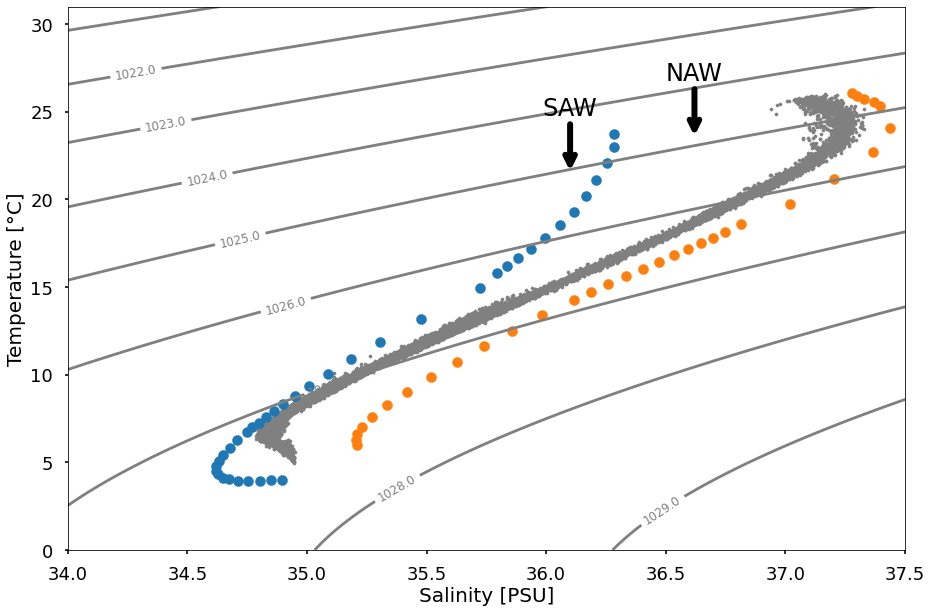

In [7]:
plt.figure(figsize=(15,10))

## markersize
s = 100


plt.scatter(subset_ds_2020.sal.values,subset_ds_2020.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021a.sal.values,subset_ds_2021a.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021b.sal.values,subset_ds_2021b.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2022.sal.values,subset_ds_2022.temp.values,s=10,c='grey')



## SAW
plt.scatter(saw_mean_sal,saw_mean_temp,s=s)
plt.annotate(
'SAW', xy=(36.1, 21.5),xytext=(36.1, 24.8) ,
size=24, horizontalalignment="center",
arrowprops=dict(arrowstyle='->',lw=6)
)

## NAW
plt.scatter(naw_mean_sal,naw_mean_temp,s=s)
plt.annotate(
'NAW', xy=(36.62, 23.5),xytext=(36.62, 26.8) ,
size=24, horizontalalignment="center",
arrowprops=dict(arrowstyle='->',lw=6)
)


plt.gca().tick_params(axis='both', which='major', labelsize=18)
plt.gca().tick_params(axis='both', which='minor', labelsize=18)
plt.ylim(0,31)
plt.xlim(34,37.5)
plt.xlabel('Salinity [PSU]', size=20)
plt.ylabel('Temperature [''\N{DEGREE SIGN}''C]', size=20)

######## This plots the contours
mint=1
maxt=30
mins=34
maxs=37.5
tempL=np.linspace(mint-1,maxt+1,399)
salL=np.linspace(mins-1,maxs+1,399)
Tg, Sg = np.meshgrid(tempL,salL)


z=np.linspace(-1000,0,399)
p = gsw.p_from_z(z,lat=0)
#sigma_theta = gsw.density.rho(Sg, Tg, p)

sigma_theta = gsw.sigma0(Sg, Tg)+1000

#sigma_theta = gsw.sigma0(Sg, Tg)+1000 # ignore effects of pressure on density
cnt = np.linspace(sigma_theta.min(), sigma_theta.max(),399)
ind = np.argwhere(sigma_theta > 1015.7)
st_short = sigma_theta[ind]
#cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=np.arange(1020, 1030,1), vmin = 1020, vmax = 1030)
cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=np.arange(1020, 1037,1), vmin = 1020, vmax = 1037)
levels = cs.levels
manual_locations = [(34.3, 26), (34.4, 25), (34.6,20), (34.75,16), (34.95,12), (35.15,7), (35.4,3), (36.5,2)]
plt.clabel(cs,levels, fontsize=12,inline=True,fmt='%.1f', manual=manual_locations)



## Need to smooth profiles

In [8]:
griddepth = np.arange(0,1001,2)

naw_interp_mean_temp =  interp.griddata(mean_depth,naw_mean_temp,griddepth)
naw_interp_mean_sal =  interp.griddata(mean_depth,naw_mean_sal,griddepth)
naw_interp_mean_den =  interp.griddata(mean_depth,naw_mean_den,griddepth)

saw_interp_mean_temp =  interp.griddata(mean_depth,saw_mean_temp,griddepth)
saw_interp_mean_sal =  interp.griddata(mean_depth,saw_mean_sal,griddepth)
saw_interp_mean_den =  interp.griddata(mean_depth,saw_mean_den,griddepth)


griddepth_2022 = np.arange(10,1001,20)

naw_interp_mean_temp_2022 =  interp.griddata(mean_depth,naw_mean_temp,griddepth_2022)
naw_interp_mean_sal_2022 =  interp.griddata(mean_depth,naw_mean_sal,griddepth_2022)
naw_interp_mean_den_2022 =  interp.griddata(mean_depth,naw_mean_den,griddepth_2022)

saw_interp_mean_temp_2022 =  interp.griddata(mean_depth,saw_mean_temp,griddepth_2022)
saw_interp_mean_sal_2022 =  interp.griddata(mean_depth,saw_mean_sal,griddepth_2022)
saw_interp_mean_den_2022 =  interp.griddata(mean_depth,saw_mean_den,griddepth_2022)




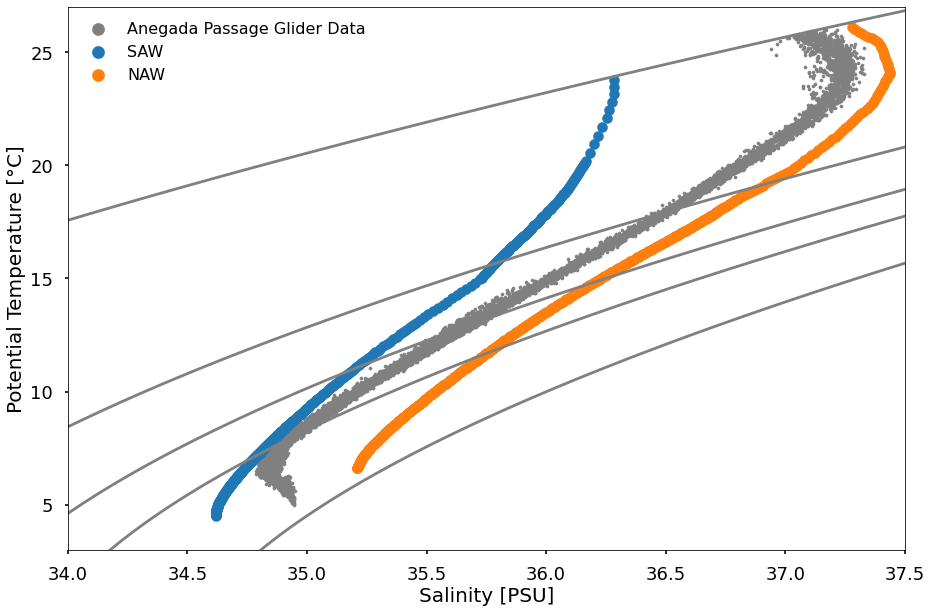

In [9]:
plt.figure(figsize=(15,10))

## markersize
s = 100


plt.scatter(subset_ds_2020.sal.values,subset_ds_2020.temp.values,s=10,c='grey',label='Anegada Passage Glider Data')
plt.scatter(subset_ds_2021a.sal.values,subset_ds_2021a.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2021b.sal.values,subset_ds_2021b.temp.values,s=10,c='grey')
plt.scatter(subset_ds_2022.sal.values,subset_ds_2022.temp.values,s=10,c='grey')



## SAW
plt.scatter(saw_interp_mean_sal,saw_interp_mean_temp,s=s,label='SAW')
## NAW
plt.scatter(naw_interp_mean_sal,naw_interp_mean_temp,s=s,label='NAW')


plt.gca().tick_params(axis='both', which='major', labelsize=18)
plt.gca().tick_params(axis='both', which='minor', labelsize=18)
plt.ylim(3,27)
plt.xlim(34,37.5)
plt.xlabel('Salinity [PSU]', size=20)
plt.ylabel('Potential Temperature [''\N{DEGREE SIGN}''C]', size=20)
lgnd = plt.legend(frameon=False)
for handle in lgnd.legendHandles:
    handle.set_sizes([150])

######## This plots the contours
mint=1
maxt=30
mins=34
maxs=37.5
tempL=np.linspace(mint-1,maxt+1,399)
salL=np.linspace(mins-1,maxs+1,399)
Tg, Sg = np.meshgrid(tempL,salL)

z=np.linspace(-1000,0,399)
p = gsw.p_from_z(z,lat=0)

sigma_theta = gsw.sigma0(Sg, Tg)+1000

#sigma_theta = gsw.sigma0(Sg, Tg)+1000 # ignore effects of pressure on density
cnt = np.linspace(sigma_theta.min(), sigma_theta.max(),399)
ind = np.argwhere(sigma_theta > 1015.7)
st_short = sigma_theta[ind]
cs = plt.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1 ,levels=[1024.5,1026.3,1026.8,1027.1,1027.6])
levels = cs.levels
#manual_locations = [(34.3, 26), (34.4, 25), (34.6,20), (34.75,16), (34.95,12), (35.15,7), (35.4,3), (36.5,2)]
#plt.clabel(cs,levels, fontsize=12,inline=True,fmt='%.1f', manual=manual_locations)



## Save end memebers!

In [10]:
d = {'depth': griddepth, 'naw_temp':naw_interp_mean_temp, 'naw_sal': naw_interp_mean_sal,
     'naw_den': naw_interp_mean_den, 'saw_temp': saw_interp_mean_temp, 'saw_sal': saw_interp_mean_sal, 'saw_den':saw_interp_mean_den}

df = pd.DataFrame(data=d)

df.to_csv('/home/jg1200/Data/naw_saw_endmember_t_s_d_profile.csv')



# d = {'depth': griddepth_2022, 'naw_temp':naw_interp_mean_temp_2022, 'naw_sal': naw_interp_mean_sal_2022,
#      'naw_den': naw_interp_mean_den_2022, 'saw_temp': saw_interp_mean_temp_2022, 'saw_sal': saw_interp_mean_sal_2022, 'saw_den':saw_interp_mean_den_2022}

# df = pd.DataFrame(data=d)

# df.to_csv('/home/jg1200/Data/naw_saw_endmember_t_s_d_profile_2022_grid.csv')





In [11]:
df

,depth,naw_temp,naw_sal,naw_den,saw_temp,saw_sal,saw_den
0,0,NaN,NaN,NaN,NaN,NaN,NaN
1,2,NaN,NaN,NaN,NaN,NaN,NaN
2,4,NaN,NaN,NaN,NaN,NaN,NaN
3,6,NaN,NaN,NaN,NaN,NaN,NaN
4,8,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
496,992,6.677792,35.212222,1027.499798,4.564456,34.621253,1027.295765
497,994,6.660281,35.211375,1027.501544,4.554480,34.621252,1027.296873
498,996,6.642770,35.210527,1027.503290,4.544504,34.621250,1027.297980
499,998,6.625260,35.209680,1027.505037,4.534528,34.621248,1027.299087


In [12]:
## initialize
NAW =       ["NAW",   np.nan,   np.nan]
SAW =       ["SAW",   np.nan,  np.nan]


def prepare_endmember_df(endmembers_arr):
    df = pd.DataFrame(data=endmembers_arr,
                      columns=["endmember_name", "potential_temperature", "salinity"])
    df["mass"] = 1
    return df

endmemberdf = prepare_endmember_df([NAW, SAW])
endmemberdf

,endmember_name,potential_temperature,salinity,mass
0,NAW,NaN,NaN,1
1,SAW,NaN,NaN,1


In [13]:

def solve_endmember_fractions_single(df,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den, saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den):
    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan
    temp_resid_df = np.empty(df.temp.shape)
    temp_resid_df[:] = np.nan
    sal_resid_df = np.empty(df.temp.shape)
    sal_resid_df[:] = np.nan
    mass_resid_df = np.empty(df.temp.shape)
    mass_resid_df[:] = np.nan

    ## Loop through each row (depth) and perform water mass analysis
    for x in np.arange(0,len(df.depth)):
        for y in np.arange(0,len(df.dist)):
            ## if there is a nan value, skip
            if ~np.isnan(df.temp.values[x,y]):
                ## subset to just the depth row of interest and make pandas dataframe
                d = {'potential_temperature': df.temp.values[x,y], 'salinity': df.sal.values[x,y]}
                obs_df = pd.DataFrame(data=d, index=[0])
                obs_df["mass"] = 1.0

                ## find matching closest isopycnal index in source water data
                ## theoretically a different index for NAW vs SAW
                diffs = np.abs(df.density.values[x,y]-naw_interp_mean_den)
                naw_iso_ind = np.nanargmin(diffs)

                diffs = np.abs(df.density.values[x,y]-saw_interp_mean_den)
                saw_iso_ind = np.nanargmin(diffs)

                ## oull out NAW and SAW temp and sal
                endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
                endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
                endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
                endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
                ## run analysis
                ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
                ## save soln'n
                naw_frac_df[x,y]   = ompa_soln.endmember_fractions[0,0]
                saw_frac_df[x,y]   = ompa_soln.endmember_fractions[0,1]
                temp_resid_df[x,y] = ompa_soln.param_residuals[0,0]
                sal_resid_df[x,y]  = ompa_soln.param_residuals[0,1]
                mass_resid_df[x,y] = ompa_soln.param_residuals[0,2]

    df["naw_frac"]=(['depth', 'dist'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'dist'],  saw_frac_df)
    df["temp_resid"]=(['depth', 'dist'],  temp_resid_df)
    df["sal_resid"]=(['depth', 'dist'],  sal_resid_df)
    df["mass_resid"]=(['depth', 'dist'],  mass_resid_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.cross_vel.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.cross_vel[:,x].values*dz*df.dist.values[x])/(10**6)

    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df

    df["transport"]=(['depth', 'dist'],  transport)
    df["naw_transport"]=(['depth', 'dist'],  naw_transport)
    df["saw_transport"]=(['depth', 'dist'],  saw_transport)
    return df


def calc_transport_single(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.cross_vel.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    
    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.cross_vel[:,x].values*dz*df.dist.values[x])/(10**6)

    df["transport"]=(['depth', 'dist'],  transport)

    return df


In [14]:
subset_ds_2021a_surf_final = calc_transport_single(subset_ds_2021a_surf)
subset_ds_2021b_surf_final = calc_transport_single(subset_ds_2021b_surf)

In [15]:
df_2021a_final = solve_endmember_fractions_single(subset_ds_2021a,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den,saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005356847194283466
Original weighted sum squares: 0.0005356847194283466
Post fix weighted sum squared: 0.0005356847194288338
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005356847194283466
Original weighted sum squares: 0.0005356847194283466
Post fix weighted sum squared: 0.0005356847194288338
objective: 0.0005356847194288338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032155706261552982
Original weighted sum squares: 0.0032155706261552982
Post fix weighted sum squared: 0.003215

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005903049901621107
Original weighted sum squares: 0.005903049901621107
Post fix weighted sum squared: 0.0059030499016216875
objective: 0.0059030499016216875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012179216265065967
Original weighted sum squares: 0.00012179216265065967
Post fix weighted sum squared: 0.00012179216265065967
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012179216265065967
Original weighted sum squares: 0.00012179216265065967
Post fix weighted sum squared: 0.00012179216265065967
objective: 0.00012179216265065967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.837798391340591e-06
Original weighted sum squares: 4.837798391340591e-06
Post fix weighted sum squared: 4.837798391295805e-06
objective: 4.837798391295805e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2779948678561142e-06
Original weighted sum squares: 1.2779948678561142e-06
Post fix weighted sum squared: 1.2779948678561142e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.2779948678561142e-06
Original weighted sum squares: 1.2779948678561142e-06
Post fix weighted sum squared: 1.2779948678561142e-06
objective: 1.2779948678561142e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011487686580194827
Original weighted sum squares: 0.00011487686580194827
Post fix weighted sum squared: 0.00011487686580194827
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011487686580194827
Original weighted sum squares: 0.00011487686580194827
Post fix weighted sum squared: 0.00011487686580194827
objective: 0.00011487686580194827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000641323905268996
Original weighted sum squares: 0.000641323905268996
Post fix weighted sum squared: 0.000641323905268926
On example 0 to 1 out of 1
status: optimal
optimal value 0.000641323905268996
Original weighted sum squares: 0.000641323905268996
Post fix weighted sum squared: 0.000641323905268926
objective: 0.000641323905268926
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012136357778889045
Original weighted sum squares: 0.00012136357778889045
Post fix weighted sum squared: 0.00012136357778889045
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012136357778889045
Original weighted sum squares: 0.00012136357778889045
Post fix weighted sum squared: 0.00012136357778889045
objective: 0.00012136357778889045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.012371168482688e-05
Original weighted sum squares: 9.012371168482688e-05
Post fix weighted sum squared: 9.012371168482688e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.012371168482688e-05
Original weighted sum squares: 9.012371168482688e-05
Post fix weighted sum squared: 9.012371168482688e-05
objective: 9.012371168482688e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002005501610590502
Original weighted sum squares: 0.002005501610590502
Post fix weighted sum squared: 0.00200550161059084
On example 0 to 1 out of 1
status: optimal
optimal value 0.002005501610590502
Original weighted sum squares: 0.002005501610590502
Post fix weighted sum squared: 0.00200550161059084
objective: 0.00200550161059084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.387128260257921e-05
Original weighted sum squares: 3.387128260257921e-05
Post fix weighted sum squared: 3.387128260263926e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.387128260257921e-05
Original weighted sum squares: 3.3871282602579

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.380543863686649e-05
Original weighted sum squares: 5.380543863686649e-05
Post fix weighted sum squared: 5.380543863673498e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.380543863686649e-05
Original weighted sum squares: 5.380543863686649e-05
Post fix weighted sum squared: 5.380543863673498e-05
objective: 5.380543863673498e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.977482291852506e-05
Original weighted sum squares: 2.977482291852506e-05
Post fix weighted sum squared: 2.977482291863617e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.977482291852506e-05
Original weighted sum squares: 2.977482291852506e-05
Post fix weighted sum squared: 2.977482291863617e-05
objective: 2.977482291863617e-05
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.501104956765371e-05
Original weighted sum squares: 3.501104956765371e-05
Post fix weighted sum squared: 3.501104956753132e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.501104956765371e-05
Original weighted sum squares: 3.501104956765371e-05
Post fix weighted sum squared: 3.501104956753132e-05
objective: 3.501104956753132e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.923085166482545e-06
Original weighted sum squares: 7.923085166482545e-06
Post fix weighted sum squared: 7.923085166482545e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.923085166482545e-06
Original weighted sum squares: 7.923085166482545e-06
Post fix weighted sum squared: 7.923085166482545e-06
objective: 7.923085166482545e-06
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000385375783798054
Original weighted sum squares: 0.000385375783798054
Post fix weighted sum squared: 0.0003853757837979996
objective: 0.0003853757837979996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046483878131098994
Original weighted sum squares: 0.00046483878131098994
Post fix weighted sum squared: 0.00046483878131098994
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046483878131098994
Original weighted sum squares: 0.00046483878131098994
Post fix weighted sum squared: 0.00046483878131098994
objective: 0.00046483878131098994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025297696124178764
Original weighted sum squares: 0.00025297696124178764
Post fix weighted sum squared: 0.0002529769612414543
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025297696124178764
Original weighted sum squares: 0.00025297696124178764
Post fix weighted sum squared: 0.0002529769612414543
objective: 0.0002529769612414543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025705559269715775
Original weighted sum squares: 0.00025705559269715775
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001432729663350834
Original weighted sum squares: 0.0001432729663350834
Post fix weighted sum squared: 0.0001432729663350834
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001432729663350834
Original weighted sum squares: 0.0001432729663350834
Post fix weighted sum squared: 0.0001432729663350834
objective: 0.0001432729663350834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002118955512635505
Original weighted sum squares: 0.0002118955512635505
Post fix weighted sum squared: 0.000211

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.237411304219946e-06
Original weighted sum squares: 4.237411304219946e-06
Post fix weighted sum squared: 4.2374113042419175e-06
objective: 4.2374113042419175e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002404314140625085
Original weighted sum squares: 0.0002404314140625085
Post fix weighted sum squared: 0.0002404314140625085
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002404314140625085
Original weighted sum squares: 0.0002404314140625085
Post fix weighted sum squared: 0.0002404314140625085
objective: 0.0002404314140625085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045626373966748773
Original weighted sum squares: 0.00045626373966748773
Post fix weighted sum squared: 0.000456263739666825
objective: 0.000456263739666825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.2198077884097466e-05
Original weighted sum squares: 2.2198077884097466e-05
Post fix weighted sum squared: 2.2198077884146293e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.2198077884146293e-05
Original weighted sum squares: 2.2198077884146293e-05
Post fix weighted sum squared: 2.2198077884146293e-05
objective: 2.2198077884146293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 9.874187397801918e-05
Original weighted sum squares: 9.874187397801918e-05
Post fix weighted sum squared: 9.874187397801918e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.874187397801918e-05
Original weighted sum squares: 9.874187397801918e-05
Post fix weighted sum squared: 9.874187397801918e-05
objective: 9.874187397801918e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000162634932727775
Original weighted sum squares: 0.000162634932727775
Post fix weighted sum squared: 0.00016263493272791098
On example 0 to 1 out of 1
status: optimal
optimal value 0.000162634932727775
Original weighted sum squares: 0.000162634932727775
Post fix weighted sum squared: 0.00016263493272791098
objective: 0.00016263493272791098
Endmember

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.3759179033690006e-06
Original weighted sum squares: 3.3759179033690006e-06
Post fix weighted sum squared: 3.3759179034082737e-06
objective: 3.3759179034082737e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.838453202465046e-05
Original weighted sum squares: 1.838453202465046e-05
Post fix weighted sum squared: 1.838453202465046e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.838453202465046e-05
Original weighted sum squares: 1.838453202465046e-05
Post fix weighted sum squared: 1.838453202465046e-05
objective: 1.838453202465046e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.5459575014971096e-05
Original weighted sum squares: 4.5459575014971096e-05
Post fix weighted sum squared: 4.545957501498848e-05
objective: 4.545957501498848e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014234869461719068
Original weighted sum squares: 0.00014234869461719068
Post fix weighted sum squared: 0.00014234869461694064
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014234869461719068
Original weighted sum squares: 0.00014234869461719068
Post fix weighted sum squared: 0.00014234869461694064
objective: 0.00014234869461694064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.5635339281683852e-05
Original weighted sum squares: 1.5635339281683852e-05
Post fix weighted sum squared: 1.5635339281683852e-05
objective: 1.5635339281683852e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003874788838731004
Original weighted sum squares: 0.0003874788838731004
Post fix weighted sum squared: 0.00038747888387294697
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003874788838731004
Original weighted sum squares: 0.0003874788838731004
Post fix weighted sum squared: 0.00038747888387294697
objective: 0.00038747888387294697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003680466528721831
Original weighted sum squares: 0.0003680466528721831
Post fix weighted sum squared: 0.0003680466528725928
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003680466528721831
Original weighted sum squares: 0.0003680466528721831
Post fix weighted sum squared: 0.0003680466528725928
objective: 0.0003680466528725928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013614703207524316
Original weighted sum squares: 0.00013614703207524316
Post fix weighted sum squared: 0.0001361470320748764
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013614703207524316
Original weighted sum squares: 0.00013614703207524316
Post fix weighted sum squared: 0.0001361470320748764
objective: 0.0001361470320748764
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 1.6996465150247348e-05
Original weighted sum squares: 1.6996465150247348e-05
Post fix weighted sum squared: 1.6996465150257976e-05
objective: 1.6996465150257976e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.717200074989808e-05
Original weighted sum squares: 5.717200074989808e-05
Post fix weighted sum squared: 5.717200074973482e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.717200074989808e-05
Original weighted sum squares: 5.717200074989808e-05
Post fix weighted sum squared: 5.717200074973482e-05
objective: 5.717200074973482e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 0.00026515278719064367
objective: 0.00026515278719064367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007681613642949923
Original weighted sum squares: 0.0007681613642949923
Post fix weighted sum squared: 0.0007681613642952089
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007681613642949923
Original weighted sum squares: 0.0007681613642949923
Post fix weighted sum squared: 0.0007681613642952089
objective: 0.0007681613642952089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010413578536692108
Original weighted sum squares: 0.0

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000526967251506417
Original weighted sum squares: 0.000526967251506417
Post fix weighted sum squared: 0.0005269672515066621
On example 0 to 1 out of 1
status: optimal
optimal value 0.000526967251506476
Original weighted sum squares: 0.000526967251506476
Post fix weighted sum squared: 0.0005269672515066621
objective: 0.0005269672515066621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014533208428422247
Original weighted sum squares: 0.00014533208428422247
Post fix weighted sum squared: 0.00014533

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.201001671383312e-06
Original weighted sum squares: 2.201001671383312e-06
Post fix weighted sum squared: 2.201001671351762e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.201001671383312e-06
Original weighted sum squares: 2.201001671383312e-06
Post fix weighted sum squared: 2.201001671351762e-06
objective: 2.201001671351762e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.4786901522962527e-06
Original weighted sum squares: 1.4786901522962527e-06
Post fix weighted sum squared: 1.4786

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006892883724099438
Original weighted sum squares: 0.0006892883724099438
Post fix weighted sum squared: 0.0006892883724101578
objective: 0.0006892883724101578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.286405704588647e-05
Original weighted sum squares: 7.286405704588647e-05
Post fix weighted sum squared: 7.286405704579655e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.286405704588647e-05
Original weighted sum squares: 7.286405704588647e-05
Post fix weighted sum squared: 7.286405704579655e-05
objective: 7.286405704579655e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007012126090650761
Original weighted sum squares: 0.0007012126090650761
Post fix weighted sum squared: 0.000701212609065359
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007012126090650761
Original weighted sum squares: 0.0007012126090650761
Post fix weighted sum squared: 0.000701212609065359
objective: 0.000701212609065359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002899840200604128
Original weighted sum squares: 0.0002899840200604128
Post fix weighted sum squared: 0.000289984

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 4.538237557262227e-05
Original weighted sum squares: 4.538237557262227e-05
Post fix weighted sum squared: 4.5382375572695e-05
objective: 4.5382375572695e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.815164089058002e-05
Original weighted sum squares: 7.815164089058002e-05
Post fix weighted sum squared: 7.815164089067146e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.815164089058002e-05
Original weighted sum squares: 7.815164089058002e-05
Post fix weighted sum squared: 7.815164089058002e-05
objective: 7.815164089058002e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.000855406057067016
Original weighted sum squares: 0.000855406057067016
Post fix weighted sum squared: 0.00085540605706678
objective: 0.00085540605706678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0124950941964745e-05
Original weighted sum squares: 2.0124950941964745e-05
Post fix weighted sum squared: 2.0124950941964745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0124950941964745e-05
Original weighted sum squares: 2.0124950941964745e-05
Post fix weighted sum squared: 2.0124950941964745e-05
objective: 2.0124950941964745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000273500161013199
Original weighted sum squares: 0.000273500161013199
Post fix weighted sum squared: 0.000273500161013158
On example 0 to 1 out of 1
status: optimal
optimal value 0.000273500161013199
Original weighted sum squares: 0.000273500161013199
Post fix weighted sum squared: 0.000273500161013158
objective: 0.000273500161013158
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005130910136813376
Original weighted sum squares: 0.0005130910136813376
Post fix weighted sum squared: 0.0005130910136818282
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005130910136813376
Original weighted sum squares: 0.0005130910136813376
Post fix weighted sum squared: 0.0005130910136818282
objective: 0.0005130910136818282
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011674590533199947
Original weighted sum squares: 0.00011674590533199947
Post fix weighted sum squared: 0.00011674590533211122
objective: 0.00011674590533211122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021556716718421981
Original weighted sum squares: 0.00021556716718421981
Post fix weighted sum squared: 0.00021556716718421981
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021556716718421981
Original weighted sum squares: 0.00021556716718421981
Post fix weighted sum squared: 0.00021556716718421981
objective: 0.00021556716718421981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.0887262677006437e-05
Original weighted sum squares: 2.0887262677006437e-05
Post fix weighted sum squared: 2.08872626770547e-05
objective: 2.08872626770547e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022122979334630966
Original weighted sum squares: 0.00022122979334630966
Post fix weighted sum squared: 0.00022122979334643098
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022122979334630966
Original weighted sum squares: 0.00022122979334630966
Post fix weighted sum squared: 0.00022122979334643098
objective: 0.00022122979334643098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00027025790435950193
Original weighted sum squares: 0.00027025790435950193
Post fix weighted sum squared: 0.00027025790435950193
objective: 0.00027025790435950193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.6184187201740386e-05
Original weighted sum squares: 5.6184187201740386e-05
Post fix weighted sum squared: 5.618418720172177e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.6184187201740386e-05
Original weighted sum squares: 5.6184187201740386e-05
Post fix weighted sum squared: 5.618418720182158e-05
objective: 5.618418720182158e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.228768985939764e-06
Original weighted sum squares: 3.228768985939764e-06
Post fix weighted sum squared: 3.2287689859548365e-06
On example 0 to 1 out of 1
status: optimal
optimal value 3.228768985939764e-06
Original weighted sum squares: 3.228768985939764e-06
Post fix weighted sum squared: 3.2287689859548365e-06
objective: 3.2287689859548365e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018987592607262597
Original weighted sum squares: 0.00018987592607262597
Post fix weighted sum squared: 0.00018987592607229819
On example 0 to 1 out of 1
status: optimal
optim

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012576485979005013
Original weighted sum squares: 0.00012576485979005013
Post fix weighted sum squared: 0.00012576485979017165
objective: 0.00012576485979017165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006335181134580703
Original weighted sum squares: 0.0006335181134580703
Post fix weighted sum squared: 0.0006335181134583396
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006335181134578011
Original weighted sum squares: 0.0006335181134578011
Post fix weighted sum squared: 0.0006335181134583396
objective: 0.0006335181134583396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00017004555294030193
Original weighted sum squares: 0.00017004555294030193
Post fix weighted sum squared: 0.00017004555294040827
objective: 0.00017004555294040827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010594844869391225
Original weighted sum squares: 0.00010594844869391225
Post fix weighted sum squared: 0.00010594844869391225
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010594844869388684
Original weighted sum squares: 0.00010594844869388684
Post fix weighted sum squared: 0.00010594844869388684
objective: 0.00010594844869388684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.2640229109784272e-05
Original weighted sum squares: 2.2640229109784272e-05
Post fix weighted sum squared: 2.2640229109784272e-05
objective: 2.2640229109784272e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013399789874516822
Original weighted sum squares: 0.0013399789874516822
Post fix weighted sum squared: 0.0013399789874507968
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013399789874516822
Original weighted sum squares: 0.0013399789874516822
Post fix weighted sum squared: 0.0013399789874507968
objective: 0.0013399789874507968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.589334550071605e-05
Original weighted sum squares: 1.589334550071605e-05
Post fix weighted sum squared: 1.5893345500791678e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.589334550071605e-05
Original weighted sum squares: 1.589334550071605e-05
Post fix weighted sum squared: 1.5893345500791678e-05
objective: 1.5893345500791678e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016037893558514988
Original weighted sum squares: 0.00016037893558514988
Post fix weighted sum squared: 0.00016037893558504366
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016037893558498113
Original weighted sum squares: 0.00016037893558498113
Post fix weighted sum squared: 0.00016037893558498113
objective: 0.0001603789355849811

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.4305363240160598e-05
Original weighted sum squares: 2.4305363240160598e-05
Post fix weighted sum squared: 2.430536324026812e-05
objective: 2.430536324026812e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.759755962532642e-05
Original weighted sum squares: 5.759755962532642e-05
Post fix weighted sum squared: 5.759755962540923e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.759755962532642e-05
Original weighted sum squares: 5.759755962532642e-05
Post fix weighted sum squared: 5.759755962540923e-05
objective: 5.759755962540923e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00016094768037322246
Original weighted sum squares: 0.00016094768037322246
Post fix weighted sum squared: 0.00016094768037322246
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016094768037308439
Original weighted sum squares: 0.00016094768037308439
Post fix weighted sum squared: 0.00016094768037308439
objective: 0.00016094768037308439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.863437447234111e-06
Original weighted sum squares: 8.863437447234111e-06
Post fix weighted sum squared: 8.863437447201956e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.863437447234111e-06
Original weighted sum squares: 8.863437447234111e-06
Post fix weighted sum squared: 8.863437447201956e-06
objective: 8.863437447201956e-06
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005926050002165267
Original weighted sum squares: 0.0005926050002165267
Post fix weighted sum squared: 0.0005926050002165267
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005926050002165267
Original weighted sum squares: 0.0005926050002165267
Post fix weighted sum squared: 0.0005926050002165267
objective: 0.0005926050002165267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005426313890950331
Original weighted sum squares: 0.0005426313890950331
Post fix weighted sum squared: 0.0005426313890945322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005426313890950331
Original weighted sum squares: 0.0005426313890950331
Post fix weighted sum squared: 0.0005426313890945322
objective: 0.0005426313890945322
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001403113102584124
Original weighted sum squares: 0.0001403113102584124
Post fix weighted sum squared: 0.00014031131025850902
objective: 0.00014031131025850902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023650550336138035
Original weighted sum squares: 0.00023650550336138035
Post fix weighted sum squared: 0.00023650550336138035
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023650550336138035
Original weighted sum squares: 0.00023650550336138035
Post fix weighted sum squared: 0.00023650550336138035
objective: 0.00023650550336138035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.6960878822542916e-05
Original weighted sum squares: 1.6960878822542916e-05
Post fix weighted sum squared: 1.6960878822499114e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.6960878822542916e-05
Original weighted sum squares: 1.6960878822542916e-05
Post fix weighted sum squared: 1.6960878822499114e-05
objective: 1.6960878822499114e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9415893591875506e-05
Original weighted sum squares: 1.9415893591875506e-05
Post fix weighted sum squared: 1.9415893591875506e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9415893591875506e-05
Original weighted sum squares: 1.9415893591875506e-05
Post fix weighted sum squared: 1.9415893591875506e-05
objective: 1.941589359187550

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010045356338181201
Original weighted sum squares: 0.0010045356338181201
Post fix weighted sum squared: 0.0010045356338178545
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010045356338181201
Original weighted sum squares: 0.0010045356338181201
Post fix weighted sum squared: 0.0010045356338178545
objective: 0.0010045356338178545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1526079256430475e-06
Original weighted sum squares: 1.1526079256430475e-06
Post fix weighted sum squared: 1.152607925616991e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.1526079256430475e-06
Original weighted sum squares: 1.1526079256430475e-06
Post fix weighted sum squared: 1.152607925616991e-06
objective: 1.152607925616991e-06
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021862848741457732
Original weighted sum squares: 0.00021862848741457732
Post fix weighted sum squared: 0.0002186284874148999
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021862848741457732
Original weighted sum squares: 0.00021862848741457732
Post fix weighted sum squared: 0.0002186284874148999
objective: 0.0002186284874148999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.01211934201765e-06
Original weighted sum squares: 6.01211934201765e-06
Post fix weighted sum squared: 6.01211934199102e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.01211934201765e-06
Original weighted sum squares: 6.01211934201765e-06
Post fix weighted sum squared: 6.01211934199102e-06
objective: 6.01211934199102e-06
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.0710937718299745e-05
Original weighted sum squares: 5.0710937718299745e-05
Post fix weighted sum squared: 5.0710937718299745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.0710937718299745e-05
Original weighted sum squares: 5.0710937718299745e-05
Post fix weighted sum squared: 5.0710937718299745e-05
objective: 5.0710937718299745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.992956836377774e-05
Original weighted sum squares: 4.992956836377774e-05
Post fix weighted sum squared: 4.9929568363623014e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.992956836377774e-05
Original weighted sum squares: 4.992956836377774e-05
Post fix weighted sum squared: 4.9929568363623014e-05
objective: 4.9929568363623014e-0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 9.821154502986365e-05
Original weighted sum squares: 9.821154502986365e-05
Post fix weighted sum squared: 9.821154502986365e-05
objective: 9.821154502986365e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.006428197470037e-05
Original weighted sum squares: 8.006428197470037e-05
Post fix weighted sum squared: 8.006428197448482e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.006428197470037e-05
Original weighted sum squares: 8.006428197470037e-05
Post fix weighted sum squared: 8.006428197448482e-05
objective: 8.006428197448482e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005338899881247947
Original weighted sum squares: 0.0005338899881247947
Post fix weighted sum squared: 0.000533889988124546
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005338899881247947
Original weighted sum squares: 0.0005338899881247947
Post fix weighted sum squared: 0.000533889988124546
objective: 0.000533889988124546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022136365635125755
Original weighted sum squares: 0.00022136365635125755
Post fix weighted sum squared: 0.00022136365635125755
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022136365635125755
Original weighted sum squares: 0.00022136365635125755
Post fix weighted sum squared: 0.00022136365635125755
objective: 0.00022136365635125755
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 2.0720185758601008e-05
Original weighted sum squares: 2.0720185758601008e-05
Post fix weighted sum squared: 2.0720185758601008e-05
objective: 2.0720185758601008e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.831515609331044e-06
Original weighted sum squares: 6.831515609331044e-06
Post fix weighted sum squared: 6.831515609352737e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.831515609331044e-06
Original weighted sum squares: 6.831515609331044e-06
Post fix weighted sum squared: 6.831515609352737e-06
objective: 6.831515609352737e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008734020687106301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.4007180457913e-05
Original weighted sum squares: 9.4007180457913e-05
Post fix weighted sum squared: 9.4007180457913e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.4007180457913e-05
Original weighted sum squares: 9.4007180457913e-05
Post fix weighted sum squared: 9.4007180457913e-05
objective: 9.4007180457913e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000529481075019436
Original weighted sum squares: 0.000529481075019436
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0062932692212322e-05
Original weighted sum squares: 1.0062932692212322e-05
Post fix weighted sum squared: 1.006293269228905e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0062932692212322e-05
Original weighted sum squares: 1.0062932692212322e-05
Post fix weighted sum squared: 1.006293269228905e-05
objective: 1.006293269228905e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025236324495169946
Original weighted sum squares: 0.00025236324495169946
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00012314578760467333
Original weighted sum squares: 0.00012314578760467333
Post fix weighted sum squared: 0.00012314578760443004
objective: 0.00012314578760443004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000504914561317229
Original weighted sum squares: 0.000504914561317229
Post fix weighted sum squared: 0.000504914561317229
On example 0 to 1 out of 1
status: optimal
optimal value 0.000504914561317229
Original weighted sum squares: 0.000504914561317229
Post fix weighted sum squared: 0.000504914561317229
objective: 0.000504914561317229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000497823167465772
Original weighted sum squares: 0.000497823167465772
Post fix weighted sum squared: 0.0004978231674655836
objective: 0.0004978231674655836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003788040940277873
Original weighted sum squares: 0.0003788040940277873
Post fix weighted sum squared: 0.0003788040940277873
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003788040940277873
Original weighted sum squares: 0.0003788040940277873
Post fix weighted sum squared: 0.0003788040940277873
objective: 0.0003788040940277873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00013843369930620502
Original weighted sum squares: 0.00013843369930620502
Post fix weighted sum squared: 0.00013843369930591874
objective: 0.00013843369930591874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003163322592961632
Original weighted sum squares: 0.0003163322592961632
Post fix weighted sum squared: 0.0003163322592967452
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003163322592961632
Original weighted sum squares: 0.0003163322592961632
Post fix weighted sum squared: 0.0003163322592967452
objective: 0.0003163322592967452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 4.152881332608093e-05
Original weighted sum squares: 4.152881332608093e-05
Post fix weighted sum squared: 4.152881332608093e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.152881332608093e-05
Original weighted sum squares: 4.152881332608093e-05
Post fix weighted sum squared: 4.152881332608093e-05
objective: 4.152881332608093e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020725365939055576
Original weighted sum squares: 0.00020725365939055576
Post fix weighted sum squared: 0.00020725365939055576
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020725365939055576
Original weighted sum squares: 0.00020725365939055576
Post fix weighted sum squared: 0.00020725365939055576
objective: 0.00020725365939055576
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 7.123527388715835e-05
Original weighted sum squares: 7.123527388715835e-05
Post fix weighted sum squared: 7.123527388697284e-05
objective: 7.123527388697284e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001666634527945019
Original weighted sum squares: 0.0001666634527945019
Post fix weighted sum squared: 0.00016666345279492436
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001666634527945019
Original weighted sum squares: 0.0001666634527945019
Post fix weighted sum squared: 0.00016666345279492436
objective: 0.00016666345279492436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003094431918572347
Original weighted sum squares: 0.0003094431918572347
Post fix weighted sum squared: 0.00030944319185738275
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003094431918572347
Original weighted sum squares: 0.0003094431918572347
Post fix weighted sum squared: 0.00030944319185738275
objective: 0.00030944319185738275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.8034022553035985e-05
Original weighted sum squares: 4.8034022553035985e-05
Post fix weighted sum squared: 4.803402255318738e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.8034022553035985e-05
Original weighted sum squares: 4.8034022553035985e-05
Post fix weighted sum squared: 4.803402255318738e-05
objective: 4.803402255318738e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003184485261954879
Original weighted sum squares: 0.0003184485261954879
Post fix weighted sum squared: 0.0003184485261950949
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003184485261954879
Original weighted sum squares: 0.0003184485261954879
Post fix weighted sum squared: 0.0003184485261950949
objective: 0.0003184485261950949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015634438690365106
Original weighted sum squares: 0.00015634438690365106
Post fix weighted sum squared: 0.00015634438690365106
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015634438690365106
Original weighted sum squares: 0.00015634438690365106
Post fix weighted sum squared: 0.00015634438690365106
objective: 0.00015634438690365106
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028071413785526686
Original weighted sum squares: 0.00028071413785526686
Post fix weighted sum squared: 0.0002807141378554909
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028071413785526686
Original weighted sum squares: 0.00028071413785526686
Post fix weighted sum squared: 0.0002807141378554909
objective: 0.0002807141378554909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047346624758697005
Original weighted sum squares: 0.00047346624758697005
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003083160583462234
Original weighted sum squares: 0.0003083160583462234
Post fix weighted sum squared: 0.0003083160583462234
objective: 0.0003083160583462234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.550933845102933e-05
Original weighted sum squares: 1.550933845102933e-05
Post fix weighted sum squared: 1.5509338451116075e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5509338451082068e-05
Original weighted sum squares: 1.5509338451082068e-05
Post fix weighted sum squared: 1.5509338451116075e-05
objective: 1.5509338451116075e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004266745917429182
Original weighted sum squares: 0.0004266745917429182
Post fix weighted sum squared: 0.0004266745917433688
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004266745917429182
Original weighted sum squares: 0.0004266745917429182
Post fix weighted sum squared: 0.0004266745917433688
objective: 0.0004266745917433688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.6242828296805543e-07
Original weighted sum squares: 4.6242828296805543e-07
Post fix weighted sum squared: 4.6242

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 1.848556797594782e-05
Original weighted sum squares: 1.848556797594782e-05
Post fix weighted sum squared: 1.848556797594782e-05
objective: 1.848556797594782e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002566186127301801
Original weighted sum squares: 0.0002566186127301801
Post fix weighted sum squared: 0.0002566186127301801
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002566186127301801
Original weighted sum squares: 0.0002566186127301801
Post fix weighted sum squared: 0.0002566186127301801
objective: 0.0002566186127301801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003826157208683495
Original weighted sum squares: 0.0003826157208683495
Post fix weighted sum squared: 0.000382615720867659
objective: 0.000382615720867659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028057720238570504
Original weighted sum squares: 0.00028057720238570504
Post fix weighted sum squared: 0.00028057720238556177
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002805772023857454
Original weighted sum squares: 0.0002805772023857454
Post fix weighted sum squared: 0.00028057720238560205
objective: 0.00028057720238560205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.803390607945314e-05
Original weighted sum squares: 7.803390607945314e-05
Post fix weighted sum squared: 7.803390607945314e-05
objective: 7.803390607945314e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002226418410691667
Original weighted sum squares: 0.0002226418410691667
Post fix weighted sum squared: 0.00022264184106900352
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002226418410691667
Original weighted sum squares: 0.0002226418410691667
Post fix weighted sum squared: 0.00022264184106900352
objective: 0.00022264184106900352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010388402197079606
Original weighted sum squares: 0.00010388402197079606
Post fix weighted sum squared: 0.00010388402197088576
objective: 0.00010388402197088576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002644752299376772
Original weighted sum squares: 0.0002644752299376772
Post fix weighted sum squared: 0.0002644752299380376
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002644752299376772
Original weighted sum squares: 0.0002644752299376772
Post fix weighted sum squared: 0.0002644752299380376
objective: 0.0002644752299380376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 2.189820231144381e-05
Original weighted sum squares: 2.189820231144381e-05
Post fix weighted sum squared: 2.189820231139192e-05
objective: 2.189820231139192e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026762636863874456
Original weighted sum squares: 0.00026762636863874456
Post fix weighted sum squared: 0.00026762636863834454
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026762636863874456
Original weighted sum squares: 0.00026762636863874456
Post fix weighted sum squared: 0.00026762636863834454
objective: 0.00026762636863834454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007038465435846397
Original weighted sum squares: 0.0007038465435846397
Post fix weighted sum squared: 0.0007038465435849295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007038465435846397
Original weighted sum squares: 0.0007038465435846397
Post fix weighted sum squared: 0.0007038465435849295
objective: 0.0007038465435849295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014379952023894465
Original weighted sum squares: 0.00014379952023894465
Post fix weighted sum squared: 0.00014379952023907595
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014379952023894465
Original weighted sum squares: 0.00014379952023894465
Post fix weighted sum squared: 0.00014379952023907595
objective: 0.00014379952023907595
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005243439317157773
Original weighted sum squares: 0.0005243439317157773
Post fix weighted sum squared: 0.0005243439317157773
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005243439317157773
Original weighted sum squares: 0.0005243439317157773
Post fix weighted sum squared: 0.0005243439317157773
objective: 0.0005243439317157773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000125151693128194
Original weighted sum squares: 0.000125151693128194
Post fix weighted sum squared: 0.00012515169312792135
On example 0 to 1 out of 1
status: optimal
optimal value 0.000125151693128194
Original weighted sum squares: 0.000125151693128194
Post fix weighted sum squared: 0.00012515169312792135
objective: 0.00012515169312792135
Endmember

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00016547660287040912
Original weighted sum squares: 0.00016547660287040912
Post fix weighted sum squared: 0.00016547660287037955
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016547660287040912
Original weighted sum squares: 0.00016547660287040912
Post fix weighted sum squared: 0.00016547660287037955
objective: 0.00016547660287037955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.638082911788174e-05
Original weighted sum squares: 7.638082911788174e-05
Post fix weighted sum squared: 7.638082911788174e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.638082911788174e-05
Original weighted sum squares: 7.638082911788174e-05
Post fix weighted sum squared: 7.638082911788174e-05
objective: 7.638082911788174e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022762878541662395
Original weighted sum squares: 0.00022762878541662395
Post fix weighted sum squared: 0.00022762878541678942
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022762878541662395
Original weighted sum squares: 0.00022762878541662395
Post fix weighted sum squared: 0.00022762878541678942
objective: 0.00022762878541678942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004548276219377289
Original weighted sum squares: 0.0004548276219377289
Post fix weighted sum squared: 0.00045482762193791283
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004548276219377289
Original weighted sum squares: 0.0004548276219377289
Post fix weighted sum squared: 0.00045482762193791283
objective: 0.0004548276219379128

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004131433476330298
Original weighted sum squares: 0.0004131433476330298
Post fix weighted sum squared: 0.0004131433476330298
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004131433476330298
Original weighted sum squares: 0.0004131433476330298
Post fix weighted sum squared: 0.0004131433476330298
objective: 0.0004131433476330298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004701768539650331
Original weighted sum squares: 0.0004701768539650331
Post fix weighted sum squared: 0.0004701768539655117
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004701768539650331
Original weighted sum squares: 0.0004701768539650331
Post fix weighted sum squared: 0.0004701768539655117
objective: 0.0004701768539655117
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00024884413168845275
Original weighted sum squares: 0.00024884413168845275
Post fix weighted sum squared: 0.00024884413168845275
objective: 0.00024884413168845275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.720211018382398e-05
Original weighted sum squares: 7.720211018382398e-05
Post fix weighted sum squared: 7.720211018392193e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.720211018380378e-05
Original weighted sum squares: 7.720211018380378e-05
Post fix weighted sum squared: 7.720211018390174e-05
objective: 7.720211018390174e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013067275154250976
Original weighted sum squares: 0.00013067275154250976
Post fix weighted sum squared: 0.00013067275154250976
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013067275154250976
Original weighted sum squares: 0.00013067275154250976
Post fix weighted sum squared: 0.00013067275154250976
objective: 0.00013067275154250976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018328042156087352
Original weighted sum squares: 0.00018328042156087352
Post fix weighted sum squared: 0.00018328042156087352
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018328042156087352
Original weighted sum squares: 0.00018328042156087352
Post fix weighted sum squared: 0.00018328042156087352
objective: 0.000183280421560

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006930376400977648
Original weighted sum squares: 0.0006930376400977648
Post fix weighted sum squared: 0.0006930376400977648
objective: 0.0006930376400977648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001858497633886076
Original weighted sum squares: 0.0001858497633886076
Post fix weighted sum squared: 0.0001858497633887252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001858497633886076
Original weighted sum squares: 0.0001858497633886076
Post fix weighted sum squared: 0.0001858497633887252
objective: 0.0001858497633887252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.325499834111171e-05
Original weighted sum squares: 5.325499834111171e-05
Post fix weighted sum squared: 5.325499834111171e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.325499834111171e-05
Original weighted sum squares: 5.325499834111171e-05
Post fix weighted sum squared: 5.325499834111171e-05
objective: 5.325499834111171e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.37801313393741e-05
Original weighted sum squares: 5.37801313393741e-05
Post fix weighted sum squared: 5.37801313393741e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.3780131339390945e-05
Original weighted sum squares: 5.3780131339390945e-05
Post fix weighted sum squared: 5.37801313393741e-05
objective: 5.37801313393741e-05
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021033043639992537
Original weighted sum squares: 0.00021033043639992537
Post fix weighted sum squared: 0.00021033043639992537
objective: 0.00021033043639992537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000512273889978055
Original weighted sum squares: 0.000512273889978055
Post fix weighted sum squared: 0.000512273889978055
On example 0 to 1 out of 1
status: optimal
optimal value 0.000512273889978055
Original weighted sum squares: 0.000512273889978055
Post fix weighted sum squared: 0.000512273889978304
objective: 0.000512273889978304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003044619158439919
Original weighted sum squares: 0.0003044619158439919
Post fix weighted sum squared: 0.00030446191584418457
objective: 0.00030446191584418457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002248741974864285
Original weighted sum squares: 0.0002248741974864285
Post fix weighted sum squared: 0.0002248741974864285
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022487419748662993
Original weighted sum squares: 0.00022487419748662993
Post fix weighted sum squared: 0.00022487419748646331
objective: 0.00022487419748646331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018556092546868425
Original weighted sum squares: 0.00018556092546868425
Post fix weighted sum squared: 0.00018556092546868425
objective: 0.00018556092546868425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002620734498895665
Original weighted sum squares: 0.0002620734498895665
Post fix weighted sum squared: 0.0002620734498895665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002620734498895665
Original weighted sum squares: 0.0002620734498895665
Post fix weighted sum squared: 0.0002620734498895665
objective: 0.0002620734498895665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010737451470402734
Original weighted sum squares: 0.00010737451470402734
Post fix weighted sum squared: 0.00010737451470402734
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010737451470402734
Original weighted sum squares: 0.00010737451470402734
Post fix weighted sum squared: 0.00010737451470402734
objective: 0.00010737451470402734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.948296077143207e-05
Original weighted sum squares: 6.948296077143207e-05
Post fix weighted sum squared: 6.948296077143207e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.948296077143207e-05
Original weighted sum squares: 6.948296077143207e-05
Post fix weighted sum squared: 6.948296077143207e-05
objective: 6.948296077143207e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032391725351926624
Original weighted sum squares: 0.00032391725351926624
Post fix weighted sum squared: 0.0003239172535190674
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032391725351926624
Original weighted sum squares: 0.00032391725351926624
Post fix weighted sum squared: 0.0003239172535190674
objective: 0.0003239172535190674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015583028958990127
Original weighted sum squares: 0.00015583028958990127
Post fix weighted sum squared: 0.00015583028958976287
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015583028958990127
Original weighted sum squares: 0.00015583028958990127
Post fix weighted sum squared: 0.00015583028958976287
objective: 0.000155830289589762

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013360513264914885
Original weighted sum squares: 0.00013360513264914885
Post fix weighted sum squared: 0.00013360513264914885
objective: 0.00013360513264914885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046710010876788903
Original weighted sum squares: 0.00046710010876788903
Post fix weighted sum squared: 0.0004671001087685566
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046710010876788903
Original weighted sum squares: 0.00046710010876788903
Post fix weighted sum squared: 0.0004671001087685566
objective: 0.0004671001087685566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025541093265925367
Original weighted sum squares: 0.00025541093265925367
Post fix weighted sum squared: 0.00025541093265925367
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025541093265925367
Original weighted sum squares: 0.00025541093265925367
Post fix weighted sum squared: 0.00025541093265925367
objective: 0.00025541093265925367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004938296072670667
Original weighted sum squares: 0.0004938296072670667
Post fix weighted sum squared: 0.0004938296072675589
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004938296072670667
Original weighted sum squares: 0.0004938296072670667
Post fix weighted sum squared: 0.0004938296072675069
objective: 0.0004938296072675069
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002110355768416316
Original weighted sum squares: 0.0002110355768416316
Post fix weighted sum squared: 0.0002110355768416316
objective: 0.0002110355768416316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005335036096117205
Original weighted sum squares: 0.0005335036096117205
Post fix weighted sum squared: 0.0005335036096117205
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005335036096117205
Original weighted sum squares: 0.0005335036096117205
Post fix weighted sum squared: 0.0005335036096117205
objective: 0.0005335036096117205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005036981584228203
Original weighted sum squares: 0.0005036981584228203
Post fix weighted sum squared: 0.0005036981584228203
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005036981584227697
Original weighted sum squares: 0.0005036981584227697
Post fix weighted sum squared: 0.0005036981584227697
objective: 0.0005036981584227697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004910430452824307
Original weighted sum squares: 0.0004910430452824307
Post fix weighted sum squared: 0.0004910430452826784
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004910430452824307
Original weighted sum squares: 0.0004910430452824307
Post fix weighted sum squared: 0.0004910430452826784
objective: 0.0004910430452826784
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00040393291392354396
Original weighted sum squares: 0.00040393291392354396
Post fix weighted sum squared: 0.00040393291392354396
objective: 0.00040393291392354396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012336008413563405
Original weighted sum squares: 0.00012336008413563405
Post fix weighted sum squared: 0.00012336008413578358
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012336008413563405
Original weighted sum squares: 0.00012336008413563405
Post fix weighted sum squared: 0.00012336008413578358
objective: 0.00012336008413578358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021981436102138846
Original weighted sum squares: 0.00021981436102138846
Post fix weighted sum squared: 0.00021981436102155456
objective: 0.00021981436102155456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002769268454443451
Original weighted sum squares: 0.0002769268454443451
Post fix weighted sum squared: 0.0002769268454443451
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002769268454443451
Original weighted sum squares: 0.0002769268454443451
Post fix weighted sum squared: 0.0002769268454443451
objective: 0.0002769268454443451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.886203305331148e-05
Original weighted sum squares: 6.886203305331148e-05
Post fix weighted sum squared: 6.886203305329241e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.886203305329241e-05
Original weighted sum squares: 6.886203305329241e-05
Post fix weighted sum squared: 6.886203305338493e-05
objective: 6.886203305338493e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025579641797719526
Original weighted sum squares: 0.00025579641797719526
Post fix weighted sum squared: 0.000255796417977017
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025579641797719526
Original weighted sum squares: 0.00025579641797719526
Post fix weighted sum squared: 0.000255796417977017
objective: 0.000255796417977017
Endmemb

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001223725215339526
Original weighted sum squares: 0.0001223725215339526
Post fix weighted sum squared: 0.0001223725215339526
objective: 0.0001223725215339526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000752318408173823
Original weighted sum squares: 0.000752318408173823
Post fix weighted sum squared: 0.000752318408173823
On example 0 to 1 out of 1
status: optimal
optimal value 0.000752318408173823
Original weighted sum squares: 0.000752318408173823
Post fix weighted sum squared: 0.000752318408173823
objective: 0.000752318408173823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007199240478350209
Original weighted sum squares: 0.0007199240478350209
Post fix weighted sum squared: 0.0007199240478347219
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007199240478350209
Original weighted sum squares: 0.0007199240478350209
Post fix weighted sum squared: 0.0007199240478347219
objective: 0.0007199240478347219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003529919883946143
Original weighted sum squares: 0.0003529919883946143
Post fix weighted sum squared: 0.0003529919883946143
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003529919883946143
Original weighted sum squares: 0.0003529919883946143
Post fix weighted sum squared: 0.0003529919883946143
objective: 0.0003529919883946143
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0002828223208924972
Original weighted sum squares: 0.0002828223208924972
Post fix weighted sum squared: 0.00028282232089227045
objective: 0.00028282232089227045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026589117418448176
Original weighted sum squares: 0.00026589117418448176
Post fix weighted sum squared: 0.00026589117418466515
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026589117418466515
Original weighted sum squares: 0.00026589117418466515
Post fix weighted sum squared: 0.00026589117418488503
objective: 0.00026589117418488503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002936395135020286
Original weighted sum squares: 0.0002936395135020286
Post fix weighted sum squared: 0.0002936395135020286
objective: 0.0002936395135020286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023128565819997132
Original weighted sum squares: 0.00023128565819997132
Post fix weighted sum squared: 0.00023128565819980056
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023128565819997132
Original weighted sum squares: 0.00023128565819997132
Post fix weighted sum squared: 0.00023128565819980056
objective: 0.00023128565819980056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003670352937380509
Original weighted sum squares: 0.0003670352937380509
Post fix weighted sum squared: 0.0003670352937380509
objective: 0.0003670352937380509
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005873143714068853
Original weighted sum squares: 0.0005873143714068853
Post fix weighted sum squared: 0.0005873143714068853
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005873143714068853
Original weighted sum squares: 0.0005873143714068853
Post fix weighted sum squared: 0.0005873143714068853
objective: 0.0005873143714068853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 8.971792494395263e-05
Original weighted sum squares: 8.971792494395263e-05
Post fix weighted sum squared: 8.971792494405874e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.971792494395263e-05
Original weighted sum squares: 8.971792494395263e-05
Post fix weighted sum squared: 8.971792494405874e-05
objective: 8.971792494405874e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002521904290387147
Original weighted sum squares: 0.0002521904290387147
Post fix weighted sum squared: 0.00025219042903907007
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002521904290385371
Original weighted sum squares: 0.0002521904290385371
Post fix weighted sum squared: 0.00025219042903907007
objective: 0.00025219042903907007
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018274672191899522
Original weighted sum squares: 0.00018274672191899522
Post fix weighted sum squared: 0.00018274672191932875
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018274672191899522
Original weighted sum squares: 0.00018274672191899522
Post fix weighted sum squared: 0.00018274672191932875
objective: 0.00018274672191932875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015122403391995386
Original weighted sum squares: 0.00015122403391995386
Post fix weighted sum squared: 0.00015122403391995386
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015122403391995386
Original weighted sum squares: 0.00015122403391995386
Post fix weighted sum squared: 0.00015122403391995386
objective: 0.000151224033919

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005184745198566796
Original weighted sum squares: 0.0005184745198566796
Post fix weighted sum squared: 0.0005184745198569365
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005184745198566796
Original weighted sum squares: 0.0005184745198566796
Post fix weighted sum squared: 0.0005184745198569365
objective: 0.0005184745198569365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007086272611083692
Original weighted sum squares: 0.0007086272611083692
Post fix weighted sum squared: 0.000708627261108667
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007086272611083692
Original weighted sum squares: 0.0007086272611083692
Post fix weighted sum squared: 0.000708627261108667
objective: 0.000708627261108667
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003260973767362287
Original weighted sum squares: 0.0003260973767362287
Post fix weighted sum squared: 0.00032609737673683484
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032609737673643075
Original weighted sum squares: 0.00032609737673643075
Post fix weighted sum squared: 0.00032609737673683484
objective: 0.00032609737673683484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027723533654659503
Original weighted sum squares: 0.00027723533654659503
Post fix weighted sum squared: 0.00027723533654659503
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027723533654659503
Original weighted sum squares: 0.00027723533654659503
Post fix weighted sum squared: 0.00027723533654659503
objective: 0.00027723533654659

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025325562049868946
Original weighted sum squares: 0.00025325562049868946
Post fix weighted sum squared: 0.0002532556204988694
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025325562049868946
Original weighted sum squares: 0.00025325562049868946
Post fix weighted sum squared: 0.0002532556204988694
objective: 0.0002532556204988694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004616597265660381
Original weighted sum squares: 0.0004616597265660381
Post fix weighted sum squared: 0.0004616597265663276
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004616597265660381
Original weighted sum squares: 0.0004616597265660381
Post fix weighted sum squared: 0.0004616597265663276
objective: 0.0004616597265663276
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00017281580591856676
Original weighted sum squares: 0.00017281580591856676
Post fix weighted sum squared: 0.00017281580591856676
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017281580591856676
Original weighted sum squares: 0.00017281580591856676
Post fix weighted sum squared: 0.00017281580591856676
objective: 0.00017281580591856676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005229654775890263
Original weighted sum squares: 0.0005229654775890263
Post fix weighted sum squared: 0.0005229654775892842
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005229654775890263
Original weighted sum squares: 0.0005229654775890263
Post fix weighted sum squared: 0.0005229654775892842
objective: 0.0005229654775892842
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0002598137686646924
Post fix weighted sum squared: 0.0002598137686646924
objective: 0.0002598137686646924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004395048439454258
Original weighted sum squares: 0.0004395048439454258
Post fix weighted sum squared: 0.0004395048439454258
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004395048439454258
Original weighted sum squares: 0.0004395048439454258
Post fix weighted sum squared: 0.0004395048439454258
objective: 0.0004395048439454258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003407500662436398
Original weighted sum squares: 0.0003407500662436398
Post fix weighted sum squared: 0.0003407500662434324
objective: 0.0003407500662434324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001331083413612123
Original weighted sum squares: 0.0001331083413612123
Post fix weighted sum squared: 0.0001331083413612123
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001331083413612123
Original weighted sum squares: 0.0001331083413612123
Post fix weighted sum squared: 0.0001331083413612123
objective: 0.0001331083413612123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004675834083792606
Original weighted sum squares: 0.0004675834083792606
Post fix weighted sum squared: 0.0004675834083792606
objective: 0.0004675834083792606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004836336095593675
Original weighted sum squares: 0.0004836336095593675
Post fix weighted sum squared: 0.00048363360955941707
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048363360955941707
Original weighted sum squares: 0.00048363360955941707
Post fix weighted sum squared: 0.00048363360955941707
objective: 0.00048363360955941707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027587287728676366
Original weighted sum squares: 0.00027587287728676366
Post fix weighted sum squared: 0.00027587287728676366
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027587287728676366
Original weighted sum squares: 0.00027587287728676366
Post fix weighted sum squared: 0.00027587287728676366
objective: 0.00027587287728676366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014044387907626593
Original weighted sum squares: 0.00014044387907626593
Post fix weighted sum squared:

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000501715608151106
Original weighted sum squares: 0.000501715608151106
Post fix weighted sum squared: 0.000501715608151106
objective: 0.000501715608151106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003223685695433204
Original weighted sum squares: 0.0003223685695433204
Post fix weighted sum squared: 0.0003223685695433204
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003223685695433204
Original weighted sum squares: 0.0003223685695433204
Post fix weighted sum squared: 0.0003223685695433204
objective: 0.0003223685695433204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002734304166085497
Original weighted sum squares: 0.0002734304166085497
Post fix weighted sum squared: 0.0002734304166087362
objective: 0.0002734304166087362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002672359732210117
Original weighted sum squares: 0.0002672359732210117
Post fix weighted sum squared: 0.00026723597322123233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002672359732208273
Original weighted sum squares: 0.0002672359732208273
Post fix weighted sum squared: 0.0002672359732210117
objective: 0.0002672359732210117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031286650025662223
Original weighted sum squares: 0.00031286650025662223
Post fix weighted sum squared: 0.00031286650025662223
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031286650025662223
Original weighted sum squares: 0.00031286650025662223
Post fix weighted sum squared: 0.00031286650025662223
objective: 0.00031286650025662223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003080169725840302
Original weighted sum squares: 0.0003080169725840302
Post fix weighted sum squared: 0.000308016972584069
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003080169725840302
Original weighted sum squares: 0.0003080169725840302
Post fix weighted sum squared: 0.000308016972584069
objective: 0.000308016972584069
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012399140203098524
Original weighted sum squares: 0.00012399140203098524
Post fix weighted sum squared: 0.0001239914020308602
objective: 0.0001239914020308602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018128752854327344
Original weighted sum squares: 0.00018128752854327344
Post fix weighted sum squared: 0.00018128752854327344
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018128752854327344
Original weighted sum squares: 0.00018128752854327344
Post fix weighted sum squared: 0.00018128752854327344
objective: 0.00018128752854327344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00045949793212034067
objective: 0.00045949793212034067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026627910390160175
Original weighted sum squares: 0.00026627910390160175
Post fix weighted sum squared: 0.00026627910390160175
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026627910390160175
Original weighted sum squares: 0.00026627910390160175
Post fix weighted sum squared: 0.00026627910390160175
objective: 0.00026627910390160175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004863135717020552
Original weighted sum squar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004135393582416977
Original weighted sum squares: 0.0004135393582416977
Post fix weighted sum squared: 0.0004135393582416977
objective: 0.0004135393582416977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014442587749242247
Original weighted sum squares: 0.00014442587749242247
Post fix weighted sum squared: 0.0001444258774927201
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014442587749242247
Original weighted sum squares: 0.00014442587749242247
Post fix weighted sum squared: 0.0001444258774927201
objective: 0.0001444258774927201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022829021204049375
Original weighted sum squares: 0.00022829021204049375
Post fix weighted sum squared: 0.00022829021204028946
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022829021204049375
Original weighted sum squares: 0.00022829021204049375
Post fix weighted sum squared: 0.00022829021204028946
objective: 0.00022829021204028946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033964198448940033
Original weighted sum squares: 0.00033964198448940033
Post fix weighted sum squared: 0.00033964198448919016
O

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0004286613706156708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024233940911799645
Original weighted sum squares: 0.00024233940911799645
Post fix weighted sum squared: 0.00024233940911782054
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024233940911799645
Original weighted sum squares: 0.00024233940911799645
Post fix weighted sum squared: 0.00024233940911782054
objective: 0.00024233940911782054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030524695604889376
Original weighted sum squares: 0.00030524695604889376
Post fi

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0003470834396774506
Original weighted sum squares: 0.0003470834396774506
Post fix weighted sum squared: 0.0003470834396774506
objective: 0.0003470834396774506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034281906179779254
Original weighted sum squares: 0.00034281906179779254
Post fix weighted sum squared: 0.00034281906179779254
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034281906179779254
Original weighted sum squares: 0.00034281906179779254
Post fix weighted sum squared: 0.00034281906179800184
objective: 0.00034281906179800184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00024054109785266663
Original weighted sum squares: 0.00024054109785266663
Post fix weighted sum squared: 0.00024054109785249137
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024054109785266663
Original weighted sum squares: 0.00024054109785266663
Post fix weighted sum squared: 0.00024054109785249137
objective: 0.00024054109785249137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034623043740438316
Original weighted sum squares: 0.00034623043740438316
Post fix weighted sum squared: 0.00034623043740438316
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034623043740438316
Original weighted sum squares: 0.00034623043740438316
Post fix weighted sum squared: 0.00034623043740438316
objective: 0.000346230437404

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004739361145301124
Original weighted sum squares: 0.0004739361145301124
Post fix weighted sum squared: 0.00047393611453035866
objective: 0.00047393611453035866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004600237310103498
Original weighted sum squares: 0.0004600237310103498
Post fix weighted sum squared: 0.0004600237310103498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004600237310103498
Original weighted sum squares: 0.0004600237310103498
Post fix weighted sum squared: 0.0004600237310103498
objective: 0.0004600237310103498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035782071693087145
Original weighted sum squares: 0.00035782071693087145
Post fix weighted sum squared: 0.00035782071693087145
objective: 0.00035782071693087145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031150419193020225
Original weighted sum squares: 0.00031150419193020225
Post fix weighted sum squared: 0.0003115041919300023
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003115041919300023
Original weighted sum squares: 0.0003115041919300023
Post fix weighted sum squared: 0.0003115041919300023
objective: 0.0003115041919300023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005105108407314547
Original weighted sum squares: 0.0005105108407314547
Post fix weighted sum squared: 0.0005105108407311986
objective: 0.0005105108407311986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040842005602041216
Original weighted sum squares: 0.00040842005602041216
Post fix weighted sum squared: 0.00040842005602068494
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040842005602041216
Original weighted sum squares: 0.00040842005602041216
Post fix weighted sum squared: 0.00040842005602068494
objective: 0.00040842005602068494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032037861938002217
Original weighted sum squares: 0.00032037861938002217
Post fix weighted sum squared: 0.00032037861938002217
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032037861938002217
Original weighted sum squares: 0.00032037861938002217
Post fix weighted sum squared: 0.00032037861938002217
objective: 0.00032037861938002217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004277372645749285
Original weighted sum squares: 0.0004277372645749285
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003064342631694135
Original weighted sum squares: 0.0003064342631694135
Post fix weighted sum squared: 0.0003064342631694135
objective: 0.0003064342631694135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004833835256099698
Original weighted sum squares: 0.0004833835256099698
Post fix weighted sum squared: 0.00048338352561066615
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004833835256099698
Original weighted sum squares: 0.0004833835256099698
Post fix weighted sum squared: 0.00048338352561066615
objective: 0.00048338352561066615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025567808267370074
Original weighted sum squares: 0.00025567808267370074
Post fix weighted sum squared: 0.00025567808267370074
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002556780826735185
Original weighted sum squares: 0.0002556780826735185
Post fix weighted sum squared: 0.00025567808267370074
objective: 0.00025567808267370074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004194191811326795
Original weighted sum squares: 0.0004194191811326795
Post fix weighted sum squared: 0.0004194191811326795
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041941918113244723
Original weighted sum squares: 0.00041941918113244723
Post fix weighted sum squared: 0.00041941918113244723
objective: 0.00041941918113244723

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004516261201046725
Original weighted sum squares: 0.0004516261201046725
Post fix weighted sum squared: 0.0004516261201046725
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004516261201046725
Original weighted sum squares: 0.0004516261201046725
Post fix weighted sum squared: 0.0004516261201046725
objective: 0.0004516261201046725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002698430862577152
Original weighted sum squares: 0.0002698430862577152
Post fix weighted sum squared: 0.00026984308625712067
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002698430862577152
Original weighted sum squares: 0.0002698430862577152
Post fix weighted sum squared: 0.00026984308625712067
objective: 0.00026984308625712067
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005042489840060572
Original weighted sum squares: 0.0005042489840060572
Post fix weighted sum squared: 0.0005042489840052469
objective: 0.0005042489840052469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029352067527883103
Original weighted sum squares: 0.00029352067527883103
Post fix weighted sum squared: 0.00029352067527863685
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029352067527883103
Original weighted sum squares: 0.00029352067527883103
Post fix weighted sum squared: 0.00029352067527863685
objective: 0.00029352067527863685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003118522061981199
Original weighted sum squares: 0.0003118522061981199
Post fix weighted sum squared: 0.0003118522061981199
objective: 0.0003118522061981199
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002668335596868817
Original weighted sum squares: 0.0002668335596868817
Post fix weighted sum squared: 0.0002668335596868817
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002668335596868817
Original weighted sum squares: 0.0002668335596868817
Post fix weighted sum squared: 0.0002668335596868817
objective: 0.0002668335596868817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038937531502072735
Original weighted sum squares: 0.00038937531502072735
Post fix weighted sum squared: 0.00038937531502072735
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038937531502045993
Original weighted sum squares: 0.00038937531502045993
Post fix weighted sum squared: 0.00038937531502045993
objective: 0.00038937531502045993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002627396237582088
Original weighted sum squares: 0.0002627396237582088
Post fix weighted sum squared: 0.0002627396237580239
On example 0 to 1 out of 1
status: optimal
optimal value 0.00

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00034313842884229305
Original weighted sum squares: 0.00034313842884229305
Post fix weighted sum squared: 0.0003431384288423328
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034313842884229305
Original weighted sum squares: 0.00034313842884229305
Post fix weighted sum squared: 0.0003431384288423328
objective: 0.0003431384288423328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025459035460637347
Original weighted sum squares: 0.00025459035460637347
Post fix weighted sum squared: 0.0002545903546065553
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025459035460637347
Original weighted sum squares: 0.00025459035460637347
Post fix weighted sum squared: 0.0002545903546065553
objective: 0.0002545903546065553


/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004848310545658785
Original weighted sum squares: 0.0004848310545658785
Post fix weighted sum squared: 0.00048483105456617647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004848310545658785
Original weighted sum squares: 0.0004848310545658785
Post fix weighted sum squared: 0.00048483105456617647
objective: 0.00048483105456617647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002461719879265159
Original weighted sum squares: 0.0002461719879265159
Post fix weighted sum squared: 0.00024617198792654954
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002461719879265159
Original weighted sum squares: 0.0002461719879265159
Post fix weighted sum squared: 0.00024617198792654954
objective: 0.00024617198792654954
En

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002988072906988967
Original weighted sum squares: 0.0002988072906988967
Post fix weighted sum squared: 0.0002988072906988967
objective: 0.0002988072906988967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023427956446673507
Original weighted sum squares: 0.00023427956446673507
Post fix weighted sum squared: 0.00023427956446673507
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023427956446673507
Original weighted sum squares: 0.00023427956446673507
Post fix weighted sum squared: 0.00023427956446673507
objective: 0.00023427956446673507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003677144220197529
Original weighted sum squares: 0.0003677144220197529
Post fix weighted sum squared: 0.0003677144220197529
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003677144220197529
Original weighted sum squares: 0.0003677144220197529
Post fix weighted sum squared: 0.0003677144220197529
objective: 0.0003677144220197529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020028624084268668
Original weighted sum squares: 0.00020028624084268668
Post fix weighted sum squared: 0.0002

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003578487267690183
Original weighted sum squares: 0.0003578487267690183
Post fix weighted sum squared: 0.00035784872676880184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003578487267690183
Original weighted sum squares: 0.0003578487267690183
Post fix weighted sum squared: 0.00035784872676880184
objective: 0.00035784872676880184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014616675956179834
Original weighted sum squares: 0.00014616675956179834
Post fix weighted sum squared: 0.00014616675956166013
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014616675956179834
Original weighted sum squares: 0.00014616675956179834
Post fix weighted sum squared: 0.00014616675956166013
objective: 0.0001461667595616601

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00028544312303450427
Original weighted sum squares: 0.00028544312303450427
Post fix weighted sum squared: 0.00028544312303450427
objective: 0.00028544312303450427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042687615888437915
Original weighted sum squares: 0.00042687615888437915
Post fix weighted sum squared: 0.00042687615888437915
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042687615888437915
Original weighted sum squares: 0.00042687615888437915
Post fix weighted sum squared: 0.00042687615888437915
objective: 0.00042687615888437915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003194631373747692
Original weighted sum squares: 0.0003194631373747692
Post fix weighted sum squared: 0.0003194631373747692
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003194631373747692
Original weighted sum squares: 0.0003194631373747692
Post fix weighted sum squared: 0.0003194631373747692
objective: 0.0003194631373747692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003486845799867787
Original weighted sum squares: 0.0003486845799867787
Post fix weighted sum squared: 0.0003486845799865657
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003486845799867787
Original weighted sum squares: 0.0003486845799867787
Post fix weighted sum squared: 0.0003486845799865657
objective: 0.0003486845799865657
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002970050829886135
Original weighted sum squares: 0.0002970050829886135
Post fix weighted sum squared: 0.0002970050829886135
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002970050829886135
Original weighted sum squares: 0.0002970050829886135
Post fix weighted sum squared: 0.0002970050829886135
objective: 0.0002970050829886135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038071691306029205
Original weighted sum squares: 0.00038071691306029205
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003137637654708057
Original weighted sum squares: 0.0003137637654708057
Post fix weighted sum squared: 0.0003137637654708057
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003137637654708057
Original weighted sum squares: 0.0003137637654708057
Post fix weighted sum squared: 0.0003137637654708057
objective: 0.0003137637654708057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002197277885456986
Original weighted sum squares: 0.0002197277885456986
Post fix weighted sum squared: 0.0002197277885456986
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002197277885456986
Original weighted sum squares: 0.0002197277885456986
Post fix weighted sum squared: 0.0002197277885456986
objective: 0.0002197277885456986
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033719513050801047
Original weighted sum squares: 0.00033719513050801047
Post fix weighted sum squared: 0.00033719513050801047
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033719513050801047
Original weighted sum squares: 0.00033719513050801047
Post fix weighted sum squared: 0.00033719513050801047
objective: 0.00033719513050801047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023175176473392317
Original weighted sum squares: 0.00023175176473392317
Post fix weighted sum squared:

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00025131267676585897
Original weighted sum squares: 0.00025131267676585897
Post fix weighted sum squared: 0.00025131267676585897
objective: 0.00025131267676585897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004928268478324397
Original weighted sum squares: 0.0004928268478324397
Post fix weighted sum squared: 0.0004928268478324397
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004928268478324397
Original weighted sum squares: 0.0004928268478324397
Post fix weighted sum squared: 0.0004928268478324397
objective: 0.0004928268478324397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00035421316552781057
Original weighted sum squares: 0.00035421316552781057
Post fix weighted sum squared: 0.00035421316552781057
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035421316552781057
Original weighted sum squares: 0.00035421316552781057
Post fix weighted sum squared: 0.00035421316552781057
objective: 0.00035421316552781057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024604565271124976
Original weighted sum squares: 0.00024604565271124976
Post fix weighted sum squared: 0.00024604565271124976
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024604565271124976
Original weighted sum squares: 0.00024604565271124976
Post fix weighted sum squared: 0.00024604565271124976
objective: 0.000246045652711

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003855948961364773
Original weighted sum squares: 0.0003855948961364773
Post fix weighted sum squared: 0.0003855948961367018
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003855948961364773
Original weighted sum squares: 0.0003855948961364773
Post fix weighted sum squared: 0.0003855948961367018
objective: 0.0003855948961367018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003524538449993225
Original weighted sum squares: 0.0003524538449993225
Post fix weighted sum squared: 0.0003524538449993225
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003524538449993225
Original weighted sum squares: 0.0003524538449993225
Post fix weighted sum squared: 0.0003524538449993225
objective: 0.0003524538449993225
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00025609151157716833
Original weighted sum squares: 0.00025609151157716833
Post fix weighted sum squared: 0.0002560915115771343
objective: 0.0002560915115771343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025274387147475335
Original weighted sum squares: 0.00025274387147475335
Post fix weighted sum squared: 0.00025274387147475335
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025274387147475335
Original weighted sum squares: 0.00025274387147475335
Post fix weighted sum squared: 0.00025274387147475335
objective: 0.00025274387147475335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003476017823068997
Original weighted sum squares: 0.0003476017823068997
Post fix weighted sum squared: 0.0003476017823068997
objective: 0.0003476017823068997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028767058178493556
Original weighted sum squares: 0.00028767058178493556
Post fix weighted sum squared: 0.00028767058178493556
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028767058178493556
Original weighted sum squares: 0.00028767058178493556
Post fix weighted sum squared: 0.00028767058178493556
objective: 0.00028767058178493556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025279342313662444
Original weighted sum squares: 0.00025279342313662444
Post fix weighted sum squared: 0.00025279342313662444
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025279342313662444
Original weighted sum squares: 0.00025279342313662444
Post fix weighted sum squared: 0.00025279342313662444
objective: 0.00025279342313662444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003459359790005076
Original weighted sum squares: 0.0003459359790005076
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003260169460058091
Original weighted sum squares: 0.0003260169460058091
Post fix weighted sum squared: 0.0003260169460058091
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003260169460058091
Original weighted sum squares: 0.0003260169460058091
Post fix weighted sum squared: 0.0003260169460058091
objective: 0.0003260169460058091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035188081119965904
Original weighted sum squares: 0.00035188081119965904
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002703256399227055
Original weighted sum squares: 0.0002703256399227055
Post fix weighted sum squared: 0.0002703256399227055
objective: 0.0002703256399227055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001711624799527913
Original weighted sum squares: 0.0001711624799527913
Post fix weighted sum squared: 0.00017116247995264174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001711624799527913
Original weighted sum squares: 0.0001711624799527913
Post fix weighted sum squared: 0.00017116247995264174
objective: 0.00017116247995264174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045473832892271203
Original weighted sum squares: 0.00045473832892271203
Post fix weighted sum squared: 0.00045473832892271203
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045473832892271203
Original weighted sum squares: 0.00045473832892271203
Post fix weighted sum squared: 0.00045473832892271203
objective: 0.00045473832892271203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003357538454751343
Original weighted sum squares: 0.0003357538454751343
Post fix weighted sum squared: 0.00033575384547534414
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003357538454751343
Original weighted sum squares: 0.0003357538454751343
Post fix weighted sum squared: 0.00033575384547534414
objective: 0.0003357538454753441

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002977732616278946
Original weighted sum squares: 0.0002977732616278946
Post fix weighted sum squared: 0.0002977732616278946
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002977732616278946
Original weighted sum squares: 0.0002977732616278946
Post fix weighted sum squared: 0.0002977732616278946
objective: 0.0002977732616278946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003115462316600975
Original weighted sum squares: 0.0003115462316600975
Post fix weighted sum squared: 0.0003115462316600975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003115462316600975
Original weighted sum squares: 0.0003115462316600975
Post fix weighted sum squared: 0.0003115462316600975
objective: 0.0003115462316600975
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032090379501830313
Original weighted sum squares: 0.00032090379501830313
Post fix weighted sum squared: 0.00032090379501830313
objective: 0.00032090379501830313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004428943651416586
Original weighted sum squares: 0.0004428943651416586
Post fix weighted sum squared: 0.0004428943651416586
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004428943651416586
Original weighted sum squares: 0.0004428943651416586
Post fix weighted sum squared: 0.0004428943651416586
objective: 0.0004428943651416586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00028296664834769877
Original weighted sum squares: 0.00028296664834769877
Post fix weighted sum squared: 0.00028296664834769877
objective: 0.00028296664834769877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033126021211577833
Original weighted sum squares: 0.00033126021211577833
Post fix weighted sum squared: 0.00033126021211577833
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033126021211577833
Original weighted sum squares: 0.00033126021211577833
Post fix weighted sum squared: 0.00033126021211577833
objective: 0.00033126021211577833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003022367926932209
Original weighted sum squares: 0.0003022367926932209
Post fix weighted sum squared: 0.00030223679269278484
objective: 0.00030223679269278484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006886290866291304
Original weighted sum squares: 0.0006886290866291304
Post fix weighted sum squared: 0.0006886290866291304
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006886290866291304
Original weighted sum squares: 0.0006886290866291304
Post fix weighted sum squared: 0.0006886290866291304
objective: 0.0006886290866291304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005908052061110344
Original weighted sum squares: 0.0005908052061110344
Post fix weighted sum squared: 0.0005908052061104715
objective: 0.0005908052061104715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004244254125896773
Original weighted sum squares: 0.0004244254125896773
Post fix weighted sum squared: 0.000424425412589201
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004244254125896773
Original weighted sum squares: 0.0004244254125896773
Post fix weighted sum squared: 0.000424425412589201
objective: 0.000424425412589201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003577674347823246
Original weighted sum squares: 0.0003577674347823246
Post fix weighted sum squared: 0.0003577674347823246
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003577674347823246
Original weighted sum squares: 0.0003577674347823246
Post fix weighted sum squared: 0.0003577674347823246
objective: 0.0003577674347823246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005612361631842206
Original weighted sum squares: 0.0005612361631842206
Post fix weighted sum squared: 0.0005612361631844942
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005612361631842206
Original weighted sum squares: 0.0005612361631842206
Post fix weighted sum squared: 0.0005612361631844942
objective: 0.0005612361631844942
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000607970272516209
Original weighted sum squares: 0.000607970272516209
Post fix weighted sum squared: 0.000607970272516494
objective: 0.000607970272516494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005765264476952137
Original weighted sum squares: 0.0005765264476952137
Post fix weighted sum squared: 0.0005765264476955168
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005765264476952137
Original weighted sum squares: 0.0005765264476952137
Post fix weighted sum squared: 0.0005765264476955168
objective: 0.0005765264476955168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047991185176520385
Original weighted sum squares: 0.00047991185176520385
Post fix weighted sum squared: 0.00047991185176520385
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047991185176520385
Original weighted sum squares: 0.00047991185176520385
Post fix weighted sum squared: 0.00047991185176520385
objective: 0.00047991185176520385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045716988977519265
Original weighted sum squares: 0.00045716988977519265
Post fix weighted sum squared: 0.00045716988977519265
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045716988977519265
Original weighted sum squares: 0.00045716988977519265
Post fix weighted sum squared: 0.00045716988977519265
objective: 0.000457169889775

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003588512416480008
Original weighted sum squares: 0.0003588512416480008
Post fix weighted sum squared: 0.00035885124164756517
objective: 0.00035885124164756517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042658442735692457
Original weighted sum squares: 0.00042658442735692457
Post fix weighted sum squared: 0.0004265844273574428
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042658442735692457
Original weighted sum squares: 0.00042658442735692457
Post fix weighted sum squared: 0.0004265844273574428
objective: 0.0004265844273574428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00033701517608294843
Original weighted sum squares: 0.00033701517608294843
Post fix weighted sum squared: 0.0003370151760831605
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033701517608294843
Original weighted sum squares: 0.00033701517608294843
Post fix weighted sum squared: 0.0003370151760831605
objective: 0.0003370151760831605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004122206470298724
Original weighted sum squares: 0.0004122206470298724
Post fix weighted sum squared: 0.0004122206470298724
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004122206470298724
Original weighted sum squares: 0.0004122206470298724
Post fix weighted sum squared: 0.0004122206470298724
objective: 0.0004122206470298724
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032489215599354736
Original weighted sum squares: 0.00032489215599354736
Post fix weighted sum squared: 0.00032489215599401997
objective: 0.00032489215599401997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006836464478903737
Original weighted sum squares: 0.0006836464478903737
Post fix weighted sum squared: 0.000683646447890071
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006836464478903737
Original weighted sum squares: 0.0006836464478903737
Post fix weighted sum squared: 0.000683646447890071
objective: 0.000683646447890071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000536127490761918
Original weighted sum squares: 0.000536127490761918
Post fix weighted sum squared: 0.000536127490761918
On example 0 to 1 out of 1
status: optimal
optimal value 0.000536127490761918
Original weighted sum squares: 0.000536127490761918
Post fix weighted sum squared: 0.000536127490761918
objective: 0.000536127490761918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003850086145128246
Original weighted sum squares: 0.0003850086145128246
Post fix weighted sum squared: 0.0003850086145130912
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038500861451286545
Original weighted sum squares: 0.00038500861451286545
Post fix weighted sum squared: 0.0003850086145130912
objective: 0.0003850086145130912
Endmember-idx

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004615315490770144
Original weighted sum squares: 0.0004615315490770144
Post fix weighted sum squared: 0.0004615315490764731
objective: 0.0004615315490764731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005790981441817913
Original weighted sum squares: 0.0005790981441817913
Post fix weighted sum squared: 0.000579098144181234
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005790981441818403
Original weighted sum squares: 0.0005790981441818403
Post fix weighted sum squared: 0.0005790981441815617
objective: 0.0005790981441815617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041877197532039787
Original weighted sum squares: 0.00041877197532039787
Post fix weighted sum squared: 0.0004187719753206557
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041877197532039787
Original weighted sum squares: 0.00041877197532039787
Post fix weighted sum squared: 0.0004187719753206557
objective: 0.0004187719753206557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004862074179010179
Original weighted sum squares: 0.0004862074179010179
Post fix weighted sum squared: 0.0004862074179010179
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004862074179010179
Original weighted sum squares: 0.0004862074179010179
Post fix weighted sum squared: 0.0004862074179010179
objective: 0.0004862074179010179
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000562897556846931
Original weighted sum squares: 0.000562897556846931
Post fix weighted sum squared: 0.0005628975568466567
objective: 0.0005628975568466567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005424767912010176
Original weighted sum squares: 0.0005424767912010176
Post fix weighted sum squared: 0.0005424767912010176
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005424767912010176
Original weighted sum squares: 0.0005424767912010176
Post fix weighted sum squared: 0.0005424767912010176
objective: 0.0005424767912010176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042608987640115623
Original weighted sum squares: 0.00042608987640115623
Post fix weighted sum squared: 0.00042608987640115623
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042608987640115623
Original weighted sum squares: 0.00042608987640115623
Post fix weighted sum squared: 0.00042608987640115623
objective: 0.00042608987640115623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005855221341213838
Original weighted sum squares: 0.0005855221341213838
Post fix weighted sum squared: 0.0005855221341213838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005855221341213838
Original weighted sum squares: 0.0005855221341213838
Post fix weighted sum squared: 0.0005855221341213838
objective: 0.0005855221341213838
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003500023832034514
Original weighted sum squares: 0.0003500023832034514
Post fix weighted sum squared: 0.00035000238320301893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003500023832034323
Original weighted sum squares: 0.0003500023832034323
Post fix weighted sum squared: 0.00035000238320299974
objective: 0.00035000238320299974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031058904662184956
Original weighted sum squares: 0.00031058904662184956
Post fix weighted sum squared: 0.0003105890466216276
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031058904662184956
Original weighted sum squares: 0.00031058904662184956
Post fix weighted sum squared: 0.0003105890466216276
objective: 0.0003105890466216276
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005944300222486845
Original weighted sum squares: 0.0005944300222486845
Post fix weighted sum squared: 0.0005944300222486845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005944300222486845
Original weighted sum squares: 0.0005944300222486845
Post fix weighted sum squared: 0.0005944300222486845
objective: 0.0005944300222486845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006166541300594424
Original weighted sum squares: 0.0006166541300594424
Post fix weighted sum squared: 0.0006166541300594424
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006166541300594424
Original weighted sum squares: 0.0006166541300594424
Post fix weighted sum squared: 0.0006166541300594424
objective: 0.0006166541300594424
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041486451138189357
Original weighted sum squares: 0.00041486451138189357
Post fix weighted sum squared: 0.00041486451138189357
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041486451138189357
Original weighted sum squares: 0.00041486451138189357
Post fix weighted sum squared: 0.00041486451138189357
objective: 0.00041486451138189357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003923078649428894
Original weighted sum squares: 0.0003923078649428894
Post fix weighted sum squared: 0.00039230786494311886
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003923078649428894
Original weighted sum squares: 0.0003923078649428894
Post fix weighted sum squared: 0.00039230786494311886
objective: 0.0003923078649431188

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003015284101010297
Original weighted sum squares: 0.0003015284101010297
Post fix weighted sum squared: 0.0003015284101010297
objective: 0.0003015284101010297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037714969230867053
Original weighted sum squares: 0.00037714969230867053
Post fix weighted sum squared: 0.00037714969230867053
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037714969230867053
Original weighted sum squares: 0.00037714969230867053
Post fix weighted sum squared: 0.00037714969230867053
objective: 0.00037714969230867053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004527479736616798
Original weighted sum squares: 0.0004527479736616798
Post fix weighted sum squared: 0.0004527479736616798
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004527479736616798
Original weighted sum squares: 0.0004527479736616798
Post fix weighted sum squared: 0.0004527479736616798
objective: 0.0004527479736616798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035621262267349736
Original weighted sum squares: 0.00035621262267349736
Post fix weighted sum squared: 0.0003562126226734588
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035621262267349736
Original weighted sum squares: 0.00035621262267349736
Post fix weighted sum squared: 0.0003562126226734588
objective: 0.0003562126226734588
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006795710032817634
Original weighted sum squares: 0.0006795710032817634
Post fix weighted sum squared: 0.0006795710032817634
objective: 0.0006795710032817634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003409831253830734
Original weighted sum squares: 0.0003409831253830734
Post fix weighted sum squared: 0.00034098312538285964
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003409831253830734
Original weighted sum squares: 0.0003409831253830734
Post fix weighted sum squared: 0.00034098312538285964
objective: 0.00034098312538285964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000380078562372472
Original weighted sum squares: 0.000380078562372472
Post fix weighted sum squared: 0.0003800785623729238
objective: 0.0003800785623729238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048812982276514363
Original weighted sum squares: 0.00048812982276514363
Post fix weighted sum squared: 0.00048812982276514363
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048812982276514363
Original weighted sum squares: 0.00048812982276514363
Post fix weighted sum squared: 0.00048812982276514363
objective: 0.00048812982276514363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00036099439199421986
Original weighted sum squares: 0.00036099439199421986
Post fix weighted sum squared: 0.00036099439199421986
objective: 0.00036099439199421986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007805636951692743
Original weighted sum squares: 0.0007805636951692743
Post fix weighted sum squared: 0.0007805636951692743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007805636951692743
Original weighted sum squares: 0.0007805636951692743
Post fix weighted sum squared: 0.0007805636951692743
objective: 0.0007805636951692743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005916524262101721
Original weighted sum squares: 0.0005916524262101721
Post fix weighted sum squared: 0.000591652426210455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005916524262101721
Original weighted sum squares: 0.0005916524262101721
Post fix weighted sum squared: 0.000591652426210455
objective: 0.000591652426210455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029345928316411513
Original weighted sum squares: 0.00029345928316411513
Post fix weighted sum squared: 0.00029345928316411513
On example 0 to 1 out of 1
status: optimal
optimal value 0.000293459283164348
Original weighted sum squares: 0.000293459283164348
Post fix weighted sum squared: 0.000293459283164348
objective: 0.000293459283164348
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039659885577003086
Original weighted sum squares: 0.00039659885577003086
Post fix weighted sum squared: 0.0003965988557702617
objective: 0.0003965988557702617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006200510665622632
Original weighted sum squares: 0.0006200510665622632
Post fix weighted sum squared: 0.0006200510665622632
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006200510665622632
Original weighted sum squares: 0.0006200510665622632
Post fix weighted sum squared: 0.0006200510665622632
objective: 0.0006200510665622632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042979205484881204
Original weighted sum squares: 0.00042979205484881204
Post fix weighted sum squared: 0.00042979205484905295
objective: 0.00042979205484905295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000573383704504015
Original weighted sum squares: 0.000573383704504015
Post fix weighted sum squared: 0.0005733837045042931
On example 0 to 1 out of 1
status: optimal
optimal value 0.000573383704504015
Original weighted sum squares: 0.000573383704504015
Post fix weighted sum squared: 0.0005733837045042931
objective: 0.0005733837045042931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000645073842733451
Original weighted sum squares: 0.000645073842733451
Post fix weighted sum squared: 0.000645073842733451
On example 0 to 1 out of 1
status: optimal
optimal value 0.000645073842733451
Original weighted sum squares: 0.000645073842733451
Post fix weighted sum squared: 0.000645073842733451
objective: 0.000645073842733451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005644955775818526
Original weighted sum squares: 0.0005644955775818526
Post fix weighted sum squared: 0.0005644955775818526
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005644955775818526
Original weighted sum squares: 0.0005644955775818526
Post fix weighted sum squared: 0.0005644955775818526
objective: 0.0005644955775818526
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004525842261749517
Original weighted sum squares: 0.0004525842261749517
Post fix weighted sum squared: 0.0004525842261749517
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004525842261749517
Original weighted sum squares: 0.0004525842261749517
Post fix weighted sum squared: 0.0004525842261749517
objective: 0.0004525842261749517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043283873137119533
Original weighted sum squares: 0.00043283873137119533
Post fix weighted sum squared: 0.0004

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00038090631616981177
Original weighted sum squares: 0.00038090631616981177
Post fix weighted sum squared: 0.0003809063161700388
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038090631616981177
Original weighted sum squares: 0.00038090631616981177
Post fix weighted sum squared: 0.0003809063161700388
objective: 0.0003809063161700388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005320270141903691
Original weighted sum squares: 0.0005320270141903691
Post fix weighted sum squared: 0.000532027014190077
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005320270141903691
Original weighted sum squares: 0.0005320270141903691
Post fix weighted sum squared: 0.0005320270141900997
objective: 0.0005320270141900997
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004013462663848457
Original weighted sum squares: 0.0004013462663848457
Post fix weighted sum squared: 0.0004013462663848457
objective: 0.0004013462663848457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003868826111533278
Original weighted sum squares: 0.0003868826111533278
Post fix weighted sum squared: 0.0003868826111533278
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003868826111533278
Original weighted sum squares: 0.0003868826111533278
Post fix weighted sum squared: 0.0003868826111533278
objective: 0.0003868826111533278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00033728417841707065
Original weighted sum squares: 0.00033728417841707065
Post fix weighted sum squared: 0.00033728417841707065
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033728417841707065
Original weighted sum squares: 0.00033728417841707065
Post fix weighted sum squared: 0.00033728417841707065
objective: 0.00033728417841707065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004849155900058165
Original weighted sum squares: 0.0004849155900058165
Post fix weighted sum squared: 0.0004849155900058165
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004849155900058165
Original weighted sum squares: 0.0004849155900058165
Post fix weighted sum squared: 0.0004849155900058165
objective: 0.0004849155900058165
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004953317953577252
Original weighted sum squares: 0.0004953317953577252
Post fix weighted sum squared: 0.0004953317953580063
objective: 0.0004953317953580063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000478662028495668
Original weighted sum squares: 0.000478662028495668
Post fix weighted sum squared: 0.0004786620284962007
On example 0 to 1 out of 1
status: optimal
optimal value 0.000478662028495668
Original weighted sum squares: 0.000478662028495668
Post fix weighted sum squared: 0.0004786620284962007
objective: 0.0004786620284962007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005608141086804151
Original weighted sum squares: 0.0005608141086804151
Post fix weighted sum squared: 0.0005608141086804151
objective: 0.0005608141086804151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046366909890969147
Original weighted sum squares: 0.00046366909890969147
Post fix weighted sum squared: 0.00046366909890969147
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046366909890969147
Original weighted sum squares: 0.00046366909890969147
Post fix weighted sum squared: 0.00046366909890969147
objective: 0.00046366909890969147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003869952261461713
Original weighted sum squares: 0.0003869952261461713
Post fix weighted sum squared: 0.0003869952261461713
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003869952261461713
Original weighted sum squares: 0.0003869952261461713
Post fix weighted sum squared: 0.0003869952261461713
objective: 0.0003869952261461713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004052296267973133
Original weighted sum squares: 0.0004052296267973133
Post fix weighted sum squared: 0.00040522962679754703
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004052296267973133
Original weighted sum squares: 0.0004052296267973133
Post fix weighted sum squared: 0.00040522962679754703
objective: 0.00040522962679754703
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0005322941240553979
objective: 0.0005322941240553979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034902147960566674
Original weighted sum squares: 0.00034902147960566674
Post fix weighted sum squared: 0.00034902147960566674
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034902147960566674
Original weighted sum squares: 0.00034902147960566674
Post fix weighted sum squared: 0.00034902147960566674
objective: 0.00034902147960566674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004929348871400291
Original weighted sum squares:

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006083637986433123
Original weighted sum squares: 0.0006083637986433123
Post fix weighted sum squared: 0.0006083637986435772
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006083637986433123
Original weighted sum squares: 0.0006083637986433123
Post fix weighted sum squared: 0.0006083637986436012
objective: 0.0006083637986436012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037329997624984383
Original weighted sum squares: 0.00037329997624984383
Post fix weighted sum squared: 0.00037329997624984383
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037329997624984383
Original weighted sum squares: 0.00037329997624984383
Post fix weighted sum squared: 0.00037329997624984383
objective: 0.00037329997624984383
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037339119977978976
Original weighted sum squares: 0.00037339119977978976
Post fix weighted sum squared: 0.00037339119977978976
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037339119977978976
Original weighted sum squares: 0.00037339119977978976
Post fix weighted sum squared: 0.00037339119977978976
objective: 0.00037339119977978976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005309404646863545
Original weighted sum squares: 0.0005309404646863545
Post fix weighted sum squared: 0.0005309404646863545
On e

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000370699998130398
Original weighted sum squares: 0.000370699998130398
Post fix weighted sum squared: 0.000370699998130398
On example 0 to 1 out of 1
status: optimal
optimal value 0.000370699998130398
Original weighted sum squares: 0.000370699998130398
Post fix weighted sum squared: 0.000370699998130398
objective: 0.000370699998130398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004891735509788894
Original weighted sum squares: 0.0004891735509788894
Post fix weighted sum squared: 0.0004891735509788466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004891735509788894
Original weighted sum squares: 0.0004891735509788894
Post fix weighted sum squared: 0.0004891735509788466
objective: 0.0004891735509788466
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004735688872421112
Original weighted sum squares: 0.0004735688872421112
Post fix weighted sum squared: 0.00047356888724187817
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004735688872421112
Original weighted sum squares: 0.0004735688872421112
Post fix weighted sum squared: 0.00047356888724187817
objective: 0.00047356888724187817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005380993760539874
Original weighted sum squares: 0.0005380993760539874
Post fix weighted sum squared: 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006490911714921245
Original weighted sum squares: 0.0006490911714921245
Post fix weighted sum squared: 0.0006490911714921245
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006490911714921245
Original weighted sum squares: 0.0006490911714921245
Post fix weighted sum squared: 0.0006490911714921245
objective: 0.0006490911714921245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004801873878594597
Original weighted sum squares: 0.0004801873878594597
Post fix weighted sum squared: 0.000480

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000587376540322555
Original weighted sum squares: 0.000587376540322555
Post fix weighted sum squared: 0.000587376540322555
objective: 0.000587376540322555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005614958834804415
Original weighted sum squares: 0.0005614958834804415
Post fix weighted sum squared: 0.0005614958834801415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005614958834804415
Original weighted sum squares: 0.0005614958834804415
Post fix weighted sum squared: 0.0005614958834801415
objective: 0.0005614958834801415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006084240070597138
Original weighted sum squares: 0.0006084240070597138
Post fix weighted sum squared: 0.0006084240070590871
objective: 0.0006084240070590871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006086926846454624
Original weighted sum squares: 0.0006086926846454624
Post fix weighted sum squared: 0.0006086926846454624
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006086926846454624
Original weighted sum squares: 0.0006086926846454624
Post fix weighted sum squared: 0.0006086926846454624
objective: 0.0006086926846454624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007572984960955907
Original weighted sum squares: 0.0007572984960955907
Post fix weighted sum squared: 0.0007572984960955907
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007572984960955907
Original weighted sum squares: 0.0007572984960955907
Post fix weighted sum squared: 0.0007572984960955907
objective: 0.0007572984960955907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041848475887265477
Original weighted sum squares: 0.00041848475887265477
Post fix weighted sum squared: 0.00041848475887265477
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041848475887265477
Original weighted sum squares: 0.00041848475887265477
Post fix weighted sum squared: 0.00041848475887265477
objective: 0.00041848475887265477
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045994132398821213
Original weighted sum squares: 0.00045994132398821213
Post fix weighted sum squared: 0.00045994132398821213
objective: 0.00045994132398821213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041090105394866577
Original weighted sum squares: 0.00041090105394866577
Post fix weighted sum squared: 0.00041090105394866577
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041090105394866577
Original weighted sum squares: 0.00041090105394866577
Post fix weighted sum squared: 0.00041090105394866577
objective: 0.00041090105394866577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005172413880321447
Original weighted sum squares: 0.0005172413880321447
Post fix weighted sum squared: 0.000517241388031878
objective: 0.000517241388031878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870198420194453
Original weighted sum squares: 0.0004870198420194453
Post fix weighted sum squared: 0.0004870198420194453
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870198420194453
Original weighted sum squares: 0.0004870198420194453
Post fix weighted sum squared: 0.0004870198420194453
objective: 0.0004870198420194453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004431321613732872
Original weighted sum squares: 0.0004431321613732872
Post fix weighted sum squared: 0.0004431321613732872
objective: 0.0004431321613732872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005311041812218702
Original weighted sum squares: 0.0005311041812218702
Post fix weighted sum squared: 0.0005311041812218702
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005311041812218702
Original weighted sum squares: 0.0005311041812218702
Post fix weighted sum squared: 0.0005311041812218702
objective: 0.0005311041812218702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005741423267444013
Original weighted sum squares: 0.0005741423267444013
Post fix weighted sum squared: 0.0005741423267444013
objective: 0.0005741423267444013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003923446627051714
Original weighted sum squares: 0.0003923446627051714
Post fix weighted sum squared: 0.0003923446627051714
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003923446627051714
Original weighted sum squares: 0.0003923446627051714
Post fix weighted sum squared: 0.0003923446627051714
objective: 0.0003923446627051714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005735832147982768
Original weighted sum squares: 0.0005735832147982768
Post fix weighted sum squared: 0.0005735832147979958
objective: 0.0005735832147979958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000580278673347746
Original weighted sum squares: 0.000580278673347746
Post fix weighted sum squared: 0.000580278673347746
On example 0 to 1 out of 1
status: optimal
optimal value 0.000580278673347746
Original weighted sum squares: 0.000580278673347746
Post fix weighted sum squared: 0.000580278673347746
objective: 0.000580278673347746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000662304140355674
Original weighted sum squares: 0.000662304140355674
Post fix weighted sum squared: 0.0006623041403559757
objective: 0.0006623041403559757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005179955355713535
Original weighted sum squares: 0.0005179955355713535
Post fix weighted sum squared: 0.0005179955355713535
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005179955355713535
Original weighted sum squares: 0.0005179955355713535
Post fix weighted sum squared: 0.0005179955355713535
objective: 0.0005179955355713535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005627703569789335
Original weighted sum squares: 0.0005627703569789335
Post fix weighted sum squared: 0.0005627703569783309
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005627703569789335
Original weighted sum squares: 0.0005627703569789335
Post fix weighted sum squared: 0.0005627703569783309
objective: 0.0005627703569783309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005569550556857819
Original weighted sum squares: 0.0005569550556857819
Post fix weighted sum squared: 0.0005569550556866336
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005569550556857819
Original weighted sum squares: 0.0005569550556857819
Post fix weighted sum squared: 0.0005569550556866336
objective: 0.0005569550556866336
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047850238574799936
Original weighted sum squares: 0.00047850238574799936
Post fix weighted sum squared: 0.0004785023857482775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004785023857479572
Original weighted sum squares: 0.0004785023857479572
Post fix weighted sum squared: 0.0004785023857485346
objective: 0.0004785023857485346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004604848604093807
Original weighted sum squares: 0.0004604848604093807
Post fix weighted sum squared: 0.00046048486040988303
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004604848604093807
Original weighted sum squares: 0.0004604848604093807
Post fix weighted sum squared: 0.00046048486040988303
objective: 0.00046048486040988303
End

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004889108744509607
Original weighted sum squares: 0.0004889108744509607
Post fix weighted sum squared: 0.0004889108744509607
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004889108744509607
Original weighted sum squares: 0.0004889108744509607
Post fix weighted sum squared: 0.0004889108744509607
objective: 0.0004889108744509607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005172891646399076
Original weighted sum squares: 0.0005172891646399076
Post fix weighted sum squared: 0.0005172891646399076
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005172891646399076
Original weighted sum squares: 0.0005172891646399076
Post fix weighted sum squared: 0.0005172891646399076
objective: 0.0005172891646399076
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004577327839411313
Original weighted sum squares: 0.0004577327839411313
Post fix weighted sum squared: 0.00045773278394136205
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004577327839411313
Original weighted sum squares: 0.0004577327839411313
Post fix weighted sum squared: 0.00045773278394136205
objective: 0.00045773278394136205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005493818523872604
Original weighted sum squares: 0.0005493818523872604
Post fix weighted sum squared: 0.0005493818523872604
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005493818523875589
Original weighted sum squares: 0.0005493818523875589
Post fix weighted sum squared: 0.0005493818523875589
objective: 0.0005493818523875589
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005034147722467968
Original weighted sum squares: 0.0005034147722467968
Post fix weighted sum squared: 0.0005034147722465341
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005034147722467968
Original weighted sum squares: 0.0005034147722467968
Post fix weighted sum squared: 0.0005034147722465341
objective: 0.0005034147722465341
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006696912710085125
Original weighted sum squares: 0.0006696912710085125
Post fix weighted sum squared: 0.0006696912710085125
On example 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006922160570234107
Original weighted sum squares: 0.0006922160570234107
Post fix weighted sum squared: 0.0006922160570237213
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006922160570234107
Original weighted sum squares: 0.0006922160570234107
Post fix weighted sum squared: 0.0006922160570237213
objective: 0.0006922160570237213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004847511563858132
Original weighted sum squares: 0.0004847511563858132
Post fix weighted sum squared: 0.0004847511563858132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004847511563858132
Original weighted sum squares: 0.0004847511563858132
Post fix weighted sum squared: 0.0004847511563858132
objective: 0.0004847511563858132
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047818763460214257
Original weighted sum squares: 0.00047818763460214257
Post fix weighted sum squared: 0.0004781876346023989
objective: 0.0004781876346023989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004280710987976387
Original weighted sum squares: 0.0004280710987976387
Post fix weighted sum squared: 0.000428071098798144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004280710987976186
Original weighted sum squares: 0.0004280710987976186
Post fix weighted sum squared: 0.000428071098798144
objective: 0.000428071098798144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005588678380836214
Original weighted sum squares: 0.0005588678380836214
Post fix weighted sum squared: 0.0005588678380833434
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005588678380836214
Original weighted sum squares: 0.0005588678380836214
Post fix weighted sum squared: 0.0005588678380833434
objective: 0.0005588678380833434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007121046192827531
Original weighted sum squares: 0.0007121046192827531
Post fix weighted sum squared: 0.000712

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006475424303475838
Original weighted sum squares: 0.0006475424303475838
Post fix weighted sum squared: 0.0006475424303475838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006475424303475838
Original weighted sum squares: 0.0006475424303475838
Post fix weighted sum squared: 0.0006475424303475838
objective: 0.0006475424303475838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005359484427609508
Original weighted sum squares: 0.0005359484427609508
Post fix weighted sum squared: 0.000535948442760678
On example 0 to 1 out of 1
status: optimal
optimal valu

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008203542746897018
Original weighted sum squares: 0.0008203542746897018
Post fix weighted sum squared: 0.0008203542746897018
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008203542746897018
Original weighted sum squares: 0.0008203542746897018
Post fix weighted sum squared: 0.0008203542746897018
objective: 0.0008203542746897018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048451035915303745
Original weighted sum squares: 0.00048451035915303745
Post fix weighted sum squared: 0.0004845103591535773
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048451035915303745
Original weighted sum squares: 0.00048451035915303745
Post fix weighted sum squared: 0.0004845103591535773
objective: 0.0004845103591535773
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005645114942796765
Original weighted sum squares: 0.0005645114942796765
Post fix weighted sum squared: 0.0005645114942793971
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005645114942796765
Original weighted sum squares: 0.0005645114942796765
Post fix weighted sum squared: 0.0005645114942793971
objective: 0.0005645114942793971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006672660072146919
Original weighted sum squares: 0.0006672660072146919
Post fix weighted sum squared: 0.0006672660072146919
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006672660072146919
Original weighted sum squares: 0.0006672660072146919
Post fix weighted sum squared: 0.0006672660072146919
objective: 0.0006672660072146919
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007031724528942726
Original weighted sum squares: 0.0007031724528942726
Post fix weighted sum squared: 0.0007031724528939581
objective: 0.0007031724528939581
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006875330158468448
Original weighted sum squares: 0.0006875330158468448
Post fix weighted sum squared: 0.0006875330158468448
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006875330158468448
Original weighted sum squares: 0.0006875330158468448
Post fix weighted sum squared: 0.0006875330158468448
objective: 0.0006875330158468448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005859962482049348
Original weighted sum squares: 0.0005859962482049348
Post fix weighted sum squared: 0.0005859962482043198
objective: 0.0005859962482043198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047177774540156187
Original weighted sum squares: 0.00047177774540156187
Post fix weighted sum squared: 0.00047177774540130637
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047177774540156187
Original weighted sum squares: 0.00047177774540156187
Post fix weighted sum squared: 0.00047177774540130637
objective: 0.00047177774540130637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000524219905770344
Original weighted sum squares: 0.000524219905770344
Post fix weighted sum squared: 0.0005242199057700726
On example 0 to 1 out of 1
status: optimal
optimal value 0.000524219905770344
Original weighted sum squares: 0.000524219905770344
Post fix weighted sum squared: 0.0005242199057700726
objective: 0.0005242199057700726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005943728768843589
Original weighted sum squares: 0.0005943728768843589
Post fix weighted sum squared: 0.0005943728768843589
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005943728768843589
Original weighted sum squares: 0.0005943728768843589
Post fix weighted sum squared: 0.0005943728768843589
objective: 0.0005943728768843589
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006819724188486103
Original weighted sum squares: 0.0006819724188486103
Post fix weighted sum squared: 0.0006819724188492773
objective: 0.0006819724188492773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006222252466035295
Original weighted sum squares: 0.0006222252466035295
Post fix weighted sum squared: 0.0006222252466038476
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006222252466035295
Original weighted sum squares: 0.0006222252466035295
Post fix weighted sum squared: 0.0006222252466038476
objective: 0.0006222252466038476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004928179859143421
Original weighted sum squares: 0.0004928179859143421
Post fix weighted sum squared: 0.0004928179859148627
objective: 0.0004928179859148627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044505712299524735
Original weighted sum squares: 0.00044505712299524735
Post fix weighted sum squared: 0.00044505712299549547
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044505712299524735
Original weighted sum squares: 0.00044505712299524735
Post fix weighted sum squared: 0.00044505712299549547
objective: 0.00044505712299549547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000494374505562722
Original weighted sum squares: 0.000494374505562722
Post fix weighted sum squared: 0.0004943745055629833
On example 0 to 1 out of 1
status: optimal
optimal value 0.000494374505562722
Original weighted sum squares: 0.000494374505562722
Post fix weighted sum squared: 0.0004943745055629833
objective: 0.0004943745055629833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005773500898964978
Original weighted sum squares: 0.0005773500898964978
Post fix weighted sum squared: 0.0005773500898971342
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005773500898964978
Original weighted sum squares: 0.0005773500898964978
Post fix weighted sum squared: 0.0005773500898971342
objective: 0.0005773500898971342
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004955135783969076
Original weighted sum squares: 0.0004955135783969076
Post fix weighted sum squared: 0.0004955135783963592
objective: 0.0004955135783963592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005508942630489679
Original weighted sum squares: 0.0005508942630489679
Post fix weighted sum squared: 0.0005508942630498455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005508942630493116
Original weighted sum squares: 0.0005508942630493116
Post fix weighted sum squared: 0.0005508942630498894
objective: 0.0005508942630498894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000557715162937118
Original weighted sum squares: 0.000557715162937118
Post fix weighted sum squared: 0.000557715162937118
objective: 0.000557715162937118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000727768887068765
Original weighted sum squares: 0.000727768887068765
Post fix weighted sum squared: 0.0007277688870680995
On example 0 to 1 out of 1
status: optimal
optimal value 0.000727768887068765
Original weighted sum squares: 0.000727768887068765
Post fix weighted sum squared: 0.0007277688870680995
objective: 0.0007277688870680995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046102634917329327
Original weighted sum squares: 0.00046102634917329327
Post fix weighted sum squared: 0.00046102634917354805
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046102634917329327
Original weighted sum squares: 0.00046102634917329327
Post fix weighted sum squared: 0.00046102634917354805
objective: 0.00046102634917354805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005610822744055621
Original weighted sum squares: 0.0005610822744055621
Post fix weighted sum squared: 0.0005610822744049778
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005610822744055621
Original weighted sum squares: 0.0005610822744055621
Post fix weighted sum squared: 0.0005610822744049778
objective: 0.0005610822744049778
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008002554005627967
Original weighted sum squares: 0.0008002554005627967
Post fix weighted sum squared: 0.0008002554005620715
objective: 0.0008002554005620715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005720264575230249
Original weighted sum squares: 0.0005720264575230249
Post fix weighted sum squared: 0.0005720264575230249
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005720264575227194
Original weighted sum squares: 0.0005720264575227194
Post fix weighted sum squared: 0.0005720264575230026
objective: 0.0005720264575230026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048164649982461373
Original weighted sum squares: 0.00048164649982461373
Post fix weighted sum squared: 0.00048164649982461373
objective: 0.00048164649982461373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006415775789681966
Original weighted sum squares: 0.0006415775789681966
Post fix weighted sum squared: 0.0006415775789681966
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006415775789681966
Original weighted sum squares: 0.0006415775789681966
Post fix weighted sum squared: 0.0006415775789681966
objective: 0.0006415775789681966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0005352554664890249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005832187394706734
Original weighted sum squares: 0.0005832187394706734
Post fix weighted sum squared: 0.0005832187394701
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005832187394706734
Original weighted sum squares: 0.0005832187394706734
Post fix weighted sum squared: 0.0005832187394701
objective: 0.0005832187394701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048906827603053
Original weighted sum squares: 0.00048906827603053
Post fix weighted sum squared

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006747624186776543
Original weighted sum squares: 0.0006747624186776543
Post fix weighted sum squared: 0.0006747624186776059
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006747624186776543
Original weighted sum squares: 0.0006747624186776543
Post fix weighted sum squared: 0.0006747624186776059
objective: 0.0006747624186776059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005232063674248034
Original weighted sum squares: 0.0005232063674248034
Post fix weighted sum squared: 0.000523

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005093868121848774
Original weighted sum squares: 0.0005093868121848774
Post fix weighted sum squared: 0.0005093868121846091
objective: 0.0005093868121846091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006794443725893824
Original weighted sum squares: 0.0006794443725893824
Post fix weighted sum squared: 0.0006794443725893824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006794443725893824
Original weighted sum squares: 0.0006794443725893824
Post fix weighted sum squared: 0.0006794443725893824
objective: 0.0006794443725893824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007874421322146004
Original weighted sum squares: 0.0007874421322146004
Post fix weighted sum squared: 0.0007874421322149589
objective: 0.0007874421322149589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041315240664055203
Original weighted sum squares: 0.00041315240664055203
Post fix weighted sum squared: 0.00041315240664055203
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041315240664055203
Original weighted sum squares: 0.00041315240664055203
Post fix weighted sum squared: 0.00041315240664055203
objective: 0.00041315240664055203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006304149141788282
Original weighted sum squares: 0.0006304149141788282
Post fix weighted sum squared: 0.0006304149141788282
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006304149141788282
Original weighted sum squares: 0.0006304149141788282
Post fix weighted sum squared: 0.0006304149141788282
objective: 0.0006304149141788282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007524245312382028
Original weighted sum squares: 0.0007524245312382028
Post fix weighted sum squared: 0.0007524245312378767
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007524245312382028
Original weighted sum squares: 0.0007524245312382028
Post fix weighted sum squared: 0.0007524245312378767
objective: 0.0007524245312378767
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005061641938638783
Original weighted sum squares: 0.0005061641938638783
Post fix weighted sum squared: 0.0005061641938636118
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005061641938638783
Original weighted sum squares: 0.0005061641938638783
Post fix weighted sum squared: 0.0005061641938636118
objective: 0.0005061641938636118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006301347442825609
Original weighted sum squares: 0.0006301347442825609
Post fix weighted sum squared: 0.000630

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043437871592190007
Original weighted sum squares: 0.00043437871592190007
Post fix weighted sum squared: 0.00043437871592186066
objective: 0.00043437871592186066
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004702103547834106
Original weighted sum squares: 0.0004702103547834106
Post fix weighted sum squared: 0.0004702103547839653
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047021035478337037
Original weighted sum squares: 0.00047021035478337037
Post fix weighted sum squared: 0.0004702103547836477
objective: 0.0004702103547836477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006548386776886411
Original weighted sum squares: 0.0006548386776886411
Post fix weighted sum squared: 0.0006548386776876824
objective: 0.0006548386776876824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005916297659422375
Original weighted sum squares: 0.0005916297659422375
Post fix weighted sum squared: 0.0005916297659416145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005916297659422375
Original weighted sum squares: 0.0005916297659422375
Post fix weighted sum squared: 0.0005916297659416145
objective: 0.0005916297659416145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007121580746825478
Original weighted sum squares: 0.0007121580746825478
Post fix weighted sum squared: 0.0007121580746818893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007121580746825478
Original weighted sum squares: 0.0007121580746825478
Post fix weighted sum squared: 0.0007121580746818893
objective: 0.0007121580746818893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006123757980732358
Original weighted sum squares: 0.0006123757980732358
Post fix weighted sum squared: 0.0006123757980732358
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006123757980732358
Original weighted sum squares: 0.0006123757980732358
Post fix weighted sum squared: 0.0006123757980732358
objective: 0.0006123757980732358
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006952798851114892
Original weighted sum squares: 0.0006952798851114892
Post fix weighted sum squared: 0.0006952798851118277
objective: 0.0006952798851118277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000585408452993512
Original weighted sum squares: 0.000585408452993512
Post fix weighted sum squared: 0.0005854084529938223
On example 0 to 1 out of 1
status: optimal
optimal value 0.000585408452993512
Original weighted sum squares: 0.000585408452993512
Post fix weighted sum squared: 0.0005854084529938223
objective: 0.0005854084529938223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008472839974912475
Original weighted sum squares: 0.0008472839974912475
Post fix weighted sum squared: 0.0008472839974912475
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008472839974912475
Original weighted sum squares: 0.0008472839974912475
Post fix weighted sum squared: 0.0008472839974912475
objective: 0.0008472839974912475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005437141535682273
Original weighted sum squares: 0.0005437141535682273
Post fix weighted sum squared: 0.000543

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000629866209161401
Original weighted sum squares: 0.000629866209161401
Post fix weighted sum squared: 0.0006298662091617008
objective: 0.0006298662091617008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006967499958267465
Original weighted sum squares: 0.0006967499958267465
Post fix weighted sum squared: 0.0006967499958270854
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006967499958267465
Original weighted sum squares: 0.0006967499958267465
Post fix weighted sum squared: 0.0006967499958270854
objective: 0.0006967499958270854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006032415453045778
Original weighted sum squares: 0.0006032415453045778
Post fix weighted sum squared: 0.0006032415453048916
objective: 0.0006032415453048916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005336552303456006
Original weighted sum squares: 0.0005336552303456006
Post fix weighted sum squared: 0.0005336552303456006
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005336552303456006
Original weighted sum squares: 0.0005336552303456006
Post fix weighted sum squared: 0.0005336552303456006
objective: 0.0005336552303456006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005493271376178803
Original weighted sum squares: 0.0005493271376178803
Post fix weighted sum squared: 0.0005493271376178803
objective: 0.0005493271376178803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005028456773534942
Original weighted sum squares: 0.0005028456773534942
Post fix weighted sum squared: 0.0005028456773537592
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005028456773534942
Original weighted sum squares: 0.0005028456773534942
Post fix weighted sum squared: 0.0005028456773537592
objective: 0.0005028456773537592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005136212432489665
Original weighted sum squares: 0.0005136212432489665
Post fix weighted sum squared: 0.0005136212432492361
objective: 0.0005136212432492361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007075634926760495
Original weighted sum squares: 0.0007075634926760495
Post fix weighted sum squared: 0.0007075634926763679
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007075634926760495
Original weighted sum squares: 0.0007075634926760495
Post fix weighted sum squared: 0.0007075634926763442
objective: 0.0007075634926763442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006866173803485022
Original weighted sum squares: 0.0006866173803485022
Post fix weighted sum squared: 0.0006866173803485022
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006866173803485022
Original weighted sum squares: 0.0006866173803485022
Post fix weighted sum squared: 0.0006866173803485022
objective: 0.0006866173803485022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008300255252535152
Original weighted sum squares: 0.0008300255252535152
Post fix weighted sum squared: 0.0008300255252535152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008300255252535152
Original weighted sum squares: 0.0008300255252535152
Post fix weighted sum squared: 0.0008300255252535152
objective: 0.0008300255252535152
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006718544638497066
Original weighted sum squares: 0.0006718544638497066
Post fix weighted sum squared: 0.0006718544638496832
objective: 0.0006718544638496832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195403949845047
Original weighted sum squares: 0.0007195403949845047
Post fix weighted sum squared: 0.0007195403949848252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007195403949845289
Original weighted sum squares: 0.0007195403949845289
Post fix weighted sum squared: 0.0007195403949848494
objective: 0.0007195403949848494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006431252623172631
Original weighted sum squares: 0.0006431252623172631
Post fix weighted sum squared: 0.0006431252623172631
objective: 0.0006431252623172631
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004710372832246238
Original weighted sum squares: 0.0004710372832246238
Post fix weighted sum squared: 0.00047103728322490235
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004710372832246238
Original weighted sum squares: 0.0004710372832246238
Post fix weighted sum squared: 0.00047103728322490235
objective: 0.00047103728322490235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006260597673701442
Original weighted sum squares: 0.0006260597673701442
Post fix weighted sum squared: 0.0006260597673704653
objective: 0.0006260597673704653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006203510705443082
Original weighted sum squares: 0.0006203510705443082
Post fix weighted sum squared: 0.0006203510705442857
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006203510705443082
Original weighted sum squares: 0.0006203510705443082
Post fix weighted sum squared: 0.0006203510705442857
objective: 0.0006203510705442857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006098965499352856
Original weighted sum squares: 0.0006098965499352856
Post fix weighted sum squared: 0.000609896549934992
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006098965499352856
Original weighted sum squares: 0.0006098965499352856
Post fix weighted sum squared: 0.000609896549934992
objective: 0.000609896549934992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007122715176811316
Original weighted sum squares: 0.0007122715176811316
Post fix weighted sum squared: 0.0007122715176807889
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007122715176814742
Original weighted sum squares: 0.0007122715176814742
Post fix weighted sum squared: 0.0007122715176804461
objective: 0.0007122715176804461
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005606472116968694
Original weighted sum squares: 0.0005606472116968694
Post fix weighted sum squared: 0.0005606472116968694
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005606472116968694
Original weighted sum squares: 0.0005606472116968694
Post fix weighted sum squared: 0.0005606472116968694
objective: 0.0005606472116968694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007727895230855702
Original weighted sum squares: 0.0007727895230855702
Post fix weighted sum squared: 0.0007727895230852393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007727895230855702
Original weighted sum squares: 0.0007727895230855702
Post fix weighted sum squared: 0.0007727895230852393
objective: 0.0007727895230852393
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007471708943139646
Original weighted sum squares: 0.0007471708943139646
Post fix weighted sum squared: 0.0007471708943142931
objective: 0.0007471708943142931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006711720254314327
Original weighted sum squares: 0.0006711720254314327
Post fix weighted sum squared: 0.0006711720254314327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006711720254314327
Original weighted sum squares: 0.0006711720254314327
Post fix weighted sum squared: 0.0006711720254314327
objective: 0.0006711720254314327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005980922287182567
Original weighted sum squares: 0.0005980922287182567
Post fix weighted sum squared: 0.0005980922287185709
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005980922287182567
Original weighted sum squares: 0.0005980922287182567
Post fix weighted sum squared: 0.0005980922287185709
objective: 0.0005980922287185709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047067059120841585
Original weighted sum squares: 0.00047067059120841585
Post fix weighted sum squared: 0.00047067059120869427
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047067059120841585
Original weighted sum squares: 0.00047067059120841585
Post fix weighted sum squared: 0.00047067059120869427
objective: 0.00047067059120869427
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006642584921297031
Original weighted sum squares: 0.0006642584921297031
Post fix weighted sum squared: 0.0006642584921297031
objective: 0.0006642584921297031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005966435773899346
Original weighted sum squares: 0.0005966435773899346
Post fix weighted sum squared: 0.0005966435773902259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005966435773899346
Original weighted sum squares: 0.0005966435773899346
Post fix weighted sum squared: 0.0005966435773902259
objective: 0.0005966435773902259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007405481851173104
Original weighted sum squares: 0.0007405481851173104
Post fix weighted sum squared: 0.0007405481851173104
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007405481851169359
Original weighted sum squares: 0.0007405481851169359
Post fix weighted sum squared: 0.0007405481851169359
objective: 0.0007405481851169359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006285504713022327
Original weighted sum squares: 0.0006285504713022327
Post fix weighted sum squared: 0.0006285504713022327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006285504713022101
Original weighted sum squares: 0.0006285504713022101
Post fix weighted sum squared: 0.0006285504713022101
objective: 0.0006285504713022101
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005112206063200509
Original weighted sum squares: 0.0005112206063200509
Post fix weighted sum squared: 0.0005112206063197806
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005112206063200509
Original weighted sum squares: 0.0005112206063200509
Post fix weighted sum squared: 0.0005112206063197806
objective: 0.0005112206063197806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005679056282742959
Original weighted sum squares: 0.0005679056282742959
Post fix weighted sum squared: 0.0005679056282742959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005679056282742959
Original weighted sum squares: 0.0005679056282742959
Post fix weighted sum squared: 0.0005679056282742959
objective: 0.0005679056282742959
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006001505279520198
Original weighted sum squares: 0.0006001505279520198
Post fix weighted sum squared: 0.0006001505279523114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006001505279519974
Original weighted sum squares: 0.0006001505279519974
Post fix weighted sum squared: 0.0006001505279523114
objective: 0.0006001505279523114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007182688060816828
Original weighted sum squares: 0.0007182688060816828
Post fix weighted sum squared: 0.0007182688060820037
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007182688060816828
Original weighted sum squares: 0.0007182688060816828
Post fix weighted sum squared: 0.0007182688060820037
objective: 0.0007182688060820037
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007339964752117587
Original weighted sum squares: 0.0007339964752117587
Post fix weighted sum squared: 0.000733996475212084
objective: 0.000733996475212084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006048545612012104
Original weighted sum squares: 0.0006048545612012104
Post fix weighted sum squared: 0.0006048545612018217
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006048545612012104
Original weighted sum squares: 0.0006048545612012104
Post fix weighted sum squared: 0.0006048545612018217
objective: 0.0006048545612018217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780143365692509
Original weighted sum squares: 0.0006780143365692509
Post fix weighted sum squared: 0.0006780143365699443
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780143365692509
Original weighted sum squares: 0.0006780143365692509
Post fix weighted sum squared: 0.0006780143365699443
objective: 0.0006780143365699443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008692456034844491
Original weighted sum squares: 0.0008692456034844491
Post fix weighted sum squared: 0.000869

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000732303806000189
Original weighted sum squares: 0.000732303806000189
Post fix weighted sum squared: 0.000732303806000189
On example 0 to 1 out of 1
status: optimal
optimal value 0.000732303806000189
Original weighted sum squares: 0.000732303806000189
Post fix weighted sum squared: 0.000732303806000189
objective: 0.000732303806000189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007601362085717888
Original weighted sum squares: 0.0007601362085717888
Post fix weighted sum squared: 0.0007601362085717888
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007601362085717888
Original weighted sum squares: 0.0007601362085717888
Post fix weighted sum squared: 0.0007601362085717888
objective: 0.0007601362085717888
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006134468007661501
Original weighted sum squares: 0.0006134468007661501
Post fix weighted sum squared: 0.0006134468007664468
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006134468007661501
Original weighted sum squares: 0.0006134468007661501
Post fix weighted sum squared: 0.0006134468007664468
objective: 0.0006134468007664468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007672267195291253
Original weighted sum squares: 0.0007672267195291253
Post fix weighted sum squared: 0.000767

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006096322237694461
Original weighted sum squares: 0.0006096322237694461
Post fix weighted sum squared: 0.0006096322237697633
objective: 0.0006096322237697633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006127554758793767
Original weighted sum squares: 0.0006127554758793767
Post fix weighted sum squared: 0.0006127554758796729
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006127554758793767
Original weighted sum squares: 0.0006127554758793767
Post fix weighted sum squared: 0.0006127554758796729
objective: 0.0006127554758796729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005306542458416259
Original weighted sum squares: 0.0005306542458416259
Post fix weighted sum squared: 0.0005306542458416259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005306542458416259
Original weighted sum squares: 0.0005306542458416259
Post fix weighted sum squared: 0.0005306542458416259
objective: 0.0005306542458416259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005017165502033692
Original weighted sum squares: 0.0005017165502033692
Post fix weighted sum squared: 0.0005017165502036565
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005017165502033488
Original weighted sum squares: 0.0005017165502033488
Post fix weighted sum squared: 0.0005017165502033488
objective: 0.0005017165502033488
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006335984491931357
Original weighted sum squares: 0.0006335984491931357
Post fix weighted sum squared: 0.0006335984491937626
objective: 0.0006335984491937626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006270901653335824
Original weighted sum squares: 0.0006270901653335824
Post fix weighted sum squared: 0.0006270901653335824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006270901653335824
Original weighted sum squares: 0.0006270901653335824
Post fix weighted sum squared: 0.0006270901653335824
objective: 0.0006270901653335824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0006948845100496307
Original weighted sum squares: 0.0006948845100496307
Post fix weighted sum squared: 0.0006948845100493145
objective: 0.0006948845100493145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007096174263823876
Original weighted sum squares: 0.0007096174263823876
Post fix weighted sum squared: 0.0007096174263823876
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007096174263823876
Original weighted sum squares: 0.0007096174263823876
Post fix weighted sum squared: 0.0007096174263823876
objective: 0.0007096174263823876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006380293016598798
Original weighted sum squares: 0.0006380293016598798
Post fix weighted sum squared: 0.0006380293016605297
objective: 0.0006380293016605297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006845950212042596
Original weighted sum squares: 0.0006845950212042596
Post fix weighted sum squared: 0.0006845950212045966
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006845950212042596
Original weighted sum squares: 0.0006845950212042596
Post fix weighted sum squared: 0.0006845950212045966
objective: 0.0006845950212045966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005931767330183861
Original weighted sum squares: 0.0005931767330183861
Post fix weighted sum squared: 0.0005931767330183861
objective: 0.0005931767330183861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008498577978824922
Original weighted sum squares: 0.0008498577978824922
Post fix weighted sum squared: 0.0008498577978828425
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008498577978824922
Original weighted sum squares: 0.0008498577978824922
Post fix weighted sum squared: 0.0008498577978828425
objective: 0.0008498577978828425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006090401736414237
Original weighted sum squares: 0.0006090401736414237
Post fix weighted sum squared: 0.0006090401736420369
objective: 0.0006090401736420369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006775458755696446
Original weighted sum squares: 0.0006775458755696446
Post fix weighted sum squared: 0.0006775458755696446
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006775458755696446
Original weighted sum squares: 0.0006775458755696446
Post fix weighted sum squared: 0.0006775458755696446
objective: 0.0006775458755696446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000623722375366645
Original weighted sum squares: 0.000623722375366645
Post fix weighted sum squared: 0.0006237223753669442
On example 0 to 1 out of 1
status: optimal
optimal value 0.000623722375366645
Original weighted sum squares: 0.000623722375366645
Post fix weighted sum squared: 0.0006237223753669442
objective: 0.0006237223753669442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007531306740896261
Original weighted sum squares: 0.0007531306740896261
Post fix weighted sum squared: 0.0007531306740888958
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007531306740896261
Original weighted sum squares: 0.0007531306740896261
Post fix weighted sum squared: 0.0007531306740888958
objective: 0.0007531306740888958
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007102065812582222
Original weighted sum squares: 0.0007102065812582222
Post fix weighted sum squared: 0.0007102065812582222
objective: 0.0007102065812582222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006510661062835926
Original weighted sum squares: 0.0006510661062835926
Post fix weighted sum squared: 0.0006510661062842281
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006510661062835926
Original weighted sum squares: 0.0006510661062835926
Post fix weighted sum squared: 0.0006510661062842281
objective: 0.0006510661062842281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006079654681871167
Original weighted sum squares: 0.0006079654681871167
Post fix weighted sum squared: 0.0006079654681871167
objective: 0.0006079654681871167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007116037389292566
Original weighted sum squares: 0.0007116037389292566
Post fix weighted sum squared: 0.0007116037389285436
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007116037389292566
Original weighted sum squares: 0.0007116037389292566
Post fix weighted sum squared: 0.0007116037389285436
objective: 0.0007116037389285436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007724411215429701
Original weighted sum squares: 0.0007724411215429701
Post fix weighted sum squared: 0.0007724411215433306
objective: 0.0007724411215433306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008186581041643569
Original weighted sum squares: 0.0008186581041643569
Post fix weighted sum squared: 0.0008186581041643569
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008186581041643569
Original weighted sum squares: 0.0008186581041643569
Post fix weighted sum squared: 0.0008186581041643569
objective: 0.0008186581041643569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007712932246342129
Original weighted sum squares: 0.0007712932246342129
Post fix weighted sum squared: 0.0007712932246345708
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007712932246342129
Original weighted sum squares: 0.0007712932246342129
Post fix weighted sum squared: 0.0007712932246345708
objective: 0.0007712932246345708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007674351690058817
Original weighted sum squares: 0.0007674351690058817
Post fix weighted sum squared: 0.000767

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006875089764344245
Original weighted sum squares: 0.0006875089764344245
Post fix weighted sum squared: 0.0006875089764344245
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006875089764344245
Original weighted sum squares: 0.0006875089764344245
Post fix weighted sum squared: 0.0006875089764344245
objective: 0.0006875089764344245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780927384029629
Original weighted sum squares: 0.0006780927384029629
Post fix weighted sum squared: 0.0006780927384026264
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780927384029629
Original weighted sum squares: 0.0006780927384029629
Post fix weighted sum squared: 0.0006780927384026264
objective: 0.0006780927384026264
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006396087272493328
objective: 0.0006396087272493328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006707666020347153
Original weighted sum squares: 0.0006707666020347153
Post fix weighted sum squared: 0.0006707666020353603
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006707666020347153
Original weighted sum squares: 0.0006707666020347153
Post fix weighted sum squared: 0.0006707666020353603
objective: 0.0006707666020353603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000747588401147437
Original weighted sum squares: 0.00074

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006587173677483692
Original weighted sum squares: 0.0006587173677483692
Post fix weighted sum squared: 0.0006587173677483692
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006587173677483692
Original weighted sum squares: 0.0006587173677483692
Post fix weighted sum squared: 0.0006587173677483692
objective: 0.0006587173677483692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008015982950340807
Original weighted sum squares: 0.0008015982950340807
Post fix weighted sum squared: 0.0008015982950337147
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008015982950340807
Original weighted sum squares: 0.0008015982950340807
Post fix weighted sum squared: 0.0008015982950337147
objective: 0.0008015982950337147
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008183257767664973
Original weighted sum squares: 0.0008183257767664973
Post fix weighted sum squared: 0.0008183257767664973
objective: 0.0008183257767664973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008321127552859178
Original weighted sum squares: 0.0008321127552859178
Post fix weighted sum squared: 0.0008321127552866646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008321127552859178
Original weighted sum squares: 0.0008321127552859178
Post fix weighted sum squared: 0.0008321127552866646
objective: 0.0008321127552866646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007670329271166004
Original weighted sum squares: 0.0007670329271166004
Post fix weighted sum squared: 0.0007670329271169584
objective: 0.0007670329271169584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008619181773506659
Original weighted sum squares: 0.0008619181773506659
Post fix weighted sum squared: 0.0008619181773510227
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008619181773506659
Original weighted sum squares: 0.0008619181773506659
Post fix weighted sum squared: 0.0008619181773510227
objective: 0.0008619181773510227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008378455604360352
Original weighted sum squares: 0.0008378455604360352
Post fix weighted sum squared: 0.0008378455604356604
objective: 0.0008378455604356604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007785932510620083
Original weighted sum squares: 0.0007785932510620083
Post fix weighted sum squared: 0.0007785932510620083
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007785932510623684
Original weighted sum squares: 0.0007785932510623684
Post fix weighted sum squared: 0.0007785932510620083
objective: 0.0007785932510620083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.000578311642914949
Post fix weighted sum squared: 0.0005783116429152596
objective: 0.0005783116429152596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006574675753885442
Original weighted sum squares: 0.0006574675753885442
Post fix weighted sum squared: 0.0006574675753882131
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006574675753885219
Original weighted sum squares: 0.0006574675753885219
Post fix weighted sum squared: 0.0006574675753882131
objective: 0.0006574675753882131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007744175920502795
Post fix weighted sum squared: 0.0007744175920499443
objective: 0.0007744175920499443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008201881237738853
Original weighted sum squares: 0.0008201881237738853
Post fix weighted sum squared: 0.0008201881237738853
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008201881237738853
Original weighted sum squares: 0.0008201881237738853
Post fix weighted sum squared: 0.0008201881237738853
objective: 0.0008201881237738853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007344183711187673
Original weighted sum squares: 0.0007344183711187673
Post fix weighted sum squared: 0.0007344183711187673
objective: 0.0007344183711187673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008392253517108336
Original weighted sum squares: 0.0008392253517108336
Post fix weighted sum squared: 0.0008392253517108336
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008392253517108336
Original weighted sum squares: 0.0008392253517108336
Post fix weighted sum squared: 0.0008392253517108336
objective: 0.0008392253517108336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006902981086160757
Original weighted sum squares: 0.0006902981086160757
Post fix weighted sum squared: 0.0006902981086160757
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006902981086160757
Original weighted sum squares: 0.0006902981086160757
Post fix weighted sum squared: 0.0006902981086160757
objective: 0.0006902981086160757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006446673492491239
Original weighted sum squares: 0.0006446673492491239
Post fix weighted sum squared: 0.0006446673492491239
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006446673492491239
Original weighted sum squares: 0.0006446673492491239
Post fix weighted sum squared: 0.0006446673492491239
objective: 0.0006446673492491239
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008106389877224205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007078111656731846
Original weighted sum squares: 0.0007078111656731846
Post fix weighted sum squared: 0.0007078111656731846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007078111656731846
Original weighted sum squares: 0.0007078111656731846
Post fix weighted sum squared: 0.0007078111656731846
objective: 0.0007078111656731846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008645954323801323
Original weighted sum squares: 0.0008645954323801323
Post fix weighte

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0007861784708345134
Original weighted sum squares: 0.0007861784708345134
Post fix weighted sum squared: 0.0007861784708348514
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007861784708345134
Original weighted sum squares: 0.0007861784708345134
Post fix weighted sum squared: 0.0007861784708348514
objective: 0.0007861784708348514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008096815086902009
Original weighted sum squares: 0.0008096815086902009
Post fix weighted sum squared: 0.0008096815086909618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008096815086902009
Original weighted sum squares: 0.0008096815086902009
Post fix weighted sum squared: 0.0008096815086909618
objective: 0.0008096815086909618
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008036858420912738
Original weighted sum squares: 0.0008036858420912738
Post fix weighted sum squared: 0.0008036858420916407
objective: 0.0008036858420916407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008094635459221486
Original weighted sum squares: 0.0008094635459221486
Post fix weighted sum squared: 0.0008094635459221486
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008094635459221486
Original weighted sum squares: 0.0008094635459221486
Post fix weighted sum squared: 0.0008094635459221486
objective: 0.0008094635459221486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006765819217603985
Original weighted sum squares: 0.0006765819217603985
Post fix weighted sum squared: 0.0006765819217603759
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006765819217603985
Original weighted sum squares: 0.0006765819217603985
Post fix weighted sum squared: 0.0006765819217603759
objective: 0.0006765819217603759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000611119590342469
Original weighted sum squares: 0.000611119590342469
Post fix weighted sum squared: 0.000611119590342469
On example 0 to 1 out of 1
status: optimal
optimal value 0.000611119590342469
Original weighted sum squares: 0.000611119590342469
Post fix weighted sum squared: 0.000611119590342469
objective: 0.000611119590342469
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007672104144739675
Original weighted sum squares: 0.0007672104144739675
Post fix weighted sum squared: 0.0007672104144743252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007672104144739675
Original weighted sum squares: 0.0007672104144739675
Post fix weighted sum squared: 0.0007672104144743252
objective: 0.0007672104144743252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007487889142945103
Original weighted sum squares: 0.0007487889142945103
Post fix weighted sum squared: 0.0007487889142948402
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007487889142945103
Original weighted sum squares: 0.0007487889142945103
Post fix weighted sum squared: 0.0007487889142948402
objective: 0.0007487889142948402
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008067723277200632
Original weighted sum squares: 0.0008067723277200632
Post fix weighted sum squared: 0.0008067723277196961
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008067723277200632
Original weighted sum squares: 0.0008067723277200632
Post fix weighted sum squared: 0.0008067723277196961
objective: 0.0008067723277196961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007914870941086699
Original weighted sum squares: 0.0007914870941086699
Post fix weighted sum squared: 0.0007914870941079418
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007914870941086699
Original weighted sum squares: 0.0007914870941086699
Post fix weighted sum squared: 0.0007914870941079418
objective: 0.0007914870941079418
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009020088357886272
Original weighted sum squares: 0.0009020088357886272
Post fix weighted sum squared: 0.0009020088357886272
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009020088357886272
Original weighted sum squares: 0.0009020088357886272
Post fix weighted sum squared: 0.0009020088357886272
objective: 0.0009020088357886272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007932781150429944
Original weighted sum squares: 0.0007932781150429944
Post fix weighted sum squared: 0.0007932781150433597
On example 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007771650579883143
Original weighted sum squares: 0.0007771650579883143
Post fix weighted sum squared: 0.0007771650579879521
objective: 0.0007771650579879521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008102247467835035
Original weighted sum squares: 0.0008102247467835035
Post fix weighted sum squared: 0.0008102247467842195
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008102247467838733
Original weighted sum squares: 0.0008102247467838733
Post fix weighted sum squared: 0.000810224746784566
objective: 0.000810224746784566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008652888455161404
Original weighted sum squares: 0.0008652888455161404
Post fix weighted sum squared: 0.0008652888455161404
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008652888455161404
Original weighted sum squares: 0.0008652888455161404
Post fix weighted sum squared: 0.0008652888455161404
objective: 0.0008652888455161404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007962377127252985
Original weighted sum squares: 0.0007962377127252985
Post fix weighted sum squared: 0.0007962377127252985
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007962377127252985
Original weighted sum squares: 0.0007962377127252985
Post fix weighted sum squared: 0.0007962377127252985
objective: 0.0007962377127252985
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006221239520698033
Original weighted sum squares: 0.0006221239520698033
Post fix weighted sum squared: 0.0006221239520695019
objective: 0.0006221239520695019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006514438788891348
Original weighted sum squares: 0.0006514438788891348
Post fix weighted sum squared: 0.0006514438788897952
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006514438788891566
Original weighted sum squares: 0.0006514438788891566
Post fix weighted sum squared: 0.0006514438788894868
objective: 0.0006514438788894868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007992158421915057
Original weighted sum squares: 0.0007992158421915057
Post fix weighted sum squared: 0.0007992158421918472
objective: 0.0007992158421918472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009004432234125869
Original weighted sum squares: 0.0009004432234125869
Post fix weighted sum squared: 0.0009004432234133638
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009004432234125869
Original weighted sum squares: 0.0009004432234125869
Post fix weighted sum squared: 0.0009004432234133638
objective: 0.0009004432234133638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008510740092288543
Original weighted sum squares: 0.0008510740092288543
Post fix weighted sum squared: 0.0008510740092284772
objective: 0.0008510740092284772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008955815552632977
Original weighted sum squares: 0.0008955815552632977
Post fix weighted sum squared: 0.0008955815552629105
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008955815552633233
Original weighted sum squares: 0.0008955815552633233
Post fix weighted sum squared: 0.0008955815552629361
objective: 0.0008955815552629361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007759074709822102
Original weighted sum squares: 0.0007759074709822102
Post fix weighted sum squared: 0.0007759074709818715
objective: 0.0007759074709818715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007829789160817544
Original weighted sum squares: 0.0007829789160817544
Post fix weighted sum squared: 0.0007829789160817544
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007829789160817544
Original weighted sum squares: 0.0007829789160817544
Post fix weighted sum squared: 0.0007829789160817544
objective: 0.0007829789160817544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008043481177141607
Original weighted sum squares: 0.0008043481177141607
Post fix weighted sum squared: 0.0008043481177141607
objective: 0.0008043481177141607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007329130780252865
Original weighted sum squares: 0.0007329130780252865
Post fix weighted sum squared: 0.0007329130780256378
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007329130780252865
Original weighted sum squares: 0.0007329130780252865
Post fix weighted sum squared: 0.0007329130780256378
objective: 0.0007329130780256378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006398443386198764
Original weighted sum squares: 0.0006398443386198764
Post fix weighted sum squared: 0.0006398443386198764
objective: 0.0006398443386198764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000711092470012634
Original weighted sum squares: 0.000711092470012634
Post fix weighted sum squared: 0.000711092470012634
On example 0 to 1 out of 1
status: optimal
optimal value 0.000711092470012634
Original weighted sum squares: 0.000711092470012634
Post fix weighted sum squared: 0.000711092470012634
objective: 0.000711092470012634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0008519660175857976
Original weighted sum squares: 0.0008519660175857976
Post fix weighted sum squared: 0.0008519660175861762
objective: 0.0008519660175861762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007533591602640954
Original weighted sum squares: 0.0007533591602640954
Post fix weighted sum squared: 0.0007533591602641186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007533591602640954
Original weighted sum squares: 0.0007533591602640954
Post fix weighted sum squared: 0.0007533591602641186
objective: 0.0007533591602641186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Post fix weighted sum squared: 0.0007669743943037442
On example 0 to 1 out of 1
status: optimal
optimal value 0.000766974394303049
Original weighted sum squares: 0.000766974394303049
Post fix weighted sum squared: 0.0007669743943037442
objective: 0.0007669743943037442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008655341977190904
Original weighted sum squares: 0.0008655341977190904
Post fix weighted sum squared: 0.0008655341977198771
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008655341977190904
Original weighted sum squares: 0.0008655341977190904
Post fix weighted sum squared: 0.0008655341977198771
objective: 0.0008655341977198771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salin

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007301954949383052
Original weighted sum squares: 0.0007301954949383052
Post fix weighted sum squared: 0.0007301954949386314
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007301954949383052
Original weighted sum squares: 0.0007301954949383052
Post fix weighted sum squared: 0.0007301954949386314
objective: 0.0007301954949386314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006261768707279173
Original weighted sum squares: 0.0006261768707279173
Post fix weighted sum squared: 0.0006261768707282406
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006261768707279173
Original weighted sum squares: 0.0006261768707279173
Post fix weighted sum squared: 0.0006261768707282406
objective: 0.0006261768707282406
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00089022429525395
Original weighted sum squares: 0.00089022429525395
Post fix weighted sum squared: 0.0008902242952547502
objective: 0.0008902242952547502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007166090130305465
Original weighted sum squares: 0.0007166090130305465
Post fix weighted sum squared: 0.0007166090130305465
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007166090130305465
Original weighted sum squares: 0.0007166090130305465
Post fix weighted sum squared: 0.0007166090130305465
objective: 0.0007166090130305465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008532485227286471
Original weighted sum squares: 0.0008532485227286471
Post fix weighted sum squared: 0.0008532485227286471
objective: 0.0008532485227286471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009547745629980818
Original weighted sum squares: 0.0009547745629980818
Post fix weighted sum squared: 0.0009547745629984825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009547745629980818
Original weighted sum squares: 0.0009547745629980818
Post fix weighted sum squared: 0.0009547745629984825
objective: 0.0009547745629984825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006980393707477327
Original weighted sum squares: 0.0006980393707477327
Post fix weighted sum squared: 0.0006980393707477327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006980393707477327
Original weighted sum squares: 0.0006980393707477327
Post fix weighted sum squared: 0.0006980393707477327
objective: 0.0006980393707477327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006506721117808583
Original weighted sum squares: 0.0006506721117808583
Post fix weighted sum squared: 0.000650

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007272225889052359
Original weighted sum squares: 0.0007272225889052359
Post fix weighted sum squared: 0.0007272225889052359
objective: 0.0007272225889052359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007892935321257018
Original weighted sum squares: 0.0007892935321257018
Post fix weighted sum squared: 0.0007892935321264079
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007892935321257018
Original weighted sum squares: 0.0007892935321257018
Post fix weighted sum squared: 0.0007892935321264079
objective: 0.0007892935321264079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006569098092984717
Original weighted sum squares: 0.0006569098092984717
Post fix weighted sum squared: 0.0006569098092984717
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006569098092984717
Original weighted sum squares: 0.0006569098092984717
Post fix weighted sum squared: 0.0006569098092984717
objective: 0.0006569098092984717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007313718976516177
Original weighted sum squares: 0.0007313718976516177
Post fix weighted sum squared: 0.0007313718976516177
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007313718976516177
Original weighted sum squares: 0.0007313718976516177
Post fix weighted sum squared: 0.0007313718976516177
objective: 0.0007313718976516177
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008058813573833013
Original weighted sum squares: 0.0008058813573833013
Post fix weighted sum squared: 0.0008058813573833013
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008058813573833013
Original weighted sum squares: 0.0008058813573833013
Post fix weighted sum squared: 0.0008058813573833013
objective: 0.0008058813573833013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007357949171453009
Original weighted sum squares: 0.0007357949171453009
Post fix weighted sum squared: 0.0007357949171453009
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007357949171453009
Original weighted sum squares: 0.0007357949171453009
Post fix weighted sum squared: 0.0007357949171453009
objective: 0.0007357949171453009
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007229875469654299
Original weighted sum squares: 0.0007229875469654299
Post fix weighted sum squared: 0.0007229875469650803
objective: 0.0007229875469650803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007138692675311323
Original weighted sum squares: 0.0007138692675311323
Post fix weighted sum squared: 0.0007138692675311323
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007138692675311767
Original weighted sum squares: 0.0007138692675311767
Post fix weighted sum squared: 0.0007138692675315237
objective: 0.0007138692675315237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008978006158322088
Original weighted sum squares: 0.0008978006158322088
Post fix weighted sum squared: 0.0008978006158329619
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008978006158322088
Original weighted sum squares: 0.0008978006158322088
Post fix weighted sum squared: 0.0008978006158329619
objective: 0.0008978006158329619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330346805009263
Original weighted sum squares: 0.0007330346805009263
Post fix weighted sum squared: 0.0007330346805009263
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330346805009263
Original weighted sum squares: 0.0007330346805009263
Post fix weighted sum squared: 0.0007330346805009263
objective: 0.0007330346805009263
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000678528517049867
Original weighted sum squares: 0.000678528517049867
Post fix weighted sum squared: 0.0006785285170502058
objective: 0.0006785285170502058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007930499558438
Original weighted sum squares: 0.0007930499558438
Post fix weighted sum squared: 0.0007930499558438
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007930499558438
Original weighted sum squares: 0.0007930499558438
Post fix weighted sum squared: 0.0007930499558438
objective: 0.0007930499558438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008067095649113264
Original weighted sum squares: 0.0008067095649113264
Post fix weighted sum squared: 0.0008067095649113264
objective: 0.0008067095649113264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006795532990899574
Original weighted sum squares: 0.0006795532990899574
Post fix weighted sum squared: 0.0006795532990899574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006795532990899574
Original weighted sum squares: 0.0006795532990899574
Post fix weighted sum squared: 0.0006795532990899574
objective: 0.0006795532990899574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006712986243199796
objective: 0.0006712986243199796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006833657296191105
Original weighted sum squares: 0.0006833657296191105
Post fix weighted sum squared: 0.0006833657296187914
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006833657296191105
Original weighted sum squares: 0.0006833657296191105
Post fix weighted sum squared: 0.0006833657296187914
objective: 0.0006833657296187914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000685192273003368
Original weighted sum squares: 0.00068

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007946362337176809
Original weighted sum squares: 0.0007946362337176809
Post fix weighted sum squared: 0.0007946362337176809
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007946362337176809
Original weighted sum squares: 0.0007946362337176809
Post fix weighted sum squared: 0.0007946362337176809
objective: 0.0007946362337176809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008250671321031063
Original weighted sum squares: 0.0008250671321031063
Post fix weighted sum squared: 0.000825

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006995952058345254
Original weighted sum squares: 0.0006995952058345254
Post fix weighted sum squared: 0.0006995952058345254
objective: 0.0006995952058345254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007769198852176582
Original weighted sum squares: 0.0007769198852176582
Post fix weighted sum squared: 0.0007769198852176582
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007769198852176582
Original weighted sum squares: 0.0007769198852176582
Post fix weighted sum squared: 0.0007769198852176582
objective: 0.0007769198852176582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000721326536176987
Original weighted sum squares: 0.000721326536176987
Post fix weighted sum squared: 0.0007213265361770089
objective: 0.0007213265361770089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007873095003741327
Original weighted sum squares: 0.0007873095003741327
Post fix weighted sum squared: 0.0007873095003744973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007873095003741327
Original weighted sum squares: 0.0007873095003741327
Post fix weighted sum squared: 0.0007873095003744973
objective: 0.0007873095003744973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006819964611683126
Original weighted sum squares: 0.0006819964611683126
Post fix weighted sum squared: 0.0006819964611679722
objective: 0.0006819964611679722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004372950526948195
Original weighted sum squares: 0.0004372950526948195
Post fix weighted sum squared: 0.00043729505269536503
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004372950526948195
Original weighted sum squares: 0.0004372950526948195
Post fix weighted sum squared: 0.00043729505269536503
objective: 0.00043729505269536503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007735225233099842
Original weighted sum squares: 0.0007735225233099842
Post fix weighted sum squared: 0.0007735225233099842
objective: 0.0007735225233099842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000710695620685176
Original weighted sum squares: 0.000710695620685176
Post fix weighted sum squared: 0.0007106956206848291
On example 0 to 1 out of 1
status: optimal
optimal value 0.000710695620685176
Original weighted sum squares: 0.000710695620685176
Post fix weighted sum squared: 0.0007106956206848291
objective: 0.0007106956206848291
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008795223685375435
Original weighted sum squares: 0.0008795223685375435
Post fix weighted sum squared: 0.0008795223685375435
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008795223685375192
Original weighted sum squares: 0.0008795223685375192
Post fix weighted sum squared: 0.0008795223685375192
objective: 0.0008795223685375192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004947459753160149
Original weighted sum squares: 0.0004947459753160149
Post fix weighted sum squared: 0.000494

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005200286784195734
Original weighted sum squares: 0.0005200286784195734
Post fix weighted sum squared: 0.0005200286784198702
objective: 0.0005200286784198702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007372640282426545
Original weighted sum squares: 0.0007372640282426545
Post fix weighted sum squared: 0.0007372640282426767
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007372640282430079
Original weighted sum squares: 0.0007372640282430079
Post fix weighted sum squared: 0.0007372640282426545
objective: 0.0007372640282426545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000792466359161202
Original weighted sum squares: 0.000792466359161202
Post fix weighted sum squared: 0.000792466359161202
objective: 0.000792466359161202
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008711074534018599
Original weighted sum squares: 0.0008711074534018599
Post fix weighted sum squared: 0.0008711074534018599
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008711074534018599
Original weighted sum squares: 0.0008711074534018599
Post fix weighted sum squared: 0.0008711074534018599
objective: 0.0008711074534018599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007523750819942243
Original weighted sum squares: 0.0007523750819942243
Post fix weighted sum squared: 0.0007523750819945816
objective: 0.0007523750819945816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008172345391265032
Original weighted sum squares: 0.0008172345391265032
Post fix weighted sum squared: 0.0008172345391268763
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008172345391265032
Original weighted sum squares: 0.0008172345391265032
Post fix weighted sum squared: 0.0008172345391268763
objective: 0.0008172345391268763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008473024822876652
Original weighted sum squares: 0.0008473024822876652
Post fix weighted sum squared: 0.0008473024822876415
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008473024822876652
Original weighted sum squares: 0.0008473024822876652
Post fix weighted sum squared: 0.0008473024822876415
objective: 0.0008473024822876415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007208215216873712
Original weighted sum squares: 0.0007208215216873712
Post fix weighted sum squared: 0.000720

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 optimal
optimal value 0.0008148633072577612
Original weighted sum squares: 0.0008148633072577612
Post fix weighted sum squared: 0.0008148633072577612
objective: 0.0008148633072577612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006445737434204487
Original weighted sum squares: 0.0006445737434204487
Post fix weighted sum squared: 0.0006445737434204487
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006445737434204487
Original weighted sum squares: 0.0006445737434204487
Post fix weighted sum squared: 0.0006445737434204487
objective: 0.0006445737434204487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00043988808202349123
Original weighted sum squares: 0.00043988808202349123
Post fix weighted sum squared: 0.00043988808202349123
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043988808202349123
Original weighted sum squares: 0.00043988808202349123
Post fix weighted sum squared: 0.00043988808202349123
objective: 0.00043988808202349123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005763500524622067
Original weighted sum squares: 0.0005763500524622067
Post fix weighted sum squared: 0.0005763500524622261
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005763500524622067
Original weighted sum squares: 0.0005763500524622067
Post fix weighted sum squared: 0.0005763500524622261
objective: 0.0005763500524622261
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008535276309558595
Original weighted sum squares: 0.0008535276309558595
Post fix weighted sum squared: 0.000853527630955479
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008535276309558595
Original weighted sum squares: 0.0008535276309558595
Post fix weighted sum squared: 0.000853527630955479
objective: 0.000853527630955479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006670292114266426
Original weighted sum squares: 0.0006670292114266426
Post fix weighted sum squared: 0.0006670292114266426
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006670292114269792
Original weighted sum squares: 0.0006670292114269792
Post fix weighted sum squared: 0.0006670292114269792
objective: 0.0006670292114269792
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005953758385052732
Original weighted sum squares: 0.0005953758385052732
Post fix weighted sum squared: 0.0005953758385059095
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005953758385052732
Original weighted sum squares: 0.0005953758385052732
Post fix weighted sum squared: 0.0005953758385059095
objective: 0.0005953758385059095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006500234626223441
Original weighted sum squares: 0.0006500234626223441
Post fix weighted sum squared: 0.0006500234626226762
On example 0 to 1 out of 1
status: optimal
optimal value 0.000650023

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000772097841705744
Original weighted sum squares: 0.000772097841705744
Post fix weighted sum squared: 0.0007720978417054059
objective: 0.0007720978417054059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008710068718260039
Original weighted sum squares: 0.0008710068718260039
Post fix weighted sum squared: 0.0008710068718260039
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008710068718260039
Original weighted sum squares: 0.0008710068718260039
Post fix weighted sum squared: 0.0008710068718260039
objective: 0.0008710068718260039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007130769424774047
Original weighted sum squares: 0.0007130769424774047
Post fix weighted sum squared: 0.0007130769424774047
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007130769424774047
Original weighted sum squares: 0.0007130769424774047
Post fix weighted sum squared: 0.0007130769424774047
objective: 0.0007130769424774047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000910661962183982
Original weighted sum squares: 0.000910661962183982
Post fix weighted sum squared: 0.000910661962183982
On example 0 to 1 out of 1
status: optimal
optimal value 0.000910661962183982
Original weighted sum squares: 0.000910661962183982
Post fix weighted sum squared: 0.000910661962183982
objective: 0.000910661962183982
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006870316730757018
Original weighted sum squares: 0.0006870316730757018
Post fix weighted sum squared: 0.0006870316730756809
objective: 0.0006870316730756809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006485177103145787
Original weighted sum squares: 0.0006485177103145787
Post fix weighted sum squared: 0.0006485177103142467
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006485177103145787
Original weighted sum squares: 0.0006485177103145787
Post fix weighted sum squared: 0.0006485177103142467
objective: 0.0006485177103142467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003323704369266816
Original weighted sum squares: 0.0003323704369266816
Post fix weighted sum squared: 0.00033237043692691974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003323704369266816
Original weighted sum squares: 0.0003323704369266816
Post fix weighted sum squared: 0.00033237043692691974
objective: 0.00033237043692691974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006538777969035051
Original weighted sum squares: 0.0006538777969035051
Post fix weighted sum squared: 0.0006538777969034845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006538777969035051
Original weighted sum squares: 0.0006538777969035051
Post fix weighted sum squared: 0.0006538777969034845
objective: 0.0006538777969034845
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00071984676308827
Original weighted sum squares: 0.00071984676308827
Post fix weighted sum squared: 0.0007198467630886195
objective: 0.0007198467630886195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000792769600712487
Original weighted sum squares: 0.000792769600712487
Post fix weighted sum squared: 0.000792769600712487
On example 0 to 1 out of 1
status: optimal
optimal value 0.000792769600712487
Original weighted sum squares: 0.000792769600712487
Post fix weighted sum squared: 0.000792769600712487
objective: 0.000792769600712487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006318224124256081
Post fix weighted sum squared: 0.0006318224124259364
objective: 0.0006318224124259364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006450326557487981
Original weighted sum squares: 0.0006450326557487981
Post fix weighted sum squared: 0.0006450326557487981
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006450326557487981
Original weighted sum squares: 0.0006450326557487981
Post fix weighted sum squared: 0.0006450326557487981
objective: 0.0006450326557487981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007693085134991572
Original weighted sum squares: 0.0007693085134991572
Post fix weighted sum squared: 0.0007693085134987962
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007693085134991572
Original weighted sum squares: 0.0007693085134991572
Post fix weighted sum squared: 0.0007693085134987962
objective: 0.0007693085134987962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008686161275542599
Original weighted sum squares: 0.0008686161275542599
Post fix weighted sum squared: 0.0008686161275542599
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008686161275542839
Original weighted sum squares: 0.0008686161275542839
Post fix weighted sum squared: 0.0008686161275542839
objective: 0.0008686161275542839
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009347250777681319
Original weighted sum squares: 0.0009347250777681319
Post fix weighted sum squared: 0.0009347250777681319
objective: 0.0009347250777681319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007882537804123927
Original weighted sum squares: 0.0007882537804123927
Post fix weighted sum squared: 0.0007882537804123927
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007882537804123927
Original weighted sum squares: 0.0007882537804123927
Post fix weighted sum squared: 0.0007882537804123927
objective: 0.0007882537804123927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048511557318396095
Original weighted sum squares: 0.00048511557318396095
Post fix weighted sum squared: 0.00048511557318396095
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048511557318396095
Original weighted sum squares: 0.00048511557318396095
Post fix weighted sum squared: 0.00048511557318396095
objective: 0.00048511557318396095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006268639058477234
Original weighted sum squares: 0.0006268639058477234
Post fix weighted sum squared: 0.0006268639058480508
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006268639058477234
Original weighted sum squares: 0.0006268639058477234
Post fix weighted sum squared: 0.0006268639058480508
objective: 0.0006268639058480508
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006198198623109586
Original weighted sum squares: 0.0006198198623109586
Post fix weighted sum squared: 0.0006198198623109586
objective: 0.0006198198623109586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037778858427679724
Original weighted sum squares: 0.00037778858427679724
Post fix weighted sum squared: 0.00037778858427627466
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037778858427679724
Original weighted sum squares: 0.00037778858427679724
Post fix weighted sum squared: 0.00037778858427627466
objective: 0.00037778858427627466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006192128438876362
Original weighted sum squares: 0.0006192128438876362
Post fix weighted sum squared: 0.000619212843887311
objective: 0.000619212843887311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005435250386677934
Original weighted sum squares: 0.0005435250386677934
Post fix weighted sum squared: 0.0005435250386680795
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005435250386677934
Original weighted sum squares: 0.0005435250386677934
Post fix weighted sum squared: 0.0005435250386680795
objective: 0.0005435250386680795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000705832310776541
Original weighted sum squares: 0.000705832310776541
Post fix weighted sum squared: 0.0007058323107768876
objective: 0.0007058323107768876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005276805185435397
Original weighted sum squares: 0.0005276805185435397
Post fix weighted sum squared: 0.000527680518542939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005276805185435397
Original weighted sum squares: 0.0005276805185435397
Post fix weighted sum squared: 0.000527680518542939
objective: 0.000527680518542939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006840543023474289
Original weighted sum squares: 0.0006840543023474289
Post fix weighted sum squared: 0.0006840543023477702
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006840543023474289
Original weighted sum squares: 0.0006840543023474289
Post fix weighted sum squared: 0.0006840543023477702
objective: 0.0006840543023477702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007934629796888765
Original weighted sum squares: 0.0007934629796888765
Post fix weighted sum squared: 0.0007934629796888765
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007934629796888765
Original weighted sum squares: 0.0007934629796888765
Post fix weighted sum squared: 0.0007934629796888765
objective: 0.0007934629796888765
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008388942841296105
Original weighted sum squares: 0.0008388942841296105
Post fix weighted sum squared: 0.0008388942841303437
objective: 0.0008388942841303437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007704168804635451
Original weighted sum squares: 0.0007704168804635451
Post fix weighted sum squared: 0.0007704168804635451
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007704168804635451
Original weighted sum squares: 0.0007704168804635451
Post fix weighted sum squared: 0.0007704168804635451
objective: 0.0007704168804635451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005965816202204886
Original weighted sum squares: 0.0005965816202204886
Post fix weighted sum squared: 0.0005965816202208079
objective: 0.0005965816202208079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005280061607530306
Original weighted sum squares: 0.0005280061607530306
Post fix weighted sum squared: 0.0005280061607530306
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005280061607530306
Original weighted sum squares: 0.0005280061607530306
Post fix weighted sum squared: 0.0005280061607530306
objective: 0.0005280061607530306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006558085411583092
Original weighted sum squares: 0.0006558085411583092
Post fix weighted sum squared: 0.0006558085411586445
objective: 0.0006558085411586445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006423441292593583
Original weighted sum squares: 0.0006423441292593583
Post fix weighted sum squared: 0.0006423441292590275
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006423441292593583
Original weighted sum squares: 0.0006423441292593583
Post fix weighted sum squared: 0.0006423441292590275
objective: 0.0006423441292590275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000419208457527571
Original weighted sum squares: 0.000419208457527571
Post fix weighted sum squared: 0.0004192084575270358
objective: 0.0004192084575270358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005730501871443818
Original weighted sum squares: 0.0005730501871443818
Post fix weighted sum squared: 0.000573050187143775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005730501871443818
Original weighted sum squares: 0.0005730501871443818
Post fix weighted sum squared: 0.000573050187143775
objective: 0.000573050187143775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006638876697346347
Original weighted sum squares: 0.0006638876697346347
Post fix weighted sum squared: 0.0006638876697342982
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006638876697346347
Original weighted sum squares: 0.0006638876697346347
Post fix weighted sum squared: 0.0006638876697342982
objective: 0.0006638876697342982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005823113992310001
Original weighted sum squares: 0.0005823113992310001
Post fix weighted sum squared: 0.0005823113992312958
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005823113992310001
Original weighted sum squares: 0.0005823113992310001
Post fix weighted sum squared: 0.0005823113992312958
objective: 0.0005823113992312958
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007104807738514642
Original weighted sum squares: 0.0007104807738514642
Post fix weighted sum squared: 0.0007104807738514642
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007104807738514642
Original weighted sum squares: 0.0007104807738514642
Post fix weighted sum squared: 0.0007104807738514642
objective: 0.0007104807738514642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008028809866724217
Original weighted sum squares: 0.0008028809866724217
Post fix weighted sum squared: 0.0008028809866724438
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008028809866724217
Original weighted sum squares: 0.0008028809866724217
Post fix weighted sum squared: 0.0008028809866724438
objective: 0.0008028809866724438
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007542440263317782
Original weighted sum squares: 0.0007542440263317782
Post fix weighted sum squared: 0.0007542440263324947
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007542440263317782
Original weighted sum squares: 0.0007542440263317782
Post fix weighted sum squared: 0.0007542440263324947
objective: 0.0007542440263324947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008577943847144945
Original weighted sum squares: 0.0008577943847144945
Post fix weighted sum squared: 0.0008577943847144945
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008577943847144945
Original weighted sum squares: 0.0008577943847144945
Post fix weighted sum squared: 0.0008577943847144945
objective: 0.0008577943847144945
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000736894032171713
Original weighted sum squares: 0.000736894032171713
Post fix weighted sum squared: 0.0007368940321713577
objective: 0.0007368940321713577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000379747508248423
Original weighted sum squares: 0.000379747508248423
Post fix weighted sum squared: 0.0003797475082486778
On example 0 to 1 out of 1
status: optimal
optimal value 0.000379747508248423
Original weighted sum squares: 0.000379747508248423
Post fix weighted sum squared: 0.0003797475082486778
objective: 0.0003797475082486778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007513952215557055
Original weighted sum squares: 0.0007513952215557055
Post fix weighted sum squared: 0.000751395221554989
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007513952215557055
Original weighted sum squares: 0.0007513952215557055
Post fix weighted sum squared: 0.000751395221554989
objective: 0.000751395221554989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000748873322534548
Original weighted sum squares: 0.000748873322534548
Post fix weighted sum squared: 0.000748873322534527
On example 0 to 1 out of 1
status: optimal
optimal value 0.000748873322534548
Original weighted sum squares: 0.000748873322534548
Post fix weighted sum squared: 0.000748873322534527
objective: 0.000748873322534527
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000473458562154749
Original weighted sum squares: 0.000473458562154749
Post fix weighted sum squared: 0.0004734585621550335
objective: 0.0004734585621550335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003616819276058037
Original weighted sum squares: 0.0003616819276058037
Post fix weighted sum squared: 0.0003616819276058037
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003616819276058037
Original weighted sum squares: 0.0003616819276058037
Post fix weighted sum squared: 0.0003616819276058037
objective: 0.0003616819276058037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006542319761566745
Original weighted sum squares: 0.0006542319761566745
Post fix weighted sum squared: 0.0006542319761566745
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006542319761566745
Original weighted sum squares: 0.0006542319761566745
Post fix weighted sum squared: 0.0006542319761566745
objective: 0.0006542319761566745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007273071752617468
Original weighted sum squares: 0.0007273071752617468
Post fix weighted sum squared: 0.0007273071752617256
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007273071752617468
Original weighted sum squares: 0.0007273071752617468
Post fix weighted sum squared: 0.0007273071752617256
objective: 0.0007273071752617256
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007026020811381479
Original weighted sum squares: 0.0007026020811381479
Post fix weighted sum squared: 0.0007026020811378016
objective: 0.0007026020811378016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007424800739125114
Original weighted sum squares: 0.0007424800739125114
Post fix weighted sum squared: 0.0007424800739132247
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007424800739125114
Original weighted sum squares: 0.0007424800739125114
Post fix weighted sum squared: 0.0007424800739132247
objective: 0.0007424800739132247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0007223923231219486
Original weighted sum squares: 0.0007223923231219486
Post fix weighted sum squared: 0.0007223923231219272
objective: 0.0007223923231219272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009031254701376448
Original weighted sum squares: 0.0009031254701376448
Post fix weighted sum squared: 0.000903125470137621
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009031254701376448
Original weighted sum squares: 0.0009031254701376448
Post fix weighted sum squared: 0.000903125470137621
objective: 0.000903125470137621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004237809524889811
Original weighted sum squares: 0.0004237809524889811
Post fix weighted sum squared: 0.0004237809524892665
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042378095248896504
Original weighted sum squares: 0.00042378095248896504
Post fix weighted sum squared: 0.00042378095248896504
objective: 0.00042378095248896504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870713740929472
Original weighted sum squares: 0.0004870713740929472
Post fix weighted sum squared: 0.00048707137409235133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870713740929472
Original weighted sum squares: 0.0004870713740929472
Post fix weighted sum squared: 0.00048707137409235133
objective: 0.00048707137409235133
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005437261325468096
Original weighted sum squares: 0.0005437261325468096
Post fix weighted sum squared: 0.0005437261325474376
objective: 0.0005437261325474376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006800877072818813
Original weighted sum squares: 0.0006800877072818813
Post fix weighted sum squared: 0.0006800877072811776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006800877072818813
Original weighted sum squares: 0.0006800877072818813
Post fix weighted sum squared: 0.0006800877072811776
objective: 0.0006800877072811776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046788288402433185
Original weighted sum squares: 0.00046788288402433185
Post fix weighted sum squared: 0.00046788288402463174
objective: 0.00046788288402463174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031444406033637044
Original weighted sum squares: 0.00031444406033637044
Post fix weighted sum squared: 0.0003144440603361383
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031444406033660256
Original weighted sum squares: 0.00031444406033660256
Post fix weighted sum squared: 0.00031444406033612454
objective: 0.00031444406033612454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converted

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000611199394954053
Original weighted sum squares: 0.000611199394954053
Post fix weighted sum squared: 0.000611199394954053
objective: 0.000611199394954053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000501003206246743
Original weighted sum squares: 0.000501003206246743
Post fix weighted sum squared: 0.000501003206246743
On example 0 to 1 out of 1
status: optimal
optimal value 0.000501003206246743
Original weighted sum squares: 0.000501003206246743
Post fix weighted sum squared: 0.000501003206246743
objective: 0.000501003206246743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006965709313044706
Original weighted sum squares: 0.0006965709313044706
Post fix weighted sum squared: 0.0006965709313048162
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006965709313044706
Original weighted sum squares: 0.0006965709313044706
Post fix weighted sum squared: 0.0006965709313048162
objective: 0.0006965709313048162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007351058668537699
Original weighted sum squares: 0.0007351058668537699
Post fix weighted sum squared: 0.0007351058668530594
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007351058668537699
Original weighted sum squares: 0.0007351058668537699
Post fix weighted sum squared: 0.0007351058668530594
objective: 0.0007351058668530594
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006388030938870835
Original weighted sum squares: 0.0006388030938870835
Post fix weighted sum squared: 0.000638803093887414
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006388030938870835
Original weighted sum squares: 0.0006388030938870835
Post fix weighted sum squared: 0.0006388030938870638
objective: 0.0006388030938870638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006789862818868658
Original weighted sum squares: 0.0006789862818868658
Post fix weighted sum squared: 0.0006789

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007096922713255388
Original weighted sum squares: 0.0007096922713255388
Post fix weighted sum squared: 0.0007096922713262562
objective: 0.0007096922713262562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005989115338485441
Original weighted sum squares: 0.0005989115338485441
Post fix weighted sum squared: 0.0005989115338485441
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005989115338485441
Original weighted sum squares: 0.0005989115338485441
Post fix weighted sum squared: 0.0005989115338485441
objective: 0.0005989115338485441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004978652345338417
Original weighted sum squares: 0.0004978652345338417
Post fix weighted sum squared: 0.0004978652345338417
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004978652345338417
Original weighted sum squares: 0.0004978652345338417
Post fix weighted sum squared: 0.0004978652345338417
objective: 0.0004978652345338417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003495479744055698
Original weighted sum squares: 0.0003495479744055698
Post fix weighted sum squared: 0.000349

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004126876648956456
Original weighted sum squares: 0.0004126876648956456
Post fix weighted sum squared: 0.0004126876648959113
objective: 0.0004126876648959113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000463560935745891
Original weighted sum squares: 0.000463560935745891
Post fix weighted sum squared: 0.000463560935745891
On example 0 to 1 out of 1
status: optimal
optimal value 0.000463560935745891
Original weighted sum squares: 0.000463560935745891
Post fix weighted sum squared: 0.000463560935745891
objective: 0.000463560935745891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003914796778717525
Original weighted sum squares: 0.0003914796778717525
Post fix weighted sum squared: 0.00039147967787173755
objective: 0.00039147967787173755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005575120938025766
Original weighted sum squares: 0.0005575120938025766
Post fix weighted sum squared: 0.0005575120938025584
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005575120938025766
Original weighted sum squares: 0.0005575120938025766
Post fix weighted sum squared: 0.0005575120938025584
objective: 0.0005575120938025584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006756356902673809
Original weighted sum squares: 0.0006756356902673809
Post fix weighted sum squared: 0.0006756356902670402
objective: 0.0006756356902670402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000693405779815425
Original weighted sum squares: 0.000693405779815425
Post fix weighted sum squared: 0.000693405779815425
On example 0 to 1 out of 1
status: optimal
optimal value 0.000693405779815425
Original weighted sum squares: 0.000693405779815425
Post fix weighted sum squared: 0.000693405779815425
objective: 0.000693405779815425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047340789252299883
Original weighted sum squares: 0.00047340789252299883
Post fix weighted sum squared: 0.00047340789252299883
objective: 0.00047340789252299883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007454599123631552
Original weighted sum squares: 0.0007454599123631552
Post fix weighted sum squared: 0.0007454599123627764
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007454599123631552
Original weighted sum squares: 0.0007454599123631552
Post fix weighted sum squared: 0.0007454599123627764
objective: 0.0007454599123627764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007678110262656192
Original weighted sum squares: 0.0007678110262656192
Post fix weighted sum squared: 0.0007678110262652351
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007678110262656192
Original weighted sum squares: 0.0007678110262656192
Post fix weighted sum squared: 0.0007678110262652351
objective: 0.0007678110262652351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002826185741295153
Original weighted sum squares: 0.0002826185741295153
Post fix weighted sum squared: 0.0002826185741295153
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002826185741295153
Original weighted sum squares: 0.0002826185741295153
Post fix weighted sum squared: 0.0002826185741295153
objective: 0.0002826185741295153
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004124713773658174
Original weighted sum squares: 0.0004124713773658174
Post fix weighted sum squared: 0.0004124713773660839
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041247137736580194
Original weighted sum squares: 0.00041247137736580194
Post fix weighted sum squared: 0.00041247137736580194
objective: 0.00041247137736580194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044416138403773455
Original weighted sum squares: 0.00044416138403773455
Post fix weighted sum squared: 0.00044416138403773455
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044416138403773455
Original weighted sum squares: 0.00044416138403773455
Post fix weighted sum squared: 0.00044416138403773455
objective: 0.000444161384037734

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042857735651197324
Original weighted sum squares: 0.00042857735651197324
Post fix weighted sum squared: 0.0004285773565122448
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042857735651197324
Original weighted sum squares: 0.00042857735651197324
Post fix weighted sum squared: 0.0004285773565122448
objective: 0.0004285773565122448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003487543598858232
Original weighted sum squares: 0.0003487543598858232
Post fix weighted sum squared: 0.00

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006473023118069152
Original weighted sum squares: 0.0006473023118069152
Post fix weighted sum squared: 0.0006473023118069152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006473023118069152
Original weighted sum squares: 0.0006473023118069152
Post fix weighted sum squared: 0.0006473023118069152
objective: 0.0006473023118069152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005524953424042594
Original weighted sum squares: 0.0005524953424042594
Post fix weighted sum squared: 0.0005524953424048938
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005524953424042594
Original weighted sum squares: 0.0005524953424042594
Post fix weighted sum squared: 0.0005524953424048758
objective: 0.0005524953424048758
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00056129045022378
Original weighted sum squares: 0.00056129045022378
Post fix weighted sum squared: 0.0005612904502241085
On example 0 to 1 out of 1
status: optimal
optimal value 0.00056129045022378
Original weighted sum squares: 0.00056129045022378
Post fix weighted sum squared: 0.0005612904502241085
objective: 0.0005612904502241085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005654645439463301
Original weighted sum squares: 0.0005654645439463301
Post fix weighted sum squared: 0.000565464543946037
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005654645439463301
Original weighted sum squares: 0.0005654645439463301
Post fix weighted sum squared: 0.000565464543946037
objective: 0.000565464543946037
Endmember-idx mappi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006654196368217885
Original weighted sum squares: 0.0006654196368217885
Post fix weighted sum squared: 0.000665419636822126
objective: 0.000665419636822126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005010287888659627
Original weighted sum squares: 0.0005010287888659627
Post fix weighted sum squared: 0.0005010287888659454
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005010287888659627
Original weighted sum squares: 0.0005010287888659627
Post fix weighted sum squared: 0.0005010287888659454
objective: 0.0005010287888659454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005117280460407843
Original weighted sum squares: 0.0005117280460407843
Post fix weighted sum squared: 0.0005117280460407671
objective: 0.0005117280460407671
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000453005645306065
Original weighted sum squares: 0.000453005645306065
Post fix weighted sum squared: 0.000453005645306065
On example 0 to 1 out of 1
status: optimal
optimal value 0.000453005645306065
Original weighted sum squares: 0.000453005645306065
Post fix weighted sum squared: 0.000453005645306065
objective: 0.000453005645306065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003457907381716458
Original weighted sum squares: 0.0003457907381716458
Post fix weighted sum squared: 0.0003457907381716458
objective: 0.0003457907381716458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043342772331282495
Original weighted sum squares: 0.00043342772331282495
Post fix weighted sum squared: 0.00043342772331256827
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043342772331282495
Original weighted sum squares: 0.00043342772331282495
Post fix weighted sum squared: 0.00043342772331256827
objective: 0.00043342772331256827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035342988765164673
Original weighted sum squares: 0.00035342988765164673
Post fix weighted sum squared: 0.00035342988765189377
objective: 0.00035342988765189377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042891597260713967
Original weighted sum squares: 0.00042891597260713967
Post fix weighted sum squared: 0.000428915972606581
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042891597260713967
Original weighted sum squares: 0.00042891597260713967
Post fix weighted sum squared: 0.000428915972606581
objective: 0.000428915972606581
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0005604028768163014
Post fix weighted sum squared: 0.0005604028768163014
objective: 0.0005604028768163014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006743322115964916
Original weighted sum squares: 0.0006743322115964916
Post fix weighted sum squared: 0.0006743322115964916
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006743322115964916
Original weighted sum squares: 0.0006743322115964916
Post fix weighted sum squared: 0.0006743322115964916
objective: 0.0006743322115964916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0004959736536345723
Original weighted sum squares: 0.0004959736536345723
Post fix weighted sum squared: 0.0004959736536339879
objective: 0.0004959736536339879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005070753178555702
Original weighted sum squares: 0.0005070753178555702
Post fix weighted sum squared: 0.0005070753178555702
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005070753178555702
Original weighted sum squares: 0.0005070753178555702
Post fix weighted sum squared: 0.0005070753178555702
objective: 0.0005070753178555702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005307537291984819
Original weighted sum squares: 0.0005307537291984819
Post fix weighted sum squared: 0.0005307537291987837
objective: 0.0005307537291987837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004658479189233562
Original weighted sum squares: 0.0004658479189233562
Post fix weighted sum squared: 0.00046584791892307286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004658479189233562
Original weighted sum squares: 0.0004658479189233562
Post fix weighted sum squared: 0.00046584791892307286
objective: 0.00046584791892307286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043385744618339454
Original weighted sum squares: 0.00043385744618339454
Post fix weighted sum squared: 0.00043385744618339454
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043385744618339454
Original weighted sum squares: 0.00043385744618339454
Post fix weighted sum squared: 0.00043385744618339454
objective: 0.00043385744618339454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036828308603613716
Original weighted sum squares: 0.00036828308603613716
Post fix weighted sum squared: 0.00036828308603613716
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036828308603613716
Original weighted sum squares: 0.00036828308603613716
Post fix weighted sum squared: 0.00036828308603613716
objective: 0.000368283086036

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044827563435951976
Original weighted sum squares: 0.00044827563435951976
Post fix weighted sum squared: 0.0004482756343597975
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044827563435951976
Original weighted sum squares: 0.00044827563435951976
Post fix weighted sum squared: 0.0004482756343597975
objective: 0.0004482756343597975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042178813086295885
Original weighted sum squares: 0.00042178813086295885
Post fix weighted sum squared: 0.00042178813086295885
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042178813086295885
Original weighted sum squares: 0.00042178813086295885
P

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003530318800507886
Original weighted sum squares: 0.0003530318800507886
Post fix weighted sum squared: 0.0003530318800512821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003530318800507886
Original weighted sum squares: 0.0003530318800507886
Post fix weighted sum squared: 0.0003530318800512821
objective: 0.0003530318800512821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003705886022507052
Original weighted sum squares: 0.0003705886022507052
Post fix weighted sum squared: 0.00037058860225121064
On example 0 to 1 out of 1
status: optimal
optimal value 0.000370588602250676
Original weighted sum squares: 0.000370588602250676
Post fix weighted sum squared: 0.0003705886022511815
objective: 0.0003705886022511815
Endmember

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 0.0006552574143854805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006733141380808082
Original weighted sum squares: 0.0006733141380808082
Post fix weighted sum squared: 0.0006733141380808082
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006733141380808082
Original weighted sum squares: 0.0006733141380808082
Post fix weighted sum squared: 0.0006733141380808082
objective: 0.0006733141380808082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005004503129758024
Original weighted sum squares: 0.0005004503129758024
Post f

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005712092927658301
Original weighted sum squares: 0.0005712092927658301
Post fix weighted sum squared: 0.0005712092927661622
objective: 0.0005712092927661622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004884369744533217
Original weighted sum squares: 0.0004884369744533217
Post fix weighted sum squared: 0.0004884369744536117
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004884369744533217
Original weighted sum squares: 0.0004884369744533217
Post fix weighted sum squared: 0.0004884369744536117
objective: 0.0004884369744536117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 0.0002978704264622431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024450391904937797
Original weighted sum squares: 0.00024450391904937797
Post fix weighted sum squared: 0.00024450391904958364
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024450391904937797
Original weighted sum squares: 0.00024450391904937797
Post fix weighted sum squared: 0.00024450391904958364
objective: 0.00024450391904958364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002815048326794859
Original weighted sum squares: 0.0002815048326794859

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042714244997741057
Original weighted sum squares: 0.00042714244997741057
Post fix weighted sum squared: 0.0004271424499771389
objective: 0.0004271424499771389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005046556011601901
Original weighted sum squares: 0.0005046556011601901
Post fix weighted sum squared: 0.0005046556011607981
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005046556011601901
Original weighted sum squares: 0.0005046556011601901
Post fix weighted sum squared: 0.0005046556011607981
objective: 0.0005046556011607981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00038964117640292523
Original weighted sum squares: 0.00038964117640292523
Post fix weighted sum squared: 0.0003896411764031994
objective: 0.0003896411764031994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003580974876349435
Original weighted sum squares: 0.0003580974876349435
Post fix weighted sum squared: 0.00035809748763443217
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003580974876349435
Original weighted sum squares: 0.0003580974876349435
Post fix weighted sum squared: 0.00035809748763443217
objective: 0.00035809748763443217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Post fix weighted sum squared: 0.0003209757940124844
objective: 0.0003209757940124844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039616784630776167
Original weighted sum squares: 0.00039616784630776167
Post fix weighted sum squared: 0.0003961678463075001
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039616784630776167
Original weighted sum squares: 0.00039616784630776167
Post fix weighted sum squared: 0.0003961678463075001
objective: 0.0003961678463075001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047794624903333874


/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00047021640513770385
Post fix weighted sum squared: 0.0004702164051379885
objective: 0.0004702164051379885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005333428913570485
Original weighted sum squares: 0.0005333428913570485
Post fix weighted sum squared: 0.0005333428913570485
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005333428913570485
Original weighted sum squares: 0.0005333428913570485
Post fix weighted sum squared: 0.0005333428913570485
objective: 0.0005333428913570485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005458650349184978
Original weighted sum squares: 0.0005458650349184978
Post fix weighted sum squared: 0.0005458650349184978
objective: 0.0005458650349184978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032270633547809704
Original weighted sum squares: 0.00032270633547809704
Post fix weighted sum squared: 0.00032270633547809704
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032270633547809704
Original weighted sum squares: 0.00032270633547809704
Post fix weighted sum squared: 0.00032270633547809704
objective: 0.00032270633547809704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005374149206458885
Original weighted sum squares: 0.0005374149206458885
Post fix weighted sum squared: 0.000537414920646192
objective: 0.000537414920646192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044866805784466086
Original weighted sum squares: 0.00044866805784466086
Post fix weighted sum squared: 0.0004486680578452165
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044866805784466086
Original weighted sum squares: 0.00044866805784466086
Post fix weighted sum squared: 0.0004486680578452165
objective: 0.0004486680578452165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004593883556476743
Original weighted sum squares: 0.0004593883556476743
Post fix weighted sum squared: 0.0004593883556479565
objective: 0.0004593883556479565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038452975843442756
Original weighted sum squares: 0.00038452975843442756
Post fix weighted sum squared: 0.000384529758434177
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038452975843442756
Original weighted sum squares: 0.00038452975843442756
Post fix weighted sum squared: 0.000384529758434177
objective: 0.000384529758434177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005085755080266182
Original weighted sum squares: 0.0005085755080266182
Post fix weighted sum squared: 0.0005085755080266182
objective: 0.0005085755080266182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004206245206018243
Original weighted sum squares: 0.0004206245206018243
Post fix weighted sum squared: 0.0004206245206023624
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004206245206018243
Original weighted sum squares: 0.0004206245206018243
Post fix weighted sum squared: 0.0004206245206023624
objective: 0.0004206245206023624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00034148165017855247
Original weighted sum squares: 0.00034148165017855247
Post fix weighted sum squared: 0.0003414816501783092
objective: 0.0003414816501783092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030541586788981277
Original weighted sum squares: 0.00030541586788981277
Post fix weighted sum squared: 0.0003054158678900492
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003054158678900492
Original weighted sum squares: 0.0003054158678900492
Post fix weighted sum squared: 0.0003054158678900492
objective: 0.0003054158678900492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005111982241728764
Original weighted sum squares: 0.0005111982241728764
Post fix weighted sum squared: 0.0005111982241722822
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005111982241728764
Original weighted sum squares: 0.0005111982241728764
Post fix weighted sum squared: 0.0005111982241722822
objective: 0.0005111982241722822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005931094020360145
Original weighted sum squares: 0.0005931094020360145
Post fix weighted sum squared: 0.0005931094020360145
On example 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004933625852315652
Original weighted sum squares: 0.0004933625852315652
Post fix weighted sum squared: 0.0004933625852312732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004933625852315652
Original weighted sum squares: 0.0004933625852315652
Post fix weighted sum squared: 0.0004933625852312732
objective: 0.0004933625852312732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037522885124045125
Original weighted sum squares: 0.00037522885124045125
Post fix weighted sum squared: 0.0003752288512401967
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037522885124045125
Original weighted sum squares: 0.00037522885124045125
Post fix weighted sum squared: 0.00037522885123992763
objective: 0.00037522885123992763
En

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005721506234097853
Original weighted sum squares: 0.0005721506234097853
Post fix weighted sum squared: 0.0005721506234091576
objective: 0.0005721506234091576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182730149234261
Original weighted sum squares: 0.0005182730149234261
Post fix weighted sum squared: 0.0005182730149228265
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182730149234009
Original weighted sum squares: 0.0005182730149234009
Post fix weighted sum squared: 0.0005182730149231096
objective: 0.0005182730149231096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003928749417723389
Original weighted sum squares: 0.0003928749417723389
Post fix weighted sum squared: 0.0003928749417723389
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003928749417723389
Original weighted sum squares: 0.0003928749417723389
Post fix weighted sum squared: 0.0003928749417723389
objective: 0.0003928749417723389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005047498615631818
Original weighted sum squares: 0.0005047498615631818
Post fix weighted sum squared: 0.0005047498615628775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005047498615631818
Original weighted sum squares: 0.0005047498615631818
Post fix weighted sum squared: 0.0005047498615628775
objective: 0.0005047498615628775
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045822732358685335
Original weighted sum squares: 0.00045822732358685335
Post fix weighted sum squared: 0.00045822732358685335
objective: 0.00045822732358685335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044094483318507104
Original weighted sum squares: 0.00044094483318507104
Post fix weighted sum squared: 0.00044094483318507104
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044094483318507104
Original weighted sum squares: 0.00044094483318507104
Post fix weighted sum squared: 0.00044094483318507104
objective: 0.00044094483318507104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039216956265924894
Original weighted sum squares: 0.00039216956265924894
Post fix weighted sum squared: 0.00039216956265977787
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039216956265924894
Original weighted sum squares: 0.00039216956265924894
Post fix weighted sum squared: 0.00039216956265977787
objective: 0.00039216956265977787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004577565268140126
Original weighted sum squares: 0.0004577565268140126
Post fix weighted sum squared: 0.0004577565268142938
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004577565268140126
Original weighted sum squares: 0.0004577565268140126
Post fix weighted sum squared: 0.0004577565268142938
objective: 0.0004577565268142938
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005866437321090484
Original weighted sum squares: 0.0005866437321090484
Post fix weighted sum squared: 0.0005866437321090484
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005866437321090484
Original weighted sum squares: 0.0005866437321090484
Post fix weighted sum squared: 0.0005866437321090484
objective: 0.0005866437321090484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003319786128320266
Original weighted sum squares: 0.0003319786128320266
Post fix weighted sum squared: 0.000331

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047302839198143647
Original weighted sum squares: 0.00047302839198143647
Post fix weighted sum squared: 0.00047302839198143647
objective: 0.00047302839198143647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005270688036670821
Original weighted sum squares: 0.0005270688036670821
Post fix weighted sum squared: 0.0005270688036670821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005270688036670821
Original weighted sum squares: 0.0005270688036670821
Post fix weighted sum squared: 0.0005270688036670821
objective: 0.0005270688036670821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 0.0004338914056834645
Post fix weighted sum squared: 0.0004338914056834645
objective: 0.0004338914056834645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005385635505094837
Original weighted sum squares: 0.0005385635505094837
Post fix weighted sum squared: 0.0005385635505088548
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005385635505094837
Original weighted sum squares: 0.0005385635505094837
Post fix weighted sum squared: 0.0005385635505088548
objective: 0.0005385635505088548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
stat

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004080833824590587
Original weighted sum squares: 0.0004080833824590587
Post fix weighted sum squared: 0.00040808338245959167
objective: 0.00040808338245959167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005271215745309365
Original weighted sum squares: 0.0005271215745309365
Post fix weighted sum squared: 0.0005271215745312476
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005271215745309365
Original weighted sum squares: 0.0005271215745309365
Post fix weighted sum squared: 0.0005271215745312476
objective: 0.0005271215745312476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003857976010248346
Original weighted sum squares: 0.0003857976010248346
Post fix weighted sum squared: 0.00038579760102431
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003857976010248346
Original weighted sum squares: 0.0003857976010248346
Post fix weighted sum squared: 0.00038579760102431
objective: 0.00038579760102431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002919569814906231
Original weighted sum squares: 0.0002919569814906231
Post fix weighted sum squared: 0.0002919569814903978
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002919569814906231
Original weighted sum squares: 0.0002919569814906231
Post fix weighted sum squared: 0.0002919569814903978
objective: 0.0002919569814903978
Endmember-idx 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006673546368816909
Original weighted sum squares: 0.0006673546368816909
Post fix weighted sum squared: 0.0006673546368820314
objective: 0.0006673546368820314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007005565423517105
Original weighted sum squares: 0.0007005565423517105
Post fix weighted sum squared: 0.0007005565423513711
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007005565423517105
Original weighted sum squares: 0.0007005565423517105
Post fix weighted sum squared: 0.0007005565423513711
objective: 0.0007005565423513711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003225040862760381
Original weighted sum squares: 0.0003225040862760381
Post fix weighted sum squared: 0.00032250408627580165
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003225040862760381
Original weighted sum squares: 0.0003225040862760381
Post fix weighted sum squared: 0.00032250408627580165
objective: 0.00032250408627580165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003680294177854797
Original weighted sum squares: 0.0003680294177854797
Post fix weighted sum squared: 0.0003680294177852411
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003680294177854797
Original weighted sum squares: 0.0003680294177854797
Post fix weighted sum squared: 0.0003680294177852411
objective: 0.0003680294177852411
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00044119413031351525
Original weighted sum squares: 0.00044119413031351525
Post fix weighted sum squared: 0.00044119413031351525
objective: 0.00044119413031351525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001947790668841204
Original weighted sum squares: 0.0001947790668841204
Post fix weighted sum squared: 0.00019477906688374237
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001947790668841204
Original weighted sum squares: 0.0001947790668841204
Post fix weighted sum squared: 0.00019477906688374237
objective: 0.00019477906688374237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005499107296310932
Original weighted sum squares: 0.0005499107296310932
Post fix weighted sum squared: 0.0005499107296304575
objective: 0.0005499107296304575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005322844504836279
Original weighted sum squares: 0.0005322844504836279
Post fix weighted sum squared: 0.0005322844504833319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005322844504836195
Original weighted sum squares: 0.0005322844504836195
Post fix weighted sum squared: 0.0005322844504833236
objective: 0.0005322844504833236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004557184150055935
Original weighted sum squares: 0.0004557184150055935
Post fix weighted sum squared: 0.00045571841500615604
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004557184150055935
Original weighted sum squares: 0.0004557184150055935
Post fix weighted sum squared: 0.00045571841500615604
objective: 0.00045571841500615604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038936379518417745
Original weighted sum squares: 0.00038936379518417745
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004962677702173847
Original weighted sum squares: 0.0004962677702173847
Post fix weighted sum squared: 0.0004962677702173847
objective: 0.0004962677702173847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000492337428334195
Original weighted sum squares: 0.000492337428334195
Post fix weighted sum squared: 0.0004923374283336106
On example 0 to 1 out of 1
status: optimal
optimal value 0.000492337428334195
Original weighted sum squares: 0.000492337428334195
Post fix weighted sum squared: 0.0004923374283336106
objective: 0.0004923374283336106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005394684184288699
Original weighted sum squares: 0.0005394684184288699
Post fix weighted sum squared: 0.0005394684184291756
objective: 0.0005394684184291756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005949255276843505
Original weighted sum squares: 0.0005949255276843505
Post fix weighted sum squared: 0.0005949255276843505
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005949255276843505
Original weighted sum squares: 0.0005949255276843505
Post fix weighted sum squared: 0.0005949255276843505
objective: 0.0005949255276843505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005625303121184721
Original weighted sum squares: 0.0005625303121184721
Post fix weighted sum squared: 0.0005625303121194194
objective: 0.0005625303121194194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042811620352644947
Original weighted sum squares: 0.00042811620352644947
Post fix weighted sum squared: 0.0004281162035267142
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042811620352644947
Original weighted sum squares: 0.00042811620352644947
Post fix weighted sum squared: 0.0004281162035267142
objective: 0.0004281162035267142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004732611891269014
Original weighted sum squares: 0.0004732611891269014
Post fix weighted sum squared: 0.0004732611891266143
objective: 0.0004732611891266143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005339726272884466
Original weighted sum squares: 0.0005339726272884466
Post fix weighted sum squared: 0.0005339726272881503
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005339726272884466
Original weighted sum squares: 0.0005339726272884466
Post fix weighted sum squared: 0.0005339726272881503
objective: 0.0005339726272881503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.000567807298710094
Original weighted sum squares: 0.000567807298710094
Post fix weighted sum squared: 0.0005678072987097795
objective: 0.0005678072987097795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006699071530828936
Original weighted sum squares: 0.0006699071530828936
Post fix weighted sum squared: 0.0006699071530832354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006699071530828936
Original weighted sum squares: 0.0006699071530828936
Post fix weighted sum squared: 0.0006699071530832354
objective: 0.0006699071530832354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003918381021427702
Original weighted sum squares: 0.0003918381021427702
Post fix weighted sum squared: 0.0003918381021433067
objective: 0.0003918381021433067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004459897303863301
Original weighted sum squares: 0.0004459897303863301
Post fix weighted sum squared: 0.0004459897303863301
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004459897303866316
Original weighted sum squares: 0.0004459897303866316
Post fix weighted sum squared: 0.00044598973038605897
objective: 0.00044598973038605897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006883772085529823
Original weighted sum squares: 0.0006883772085529823
Post fix weighted sum squared: 0.0006883772085529823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006883772085526078
Original weighted sum squares: 0.0006883772085526078
Post fix weighted sum squared: 0.0006883772085526078
objective: 0.0006883772085526078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008448889787361751
Original weighted sum squares: 0.0008448889787361751
Post fix weighted sum squared: 0.0008448889787357811
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008448889787361751
Original weighted sum squares: 0.0008448889787361751
Post fix weighted sum squared: 0.0008448889787357811
objective: 0.0008448889787357811
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030798854571825594
Original weighted sum squares: 0.00030798854571825594
Post fix weighted sum squared: 0.0003079885457187253
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030798854571825594
Original weighted sum squares: 0.00030798854571825594
Post fix weighted sum squared: 0.0003079885457187253
objective: 0.0003079885457187253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000424833117276451
Original weighted sum squares: 0.000424833117276451
Post fix weighted sum squared: 0.0004248331172761863
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004248

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005707780531376049
Original weighted sum squares: 0.0005707780531376049
Post fix weighted sum squared: 0.000570778053138245
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005707780531376132
Original weighted sum squares: 0.0005707780531376132
Post fix weighted sum squared: 0.0005707780531382534
objective: 0.0005707780531382534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044006699749220626
Original weighted sum squares: 0.00044006699749220626
Post fix weighted sum squared: 0.00044

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005239442830162394
Original weighted sum squares: 0.0005239442830162394
Post fix weighted sum squared: 0.0005239442830159372
objective: 0.0005239442830159372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000673613332083231
Original weighted sum squares: 0.000673613332083231
Post fix weighted sum squared: 0.0006736133320835742
On example 0 to 1 out of 1
status: optimal
optimal value 0.000673613332083231
Original weighted sum squares: 0.000673613332083231
Post fix weighted sum squared: 0.0006736133320835742
objective: 0.0006736133320835742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006704722144514648
Original weighted sum squares: 0.0006704722144514648
Post fix weighted sum squared: 0.0006704722144514648
objective: 0.0006704722144514648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004926829471225858
Original weighted sum squares: 0.0004926829471225858
Post fix weighted sum squared: 0.0004926829471225858
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004926829471225858
Original weighted sum squares: 0.0004926829471225858
Post fix weighted sum squared: 0.0004926829471225858
objective: 0.0004926829471225858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005583516213860662
Original weighted sum squares: 0.0005583516213860662
Post fix weighted sum squared: 0.0005583516213857542
objective: 0.0005583516213857542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038108948217328517
Original weighted sum squares: 0.00038108948217328517
Post fix weighted sum squared: 0.00038108948217382125
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038108948217328517
Original weighted sum squares: 0.00038108948217328517
Post fix weighted sum squared: 0.00038108948217382125
objective: 0.00038108948217382125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007934228034798611
Original weighted sum squares: 0.0007934228034798611
Post fix weighted sum squared: 0.0007934228034798611
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007934228034798611
Original weighted sum squares: 0.0007934228034798611
Post fix weighted sum squared: 0.0007934228034798611
objective: 0.0007934228034798611
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007712291093921393
Original weighted sum squares: 0.0007712291093921393
Post fix weighted sum squared: 0.0007712291093928828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007712291093921393
Original weighted sum squares: 0.0007712291093921393
Post fix weighted sum squared: 0.0007712291093928828
objective: 0.0007712291093928828
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000430054680654869
Original weighted sum squares: 0.000430054680654869
Post fix weighted sum squared: 0.0004300546806551502
objective: 0.0004300546806551502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047017545779849446
Original weighted sum squares: 0.00047017545779849446
Post fix weighted sum squared: 0.0004701754577987807
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047017545779849446
Original weighted sum squares: 0.00047017545779849446
Post fix weighted sum squared: 0.0004701754577987807
objective: 0.0004701754577987807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006231780181958984
Original weighted sum squares: 0.0006231780181958984
Post fix weighted sum squared: 0.0006231780181955766
objective: 0.0006231780181955766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005153216269597611
Original weighted sum squares: 0.0005153216269597611
Post fix weighted sum squared: 0.000515321626959461
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005153216269597611
Original weighted sum squares: 0.0005153216269597611
Post fix weighted sum squared: 0.000515321626959461
objective: 0.000515321626959461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007048227844375872
Original weighted sum squares: 0.0007048227844375872
Post fix weighted sum squared: 0.0007048227844379383
objective: 0.0007048227844379383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000675824054949293
Original weighted sum squares: 0.000675824054949293
Post fix weighted sum squared: 0.0006758240549485876
On example 0 to 1 out of 1
status: optimal
optimal value 0.000675824054949293
Original weighted sum squares: 0.000675824054949293
Post fix weighted sum squared: 0.0006758240549485876
objective: 0.0006758240549485876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006298940928358871
Original weighted sum squares: 0.0006298940928358871
Post fix weighted sum squared: 0.0006298940928358871
objective: 0.0006298940928358871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000495929493274353
Original weighted sum squares: 0.000495929493274353
Post fix weighted sum squared: 0.0004959294932737492
On example 0 to 1 out of 1
status: optimal
optimal value 0.000495929493274353
Original weighted sum squares: 0.000495929493274353
Post fix weighted sum squared: 0.0004959294932737492
objective: 0.0004959294932737492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005874414073170701
Original weighted sum squares: 0.0005874414073170701
Post fix weighted sum squared: 0.0005874414073157625
objective: 0.0005874414073157625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006752715825144196
Original weighted sum squares: 0.0006752715825144196
Post fix weighted sum squared: 0.0006752715825137223
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006752715825144196
Original weighted sum squares: 0.0006752715825144196
Post fix weighted sum squared: 0.0006752715825137223
objective: 0.0006752715825137223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008734120145258956
Original weighted sum squares: 0.0008734120145258956
Post fix weighted sum squared: 0.0008734120145263073
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008734120145258956
Original weighted sum squares: 0.0008734120145258956
Post fix weighted sum squared: 0.0008734120145263073
objective: 0.0008734120145263073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007154560949319464
Original weighted sum squares: 0.0007154560949319464
Post fix weighted sum squared: 0.000715

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006287166915198504
Original weighted sum squares: 0.0006287166915198504
Post fix weighted sum squared: 0.0006287166915198504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006287166915198504
Original weighted sum squares: 0.0006287166915198504
Post fix weighted sum squared: 0.0006287166915198504
objective: 0.0006287166915198504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046431238208749926
Original weighted sum squares: 0.00046431238208749926
Post fix weighted sum squared: 0.00046431238208778354
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046431238208749926
Original weighted sum squares: 0.00046431238208749926
Post fix weighted sum squared: 0.00046431238208778354
objective: 0.00046431238208778354
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Original weighted sum squares: 0.0004373478559850352
Post fix weighted sum squared: 0.0004373478559850352
objective: 0.0004373478559850352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006158980135673169
Original weighted sum squares: 0.0006158980135673169
Post fix weighted sum squared: 0.0006158980135673169
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006158980135673169
Original weighted sum squares: 0.0006158980135673169
Post fix weighted sum squared: 0.0006158980135673169
objective: 0.0006158980135673169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004733125323773225
Original weighted sum squares: 0.0004733125323773225
Post fix weighted sum squared: 0.0004733125323773225
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004733125323773225
Original weighted sum squares: 0.0004733125323773225
Post fix weighted sum squared: 0.0004733125323773225
objective: 0.0004733125323773225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000774509417615184
Original weighted sum squares: 0.000774509417615184
Post fix weighted sum squared: 0.0007745094176159413
On example 0 to 1 out of 1
status: optimal
optimal value 0.000774509417615184
Original weighted sum squares: 0.000774509417615184
Post fix weighted sum squared: 0.0007745094176159413
objective: 0.0007745094176159413
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006454524903242931
Original weighted sum squares: 0.0006454524903242931
Post fix weighted sum squared: 0.0006454524903242931
objective: 0.0006454524903242931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005209732993389447
Original weighted sum squares: 0.0005209732993389447
Post fix weighted sum squared: 0.0005209732993386428
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005209732993389447
Original weighted sum squares: 0.0005209732993389447
Post fix weighted sum squared: 0.0005209732993386428
objective: 0.0005209732993386428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005482115162957978
Original weighted sum squares: 0.0005482115162957978
Post fix weighted sum squared: 0.00054821151629517
objective: 0.00054821151629517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000769562401188464
Original weighted sum squares: 0.000769562401188464
Post fix weighted sum squared: 0.0007695624011877293
On example 0 to 1 out of 1
status: optimal
optimal value 0.000769562401188464
Original weighted sum squares: 0.000769562401188464
Post fix weighted sum squared: 0.0007695624011877293
objective: 0.0007695624011877293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004225667749685832
Original weighted sum squares: 0.0004225667749685832
Post fix weighted sum squared: 0.0004225667749685832
objective: 0.0004225667749685832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007743098202835752
Original weighted sum squares: 0.0007743098202835752
Post fix weighted sum squared: 0.0007743098202828185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007743098202835752
Original weighted sum squares: 0.0007743098202835752
Post fix weighted sum squared: 0.0007743098202828185
objective: 0.0007743098202828185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007355434591998551
Original weighted sum squares: 0.0007355434591998551
Post fix weighted sum squared: 0.0007355434591998551
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007355434591998551
Original weighted sum squares: 0.0007355434591998551
Post fix weighted sum squared: 0.0007355434591998551
objective: 0.0007355434591998551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006860250633337713
Original weighted sum squares: 0.0006860250633337713
Post fix weighted sum squared: 0.000686

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005833803749101476
Original weighted sum squares: 0.0005833803749101476
Post fix weighted sum squared: 0.0005833803749104672
objective: 0.0005833803749104672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007859606019608885
Original weighted sum squares: 0.0007859606019608885
Post fix weighted sum squared: 0.0007859606019593737
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007859606019608885
Original weighted sum squares: 0.0007859606019608885
Post fix weighted sum squared: 0.0007859606019593737
objective: 0.0007859606019593737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005180616576360259
Original weighted sum squares: 0.0005180616576360259
Post fix weighted sum squared: 0.0005180616576366445
objective: 0.0005180616576366445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004090911988145222
Original weighted sum squares: 0.0004090911988145222
Post fix weighted sum squared: 0.0004090911988147821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004090911988145222
Original weighted sum squares: 0.0004090911988145222
Post fix weighted sum squared: 0.0004090911988147821
objective: 0.0004090911988147821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010923370896850125
Original weighted sum squares: 0.0010923370896850125
Post fix weighted sum squared: 0.001092337089684574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010923370896850125
Original weighted sum squares: 0.0010923370896850125
Post fix weighted sum squared: 0.001092337089684574
objective: 0.001092337089684574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007962912951392514
Original weighted sum squares: 0.0007962912951392514
Post fix weighted sum squared: 0.000796291

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007520137288847054
Original weighted sum squares: 0.0007520137288847054
Post fix weighted sum squared: 0.0007520137288850679
objective: 0.0007520137288850679
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008319897641838334
Original weighted sum squares: 0.0008319897641838334
Post fix weighted sum squared: 0.0008319897641834514
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008319897641838334
Original weighted sum squares: 0.0008319897641838334
Post fix weighted sum squared: 0.0008319897641834514
objective: 0.0008319897641834514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006981832062652169
Original weighted sum squares: 0.0006981832062652169
Post fix weighted sum squared: 0.0006981832062652078
objective: 0.0006981832062652078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005831144026549884
Original weighted sum squares: 0.0005831144026549884
Post fix weighted sum squared: 0.0005831144026543489
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005831144026549884
Original weighted sum squares: 0.0005831144026549884
Post fix weighted sum squared: 0.0005831144026543489
objective: 0.0005831144026543489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006840756894111585
Original weighted sum squares: 0.0006840756894111585
Post fix weighted sum squared: 0.0006840756894111585
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006840756894111585
Original weighted sum squares: 0.0006840756894111585
Post fix weighted sum squared: 0.0006840756894111585
objective: 0.0006840756894111585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004912351421669498
Original weighted sum squares: 0.0004912351421669498
Post fix weighted sum squared: 0.0004912351421669498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004912351421669498
Original weighted sum squares: 0.0004912351421669498
Post fix weighted sum squared: 0.0004912351421669498
objective: 0.0004912351421669498
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010471253298521919
Original weighted sum squares: 0.0010471253298521919
Post fix weighted sum squared: 0.0010471253298513109
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010471253298521919
Original weighted sum squares: 0.0010471253298521919
Post fix weighted sum squared: 0.0010471253298513109
objective: 0.0010471253298513109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005907814073297049
Original weighted sum squares: 0.0005907814073297049
Post fix weighted sum squared: 0.0005907814073287319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005907814073297049
Original weighted sum squares: 0.0005907814073297049
Post fix weighted sum squared: 0.0005907814073287319
objective: 0.0005907814073287319
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008405462442155819
Original weighted sum squares: 0.0008405462442155819
Post fix weighted sum squared: 0.0008405462442155819
objective: 0.0008405462442155819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007460727450121171
Original weighted sum squares: 0.0007460727450121171
Post fix weighted sum squared: 0.0007460727450132122
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007460727450121076
Original weighted sum squares: 0.0007460727450121076
Post fix weighted sum squared: 0.0007460727450128409
objective: 0.0007460727450128409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006777196472724612
Original weighted sum squares: 0.0006777196472724612
Post fix weighted sum squared: 0.0006777196472717623
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006777196472724612
Original weighted sum squares: 0.0006777196472724612
Post fix weighted sum squared: 0.0006777196472717623
objective: 0.0006777196472717623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007015849367832494
Original weighted sum squares: 0.0007015849367832494
Post fix weighted sum squared: 0.000701

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010529927018123216
Original weighted sum squares: 0.0010529927018123216
Post fix weighted sum squared: 0.0010529927018131944
objective: 0.0010529927018131944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009006676050874001
Original weighted sum squares: 0.0009006676050874001
Post fix weighted sum squared: 0.0009006676050877884
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009006676050874001
Original weighted sum squares: 0.0009006676050874001
Post fix weighted sum squared: 0.0009006676050877884
objective: 0.0009006676050877884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007498290418813286
Original weighted sum squares: 0.0007498290418813286
Post fix weighted sum squared: 0.0007498290418805837
objective: 0.0007498290418805837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007120324825907354
Original weighted sum squares: 0.0007120324825907354
Post fix weighted sum squared: 0.0007120324825907354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007120324825907354
Original weighted sum squares: 0.0007120324825907354
Post fix weighted sum squared: 0.0007120324825907354
objective: 0.0007120324825907354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009327038802039139
Original weighted sum squares: 0.0009327038802039139
Post fix weighted sum squared: 0.0009327038802039139
objective: 0.0009327038802039139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011014358584740082
Original weighted sum squares: 0.0011014358584740082
Post fix weighted sum squared: 0.0011014358584726521
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011014358584740082
Original weighted sum squares: 0.0011014358584740082
Post fix weighted sum squared: 0.0011014358584726521
objective: 0.0011014358584726521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006900876523094894
Original weighted sum squares: 0.0006900876523094894
Post fix weighted sum squared: 0.0006900876523094894
objective: 0.0006900876523094894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009982915719145711
Original weighted sum squares: 0.0009982915719145711
Post fix weighted sum squared: 0.0009982915719145605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009982915719145711
Original weighted sum squares: 0.0009982915719145711
Post fix weighted sum squared: 0.0009982915719145605
objective: 0.0009982915719145605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007312040230576235
Original weighted sum squares: 0.0007312040230576235
Post fix weighted sum squared: 0.0007312040230576235
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007312040230576235
Original weighted sum squares: 0.0007312040230576235
Post fix weighted sum squared: 0.0007312040230576235
objective: 0.0007312040230576235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007899861907772468
Original weighted sum squares: 0.0007899861907772468
Post fix weighted sum squared: 0.0007899861907776293
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007899861907772468
Original weighted sum squares: 0.0007899861907772468
Post fix weighted sum squared: 0.0007899861907776293
objective: 0.0007899861907776293
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010053627176603934
Original weighted sum squares: 0.0010053627176603934
Post fix weighted sum squared: 0.0010053627176603934
objective: 0.0010053627176603934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009122672929635224
Original weighted sum squares: 0.0009122672929635224
Post fix weighted sum squared: 0.0009122672929635224
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009122672929635224
Original weighted sum squares: 0.0009122672929635224
Post fix weighted sum squared: 0.0009122672929635224
objective: 0.0009122672929635224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008937387357833081
Original weighted sum squares: 0.0008937387357833081
Post fix weighted sum squared: 0.0008937387357829114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008937387357833081
Original weighted sum squares: 0.0008937387357833081
Post fix weighted sum squared: 0.0008937387357829114
objective: 0.0008937387357829114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001015344113639103
Original weighted sum squares: 0.001015344113639103
Post fix weighted sum squared: 0.00101534

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010485674181967006
Original weighted sum squares: 0.0010485674181967006
Post fix weighted sum squared: 0.0010485674181967006
objective: 0.0010485674181967006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010834176420226576
Original weighted sum squares: 0.0010834176420226576
Post fix weighted sum squared: 0.001083417642022636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010834176420226576
Original weighted sum squares: 0.0010834176420226576
Post fix weighted sum squared: 0.001083417642022636
objective: 0.001083417642022636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000767885028517718
Original weighted sum squares: 0.000767885028517718
Post fix weighted sum squared: 0.0007678850285169638
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007678850285177274
Original weighted sum squares: 0.0007678850285177274
Post fix weighted sum squared: 0.0007678850285173597
objective: 0.0007678850285173597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009479542112016676
Original weighted sum squares: 0.0009479542112016676
Post fix weighted sum squared: 0.00094795

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0012468691947941219
Original weighted sum squares: 0.0012468691947941219
Post fix weighted sum squared: 0.0012468691947936407
objective: 0.0012468691947936407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009399152014559759
Original weighted sum squares: 0.0009399152014559759
Post fix weighted sum squared: 0.0009399152014572176
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009399152014559759
Original weighted sum squares: 0.0009399152014559759
Post fix weighted sum squared: 0.0009399152014572176
objective: 0.0009399152014572176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010696403722341334
Original weighted sum squares: 0.0010696403722341334
Post fix weighted sum squared: 0.0010696403722345788
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010696403722341334
Original weighted sum squares: 0.0010696403722341334
Post fix weighted sum squared: 0.0010696403722345788
objective: 0.0010696403722345788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001162872241649731
Original weighted sum squares: 0.001162872241649731
Post fix weighted sum squared: 0.00116287

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008545295359857049
Original weighted sum squares: 0.0008545295359857049
Post fix weighted sum squared: 0.0008545295359857049
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008545295359857049
Original weighted sum squares: 0.0008545295359857049
Post fix weighted sum squared: 0.0008545295359857049
objective: 0.0008545295359857049
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000972911679439463
Original weighted sum squares: 0.000972911679439463
Post fix weighted sum squared: 0.0009729116794403126
On example 0 to 1 out of 1
status: optimal
optimal value 0.000972911679439463
Original weighted sum squares: 0.000972911679439463
Post fix weighted sum squared: 0.0009729116794403126
objective: 0.0009729116794403126
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010344512375791298
Original weighted sum squares: 0.0010344512375791298
Post fix weighted sum squared: 0.001034451237578275
objective: 0.001034451237578275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011727266641302898
Original weighted sum squares: 0.0011727266641302898
Post fix weighted sum squared: 0.001172726664129368
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011727266641302898
Original weighted sum squares: 0.0011727266641302898
Post fix weighted sum squared: 0.001172726664129368
objective: 0.001172726664129368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007557651307030371
Original weighted sum squares: 0.0007557651307030371
Post fix weighted sum squared: 0.0007557651307030181
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007557651307030371
Original weighted sum squares: 0.0007557651307030371
Post fix weighted sum squared: 0.0007557651307030181
objective: 0.0007557651307030181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008998728640252689
Original weighted sum squares: 0.0008998728640252689
Post fix weighted sum squared: 0.0008998728640252689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008998728640252689
Original weighted sum squares: 0.0008998728640252689
Post fix weighted sum squared: 0.0008998728640252689
objective: 0.0008998728640252689
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001203617897337568
Original weighted sum squares: 0.001203617897337568
Post fix weighted sum squared: 0.0012036178973380406
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012036178973370841
Original weighted sum squares: 0.0012036178973370841
Post fix weighted sum squared: 0.0012036178973380172
objective: 0.0012036178973380172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011995895538131067
Original weighted sum squares: 0.0011995895538131067
Post fix weighted sum squared: 0.00119958

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0013051640024150603
Original weighted sum squares: 0.0013051640024150603
Post fix weighted sum squared: 0.0013051640024135955
objective: 0.0013051640024135955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013320113063090798
Original weighted sum squares: 0.0013320113063090798
Post fix weighted sum squared: 0.0013320113063095653
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013320113063090917
Original weighted sum squares: 0.0013320113063090917
Post fix weighted sum squared: 0.001332011306310075
objective: 0.001332011306310075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010571922837876696
Original weighted sum squares: 0.0010571922837876696
Post fix weighted sum squared: 0.0010571922837881015
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010571922837876696
Original weighted sum squares: 0.0010571922837876696
Post fix weighted sum squared: 0.0010571922837881015
objective: 0.0010571922837881015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009969825810454184
Original weighted sum squares: 0.0009969825810454184
Post fix weighted sum squared: 0.000996

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008469968700512407
Original weighted sum squares: 0.0008469968700512407
Post fix weighted sum squared: 0.000846996870052034
objective: 0.000846996870052034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008767840669406468
Original weighted sum squares: 0.0008767840669406468
Post fix weighted sum squared: 0.0008767840669398306
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008767840669406468
Original weighted sum squares: 0.0008767840669406468
Post fix weighted sum squared: 0.0008767840669398306
objective: 0.0008767840669398306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001342567186689849
Original weighted sum squares: 0.001342567186689849
Post fix weighted sum squared: 0.001342567186689849
On example 0 to 1 out of 1
status: optimal
optimal value 0.001342567186689849
Original weighted sum squares: 0.001342567186689849
Post fix weighted sum squared: 0.001342567186689849
objective: 0.001342567186689849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010569529446066502
Original weighted sum squares: 0.0010569529446066502
Post fix weighted sum squared: 0.0010569529446062184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010569529446066502
Original weighted sum squares: 0.0010569529446066502
Post fix weighted sum squared: 0.0010569529446062184
objective: 0.0010569529446062184
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009833870649328445
Original weighted sum squares: 0.0009833870649328445
Post fix weighted sum squared: 0.0009833870649320012
objective: 0.0009833870649320012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013204237907372145
Original weighted sum squares: 0.0013204237907372145
Post fix weighted sum squared: 0.0013204237907372145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013204237907372145
Original weighted sum squares: 0.0013204237907372145
Post fix weighted sum squared: 0.0013204237907372145
objective: 0.0013204237907372145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0014671115648220295
Original weighted sum squares: 0.0014671115648220295
Post fix weighted sum squared: 0.0014671115648225393
objective: 0.0014671115648225393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014224202268171534
Original weighted sum squares: 0.0014224202268171534
Post fix weighted sum squared: 0.0014224202268181708
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014224202268171534
Original weighted sum squares: 0.0014224202268171534
Post fix weighted sum squared: 0.0014224202268181708
objective: 0.0014224202268181708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012856124406956787
Original weighted sum squares: 0.0012856124406956787
Post fix weighted sum squared: 0.0012856124406956787
objective: 0.0012856124406956787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011694005527629761
Original weighted sum squares: 0.0011694005527629761
Post fix weighted sum squared: 0.0011694005527629536
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011694005527629761
Original weighted sum squares: 0.0011694005527629761
Post fix weighted sum squared: 0.0011694005527629536
objective: 0.0011694005527629536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012452778942395751
Original weighted sum squares: 0.0012452778942395751
Post fix weighted sum squared: 0.001245277894239094
objective: 0.001245277894239094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001195965075163306
Original weighted sum squares: 0.001195965075163306
Post fix weighted sum squared: 0.001195965075163306
On example 0 to 1 out of 1
status: optimal
optimal value 0.001195965075163306
Original weighted sum squares: 0.001195965075163306
Post fix weighted sum squared: 0.001195965075163306
objective: 0.001195965075163306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014069540429833475
Original weighted sum squares: 0.0014069540429833475
Post fix weighted sum squared: 0.00140695404298386
objective: 0.00140695404298386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001300791534704552
Original weighted sum squares: 0.001300791534704552
Post fix weighted sum squared: 0.001300791534704552
On example 0 to 1 out of 1
status: optimal
optimal value 0.001300791534704564
Original weighted sum squares: 0.001300791534704564
Post fix weighted sum squared: 0.001300791534705044
objective: 0.001300791534705044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011021471298803753
Original weighted sum squares: 0.0011021471298803753
Post fix weighted sum squared: 0.0011021471298803753
objective: 0.0011021471298803753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013424750033053559
Original weighted sum squares: 0.0013424750033053559
Post fix weighted sum squared: 0.0013424750033053559
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013424750033053559
Original weighted sum squares: 0.0013424750033053559
Post fix weighted sum squared: 0.0013424750033053559
objective: 0.0013424750033053559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001226745988784662
Original weighted sum squares: 0.001226745988784662
Post fix weighted sum squared: 0.0012267459887851395
On example 0 to 1 out of 1
status: optimal
optimal value 0.001226745988784662
Original weighted sum squares: 0.001226745988784662
Post fix weighted sum squared: 0.0012267459887851395
objective: 0.0012267459887851395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001318473270382757
Original weighted sum squares: 0.001318473270382757
Post fix weighted sum squared: 0.0013184732703827448
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013184732703827688
Original weighted sum squares: 0.0013184732703827688
Post fix weighted sum squared: 0.0013184732703832517
objective: 0.0013184732703832517
Endmember-idx 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013473399890645082
Original weighted sum squares: 0.0013473399890645082
Post fix weighted sum squared: 0.0013473399890650093
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013473399890645082
Original weighted sum squares: 0.0013473399890645082
Post fix weighted sum squared: 0.0013473399890650093
objective: 0.0013473399890650093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013061419065836157
Original weighted sum squares: 0.0013061419065836157
Post fix weighted sum squared: 0.0013061419065836157
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013061419065836157
Original weighted sum squares: 0.0013061419065836157
Post fix weighted sum squared: 0.0013061419065836157
objective: 0.0013061419065836157
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012980006507793695
Original weighted sum squares: 0.0012980006507793695
Post fix weighted sum squared: 0.0012980006507793695
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012980006507793695
Original weighted sum squares: 0.0012980006507793695
Post fix weighted sum squared: 0.0012980006507793695
objective: 0.0012980006507793695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001189776763390929
Original weighted sum squares: 0.001189776763390929
Post fix weighted sum squared: 0.00118977

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014939418987275233
Original weighted sum squares: 0.0014939418987275233
Post fix weighted sum squared: 0.0014939418987275233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014939418987275233
Original weighted sum squares: 0.0014939418987275233
Post fix weighted sum squared: 0.0014939418987275233
objective: 0.0014939418987275233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012811004037580269
Original weighted sum squares: 0.0012811004037580269
Post fix weighted sum squared: 0.0012811004037585152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012811004037580269
Original weighted sum squares: 0.0012811004037580269
Post fix weighted sum squared: 0.0012811004037585152
objective: 0.0012811004037585152
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001312016876757345
Original weighted sum squares: 0.001312016876757345
Post fix weighted sum squared: 0.001312016876757345
On example 0 to 1 out of 1
status: optimal
optimal value 0.001312016876757321
Original weighted sum squares: 0.001312016876757321
Post fix weighted sum squared: 0.001312016876757321
objective: 0.001312016876757321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001359290976867089
Original weighted sum squares: 0.001359290976867089
Post fix weighted sum squared: 0.0013592909768665984
On example 0 to 1 out of 1
status: optimal
optimal value 0.001359290976867089
Original weighted sum squares: 0.001359290976867089
Post fix weighted sum squared: 0.0013592909768665984
objective: 0.0013592909768665984
Endmember-idx mappi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013424172956375967
Original weighted sum squares: 0.0013424172956375967
Post fix weighted sum squared: 0.0013424172956375967
objective: 0.0013424172956375967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014075300790592805
Original weighted sum squares: 0.0014075300790592805
Post fix weighted sum squared: 0.001407530079058768
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014075300790592805
Original weighted sum squares: 0.0014075300790592805
Post fix weighted sum squared: 0.001407530079058768
objective: 0.001407530079058768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013812654586591643
Original weighted sum squares: 0.0013812654586591643
Post fix weighted sum squared: 0.0013812654586591643
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013812654586591643
Original weighted sum squares: 0.0013812654586591643
Post fix weighted sum squared: 0.0013812654586591643
objective: 0.0013812654586591643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014341852817956083
Original weighted sum squares: 0.0014341852817956083
Post fix weighted sum squared: 0.0014341852817961259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014341852817956083
Original weighted sum squares: 0.0014341852817956083
Post fix weighted sum squared: 0.0014341852817961259
objective: 0.0014341852817961259
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010855906474111876
Original weighted sum squares: 0.0010855906474111876
Post fix weighted sum squared: 0.0010855906474111876
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010855906474111876
Original weighted sum squares: 0.0010855906474111876
Post fix weighted sum squared: 0.0010855906474111876
objective: 0.0010855906474111876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001217293872929522
Original weighted sum squares: 0.001217293872929522
Post fix weighted sum squared: 0.00121729

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012222445032009615
Original weighted sum squares: 0.0012222445032009615
Post fix weighted sum squared: 0.0012222445032009615
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012222445032009615
Original weighted sum squares: 0.0012222445032009615
Post fix weighted sum squared: 0.0012222445032009615
objective: 0.0012222445032009615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013635583330378039
Original weighted sum squares: 0.0013635583330378039
Post fix weighted sum squared: 0.0013635583330378039
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013635583330378039
Original weighted sum squares: 0.0013635583330378039
Post fix weighted sum squared: 0.0013635583330378039
objective: 0.0013635583330378039
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012744998270951462
Original weighted sum squares: 0.0012744998270951462
Post fix weighted sum squared: 0.0012744998270951462
objective: 0.0012744998270951462
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013649527093057188
Original weighted sum squares: 0.0013649527093057188
Post fix weighted sum squared: 0.0013649527093057188
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013649527093057188
Original weighted sum squares: 0.0013649527093057188
Post fix weighted sum squared: 0.0013649527093057188
objective: 0.0013649527093057188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014700897877872791
Original weighted sum squares: 0.0014700897877872791
Post fix weighted sum squared: 0.001470089787787803
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014700897877872791
Original weighted sum squares: 0.0014700897877872791
Post fix weighted sum squared: 0.001470089787787803
objective: 0.001470089787787803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014203438700088739
Original weighted sum squares: 0.0014203438700088739
Post fix weighted sum squared: 0.0014203438700099158
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014203438700088739
Original weighted sum squares: 0.0014203438700088739
Post fix weighted sum squared: 0.0014203438700099158
objective: 0.0014203438700099158
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014857579333772731
Original weighted sum squares: 0.0014857579333772731
Post fix weighted sum squared: 0.0014857579333772731
On example 0 to 1 out of 1
status: optimal
optimal value 0.001485757933377285
Original weighted sum squares: 0.001485757933377285
Post fix weighted sum squared: 0.001485757933377285
objective: 0.001485757933377285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012783392147112528
Original weighted sum squares: 0.0012783392147112528
Post fix weighted sum squared: 0.0012783392147122292
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012783392147112528
Original weighted sum squares: 0.0012783392147112528
Post fix weighted sum squared: 0.0012783392147122292
objective: 0.0012783392147122292
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014569116235239833
Original weighted sum squares: 0.0014569116235239833
Post fix weighted sum squared: 0.0014569116235234618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014569116235239833
Original weighted sum squares: 0.0014569116235239833
Post fix weighted sum squared: 0.0014569116235234618
objective: 0.0014569116235234618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629013027174331
Original weighted sum squares: 0.0014629013027174331
Post fix weighted sum squared: 0.0014629013027179446
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629013027174331
Original weighted sum squares: 0.0014629013027174331
Post fix weighted sum squared: 0.0014629013027179446
objective: 0.0014629013027179446
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014320512302265006
Original weighted sum squares: 0.0014320512302265006
Post fix weighted sum squared: 0.0014320512302270175
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014320512302265006
Original weighted sum squares: 0.0014320512302265006
Post fix weighted sum squared: 0.0014320512302270175
objective: 0.0014320512302270175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013818459028035503
Original weighted sum squares: 0.0013818459028035503
Post fix weighted sum squared: 0.0013818459028035503
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013818459028035624
Original weighted sum squares: 0.0013818459028035624
Post fix weighted sum squared: 0.0013818459028035624
objective: 0.0013818459028035624
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014326489537785066
Original weighted sum squares: 0.0014326489537785066
Post fix weighted sum squared: 0.0014326489537790235
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014326489537785066
Original weighted sum squares: 0.0014326489537785066
Post fix weighted sum squared: 0.0014326489537790235
objective: 0.0014326489537790235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00151462870870545
Original weighted sum squares: 0.00151462870870545
Post fix weighted sum squared: 0.00151462870870545
On example 0 to 1 out of 1
status: optimal
optimal value 0.001514628708705438
Original weighted sum squares: 0.001514628708705438
Post fix weighted sum squared: 0.001514628708705438
objective: 0.001514628708705438
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014970959677815963
Original weighted sum squares: 0.0014970959677815963
Post fix weighted sum squared: 0.0014970959677815963
objective: 0.0014970959677815963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014314632505045923
Original weighted sum squares: 0.0014314632505045923
Post fix weighted sum squared: 0.0014314632505040745
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014314632505045923
Original weighted sum squares: 0.0014314632505045923
Post fix weighted sum squared: 0.0014314632505040745
objective: 0.0014314632505040745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001355885763363019
Original weighted sum squares: 0.001355885763363019
Post fix weighted sum squared: 0.0013558857633625158
objective: 0.0013558857633625158
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012683528724071282
Original weighted sum squares: 0.0012683528724071282
Post fix weighted sum squared: 0.0012683528724076146
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012683528724071282
Original weighted sum squares: 0.0012683528724071282
Post fix weighted sum squared: 0.0012683528724076146
objective: 0.0012683528724076146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013864445679003677
Original weighted sum squares: 0.0013864445679003677
Post fix weighted sum squared: 0.0013864445679003792
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013864445679003677
Original weighted sum squares: 0.0013864445679003677
Post fix weighted sum squared: 0.0013864445679003792
objective: 0.0013864445679003792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013242703794694543
Original weighted sum squares: 0.0013242703794694543
Post fix weighted sum squared: 0.001324

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015082568524989552
Original weighted sum squares: 0.0015082568524989552
Post fix weighted sum squared: 0.0015082568524989552
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015082568524989552
Original weighted sum squares: 0.0015082568524989552
Post fix weighted sum squared: 0.0015082568524989552
objective: 0.0015082568524989552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013828102525485788
Original weighted sum squares: 0.0013828102525485788
Post fix weighted sum squared: 0.0013828102525485788
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013828102525485788
Original weighted sum squares: 0.0013828102525485788
Post fix weighted sum squared: 0.0013828102525485788
objective: 0.0013828102525485788
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001515396692385853
Original weighted sum squares: 0.001515396692385853
Post fix weighted sum squared: 0.0015153966923863854
On example 0 to 1 out of 1
status: optimal
optimal value 0.001515396692385853
Original weighted sum squares: 0.001515396692385853
Post fix weighted sum squared: 0.0015153966923863854
objective: 0.0015153966923863854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014638481951261253
Original weighted sum squares: 0.0014638481951261253
Post fix weighted sum squared: 0.0014638481

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0014080231501703592
Original weighted sum squares: 0.0014080231501703592
Post fix weighted sum squared: 0.0014080231501708727
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014080231501703592
Original weighted sum squares: 0.0014080231501703592
Post fix weighted sum squared: 0.0014080231501708727
objective: 0.0014080231501708727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001465084972436163
Original weighted sum squares: 0.001465084972436163
Post fix weighted sum squared: 0.0014650849724351274
On example 0 to 1 out of 1
status: optimal
optimal value 0.001465084972436163
Original weighted sum squares: 0.001465084972436163
Post fix weighted sum squared: 0.0014650849724351274
objective: 0.0014650849724351274
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014972595616892983
Original weighted sum squares: 0.0014972595616892983
Post fix weighted sum squared: 0.0014972595616892983
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014972595616892983
Original weighted sum squares: 0.0014972595616892983
Post fix weighted sum squared: 0.0014972595616892983
objective: 0.0014972595616892983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015105770657208668
Original weighted sum squares: 0.0015105770657208668
Post fix weighted sum squared: 0.001510

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013523259975304594
Original weighted sum squares: 0.0013523259975304594
Post fix weighted sum squared: 0.0013523259975314523
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013523259975304594
Original weighted sum squares: 0.0013523259975304594
Post fix weighted sum squared: 0.0013523259975314523
objective: 0.0013523259975314523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015117709221715424
Original weighted sum squares: 0.0015117709221715424
Post fix weighted sum squared: 0.0015117709221715424
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015117709221715424
Original weighted sum squares: 0.0015117709221715424
Post fix weighted sum squared: 0.0015117709221715424
objective: 0.0015117709221715424
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015171581491509763
Original weighted sum squares: 0.0015171581491509763
Post fix weighted sum squared: 0.0015171581491515093
objective: 0.0015171581491515093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004288664112003982
Original weighted sum squares: 0.0004288664112003982
Post fix weighted sum squared: 0.000428866411200115
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004288664112003982
Original weighted sum squares: 0.0004288664112003982
Post fix weighted sum squared: 0.000428866411200115
objective: 0.000428866411200115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014097590248625274
Original weighted sum squares: 0.0014097590248625274
Post fix weighted sum squared: 0.0014097590248625274
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014097590248625274
Original weighted sum squares: 0.0014097590248625274
Post fix weighted sum squared: 0.0014097590248625274
objective: 0.0014097590248625274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014660747979460109
Original weighted sum squares: 0.0014660747979460109
Post fix weighted sum squared: 0.001466074797945487
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014660747979460109
Original weighted sum squares: 0.0014660747979460109
Post fix weighted sum squared: 0.001466074797945487
objective: 0.001466074797945487
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013993920294591393
Original weighted sum squares: 0.0013993920294591393
Post fix weighted sum squared: 0.0013993920294591393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013993920294591393
Original weighted sum squares: 0.0013993920294591393
Post fix weighted sum squared: 0.0013993920294591393
objective: 0.0013993920294591393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001433293396219411
Original weighted sum squares: 0.001433293396219411
Post fix weighted sum squared: 0.001433293396219411
On example 0 to 1 out of 1
status: optimal
optimal value 0.001433293396219411
Original weighted sum squares: 0.001433293396219411
Post fix weighted sum squared: 0.001433293396219411
objective: 0.001433293396219411
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013890183339069846
Original weighted sum squares: 0.0013890183339069846
Post fix weighted sum squared: 0.0013890183339064755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013890183339069846
Original weighted sum squares: 0.0013890183339069846
Post fix weighted sum squared: 0.0013890183339064755
objective: 0.0013890183339064755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001505881546957542
Original weighted sum squares: 0.001505881546957542
Post fix weighted sum squared: 0.00150588

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0007140444250748134
Original weighted sum squares: 0.0007140444250748134
Post fix weighted sum squared: 0.0007140444250748134
objective: 0.0007140444250748134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7528628760385126e-05
Original weighted sum squares: 1.7528628760385126e-05
Post fix weighted sum squared: 1.7528628760442328e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7528628760385126e-05
Original weighted sum squares: 1.7528628760385126e-05
Post fix weighted sum squared: 1.7528628760442328e-05
objective: 1.7528628760442328e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007829794447561252
Original weighted sum squares: 0.0007829794447561252
Post fix weighted sum squared: 0.0007829794447561252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007829794447561252
Original weighted sum squares: 0.0007829794447561252
Post fix weighted sum squared: 0.0007829794447561252
objective: 0.0007829794447561252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013929249606363786
Original weighted sum squares: 0.0013929249606363786
Post fix weighted sum squared: 0.0013929249606363786
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013929249606363786
Original weighted sum squares: 0.0013929249606363786
Post fix weighted sum squared: 0.0013929249606363786
objective: 0.0013929249606363786
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047837916666999895
Original weighted sum squares: 0.00047837916666999895
Post fix weighted sum squared: 0.00047837916666999895
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047837916666999895
Original weighted sum squares: 0.00047837916666999895
Post fix weighted sum squared: 0.00047837916666999895
objective: 0.00047837916666999895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014844138566190406
Original weighted sum squares: 0.0014844138566190406
Post fix weighted sum squared: 0.001484413856619568
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014844138566190406
Original weighted sum squares: 0.0014844138566190406
Post fix weighted sum squared: 0.001484413856619568
objective: 0.001484413856619568
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015390706547308113
Original weighted sum squares: 0.0015390706547308113
Post fix weighted sum squared: 0.0015390706547308113
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015390706547308113
Original weighted sum squares: 0.0015390706547308113
Post fix weighted sum squared: 0.0015390706547308113
objective: 0.0015390706547308113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014840772416085143
Original weighted sum squares: 0.0014840772416085143
Post fix weighted sum squared: 0.0014840772416085143
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014840772416085143
Original weighted sum squares: 0.0014840772416085143
Post fix weighted sum squared: 0.0014840772416085143
objective: 0.0014840772416085143
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005806842333648381
Original weighted sum squares: 0.0005806842333648381
Post fix weighted sum squared: 0.0005806842333648381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005806842333648381
Original weighted sum squares: 0.0005806842333648381
Post fix weighted sum squared: 0.0005806842333648381
objective: 0.0005806842333648381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6316564984225156e-05
Original weighted sum squares: 1.6316564984225156e-05
Post fix weighted sum squared: 1.6316564984280346e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.6316564984225156e-05
Original weighted sum squares: 1.6316564984225156e-05
Post fix weighted sum squared: 1.6316564984280346e-05
objective: 1.6316564984280346e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004064658582356795
Original weighted sum squares: 0.0004064658582356795
Post fix weighted sum squared: 0.00040646585823541
objective: 0.00040646585823541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013488647209982901
Original weighted sum squares: 0.0013488647209982901
Post fix weighted sum squared: 0.0013488647209977875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013488647209982901
Original weighted sum squares: 0.0013488647209982901
Post fix weighted sum squared: 0.0013488647209977875
objective: 0.0013488647209977875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.0482476854372413e-05
Original weighted sum squares: 1.0482476854372413e-05
Post fix weighted sum squared: 1.0482476854328184e-05
objective: 1.0482476854328184e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012435967655199788
Original weighted sum squares: 0.0012435967655199788
Post fix weighted sum squared: 0.0012435967655204617
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012435967655199788
Original weighted sum squares: 0.0012435967655199788
Post fix weighted sum squared: 0.0012435967655204509
objective: 0.0012435967655204509
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001476431807297529
Original weighted sum squares: 0.001476431807297529
Post fix weighted sum squared: 0.0014764318072970032
objective: 0.0014764318072970032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.858372998333531e-05
Original weighted sum squares: 9.858372998333531e-05
Post fix weighted sum squared: 9.858372998319981e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.858372998333531e-05
Original weighted sum squares: 9.858372998333531e-05
Post fix weighted sum squared: 9.858372998319981e-05
objective: 9.858372998319981e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.02356487131926e-05
Original weighted sum squares: 2.02356487131926e-05
Post fix weighted sum squared: 2.0235648713254066e-05
objective: 2.0235648713254066e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004635611819849357
Original weighted sum squares: 0.0004635611819849357
Post fix weighted sum squared: 0.0004635611819846422
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004635611819849357
Original weighted sum squares: 0.0004635611819849357
Post fix weighted sum squared: 0.0004635611819846422
objective: 0.0004635611819846422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047027926246437786
Original weighted sum squares: 0.00047027926246437786
Post fix weighted sum squared: 0.00047027926246437786
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047027926246437786
Original weighted sum squares: 0.00047027926246437786
Post fix weighted sum squared: 0.00047027926246437786
objective: 0.00047027926246437786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.612111208062705e-05
Original weighted sum squares: 1.612111208062705e-05
Post fix weighted sum squared: 1.612111208068191e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.612111208062705e-05
Original weighted sum squares: 1.612111208062705e-05
Post fix weighted sum squared: 1.612111208068191e-05
objective: 1.612111208068191e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.5983231870818525e-05
Original weighted sum squares: 1.5983231870818525e-05
Post fix weighted sum squared: 1.598323187076391e-05
objective: 1.598323187076391e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042384036592016855
Original weighted sum squares: 0.00042384036592016855
Post fix weighted sum squared: 0.00042384036591988693
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042384036592016855
Original weighted sum squares: 0.00042384036592016855
Post fix weighted sum squared: 0.00042384036591988693
objective: 0.00042384036591988693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013135140984789438
Original weighted sum squares: 0.00013135140984789438
Post fix weighted sum squared: 0.00013135140984789438
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013135140984789438
Original weighted sum squares: 0.00013135140984789438
Post fix weighted sum squared: 0.00013135140984789438
objective: 0.00013135140984789438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.8748869957245758e-05
Original weighted sum squares: 2.8748869957245758e-05
Post fix weighted sum squared:

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022965696689897377
Original weighted sum squares: 0.00022965696689897377
Post fix weighted sum squared: 0.00022965696689856023
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022965696689897377
Original weighted sum squares: 0.00022965696689897377
Post fix weighted sum squared: 0.00022965696689856023
objective: 0.00022965696689856023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.998727484012184e-05
Original weighted sum squares: 9.998727484012184e-05
Post fix weighted sum squared: 9

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001600271594999481
Original weighted sum squares: 0.0001600271594999481
Post fix weighted sum squared: 0.0001600271594997755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001600271594999481
Original weighted sum squares: 0.0001600271594999481
Post fix weighted sum squared: 0.0001600271594997755
objective: 0.0001600271594997755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000685669473058599
Original weighted sum squares: 0.000685669473058599
Post fix weighted sum squared: 0.000685669473058599
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006856694730585909
Original weighted sum squares: 0.0006856694730585909
Post fix weighted sum squared: 0.0006856694730585909
objective: 0.0006856694730585909
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.7120980247054557e-05
Original weighted sum squares: 5.7120980247054557e-05
Post fix weighted sum squared: 5.712098024685279e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.7120980247054557e-05
Original weighted sum squares: 5.7120980247054557e-05
Post fix weighted sum squared: 5.712098024685279e-05
objective: 5.712098024685279e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.107493905127592e-05
Original weighted sum squares: 2.107493905127592e-05
Post fix weighted sum squared: 2.1074939051214713e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.107493905127592e-05
Original weighted sum squares: 2.107493905127592e-05
Post fix weighted sum squared: 2.1074939051214713e-05
objective: 2.1074939051214713e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.32669476151709e-05
Original weighted sum squares: 7.32669476151709e-05
Post fix weighted sum squared: 7.326694761505408e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.32669476151709e-05
Original weighted sum squares: 7.32669476151709e-05
Post fix weighted sum squared: 7.326694761505408e-05
objective: 7.326694761505408e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036253111621884285
Original weighted sum squares: 0.00036253111621884285
Post fix weighted sum squared: 0.00036253111621884285
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036253111621884285
Original weighted sum squares: 0.00036253111621884285
Post fix weighted sum squared: 0.00036253111621884285
objective: 0.00036253111621884285
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0022332399241486917
Original weighted sum squares: 0.0022332399241486917
Post fix weighted sum squared: 0.0022332399241486917
objective: 0.0022332399241486917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005822696909708808
Original weighted sum squares: 0.0005822696909708808
Post fix weighted sum squared: 0.0005822696909708808
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005822696909708808
Original weighted sum squares: 0.0005822696909708808
Post fix weighted sum squared: 0.0005822696909708808
objective: 0.0005822696909708808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.216821441632174e-05
Original weighted sum squares: 6.216821441632174e-05
Post fix weighted sum squared: 6.216821441632174e-05
objective: 6.216821441632174e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.405614942165242e-05
Original weighted sum squares: 5.405614942165242e-05
Post fix weighted sum squared: 5.405614942165242e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.405614942165242e-05
Original weighted sum squares: 5.405614942165242e-05
Post fix weighted sum squared: 5.405614942165242e-05
objective: 5.405614942165242e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001917094125321323
Original weighted sum squares: 0.0001917094125321323
Post fix weighted sum squared: 0.00019170941253156555
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001917094125321323
Original weighted sum squares: 0.0001917094125321323
Post fix weighted sum squared: 0.00019170941253156555
objective: 0.00019170941253156555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6422390145646276e-07
Original weighted sum squares: 2.6422390145646276e-07
Post fix weighted sum squared: 2.6422390145646276e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.6422390145646276e-07
Original weighted sum squares: 2.6422390145646276e-07
Post fix weighted sum squared: 2.6422390145646276e-07
objective: 2.6422390145646276e-0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005367097940689383
Original weighted sum squares: 0.0005367097940689383
Post fix weighted sum squared: 0.0005367097940689383
objective: 0.0005367097940689383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003281406824478961
Original weighted sum squares: 0.003281406824478961
Post fix weighted sum squared: 0.0032814068244804762
On example 0 to 1 out of 1
status: optimal
optimal value 0.003281406824478961
Original weighted sum squares: 0.003281406824478961
Post fix weighted sum squared: 0.0032814068244804762
objective: 0.0032814068244804762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0018043100575597618
Original weighted sum squares: 0.0018043100575597618
Post fix weighted sum squared: 0.0018043100575597618
objective: 0.0018043100575597618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007018522786887529
Original weighted sum squares: 0.0007018522786887529
Post fix weighted sum squared: 0.0007018522786887529
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007018522786887529
Original weighted sum squares: 0.0007018522786887529
Post fix weighted sum squared: 0.0007018522786887529
objective: 0.0007018522786887529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.8102351148948434e-06
Original weighted sum squares: 6.8102351148948434e-06
Post fix weighted sum squared: 6.8102351148948434e-06
objective: 6.8102351148948434e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017700658579525725
Original weighted sum squares: 0.00017700658579525725
Post fix weighted sum squared: 0.00017700658579471266
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017700658579525725
Original weighted sum squares: 0.00017700658579525725
Post fix weighted sum squared: 0.00017700658579471266
objective: 0.00017700658579471266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.193141036561888e-06
Original weighted sum squares: 6.193141036561888e-06
Post fix weighted sum squared: 6.193141036528686e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.193141036561888e-06
Original weighted sum squares: 6.193141036561888e-06
Post fix weighted sum squared: 6.193141036528686e-06
objective: 6.193141036528686e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008999752952787963
Original weighted sum squares: 0.0008999752952787963
Post fix weighted sum squared: 0.000899

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009119206790211197
Original weighted sum squares: 0.0009119206790211197
Post fix weighted sum squared: 0.0009119206790211197
objective: 0.0009119206790211197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001580546262084349
Original weighted sum squares: 0.001580546262084349
Post fix weighted sum squared: 0.001580546262084349
On example 0 to 1 out of 1
status: optimal
optimal value 0.001580546262084349
Original weighted sum squares: 0.001580546262084349
Post fix weighted sum squared: 0.001580546262084349
objective: 0.001580546262084349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0027029902905926473
Original weighted sum squares: 0.0027029902905926473
Post fix weighted sum squared: 0.0027029902905912526
objective: 0.0027029902905912526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00657223440305448
Original weighted sum squares: 0.00657223440305448
Post fix weighted sum squared: 0.00657223440305448
On example 0 to 1 out of 1
status: optimal
optimal value 0.00657223440305448
Original weighted sum squares: 0.00657223440305448
Post fix weighted sum squared: 0.00657223440305448
objective: 0.00657223440305448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0016018532078080846
Original weighted sum squares: 0.0016018532078080846
Post fix weighted sum squared: 0.0016018532078080846
objective: 0.0016018532078080846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040530455555949017
Original weighted sum squares: 0.00040530455555949017
Post fix weighted sum squared: 0.00040530455555949017
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040530455555949017
Original weighted sum squares: 0.00040530455555949017
Post fix weighted sum squared: 0.00040530455555949017
objective: 0.00040530455555949017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0020811737903247743
Original weighted sum squares: 0.0020811737903247743
Post fix weighted sum squared: 0.0020811737903241537
objective: 0.0020811737903241537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064689339535486
Original weighted sum squares: 0.00064689339535486
Post fix weighted sum squared: 0.00064689339535486
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064689339535486
Original weighted sum squares: 0.00064689339535486
Post fix weighted sum squared: 0.00064689339535486
objective: 0.00064689339535486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002768054908429423
Original weighted sum squares: 0.002768054908429423
Post fix weighted sum squared: 0.00276805490842803
objective: 0.00276805490842803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020206058191984825
Original weighted sum squares: 0.0020206058191984825
Post fix weighted sum squared: 0.0020206058191984825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0020206058191984825
Original weighted sum squares: 0.0020206058191984825
Post fix weighted sum squared: 0.0020206058191984825
objective: 0.0020206058191984825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.003277675104119578
Original weighted sum squares: 0.003277675104119578
Post fix weighted sum squared: 0.0032776751041211126
On example 0 to 1 out of 1
status: optimal
optimal value 0.003277675104119578
Original weighted sum squares: 0.003277675104119578
Post fix weighted sum squared: 0.0032776751041211126
objective: 0.0032776751041211126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003034392077661343
Original weighted sum squares: 0.003034392077661343
Post fix weighted sum squared: 0.003034392077661343
On example 0 to 1 out of 1
status: optimal
optimal value 0.003034392077661343
Original weighted sum squares: 0.003034392077661343
Post fix weighted sum squared: 0.003034392077661343
objective: 0.003034392077661343
Endmember-idx mappi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002225938987796466
Original weighted sum squares: 0.002225938987796466
Post fix weighted sum squared: 0.002225938987796482
objective: 0.002225938987796482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004656887574725037
Original weighted sum squares: 0.004656887574725037
Post fix weighted sum squared: 0.004656887574726838
On example 0 to 1 out of 1
status: optimal
optimal value 0.004656887574725037
Original weighted sum squares: 0.004656887574725037
Post fix weighted sum squared: 0.004656887574726838
objective: 0.004656887574726838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013613021158858448
Original weighted sum squares: 0.0013613021158858448
Post fix weighted sum squared: 0.0013613021158858573
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013613021158858448
Original weighted sum squares: 0.0013613021158858448
Post fix weighted sum squared: 0.0013613021158858573
objective: 0.0013613021158858573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011506652359815346
Original weighted sum squares: 0.0011506652359815346
Post fix weighted sum squared: 0.001150665235981084
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011506652359815346
Original weighted sum squares: 0.0011506652359815346
Post fix weighted sum squared: 0.001150665235981084
objective: 0.001150665235981084
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0017411347077591615
Original weighted sum squares: 0.0017411347077591615
Post fix weighted sum squared: 0.0017411347077608645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017411347077591615
Original weighted sum squares: 0.0017411347077591615
Post fix weighted sum squared: 0.0017411347077608645
objective: 0.0017411347077608645


In [16]:
df_2021a_final

<xarray.Dataset>
Dimensions:        (depth: 98, dist: 39)
Coordinates:
  * depth          (depth) float64 5.0 15.0 25.0 35.0 ... 955.0 965.0 975.0
  * dist           (dist) float64 2.909e+03 3.465e+03 ... 2.001e+03 1.936e+03
Data variables: (12/14)
    vgeo           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    cross_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    along_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    temp           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal            (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    density        (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    ...             ...
    temp_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal_resid      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    mass_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    transport      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    saw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    description:  Processed RU29 AD2CP velocity, geostrophic velocity, and CT...

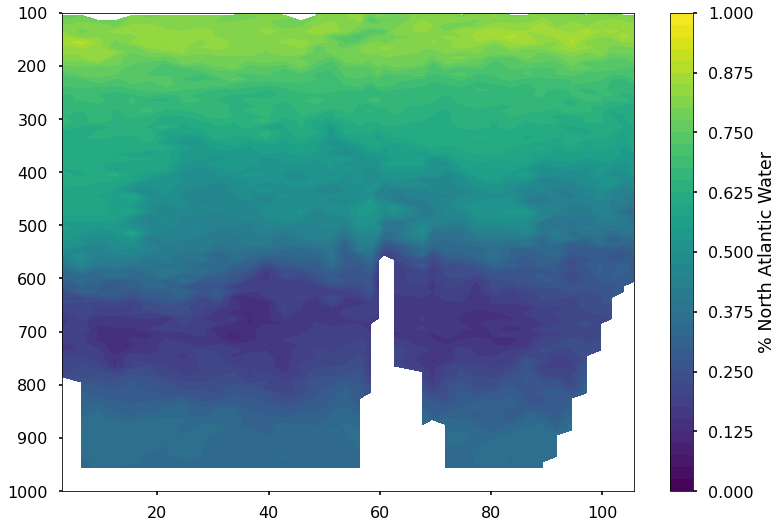

In [17]:
plt.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.naw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

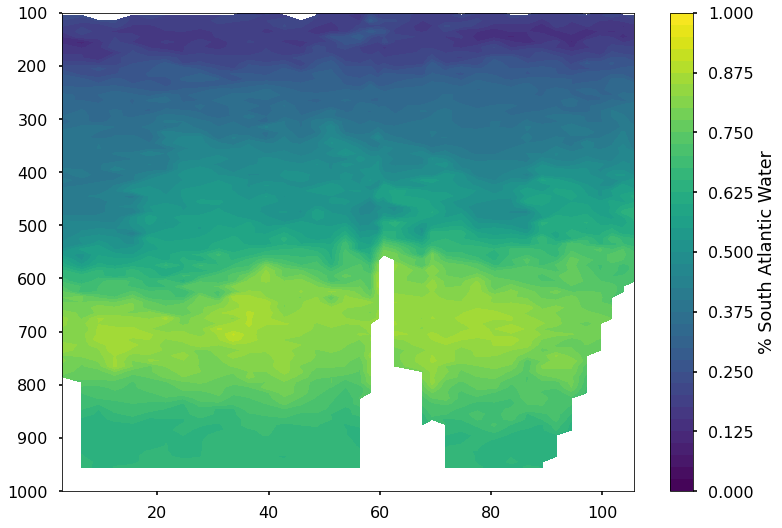

In [18]:
plt.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.saw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')

In [19]:
df_2021b_final = solve_endmember_fractions_single(subset_ds_2021b,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den,saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.752597836349149e-05
Original weighted sum squares: 3.752597836349149e-05
Post fix weighted sum squared: 3.752597836349149e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.752597836349149e-05
Original weighted sum squares: 3.752597836349149e-05
Post fix weighted sum squared: 3.752597836349149e-05
objective: 3.752597836349149e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015148705373155256
Original weighted sum squares: 0.0015148705373155256
Post fix weighted sum squared: 0.001514

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004010258559771222
Original weighted sum squares: 0.0004010258559771222
Post fix weighted sum squared: 0.00040102585597753544
objective: 0.00040102585597753544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006896810498592846
Original weighted sum squares: 0.0006896810498592846
Post fix weighted sum squared: 0.0006896810498594828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006896810498592846
Original weighted sum squares: 0.0006896810498592846
Post fix weighted sum squared: 0.0006896810498594828
objective: 0.0006896810498594828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.568026494859944e-07
Original weighted sum squares: 7.568026494859944e-07
Post fix weighted sum squared: 7.568026494859944e-07
On example 0 to 1 out of 1
status: optimal
optimal value 7.568026494859944e-07
Original weighted sum squares: 7.568026494859944e-07
Post fix weighted sum squared: 7.568026494859944e-07
objective: 7.568026494859944e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.021703844779952e-05
Original weighted sum squares: 8.021703844779952e-05
Post fix weighted sum squared: 8.021703844772697e-05
On example 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.1815471652170524e-05
Original weighted sum squares: 4.1815471652170524e-05
Post fix weighted sum squared: 4.1815471652170524e-05
objective: 4.1815471652170524e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.34367245600691e-06
Original weighted sum squares: 4.34367245600691e-06
Post fix weighted sum squared: 4.343672455984635e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.34367245600691e-06
Original weighted sum squares: 4.34367245600691e-06
Post fix weighted sum squared: 4.343672455984635e-06
objective: 4.343672455984635e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 3.541686433218941e-05
Original weighted sum squares: 3.541686433218941e-05
Post fix weighted sum squared: 3.541686433218941e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.541686433218941e-05
Original weighted sum squares: 3.541686433218941e-05
Post fix weighted sum squared: 3.541686433218941e-05
objective: 3.541686433218941e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020738022187656135
Original weighted sum squares: 0.00020738022187656135
Post fix weighted sum squared: 0.00020738022187666703
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020738022187656135
Original weighted sum squares: 0.00020738022187656135
Post fix weighted sum squared: 0.00020738022187666703
objective: 0.00020738022187666703
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004767103528809487
Original weighted sum squares: 0.004767103528809487
Post fix weighted sum squared: 0.004767103528809487
On example 0 to 1 out of 1
status: optimal
optimal value 0.004767103528809487
Original weighted sum squares: 0.004767103528809487
Post fix weighted sum squared: 0.004767103528809487
objective: 0.004767103528809487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007838094617957487
Original weighted sum squares: 0.0007838094617957487
Post fix weighted sum squared: 0.0007838094617

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.083948471902924e-06
Original weighted sum squares: 5.083948471902924e-06
Post fix weighted sum squared: 5.083948471902924e-06
objective: 5.083948471902924e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.98203494499036e-07
Original weighted sum squares: 1.98203494499036e-07
Post fix weighted sum squared: 1.982034944898686e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.98203494499036e-07
Original weighted sum squares: 1.98203494499036e-07
Post fix weighted sum squared: 1.982034944898686e-07
objective: 1.982034944898686e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018569706448692472
Original weighted sum squares: 0.00018569706448692472
Post fix weighted sum squared: 0.00018569706448692472
objective: 0.00018569706448692472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010722304729309313
Original weighted sum squares: 0.00010722304729309313
Post fix weighted sum squared: 0.00010722304729309313
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010722304729309313
Original weighted sum squares: 0.00010722304729309313
Post fix weighted sum squared: 0.00010722304729309313
objective: 0.00010722304729309313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000451002821648656
Original weighted sum squares: 0.000451002821648656
Post fix weighted sum squared: 0.00045100282164887957
objective: 0.00045100282164887957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002162737524349574
Original weighted sum squares: 0.0002162737524349574
Post fix weighted sum squared: 0.0002162737524349574
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002162737524349574
Original weighted sum squares: 0.0002162737524349574
Post fix weighted sum squared: 0.0002162737524349574
objective: 0.0002162737524349574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001065758464650395
Original weighted sum squares: 0.001065758464650395
Post fix weighted sum squared: 0.001065758464650395
objective: 0.001065758464650395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005420304462292354
Original weighted sum squares: 0.005420304462292354
Post fix weighted sum squared: 0.005420304462292354
On example 0 to 1 out of 1
status: optimal
optimal value 0.005420304462292354
Original weighted sum squares: 0.005420304462292354
Post fix weighted sum squared: 0.005420304462292354
objective: 0.005420304462292354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005370009272938323
Original weighted sum squares: 0.0005370009272938323
Post fix weighted sum squared: 0.0005370009272940147
objective: 0.0005370009272940147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035898598579212087
Original weighted sum squares: 0.00035898598579212087
Post fix weighted sum squared: 0.00035898598579212087
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035898598579212087
Original weighted sum squares: 0.00035898598579212087
Post fix weighted sum squared: 0.00035898598579212087
objective: 0.00035898598579212087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.964289198103487e-06
Original weighted sum squares: 1.964289198103487e-06
Post fix weighted sum squared: 1.964289198103487e-06
objective: 1.964289198103487e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.335154887297932e-06
Original weighted sum squares: 5.335154887297932e-06
Post fix weighted sum squared: 5.335154887297932e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.335154887297932e-06
Original weighted sum squares: 5.335154887297932e-06
Post fix weighted sum squared: 5.335154887297932e-06
objective: 5.335154887297932e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 6.792069550505051e-06
Original weighted sum squares: 6.792069550505051e-06
Post fix weighted sum squared: 6.792069550505051e-06
objective: 6.792069550505051e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.655756857069662e-06
Original weighted sum squares: 9.655756857069662e-06
Post fix weighted sum squared: 9.655756857093011e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.655756857069662e-06
Original weighted sum squares: 9.655756857069662e-06
Post fix weighted sum squared: 9.655756857093011e-06
objective: 9.655756857093011e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025891529396522464
Original weighted sum squares: 0.00025891529396522464
Post fix weighted sum squared: 0.0002589152939655668
objective: 0.0002589152939655668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015363004065818762
Original weighted sum squares: 0.00015363004065818762
Post fix weighted sum squared: 0.0001536300406583198
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015363004065818762
Original weighted sum squares: 0.00015363004065818762
Post fix weighted sum squared: 0.0001536300406583198
objective: 0.0001536300406583198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011897403336534479
Original weighted sum squares: 0.00011897403336534479
Post fix weighted sum squared: 0.00011897403336511917
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011897403336534479
Original weighted sum squares: 0.00011897403336534479
Post fix weighted sum squared: 0.00011897403336511917
objective: 0.00011897403336511917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022872409598079555
Original weighted sum squares: 0.00022872409598079555
Post fix weighted sum squared: 0.00022872409598079555
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022872409598079555
Original weighted sum squares: 0.00022872409598079555
Post fix weighted sum squared: 0.00022872409598079555
objective: 0.000228724095980

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004216618650010888
Original weighted sum squares: 0.0004216618650010888
Post fix weighted sum squared: 0.0004216618650010888
objective: 0.0004216618650010888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005288176585592854
Original weighted sum squares: 0.0005288176585592854
Post fix weighted sum squared: 0.0005288176585592854
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005288176585592854
Original weighted sum squares: 0.0005288176585592854
Post fix weighted sum squared: 0.0005288176585592854
objective: 0.0005288176585592854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.6377239354377529e-06
Original weighted sum squares: 1.6377239354377529e-06
Post fix weighted sum squared: 1.6377239354377529e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.6377239354377529e-06
Original weighted sum squares: 1.6377239354377529e-06
Post fix weighted sum squared: 1.6377239354377529e-06
objective: 1.6377239354377529e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005872092973651293
Original weighted sum squares: 0.0005872092973651293
Post fix weighted sum squared: 0.0005872092973657091
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005872092973651293
Original weighted sum squares: 0.0005872092973651293
Post fix weighted sum squared: 0.0005872092973657091
objective: 0.0005872092973657091
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000144666469674247
Original weighted sum squares: 0.000144666469674247
Post fix weighted sum squared: 0.0001446664696741218
On example 0 to 1 out of 1
status: optimal
optimal value 0.000144666469674247
Original weighted sum squares: 0.000144666469674247
Post fix weighted sum squared: 0.0001446664696741218
objective: 0.0001446664696741218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.026239587976423e-05
Original weighted sum squares: 7.026239587976423e-05
Post fix weighted sum squared: 7.026239587985375e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.026239587978577e-05
Original weighted sum squares: 7.026239587978577e-05
Post fix weighted sum squared: 7.026239587985375e-05
objective: 7.026239587985375e-05
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001062133284641819
Original weighted sum squares: 0.0001062133284641819
Post fix weighted sum squared: 0.000106213328464098
objective: 0.000106213328464098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.095357640846184e-05
Original weighted sum squares: 2.095357640846184e-05
Post fix weighted sum squared: 2.0953576408498796e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.095357640846184e-05
Original weighted sum squares: 2.095357640846184e-05
Post fix weighted sum squared: 2.0953576408498796e-05
objective: 2.0953576408498796e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018481238889185054
Original weighted sum squares: 0.00018481238889185054
Post fix weighted sum squared: 0.00018481238889185054
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018481238889185054
Original weighted sum squares: 0.00018481238889185054
Post fix weighted sum squared: 0.00018481238889185054
objective: 0.00018481238889185054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.608077891998155e-05
Original weighted sum squares: 7.608077891998155e-05
Post fix weighted sum squared: 7.60807789199149e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.608077891998155e-05
Original weighted sum squares: 7.608077891998155e-05
Post fix weighted sum squared: 7.60807789199149e-05
objective: 7.60807789199149e-05
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.1233697656522841e-05
Original weighted sum squares: 1.1233697656522841e-05
Post fix weighted sum squared: 1.1233697656522841e-05
objective: 1.1233697656522841e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.173512919917035e-06
Original weighted sum squares: 9.173512919917035e-06
Post fix weighted sum squared: 9.173512919949855e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.173512919917035e-06
Original weighted sum squares: 9.173512919917035e-06
Post fix weighted sum squared: 9.173512919949855e-06
objective: 9.173512919949855e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.087744156438996e-05
Original weighted sum squares: 6.087744156438996e-05
Post fix weighted sum squared: 6.087744156438996e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.087744156438996e-05
Original weighted sum squares: 6.087744156438996e-05
Post fix weighted sum squared: 6.087744156438996e-05
objective: 6.087744156438996e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001800828384359165
Original weighted sum squares: 0.0001800828384359165
Post fix weighted sum squared: 0.00018008283843577478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001800828384359165
Original weighted sum squares: 0.0001800828384359165
Post fix weighted sum squared: 0.00018008283843577478
objective: 0.00018008283843577478
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006530841415754811
Original weighted sum squares: 0.0006530841415754811
Post fix weighted sum squared: 0.0006530841415760284
objective: 0.0006530841415760284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.60974344439829e-05
Original weighted sum squares: 1.60974344439829e-05
Post fix weighted sum squared: 1.6097434443950634e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.60974344439829e-05
Original weighted sum squares: 1.60974344439829e-05
Post fix weighted sum squared: 1.6097434443950634e-05
objective: 1.6097434443950634e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 9.872232434789562e-06
Original weighted sum squares: 9.872232434789562e-06
Post fix weighted sum squared: 9.872232434755528e-06
objective: 9.872232434755528e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018284111654339868
Original weighted sum squares: 0.00018284111654339868
Post fix weighted sum squared: 0.00018284111654368298
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018284111654339868
Original weighted sum squares: 0.00018284111654339868
Post fix weighted sum squared: 0.00018284111654371898
objective: 0.00018284111654371898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.647928036752206e-05
Original weighted sum squares: 7.647928036752206e-05
Post fix weighted sum squared: 7.647928036752206e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.647928036752206e-05
Original weighted sum squares: 7.647928036752206e-05
Post fix weighted sum squared: 7.647928036752206e-05
objective: 7.647928036752206e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001014074385377146
Original weighted sum squares: 0.0001014074385377146
Post fix weighted sum squared: 0.00010140743853793012
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010140743853782236
Original weighted sum squares: 0.00010140743853782236
Post fix weighted sum squared: 0.00010140743853790435
objective: 0.00010140743853790435
End

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013751526580745
Original weighted sum squares: 0.00013751526580745
Post fix weighted sum squared: 0.00013751526580754205
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013751526580745
Original weighted sum squares: 0.00013751526580745
Post fix weighted sum squared: 0.00013751526580754205
objective: 0.00013751526580754205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.6442691106974463e-06
Original weighted sum squares: 2.6442691106974463e-06
Post fix weighted sum squared: 2.6442691107105236e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.6442691106974463e-06
Original weighted sum squares: 2.6442691106974463e-06
Post fix weighted sum squared: 2.6442691107105236e-06
objective: 2.6442691107105236e-06
Endmem

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.8200923937442e-05
Original weighted sum squares: 3.8200923937442e-05
Post fix weighted sum squared: 3.8200923937442e-05
objective: 3.8200923937442e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018351552991215916
Original weighted sum squares: 0.00018351552991215916
Post fix weighted sum squared: 0.00018351552991204757
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018351552991215916
Original weighted sum squares: 0.00018351552991215916
Post fix weighted sum squared: 0.00018351552991204757
objective: 0.00018351552991204757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002968436314177016
Original weighted sum squares: 0.0002968436314177016
Post fix weighted sum squared: 0.000296843631417557
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002968436314177016
Original weighted sum squares: 0.0002968436314177016
Post fix weighted sum squared: 0.000296843631417557
objective: 0.000296843631417557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024230345811413736
Original weighted sum squares: 0.00024230345811413736
Post fix weighted sum squared: 0.0002423034581138011
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024230345811413736
Original weighted sum squares: 0.00024230345811413736
Post fix weighted sum squared: 0.0002423034581138011
objective: 0.0002423034581138011
Endmemb

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.042351357079053e-06
Original weighted sum squares: 2.042351357079053e-06
Post fix weighted sum squared: 2.042351357094569e-06
objective: 2.042351357094569e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001344722473877178
Original weighted sum squares: 0.0001344722473877178
Post fix weighted sum squared: 0.00013447224738747114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001344722473877178
Original weighted sum squares: 0.0001344722473877178
Post fix weighted sum squared: 0.00013447224738747114
objective: 0.00013447224738747114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.651380699949009e-06
Original weighted sum squares: 4.651380699949009e-06
Post fix weighted sum squared: 4.651380699995856e-06
objective: 4.651380699995856e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018483049324377813
Original weighted sum squares: 0.00018483049324377813
Post fix weighted sum squared: 0.00018483049324392105
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018483049324374194
Original weighted sum squares: 0.00018483049324374194
Post fix weighted sum squared: 0.00018483049324388484
objective: 0.00018483049324388484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00026048092005412853
Original weighted sum squares: 0.00026048092005412853
Post fix weighted sum squared: 0.00026048092005412853
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026048092005412853
Original weighted sum squares: 0.00026048092005412853
Post fix weighted sum squared: 0.00026048092005412853
objective: 0.00026048092005412853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005205013995306879
Original weighted sum squares: 0.0005205013995306879
Post fix weighted sum squared: 0.0005205013995306879
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005205013995306303
Original weighted sum squares: 0.0005205013995306303
Post fix weighted sum squared: 0.0005205013995304424
objective: 0.0005205013995304424
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00015610370709446758
Original weighted sum squares: 0.00015610370709446758
Post fix weighted sum squared: 0.0001561037070946028
objective: 0.0001561037070946028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.759350906442326e-05
Original weighted sum squares: 4.759350906442326e-05
Post fix weighted sum squared: 4.7593509064365426e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.759350906442326e-05
Original weighted sum squares: 4.759350906442326e-05
Post fix weighted sum squared: 4.7593509064365426e-05
objective: 4.7593509064365426e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.520759793899464e-05
Original weighted sum squares: 5.520759793899464e-05
Post fix weighted sum squared: 5.520759793891468e-05
objective: 5.520759793891468e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.3900059600185253e-06
Original weighted sum squares: 1.3900059600185253e-06
Post fix weighted sum squared: 1.3900059600185253e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.3900059600185253e-06
Original weighted sum squares: 1.3900059600185253e-06
Post fix weighted sum squared: 1.3900059600185253e-06
objective: 1.3900059600185253e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004398339144932304
Original weighted sum squares: 0.0004398339144932304
Post fix weighted sum squared: 0.0004398339144932304
objective: 0.0004398339144932304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.262888645441347e-09
Original weighted sum squares: 8.262888645441347e-09
Post fix weighted sum squared: 8.262888645441347e-09
On example 0 to 1 out of 1
status: optimal
optimal value 8.262888645441347e-09
Original weighted sum squares: 8.262888645441347e-09
Post fix weighted sum squared: 8.262888645441347e-09
objective: 8.262888645441347e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002933851003864412
Original weighted sum squares: 0.0002933851003864412
Post fix weighted sum squared: 0.0002933851003864412
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002933851003864412
Original weighted sum squares: 0.0002933851003864412
Post fix weighted sum squared: 0.0002933851003864412
objective: 0.0002933851003864412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004138614843135298
Original weighted sum squares: 0.0004138614843135298
Post fix weighted sum squared: 0.0004138614843136981
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004138614843135298
Original weighted sum squares: 0.0004138614843135298
Post fix weighted sum squared: 0.0004138614843136981
objective: 0.0004138614843136981
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005127567633041319
Original weighted sum squares: 0.0005127567633041319
Post fix weighted sum squared: 0.0005127567633041319
objective: 0.0005127567633041319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002995678464729168
Original weighted sum squares: 0.0002995678464729168
Post fix weighted sum squared: 0.0002995678464732942
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002995678464729168
Original weighted sum squares: 0.0002995678464729168
Post fix weighted sum squared: 0.0002995678464732942
objective: 0.0002995678464732942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011512936826211442
Original weighted sum squares: 0.00011512936826211442
Post fix weighted sum squared: 0.00011512936826187832
objective: 0.00011512936826187832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5958897681414745e-05
Original weighted sum squares: 2.5958897681414745e-05
Post fix weighted sum squared: 2.5958897681414745e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5958897681414745e-05
Original weighted sum squares: 2.5958897681414745e-05
Post fix weighted sum squared: 2.5958897681414745e-05
objective: 2.5958897681414745e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3063379635986668e-05
Original weighted sum squares: 2.3063379635986668e-05
Post fix weighted sum squared: 2.3063379636038896e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3063379635986668e-05
Original weighted sum squares: 2.3063379635986668e-05
Post fix weighted sum squared: 2.3063379636038896e-05
objective: 2.3063379636038896e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010008381803078003
Original weighted sum squares: 0.00010008381803078003
Post fix weighted sum squared:

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035258973896831443
Original weighted sum squares: 0.00035258973896831443
Post fix weighted sum squared: 0.0003525897389687217
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035258973896831443
Original weighted sum squares: 0.00035258973896831443
Post fix weighted sum squared: 0.0003525897389687217
objective: 0.0003525897389687217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.670570620161721e-05
Original weighted sum squares: 3.670570620161721e-05
Post fix weighted sum squared: 3.670570620161721e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.670570620161721e-05
Original weighted sum squares: 3.670570620161721e-05
Post fix weighted sum squared: 3.670570620161721e-05
objective: 3.670570620161721e-05
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.5167729957796516e-05
Original weighted sum squares: 3.5167729957796516e-05
Post fix weighted sum squared: 3.516772995792653e-05
objective: 3.516772995792653e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.999551714050905e-05
Original weighted sum squares: 6.999551714050905e-05
Post fix weighted sum squared: 6.999551714050905e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.999551714050905e-05
Original weighted sum squares: 6.999551714050905e-05
Post fix weighted sum squared: 6.999551714050905e-05
objective: 6.999551714050905e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000419999713993897
Original weighted sum squares: 0.000419999713993897
Post fix weighted sum squared: 0.00041999971399417027
objective: 0.00041999971399417027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003262695257566184
Original weighted sum squares: 0.0003262695257566184
Post fix weighted sum squared: 0.0003262695257566184
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003262695257566184
Original weighted sum squares: 0.0003262695257566184
Post fix weighted sum squared: 0.0003262695257566184
objective: 0.0003262695257566184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00031234665219579706
Original weighted sum squares: 0.00031234665219579706
Post fix weighted sum squared: 0.0003123466521961847
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031234665219579706
Original weighted sum squares: 0.00031234665219579706
Post fix weighted sum squared: 0.0003123466521961847
objective: 0.0003123466521961847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.525141984323001e-05
Original weighted sum squares: 7.525141984323001e-05
Post fix weighted sum squared: 7.5251419843156e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.525141984323001e-05
Original weighted sum squares: 7.525141984323001e-05
Post fix weighted sum squared: 7.5251419843156e-05
objective: 7.5251419843156e-05
Endmember-idx map

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004612643344798417
Original weighted sum squares: 0.0004612643344798417
Post fix weighted sum squared: 0.00046126433448002676
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004612643344798417
Original weighted sum squares: 0.0004612643344798417
Post fix weighted sum squared: 0.00046126433448002676
objective: 0.00046126433448002676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019625834601905712
Original weighted sum squares: 0.00019625834601905712
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.288573617845897e-05
Original weighted sum squares: 2.288573617845897e-05
Post fix weighted sum squared: 2.2885736178417846e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.288573617845897e-05
Original weighted sum squares: 2.288573617845897e-05
Post fix weighted sum squared: 2.2885736178417846e-05
objective: 2.2885736178417846e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002540472830210275
Original weighted sum squares: 0.0002540472830210275
Post fix weighted sum squared: 0.0002540472830213757
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002540472830210275
Original weighted sum squares: 0.0002540472830210275
Post fix weighted sum squared: 0.0002540472830213757
objective: 0.0002540472830213757
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002779233585577946
Original weighted sum squares: 0.0002779233585577946
Post fix weighted sum squared: 0.00027792335855742747
objective: 0.00027792335855742747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004981132729939442
Original weighted sum squares: 0.0004981132729939442
Post fix weighted sum squared: 0.0004981132729937572
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004981132729939442
Original weighted sum squares: 0.0004981132729939442
Post fix weighted sum squared: 0.0004981132729937572
objective: 0.0004981132729937572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.739259972388833e-05
Original weighted sum squares: 5.739259972388833e-05
Post fix weighted sum squared: 5.739259972388833e-05
objective: 5.739259972388833e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039005778132235704
Original weighted sum squares: 0.00039005778132235704
Post fix weighted sum squared: 0.0003900577813221396
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039005778132235704
Original weighted sum squares: 0.00039005778132235704
Post fix weighted sum squared: 0.0003900577813221396
objective: 0.0003900577813221396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002574196192832261
Original weighted sum squares: 0.0002574196192832261
Post fix weighted sum squared: 0.00025741961928340174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002574196192832261
Original weighted sum squares: 0.0002574196192832261
Post fix weighted sum squared: 0.00025741961928340174
objective: 0.00025741961928340174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018685877905721
Original weighted sum squares: 0.00018685877905721
Post fix weighted sum squared: 0.0001868587790570596
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018685877905721
Original weighted sum squares: 0.00018685877905721
Post fix weighted sum squared: 0.0001868587790570596
objective: 0.0001868587790570596
Endmember-idx

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002889264294182075
Original weighted sum squares: 0.0002889264294182075
Post fix weighted sum squared: 0.0002889264294176075
objective: 0.0002889264294176075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012381873708153035
Original weighted sum squares: 0.00012381873708153035
Post fix weighted sum squared: 0.00012381873708153035
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012381873708153035
Original weighted sum squares: 0.00012381873708153035
Post fix weighted sum squared: 0.00012381873708153035
objective: 0.00012381873708153035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000732490294988312
Original weighted sum squares: 0.000732490294988312
Post fix weighted sum squared: 0.000732490294988312
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007324902949882475
Original weighted sum squares: 0.0007324902949882475
Post fix weighted sum squared: 0.0007324902949882475
objective: 0.0007324902949882475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001689846844546093
Original weighted sum squares: 0.0001689846844546093
Post fix weighted sum squared: 0.00016898468445449867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001689846844546093
Original weighted sum squares: 0.0001689846844546093
Post fix weighted sum squared: 0.00016898468445449867
objective: 0.00016898468445449867
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.929979732985855e-05
Original weighted sum squares: 4.929979732985855e-05
Post fix weighted sum squared: 4.929979732985855e-05
objective: 4.929979732985855e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005639398401648632
Original weighted sum squares: 0.0005639398401648632
Post fix weighted sum squared: 0.0005639398401643423
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005639398401648632
Original weighted sum squares: 0.0005639398401648632
Post fix weighted sum squared: 0.0005639398401643423
objective: 0.0005639398401643423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00054481923949069
Original weighted sum squares: 0.00054481923949069
Post fix weighted sum squared: 0.0005448192394909468
objective: 0.0005448192394909468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027958690893332364
Original weighted sum squares: 0.00027958690893332364
Post fix weighted sum squared: 0.00027958690893332364
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027958690893332364
Original weighted sum squares: 0.00027958690893332364
Post fix weighted sum squared: 0.00027958690893332364
objective: 0.00027958690893332364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011141623852093223
Original weighted sum squares: 0.00011141623852093223
Post fix weighted sum squared: 0.00011141623852107394
objective: 0.00011141623852107394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004450943818667771
Original weighted sum squares: 0.0004450943818667771
Post fix weighted sum squared: 0.00044509438186700724
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004450943818667771
Original weighted sum squares: 0.0004450943818667771
Post fix weighted sum squared: 0.00044509438186700724
objective: 0.00044509438186700724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000422175784095418
Original weighted sum squares: 0.000422175784095418
Post fix weighted sum squared: 0.000422175784095191
On example 0 to 1 out of 1
status: optimal
optimal value 0.000422175784095418
Original weighted sum squares: 0.000422175784095418
Post fix weighted sum squared: 0.000422175784095191
objective: 0.000422175784095191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002948595232897382
Original weighted sum squares: 0.0002948595232897382
Post fix weighted sum squared: 0.0002948595232897382
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002948595232896977
Original weighted sum squares: 0.0002948595232896977
Post fix weighted sum squared: 0.0002948595232896977
objective: 0.0002948595232896977
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012358409902872095
Original weighted sum squares: 0.00012358409902872095
Post fix weighted sum squared: 0.00012358409902872095
objective: 0.00012358409902872095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012449508637108538
Original weighted sum squares: 0.00012449508637108538
Post fix weighted sum squared: 0.00012449508637108538
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012449508637108538
Original weighted sum squares: 0.00012449508637108538
Post fix weighted sum squared: 0.00012449508637108538
objective: 0.00012449508637108538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.1273573716324473e-05
Original weighted sum squares: 2.1273573716324473e-05
Post fix weighted sum squared: 2.1273573716324473e-05
objective: 2.1273573716324473e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016417724055378845
Original weighted sum squares: 0.00016417724055378845
Post fix weighted sum squared: 0.00016417724055378845
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016417724055396056
Original weighted sum squares: 0.00016417724055396056
Post fix weighted sum squared: 0.00016417724055396056
objective: 0.00016417724055396056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007485267139632052
Original weighted sum squares: 0.0007485267139632052
Post fix weighted sum squared: 0.0007485267139632052
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007485267139632052
Original weighted sum squares: 0.0007485267139632052
Post fix weighted sum squared: 0.0007485267139632052
objective: 0.0007485267139632052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000463267308417208
Original weighted sum squares: 0.000463267308417208
Post fix weighted sum squared: 0.000463267308417208
On example 0 to 1 out of 1
status: optimal
optimal value 0.000463267308417208
Original weighted sum squares: 0.000463267308417208
Post fix weighted sum squared: 0.000463267308417208
objective: 0.000463267308417208
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.844824121300812e-05
Original weighted sum squares: 3.844824121300812e-05
Post fix weighted sum squared: 3.844824121300812e-05
objective: 3.844824121300812e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007266758559225967
Original weighted sum squares: 0.0007266758559225967
Post fix weighted sum squared: 0.0007266758559225967
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007266758559225967
Original weighted sum squares: 0.0007266758559225967
Post fix weighted sum squared: 0.0007266758559225967
objective: 0.0007266758559225967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00027572232459915447
Original weighted sum squares: 0.00027572232459915447
Post fix weighted sum squared: 0.00027572232459915447
objective: 0.00027572232459915447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016555581126956862
Original weighted sum squares: 0.00016555581126956862
Post fix weighted sum squared: 0.00016555581126971206
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016555581126956862
Original weighted sum squares: 0.00016555581126956862
Post fix weighted sum squared: 0.00016555581126971206
objective: 0.00016555581126971206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00045458924098216763
Original weighted sum squares: 0.00045458924098216763
Post fix weighted sum squared: 0.00045458924098216763
objective: 0.00045458924098216763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000429307553132551
Original weighted sum squares: 0.000429307553132551
Post fix weighted sum squared: 0.000429307553132551
On example 0 to 1 out of 1
status: optimal
optimal value 0.000429307553132551
Original weighted sum squares: 0.000429307553132551
Post fix weighted sum squared: 0.000429307553132551
objective: 0.000429307553132551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003739776970961723
Original weighted sum squares: 0.0003739776970961723
Post fix weighted sum squared: 0.00037397769709638837
objective: 0.00037397769709638837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006079744899538148
Original weighted sum squares: 0.0006079744899538148
Post fix weighted sum squared: 0.0006079744899545763
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006079744899538148
Original weighted sum squares: 0.0006079744899538148
Post fix weighted sum squared: 0.0006079744899545763
objective: 0.0006079744899545763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011070959092996127
Original weighted sum squares: 0.00011070959092996127
Post fix weighted sum squared: 0.00011070959092993733
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011070959092996127
Original weighted sum squares: 0.00011070959092996127
Post fix weighted sum squared: 0.00011070959092993733
objective: 0.00011070959092993733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004793078812098465
Original weighted sum squares: 0.0004793078812098465
Post fix weighted sum squared: 0.0004793078812098465
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004793078812098465
Original weighted sum squares: 0.0004793078812098465
Post fix weighted sum squared: 0.0004793078812098465
objective: 0.0004793078812098465
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035144634805949154
Original weighted sum squares: 0.00035144634805949154
Post fix weighted sum squared: 0.00035144634805949154
objective: 0.00035144634805949154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012782345854135246
Original weighted sum squares: 0.00012782345854135246
Post fix weighted sum squared: 0.00012782345854135246
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012782345854135246
Original weighted sum squares: 0.00012782345854135246
Post fix weighted sum squared: 0.00012782345854135246
objective: 0.00012782345854135246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00012965659843973155
Original weighted sum squares: 0.00012965659843973155
Post fix weighted sum squared: 0.00012965659843973155
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012965659843957791
Original weighted sum squares: 0.00012965659843957791
Post fix weighted sum squared: 0.00012965659843957791
objective: 0.00012965659843957791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018797444370633316
Original weighted sum squares: 0.00018797444370633316
Post fix weighted sum squared: 0.00018797444370614885
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018797444370633316
Original weighted sum squares: 0.00018797444370633316
Post fix weighted sum squared: 0.00018797444370614885
objective: 0.00018797444370614885
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031759851715773573
Original weighted sum squares: 0.00031759851715773573
Post fix weighted sum squared: 0.00031759851715773573
objective: 0.00031759851715773573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023972863867112058
Original weighted sum squares: 0.00023972863867112058
Post fix weighted sum squared: 0.00023972863867129468
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023972863867112058
Original weighted sum squares: 0.00023972863867112058
Post fix weighted sum squared: 0.00023972863867129468
objective: 0.00023972863867129468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00030144982200443443
Original weighted sum squares: 0.00030144982200443443
Post fix weighted sum squared: 0.00030144982200443443
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030144982200443443
Original weighted sum squares: 0.00030144982200443443
Post fix weighted sum squared: 0.00030144982200443443
objective: 0.00030144982200443443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000519662125835376
Original weighted sum squares: 0.000519662125835376
Post fix weighted sum squared: 0.000519662125835122
On example 0 to 1 out of 1
status: optimal
optimal value 0.000519662125835376
Original weighted sum squares: 0.000519662125835376
Post fix weighted sum squared: 0.000519662125835122
objective: 0.000519662125835122
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00017720036729629011
Original weighted sum squares: 0.00017720036729629011
Post fix weighted sum squared: 0.00017720036729643884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017720036729629011
Original weighted sum squares: 0.00017720036729629011
Post fix weighted sum squared: 0.00017720036729643884
objective: 0.00017720036729643884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030195740537444695
Original weighted sum squares: 0.00030195740537444695
Post fix weighted sum squared: 0.0003019574053746419
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030195740537444695
Original weighted sum squares: 0.00030195740537444695
Post fix weighted sum squared: 0.0003019574053746419
objective: 0.00030195740537464

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006221167157056564
Original weighted sum squares: 0.0006221167157056564
Post fix weighted sum squared: 0.0006221167157059355
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006221167157057133
Original weighted sum squares: 0.0006221167157057133
Post fix weighted sum squared: 0.0006221167157059923
objective: 0.0006221167157059923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013640586972401924
Original weighted sum squares: 0.00013640586972401924
Post fix weighted sum squared: 0.00013640586972401924
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013640586972401924
Original weighted sum squares: 0.00013640586972401924
Post fix weighted sum squared: 0.00013640586972401924
objective: 0.00013640586972401924
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00015814449195082218
Original weighted sum squares: 0.00015814449195082218
Post fix weighted sum squared: 0.00015814449195082218
objective: 0.00015814449195082218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003964417034470775
Original weighted sum squares: 0.0003964417034470775
Post fix weighted sum squared: 0.0003964417034470775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003964417034470775
Original weighted sum squares: 0.0003964417034470775
Post fix weighted sum squared: 0.0003964417034470775
objective: 0.0003964417034470775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021714463211586224
Original weighted sum squares: 0.00021714463211586224
Post fix weighted sum squared: 0.00021714463211586224
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021714463211586224
Original weighted sum squares: 0.00021714463211586224
Post fix weighted sum squared: 0.00021714463211586224
objective: 0.00021714463211586224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022065967685488144
Original weighted sum squares: 0.00022065967685488144
Post fix weighted sum squared: 0.00022065967685488144
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022065967685488144
Original weighted sum squares: 0.00022065967685488144
Post fix weighted sum squared: 0.00022065967685488144
objective: 0.000220659676854

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001206218219261641
Original weighted sum squares: 0.0001206218219261641
Post fix weighted sum squared: 0.0001206218219261641
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001206218219261641
Original weighted sum squares: 0.0001206218219261641
Post fix weighted sum squared: 0.0001206218219261641
objective: 0.0001206218219261641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017508799068345545
Original weighted sum squares: 0.00017508799068345545
Post fix weighted sum squared: 0.00017508799068375328
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017508799068345545
Original weighted sum squares: 0.00017508799068345545
Post fix weighted sum squared: 0.00017508799068375328
objective: 0.00017508799068375328
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022875757072293214
Original weighted sum squares: 0.00022875757072293214
Post fix weighted sum squared: 0.00022875757072313586
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022875757072293214
Original weighted sum squares: 0.00022875757072293214
Post fix weighted sum squared: 0.00022875757072313586
objective: 0.00022875757072313586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003609434955813664
Original weighted sum squares: 0.0003609434955813664
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0005151243308442517
Original weighted sum squares: 0.0005151243308442517
Post fix weighted sum squared: 0.0005151243308439974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005151243308442517
Original weighted sum squares: 0.0005151243308442517
Post fix weighted sum squared: 0.0005151243308439974
objective: 0.0005151243308439974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018868150739429802
Original weighted sum squares: 0.00018868150739429802
Post fix weighted sum squared: 0.0001886815073944526
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018868150739429802
Original weighted sum squares: 0.00018868150739429802
Post fix weighted sum squared: 0.0001886815073944526
objective: 0.0001886815073944526
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00021751406724285276
Original weighted sum squares: 0.00021751406724285276
Post fix weighted sum squared: 0.00021751406724285276
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021751406724268655
Original weighted sum squares: 0.00021751406724268655
Post fix weighted sum squared: 0.00021751406724268655
objective: 0.00021751406724268655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005673482166845083
Original weighted sum squares: 0.0005673482166845083
Post fix weighted sum squared: 0.0005673482166845083
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005673482166845083
Original weighted sum squares: 0.0005673482166845083
Post fix weighted sum squared: 0.0005673482166845083
objective: 0.0005673482166845083
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041309381578162087
Original weighted sum squares: 0.00041309381578162087
Post fix weighted sum squared: 0.000413093815781391
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041309381578162087
Original weighted sum squares: 0.00041309381578162087
Post fix weighted sum squared: 0.000413093815781391
objective: 0.000413093815781391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022625292114824644
Original weighted sum squares: 0.00022625292114824644
Post fix weighted sum squared: 0.00022625292114807646
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022625292114824644
Original weighted sum squares: 0.00022625292114824644
Post fix weighted sum squared: 0.00022625292114807646
objective: 0.00022625292114807646


/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003057720776457548
Original weighted sum squares: 0.0003057720776457548
Post fix weighted sum squared: 0.000305772077645952
objective: 0.000305772077645952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000338694212649196
Original weighted sum squares: 0.000338694212649196
Post fix weighted sum squared: 0.000338694212649196
On example 0 to 1 out of 1
status: optimal
optimal value 0.000338694212649196
Original weighted sum squares: 0.000338694212649196
Post fix weighted sum squared: 0.000338694212649196
objective: 0.000338694212649196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005919244690189085
Original weighted sum squares: 0.0005919244690189085
Post fix weighted sum squared: 0.0005919244690189085
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005919244690189085
Original weighted sum squares: 0.0005919244690189085
Post fix weighted sum squared: 0.0005919244690189085
objective: 0.0005919244690189085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004275806603752459
Original weighted sum squares: 0.0004275806603752459
Post fix weighted sum squared: 0.000427

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00035243725760916847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004610063259090332
Original weighted sum squares: 0.0004610063259090332
Post fix weighted sum squared: 0.0004610063259090332
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004610063259090332
Original weighted sum squares: 0.0004610063259090332
Post fix weighted sum squared: 0.0004610063259090332
objective: 0.0004610063259090332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024361848014120327
Original weighted sum squares: 0.00024361848014120327
Post fix weig

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006700468227658521
Original weighted sum squares: 0.0006700468227658521
Post fix weighted sum squared: 0.0006700468227658521
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006700468227658521
Original weighted sum squares: 0.0006700468227658521
Post fix weighted sum squared: 0.0006700468227658521
objective: 0.0006700468227658521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004418997141562838
Original weighted sum squares: 0.0004418997141562838
Post fix weighted sum squared: 0.00044

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003351752723940077
Original weighted sum squares: 0.0003351752723940077
Post fix weighted sum squared: 0.0003351752723940077
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003351752723940077
Original weighted sum squares: 0.0003351752723940077
Post fix weighted sum squared: 0.0003351752723940077
objective: 0.0003351752723940077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004193371074886386
Original weighted sum squares: 0.0004193371074886386
Post fix weighted sum squared: 0.000419

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003290548328552164
Original weighted sum squares: 0.0003290548328552164
Post fix weighted sum squared: 0.0003290548328552164
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003290548328552164
Original weighted sum squares: 0.0003290548328552164
Post fix weighted sum squared: 0.0003290548328552164
objective: 0.0003290548328552164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002647303753623857
Original weighted sum squares: 0.0002647303753623857
Post fix weighted sum squared: 0.00026473037536257
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026473037536260566
Original weighted sum squares: 0.00026473037536260566
Post fix weighted sum squared: 0.00026473037536260566
objective: 0.00026473037536260566
Endmem

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006394900454563221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002699603624006819
Original weighted sum squares: 0.0002699603624006819
Post fix weighted sum squared: 0.0002699603624008672
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002699603624006819
Original weighted sum squares: 0.0002699603624006819
Post fix weighted sum squared: 0.0002699603624008672
objective: 0.0002699603624008672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005153949298852527
Original weighted sum squares: 0.0005153949298852527
Post fix weighte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003851538662165549
Original weighted sum squares: 0.0003851538662165549
Post fix weighted sum squared: 0.00038515386621677805
objective: 0.00038515386621677805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005139479041259933
Original weighted sum squares: 0.0005139479041259933
Post fix weighted sum squared: 0.0005139479041270175
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005139479041259933
Original weighted sum squares: 0.0005139479041259933
Post fix weighted sum squared: 0.0005139479041270175
objective: 0.0005139479041270175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005012224133558977
Original weighted sum squares: 0.0005012224133558977
Post fix weighted sum squared: 0.0005012224133558977
objective: 0.0005012224133558977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004120417122418469
Original weighted sum squares: 0.0004120417122418469
Post fix weighted sum squared: 0.0004120417122418018
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004120417122418469
Original weighted sum squares: 0.0004120417122418469
Post fix weighted sum squared: 0.0004120417122418018
objective: 0.0004120417122418018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025949885418527496
Original weighted sum squares: 0.00025949885418527496
Post fix weighted sum squared: 0.00025949885418527496
objective: 0.00025949885418527496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023947993857217038
Original weighted sum squares: 0.00023947993857217038
Post fix weighted sum squared: 0.00023947993857217038
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023947993857217038
Original weighted sum squares: 0.00023947993857217038
Post fix weighted sum squared: 0.00023947993857217038
objective: 0.00023947993857217038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003528831098541351
Original weighted sum squares: 0.0003528831098541351
Post fix weighted sum squared: 0.00035288310985392084
objective: 0.00035288310985392084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038924288838881936
Original weighted sum squares: 0.00038924288838881936
Post fix weighted sum squared: 0.00038924288838881936
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038924288838881936
Original weighted sum squares: 0.00038924288838881936
Post fix weighted sum squared: 0.00038924288838881936
objective: 0.00038924288838881936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028962494008722805
Original weighted sum squares: 0.00028962494008722805
Post fix weighted sum squared: 0.00028962494008722805
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028962494008722805
Original weighted sum squares: 0.00028962494008722805
Post fix weighted sum squared: 0.00028962494008722805
objective: 0.00028962494008722805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027385935867084096
Original weighted sum squares: 0.00027385935867084096
Post fix weighted sum squared: 0.00027385935867084096
O

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005188525010964574
Original weighted sum squares: 0.0005188525010964574
Post fix weighted sum squared: 0.0005188525010964574
objective: 0.0005188525010964574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038330641459416806
Original weighted sum squares: 0.00038330641459416806
Post fix weighted sum squared: 0.0003833064145939452
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038330641459416806
Original weighted sum squares: 0.00038330641459416806
Post fix weighted sum squared: 0.0003833064145939452
objective: 0.0003833064145939452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035482737728442684
Original weighted sum squares: 0.00035482737728442684
Post fix weighted sum squared: 0.00035482737728442684
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035482737728442684
Original weighted sum squares: 0.00035482737728442684
Post fix weighted sum squared: 0.00035482737728442684
objective: 0.00035482737728442684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003062640494949418
Original weighted sum squares: 0.0003062640494949418
Post fix weighted sum squared: 0.0003062640494951396
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003062640494949032
Original weighted sum squares: 0.0003062640494949032
Post fix weighted sum squared: 0.0003062640494949032
objective: 0.0003062640494949032
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018387845268772525
Original weighted sum squares: 0.00018387845268772525
Post fix weighted sum squared: 0.00018387845268772525
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018387845268772525
Original weighted sum squares: 0.00018387845268772525
Post fix weighted sum squared: 0.00018387845268772525
objective: 0.00018387845268772525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002678289851700922
Original weighted sum squares: 0.0002678289851700922
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025213803391133625
Original weighted sum squares: 0.00025213803391133625
Post fix weighted sum squared: 0.00025213803391133625
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025213803391133625
Original weighted sum squares: 0.00025213803391133625
Post fix weighted sum squared: 0.00025213803391133625
objective: 0.00025213803391133625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003812380425461765
Original weighted sum squares: 0.0003812380425461765
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019395880723712221
Original weighted sum squares: 0.00019395880723712221
Post fix weighted sum squared: 0.00019395880723712221
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019395880723712221
Original weighted sum squares: 0.00019395880723712221
Post fix weighted sum squared: 0.00019395880723712221
objective: 0.00019395880723712221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003470294050418032
Original weighted sum squares: 0.0003470294050418032
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00030142577858416916
Original weighted sum squares: 0.00030142577858416916
Post fix weighted sum squared: 0.0003014257785841322
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030142577858416916
Original weighted sum squares: 0.00030142577858416916
Post fix weighted sum squared: 0.0003014257785841322
objective: 0.0003014257785841322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003724254829839723
Original weighted sum squares: 0.0003724254829839723
Post fix weighted sum squared: 0.0003724254829839723
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003724254829839723
Original weighted sum squares: 0.0003724254829839723
Post fix weighted sum squared: 0.0003724254829839723
objective: 0.0003724254829839723
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003137431175055835
Original weighted sum squares: 0.0003137431175055835
Post fix weighted sum squared: 0.0003137431175051422
objective: 0.0003137431175051422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044057567887521447
Original weighted sum squares: 0.00044057567887521447
Post fix weighted sum squared: 0.00044057567887521447
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044057567887521447
Original weighted sum squares: 0.00044057567887521447
Post fix weighted sum squared: 0.00044057567887521447
objective: 0.00044057567887521447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002051093136270741
Original weighted sum squares: 0.0002051093136270741
Post fix weighted sum squared: 0.0002051093136270741
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002051093136272682
Original weighted sum squares: 0.0002051093136272682
Post fix weighted sum squared: 0.0002051093136272682
objective: 0.0002051093136272682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004135639399416554
Original weighted sum squares: 0.0004135639399416554
Post fix weighted sum squared: 0.000413

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031453742145335755
Original weighted sum squares: 0.00031453742145335755
Post fix weighted sum squared: 0.00031453742145359803
objective: 0.00031453742145359803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002583699047477818
Original weighted sum squares: 0.0002583699047477818
Post fix weighted sum squared: 0.00025836990474756386
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002583699047477818
Original weighted sum squares: 0.0002583699047477818
Post fix weighted sum squared: 0.00025836990474756386
objective: 0.00025836990474756386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001997958780479478
Original weighted sum squares: 0.0001997958780479478
Post fix weighted sum squared: 0.0001997958780479478
objective: 0.0001997958780479478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003967847669990376
Original weighted sum squares: 0.0003967847669990376
Post fix weighted sum squared: 0.00039678476699880856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003967847669990376
Original weighted sum squares: 0.0003967847669990376
Post fix weighted sum squared: 0.00039678476699880856
objective: 0.00039678476699880856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004527093616176418
Original weighted sum squares: 0.0004527093616176418
Post fix weighted sum squared: 0.0004527093616176418
objective: 0.0004527093616176418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004554371126361851
Original weighted sum squares: 0.0004554371126361851
Post fix weighted sum squared: 0.00045543711263642986
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004554371126361851
Original weighted sum squares: 0.0004554371126361851
Post fix weighted sum squared: 0.00045543711263642986
objective: 0.00045543711263642986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006262927340930019
Original weighted sum squares: 0.0006262927340930019
Post fix weighted sum squared: 0.0006262927340927132
objective: 0.0006262927340927132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002690464037038909
Original weighted sum squares: 0.0002690464037038909
Post fix weighted sum squared: 0.00026904640370370344
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002690464037038909
Original weighted sum squares: 0.0002690464037038909
Post fix weighted sum squared: 0.00026904640370370344
objective: 0.00026904640370370344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000267093362751743
Original weighted sum squares: 0.000267093362751743
Post fix weighted sum squared: 0.000267093362751743
objective: 0.000267093362751743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002476894483791142
Original weighted sum squares: 0.0002476894483791142
Post fix weighted sum squared: 0.0002476894483791142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002476894483791142
Original weighted sum squares: 0.0002476894483791142
Post fix weighted sum squared: 0.00024768944837929376
objective: 0.00024768944837929376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00033458839521616717
Original weighted sum squares: 0.00033458839521616717
Post fix weighted sum squared: 0.00033458839521616717
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033458839521616717
Original weighted sum squares: 0.00033458839521616717
Post fix weighted sum squared: 0.00033458839521616717
objective: 0.00033458839521616717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038238367335597826
Original weighted sum squares: 0.00038238367335597826
Post fix weighted sum squared: 0.00038238367335597826
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038238367335597826
Original weighted sum squares: 0.00038238367335597826
Post fix weighted sum squared: 0.00038238367335597826
objective: 0.000382383673355

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.0005270962162258434
Original weighted sum squares: 0.0005270962162258434
Post fix weighted sum squared: 0.0005270962162257957
objective: 0.0005270962162257957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004411313673415433
Original weighted sum squares: 0.0004411313673415433
Post fix weighted sum squared: 0.0004411313673415433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004411313673415433
Original weighted sum squares: 0.0004411313673415433
Post fix weighted sum squared: 0.0004411313673415433
objective: 0.0004411313673415433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005694653512849774
Original weighted sum squares: 0.0005694653512849774
Post fix weighted sum squared: 0.0005694653512852521
objective: 0.0005694653512852521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003146322710815461
Original weighted sum squares: 0.0003146322710815461
Post fix weighted sum squared: 0.0003146322710815461
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003146322710815461
Original weighted sum squares: 0.0003146322710815461
Post fix weighted sum squared: 0.0003146322710815461
objective: 0.0003146322710815461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003595529304913651
Original weighted sum squares: 0.0003595529304913651
Post fix weighted sum squared: 0.0003595529304913651
objective: 0.0003595529304913651
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018960756318396203
Original weighted sum squares: 0.00018960756318396203
Post fix weighted sum squared: 0.00018960756318396203
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018960756318396203
Original weighted sum squares: 0.00018960756318396203
Post fix weighted sum squared: 0.00018960756318396203
objective: 0.00018960756318396203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002398067944006104
Original weighted sum squares: 0.0002398067944006104
Post fix weighted sum squared: 0.0002398067944006104
objective: 0.0002398067944006104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003391835925783878
Original weighted sum squares: 0.0003391835925783878
Post fix weighted sum squared: 0.0003391835925777164
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003391835925783878
Original weighted sum squares: 0.0003391835925783878
Post fix weighted sum squared: 0.0003391835925777164
objective: 0.0003391835925777164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003472252619944004
Original weighted sum squares: 0.0003472252619944004
Post fix weighted sum squared: 0.0003472252619944004
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003472252619944004
Original weighted sum squares: 0.0003472252619944004
Post fix weighted sum squared: 0.0003472252619944004
objective: 0.0003472252619944004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000470317096433059
Original weighted sum squares: 0.000470317096433059
Post fix weighted sum squared: 0.0004703170964333087
On example 0 to 1 out of 1
status: optimal
optimal value 0.000470317096433059
Original weighted sum squares: 0.000470317096433059
Post fix weighted sum squared: 0.0004703170964333087
objective: 0.0004703170964333087
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006688024126693171
Original weighted sum squares: 0.0006688024126693171
Post fix weighted sum squared: 0.0006688024126690176
objective: 0.0006688024126690176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004275292397537592
Original weighted sum squares: 0.0004275292397537592
Post fix weighted sum squared: 0.0004275292397537592
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042752923975351994
Original weighted sum squares: 0.00042752923975351994
Post fix weighted sum squared: 0.0004275292397537592
objective: 0.0004275292397537592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003748188466150853
Original weighted sum squares: 0.0003748188466150853
Post fix weighted sum squared: 0.00037481884661526776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003748188466150853
Original weighted sum squares: 0.0003748188466150853
Post fix weighted sum squared: 0.00037481884661526776
objective: 0.00037481884661526776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003841556242400837
Original weighted sum squares: 0.0003841556242400837
Post fix weighted sum squared: 0.00038415562424057564
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003841556242400837
Original weighted sum squares: 0.0003841556242400837
Post fix weighted sum squared: 0.00038415562424057564
objective: 0.00038415562424057564
En

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000683988217373846
Original weighted sum squares: 0.000683988217373846
Post fix weighted sum squared: 0.000683988217373846
On example 0 to 1 out of 1
status: optimal
optimal value 0.000683988217373846
Original weighted sum squares: 0.000683988217373846
Post fix weighted sum squared: 0.000683988217373846
objective: 0.000683988217373846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003179946705684849
Original weighted sum squares: 0.0003179946705684849
Post fix weighted sum squared: 0.0003179946705684849
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003179946705684849
Original weighted sum squares: 0.0003179946705684849
Post fix weighted sum squared: 0.0003179946705684849
objective: 0.0003179946705684849
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003484495214356901
Original weighted sum squares: 0.0003484495214356901
Post fix weighted sum squared: 0.0003484495214356901
objective: 0.0003484495214356901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040004713062466056
Original weighted sum squares: 0.00040004713062466056
Post fix weighted sum squared: 0.00040004713062466056
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040004713062442984
Original weighted sum squares: 0.00040004713062442984
Post fix weighted sum squared: 0.00040004713062442984
objective: 0.00040004713062442984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002919934824244416
Original weighted sum squares: 0.0002919934824244416
Post fix weighted sum squared: 0.00029199348242463826
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002919934824244416
Original weighted sum squares: 0.0002919934824244416
Post fix weighted sum squared: 0.00029199348242463826
objective: 0.00029199348242463826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004849357825748031
Original weighted sum squares: 0.0004849357825748031
Post fix weighted sum squared: 0.0004849357825742948
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004849357825748031
Original weighted sum squares: 0.0004849357825748031
Post fix weighted sum squared: 0.0004849357825742948
objective: 0.0004849357825742948
Endme

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004835504947518886
Original weighted sum squares: 0.0004835504947518886
Post fix weighted sum squared: 0.0004835504947521443
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004835504947518886
Original weighted sum squares: 0.0004835504947518886
Post fix weighted sum squared: 0.0004835504947521443
objective: 0.0004835504947521443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030220021881742064
Original weighted sum squares: 0.00030220021881742064
Post fix weighted sum squared: 0.00030220021881742064
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030220021881742064
Original weighted sum squares: 0.00030220021881742064
Post fix weighted sum squared: 0.00030220021881742064
objective: 0.00030220021881742064
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035844479047208294
Original weighted sum squares: 0.00035844479047208294
Post fix weighted sum squared: 0.00035844479047251803
objective: 0.00035844479047251803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005908915264526061
Original weighted sum squares: 0.0005908915264526061
Post fix weighted sum squared: 0.0005908915264523246
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005908915264526061
Original weighted sum squares: 0.0005908915264526061
Post fix weighted sum squared: 0.0005908915264523246
objective: 0.0005908915264523246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00030089093481062154
Original weighted sum squares: 0.00030089093481062154
Post fix weighted sum squared: 0.0003008909348104208
objective: 0.0003008909348104208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005089846330183844
Original weighted sum squares: 0.0005089846330183844
Post fix weighted sum squared: 0.0005089846330183844
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005089846330183844
Original weighted sum squares: 0.0005089846330183844
Post fix weighted sum squared: 0.0005089846330183844
objective: 0.0005089846330183844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00023007468491893204
Original weighted sum squares: 0.00023007468491893204
Post fix weighted sum squared: 0.00023007468491893204
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023007468491893204
Original weighted sum squares: 0.00023007468491893204
Post fix weighted sum squared: 0.00023007468491893204
objective: 0.00023007468491893204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006265652192155858
Original weighted sum squares: 0.0006265652192155858
Post fix weighted sum squared: 0.0006265652192152961
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006265652192155858
Original weighted sum squares: 0.0006265652192155858
Post fix weighted sum squared: 0.0006265652192152961
objective: 0.0006265652192152961
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003165649770300238
Original weighted sum squares: 0.0003165649770300238
Post fix weighted sum squared: 0.0003165649770300238
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003165649770300238
Original weighted sum squares: 0.0003165649770300238
Post fix weighted sum squared: 0.0003165649770300238
objective: 0.0003165649770300238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045116423171740096
Original weighted sum squares: 0.00045116423171740096
Post fix weighted sum squared: 0.00045116423171740096
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045116423171740096
Original weighted sum squares: 0.00045116423171740096
Post fix weighted sum squared: 0.00045116423171740096
objective: 0.00045116423171740096
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00058075375858014
Original weighted sum squares: 0.00058075375858014
Post fix weighted sum squared: 0.0005807537585798606
objective: 0.0005807537585798606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000655249611222534
Original weighted sum squares: 0.000655249611222534
Post fix weighted sum squared: 0.0006552496112215925
On example 0 to 1 out of 1
status: optimal
optimal value 0.000655249611222534
Original weighted sum squares: 0.000655249611222534
Post fix weighted sum squared: 0.0006552496112215925
objective: 0.0006552496112215925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005397067701960758
Original weighted sum squares: 0.0005397067701960758
Post fix weighted sum squared: 0.0005397067701960758
objective: 0.0005397067701960758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041813345119181145
Original weighted sum squares: 0.00041813345119181145
Post fix weighted sum squared: 0.00041813345119204884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041813345119181145
Original weighted sum squares: 0.00041813345119181145
Post fix weighted sum squared: 0.00041813345119204884
objective: 0.00041813345119204884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000423518812953267
Original weighted sum squares: 0.000423518812953267
Post fix weighted sum squared: 0.000423518812953267
On example 0 to 1 out of 1
status: optimal
optimal value 0.000423518812953267
Original weighted sum squares: 0.000423518812953267
Post fix weighted sum squared: 0.000423518812953267
objective: 0.000423518812953267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003378588081145716
Original weighted sum squares: 0.0003378588081145716
Post fix weighted sum squared: 0.000337858808114785
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003378588081145716
Original weighted sum squares: 0.0003378588081145716
Post fix weighted sum squared: 0.000337858808114785
objective: 0.000337858808114785
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046699432391877693
Original weighted sum squares: 0.00046699432391877693
Post fix weighted sum squared: 0.00046699432391877693
objective: 0.00046699432391877693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034502767835883154
Original weighted sum squares: 0.00034502767835883154
Post fix weighted sum squared: 0.00034502767835883154
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034502767835883154
Original weighted sum squares: 0.00034502767835883154
Post fix weighted sum squared: 0.00034502767835883154
objective: 0.00034502767835883154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004527208928725608
Original weighted sum squares: 0.0004527208928725608
Post fix weighted sum squared: 0.00045272089287280693
objective: 0.00045272089287280693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006301317715990151
Original weighted sum squares: 0.0006301317715990151
Post fix weighted sum squared: 0.0006301317715986733
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006301317715990151
Original weighted sum squares: 0.0006301317715990151
Post fix weighted sum squared: 0.0006301317715986733
objective: 0.0006301317715986733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031688168311903045
Original weighted sum squares: 0.00031688168311903045
Post fix weighted sum squared: 0.00031688168311882445
objective: 0.00031688168311882445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004455259472810733
Original weighted sum squares: 0.0004455259472810733
Post fix weighted sum squared: 0.0004455259472810733
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004455259472810733
Original weighted sum squares: 0.0004455259472810733
Post fix weighted sum squared: 0.0004455259472810733
objective: 0.0004455259472810733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005322012603518899
Original weighted sum squares: 0.0005322012603518899
Post fix weighted sum squared: 0.0005322012603518899
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005322012603518899
Original weighted sum squares: 0.0005322012603518899
Post fix weighted sum squared: 0.0005322012603518899
objective: 0.0005322012603518899
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005265532703622932
Original weighted sum squares: 0.0005265532703622932
Post fix weighted sum squared: 0.000526

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005140893366291836
Original weighted sum squares: 0.0005140893366291836
Post fix weighted sum squared: 0.0005140893366297145
objective: 0.0005140893366297145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005241234018345835
Original weighted sum squares: 0.0005241234018345835
Post fix weighted sum squared: 0.0005241234018345835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005241234018348738
Original weighted sum squares: 0.0005241234018348738
Post fix weighted sum squared: 0.0005241234018348738
objective: 0.0005241234018348738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005529291253979109
Original weighted sum squares: 0.0005529291253979109
Post fix weighted sum squared: 0.0005529291253979109
objective: 0.0005529291253979109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046595599928517505
Original weighted sum squares: 0.00046595599928517505
Post fix weighted sum squared: 0.0004659559992854261
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046595599928517505
Original weighted sum squares: 0.00046595599928517505
Post fix weighted sum squared: 0.0004659559992854261
objective: 0.0004659559992854261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003895501128837502
Original weighted sum squares: 0.0003895501128837502
Post fix weighted sum squared: 0.0003895501128837502
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003895501128839991
Original weighted sum squares: 0.0003895501128839991
Post fix weighted sum squared: 0.0003895501128839991
objective: 0.0003895501128839991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003088525209654471
Original weighted sum squares: 0.0003088525209654471
Post fix weighted sum squared: 0.0003088525209656507
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003088525209654471
Original weighted sum squares: 0.0003088525209654471
Post fix weighted sum squared: 0.0003088525209656507
objective: 0.0003088525209656507
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005403805346040527
Original weighted sum squares: 0.0005403805346040527
Post fix weighted sum squared: 0.0005403805346040527
objective: 0.0005403805346040527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040376478773106574
Original weighted sum squares: 0.00040376478773106574
Post fix weighted sum squared: 0.00040376478773106574
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040376478773106574
Original weighted sum squares: 0.00040376478773106574
Post fix weighted sum squared: 0.00040376478773106574
objective: 0.00040376478773106574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003823085943038667
Original weighted sum squares: 0.0003823085943038667
Post fix weighted sum squared: 0.0003823085943036388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003823085943038667
Original weighted sum squares: 0.0003823085943038667
Post fix weighted sum squared: 0.0003823085943036388
objective: 0.0003823085943036388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038660999528560545
Original weighted sum squares: 0.00038660999528560545
Post fix weighted sum squared: 0.00038660999528560545
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038660999528560545
Original weighted sum squares: 0.00038660999528560545
Post fix weighted sum squared: 0.00038660999528560545
objective: 0.00038660999528560545
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005558024215432144
Original weighted sum squares: 0.0005558024215432144
Post fix weighted sum squared: 0.0005558024215432144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005558024215432144
Original weighted sum squares: 0.0005558024215432144
Post fix weighted sum squared: 0.0005558024215432144
objective: 0.0005558024215432144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007408474698497911
Original weighted sum squares: 0.0007408474698497911
Post fix weighted sum squared: 0.0007408474698487829
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007408474698497911
Original weighted sum squares: 0.0007408474698497911
Post fix weighted sum squared: 0.0007408474698491279
objective: 0.0007408474698491279
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006109364640842185
Original weighted sum squares: 0.0006109364640842185
Post fix weighted sum squared: 0.0006109364640842185
objective: 0.0006109364640842185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045579216133110646
Original weighted sum squares: 0.00045579216133110646
Post fix weighted sum squared: 0.0004557921613308789
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045579216133110646
Original weighted sum squares: 0.00045579216133110646
Post fix weighted sum squared: 0.0004557921613308789
objective: 0.0004557921613308789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045303380274835546
Original weighted sum squares: 0.00045303380274835546
Post fix weighted sum squared: 0.00045303380274835546
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045303380274835546
Original weighted sum squares: 0.00045303380274835546
Post fix weighted sum squared: 0.00045303380274835546
objective: 0.00045303380274835546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003322812064605191
Original weighted sum squares: 0.0003322812064605191
Post fix weighted sum squared: 0.0003322812064605191
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003322812064605191
Original weighted sum squares: 0.0003322812064605191
Post fix weighted sum squared: 0.0003322812064605191
objective: 0.0003322812064605191
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032762442161632995
Original weighted sum squares: 0.00032762442161632995
Post fix weighted sum squared: 0.00032762442161653974
objective: 0.00032762442161653974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041716642296777654
Original weighted sum squares: 0.00041716642296777654
Post fix weighted sum squared: 0.00041716642296803436
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041716642296777654
Original weighted sum squares: 0.00041716642296777654
Post fix weighted sum squared: 0.00041716642296803436
objective: 0.00041716642296803436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00044496168169155207
Original weighted sum squares: 0.00044496168169155207
Post fix weighted sum squared: 0.00044496168169155207
objective: 0.00044496168169155207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003814199564249428
Original weighted sum squares: 0.0003814199564249428
Post fix weighted sum squared: 0.0003814199564247151
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003814199564249428
Original weighted sum squares: 0.0003814199564249428
Post fix weighted sum squared: 0.0003814199564247151
objective: 0.0003814199564247151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000621608066144581
Original weighted sum squares: 0.000621608066144581
Post fix weighted sum squared: 0.0006216080661442887
objective: 0.0006216080661442887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006919590139995609
Original weighted sum squares: 0.0006919590139995609
Post fix weighted sum squared: 0.0006919590139995609
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006919590139995609
Original weighted sum squares: 0.0006919590139995609
Post fix weighted sum squared: 0.0006919590139995609
objective: 0.0006919590139995609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005480446086684945
Original weighted sum squares: 0.0005480446086684945
Post fix weighted sum squared: 0.0005480446086684945
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005480446086684945
Original weighted sum squares: 0.0005480446086684945
Post fix weighted sum squared: 0.0005480446086684945
objective: 0.0005480446086684945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007333728383942819
Original weighted sum squares: 0.0007333728383942819
Post fix weighted sum squared: 0.000733

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042146564883756136
Original weighted sum squares: 0.00042146564883756136
Post fix weighted sum squared: 0.00042146564883756136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042146564883756136
Original weighted sum squares: 0.00042146564883756136
Post fix weighted sum squared: 0.00042146564883756136
objective: 0.00042146564883756136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003151330669317002
Original weighted sum squares: 0.0003151330669317002
Post fix weighted sum squared: 0.00031513306693149387
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003151330669317002
Original weighted sum squares: 0.0003151330669317002
Post fix weighted sum squared: 0.00031513306693149387
objective: 0.0003151330669314938

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004843835418298137
Original weighted sum squares: 0.0004843835418298137
Post fix weighted sum squared: 0.0004843835418303489
objective: 0.0004843835418303489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037929793085637664
Original weighted sum squares: 0.00037929793085637664
Post fix weighted sum squared: 0.00037929793085637664
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037929793085637664
Original weighted sum squares: 0.00037929793085637664
Post fix weighted sum squared: 0.00037929793085662275
objective: 0.00037929793085662275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005006630617506875
Original weighted sum squares: 0.0005006630617506875
Post fix weighted sum squared: 0.0005006630617506875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005006630617506875
Original weighted sum squares: 0.0005006630617506875
Post fix weighted sum squared: 0.0005006630617506875
objective: 0.0005006630617506875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006993459284208207
Original weighted sum squares: 0.0006993459284208207
Post fix weighted sum squared: 0.0006993459284208207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006993459284208207
Original weighted sum squares: 0.0006993459284208207
Post fix weighted sum squared: 0.0006993459284208207
objective: 0.0006993459284208207
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007337006906950512
Original weighted sum squares: 0.0007337006906950512
Post fix weighted sum squared: 0.0007337006906950512
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007337006906950512
Original weighted sum squares: 0.0007337006906950512
Post fix weighted sum squared: 0.0007337006906950512
objective: 0.0007337006906950512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000506790513001314
Original weighted sum squares: 0.000506790513001314
Post fix weighted sum squared: 0.0005067905130015779
On example 0 to 1 out of 1
status: optimal
optimal value 0.000506790513001314
Original weighted sum squares: 0.000506790513001314
Post fix weighted sum squared: 0.0005067905130015779
objective: 0.0005067905130015779
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005843442659857103
Original weighted sum squares: 0.0005843442659857103
Post fix weighted sum squared: 0.000584344265985095
objective: 0.000584344265985095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005626843065267745
Original weighted sum squares: 0.0005626843065267745
Post fix weighted sum squared: 0.000562684306527076
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005626843065267745
Original weighted sum squares: 0.0005626843065267745
Post fix weighted sum squared: 0.000562684306527076
objective: 0.000562684306527076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005018836887657101
Original weighted sum squares: 0.0005018836887657101
Post fix weighted sum squared: 0.0005018836887659726
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005018836887657101
Original weighted sum squares: 0.0005018836887657101
Post fix weighted sum squared: 0.0005018836887659726
objective: 0.0005018836887659726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040702248028738527
Original weighted sum squares: 0.00040702248028738527
Post fix weighted sum squared: 0.0004

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0004097545605109132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003184857097075866
Original weighted sum squares: 0.0003184857097075866
Post fix weighted sum squared: 0.0003184857097075866
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003184857097075866
Original weighted sum squares: 0.0003184857097075866
Post fix weighted sum squared: 0.0003184857097075866
objective: 0.0003184857097075866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004857673376369083
Original weighted sum squares: 0.0004857673376369083
Post fix weighte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00051504023612006
Original weighted sum squares: 0.00051504023612006
Post fix weighted sum squared: 0.0005150402361203264
objective: 0.0005150402361203264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004714742398699433
Original weighted sum squares: 0.0004714742398699433
Post fix weighted sum squared: 0.000471474239869689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004714742398699433
Original weighted sum squares: 0.0004714742398699433
Post fix weighted sum squared: 0.000471474239869689
objective: 0.000471474239869689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.00042905331849052474
Original weighted sum squares: 0.00042905331849052474
Post fix weighted sum squared: 0.00042905331849028063
objective: 0.00042905331849028063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006236626332488453
Original weighted sum squares: 0.0006236626332488453
Post fix weighted sum squared: 0.0006236626332491637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006236626332488453
Original weighted sum squares: 0.0006236626332488453
Post fix weighted sum squared: 0.0006236626332491637
objective: 0.0006236626332491637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005088016222860727
Original weighted sum squares: 0.0005088016222860727
Post fix weighted sum squared: 0.0005088016222860727
objective: 0.0005088016222860727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005333186280893445
Original weighted sum squares: 0.0005333186280893445
Post fix weighted sum squared: 0.0005333186280890734
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005333186280893445
Original weighted sum squares: 0.0005333186280893445
Post fix weighted sum squared: 0.0005333186280890734
objective: 0.0005333186280890734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048426465222910757
Original weighted sum squares: 0.00048426465222910757
Post fix weighted sum squared: 0.00048426465222966636
objective: 0.00048426465222966636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004488924161480623
Original weighted sum squares: 0.0004488924161480623
Post fix weighted sum squared: 0.0004488924161483113
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004488924161480623
Original weighted sum squares: 0.0004488924161480623
Post fix weighted sum squared: 0.0004488924161483113
objective: 0.0004488924161483113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005355367930662262
Original weighted sum squares: 0.0005355367930662262
Post fix weighted sum squared: 0.0005355367930659547
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005355367930662262
Original weighted sum squares: 0.0005355367930662262
Post fix weighted sum squared: 0.0005355367930659547
objective: 0.0005355367930659547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004443455579474782
Original weighted sum squares: 0.0004443455579474782
Post fix weighted sum squared: 0.0004443455579474782
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044434555794745805
Original weighted sum squares: 0.00044434555794745805
Post fix weighted sum squared: 0.00044434555794745805
objective: 0.00044434555794745805
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006215719641338487
Original weighted sum squares: 0.0006215719641338487
Post fix weighted sum squared: 0.0006215719641341666
objective: 0.0006215719641341666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005972790429597042
Original weighted sum squares: 0.0005972790429597042
Post fix weighted sum squared: 0.0005972790429597042
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005972790429597042
Original weighted sum squares: 0.0005972790429597042
Post fix weighted sum squared: 0.0005972790429597042
objective: 0.0005972790429597042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005451632402572334
Original weighted sum squares: 0.0005451632402572334
Post fix weighted sum squared: 0.0005451632402578077
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005451632402572334
Original weighted sum squares: 0.0005451632402572334
Post fix weighted sum squared: 0.0005451632402578077
objective: 0.0005451632402578077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006989151730289066
Original weighted sum squares: 0.0006989151730289066
Post fix weighted sum squared: 0.000698

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000714555656357891
Original weighted sum squares: 0.000714555656357891
Post fix weighted sum squared: 0.0007145556563572314
objective: 0.0007145556563572314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006760985437410315
Original weighted sum squares: 0.0006760985437410315
Post fix weighted sum squared: 0.0006760985437413393
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006760985437410315
Original weighted sum squares: 0.0006760985437410315
Post fix weighted sum squared: 0.0006760985437413393
objective: 0.0006760985437413393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006235208266714129
Original weighted sum squares: 0.0006235208266714129
Post fix weighted sum squared: 0.0006235208266714129
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006235208266713888
Original weighted sum squares: 0.0006235208266713888
Post fix weighted sum squared: 0.0006235208266713888
objective: 0.0006235208266713888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005274488512999009
Original weighted sum squares: 0.0005274488512999009
Post fix weighted sum squared: 0.0005274488512996093
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005274488512999009
Original weighted sum squares: 0.0005274488512999009
Post fix weighted sum squared: 0.0005274488512996093
objective: 0.0005274488512996093
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047288806013452543
Original weighted sum squares: 0.00047288806013452543
Post fix weighted sum squared: 0.00047288806013426923
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047288806013424847
Original weighted sum squares: 0.00047288806013424847
Post fix weighted sum squared: 0.00047288806013424847
objective: 0.00047288806013424847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005612964893663185
Original weighted sum squares: 0.0005612964893663185
Post fix weighted sum squared: 0.0005612964893663185
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005612964893663185
Original weighted sum squares: 0.0005612964893663185
Post fix weighted sum squared: 0.0005612964893663185
objective: 0.0005612964893663185
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004636802573267206
Original weighted sum squares: 0.0004636802573267206
Post fix weighted sum squared: 0.0004636802573269744
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004636802573267206
Original weighted sum squares: 0.0004636802573267206
Post fix weighted sum squared: 0.0004636802573269744
objective: 0.0004636802573269744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005884674854269008
Original weighted sum squares: 0.0005884674854269008
Post fix weighted sum squared: 0.0005884674854269008
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005884674854269008
Original weighted sum squares: 0.0005884674854269008
Post fix weighted sum squared: 0.0005884674854269008
objective: 0.0005884674854269008
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007538347546054915
Original weighted sum squares: 0.0007538347546054915
Post fix weighted sum squared: 0.0007538347546054915
objective: 0.0007538347546054915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006399807971015734
Original weighted sum squares: 0.0006399807971015734
Post fix weighted sum squared: 0.0006399807971012724
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006399807971015734
Original weighted sum squares: 0.0006399807971015734
Post fix weighted sum squared: 0.0006399807971012724
objective: 0.0006399807971012724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006474539320850853
Original weighted sum squares: 0.0006474539320850853
Post fix weighted sum squared: 0.0006474539320850853
objective: 0.0006474539320850853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005599131963429316
Original weighted sum squares: 0.0005599131963429316
Post fix weighted sum squared: 0.0005599131963423256
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005599131963429316
Original weighted sum squares: 0.0005599131963429316
Post fix weighted sum squared: 0.0005599131963423256
objective: 0.0005599131963423256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005667061466888606
Original weighted sum squares: 0.0005667061466888606
Post fix weighted sum squared: 0.0005667061466888606
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005667061466888606
Original weighted sum squares: 0.0005667061466888606
Post fix weighted sum squared: 0.0005667061466888606
objective: 0.0005667061466888606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005834765156261956
Original weighted sum squares: 0.0005834765156261956
Post fix weighted sum squared: 0.0005834765156261956
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005834765156261956
Original weighted sum squares: 0.0005834765156261956
Post fix weighted sum squared: 0.0005834765156261956
objective: 0.0005834765156261956
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007344913729222952
Original weighted sum squares: 0.0007344913729222952
Post fix weighted sum squared: 0.0007344913729226414
objective: 0.0007344913729226414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006469140137835936
Original weighted sum squares: 0.0006469140137835936
Post fix weighted sum squared: 0.0006469140137835936
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006469140137835936
Original weighted sum squares: 0.0006469140137835936
Post fix weighted sum squared: 0.0006469140137835936
objective: 0.0006469140137835936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000627018679100959
Original weighted sum squares: 0.000627018679100959
Post fix weighted sum squared: 0.000627018679100959
On example 0 to 1 out of 1
status: optimal
optimal value 0.000627018679100959
Original weighted sum squares: 0.000627018679100959
Post fix weighted sum squared: 0.000627018679100959
objective: 0.000627018679100959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005807387261155319
Original weighted sum squares: 0.0005807387261155319
Post fix weighted sum squared: 0.0005807387261

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006214880757204922
Original weighted sum squares: 0.0006214880757204922
Post fix weighted sum squared: 0.0006214880757207887
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006214880757204922
Original weighted sum squares: 0.0006214880757204922
Post fix weighted sum squared: 0.0006214880757207887
objective: 0.0006214880757207887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006949621569475274
Original weighted sum squares: 0.0006949621569475274
Post fix weighted sum squared: 0.0006949621569472137
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006949621569475274
Original weighted sum squares: 0.0006949621569475274
Post fix w

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006519846442756235
Original weighted sum squares: 0.0006519846442756235
Post fix weighted sum squared: 0.0006519846442749461
objective: 0.0006519846442749461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006763060658123402
Original weighted sum squares: 0.0006763060658123402
Post fix weighted sum squared: 0.0006763060658120308
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006763060658123402
Original weighted sum squares: 0.0006763060658123402
Post fix weighted sum squared: 0.0006763060658120308
objective: 0.0006763060658120308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006574867254661425
Original weighted sum squares: 0.0006574867254661425
Post fix weighted sum squared: 0.0006574867254661425
objective: 0.0006574867254661425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004360470520159928
Original weighted sum squares: 0.0004360470520159928
Post fix weighted sum squared: 0.0004360470520159928
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004360470520159928
Original weighted sum squares: 0.0004360470520159928
Post fix weighted sum squared: 0.0004360470520159928
objective: 0.0004360470520159928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006084134558371875
Original weighted sum squares: 0.0006084134558371875
Post fix weighted sum squared: 0.0006084134558368952
objective: 0.0006084134558368952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005997675533382196
Original weighted sum squares: 0.0005997675533382196
Post fix weighted sum squared: 0.0005997675533382196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005997675533382196
Original weighted sum squares: 0.0005997675533382196
Post fix weighted sum squared: 0.0005997675533382196
objective: 0.0005997675533382196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006481007993874593
Original weighted sum squares: 0.0006481007993874593
Post fix weighted sum squared: 0.0006481007993874593
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006481007993874593
Original weighted sum squares: 0.0006481007993874593
Post fix weighted sum squared: 0.0006481007993874593
objective: 0.0006481007993874593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004782093853160389
Original weighted sum squares: 0.0004782093853160389
Post fix weighted sum squared: 0.0004782093853162973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004782093853160389
Original weighted sum squares: 0.0004782093853160389
Post fix weighted sum squared: 0.0004782093853162973
objective: 0.0004782093853162973
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007796302715378548
Original weighted sum squares: 0.0007796302715378548
Post fix weighted sum squared: 0.0007796302715378548
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007796302715378548
Original weighted sum squares: 0.0007796302715378548
Post fix weighted sum squared: 0.0007796302715378548
objective: 0.0007796302715378548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006906394032472133
Original weighted sum squares: 0.0006906394032472133
Post fix weighted sum squared: 0.0006906394032472133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006906394032472133
Original weighted sum squares: 0.0006906394032472133
Post fix weighted sum squared: 0.0006906394032472133
objective: 0.0006906394032472133
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006521308591197098
Original weighted sum squares: 0.0006521308591197098
Post fix weighted sum squared: 0.0006521308591197098
objective: 0.0006521308591197098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008379079735446644
Original weighted sum squares: 0.0008379079735446644
Post fix weighted sum squared: 0.0008379079735442926
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008379079735446644
Original weighted sum squares: 0.0008379079735446644
Post fix weighted sum squared: 0.0008379079735442926
objective: 0.0008379079735442926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004912340843253908
Original weighted sum squares: 0.0004912340843253908
Post fix weighted sum squared: 0.0004912340843256527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004912340843253908
Original weighted sum squares: 0.0004912340843253908
Post fix weighted sum squared: 0.0004912340843256527
objective: 0.0004912340843256527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006287898584810765
Original weighted sum squares: 0.0006287898584810765
Post fix weighted sum squared: 0.0006287898584813971
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006287898584810765
Original weighted sum squares: 0.0006287898584810765
Post fix weighted sum squared: 0.0006287898584813971
objective: 0.0006287898584813971
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000763447361041278
Original weighted sum squares: 0.000763447361041278
Post fix weighted sum squared: 0.000763447361041278
objective: 0.000763447361041278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005586798309270242
Original weighted sum squares: 0.0005586798309270242
Post fix weighted sum squared: 0.0005586798309267435
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005586798309270242
Original weighted sum squares: 0.0005586798309270242
Post fix weighted sum squared: 0.0005586798309267435
objective: 0.0005586798309267435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006906291390259883
Original weighted sum squares: 0.0006906291390259883
Post fix weighted sum squared: 0.000690629139025676
objective: 0.000690629139025676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006321771596983379
Original weighted sum squares: 0.0006321771596983379
Post fix weighted sum squared: 0.00063217715969804
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006321771596980166
Original weighted sum squares: 0.0006321771596980166
Post fix weighted sum squared: 0.0006321771596976952
objective: 0.0006321771596976952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.000754196936951966
Original weighted sum squares: 0.000754196936951966
Post fix weighted sum squared: 0.0007541969369523185
objective: 0.0007541969369523185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005681239268648256
Original weighted sum squares: 0.0005681239268648256
Post fix weighted sum squared: 0.0005681239268642354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005681239268648256
Original weighted sum squares: 0.0005681239268648256
Post fix weighted sum squared: 0.0005681239268642354
objective: 0.0005681239268642354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000813438766852556
Original weighted sum squares: 0.000813438766852556
Post fix weighted sum squared: 0.0008134387668528968
On example 0 to 1 out of 1
status: optimal
optimal value 0.000813438766852556
Original weighted sum squares: 0.000813438766852556
Post fix weighted sum squared: 0.0008134387668528968
objective: 0.0008134387668528968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005593313611494114
Original weighted sum squares: 0.0005593313611494114
Post fix weighted sum squared: 0.0005593313611494114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005593313611494114
Original weighted sum squares: 0.0005593313611494114
Post fix weighted sum squared: 0.0005593313611494114
objective: 0.0005593313611494114
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005366157433688662
Original weighted sum squares: 0.0005366157433688662
Post fix weighted sum squared: 0.0005366157433691404
objective: 0.0005366157433691404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004901871364462092
Original weighted sum squares: 0.0004901871364462092
Post fix weighted sum squared: 0.0004901871364464708
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004901871364462092
Original weighted sum squares: 0.0004901871364462092
Post fix weighted sum squared: 0.0004901871364464708
objective: 0.0004901871364464708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005753902107614231
Original weighted sum squares: 0.0005753902107614231
Post fix weighted sum squared: 0.000575390210761138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005753902107614231
Original weighted sum squares: 0.0005753902107614231
Post fix weighted sum squared: 0.000575390210761138
objective: 0.000575390210761138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006140444576323453
Original weighted sum squares: 0.0006140444576323453
Post fix weighted sum squared: 0.000614044

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006031573134790702
Original weighted sum squares: 0.0006031573134790702
Post fix weighted sum squared: 0.0006031573134787782
objective: 0.0006031573134787782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007696471483897244
Original weighted sum squares: 0.0007696471483897244
Post fix weighted sum squared: 0.0007696471483900553
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007696471483897244
Original weighted sum squares: 0.0007696471483897244
Post fix weighted sum squared: 0.0007696471483900553
objective: 0.0007696471483900553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007135598490661323
Original weighted sum squares: 0.0007135598490661323
Post fix weighted sum squared: 0.0007135598490661323
objective: 0.0007135598490661323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000675840737153625
Original weighted sum squares: 0.000675840737153625
Post fix weighted sum squared: 0.0006758407371532917
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006758407371532679
Original weighted sum squares: 0.0006758407371532679
Post fix weighted sum squared: 0.0006758407371532679
objective: 0.0006758407371532679
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006891615830633324
Original weighted sum squares: 0.0006891615830633324
Post fix weighted sum squared: 0.0006891615830630184
objective: 0.0006891615830630184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005926706552019452
Original weighted sum squares: 0.0005926706552019452
Post fix weighted sum squared: 0.0005926706552019452
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005926706552019452
Original weighted sum squares: 0.0005926706552019452
Post fix weighted sum squared: 0.0005926706552019452
objective: 0.0005926706552019452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007904756106239942
Original weighted sum squares: 0.0007904756106239942
Post fix weighted sum squared: 0.0007904756106236578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007904756106239942
Original weighted sum squares: 0.0007904756106239942
Post fix weighted sum squared: 0.0007904756106236578
objective: 0.0007904756106236578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005181460187018517
Original weighted sum squares: 0.0005181460187018517
Post fix weighted sum squared: 0.000518146018701291
On example 0 to 1 out of 1
status: optimal
optimal valu

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006231200322898591
Original weighted sum squares: 0.0006231200322898591
Post fix weighted sum squared: 0.0006231200322892423
objective: 0.0006231200322892423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000624842005111596
Original weighted sum squares: 0.000624842005111596
Post fix weighted sum squared: 0.000624842005111596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006248420051116187
Original weighted sum squares: 0.0006248420051116187
Post fix weighted sum squared: 0.0006248420051115733
objective: 0.0006248420051115733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006401871829641551
Original weighted sum squares: 0.0006401871829641551
Post fix weighted sum squared: 0.0006401871829644573
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006401871829637845
Original weighted sum squares: 0.0006401871829637845
Post fix weighted sum squared: 0.0006401871829641095
objective: 0.0006401871829641095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008155024129471822
Original weighted sum squares: 0.0008155024129471822
Post fix weighted sum squared: 0.0008155024129464745
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008155024129471822
Original weighted sum squares: 0.0008155024129471822
Post fix weighted sum squared: 0.0008155024129464745
objective: 0.0008155024129464745
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005733359211180781
Original weighted sum squares: 0.0005733359211180781
Post fix weighted sum squared: 0.0005733359211186732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005733359211180781
Original weighted sum squares: 0.0005733359211180781
Post fix weighted sum squared: 0.0005733359211186732
objective: 0.0005733359211186732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006164063467388002
Original weighted sum squares: 0.0006164063467388002
Post fix weighted sum squared: 0.000616406346739119
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006164063467388002
Original weighted sum squares: 0.0006164063467388002
Post fix we

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007799868340468311
Original weighted sum squares: 0.0007799868340468311
Post fix weighted sum squared: 0.0007799868340468311
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007799868340468311
Original weighted sum squares: 0.0007799868340468311
Post fix weighted sum squared: 0.0007799868340468311
objective: 0.0007799868340468311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006009126980774278
Original weighted sum squares: 0.0006009126980774278
Post fix weighted sum squared: 0.0006009126980777431
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006009126980774278
Original weighted sum squares: 0.0006009126980774278
Post fix weighted sum squared: 0.0006009126980777431
objective: 0.0006009126980777431
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008265544889777562
Original weighted sum squares: 0.0008265544889777562
Post fix weighted sum squared: 0.0008265544889777562
objective: 0.0008265544889777562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007516454557619387
Original weighted sum squares: 0.0007516454557619387
Post fix weighted sum squared: 0.0007516454557612362
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007516454557615623
Original weighted sum squares: 0.0007516454557615623
Post fix weighted sum squared: 0.000751645455761211
objective: 0.000751645455761211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000550511272125203
Original weighted sum squares: 0.000550511272125203
Post fix weighted sum squared: 0.0005505112721255042
On example 0 to 1 out of 1
status: optimal
optimal value 0.000550511272125203
Original weighted sum squares: 0.000550511272125203
Post fix weighted sum squared: 0.0005505112721255042
objective: 0.0005505112721255042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008164586050618825
Original weighted sum squares: 0.0008164586050618825
Post fix weighted sum squared: 0.0008164586

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006340393845269965
Original weighted sum squares: 0.0006340393845269965
Post fix weighted sum squared: 0.0006340393845260476
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006340393845269965
Original weighted sum squares: 0.0006340393845269965
Post fix weighted sum squared: 0.0006340393845260476
objective: 0.0006340393845260476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005531903120453501
Original weighted sum squares: 0.0005531903120453501
Post fix weighted sum squared: 0.000553

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007339960557317685
Original weighted sum squares: 0.0007339960557317685
Post fix weighted sum squared: 0.0007339960557314443
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007339960557317685
Original weighted sum squares: 0.0007339960557317685
Post fix weighted sum squared: 0.0007339960557314443
objective: 0.0007339960557314443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267943462523124
Original weighted sum squares: 0.0007267943462523124
Post fix weighted sum squared: 0.000726

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007351216168278369
Original weighted sum squares: 0.0007351216168278369
Post fix weighted sum squared: 0.0007351216168278369
objective: 0.0007351216168278369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005971718187661769
Original weighted sum squares: 0.0005971718187661769
Post fix weighted sum squared: 0.0005971718187661769
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005971718187661985
Original weighted sum squares: 0.0005971718187661985
Post fix weighted sum squared: 0.0005971718187661985
objective: 0.0005971718187661985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008623009847999579
Original weighted sum squares: 0.0008623009847999579
Post fix weighted sum squared: 0.0008623009847999064
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008623009847999579
Original weighted sum squares: 0.0008623009847999579
Post fix weighted sum squared: 0.0008623009847999064
objective: 0.0008623009847999064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000599791489139068
Original weighted sum squares: 0.000599791489139068
Post fix weighted sum squared: 0.0005997914891393594
On example 0 to 1 out of 1
status: optimal
optimal value 0.000599791489139068
Original weighted sum squares: 0.000599791489139068
Post fix weighted sum squared: 0.0005997914891393594
objective: 0.0005997914891393594
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006055181699865506
Original weighted sum squares: 0.0006055181699865506
Post fix weighted sum squared: 0.0006055181699871838
objective: 0.0006055181699871838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007135133620942688
Original weighted sum squares: 0.0007135133620942688
Post fix weighted sum squared: 0.0007135133620942688
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007135133620942688
Original weighted sum squares: 0.0007135133620942688
Post fix weighted sum squared: 0.0007135133620942688
objective: 0.0007135133620942688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005901258959759078
Original weighted sum squares: 0.0005901258959759078
Post fix weighted sum squared: 0.0005901258959765327
objective: 0.0005901258959765327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000799853000678172
Original weighted sum squares: 0.000799853000678172
Post fix weighted sum squared: 0.0007998530006788745
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007998530006785612
Original weighted sum squares: 0.0007998530006785612
Post fix weighted sum squared: 0.0007998530006788998
objective: 0.0007998530006788998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007543668270499776
Original weighted sum squares: 0.0007543668270499776
Post fix weighted sum squared: 0.0007543668270499776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007543668270499776
Original weighted sum squares: 0.0007543668270499776
Post fix weighted sum squared: 0.0007543668270499776
objective: 0.0007543668270499776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005441537817228487
Original weighted sum squares: 0.0005441537817228487
Post fix weighted sum squared: 0.000544

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007143247218618736
Original weighted sum squares: 0.0007143247218618736
Post fix weighted sum squared: 0.0007143247218618736
objective: 0.0007143247218618736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287706393280218
Original weighted sum squares: 0.0007287706393280218
Post fix weighted sum squared: 0.0007287706393280218
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287706393280218
Original weighted sum squares: 0.0007287706393280218
Post fix weighted sum squared: 0.0007287706393280218
objective: 0.0007287706393280218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008205723459007929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007435416239727864
Original weighted sum squares: 0.0007435416239727864
Post fix weighted sum squared: 0.0007435416239731386
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007435416239727864
Original weighted sum squares: 0.0007435416239727864
Post fix weighted sum squared: 0.0007435416239731386
objective: 0.0007435416239731386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000785078995809393
Original weighted sum squares: 0.000785078995809393
Post fix weighted 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007426245242896261
Original weighted sum squares: 0.0007426245242896261
Post fix weighted sum squared: 0.0007426245242896261
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007426245242896261
Original weighted sum squares: 0.0007426245242896261
Post fix weighted sum squared: 0.0007426245242896261
objective: 0.0007426245242896261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006750421702225715
Original weighted sum squares: 0.0006750421702225715
Post fix weighted sum squared: 0.0006750421702225715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006750421702225715
Original weighted sum squares: 0.0006750421702225715
Post fix weighted sum squared: 0.0006750421702225715
objective: 0.0006750421702225715
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000757363580184179
Original weighted sum squares: 0.000757363580184179
Post fix weighted sum squared: 0.000757363580184179
On example 0 to 1 out of 1
status: optimal
optimal value 0.000757363580184179
Original weighted sum squares: 0.000757363580184179
Post fix weighted sum squared: 0.000757363580184179
objective: 0.000757363580184179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006389018223702443
Original weighted sum squares: 0.0006389018223702443
Post fix weighted sum squared: 0.0006389018223

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006985225294413375
Original weighted sum squares: 0.0006985225294413375
Post fix weighted sum squared: 0.0006985225294413375
objective: 0.0006985225294413375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007331515092446862
Original weighted sum squares: 0.0007331515092446862
Post fix weighted sum squared: 0.0007331515092446862
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007331515092446862
Original weighted sum squares: 0.0007331515092446862
Post fix weighted sum squared: 0.0007331515092446862
objective: 0.0007331515092446862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006921737088548342
Original weighted sum squares: 0.0006921737088548342
Post fix weighted sum squared: 0.0006921737088548342
objective: 0.0006921737088548342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007477856694086158
Original weighted sum squares: 0.0007477856694086158
Post fix weighted sum squared: 0.0007477856694082627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007477856694086158
Original weighted sum squares: 0.0007477856694086158
Post fix weighted sum squared: 0.0007477856694082627
objective: 0.0007477856694082627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008590861161171423
Post fix weighted sum squared: 0.0008590861161171423
objective: 0.0008590861161171423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008090697757876726
Original weighted sum squares: 0.0008090697757876726
Post fix weighted sum squared: 0.0008090697757880405
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008090697757876726
Original weighted sum squares: 0.0008090697757876726
Post fix weighted sum squared: 0.0008090697757880405
objective: 0.0008090697757880405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007945383701003721
Original weighted sum squares: 0.0007945383701003721
Post fix weighted sum squared: 0.0007945383701003721
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007945383701003721
Original weighted sum squares: 0.0007945383701003721
Post fix weighted sum squared: 0.0007945383701000099
objective: 0.0007945383701000099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008098914594923419
Original weighted sum squares: 0.0008098914594923419
Post fix weighted sum squared: 0.0008098914594923419
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008098914594923419
Original weighted sum squares: 0.0008098914594923419
Post fix weighted sum squared: 0.0008098914594923419
objective: 0.0008098914594923419
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006411882783015149
Original weighted sum squares: 0.0006411882783015149
Post fix weighted sum squared: 0.0006411882783011893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006411882783015149
Original weighted sum squares: 0.0006411882783015149
Post fix weighted sum squared: 0.0006411882783011893
objective: 0.0006411882783011893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000686680362214871
Original weighted sum squares: 0.000686680362214871
Post fix weighted sum squared: 0.00068668

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008058925726990685
Original weighted sum squares: 0.0008058925726990685
Post fix weighted sum squared: 0.0008058925726990685
objective: 0.0008058925726990685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006858079860523637
Original weighted sum squares: 0.0006858079860523637
Post fix weighted sum squared: 0.0006858079860527019
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006858079860523637
Original weighted sum squares: 0.0006858079860523637
Post fix weighted sum squared: 0.0006858079860527019
objective: 0.0006858079860527019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008618639570618885
Original weighted sum squares: 0.0008618639570618885
Post fix weighted sum squared: 0.0008618639570618885
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008618639570618632
Original weighted sum squares: 0.0008618639570618632
Post fix weighted sum squared: 0.0008618639570614838
objective: 0.0008618639570614838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006671173593372701
Original weighted sum squares: 0.0006671173593372701
Post fix weighted sum squared: 0.0006671173593379602
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006671173593372701
Original weighted sum squares: 0.0006671173593372701
Post fix weighted sum squared: 0.0006671173593379602
objective: 0.0006671173593379602
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006404797044636942
Original weighted sum squares: 0.0006404797044636942
Post fix weighted sum squared: 0.000640479704464021
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006404797044636942
Original weighted sum squares: 0.0006404797044636942
Post fix weighted sum squared: 0.000640479704464021
objective: 0.000640479704464021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006730307350154749
Original weighted sum squares: 0.0006730307350154749
Post fix weighted sum squared: 0.000673030

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006997018132127056
Original weighted sum squares: 0.0006997018132127056
Post fix weighted sum squared: 0.0006997018132127056
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006997018132127056
Original weighted sum squares: 0.0006997018132127056
Post fix weighted sum squared: 0.0006997018132127056
objective: 0.0006997018132127056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000647169087031619
Original weighted sum squares: 0.000647169087031619
Post fix weighted sum squared: 0.000647169087031619
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006471690870315967
Original weighted sum squares: 0.0006471690870315967
Post fix weighted sum squared: 0.0006471690870315967
objective: 0.0006471690870315967
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007766384758826067
Original weighted sum squares: 0.0007766384758826067
Post fix weighted sum squared: 0.0007766384758826067
objective: 0.0007766384758826067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008193748789383927
Original weighted sum squares: 0.0008193748789383927
Post fix weighted sum squared: 0.0008193748789391075
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008193748789383927
Original weighted sum squares: 0.0008193748789383927
Post fix weighted sum squared: 0.0008193748789391075
objective: 0.0008193748789391075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006956583035221247
Original weighted sum squares: 0.0006956583035221247
Post fix weighted sum squared: 0.0006956583035221247
objective: 0.0006956583035221247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007941756964119196
Original weighted sum squares: 0.0007941756964119196
Post fix weighted sum squared: 0.0007941756964115791
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007941756964119196
Original weighted sum squares: 0.0007941756964119196
Post fix weighted sum squared: 0.0007941756964115791
objective: 0.0007941756964115791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007578373627205204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007389148229681414
Original weighted sum squares: 0.0007389148229681414
Post fix weighted sum squared: 0.0007389148229684688
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007389148229681414
Original weighted sum squares: 0.0007389148229681414
Post fix weighted sum squared: 0.0007389148229684688
objective: 0.0007389148229684688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007803762439076977
Original weighted sum squares: 0.0007803762439076977
Post fix weighted

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0008608746375225788
Original weighted sum squares: 0.0008608746375225788
Post fix weighted sum squared: 0.0008608746375221991
objective: 0.0008608746375221991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006828765341299314
Original weighted sum squares: 0.0006828765341299314
Post fix weighted sum squared: 0.0006828765341305853
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006828765341299314
Original weighted sum squares: 0.0006828765341299314
Post fix weighted sum squared: 0.0006828765341305853
objective: 0.0006828765341305853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000629045544191808
Original weighted sum squares: 0.000629045544191808
Post fix weighted sum squared: 0.0006290455441921082
objective: 0.0006290455441921082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000754345988822727
Original weighted sum squares: 0.000754345988822727
Post fix weighted sum squared: 0.000754345988822727
On example 0 to 1 out of 1
status: optimal
optimal value 0.000754345988822727
Original weighted sum squares: 0.000754345988822727
Post fix weighted sum squared: 0.000754345988822727
objective: 0.000754345988822727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000651030088611817
Original weighted sum squares: 0.000651030088611817
Post fix weighted sum squared: 0.0006510300886124525
objective: 0.0006510300886124525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007555986933130508
Original weighted sum squares: 0.0007555986933130508
Post fix weighted sum squared: 0.0007555986933130508
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007555986933130508
Original weighted sum squares: 0.0007555986933130508
Post fix weighted sum squared: 0.0007555986933130508
objective: 0.0007555986933130508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0008060729254207765
Original weighted sum squares: 0.0008060729254207765
Post fix weighted sum squared: 0.0008060729254214856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008060729254207765
Original weighted sum squares: 0.0008060729254207765
Post fix weighted sum squared: 0.0008060729254214856
objective: 0.0008060729254214856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007359997799442381
Original weighted sum squares: 0.0007359997799442381
Post fix weighted sum squared: 0.0007359997799442381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007359997799441912
Original weighted sum squares: 0.0007359997799441912
Post fix weighted sum squared: 0.0007359997799441912
objective: 0.0007359997799441912
Endmember-idx ma

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008037663057931953
Original weighted sum squares: 0.0008037663057931953
Post fix weighted sum squared: 0.0008037663057935623
objective: 0.0008037663057935623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007997757715489758
Original weighted sum squares: 0.0007997757715489758
Post fix weighted sum squared: 0.0007997757715489758
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007997757715489758
Original weighted sum squares: 0.0007997757715489758
Post fix weighted sum squared: 0.0007997757715489758
objective: 0.0007997757715489758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007637348338228478
Original weighted sum squares: 0.0007637348338228478
Post fix weighted sum squared: 0.0007637348338228478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007637348338228478
Original weighted sum squares: 0.0007637348338228478
Post fix weighted sum squared: 0.0007637348338228478
objective: 0.0007637348338228478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009343895484642836
Original weighted sum squares: 0.0009343895484642836
Post fix weighted sum squared: 0.0009343895484646794
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009343895484642836
Original weighted sum squares: 0.0009343895484642836
Post fix weighted sum squared: 0.0009343895484646794
objective: 0.0009343895484646794
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007731119345289834
Original weighted sum squares: 0.0007731119345289834
Post fix weighted sum squared: 0.0007731119345286481
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007731119345289834
Original weighted sum squares: 0.0007731119345289834
Post fix weighted sum squared: 0.0007731119345286481
objective: 0.0007731119345286481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007067974811694871
Original weighted sum squares: 0.0007067974811694871
Post fix weighted sum squared: 0.0007067974811694871
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007067974811694871
Original weighted sum squares: 0.0007067974811694871
Post fix weighted sum squared: 0.0007067974811694871
objective: 0.0007067974811694871
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.0008009695553218177
Original weighted sum squares: 0.0008009695553218177
Post fix weighted sum squared: 0.0008009695553218177
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008009695553218177
Original weighted sum squares: 0.0008009695553218177
Post fix weighted sum squared: 0.0008009695553218177
objective: 0.0008009695553218177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008075373459659737
Original weighted sum squares: 0.0008075373459659737
Post fix weighted sum squared: 0.000807537345966341
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008075373459659737
Original weighted sum squares: 0.0008075373459659737
Post fix weighted sum squared: 0.000807537345966341
objective: 0.000807537345966341
Endmember-idx mapping is
 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007749673752550109
Original weighted sum squares: 0.0007749673752550109
Post fix weighted sum squared: 0.0007749673752550109
objective: 0.0007749673752550109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000762729235810528
Original weighted sum squares: 0.000762729235810528
Post fix weighted sum squared: 0.000762729235811219
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007627292358108853
Original weighted sum squares: 0.0007627292358108853
Post fix weighted sum squared: 0.000762729235811219
objective: 0.000762729235811219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009288632254021709
Original weighted sum squares: 0.0009288632254021709
Post fix weighted sum squared: 0.0009288632254013552
objective: 0.0009288632254013552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000841731390495621
Original weighted sum squares: 0.000841731390495621
Post fix weighted sum squared: 0.000841731390495621
On example 0 to 1 out of 1
status: optimal
optimal value 0.000841731390495621
Original weighted sum squares: 0.000841731390495621
Post fix weighted sum squared: 0.000841731390495621
objective: 0.000841731390495621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007772784730236188
Original weighted sum squares: 0.0007772784730236188
Post fix weighted sum squared: 0.0007772784730236188
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007772784730236188
Original weighted sum squares: 0.0007772784730236188
Post fix weighted sum squared: 0.0007772784730236188
objective: 0.0007772784730236188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007351220378954758
Original weighted sum squares: 0.0007351220378954758
Post fix weighted sum squared: 0.0007351220378954758
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007351220378954758
Original weighted sum squares: 0.0007351220378954758
Post fix weighted sum squared: 0.0007351220378954758
objective: 0.0007351220378954758
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005957486085926537
Original weighted sum squares: 0.0005957486085926537
Post fix weighted sum squared: 0.0005957486085926537
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005957486085923389
Original weighted sum squares: 0.0005957486085923389
Post fix weighted sum squared: 0.0005957486085923389
objective: 0.0005957486085923389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007635959786377994
Original weighted sum squares: 0.0007635959786377994
Post fix weighted sum squared: 0.0007635959786377994
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007635959786377994
Original weighted sum squares: 0.0007635959786377994
Post fix weighted sum squared: 0.0007635959786377994
objective: 0.0007635959786377994
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007589131742089276
Original weighted sum squares: 0.0007589131742089276
Post fix weighted sum squared: 0.0007589131742089276
objective: 0.0007589131742089276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007483289903419093
Original weighted sum squares: 0.0007483289903419093
Post fix weighted sum squared: 0.0007483289903425933
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007483289903419093
Original weighted sum squares: 0.0007483289903419093
Post fix weighted sum squared: 0.0007483289903425933
objective: 0.0007483289903425933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007355327829567547
Original weighted sum squares: 0.0007355327829567547
Post fix weighted sum squared: 0.0007355327829567547
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007355327829567547
Original weighted sum squares: 0.0007355327829567547
Post fix weighted sum squared: 0.0007355327829567547
objective: 0.0007355327829567547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006742719014674128
Original weighted sum squares: 0.0006742719014674128
Post fix weighted sum squared: 0.0006742719014670777
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006742719014674128
Original weighted sum squares: 0.0006742719014674128
Post fix weighted sum squared: 0.0006742719014670777
objective: 0.0006742719014670777
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0009096252458916317
Post fix weighted sum squared: 0.0009096252458916317
objective: 0.0009096252458916317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008069039638389328
Original weighted sum squares: 0.0008069039638389328
Post fix weighted sum squared: 0.0008069039638385637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008069039638389328
Original weighted sum squares: 0.0008069039638389328
Post fix weighted sum squared: 0.0008069039638385637
objective: 0.0008069039638385637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008371930226159965
Original weighted sum squares: 0.0008371930226159965
Post fix weighted sum squared: 0.0008371930226163726
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008371930226159965
Original weighted sum squares: 0.0008371930226159965
Post fix weighted sum squared: 0.0008371930226163726
objective: 0.0008371930226163726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008522036001172547
Original weighted sum squares: 0.0008522036001172547
Post fix weighted sum squared: 0.0008522036001176093
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008522036001172547
Original weighted sum squares: 0.0008522036001172547
Post fix weighted sum squared: 0.0008522036001176093
objective: 0.0008522036001176093
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008070224202896218
Original weighted sum squares: 0.0008070224202896218
Post fix weighted sum squared: 0.0008070224202892784
objective: 0.0008070224202892784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007368706701448232
Original weighted sum squares: 0.0007368706701448232
Post fix weighted sum squared: 0.0007368706701448232
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007368706701448232
Original weighted sum squares: 0.0007368706701448232
Post fix weighted sum squared: 0.0007368706701448232
objective: 0.0007368706701448232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007280427633767198
Original weighted sum squares: 0.0007280427633767198
Post fix weighted sum squared: 0.0007280427633774181
objective: 0.0007280427633774181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007352089125126846
Original weighted sum squares: 0.0007352089125126846
Post fix weighted sum squared: 0.0007352089125126846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007352089125126846
Original weighted sum squares: 0.0007352089125126846
Post fix weighted sum squared: 0.0007352089125126846
objective: 0.0007352089125126846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.000874572386760038
Post fix weighted sum squared: 0.0008745723867608063
objective: 0.0008745723867608063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007885112499783104
Original weighted sum squares: 0.0007885112499783104
Post fix weighted sum squared: 0.0007885112499783104
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007885112499783104
Original weighted sum squares: 0.0007885112499783104
Post fix weighted sum squared: 0.0007885112499783104
objective: 0.0007885112499783104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009013062959149231
Original weighted sum squares: 0.0009013062959149231
Post fix weighted sum squared: 0.0009013062959149231
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009013062959149231
Original weighted sum squares: 0.0009013062959149231
Post fix weighted sum squared: 0.0009013062959149231
objective: 0.0009013062959149231
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009886108870736001
Original weighted sum squares: 0.0009886108870736001
Post fix weighted sum squared: 0.0009886108870736001
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009886108870736001
Original weighted sum squares: 0.0009886108870736001
Post fix weighted sum squared: 0.0009886108870736001
objective: 0.0009886108870736001
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007227502567188959
Original weighted sum squares: 0.0007227502567188959
Post fix weighted sum squared: 0.0007227502567188959
objective: 0.0007227502567188959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007829699737834609
Original weighted sum squares: 0.0007829699737834609
Post fix weighted sum squared: 0.0007829699737834609
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007829699737834609
Original weighted sum squares: 0.0007829699737834609
Post fix weighted sum squared: 0.0007829699737834609
objective: 0.0007829699737834609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007675555451664339
Original weighted sum squares: 0.0007675555451664339
Post fix weighted sum squared: 0.0007675555451664339
objective: 0.0007675555451664339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008942059582880134
Original weighted sum squares: 0.0008942059582880134
Post fix weighted sum squared: 0.0008942059582884009
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008942059582880134
Original weighted sum squares: 0.0008942059582880134
Post fix weighted sum squared: 0.0008942059582884009
objective: 0.0008942059582884009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000858417218619207
Original weighted sum squares: 0.000858417218619207
Post fix weighted sum squared: 0.000858417218619207
On example 0 to 1 out of 1
status: optimal
optimal value 0.000858417218619207
Original weighted sum squares: 0.000858417218619207
Post fix weighted sum squared: 0.000858417218619207
objective: 0.000858417218619207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009067163460092725
Original weighted sum squares: 0.0009067163460092725
Post fix weighted sum squared: 0.0009067163460092725
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009067163460092725
Original weighted sum squares: 0.0009067163460092725
Post fix weighted sum squared: 0.0009067163460092725
objective: 0.0009067163460092725
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007866491933990893
Original weighted sum squares: 0.0007866491933990893
Post fix weighted sum squared: 0.0007866491933990893
objective: 0.0007866491933990893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007957682818537887
Original weighted sum squares: 0.0007957682818537887
Post fix weighted sum squared: 0.0007957682818537887
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007957682818538124
Original weighted sum squares: 0.0007957682818538124
Post fix weighted sum squared: 0.0007957682818538124
objective: 0.0007957682818538124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008426419855414036
Original weighted sum squares: 0.0008426419855414036
Post fix weighted sum squared: 0.000842641985541758
objective: 0.000842641985541758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009634498501257712
Original weighted sum squares: 0.0009634498501257712
Post fix weighted sum squared: 0.0009634498501257456
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009634498501257712
Original weighted sum squares: 0.0009634498501257712
Post fix weighted sum squared: 0.0009634498501257456
objective: 0.0009634498501257456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006879584815099172
Original weighted sum squares: 0.0006879584815099172
Post fix weighted sum squared: 0.0006879584815099172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006879584815099172
Original weighted sum squares: 0.0006879584815099172
Post fix weighted sum squared: 0.0006879584815099172
objective: 0.0006879584815099172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000695661105055785
Original weighted sum squares: 0.000695661105055785
Post fix weighted sum squared: 0.00069566

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009563428863156684
Original weighted sum squares: 0.0009563428863156684
Post fix weighted sum squared: 0.0009563428863152662
objective: 0.0009563428863152662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000846589102656296
Original weighted sum squares: 0.000846589102656296
Post fix weighted sum squared: 0.000846589102656296
On example 0 to 1 out of 1
status: optimal
optimal value 0.000846589102656296
Original weighted sum squares: 0.000846589102656296
Post fix weighted sum squared: 0.000846589102656296
objective: 0.000846589102656296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007181336773980881
Original weighted sum squares: 0.0007181336773980881
Post fix weighted sum squared: 0.0007181336773984357
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007181336773977405
Original weighted sum squares: 0.0007181336773977405
Post fix weighted sum squared: 0.0007181336773980881
objective: 0.0007181336773980881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007772240707630962
Original weighted sum squares: 0.0007772240707630962
Post fix weighted sum squared: 0.000777

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009104519923336936
Original weighted sum squares: 0.0009104519923336936
Post fix weighted sum squared: 0.0009104519923336936
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009104519923336936
Original weighted sum squares: 0.0009104519923336936
Post fix weighted sum squared: 0.0009104519923336936
objective: 0.0009104519923336936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009491580385358981
Original weighted sum squares: 0.0009491580385358981
Post fix weighted sum squared: 0.0009491580385354969
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009491580385358981
Original weighted sum squares: 0.0009491580385358981
Post fix weighted sum squared: 0.0009491580385354969
objective: 0.0009491580385354969
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008031027989071454
Original weighted sum squares: 0.0008031027989071454
Post fix weighted sum squared: 0.0008031027989071454
objective: 0.0008031027989071454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006757481372725536
Original weighted sum squares: 0.0006757481372725536
Post fix weighted sum squared: 0.0006757481372722145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006757481372725536
Original weighted sum squares: 0.0006757481372725536
Post fix weighted sum squared: 0.0006757481372722145
objective: 0.0006757481372722145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007606085447568137
Original weighted sum squares: 0.0007606085447568137
Post fix weighted sum squared: 0.0007606085447571492
objective: 0.0007606085447571492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006516026495813103
Original weighted sum squares: 0.0006516026495813103
Post fix weighted sum squared: 0.0006516026495816206
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006516026495816206
Original weighted sum squares: 0.0006516026495816206
Post fix weighted sum squared: 0.0006516026495816206
objective: 0.0006516026495816206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008722788642732374
Original weighted sum squares: 0.0008722788642732374
Post fix weighted sum squared: 0.0008722788642728526
objective: 0.0008722788642728526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008995895819289811
Original weighted sum squares: 0.0008995895819289811
Post fix weighted sum squared: 0.0008995895819289811
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008995895819289811
Original weighted sum squares: 0.0008995895819289811
Post fix weighted sum squared: 0.0008995895819289811
objective: 0.0008995895819289811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009082009535722327
Original weighted sum squares: 0.0009082009535722327
Post fix weighted sum squared: 0.0009082009535730405
objective: 0.0009082009535730405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007273117387723652
Original weighted sum squares: 0.0007273117387723652
Post fix weighted sum squared: 0.0007273117387727157
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007273117387719926
Original weighted sum squares: 0.0007273117387719926
Post fix weighted sum squared: 0.0007273117387726932
objective: 0.0007273117387726932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000864840129749786
Original weighted sum squares: 0.000864840129749786
Post fix weighted sum squared: 0.0008648401297505501
objective: 0.0008648401297505501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009045394033791347
Original weighted sum squares: 0.0009045394033791347
Post fix weighted sum squared: 0.0009045394033791347
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009045394033791347
Original weighted sum squares: 0.0009045394033791347
Post fix weighted sum squared: 0.0009045394033791347
objective: 0.0009045394033791347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009418660455046486
Original weighted sum squares: 0.0009418660455046486
Post fix weighted sum squared: 0.000941866045504248
objective: 0.000941866045504248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007777094014687813
Original weighted sum squares: 0.0007777094014687813
Post fix weighted sum squared: 0.0007777094014687813
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007777094014687813
Original weighted sum squares: 0.0007777094014687813
Post fix weighted sum squared: 0.0007777094014687813
objective: 0.0007777094014687813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000953864422219988
Original weighted sum squares: 0.000953864422219988
Post fix weighted sum squared: 0.000953864422219988
On example 0 to 1 out of 1
status: optimal
optimal value 0.000953864422219988
Original weighted sum squares: 0.000953864422219988
Post fix weighted sum squared: 0.000953864422219988
objective: 0.000953864422219988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007384812988554763
Original weighted sum squares: 0.0007384812988554763
Post fix weighted sum squared: 0.0007384812988

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007653007926236821
Original weighted sum squares: 0.0007653007926236821
Post fix weighted sum squared: 0.0007653007926236821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007653007926236821
Original weighted sum squares: 0.0007653007926236821
Post fix weighted sum squared: 0.0007653007926236821
objective: 0.0007653007926236821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008691376333101122
Original weighted sum squares: 0.0008691376333101122
Post fix weighted sum squared: 0.000869

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009209241020576025
Original weighted sum squares: 0.0009209241020576025
Post fix weighted sum squared: 0.0009209241020579708
objective: 0.0009209241020579708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008901370990945676
Original weighted sum squares: 0.0008901370990945676
Post fix weighted sum squared: 0.0008901370990949556
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008901370990945676
Original weighted sum squares: 0.0008901370990945676
Post fix weighted sum squared: 0.0008901370990949556
objective: 0.0008901370990949556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007557915145758802
Original weighted sum squares: 0.0007557915145758802
Post fix weighted sum squared: 0.0007557915145758802
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007557915145758802
Original weighted sum squares: 0.0007557915145758802
Post fix weighted sum squared: 0.0007557915145758802
objective: 0.0007557915145758802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008453242101170553
Original weighted sum squares: 0.0008453242101170553
Post fix weighted sum squared: 0.0008453242101178142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008453242101170553
Original weighted sum squares: 0.0008453242101170553
Post fix weighted sum squared: 0.0008453242101178142
objective: 0.0008453242101178142
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008320455752696909
Original weighted sum squares: 0.0008320455752696909
Post fix weighted sum squared: 0.0008320455752696684
objective: 0.0008320455752696684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000777530584064922
Original weighted sum squares: 0.000777530584064922
Post fix weighted sum squared: 0.000777530584065286
On example 0 to 1 out of 1
status: optimal
optimal value 0.000777530584064922
Original weighted sum squares: 0.000777530584064922
Post fix weighted sum squared: 0.000777530584065286
objective: 0.000777530584065286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007948635092862442
Original weighted sum squares: 0.0007948635092862442
Post fix weighted sum squared: 0.0007948635092858535
objective: 0.0007948635092858535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008506364395195579
Original weighted sum squares: 0.0008506364395195579
Post fix weighted sum squared: 0.0008506364395199378
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008506364395195579
Original weighted sum squares: 0.0008506364395195579
Post fix weighted sum squared: 0.0008506364395199378
objective: 0.0008506364395199378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006320710676085639
Original weighted sum squares: 0.0006320710676085639
Post fix weighted sum squared: 0.0006320710676085639
objective: 0.0006320710676085639
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008426754198438788
Original weighted sum squares: 0.0008426754198438788
Post fix weighted sum squared: 0.0008426754198438788
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008426754198438788
Original weighted sum squares: 0.0008426754198438788
Post fix weighted sum squared: 0.0008426754198438788
objective: 0.0008426754198438788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008783364286356263
Original weighted sum squares: 0.0008783364286356263
Post fix weighted sum squared: 0.0008783364286360115
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008783364286356263
Original weighted sum squares: 0.0008783364286356263
Post fix weighted sum squared: 0.0008783364286360115
objective: 0.0008783364286360115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008047082052263433
Original weighted sum squares: 0.0008047082052263433
Post fix weighted sum squared: 0.0008047082052263664
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008047082052263433
Original weighted sum squares: 0.0008047082052263433
Post fix weighted sum squared: 0.0008047082052263664
objective: 0.0008047082052263664
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008735254896943537
Original weighted sum squares: 0.0008735254896943537
Post fix weighted sum squared: 0.0008735254896943537
objective: 0.0008735254896943537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007554520758349942
Original weighted sum squares: 0.0007554520758349942
Post fix weighted sum squared: 0.0007554520758346353
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007554520758349942
Original weighted sum squares: 0.0007554520758349942
Post fix weighted sum squared: 0.0007554520758346353
objective: 0.0007554520758346353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008203974835288313
Original weighted sum squares: 0.0008203974835288313
Post fix weighted sum squared: 0.0008203974835292054
objective: 0.0008203974835292054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009480929923010779
Original weighted sum squares: 0.0009480929923010779
Post fix weighted sum squared: 0.0009480929923010779
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009480929923010779
Original weighted sum squares: 0.0009480929923010779
Post fix weighted sum squared: 0.0009480929923010779
objective: 0.0009480929923010779
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007348959723009422
Original weighted sum squares: 0.0007348959723009422
Post fix weighted sum squared: 0.0007348959723009422
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007348959723013392
Original weighted sum squares: 0.0007348959723013392
Post fix weighted sum squared: 0.0007348959723013392
objective: 0.0007348959723013392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000757013133955919
Original weighted sum squares: 0.000757013133955919
Post fix weighted sum squared: 0.00075701

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006227113840399907
Original weighted sum squares: 0.0006227113840399907
Post fix weighted sum squared: 0.0006227113840399907
objective: 0.0006227113840399907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009306333686253722
Original weighted sum squares: 0.0009306333686253722
Post fix weighted sum squared: 0.0009306333686253722
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009306333686253722
Original weighted sum squares: 0.0009306333686253722
Post fix weighted sum squared: 0.0009306333686253722
objective: 0.0009306333686253722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008009520128193743
Original weighted sum squares: 0.0008009520128193743
Post fix weighted sum squared: 0.0008009520128197421
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008009520128193743
Original weighted sum squares: 0.0008009520128193743
Post fix weighted sum squared: 0.0008009520128197421
objective: 0.0008009520128197421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008813391434933857
Original weighted sum squares: 0.0008813391434933857
Post fix weighted sum squared: 0.0008813391434933857
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008813391434933857
Original weighted sum squares: 0.0008813391434933857
Post fix weighted sum squared: 0.0008813391434933857
objective: 0.0008813391434933857
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006796560826221501
Original weighted sum squares: 0.0006796560826221501
Post fix weighted sum squared: 0.0006796560826221713
objective: 0.0006796560826221713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007127315541964406
Original weighted sum squares: 0.0007127315541964406
Post fix weighted sum squared: 0.000712731554196092
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007127315541964406
Original weighted sum squares: 0.0007127315541964406
Post fix weighted sum squared: 0.000712731554196092
objective: 0.000712731554196092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008827477408797319
Original weighted sum squares: 0.0008827477408797319
Post fix weighted sum squared: 0.0008827477408793428
objective: 0.0008827477408793428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008639964821380578
Original weighted sum squares: 0.0008639964821380578
Post fix weighted sum squared: 0.0008639964821380578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008639964821380578
Original weighted sum squares: 0.0008639964821380578
Post fix weighted sum squared: 0.0008639964821380578
objective: 0.0008639964821380578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007893297052226525
Original weighted sum squares: 0.0007893297052226525
Post fix weighted sum squared: 0.0007893297052226525
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007893297052226525
Original weighted sum squares: 0.0007893297052226525
Post fix weighted sum squared: 0.0007893297052226525
objective: 0.0007893297052226525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007313203198273749
Original weighted sum squares: 0.0007313203198273749
Post fix weighted sum squared: 0.0007313203198266893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007313203198273749
Original weighted sum squares: 0.0007313203198273749
Post fix weighted sum squared: 0.0007313203198266893
objective: 0.0007313203198266893
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007618999253901521
Original weighted sum squares: 0.0007618999253901521
Post fix weighted sum squared: 0.0007618999253901309
objective: 0.0007618999253901309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008710389389360257
Original weighted sum squares: 0.0008710389389360257
Post fix weighted sum squared: 0.000871038938936412
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008710389389360257
Original weighted sum squares: 0.0008710389389360257
Post fix weighted sum squared: 0.000871038938936412
objective: 0.000871038938936412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007985493847503834
Original weighted sum squares: 0.0007985493847503834
Post fix weighted sum squared: 0.0007985493847503604
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007985493847503834
Original weighted sum squares: 0.0007985493847503834
Post fix weighted sum squared: 0.0007985493847503604
objective: 0.0007985493847503604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008970045213167678
Original weighted sum squares: 0.0008970045213167678
Post fix weighted sum squared: 0.000897

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008151800908350443
Original weighted sum squares: 0.0008151800908350443
Post fix weighted sum squared: 0.0008151800908350443
objective: 0.0008151800908350443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007225342602323087
Original weighted sum squares: 0.0007225342602323087
Post fix weighted sum squared: 0.0007225342602316271
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007225342602326812
Original weighted sum squares: 0.0007225342602326812
Post fix weighted sum squared: 0.000722534260231606
objective: 0.000722534260231606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008052792255262715
Original weighted sum squares: 0.0008052792255262715
Post fix weighted sum squared: 0.0008052792255266428
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008052792255262715
Original weighted sum squares: 0.0008052792255262715
Post fix weighted sum squared: 0.0008052792255266428
objective: 0.0008052792255266428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008393940373931048
Original weighted sum squares: 0.0008393940373931048
Post fix weighted sum squared: 0.000839

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006355287208727568
Original weighted sum squares: 0.0006355287208727568
Post fix weighted sum squared: 0.0006355287208730867
objective: 0.0006355287208730867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780767460854741
Original weighted sum squares: 0.0006780767460854741
Post fix weighted sum squared: 0.0006780767460858138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006780767460854741
Original weighted sum squares: 0.0006780767460854741
Post fix weighted sum squared: 0.0006780767460858138
objective: 0.0006780767460858138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000784101433808943
Original weighted sum squares: 0.000784101433808943
Post fix weighted sum squared: 0.000784101433808943
On example 0 to 1 out of 1
status: optimal
optimal value 0.000784101433808943
Original weighted sum squares: 0.000784101433808943
Post fix weighted sum squared: 0.000784101433808943
objective: 0.000784101433808943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009700938214536729
Original weighted sum squares: 0.0009700938214536729
Post fix weighted sum squared: 0.0009700938214536729
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009700938214536729
Original weighted sum squares: 0.0009700938214536729
Post fix weighted sum squared: 0.0009700938214536729
objective: 0.0009700938214536729
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008804013088709144
Original weighted sum squares: 0.0008804013088709144
Post fix weighted sum squared: 0.0008804013088705036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008804013088709144
Original weighted sum squares: 0.0008804013088709144
Post fix weighted sum squared: 0.0008804013088705036
objective: 0.0008804013088705036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048012397400610466
Original weighted sum squares: 0.00048012397400610466
Post fix weighted sum squared: 0.0004801239740067114
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048012397400610466
Original weighted sum squares: 0.00048012397400610466
Post fix weighted sum squared: 0.0004801239740067114
objective: 0.0004801239740067114
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008246475155839562
Original weighted sum squares: 0.0008246475155839562
Post fix weighted sum squared: 0.0008246475155839562
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008246475155839562
Original weighted sum squares: 0.0008246475155839562
Post fix weighted sum squared: 0.0008246475155839562
objective: 0.0008246475155839562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007555140715867395
Original weighted sum squares: 0.0007555140715867395
Post fix weighted sum squared: 0.0007555140715867395
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007555140715867395
Original weighted sum squares: 0.0007555140715867395
Post fix weighted sum squared: 0.0007555140715867395
objective: 0.0007555140715867395
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010195120659574333
Original weighted sum squares: 0.0010195120659574333
Post fix weighted sum squared: 0.0010195120659574333
objective: 0.0010195120659574333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008948974495690264
Original weighted sum squares: 0.0008948974495690264
Post fix weighted sum squared: 0.0008948974495694413
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008948974495690264
Original weighted sum squares: 0.0008948974495690264
Post fix weighted sum squared: 0.0008948974495694413
objective: 0.0008948974495694413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007457588405514865
Original weighted sum squares: 0.0007457588405514865
Post fix weighted sum squared: 0.0007457588405507701
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007457588405514865
Original weighted sum squares: 0.0007457588405514865
Post fix weighted sum squared: 0.0007457588405507701
objective: 0.0007457588405507701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000623353145521841
Original weighted sum squares: 0.000623353145521841
Post fix weighted sum squared: 0.000623353145521841
On example 0 to 1 out of 1
status: optimal
optimal value 0.000623353145521841
Original weighted sum squares: 0.000623353145521841
Post fix weighted sum squared: 0.000623353145521841
objective: 0.000623353145521841
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008978303422292155
Original weighted sum squares: 0.0008978303422292155
Post fix weighted sum squared: 0.0008978303422292155
objective: 0.0008978303422292155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007819847635310155
Original weighted sum squares: 0.0007819847635310155
Post fix weighted sum squared: 0.0007819847635302816
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007819847635310155
Original weighted sum squares: 0.0007819847635310155
Post fix weighted sum squared: 0.0007819847635302816
objective: 0.0007819847635302816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004066913123216616
Original weighted sum squares: 0.0004066913123216616
Post fix weighted sum squared: 0.0004066913123216456
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004066913123216616
Original weighted sum squares: 0.0004066913123216616
Post fix weighted sum squared: 0.0004066913123216456
objective: 0.0004066913123216456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006611021871601702
Original weighted sum squares: 0.0006611021871601702
Post fix weighted sum squared: 0.0006611021871601702
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006611021871601702
Original weighted sum squares: 0.0006611021871601702
Post fix weighted sum squared: 0.0006611021871601702
objective: 0.0006611021871601702
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008496667911945947
Original weighted sum squares: 0.0008496667911945947
Post fix weighted sum squared: 0.0008496667911945947
objective: 0.0008496667911945947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007073425707404931
Original weighted sum squares: 0.0007073425707404931
Post fix weighted sum squared: 0.0007073425707404931
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007073425707404931
Original weighted sum squares: 0.0007073425707404931
Post fix weighted sum squared: 0.0007073425707404931
objective: 0.0007073425707404931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010330145691554592
Original weighted sum squares: 0.0010330145691554592
Post fix weighted sum squared: 0.0010330145691554592
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010330145691559054
Original weighted sum squares: 0.0010330145691559054
Post fix weighted sum squared: 0.0010330145691559054
objective: 0.0010330145691559054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010090595487319816
Original weighted sum squares: 0.0010090595487319816
Post fix weighted sum squared: 0.001009

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007439049787761252
Original weighted sum squares: 0.0007439049787761252
Post fix weighted sum squared: 0.0007439049787761252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007439049787761252
Original weighted sum squares: 0.0007439049787761252
Post fix weighted sum squared: 0.0007439049787761252
objective: 0.0007439049787761252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000731824657658012
Original weighted sum squares: 0.000731824657658012
Post fix weighted sum squared: 0.0007318246576583676
On example 0 to 1 out of 1
status: optimal
optimal value 0.000731824657658012
Original weighted sum squares: 0.000731824657658012
Post fix weighted sum squared: 0.0007318246576583676
objective: 0.0007318246576583676
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007835903592956143
Original weighted sum squares: 0.0007835903592956143
Post fix weighted sum squared: 0.0007835903592959819
objective: 0.0007835903592959819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008382462039482573
Original weighted sum squares: 0.0008382462039482573
Post fix weighted sum squared: 0.0008382462039482355
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008382462039482573
Original weighted sum squares: 0.0008382462039482573
Post fix weighted sum squared: 0.0008382462039482355
objective: 0.0008382462039482355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00045003909866837204
Original weighted sum squares: 0.00045003909866837204
Post fix weighted sum squared: 0.00045003909866837204
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045003909866837204
Original weighted sum squares: 0.00045003909866837204
Post fix weighted sum squared: 0.00045003909866837204
objective: 0.00045003909866837204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003150016018581243
Original weighted sum squares: 0.0003150016018581243
Post fix weighted sum squared: 0.0003150016018576607
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003150016018581243
Original weighted sum squares: 0.0003150016018581243
Post fix weighted sum squared: 0.0003150016018576607
objective: 0.0003150016018576607
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004435328014295034
Original weighted sum squares: 0.0004435328014295034
Post fix weighted sum squared: 0.0004435328014295034
objective: 0.0004435328014295034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004876834689397444
Original weighted sum squares: 0.0004876834689397444
Post fix weighted sum squared: 0.0004876834689400339
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004876834689397444
Original weighted sum squares: 0.0004876834689397444
Post fix weighted sum squared: 0.0004876834689400339
objective: 0.0004876834689400339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000354054195318996
Original weighted sum squares: 0.000354054195318996
Post fix weighted sum squared: 0.0003540541953185023
objective: 0.0003540541953185023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008177715586989004
Original weighted sum squares: 0.0008177715586989004
Post fix weighted sum squared: 0.0008177715586996507
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008177715586989004
Original weighted sum squares: 0.0008177715586989004
Post fix weighted sum squared: 0.0008177715586996507
objective: 0.0008177715586996507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004971680675281535
Original weighted sum squares: 0.0004971680675281535
Post fix weighted sum squared: 0.0004971680675281535
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004971680675281535
Original weighted sum squares: 0.0004971680675281535
Post fix weighted sum squared: 0.0004971680675281535
objective: 0.0004971680675281535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006720781985415506
Original weighted sum squares: 0.0006720781985415506
Post fix weighted sum squared: 0.0006720781985422514
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006720781985415699
Original weighted sum squares: 0.0006720781985415699
Post fix weighted sum squared: 0.0006720781985422708
objective: 0.0006720781985422708
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008244192376905381
Original weighted sum squares: 0.0008244192376905381
Post fix weighted sum squared: 0.0008244192376905381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008244192376905381
Original weighted sum squares: 0.0008244192376905381
Post fix weighted sum squared: 0.0008244192376905381
objective: 0.0008244192376905381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007176783047580721
Original weighted sum squares: 0.0007176783047580721
Post fix weighted sum squared: 0.0007176783047573476
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007176783047580721
Original weighted sum squares: 0.0007176783047580721
Post fix weighted sum squared: 0.0007176783047573476
objective: 0.0007176783047573476
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002799503743845752
Original weighted sum squares: 0.0002799503743845752
Post fix weighted sum squared: 0.0002799503743843565
objective: 0.0002799503743843565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044063953879758255
Original weighted sum squares: 0.00044063953879758255
Post fix weighted sum squared: 0.00044063953879758255
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044063953879729166
Original weighted sum squares: 0.00044063953879729166
Post fix weighted sum squared: 0.0004406395387975662
objective: 0.0004406395387975662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006037200134750452
Original weighted sum squares: 0.0006037200134750452
Post fix weighted sum squared: 0.0006037200134753668
objective: 0.0006037200134753668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025255527583693284
Original weighted sum squares: 0.00025255527583693284
Post fix weighted sum squared: 0.0002525552758375582
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025255527583693284
Original weighted sum squares: 0.00025255527583693284
Post fix weighted sum squared: 0.0002525552758375582
objective: 0.0002525552758375582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004603647652451624
Original weighted sum squares: 0.0004603647652451624
Post fix weighted sum squared: 0.0004603647652448807
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004603647652451624
Original weighted sum squares: 0.0004603647652451624
Post fix weighted sum squared: 0.0004603647652448807
objective: 0.0004603647652448807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007418381517491398
Original weighted sum squares: 0.0007418381517491398
Post fix weighted sum squared: 0.0007418381517491398
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007418381517491398
Original weighted sum squares: 0.0007418381517491398
Post fix weighted sum squared: 0.0007418381517491398
objective: 0.0007418381517491398
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007307675535915537
Original weighted sum squares: 0.0007307675535915537
Post fix weighted sum squared: 0.0007307675535918886
objective: 0.0007307675535918886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004653067987550685
Original weighted sum squares: 0.0004653067987550685
Post fix weighted sum squared: 0.000465306798755352
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004653067987550685
Original weighted sum squares: 0.0004653067987550685
Post fix weighted sum squared: 0.000465306798755352
objective: 0.000465306798755352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000851170612887815
Original weighted sum squares: 0.000851170612887815
Post fix weighted sum squared: 0.000851170612887815
objective: 0.000851170612887815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007111357882970273
Original weighted sum squares: 0.0007111357882970273
Post fix weighted sum squared: 0.0007111357882970273
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007111357882970273
Original weighted sum squares: 0.0007111357882970273
Post fix weighted sum squared: 0.0007111357882970273
objective: 0.0007111357882970273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006984008557596782
Original weighted sum squares: 0.0006984008557596782
Post fix weighted sum squared: 0.0006984008557600263
objective: 0.0006984008557600263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002837352684105327
Original weighted sum squares: 0.0002837352684105327
Post fix weighted sum squared: 0.0002837352684100917
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002837352684105327
Original weighted sum squares: 0.0002837352684105327
Post fix weighted sum squared: 0.0002837352684100917
objective: 0.0002837352684100917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000267008374485261
Original weighted sum squares: 0.000267008374485261
Post fix weighted sum squared: 0.000267008374485261
On example 0 to 1 out of 1
status: optimal
optimal value 0.000267008374485261
Original weighted sum squares: 0.000267008374485261
Post fix weighted sum squared: 0.000267008374485261
objective: 0.000267008374485261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003016312761876078
Original weighted sum squares: 0.0003016312761876078
Post fix weighted sum squared: 0.0003016312761

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043637985971010907
Original weighted sum squares: 0.00043637985971010907
Post fix weighted sum squared: 0.00043637985970956095
objective: 0.00043637985970956095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003073549046518823
Original weighted sum squares: 0.0003073549046518823
Post fix weighted sum squared: 0.0003073549046518689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003073549046518823
Original weighted sum squares: 0.0003073549046518823
Post fix weighted sum squared: 0.0003073549046518689
objective: 0.0003073549046518689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007946979428374194
Original weighted sum squares: 0.0007946979428374194
Post fix weighted sum squared: 0.0007946979428374194
objective: 0.0007946979428374194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009053570782629667
Original weighted sum squares: 0.0009053570782629667
Post fix weighted sum squared: 0.0009053570782637578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009053570782629667
Original weighted sum squares: 0.0009053570782629667
Post fix weighted sum squared: 0.0009053570782637578
objective: 0.0009053570782637578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006947858682264366
Original weighted sum squares: 0.0006947858682264366
Post fix weighted sum squared: 0.00069478586822713
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006947858682264366
Original weighted sum squares: 0.0006947858682264366
Post fix weighted sum squared: 0.00069478586822713
objective: 0.00069478586822713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000577025394994276
Original weighted sum squares: 0.000577025394994276
Post fix weighted sum squared: 0.000577025394994592
On example 0 to 1 out of 1
status: optimal
optimal value 0.000577025394994276
Original weighted sum squares: 0.000577025394994276
Post fix weighted sum squared: 0.000577025394994592
objective: 0.000577025394994592
Endmember-idx mapping

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000560088892896175
Original weighted sum squares: 0.000560088892896175
Post fix weighted sum squared: 0.00056008889289557
On example 0 to 1 out of 1
status: optimal
optimal value 0.000560088892896175
Original weighted sum squares: 0.000560088892896175
Post fix weighted sum squared: 0.00056008889289557
objective: 0.00056008889289557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007305138279361565
Original weighted sum squares: 0.0007305138279361565
Post fix weighted sum squared: 0.0007305138279354247
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007305138279361565
Original weighted sum squares: 0.0007305138279361565
Post fix weighted sum squared: 0.0007305138279354247
objective: 0.0007305138279354247
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Post fix weighted sum squared: 0.00016363379590735337
objective: 0.00016363379590735337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013748642591362366
Original weighted sum squares: 0.00013748642591362366
Post fix weighted sum squared: 0.00013748642591347016
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013748642591377715
Original weighted sum squares: 0.00013748642591377715
Post fix weighted sum squared: 0.00013748642591330756
objective: 0.00013748642591330756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003042124269457

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022418428288075806
Original weighted sum squares: 0.00022418428288075806
Post fix weighted sum squared: 0.00022418428288056115
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022418428288075806
Original weighted sum squares: 0.00022418428288075806
Post fix weighted sum squared: 0.00022418428288056115
objective: 0.00022418428288056115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003739467370827651
Original weighted sum squares: 0.0003739467370827651
Post fix weighted sum squared: 0.0003739467370832731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003739467370827651
Original weighted sum squares: 0.0003739467370827651
Post fix weighted sum squared: 0.0003739467370832731
objective: 0.0003739467370832731
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009946420073141406
Original weighted sum squares: 0.0009946420073141406
Post fix weighted sum squared: 0.0009946420073137024
On example 0 to 1 out of 1
status: optimal
optimal value 0.000994642007314117
Original weighted sum squares: 0.000994642007314117
Post fix weighted sum squared: 0.0009946420073137024
objective: 0.0009946420073137024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000839646843669718
Original weighted sum squares: 0.000839646843669718
Post fix weighted sum squared: 0.0008396468436700986
On example 0 to

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006561059131083574
Original weighted sum squares: 0.0006561059131083574
Post fix weighted sum squared: 0.0006561059131080199
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006561059131083574
Original weighted sum squares: 0.0006561059131083574
Post fix weighted sum squared: 0.0006561059131080199
objective: 0.0006561059131080199
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000755905954142449
Original weighted sum squares: 0.000755905954142449
Post fix weighted sum squared: 0.0007559059541417048
On example 0 to 1 out of 1
status: optimal
optimal value 0.000755905954142449
Original weighted sum squares: 0.000755905954142449
Post fix weighted sum squared: 0.0007559059541417048
objective: 0.0007559059541417048
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000717607448236729
Original weighted sum squares: 0.000717607448236729
Post fix weighted sum squared: 0.0007176074482370822
objective: 0.0007176074482370822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00058781969686099
Original weighted sum squares: 0.00058781969686099
Post fix weighted sum squared: 0.0005878196968613095
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005878196968613183
Original weighted sum squares: 0.0005878196968613183
Post fix weighted sum squared: 0.0005878196968613183
objective: 0.0005878196968613183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002634038529950225
Original weighted sum squares: 0.0002634038529950225
Post fix weighted sum squared: 0.00026340385299482207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002634038529950225
Original weighted sum squares: 0.0002634038529950225
Post fix weighted sum squared: 0.00026340385299482207
objective: 0.00026340385299482207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003033571527629604
Original weighted sum squares: 0.0003033571527629604
Post fix weighted sum squared: 0.000

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0002359435339386512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035199292191331183
Original weighted sum squares: 0.00035199292191331183
Post fix weighted sum squared: 0.00035199292191356554
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035199292191331183
Original weighted sum squares: 0.00035199292191331183
Post fix weighted sum squared: 0.00035199292191356554
objective: 0.00035199292191356554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021658982450391756
Original weighted sum squares: 0.00021658982450391756
Post fi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007220257062317061
Original weighted sum squares: 0.0007220257062317061
Post fix weighted sum squared: 0.000722025706232413
objective: 0.000722025706232413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009881254416377854
Original weighted sum squares: 0.0009881254416377854
Post fix weighted sum squared: 0.0009881254416377854
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009881254416377854
Original weighted sum squares: 0.0009881254416377854
Post fix weighted sum squared: 0.0009881254416377854
objective: 0.0009881254416377854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005935226410867916
Original weighted sum squares: 0.0005935226410867916
Post fix weighted sum squared: 0.0005935226410874427
objective: 0.0005935226410874427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005864424565988857
Original weighted sum squares: 0.0005864424565988857
Post fix weighted sum squared: 0.000586442456598567
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005864424565988857
Original weighted sum squares: 0.0005864424565988857
Post fix weighted sum squared: 0.000586442456598567
objective: 0.000586442456598567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005526677933128949
Original weighted sum squares: 0.0005526677933128949
Post fix weighted sum squared: 0.0005526677933135234
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005526677933128949
Original weighted sum squares: 0.0005526677933128949
Post fix weighted sum squared: 0.0005526677933135234
objective: 0.0005526677933135234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005738546421815385
Original weighted sum squares: 0.0005738546421815385
Post fix weighted sum squared: 0.0005738546421815385
On example 0 to 1 out of 1
status: optimal
optimal value 0.000573854642181521
Original weighted sum squares: 0.000573854642181521
Post fix weighted sum squared: 0.0005738546421812141
objective: 0.0005738546421812141
Endmember-

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002818983793976606
Original weighted sum squares: 0.0002818983793976606
Post fix weighted sum squared: 0.0002818983793974402
objective: 0.0002818983793974402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021311360312845646
Original weighted sum squares: 0.00021311360312845646
Post fix weighted sum squared: 0.00021311360312845646
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021311360312845646
Original weighted sum squares: 0.00021311360312845646
Post fix weighted sum squared: 0.00021311360312845646
objective: 0.00021311360312845646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00038422833724212547
Original weighted sum squares: 0.00038422833724212547
Post fix weighted sum squared: 0.00038422833724212547
objective: 0.00038422833724212547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001948771669196922
Original weighted sum squares: 0.0001948771669196922
Post fix weighted sum squared: 0.0001948771669198809
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001948771669196922
Original weighted sum squares: 0.0001948771669196922
Post fix weighted sum squared: 0.0001948771669198809
objective: 0.0001948771669198809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006819079268481693
Original weighted sum squares: 0.0006819079268481693
Post fix weighted sum squared: 0.0006819079268478351
objective: 0.0006819079268478351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000971681946416599
Original weighted sum squares: 0.000971681946416599
Post fix weighted sum squared: 0.000971681946416599
On example 0 to 1 out of 1
status: optimal
optimal value 0.000971681946416599
Original weighted sum squares: 0.000971681946416599
Post fix weighted sum squared: 0.000971681946416599
objective: 0.000971681946416599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006050834538551087
Original weighted sum squares: 0.0006050834538551087
Post fix weighted sum squared: 0.0006050834538551087
On example 0 to 1 out of 1
status: optimal
optimal value 0.000605083453855091
Original weighted sum squares: 0.000605083453855091
Post fix weighted sum squared: 0.000605083453855091
objective: 0.000605083453855091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005121514874201768
Original weighted sum squares: 0.0005121514874201768
Post fix weighted sum squared: 0.0005121514

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006353128539017921
Original weighted sum squares: 0.0006353128539017921
Post fix weighted sum squared: 0.0006353128539014596
objective: 0.0006353128539014596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007933493744448575
Original weighted sum squares: 0.0007933493744448575
Post fix weighted sum squared: 0.0007933493744452294
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007933493744448575
Original weighted sum squares: 0.0007933493744448575
Post fix weighted sum squared: 0.0007933493744452294
objective: 0.0007933493744452294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025510721808717025
Original weighted sum squares: 0.00025510721808717025
Post fix weighted sum squared: 0.00025510721808697255
objective: 0.00025510721808697255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002955844735001118
Original weighted sum squares: 0.0002955844735001118
Post fix weighted sum squared: 0.0002955844734998858
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002955844735001118
Original weighted sum squares: 0.0002955844735001118
Post fix weighted sum squared: 0.0002955844734998858
objective: 0.0002955844734998858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003257523391839306
Original weighted sum squares: 0.0003257523391839306
Post fix weighted sum squared: 0.0003257523391834549
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003257523391839306
Original weighted sum squares: 0.0003257523391839306
Post fix weighted sum squared: 0.0003257523391834549
objective: 0.0003257523391834549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020069233722831448
Original weighted sum squares: 0.00020069233722831448
Post fix weighted sum squared: 0.00020069233722869764
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020069233722831448
Original weighted sum squares: 0.00020069233722831448
Post fix weighted sum squared: 0.00020069233722869764
objective: 0.00020069233722869764
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009400167122546841
Original weighted sum squares: 0.0009400167122546841
Post fix weighted sum squared: 0.0009400167122554911
objective: 0.0009400167122554911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000864161565395557
Original weighted sum squares: 0.000864161565395557
Post fix weighted sum squared: 0.0008641615653959438
On example 0 to 1 out of 1
status: optimal
optimal value 0.000864161565395557
Original weighted sum squares: 0.000864161565395557
Post fix weighted sum squared: 0.0008641615653959438
objective: 0.0008641615653959438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006646741934385718
Original weighted sum squares: 0.0006646741934385718
Post fix weighted sum squared: 0.0006646741934389214
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006646741934385718
Original weighted sum squares: 0.0006646741934385718
Post fix weighted sum squared: 0.0006646741934389214
objective: 0.0006646741934389214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045402842819263216
Original weighted sum squares: 0.00045402842819263216
Post fix weighted sum squared: 0.0004540284281923438
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045402842819263216
Original weighted sum squares: 0.00045402842819263216
Post fix weighted sum squared: 0.0004540284281923438
objective: 0.0004540284281923438
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000758023805737848
Original weighted sum squares: 0.000758023805737848
Post fix weighted sum squared: 0.0007580238057382216
objective: 0.0007580238057382216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006245689741069077
Original weighted sum squares: 0.0006245689741069077
Post fix weighted sum squared: 0.000624568974106239
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006245689741069077
Original weighted sum squares: 0.0006245689741069077
Post fix weighted sum squared: 0.000624568974106239
objective: 0.000624568974106239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040068907977437203
Original weighted sum squares: 0.00040068907977437203
Post fix weighted sum squared: 0.00040068907977437203
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040068907977437203
Original weighted sum squares: 0.00040068907977437203
Post fix weighted sum squared: 0.00040068907977437203
objective: 0.00040068907977437203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004371543013421331
Original weighted sum squares: 0.0004371543013421331
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00037338105593924726
Post fix weighted sum squared: 0.00037338105593924726
objective: 0.00037338105593924726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004729562035632218
Original weighted sum squares: 0.0004729562035632218
Post fix weighted sum squared: 0.0004729562035638118
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004729562035632218
Original weighted sum squares: 0.0004729562035632218
Post fix weighted sum squared: 0.0004729562035638118
objective: 0.0004729562035638118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0010015644478261639
Original weighted sum squares: 0.0010015644478261639
Post fix weighted sum squared: 0.0010015644478274278
objective: 0.0010015644478274278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009848785115487164
Original weighted sum squares: 0.0009848785115487164
Post fix weighted sum squared: 0.0009848785115491295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009848785115487164
Original weighted sum squares: 0.0009848785115487164
Post fix weighted sum squared: 0.0009848785115491295
objective: 0.0009848785115491295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005407810696460397
Original weighted sum squares: 0.0005407810696460397
Post fix weighted sum squared: 0.0005407810696457327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005407810696460397
Original weighted sum squares: 0.0005407810696460397
Post fix weighted sum squared: 0.0005407810696457327
objective: 0.0005407810696457327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047574939846153723
Original weighted sum squares: 0.00047574939846153723
Post fix weighted sum squared: 0.0004757493984609465
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047574939846152926
Original weighted sum squares: 0.00047574939846152926
Post fix weighted sum squared: 0.00047574939846124986
objective: 0.00047574939846124986
En

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007646820490748475
Original weighted sum squares: 0.0007646820490748475
Post fix weighted sum squared: 0.0007646820490748475
objective: 0.0007646820490748475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000834903221446871
Original weighted sum squares: 0.000834903221446871
Post fix weighted sum squared: 0.0008349032214476456
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008349032214472838
Original weighted sum squares: 0.0008349032214472838
Post fix weighted sum squared: 0.0008349032214476659
objective: 0.0008349032214476659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004556984802947743
Original weighted sum squares: 0.0004556984802947743
Post fix weighted sum squared: 0.0004556984802947743
objective: 0.0004556984802947743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004265292405922847
Original weighted sum squares: 0.0004265292405922847
Post fix weighted sum squared: 0.00042652924059256446
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004265292405922847
Original weighted sum squares: 0.0004265292405922847
Post fix weighted sum squared: 0.00042652924059256446
objective: 0.00042652924059256446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003695567636808852
Original weighted sum squares: 0.0003695567636808852
Post fix weighted sum squared: 0.0003695567636808852
objective: 0.0003695567636808852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004316865014985211
Original weighted sum squares: 0.0004316865014985211
Post fix weighted sum squared: 0.00043168650149796466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004316865014985211
Original weighted sum squares: 0.0004316865014985211
Post fix weighted sum squared: 0.00043168650149796466
objective: 0.00043168650149796466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004553185430988333
Original weighted sum squares: 0.0004553185430988333
Post fix weighted sum squared: 0.0004553185430988333
objective: 0.0004553185430988333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046017318111007537
Original weighted sum squares: 0.00046017318111007537
Post fix weighted sum squared: 0.00046017318110950844
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046017318111007537
Original weighted sum squares: 0.00046017318111007537
Post fix weighted sum squared: 0.00046017318110950844
objective: 0.00046017318110950844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003045110734766196
Original weighted sum squares: 0.0003045110734766196
Post fix weighted sum squared: 0.0003045110734766196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003045110734766196
Original weighted sum squares: 0.0003045110734766196
Post fix weighted sum squared: 0.0003045110734766196
objective: 0.0003045110734766196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003430906296626183
Original weighted sum squares: 0.0003430906296626183
Post fix weighted sum squared: 0.0003430906296623737
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003430906296626183
Original weighted sum squares: 0.0003430906296626183
Post fix weighted sum squared: 0.0003430906296623737
objective: 0.0003430906296623737
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004520233427117903
Original weighted sum squares: 0.0004520233427117903
Post fix weighted sum squared: 0.00045202334271152557
objective: 0.00045202334271152557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006778021545336631
Original weighted sum squares: 0.0006778021545336631
Post fix weighted sum squared: 0.0006778021545329751
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006778021545336631
Original weighted sum squares: 0.0006778021545336631
Post fix weighted sum squared: 0.0006778021545329751
objective: 0.0006778021545329751
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004546773021660706
Original weighted sum squares: 0.0004546773021660706
Post fix weighted sum squared: 0.0004546773021657891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004546773021660706
Original weighted sum squares: 0.0004546773021660706
Post fix weighted sum squared: 0.0004546773021657891
objective: 0.0004546773021657891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005088549836246977
Original weighted sum squares: 0.0005088549836246977
Post fix weighted sum squared: 0.0005088549836253015
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005088549836247058
Original weighted sum squares: 0.0005088549836247058
Post fix weighted sum squared: 0.0005088549836253097
objective: 0.0005088549836253097
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000491693777531614
Original weighted sum squares: 0.000491693777531614
Post fix weighted sum squared: 0.0004916937775319149
On example 0 to 1 out of 1
status: optimal
optimal value 0.000491693777531614
Original weighted sum squares: 0.000491693777531614
Post fix weighted sum squared: 0.0004916937775319149
objective: 0.0004916937775319149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004013517739458836
Original weighted sum squares: 0.0004013517739458836
Post fix weighted sum squared: 0.0004013517739461412
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004013517739458836
Original weighted sum squares: 0.0004013517739458836
Post fix weighted sum squared: 0.0004013517739461412
objective: 0.0004013517739461412
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045825930521111493
Original weighted sum squares: 0.00045825930521111493
Post fix weighted sum squared: 0.0004582593052114056
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045825930521111493
Original weighted sum squares: 0.00045825930521111493
Post fix weighted sum squared: 0.0004582593052114056
objective: 0.0004582593052114056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000714694969353111
Original weighted sum squares: 0.000714694969353111
Post fix weighted sum squared: 0.000714694969353111
On example 0 to 1 out of 1
status: optimal
optimal value 0.000714694969353111
Original weighted sum squares: 0.000714694969353111
Post fix weighted sum squared: 0.000714694969353111
objective: 0.000714694969353111
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003765879718597494
Original weighted sum squares: 0.0003765879718597494
Post fix weighted sum squared: 0.0003765879718597494
objective: 0.0003765879718597494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006356713341713765
Original weighted sum squares: 0.0006356713341713765
Post fix weighted sum squared: 0.0006356713341706826
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006356713341713765
Original weighted sum squares: 0.0006356713341713765
Post fix weighted sum squared: 0.0006356713341706826
objective: 0.0006356713341706826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0007611832921746828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005134021854350286
Original weighted sum squares: 0.0005134021854350286
Post fix weighted sum squared: 0.0005134021854350286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005134021854353276
Original weighted sum squares: 0.0005134021854353276
Post fix weighted sum squared: 0.0005134021854353276
objective: 0.0005134021854353276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008463218507505702
Original weighted sum squares: 0.0008463218507505702
Post fix weighte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008487923073288373
Original weighted sum squares: 0.0008487923073288373
Post fix weighted sum squared: 0.0008487923073288373
objective: 0.0008487923073288373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008610598311018188
Original weighted sum squares: 0.0008610598311018188
Post fix weighted sum squared: 0.0008610598311014413
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008610598311017877
Original weighted sum squares: 0.0008610598311017877
Post fix weighted sum squared: 0.0008610598311014102
objective: 0.0008610598311014102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006639996804169762
Original weighted sum squares: 0.0006639996804169762
Post fix weighted sum squared: 0.0006639996804173082
objective: 0.0006639996804173082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005081345050130275
Original weighted sum squares: 0.0005081345050130275
Post fix weighted sum squared: 0.0005081345050133254
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005081345050130275
Original weighted sum squares: 0.0005081345050130275
Post fix weighted sum squared: 0.0005081345050133254
objective: 0.0005081345050133254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005104634848897721
Original weighted sum squares: 0.0005104634848897721
Post fix weighted sum squared: 0.000510463484889174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005104634848897721
Original weighted sum squares: 0.0005104634848897721
Post fix weighted sum squared: 0.000510463484889174
objective: 0.000510463484889174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040054258436384793
Original weighted sum squares: 0.00040054258436384793
Post fix weighted sum squared: 0.0004005425843633043
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040054258436384793
Original weighted sum squares: 0.00040054258436384793
Post fix weighted sum squared: 0.0004005425843633043
objective: 0.0004005425843633043
Endmemb

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00034562014119896874
Original weighted sum squares: 0.00034562014119896874
Post fix weighted sum squared: 0.00034562014119896874
objective: 0.00034562014119896874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039581012383429836
Original weighted sum squares: 0.00039581012383429836
Post fix weighted sum squared: 0.000395810123833502
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039581012383429836
Original weighted sum squares: 0.00039581012383429836
Post fix weighted sum squared: 0.000395810123833502
objective: 0.000395810123833502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008285990346994171
Original weighted sum squares: 0.0008285990346994171
Post fix weighted sum squared: 0.000828599034699036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008285990346994171
Original weighted sum squares: 0.0008285990346994171
Post fix weighted sum squared: 0.000828599034699046
objective: 0.000828599034699046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005531213065037145
Original weighted sum squares: 0.0005531213065037145
Post fix weighted sum squared: 0.0005531213065037145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005531213065037145
Original weighted sum squares: 0.0005531213065037145
Post fix weighted sum squared: 0.0005531213065037145
objective: 0.0005531213065037145
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008823427237426979
Original weighted sum squares: 0.0008823427237426979
Post fix weighted sum squared: 0.0008823427237423047
objective: 0.0008823427237423047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155274541307418
Original weighted sum squares: 0.0004155274541307418
Post fix weighted sum squared: 0.000415527454131018
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155274541307418
Original weighted sum squares: 0.0004155274541307418
Post fix weighted sum squared: 0.000415527454131018
objective: 0.000415527454131018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005828452484994498
Original weighted sum squares: 0.0005828452484994498
Post fix weighted sum squared: 0.0005828452485001141
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005828452484994498
Original weighted sum squares: 0.0005828452484994498
Post fix weighted sum squared: 0.0005828452485001141
objective: 0.0005828452485001141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005888291778870656
Original weighted sum squares: 0.0005888291778870656
Post fix weighted sum squared: 0.000588

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 0.00042370262505884505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006037431436036989
Original weighted sum squares: 0.0006037431436036989
Post fix weighted sum squared: 0.0006037431436033647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006037431436036989
Original weighted sum squares: 0.0006037431436036989
Post fix weighted sum squared: 0.0006037431436033647
objective: 0.0006037431436033647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005367693253869301
Original weighted sum squares: 0.0005367693253869301
Post 

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0008073305446562713
Original weighted sum squares: 0.0008073305446562713
Post fix weighted sum squared: 0.0008073305446566475
objective: 0.0008073305446566475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004675034684672668
Original weighted sum squares: 0.0004675034684672668
Post fix weighted sum squared: 0.0004675034684669802
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004675034684672668
Original weighted sum squares: 0.0004675034684672668
Post fix weighted sum squared: 0.0004675034684669802
objective: 0.0004675034684669802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009900717198672948
Original weighted sum squares: 0.0009900717198672948
Post fix weighted sum squared: 0.0009900717198672948
objective: 0.0009900717198672948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008501025077115379
Original weighted sum squares: 0.0008501025077115379
Post fix weighted sum squared: 0.0008501025077123298
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008501025077115379
Original weighted sum squares: 0.0008501025077115379
Post fix weighted sum squared: 0.0008501025077123298
objective: 0.0008501025077123298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001035573126876377
Original weighted sum squares: 0.001035573126876377
Post fix weighted sum squared: 0.0010355731268759506
objective: 0.0010355731268759506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004622465221014675
Original weighted sum squares: 0.0004622465221014675
Post fix weighted sum squared: 0.00046224652210204306
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004622465221014675
Original weighted sum squares: 0.0004622465221014675
Post fix weighted sum squared: 0.00046224652210204306
objective: 0.00046224652210204306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006890232184751016
Original weighted sum squares: 0.0006890232184751016
Post fix weighted sum squared: 0.0006890232184747538
objective: 0.0006890232184747538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008285532453686747
Original weighted sum squares: 0.0008285532453686747
Post fix weighted sum squared: 0.0008285532453686747
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008285532453686747
Original weighted sum squares: 0.0008285532453686747
Post fix weighted sum squared: 0.0008285532453686747
objective: 0.0008285532453686747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005249364367687239
Original weighted sum squares: 0.0005249364367687239
Post fix weighted sum squared: 0.0005249364367684202
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005249364367690433
Original weighted sum squares: 0.0005249364367690433
Post fix weighted sum squared: 0.0005249364367684281
objective: 0.0005249364367684281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007807478470762418
Original weighted sum squares: 0.0007807478470762418
Post fix weighted sum squared: 0.0007807478470766029
On example 0 to 1 out of 1
status: optimal
optimal val

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00029239239526912303
Original weighted sum squares: 0.00029239239526912303
Post fix weighted sum squared: 0.00029239239526889703
objective: 0.00029239239526889703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007262448094146558
Original weighted sum squares: 0.0007262448094146558
Post fix weighted sum squared: 0.0007262448094146558
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007262448094146558
Original weighted sum squares: 0.0007262448094146558
Post fix weighted sum squared: 0.0007262448094146558
objective: 0.0007262448094146558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001312358814301663
Original weighted sum squares: 0.001312358814301663
Post fix weighted sum squared: 0.001312358814301663
objective: 0.001312358814301663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007594233766539133
Original weighted sum squares: 0.0007594233766539133
Post fix weighted sum squared: 0.0007594233766542681
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007594233766538843
Original weighted sum squares: 0.0007594233766538843
Post fix weighted sum squared: 0.0007594233766542681
objective: 0.0007594233766542681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010568276482594747
Original weighted sum squares: 0.0010568276482594747
Post fix weighted sum squared: 0.0010568276482590215
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010568276482594747
Original weighted sum squares: 0.0010568276482594747
Post fix weighted sum squared: 0.0010568276482590215
objective: 0.0010568276482590215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006093398485893463
Original weighted sum squares: 0.0006093398485893463
Post fix weighted sum squared: 0.0006093398485896812
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006093398485893463
Original weighted sum squares: 0.0006093398485893463
Post fix weighted sum squared: 0.0006093398485896812
objective: 0.0006093398485896812
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007019905249211992
Original weighted sum squares: 0.0007019905249211992
Post fix weighted sum squared: 0.000701990524920497
objective: 0.000701990524920497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009788362491337376
Original weighted sum squares: 0.0009788362491337376
Post fix weighted sum squared: 0.0009788362491345898
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009788362491337376
Original weighted sum squares: 0.0009788362491337376
Post fix weighted sum squared: 0.0009788362491341426
objective: 0.0009788362491341426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008953901194443506
Original weighted sum squares: 0.0008953901194443506
Post fix weighted sum squared: 0.0008953901194447582
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008953901194443506
Original weighted sum squares: 0.0008953901194443506
Post fix weighted sum squared: 0.0008953901194447582
objective: 0.0008953901194447582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006706869109505308
Original weighted sum squares: 0.0006706869109505308
Post fix weighted sum squared: 0.000670686910950522
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006706869109505308
Original weighted sum squares: 0.0006706869109505308
Post fix weighted sum squared: 0.000670686910950522
objective: 0.000670686910950522
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003948553516956697
Original weighted sum squares: 0.0003948553516956697
Post fix weighted sum squared: 0.0003948553516951229
objective: 0.0003948553516951229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007206245437308221
Original weighted sum squares: 0.0007206245437308221
Post fix weighted sum squared: 0.00072062454373011
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007206245437308221
Original weighted sum squares: 0.0007206245437308221
Post fix weighted sum squared: 0.00072062454373011
objective: 0.00072062454373011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008745745658836743
Original weighted sum squares: 0.0008745745658836743
Post fix weighted sum squared: 0.000874574565884469
objective: 0.000874574565884469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001272173855243637
Original weighted sum squares: 0.001272173855243637
Post fix weighted sum squared: 0.001272173855243637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012721738552441222
Original weighted sum squares: 0.0012721738552441222
Post fix weighted sum squared: 0.0012721738552441222
objective: 0.0012721738552441222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001026792409540613
Original weighted sum squares: 0.001026792409540613
Post fix weighted sum squared: 0.001026792409541474
On example 0 to 1 out of 1
status: optimal
optimal value 0.001026792409540613
Original weighted sum squares: 0.001026792409540613
Post fix weighted sum squared: 0.001026792409541474
objective: 0.001026792409541474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011234755232002527
Original weighted sum squares: 0.0011234755232002527
Post fix weighted sum squared: 0.0011234755232

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007154838108947481
Original weighted sum squares: 0.0007154838108947481
Post fix weighted sum squared: 0.0007154838108947481
objective: 0.0007154838108947481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009523198123950107
Original weighted sum squares: 0.0009523198123950107
Post fix weighted sum squared: 0.0009523198123954104
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009523198123950107
Original weighted sum squares: 0.0009523198123950107
Post fix weighted sum squared: 0.0009523198123954104
objective: 0.0009523198123954104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007014028864904537
Original weighted sum squares: 0.0007014028864904537
Post fix weighted sum squared: 0.0007014028864908144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007014028864904537
Original weighted sum squares: 0.0007014028864904537
Post fix weighted sum squared: 0.0007014028864908144
objective: 0.0007014028864908144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009678451934296928
Original weighted sum squares: 0.0009678451934296928
Post fix weighted sum squared: 0.0009678451934292792
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009678451934296928
Original weighted sum squares: 0.0009678451934296928
Post fix weighted sum squared: 0.0009678451934292792
objective: 0.0009678451934292792
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000835204124502869
Original weighted sum squares: 0.000835204124502869
Post fix weighted sum squared: 0.0008352041245036552
objective: 0.0008352041245036552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009509074772098029
Original weighted sum squares: 0.0009509074772098029
Post fix weighted sum squared: 0.0009509074772098029
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009509074772098029
Original weighted sum squares: 0.0009509074772098029
Post fix weighted sum squared: 0.0009509074772098029
objective: 0.0009509074772098029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008129374428945067
Original weighted sum squares: 0.0008129374428945067
Post fix weighted sum squared: 0.0008129374428945067
objective: 0.0008129374428945067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008751467713285732
Original weighted sum squares: 0.0008751467713285732
Post fix weighted sum squared: 0.0008751467713281802
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008751467713285732
Original weighted sum squares: 0.0008751467713285732
Post fix weighted sum squared: 0.0008751467713281802
objective: 0.0008751467713281802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012642918397241904
Original weighted sum squares: 0.0012642918397241904
Post fix weighted sum squared: 0.0012642918397232344
objective: 0.0012642918397232344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008864648147065953
Original weighted sum squares: 0.0008864648147065953
Post fix weighted sum squared: 0.0008864648147057947
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008864648147065953
Original weighted sum squares: 0.0008864648147065953
Post fix weighted sum squared: 0.0008864648147057947
objective: 0.0008864648147057947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010855358620704284
Original weighted sum squares: 0.0010855358620704284
Post fix weighted sum squared: 0.0010855358620704284
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010855358620704175
Original weighted sum squares: 0.0010855358620704175
Post fix weighted sum squared: 0.0010855358620704175
objective: 0.0010855358620704175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009755255989598761
Original weighted sum squares: 0.0009755255989598761
Post fix weighted sum squared: 0.0009755255989598657
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009755255989598761
Original weighted sum squares: 0.0009755255989598761
Post fix weighted sum squared: 0.0009755255989598657
objective: 0.0009755255989598657
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010779041273402494
Original weighted sum squares: 0.0010779041273402494
Post fix weighted sum squared: 0.0010779041273402494
objective: 0.0010779041273402494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007896093232685194
Original weighted sum squares: 0.0007896093232685194
Post fix weighted sum squared: 0.0007896093232681462
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007896093232685194
Original weighted sum squares: 0.0007896093232685194
Post fix weighted sum squared: 0.0007896093232681462
objective: 0.0007896093232681462
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010308051542073106
Original weighted sum squares: 0.0010308051542073106
Post fix weighted sum squared: 0.0010308051542081745
objective: 0.0010308051542081745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008254563007081818
Original weighted sum squares: 0.0008254563007081818
Post fix weighted sum squared: 0.0008254563007085731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008254563007081818
Original weighted sum squares: 0.0008254563007081818
Post fix weighted sum squared: 0.0008254563007085731
objective: 0.0008254563007085731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009663006254319693
Original weighted sum squares: 0.0009663006254319693
Post fix weighted sum squared: 0.0009663006254311324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009663006254319693
Original weighted sum squares: 0.0009663006254319693
Post fix weighted sum squared: 0.0009663006254311324
objective: 0.0009663006254311324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013352168694310046
Original weighted sum squares: 0.0013352168694310046
Post fix weighted sum squared: 0.0013352168694310046
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013352168694310046
Original weighted sum squares: 0.0013352168694310046
Post fix weighted sum squared: 0.0013352168694310046
objective: 0.0013352168694310046
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010664019362014161
Original weighted sum squares: 0.0010664019362014161
Post fix weighted sum squared: 0.0010664019362022826
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010664019362014161
Original weighted sum squares: 0.0010664019362014161
Post fix weighted sum squared: 0.0010664019362022826
objective: 0.0010664019362022826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012769780254638522
Original weighted sum squares: 0.0012769780254638522
Post fix weighted sum squared: 0.0012769780254643388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012769780254638522
Original weighted sum squares: 0.0012769780254638522
Post fix weighted sum squared: 0.0012769780254643388
objective: 0.0012769780254643388
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009440241978971623
Original weighted sum squares: 0.0009440241978971623
Post fix weighted sum squared: 0.0009440241978975705
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009440241978967336
Original weighted sum squares: 0.0009440241978967336
Post fix weighted sum squared: 0.0009440241978975808
objective: 0.0009440241978975808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010803344950585322
Original weighted sum squares: 0.0010803344950585322
Post fix weighted sum squared: 0.0010803344950589913
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010803344950585322
Original weighted sum squares: 0.0010803344950585322
Post fix weighted sum squared: 0.0010803344950589913
objective: 0.0010803344950589913
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009205570642277046
Original weighted sum squares: 0.0009205570642277046
Post fix weighted sum squared: 0.0009205570642277046
objective: 0.0009205570642277046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001069718519513618
Original weighted sum squares: 0.001069718519513618
Post fix weighted sum squared: 0.001069718519513618
On example 0 to 1 out of 1
status: optimal
optimal value 0.001069718519513618
Original weighted sum squares: 0.001069718519513618
Post fix weighted sum squared: 0.001069718519513618
objective: 0.001069718519513618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0009060507508839053
Original weighted sum squares: 0.0009060507508839053
Post fix weighted sum squared: 0.0009060507508843149
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009060507508839053
Original weighted sum squares: 0.0009060507508839053
Post fix weighted sum squared: 0.0009060507508843149
objective: 0.0009060507508843149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010988882120689081
Original weighted sum squares: 0.0010988882120689081
Post fix weighted sum squared: 0.0010988882120689192
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010988882120689081
Original weighted sum squares: 0.0010988882120689081
Post fix weighted sum squared: 0.0010988882120689192
objective: 0.0010988882120689192
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009301917607980145
Original weighted sum squares: 0.0009301917607980145
Post fix weighted sum squared: 0.0009301917607984198
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009301917607980145
Original weighted sum squares: 0.0009301917607980145
Post fix weighted sum squared: 0.0009301917607984198
objective: 0.0009301917607984198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012080595224827346
Original weighted sum squares: 0.0012080595224827346
Post fix weighted sum squared: 0.001208059522483672
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012080595224827346
Original weighted sum squares: 0.0012080595224827346
Post fix weighted sum squared: 0.001208059522483672
objective: 0.001208059522483672
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010642015062306848
Original weighted sum squares: 0.0010642015062306848
Post fix weighted sum squared: 0.0010642015062306848
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010642015062306848
Original weighted sum squares: 0.0010642015062306848
Post fix weighted sum squared: 0.0010642015062306848
objective: 0.0010642015062306848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001353736334925207
Original weighted sum squares: 0.001353736334925207
Post fix weighted sum squared: 0.0013537363349262217
On example 0 to 1 out of 1
status: optimal
optimal value 0.001353736334925207
Original weighted sum squares: 0.001353736334925207
Post fix weighted sum squared: 0.0013537363349262217
objective: 0.0013537363349262217
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012204925243704387
Original weighted sum squares: 0.0012204925243704387
Post fix weighted sum squared: 0.0012204925243704387
objective: 0.0012204925243704387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012371384393854632
Original weighted sum squares: 0.0012371384393854632
Post fix weighted sum squared: 0.0012371384393854632
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012371384393854632
Original weighted sum squares: 0.0012371384393854632
Post fix weighted sum squared: 0.0012371384393854632
objective: 0.0012371384393854632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013468633511979596
Original weighted sum squares: 0.0013468633511979596
Post fix weighted sum squared: 0.0013468633511974598
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013468633511979596
Original weighted sum squares: 0.0013468633511979596
Post fix weighted sum squared: 0.0013468633511974598
objective: 0.0013468633511974598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013945582762836712
Original weighted sum squares: 0.0013945582762836712
Post fix weighted sum squared: 0.0013945582762836838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013945582762841925
Original weighted sum squares: 0.0013945582762841925
Post fix weighted sum squared: 0.0013945582762836838
objective: 0.0013945582762836838
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011888839199987395
Original weighted sum squares: 0.0011888839199987395
Post fix weighted sum squared: 0.0011888839199996695
objective: 0.0011888839199996695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011449787489242976
Original weighted sum squares: 0.0011449787489242976
Post fix weighted sum squared: 0.001144978748923836
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011449787489242976
Original weighted sum squares: 0.0011449787489242976
Post fix weighted sum squared: 0.001144978748923836
objective: 0.001144978748923836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011142378801988326
Original weighted sum squares: 0.0011142378801988326
Post fix weighted sum squared: 0.0011142378801988326
objective: 0.0011142378801988326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011285485404032944
Original weighted sum squares: 0.0011285485404032944
Post fix weighted sum squared: 0.0011285485404032944
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011285485404032944
Original weighted sum squares: 0.0011285485404032944
Post fix weighted sum squared: 0.0011285485404032944
objective: 0.0011285485404032944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011824399627885507
Original weighted sum squares: 0.0011824399627885507
Post fix weighted sum squared: 0.0011824399627885396
objective: 0.0011824399627885396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009877248618531272
Original weighted sum squares: 0.0009877248618531272
Post fix weighted sum squared: 0.0009877248618531168
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009877248618531272
Original weighted sum squares: 0.0009877248618531272
Post fix weighted sum squared: 0.0009877248618531168
objective: 0.0009877248618531168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012357743050788272
Original weighted sum squares: 0.0012357743050788272
Post fix weighted sum squared: 0.001235774305079307
objective: 0.001235774305079307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015431317565921961
Original weighted sum squares: 0.0015431317565921961
Post fix weighted sum squared: 0.0015431317565921961
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015431317565921961
Original weighted sum squares: 0.0015431317565921961
Post fix weighted sum squared: 0.0015431317565921961
objective: 0.0015431317565921961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015427940679908236
Original weighted sum squares: 0.0015427940679908236
Post fix weighted sum squared: 0.0015427940679908236
objective: 0.0015427940679908236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001404070730030486
Original weighted sum squares: 0.001404070730030486
Post fix weighted sum squared: 0.0014040707300309843
On example 0 to 1 out of 1
status: optimal
optimal value 0.001404070730030486
Original weighted sum squares: 0.001404070730030486
Post fix weighted sum squared: 0.0014040707300309843
objective: 0.0014040707300309843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.001132570215366996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011499296514070815
Original weighted sum squares: 0.0011499296514070815
Post fix weighted sum squared: 0.0011499296514070815
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011499296514070815
Original weighted sum squares: 0.0011499296514070815
Post fix weighted sum squared: 0.0011499296514070815
objective: 0.0011499296514070815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011266039201693373
Original weighted sum squares: 0.0011266039201693373
Post fix weighted

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001207502485786538
Original weighted sum squares: 0.001207502485786538
Post fix weighted sum squared: 0.0012075024857870122
On example 0 to 1 out of 1
status: optimal
optimal value 0.001207502485786538
Original weighted sum squares: 0.001207502485786538
Post fix weighted sum squared: 0.0012075024857870122
objective: 0.0012075024857870122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001116276296215963
Original weighted sum squares: 0.001116276296215963
Post fix weighted sum squared: 0.001116276296215963
On example 0 to 1 out of 1
status: optimal
optimal value 0.001116276296215963
Original weighted sum squares: 0.001116276296215963
Post fix weighted sum squared: 0.001116276296215963
objective: 0.001116276296215963
Endmember-idx mappi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011917536512526337
Original weighted sum squares: 0.0011917536512526337
Post fix weighted sum squared: 0.0011917536512526337
objective: 0.0011917536512526337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011529366810499788
Original weighted sum squares: 0.0011529366810499788
Post fix weighted sum squared: 0.0011529366810508939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011529366810499788
Original weighted sum squares: 0.0011529366810499788
Post fix weighted sum squared: 0.0011529366810508939
objective: 0.0011529366810508939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011117469142383123
Original weighted sum squares: 0.0011117469142383123
Post fix weighted sum squared: 0.0011117469142383014
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011117469142383123
Original weighted sum squares: 0.0011117469142383123
Post fix weighted sum squared: 0.0011117469142383014
objective: 0.0011117469142383014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001310003082726792
Original weighted sum squares: 0.001310003082726792
Post fix weighted sum squared: 0.001310003082726792
On example 0 to 1 out of 1
status: optimal
optimal value 0.001310003082726792
Original weighted sum squares: 0.001310003082726792
Post fix weighted sum squared: 0.001310003082726792
objective: 0.001310003082726792
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011933491558917028
Original weighted sum squares: 0.0011933491558917028
Post fix weighted sum squared: 0.0011933491558917028
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011933491558917028
Original weighted sum squares: 0.0011933491558917028
Post fix weighted sum squared: 0.0011933491558917028
objective: 0.0011933491558917028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001319908943977496
Original weighted sum squares: 0.001319908943977496
Post fix weighted sum squared: 0.0013199089439779805
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013199089439775078
Original weighted sum squares: 0.0013199089439775078
Post fix weighted sum squared: 0.0013199089439775078
objective: 0.0013199089439775078
Endmember-

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001177104011909567
Original weighted sum squares: 0.001177104011909567
Post fix weighted sum squared: 0.001177104011909567
objective: 0.001177104011909567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001153278878474885
Original weighted sum squares: 0.001153278878474885
Post fix weighted sum squared: 0.0011532788784758125
On example 0 to 1 out of 1
status: optimal
optimal value 0.001153278878474885
Original weighted sum squares: 0.001153278878474885
Post fix weighted sum squared: 0.0011532788784758125
objective: 0.0011532788784758125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013169742354851317
Original weighted sum squares: 0.0013169742354851317
Post fix weighted sum squared: 0.001316974235486112
objective: 0.001316974235486112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013170971592599398
Original weighted sum squares: 0.0013170971592599398
Post fix weighted sum squared: 0.0013170971592609195
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013170971592609312
Original weighted sum squares: 0.0013170971592609312
Post fix weighted sum squared: 0.0013170971592609195
objective: 0.0013170971592609195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001375430768051634
Original weighted sum squares: 0.001375430768051634
Post fix weighted sum squared: 0.0013754307680516106
objective: 0.0013754307680516106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010148674401842274
Original weighted sum squares: 0.0010148674401842274
Post fix weighted sum squared: 0.0010148674401842274
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010148674401842274
Original weighted sum squares: 0.0010148674401842274
Post fix weighted sum squared: 0.0010148674401842274
objective: 0.0010148674401842274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013889350329404418
Original weighted sum squares: 0.0013889350329404418
Post fix weighted sum squared: 0.0013889350329404418
objective: 0.0013889350329404418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014136054985226607
Original weighted sum squares: 0.0014136054985226607
Post fix weighted sum squared: 0.0014136054985236768
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014136054985226607
Original weighted sum squares: 0.0014136054985226607
Post fix weighted sum squared: 0.0014136054985236768
objective: 0.0014136054985236768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016363508294007232
Original weighted sum squares: 0.0016363508294007232
Post fix weighted sum squared: 0.0016363508294012627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016363508294007232
Original weighted sum squares: 0.0016363508294007232
Post fix weighted sum squared: 0.0016363508294012627
objective: 0.0016363508294012627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014975258883076679
Original weighted sum squares: 0.0014975258883076679
Post fix weighted sum squared: 0.001497

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001280524191668783
Original weighted sum squares: 0.001280524191668783
Post fix weighted sum squared: 0.0012805241916687715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012805241916682712
Original weighted sum squares: 0.0012805241916682712
Post fix weighted sum squared: 0.00128052419166876
objective: 0.00128052419166876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011944052802500926
Original weighted sum squares: 0.0011944052802500926
Post fix weighted sum squared: 0.0011944052802500926
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011944052802500926
Original weighted sum squares: 0.0011944052802500926
Post fix weighted sum squared: 0.0011944052802500926
objective: 0.0011944052802500926
Endmember-idx 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001308560551863909
Original weighted sum squares: 0.001308560551863909
Post fix weighted sum squared: 0.0013085605518648859
On example 0 to 1 out of 1
status: optimal
optimal value 0.001308560551863909
Original weighted sum squares: 0.001308560551863909
Post fix weighted sum squared: 0.0013085605518648859
objective: 0.0013085605518648859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012810529505665167
Original weighted sum squares: 0.0012810529505665167
Post fix weighted sum squared: 0.0012810529

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009449739812261784
Original weighted sum squares: 0.0009449739812261784
Post fix weighted sum squared: 0.0009449739812270071
objective: 0.0009449739812270071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00116671910637173
Original weighted sum squares: 0.00116671910637173
Post fix weighted sum squared: 0.0011667191063721965
On example 0 to 1 out of 1
status: optimal
optimal value 0.00116671910637173
Original weighted sum squares: 0.00116671910637173
Post fix weighted sum squared: 0.0011667191063721965
objective: 0.0011667191063721965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013554322892228732
Original weighted sum squares: 0.0013554322892228732
Post fix weighted sum squared: 0.0013554322892228618
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013554322892223697
Original weighted sum squares: 0.0013554322892223697
Post fix weighted sum squared: 0.0013554322892228618
objective: 0.0013554322892228618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013406584414548549
Original weighted sum squares: 0.0013406584414548549
Post fix weighted sum squared: 0.0013406584414548432
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013406584414548549
Original weighted sum squares: 0.0013406584414548549
Post fix weighted sum squared: 0.0013406584414548432
objective: 0.0013406584414548432
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015646628141605327
Original weighted sum squares: 0.0015646628141605327
Post fix weighted sum squared: 0.00156466281416052
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015646628141605327
Original weighted sum squares: 0.0015646628141605327
Post fix weighted sum squared: 0.00156466281416052
objective: 0.00156466281416052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014268262035882701
Original weighted sum squares: 0.0014268262035882701
Post fix weighted sum squared: 0.001426826203

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001318145063166627
Original weighted sum squares: 0.001318145063166627
Post fix weighted sum squared: 0.001318145063166627
On example 0 to 1 out of 1
status: optimal
optimal value 0.001318145063166627
Original weighted sum squares: 0.001318145063166627
Post fix weighted sum squared: 0.001318145063166627
objective: 0.001318145063166627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013641222483071038
Original weighted sum squares: 0.0013641222483071038
Post fix weighted sum squared: 0.0013641222483071038
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013641222483071038
Original weighted sum squares: 0.0013641222483071038
Post fix weighted sum squared: 0.0013641222483071038
objective: 0.0013641222483071038
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001348471960045676
Original weighted sum squares: 0.001348471960045676
Post fix weighted sum squared: 0.001348471960045676
On example 0 to 1 out of 1
status: optimal
optimal value 0.001348471960045676
Original weighted sum squares: 0.001348471960045676
Post fix weighted sum squared: 0.001348471960045676
objective: 0.001348471960045676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629131465694204
Original weighted sum squares: 0.0014629131465694204
Post fix weighted sum squared: 0.0014629131465704668
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014629131465694323
Original weighted sum squares: 0.0014629131465694323
Post fix weighted sum squared: 0.0014629131465704788
objective: 0.0014629131465704788
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012966910000313948
Original weighted sum squares: 0.0012966910000313948
Post fix weighted sum squared: 0.0012966910000313948
objective: 0.0012966910000313948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013375769129856823
Original weighted sum squares: 0.0013375769129856823
Post fix weighted sum squared: 0.0013375769129856823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013375769129856823
Original weighted sum squares: 0.0013375769129856823
Post fix weighted sum squared: 0.0013375769129856823
objective: 0.0013375769129856823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015371569953036525
Original weighted sum squares: 0.0015371569953036525
Post fix weighted sum squared: 0.00153715699530364
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015371569953036525
Original weighted sum squares: 0.0015371569953036525
Post fix weighted sum squared: 0.00153715699530364
objective: 0.00153715699530364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015454151260992674
Original weighted sum squares: 0.0015454151260992674
Post fix weighted sum squared: 0.0015454151260992548
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015454151260992674
Original weighted sum squares: 0.0015454151260992674
Post fix weighted sum squared: 0.0015454151260992548
objective: 0.0015454151260992548
Endmember-idx 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013977159993525887
Original weighted sum squares: 0.00013977159993525887
Post fix weighted sum squared: 0.0001397715999354205
objective: 0.0001397715999354205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010991338109189379
Original weighted sum squares: 0.0010991338109189379
Post fix weighted sum squared: 0.0010991338109189379
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010991338109189379
Original weighted sum squares: 0.0010991338109189379
Post fix weighted sum squared: 0.0010991338109189379
objective: 0.0010991338109189379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0013757489414552993
Original weighted sum squares: 0.0013757489414552993
Post fix weighted sum squared: 0.0013757489414552993
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013757489414558067
Original weighted sum squares: 0.0013757489414558067
Post fix weighted sum squared: 0.0013757489414552993
objective: 0.0013757489414552993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001350729693815287
Original weighted sum squares: 0.001350729693815287
Post fix weighted sum squared: 0.001350729693815287
On example 0 to 1 out of 1
status: optimal
optimal value 0.001350729693815287
Original weighted sum squares: 0.001350729693815287
Post fix weighted sum squared: 0.001350729693815287
objective: 0.001350729693815287
Endmember-idx mapping 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014319918290721884
Original weighted sum squares: 0.0014319918290721884
Post fix weighted sum squared: 0.0014319918290716706
objective: 0.0014319918290716706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005246468026045732
Original weighted sum squares: 0.0005246468026045732
Post fix weighted sum squared: 0.0005246468026045732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005246468026045732
Original weighted sum squares: 0.0005246468026045732
Post fix weighted sum squared: 0.0005246468026045732
objective: 0.0005246468026045732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0013254946012929447
Post fix weighted sum squared: 0.0013254946012929447
objective: 0.0013254946012929447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006909799721883955
Original weighted sum squares: 0.0006909799721883955
Post fix weighted sum squared: 0.0006909799721883955
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006909799721883955
Original weighted sum squares: 0.0006909799721883955
Post fix weighted sum squared: 0.0006909799721883955
objective: 0.0006909799721883955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0014907022695175068
Original weighted sum squares: 0.0014907022695175068
Post fix weighted sum squared: 0.0014907022695175068
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014907022695175068
Original weighted sum squares: 0.0014907022695175068
Post fix weighted sum squared: 0.0014907022695175068
objective: 0.0014907022695175068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015384400195440496
Original weighted sum squares: 0.0015384400195440496
Post fix weighted sum squared: 0.0015384400195440496
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015384400195440496
Original weighted sum squares: 0.0015384400195440496
Post fix weighted sum squared: 0.0015384400195440496
objective: 0.0015384400195440496
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018083284371362297
Original weighted sum squares: 0.00018083284371362297
Post fix weighted sum squared: 0.00018083284371380256
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018083284371362297
Original weighted sum squares: 0.00018083284371362297
Post fix weighted sum squared: 0.00018083284371380256
objective: 0.00018083284371380256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027218821853597396
Original weighted sum squares: 0.00027218821853597396
Post fix weighted sum squared: 0.00027218821853574834
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027218821853597396
Original weighted sum squares: 0.00027218821853597396
Post fix weighted sum squared: 0.00027218821853574834
objective: 0.000272188218535

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001372866743226327
Original weighted sum squares: 0.001372866743226327
Post fix weighted sum squared: 0.0013728667432248176
On example 0 to 1 out of 1
status: optimal
optimal value 0.001372866743226327
Original weighted sum squares: 0.001372866743226327
Post fix weighted sum squared: 0.0013728667432248176
objective: 0.0013728667432248176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013515651765486436
Original weighted sum squares: 0.0013515651765486436
Post fix weighted sum squared: 0.0013515651765491354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013515651765486436
Original weighted sum squares: 0.0013515651765486436
Post fix weighted sum squared: 0.0013515651765491354
objective: 0.0013515651765491354
Endmember-id

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Post fix weighted sum squared: 0.00016979341841091855
objective: 0.00016979341841091855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014675596059721132
Original weighted sum squares: 0.0014675596059721132
Post fix weighted sum squared: 0.0014675596059721132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014675596059721132
Original weighted sum squares: 0.0014675596059721132
Post fix weighted sum squared: 0.0014675596059721132
objective: 0.0014675596059721132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011594112913306165
Orig

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 1.634818699105977e-05
Original weighted sum squares: 1.634818699105977e-05
Post fix weighted sum squared: 1.634818699111501e-05
objective: 1.634818699111501e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015549484628143634
Original weighted sum squares: 0.00015549484628143634
Post fix weighted sum squared: 0.00015549484628177727
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015549484628143634
Original weighted sum squares: 0.00015549484628143634
Post fix weighted sum squared: 0.00015549484628177727
objective: 0.00015549484628177727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014174309097285248
Original weighted sum squares: 0.0014174309097285248
Post fix weighted sum squared: 0.0014174309097285248
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014174309097285248
Original weighted sum squares: 0.0014174309097285248
Post fix weighted sum squared: 0.0014174309097285248
objective: 0.0014174309097285248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001507723889654856
Original weighted sum squares: 0.001507723889654856
Post fix weighted sum squared: 0.001507723889654856
On example 0 to 1 out of 1
status: optimal
optimal value 0.001507723889654868
Original weighted sum squares: 0.001507723889654868
Post fix weighted sum squared: 0.001507723889654856
objective: 0.001507723889654856
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001551939816861642
Original weighted sum squares: 0.0001551939816861642
Post fix weighted sum squared: 0.0001551939816859942
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001551939816861642
Original weighted sum squares: 0.0001551939816861642
Post fix weighted sum squared: 0.0001551939816859942
objective: 0.0001551939816859942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1606999723514559e-05
Original weighted sum squares: 1.1606999723514559e-05
Post fix weighted sum squared: 1.1606999723561107e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1606999723514559e-05
Original weighted sum squares: 1.1606999723514559e-05
Post fix weighted sum squared: 1.1606999723561107e-05
objective: 1.1606999723561107e-05
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013314638628853296
Original weighted sum squares: 0.0013314638628853296
Post fix weighted sum squared: 0.0013314638628853296
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013314638628853296
Original weighted sum squares: 0.0013314638628853296
Post fix weighted sum squared: 0.0013314638628853296
objective: 0.0013314638628853296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007671561157438539
Original weighted sum squares: 0.0007671561157438539
Post fix weighted sum squared: 0.000767156115744233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007671561157438539
Original weighted sum squares: 0.0007671561157438539
Post fix weighted sum squared: 0.000767156115744233
objective: 0.000767156115744233
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001490132720315019
Original weighted sum squares: 0.001490132720315019
Post fix weighted sum squared: 0.001490132720313434
objective: 0.001490132720313434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027631744921492447
Original weighted sum squares: 0.00027631744921492447
Post fix weighted sum squared: 0.0002763174492149349
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027631744921492447
Original weighted sum squares: 0.00027631744921492447
Post fix weighted sum squared: 0.0002763174492149349
objective: 0.0002763174492149349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.9790692493167543e-05
Original weighted sum squares: 2.9790692493167543e-05
Post fix weighted sum squared: 2.9790692493167543e-05
objective: 2.9790692493167543e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047144233795103595
Original weighted sum squares: 0.00047144233795103595
Post fix weighted sum squared: 0.00047144233795074565
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047144233795043514
Original weighted sum squares: 0.00047144233795043514
Post fix weighted sum squared: 0.00047144233795043514
objective: 0.00047144233795043514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014683471361262208
Original weighted sum squares: 0.0014683471361262208
Post fix weighted sum squared: 0.0014683471361267334
objective: 0.0014683471361267334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001132634016314541
Original weighted sum squares: 0.001132634016314541
Post fix weighted sum squared: 0.0011326340163150016
On example 0 to 1 out of 1
status: optimal
optimal value 0.001132634016314541
Original weighted sum squares: 0.001132634016314541
Post fix weighted sum squared: 0.0011326340163150016
objective: 0.0011326340163150016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002102263572400743
Original weighted sum squares: 0.0002102263572400743
Post fix weighted sum squared: 0.0002102263572396881
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002102263572400743
Original weighted sum squares: 0.0002102263572400743
Post fix weighted sum squared: 0.0002102263572396881
objective: 0.0002102263572396881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006633974503466933
Original weighted sum squares: 0.0006633974503466933
Post fix weighted sum squared: 0.0006633974503466933
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006633974503466933
Original weighted sum squares: 0.0006633974503466933
Post fix weighted sum squared: 0.0006633974503466933
objective: 0.0006633974503466933
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00025722064238956603
Original weighted sum squares: 0.00025722064238956603
Post fix weighted sum squared: 0.00025722064238956603
objective: 0.00025722064238956603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002055238277526454
Original weighted sum squares: 0.0002055238277526454
Post fix weighted sum squared: 0.0002055238277526454
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002055238277526454
Original weighted sum squares: 0.0002055238277526454
Post fix weighted sum squared: 0.0002055238277526454
objective: 0.0002055238277526454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.000891230513278435
objective: 0.000891230513278435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.3119497586855115e-05
Original weighted sum squares: 2.3119497586855115e-05
Post fix weighted sum squared: 2.311949758692081e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.3119497586855115e-05
Original weighted sum squares: 2.3119497586855115e-05
Post fix weighted sum squared: 2.311949758692081e-05
objective: 2.311949758692081e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006399853690983401
Original weighted sum squares: 0.00

/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002838966856153302
Original weighted sum squares: 0.0002838966856153302
Post fix weighted sum squared: 0.0002838966856153302
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002838966856153302
Original weighted sum squares: 0.0002838966856153302
Post fix weighted sum squared: 0.0002838966856153302
objective: 0.0002838966856153302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0620944768279104e-06
Original weighted sum squares: 1.0620944768279104e-06
Post fix weighted sum squared: 1.0620

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013242308144820899
Original weighted sum squares: 0.0013242308144820899
Post fix weighted sum squared: 0.0013242308144825882
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013242308144820899
Original weighted sum squares: 0.0013242308144820899
Post fix weighted sum squared: 0.0013242308144825882
objective: 0.0013242308144825882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.889646466565255e-05
Original weighted sum squares: 6.889646466565255e-05
Post fix weighted sum squared: 6.889646466554195e-05
On example 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.510075020494765e-07
Original weighted sum squares: 3.510075020494765e-07
Post fix weighted sum squared: 3.510075020496655e-07
On example 0 to 1 out of 1
status: optimal
optimal value 3.510075020494765e-07
Original weighted sum squares: 3.510075020494765e-07
Post fix weighted sum squared: 3.510075020496655e-07
objective: 3.510075020496655e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.408967181200431e-06
Original weighted sum squares: 4.408967181200431e-06
Post fix weighted sum squared: 4.40896718122912e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.408967181200431e-06
Original weighted sum squares: 4.408967181200431e-06
Post fix weighted sum squared: 4.40896718122912e-06
objective: 4.40896718122912e-06
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005567051670518824
Original weighted sum squares: 0.0005567051670518824
Post fix weighted sum squared: 0.0005567051670518824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005567051670518824
Original weighted sum squares: 0.0005567051670518824
Post fix weighted sum squared: 0.0005567051670518824
objective: 0.0005567051670518824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.235125860843441e-05
Original weighted sum squares: 9.235125860843441e-05
Post fix weighted sum squared: 9.235125860830327e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.235125860843441e-05
Original weighted sum squares: 9.235125860843441e-05
Post fix weighted sum squared: 9.235125860830327e-05
objective: 9.235125860830327e-05
Endmembe

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.8382965020788046e-05
Original weighted sum squares: 1.8382965020788046e-05
Post fix weighted sum squared: 1.8382965020615143e-05
objective: 1.8382965020615143e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045442341575074267
Original weighted sum squares: 0.00045442341575074267
Post fix weighted sum squared: 0.00045442341575074267
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045442341575074267
Original weighted sum squares: 0.00045442341575074267
Post fix weighted sum squared: 0.00045442341575074267
objective: 0.00045442341575074267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000112786904988328
Original weighted sum squares: 0.000112786904988328
Post fix weighted sum squared: 0.000112786904988328
objective: 0.000112786904988328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000212751680955872
Original weighted sum squares: 0.000212751680955872
Post fix weighted sum squared: 0.00021275168095607097
On example 0 to 1 out of 1
status: optimal
optimal value 0.000212751680955872
Original weighted sum squares: 0.000212751680955872
Post fix weighted sum squared: 0.00021275168095607097
objective: 0.00021275168095607097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006798052989856765
Original weighted sum squares: 0.0006798052989856765
Post fix weighted sum squared: 0.0006798052989853198
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006798052989856765
Original weighted sum squares: 0.0006798052989856765
Post fix weighted sum squared: 0.0006798052989853198
objective: 0.0006798052989853198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032836123806261514
Original weighted sum squares: 0.00032836123806261514
Post fix weighted sum squared: 0.0003283612380621149
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032836123806261514
Original weighted sum squares: 0.00032836123806261514
Post fix weighted sum squared: 0.0003283612380621149
objective: 0.0003283612380621149
Endm

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000958296106379008
Original weighted sum squares: 0.000958296106379008
Post fix weighted sum squared: 0.000958296106379008
On example 0 to 1 out of 1
status: optimal
optimal value 0.000958296106379008
Original weighted sum squares: 0.000958296106379008
Post fix weighted sum squared: 0.000958296106379008
objective: 0.000958296106379008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.760483760592099e-06
Original weighted sum squares: 8.760483760592099e-06
Post fix weighted sum squared: 8.76048376047179e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.760483760592099e-06
Original weighted sum squares: 8.760483760592099e-06
Post fix weighted sum squared: 8.76048376047179e-06
objective: 8.76048376047179e-06
Endmember-idx mapp

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009868011835363086
Original weighted sum squares: 0.0009868011835363086
Post fix weighted sum squared: 0.0009868011835363086
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009868011835363086
Original weighted sum squares: 0.0009868011835363086
Post fix weighted sum squared: 0.0009868011835363086
objective: 0.0009868011835363086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021291108145563557
Original weighted sum squares: 0.00021291108145563557
Post fix weighted sum squared: 0.0002

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005405980638869569
Original weighted sum squares: 0.0005405980638869569
Post fix weighted sum squared: 0.0005405980638866399
objective: 0.0005405980638866399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018251614340133386
Original weighted sum squares: 0.0018251614340133386
Post fix weighted sum squared: 0.0018251614340133386
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018251614340133386
Original weighted sum squares: 0.0018251614340133386
Post fix weighted sum squared: 0.0018251614340133386
objective: 0.0018251614340133386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.024966273784834e-05
Original weighted sum squares: 7.024966273784834e-05
Post fix weighted sum squared: 7.024966273773382e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.024966273784834e-05
Original weighted sum squares: 7.024966273784834e-05
Post fix weighted sum squared: 7.024966273773382e-05
objective: 7.024966273773382e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.644490018794005e-07
Original weighted sum squares: 7.644490018794005e-07
Post fix weighted sum squared: 7.644490

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.002401592503578534
Original weighted sum squares: 0.002401592503578534
Post fix weighted sum squared: 0.0024015925035778683
On example 0 to 1 out of 1
status: optimal
optimal value 0.002401592503578534
Original weighted sum squares: 0.002401592503578534
Post fix weighted sum squared: 0.0024015925035778683
objective: 0.0024015925035778683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002625736211291414
Original weighted sum squares: 0.002625736211291414
Post fix weighted sum squared: 0.0026257362112907176
On example 0 to 1 out of 1
status: optimal
optimal value 0.002625736211291414
Original weighted sum squares: 0.002625736211291414
Post fix weighted sum squared: 0.0026257362112907176
objective: 0.0026257362112907176
Endmember-idx mapping i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006317165042011196
Original weighted sum squares: 0.0006317165042011196
Post fix weighted sum squared: 0.000631716504200777
objective: 0.000631716504200777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027954361613847926
Original weighted sum squares: 0.00027954361613847926
Post fix weighted sum squared: 0.00027954361613847926
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027954361613847926
Original weighted sum squares: 0.00027954361613847926
Post fix weighted sum squared: 0.00027954361613847926
objective: 0.00027954361613847926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0015578236332448472
Original weighted sum squares: 0.0015578236332448472
Post fix weighted sum squared: 0.0015578236332448472
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015578236332448472
Original weighted sum squares: 0.0015578236332448472
Post fix weighted sum squared: 0.0015578236332448472
objective: 0.0015578236332448472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011022623412470161
Original weighted sum squares: 0.00011022623412470161
Post fix weighted sum squared: 0.00011022623412455835
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011022623412470161
Original weighted sum squares: 0.00011022623412470161
Post fix weighted sum squared: 0.00011022623412455835
objective: 0.00011022623412455835
E

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0018739303992116468
Original weighted sum squares: 0.0018739303992116468
Post fix weighted sum squared: 0.0018739303992122355
objective: 0.0018739303992122355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.560023500387142e-05
Original weighted sum squares: 3.560023500387142e-05
Post fix weighted sum squared: 3.560023500378997e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.560023500387142e-05
Original weighted sum squares: 3.560023500387142e-05
Post fix weighted sum squared: 3.560023500378997e-05
objective: 3.560023500378997e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012545590640584644
Original weighted sum squares: 0.00012545590640584644
Post fix weighted sum squared: 0.00012545590640554793
objective: 0.00012545590640554793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036227221623195006
Original weighted sum squares: 0.00036227221623195006
Post fix weighted sum squared: 0.00036227221623195006
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036227221623195006
Original weighted sum squares: 0.00036227221623195006
Post fix weighted sum squared: 0.00036227221623195006
objective: 0.00036227221623195006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0037308069445750477
Original weighted sum squares: 0.0037308069445750477
Post fix weighted sum squared: 0.003730806944575877
objective: 0.003730806944575877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0033503623579836475
Original weighted sum squares: 0.0033503623579836475
Post fix weighted sum squared: 0.0033503623579836475
On example 0 to 1 out of 1
status: optimal
optimal value 0.0033503623579836475
Original weighted sum squares: 0.0033503623579836475
Post fix weighted sum squared: 0.0033503623579836475
objective: 0.0033503623579836475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007995481144300335
Original weighted sum squares: 0.0007995481144300335
Post fix weighted sum squared: 0.0007995481144304188
objective: 0.0007995481144304188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017306800379931439
Original weighted sum squares: 0.0017306800379931439
Post fix weighted sum squared: 0.0017306800379931439
On example 0 to 1 out of 1
status: optimal
optimal value 0.0017306800379931439
Original weighted sum squares: 0.0017306800379931439
Post fix weighted sum squared: 0.0017306800379931439
objective: 0.0017306800379931439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0021759735759529332
Original weighted sum squares: 0.0021759735759529332
Post fix weighted sum squared: 0.0021759735759529332
On example 0 to 1 out of 1
status: optimal
optimal value 0.0021759735759529332
Original weighted sum squares: 0.0021759735759529332
Post fix weighted sum squared: 0.0021759735759529332
objective: 0.0021759735759529332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000359663436341335
Original weighted sum squares: 0.000359663436341335
Post fix weighted sum squared: 0.000359663436341335
On example 0 to 1 out of 1
status: optimal
optimal value 0.000359663436341335
Original weighted sum squares: 0.000359663436341335
Post fix weighted sum squared: 0.000359663436341335
objective: 0.000359663436341335
Endmember-idx m

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0029833690924507307
Original weighted sum squares: 0.0029833690924507307
Post fix weighted sum squared: 0.0029833690924507307
On example 0 to 1 out of 1
status: optimal
optimal value 0.0029833690924507307
Original weighted sum squares: 0.0029833690924507307
Post fix weighted sum squared: 0.0029833690924507307
objective: 0.0029833690924507307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000265877070949297
Original weighted sum squares: 0.000265877070949297
Post fix weighted sum squared: 0.00026587

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002019540227643069
Original weighted sum squares: 0.002019540227643069
Post fix weighted sum squared: 0.0020195402276424576
On example 0 to 1 out of 1
status: optimal
optimal value 0.002019540227643069
Original weighted sum squares: 0.002019540227643069
Post fix weighted sum squared: 0.0020195402276424576
objective: 0.0020195402276424576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001222620724907706
Original weighted sum squares: 0.001222620724907706
Post fix weighted sum squared: 0.001222620724907706
On example 0 to 1 out of 1
status: optimal
optimal value 0.001222620724907706
Original weighted sum squares: 0.001222620724907706
Post fix weighted sum squared: 0.001222620724907706
objective: 0.001222620724907706
Endmember-idx mappi

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.004381643920823016
Original weighted sum squares: 0.004381643920823016
Post fix weighted sum squared: 0.004381643920824835
On example 0 to 1 out of 1
status: optimal
optimal value 0.004381643920823016
Original weighted sum squares: 0.004381643920823016
Post fix weighted sum squared: 0.004381643920824835
objective: 0.004381643920824835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002861113287193695
Original weighted sum squares: 0.002861113287193695
Post fix weighted sum squared: 0.002861113287193695
On example 0 to 1 out of 1
status: optimal
optimal value 0.002861113287193695
Original weighted sum squares: 0.002861113287193695
Post fix weighted sum squared: 0.002861113287193695
objective: 0.002861113287193695
Endmember-idx mapping 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.003054907556094046
Original weighted sum squares: 0.003054907556094046
Post fix weighted sum squared: 0.003054907556094797
objective: 0.003054907556094797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0026504090481905417
Original weighted sum squares: 0.0026504090481905417
Post fix weighted sum squared: 0.002650409048188443
On example 0 to 1 out of 1
status: optimal
optimal value 0.0026504090481905417
Original weighted sum squares: 0.0026504090481905417
Post fix weighted sum squared: 0.002650409048188443
objective: 0.002650409048188443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002210649212680836
Original weighted sum squares: 0.002210649212680836
Post fix weighted sum squared: 0.0022106492126802123
objective: 0.0022106492126802123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00746501841731307
Original weighted sum squares: 0.00746501841731307
Post fix weighted sum squared: 0.0074650184173118694
On example 0 to 1 out of 1
status: optimal
optimal value 0.00746501841731307
Original weighted sum squares: 0.00746501841731307
Post fix weighted sum squared: 0.0074650184173118694
objective: 0.0074650184173118694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0018698968564486481
Original weighted sum squares: 0.0018698968564486481
Post fix weighted sum squared: 0.0018698968564498102
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018698968564486481
Original weighted sum squares: 0.0018698968564486481
Post fix weighted sum squared: 0.0018698968564498102
objective: 0.0018698968564498102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010182291264584113
Original weighted sum squares: 0.0010182291264584113
Post fix weighted sum squared: 0.001018229126458846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010182291264584113
Original weighted sum squares: 0.0010182291264584113
Post fix weighted sum squared: 0.001018229126458846
objective: 0.001018229126458846
Endmember-i

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00440370874299823
Original weighted sum squares: 0.00440370874299823
Post fix weighted sum squared: 0.004403708742999106
objective: 0.004403708742999106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0048919588204555725
Original weighted sum squares: 0.0048919588204555725
Post fix weighted sum squared: 0.0048919588204555725
On example 0 to 1 out of 1
status: optimal
optimal value 0.0048919588204555725
Original weighted sum squares: 0.0048919588204555725
Post fix weighted sum squared: 0.0048919588204555725
objective: 0.0048919588204555725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005768743919385712
Original weighted sum squares: 0.005768743919385712
Post fix weighted sum squared: 0.005768743919384684
objective: 0.005768743919384684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004758589451644685
Original weighted sum squares: 0.004758589451644685
Post fix weighted sum squared: 0.00475858945164562
On example 0 to 1 out of 1
status: optimal
optimal value 0.004758589451644685
Original weighted sum squares: 0.004758589451644685
Post fix weighted sum squared: 0.00475858945164562
objective: 0.00475858945164562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005193522968912419
Original weighted sum squares: 0.005193522968912419
Post fix weighted sum squared: 0.005193522968915347
On example 0 to 1 out of 1
status: optimal
optimal value 0.005193522968912419
Original weighted sum squares: 0.005193522968912419
Post fix weighted sum squared: 0.005193522968915347
objective: 0.005193522968915347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002772774379854432
Original weighted sum squares: 0.002772774379854432
Post fix weighted sum squared: 0.002772774379852285
On example 0 to 1 out of 1
status: optimal
optimal value 0.002772774379854432
Original weighted sum squares: 0.002772774379854432
Post fix weighted sum squared: 0.002772774379852285
objective: 0.002772774379852285
Endmember-idx mapping 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00725408096316659
Original weighted sum squares: 0.00725408096316659
Post fix weighted sum squared: 0.00725408096316659
On example 0 to 1 out of 1
status: optimal
optimal value 0.00725408096316659
Original weighted sum squares: 0.00725408096316659
Post fix weighted sum squared: 0.00725408096316659
objective: 0.00725408096316659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004587435875983511
Original weighted sum squares: 0.004587435875983511
Post fix weighted sum squared: 0.00458743587598443
On example 0 to 1 out of 1
status: optimal
optimal value 0.004587435875983511
Original weighted sum squares: 0.004587435875983511
Post fix weighted sum squared: 0.00458743587598443
objective: 0.00458743587598443
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012657297843426916
Original weighted sum squares: 0.0012657297843426916
Post fix weighted sum squared: 0.001265729784342207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012657297843426916
Original weighted sum squares: 0.0012657297843426916
Post fix weighted sum squared: 0.001265729784342207
objective: 0.001265729784342207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008446657827978392
Original weighted sum squares: 0.008446657827978392
Post fix weighted sum squared: 0.00844665782

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.006943211355503598
Original weighted sum squares: 0.006943211355503598
Post fix weighted sum squared: 0.006943211355503598
objective: 0.006943211355503598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007845256132302532
Original weighted sum squares: 0.007845256132302532
Post fix weighted sum squared: 0.007845256132302532
On example 0 to 1 out of 1
status: optimal
optimal value 0.007845256132302532
Original weighted sum squares: 0.007845256132302532
Post fix weighted sum squared: 0.007845256132302532
objective: 0.007845256132302532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.004972431454600723
Original weighted sum squares: 0.004972431454600723
Post fix weighted sum squared: 0.004972431454598837
objective: 0.004972431454598837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004948094511091178
Original weighted sum squares: 0.004948094511091178
Post fix weighted sum squared: 0.004948094511090225
On example 0 to 1 out of 1
status: optimal
optimal value 0.004948094511091178
Original weighted sum squares: 0.004948094511091178
Post fix weighted sum squared: 0.004948094511090225
objective: 0.004948094511090225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0035508068873344838
Original weighted sum squares: 0.0035508068873344838
Post fix weighted sum squared: 0.003550806887333696
On example 0 to 1 out of 1
status: optimal
optimal value 0.0035508068873344838
Original weighted sum squares: 0.0035508068873344838
Post fix weighted sum squared: 0.003550806887333696
objective: 0.003550806887333696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0035246850312936097
Original weighted sum squares: 0.0035246850312936097
Post fix weighted sum squared: 0.003524685031292825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0035246850312936097
Original weighted sum squares: 0.0035246850312936097
Post fix weighted sum squared: 0.003524685031292825
objective: 0.003524685031292825
Endmember-idx 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005481277402768681
Original weighted sum squares: 0.005481277402768681
Post fix weighted sum squared: 0.005481277402768681
objective: 0.005481277402768681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.011568869808973224
Original weighted sum squares: 0.011568869808973224
Post fix weighted sum squared: 0.011568869808973183
On example 0 to 1 out of 1
status: optimal
optimal value 0.011568869808973224
Original weighted sum squares: 0.011568869808973224
Post fix weighted sum squared: 0.011568869808973183
objective: 0.011568869808973183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.003907465184014275
Original weighted sum squares: 0.003907465184014275
Post fix weighted sum squared: 0.003907465184015123
objective: 0.003907465184015123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015809255556595253
Original weighted sum squares: 0.0015809255556595253
Post fix weighted sum squared: 0.0015809255556595253
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015809255556595253
Original weighted sum squares: 0.0015809255556595253
Post fix weighted sum squared: 0.0015809255556595253
objective: 0.0015809255556595253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.007706736995426012
Original weighted sum squares: 0.007706736995426012
Post fix weighted sum squared: 0.007706736995426012
objective: 0.007706736995426012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008346549683122675
Original weighted sum squares: 0.008346549683122675
Post fix weighted sum squared: 0.008346549683122675
On example 0 to 1 out of 1
status: optimal
optimal value 0.008346549683122675
Original weighted sum squares: 0.008346549683122675
Post fix weighted sum squared: 0.008346549683122675
objective: 0.008346549683122675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.007954602065321562
Original weighted sum squares: 0.007954602065321562
Post fix weighted sum squared: 0.007954602065321562
objective: 0.007954602065321562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007652670616827342
Original weighted sum squares: 0.007652670616827342
Post fix weighted sum squared: 0.007652670616828524
On example 0 to 1 out of 1
status: optimal
optimal value 0.007652670616827342
Original weighted sum squares: 0.007652670616827342
Post fix weighted sum squared: 0.007652670616828524
objective: 0.007652670616828524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.004292797339780637
Original weighted sum squares: 0.004292797339780637
Post fix weighted sum squared: 0.004292797339780637
On example 0 to 1 out of 1
status: optimal
optimal value 0.004292797339780637
Original weighted sum squares: 0.004292797339780637
Post fix weighted sum squared: 0.004292797339780637
objective: 0.004292797339780637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00560025196371788
Original weighted sum squares: 0.00560025196371788
Post fix weighted sum squared: 0.005600251963719853
On example 0 to 1 out of 1
status: optimal
optimal value 0.00560025196371788
Original weighted sum squares: 0.00560025196371788
Post fix weighted sum squared: 0.005600251963719853
objective: 0.005600251963719853
Endmember-idx mapping is
 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.007349972083981668
Original weighted sum squares: 0.007349972083981668
Post fix weighted sum squared: 0.0073499720839817
objective: 0.0073499720839817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009002969198250223
Original weighted sum squares: 0.009002969198250223
Post fix weighted sum squared: 0.009002969198250223
On example 0 to 1 out of 1
status: optimal
optimal value 0.009002969198250223
Original weighted sum squares: 0.009002969198250223
Post fix weighted sum squared: 0.009002969198250223
objective: 0.009002969198250223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.022149906287721798
Original weighted sum squares: 0.022149906287721798
Post fix weighted sum squared: 0.022149906287721798
On example 0 to 1 out of 1
status: optimal
optimal value 0.022149906287721798
Original weighted sum squares: 0.022149906287721798
Post fix weighted sum squared: 0.022149906287721798
objective: 0.022149906287721798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006088883169687002
Original weighted sum squares: 0.006088883169687002
Post fix weighted sum squared: 0.006088883169685944
On example 0 to 1 out of 1
status: optimal
optimal value 0.006088883169687002
Original weighted sum squares: 0.006088883169687002
Post fix weighted sum squared: 0.006088883169685944
objective: 0.006088883169685944
Endmember-idx mapping 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.010141694033740736
Original weighted sum squares: 0.010141694033740736
Post fix weighted sum squared: 0.010141694033740736
On example 0 to 1 out of 1
status: optimal
optimal value 0.010141694033740736
Original weighted sum squares: 0.010141694033740736
Post fix weighted sum squared: 0.010141694033740736
objective: 0.010141694033740736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007674919665425796
Original weighted sum squares: 0.007674919665425796
Post fix weighted sum squared: 0.007674919665425796
On example 0 to 1 out of 1
status: optimal
optimal value 0.007674919665425796
Original weighted sum squares: 0.007674919665425796
Post fix weighted sum squared: 0.007674919665425796
objective: 0.007674919665425796
Endmember-idx mapping is
 Ord

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.008004211089814944
Original weighted sum squares: 0.008004211089814944
Post fix weighted sum squared: 0.008004211089813733
objective: 0.008004211089813733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.012602961936105932
Original weighted sum squares: 0.012602961936105932
Post fix weighted sum squared: 0.012602961936105932
On example 0 to 1 out of 1
status: optimal
optimal value 0.012602961936105932
Original weighted sum squares: 0.012602961936105932
Post fix weighted sum squared: 0.012602961936105932
objective: 0.012602961936105932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.008026135563945741
Original weighted sum squares: 0.008026135563945741
Post fix weighted sum squared: 0.00802613556394453
objective: 0.00802613556394453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005997837056797963
Original weighted sum squares: 0.005997837056797963
Post fix weighted sum squared: 0.005997837056801109
On example 0 to 1 out of 1
status: optimal
optimal value 0.005997837056797963
Original weighted sum squares: 0.005997837056797963
Post fix weighted sum squared: 0.005997837056801109
objective: 0.005997837056801109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007269220358914226
Original weighted sum squares: 0.007269220358914226
Post fix weighted sum squared: 0.007269220358914258
On example 0 to 1 out of 1
status: optimal
optimal value 0.007269220358914226
Original weighted sum squares: 0.007269220358914226
Post fix weighted sum squared: 0.007269220358914258
objective: 0.007269220358914258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.012229132903389842
Original weighted sum squares: 0.012229132903389842
Post fix weighted sum squared: 0.012229132903394268
On example 0 to 1 out of 1
status: optimal
optimal value 0.01222

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.009991969046139961
Original weighted sum squares: 0.009991969046139961
Post fix weighted sum squared: 0.009991969046138652
On example 0 to 1 out of 1
status: optimal
optimal value 0.009991969046139961
Original weighted sum squares: 0.009991969046139961
Post fix weighted sum squared: 0.009991969046138652
objective: 0.009991969046138652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0111882425473914
Original weighted sum squares: 0.0111882425473914
Post fix weighted sum squared: 0.0111882425473914
On example 0 to 1 out of 1
status: optimal
optimal value 0.0111882425473914
Original weighted sum squares: 0.0111882425473914
Post fix weighted sum squared: 0.0111882425473914
objective: 0.0111882425473914
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.009661115840274508
Original weighted sum squares: 0.009661115840274508
Post fix weighted sum squared: 0.009661115840271855
objective: 0.009661115840271855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009634162081648091
Original weighted sum squares: 0.009634162081648091
Post fix weighted sum squared: 0.00963416208164412
On example 0 to 1 out of 1
status: optimal
optimal value 0.009634162081648091
Original weighted sum squares: 0.009634162081648091
Post fix weighted sum squared: 0.00963416208164412
objective: 0.00963416208164412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.01614433659288933
Original weighted sum squares: 0.01614433659288933
Post fix weighted sum squared: 0.01614433659289098
objective: 0.01614433659289098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.011249881013840063
Original weighted sum squares: 0.011249881013840063
Post fix weighted sum squared: 0.011249881013842876
On example 0 to 1 out of 1
status: optimal
optimal value 0.011249881013840063
Original weighted sum squares: 0.011249881013840063
Post fix weighted sum squared: 0.011249881013842876
objective: 0.011249881013842876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.010795679258668407
Original weighted sum squares: 0.010795679258668407
Post fix weighted sum squared: 0.010795679258668407
On example 0 to 1 out of 1
status: optimal
optimal value 0.010795679258668407
Original weighted sum squares: 0.010795679258668407
Post fix weighted sum squared: 0.010795679258668407
objective: 0.010795679258668407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.01645400255407651
Original weighted sum squares: 0.01645400255407651
Post fix weighted sum squared: 0.01645400255407484

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.012401133216383422
Original weighted sum squares: 0.012401133216383422
Post fix weighted sum squared: 0.012401133216383422
On example 0 to 1 out of 1
status: optimal
optimal value 0.012401133216383422
Original weighted sum squares: 0.012401133216383422
Post fix weighted sum squared: 0.012401133216383422
objective: 0.012401133216383422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.02617424652262997
Original weighted sum squares: 0.02617424652262997
Post fix weighted sum squared: 0.026174246522627818
On example 0 to 1 out of 1
status: optimal
optimal value 0.02617424652262997
Original weighted sum squares: 0.02617424652262997
Post fix weighted sum squared: 0.026174246522627818
objective: 0.026174246522627818
Endmember-idx mapping is
 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.018007889135925218
Original weighted sum squares: 0.018007889135925218
Post fix weighted sum squared: 0.018007889135927015
On example 0 to 1 out of 1
status: optimal
optimal value 0.018007889135925218
Original weighted sum squares: 0.018007889135925218
Post fix weighted sum squared: 0.018007889135927015
objective: 0.018007889135927015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.017988816426963185
Original weighted sum squares: 0.017988816426963185
Post fix weighted sum squared: 0.01798881642696324
On example 0 to 1 out of 1
status: optimal
optimal value 0.017988816426963185
Original weighted sum squares: 0.017988816426963185
Post fix weighted sum squared: 0.01798881642696324
objective: 0.01798881642696324
Endmember-idx mapping is


/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.016021669441811597
Original weighted sum squares: 0.016021669441811597
Post fix weighted sum squared: 0.016021669441809844
On example 0 to 1 out of 1
status: optimal
optimal value 0.016021669441811597
Original weighted sum squares: 0.016021669441811597
Post fix weighted sum squared: 0.016021669441809844
objective: 0.016021669441809844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.013693725577243644
Original weighted sum squares: 0.013693725577243644
Post fix weighted sum squared: 0.013693725577243644
On example 0 to 1 out of 1
status: optimal
optimal value 0.013693725577243644
Original weighted sum squares: 0.013693725577243644
Post fix weighted sum squared: 0.013693725577243644
objective: 0.013693725577243644
Endmember-idx mapping 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009294474013286438
Original weighted sum squares: 0.009294474013286438
Post fix weighted sum squared: 0.009294474013286477
On example 0 to 1 out of 1
status: optimal
optimal value 0.009294474013286438
Original weighted sum squares: 0.009294474013286438
Post fix weighted sum squared: 0.009294474013286477
objective: 0.009294474013286477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.013086288141159209
Original weighted sum squares: 0.013086288141159209
Post fix weighted sum squared: 0.013086288141159162
On example 0 to 1 out of 1
status: optimal
optimal value 0.013086288141159209
Original weighted sum squares: 0.013086288141159209
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.019163421621650766
Original weighted sum squares: 0.019163421621650766
Post fix weighted sum squared: 0.019163421621650707
On example 0 to 1 out of 1
status: optimal
optimal value 0.019163421621650766
Original weighted sum squares: 0.019163421621650766
Post fix weighted sum squared: 0.019163421621650707
objective: 0.019163421621650707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.02016806583354141
Original weighted sum squares: 0.02016806583354141
Post fix weighted sum squared: 0.02016806583353951
On example 0 to 1 out of 1
status: optimal
optimal value 0.02016806583354141
Original weighted sum squares: 0.02016806583354141
Post fix weighted sum squared: 0.02016806583353951
objective: 0.02016806583353951
Endmember-idx mapping is
 Ord

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.021782591885610464
Original weighted sum squares: 0.021782591885610464
Post fix weighted sum squared: 0.021782591885610464
On example 0 to 1 out of 1
status: optimal
optimal value 0.021782591885610464
Original weighted sum squares: 0.021782591885610464
Post fix weighted sum squared: 0.021782591885610464
objective: 0.021782591885610464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.03304664506167029
Original weighted sum squares: 0.03304664506167029
Post fix weighted sum squared: 0.033046645061667886
On example 0 to 1 out of 1
status: optimal
optimal value 0.03304664506167029
Original weighted sum squares: 0.03304664506167029
Post fix weighted sum squared: 0.033046645061667886
objective: 0.033046645061667886
Endmember-idx mapping is
 

/tmp/ipykernel_52028/3631111621.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/3631111621.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

In [20]:
df_2021b_final

<xarray.Dataset>
Dimensions:        (depth: 102, dist: 34)
Coordinates:
  * depth          (depth) float64 5.0 15.0 25.0 ... 995.0 1.005e+03 1.015e+03
  * dist           (dist) float64 2.952e+03 3.352e+03 ... 2.71e+03 2.97e+03
Data variables: (12/14)
    vgeo           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    cross_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    along_vel      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    temp           (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal            (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    density        (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    ...             ...
    temp_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    sal_resid      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    mass_resid     (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    transport      (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    naw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
    saw_transport  (depth, dist) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    description:  Processed RU29 AD2CP velocity, geostrophic velocity, and CT...

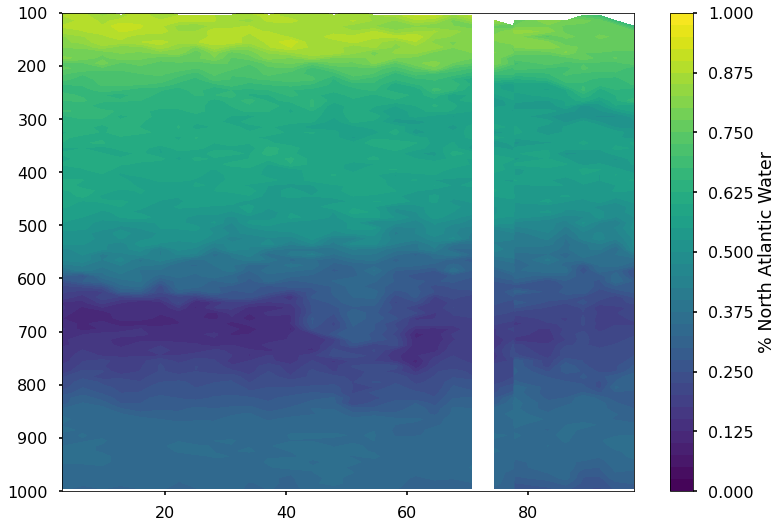

In [21]:
plt.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.naw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

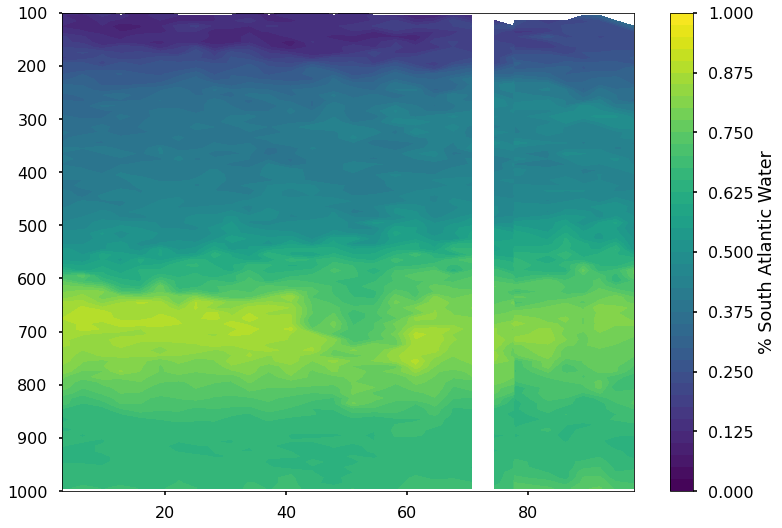

In [22]:
plt.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.saw_frac,levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')

## 2021a

In [23]:
np.nansum(df_2021a_final.naw_transport)

-1.9019346946952806

In [24]:
np.nansum(df_2021a_final.saw_transport)

-2.0962288385212497

In [25]:
np.nansum(df_2021a_final.transport)

-3.998163533216531

In [26]:
np.nansum(df_2021a_final.naw_transport)/np.nansum(df_2021a_final.transport)

0.47570207643937223

In [27]:
np.nansum(df_2021a_final.saw_transport)/np.nansum(df_2021a_final.transport)

0.5242979235606277

### just surface layer now

In [28]:
np.nansum(df_2021a_final.saw_transport)+np.nansum(subset_ds_2021a_surf_final.transport)

-2.4933586093491855

## total SAW transport now

In [29]:
np.nansum(subset_ds_2021a_surf_final.transport)

-0.39712977082793577

## 2021b

In [30]:
np.nansum(df_2021b_final.naw_transport)

-2.333273910793043

In [31]:
np.nansum(df_2021b_final.saw_transport)

-2.503014874270976

In [32]:
np.nansum(df_2021b_final.transport)

-4.836288785064019

In [33]:
np.nansum(df_2021b_final.naw_transport)/np.nansum(df_2021b_final.transport)

0.4824513205247227

In [34]:
np.nansum(df_2021b_final.saw_transport)/np.nansum(df_2021b_final.transport)

0.5175486794752773

### just surface layer now

In [35]:
np.nansum(df_2021b_final.saw_transport)+np.nansum(subset_ds_2021b_surf_final.transport)

-2.8757332168664598

In [36]:
np.nansum(subset_ds_2021b_surf_final.transport)/-5.24

0.0711294546937946

### total SAW now

In [37]:
np.nansum(subset_ds_2021b_surf_final.transport)

-0.37271834259548375

# Now do it for the repeat transects for the 2020 and 2022 deployments

In [38]:

# def solve_endmember_fractions_multiple(df,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,griddepth):

#     ## preallocation soln matrix
#     naw_frac_df = np.empty(df.temp.shape)
#     naw_frac_df[:] = np.nan
#     saw_frac_df = np.empty(df.temp.shape)
#     saw_frac_df[:] = np.nan

#     ## Loop through each transect
#     for y in np.arange(0,len(df.transect_num)):

#         ## Then loop through each row (depth) and perform water mass analysis
#         for x in np.arange(0,len(df.depth)):

#             ## subset to just the depth row of interest and make pandas dataframe
#             d = {'potential_temperature': df.temp.values[x,:,y], 'salinity': df.sal.values[x,:,y]}
#             obs_df = pd.DataFrame(data=d)
#             obs_df["mass"] = 1.0

#             ## see how many nans there are
#             nanlocs = np.where(np.isnan(obs_df['potential_temperature'])==True)[0]

#             ## skip row if it is all nans
#             if len(nanlocs) == len(df.lat):
#                 pass
#             else:
#                 ## Save location of non-nan indexes for filling sol'n matrix
#                 nonnanlocs = np.where(np.isnan(obs_df['potential_temperature'])==False)[0]
#                 ## find matching depth index in source water depth variable
#                 depth_ind = np.where(griddepth == df.depth.values[x])
#                 ## oull out NAW and SAW temp and sal
#                 endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
#                 endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
#                 endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
#                 endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
#                 ## run analysis
#                 ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
#                 ## save soln'n
#                 naw_frac_df[x,nonnanlocs,y] = ompa_soln.endmember_fractions[:,0]
#                 saw_frac_df[x,nonnanlocs,y] = ompa_soln.endmember_fractions[:,1]

#     df["naw_frac"]=(['depth', 'lat', 'transect_num'],  naw_frac_df)
#     df["saw_frac"]=(['depth', 'lat', 'transect_num'],  saw_frac_df)

#     ############ Now calculate transport!!!!!
#     ## preallocate for loop
#     transport = np.empty(df.temp.shape)
#     transport[:] = np.NaN
#     ## calc dz based on depth data
#     dz = df.depth.values[1]-df.depth.values[0]
#     ## lon hard-coded due to grid design
#     distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

#     ## loop through and calculate transport in Sv based on dz and dx (dist)
#     for x in np.arange(0,len(df.transect_num)):
#         transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

#     ## now multiply by %naw oand %saw to calculate transport of naw and saw
#     naw_transport = transport*naw_frac_df
#     saw_transport = transport*saw_frac_df

#     df["transport"]=(['depth', 'lat', 'transect_num'],  transport)
#     df["naw_transport"]=(['depth', 'lat', 'transect_num'],  naw_transport)
#     df["saw_transport"]=(['depth', 'lat', 'transect_num'],  saw_transport)

#     return df







# def calc_transport_multiple(df):
#     ############ Now calculate transport!!!!!
#     ## preallocate for loop
#     transport = np.empty(df.temp.shape)
#     transport[:] = np.NaN
#     ## calc dz based on depth data
#     dz = df.depth.values[1]-df.depth.values[0]
#     ## lon hard-coded due to grid design
#     distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

#     ## loop through and calculate transport in Sv based on dz and dx (dist)
#     for x in np.arange(0,len(df.transect_num)):
#         transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

#     df["transport"]=(['depth', 'lat', 'transect_num'],  transport)

#     return df



In [39]:

def solve_endmember_fractions_multiple(df,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den, saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den):
    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan
    temp_resid_df = np.empty(df.temp.shape)
    temp_resid_df[:] = np.nan
    sal_resid_df = np.empty(df.temp.shape)
    sal_resid_df[:] = np.nan
    mass_resid_df = np.empty(df.temp.shape)
    mass_resid_df[:] = np.nan

    ## Loop through each row (depth) and perform water mass analysis
    for z in np.arange(0,len(df.transect_num)):
        for x in np.arange(0,len(df.depth)):
            for y in np.arange(0,len(df.lat)):
                ## if there is a nan value, skip
                if ~np.isnan(df.temp.values[x,y,z]):
                    ## subset to just the depth row of interest and make pandas dataframe
                    d = {'potential_temperature': df.temp.values[x,y,z], 'salinity': df.sal.values[x,y,z]}
                    obs_df = pd.DataFrame(data=d, index=[0])
                    obs_df["mass"] = 1.0

                    ## find matching closest isopycnal index in source water data
                    ## theoretically a different index for NAW vs SAW
                    diffs = np.abs(df.density.values[x,y,z]-naw_interp_mean_den)
                    naw_iso_ind = np.nanargmin(diffs)

                    diffs = np.abs(df.density.values[x,y,z]-saw_interp_mean_den)
                    saw_iso_ind = np.nanargmin(diffs)

                    ## oull out NAW and SAW temp and sal
                    endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
                    endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
                    endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
                    endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
                    ## run analysis
                    ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
                    ## save soln'n
                    naw_frac_df[x,y,z]   = ompa_soln.endmember_fractions[0,0]
                    saw_frac_df[x,y,z]   = ompa_soln.endmember_fractions[0,1]
                    temp_resid_df[x,y,z] = ompa_soln.param_residuals[0,0]
                    sal_resid_df[x,y,z]  = ompa_soln.param_residuals[0,1]
                    mass_resid_df[x,y,z] = ompa_soln.param_residuals[0,2]

    df["naw_frac"]=(['depth', 'lat', 'transect_num'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'lat', 'transect_num'],  saw_frac_df)
    df["temp_resid"]=(['depth', 'lat', 'transect_num'],  temp_resid_df)
    df["sal_resid"]=(['depth', 'lat', 'transect_num'],  sal_resid_df)
    df["mass_resid"]=(['depth', 'lat', 'transect_num'],  mass_resid_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)
    df["naw_transport"]=(['depth', 'lat', 'transect_num'],  naw_transport)
    df["saw_transport"]=(['depth', 'lat', 'transect_num'],  saw_transport)
    return df


def calc_transport_multiple(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)

    return df


In [40]:
subset_ds_2020_surf_final = calc_transport_multiple(subset_ds_2020_surf)
subset_ds_2022_surf_final = calc_transport_multiple(subset_ds_2022_surf)

In [41]:
df_2020_final = solve_endmember_fractions_multiple(subset_ds_2020,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den,saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001926611119519515
Original weighted sum squares: 0.0001926611119519515
Post fix weighted sum squared: 0.00019266111195191308
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001926611119519515
Original weighted sum squares: 0.0001926611119519515
Post fix weighted sum squared: 0.00019266111195191308
objective: 0.00019266111195191308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028853815889096725
Original weighted sum squares: 0.00028853815889096725
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.5344763040608777e-05
Original weighted sum squares: 1.5344763040608777e-05
Post fix weighted sum squared: 1.5344763040608777e-05
objective: 1.5344763040608777e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011350690725568518
Original weighted sum squares: 0.00011350690725568518
Post fix weighted sum squared: 0.00011350690725593941
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011350690725568518
Original weighted sum squares: 0.00011350690725568518
Post fix weighted sum squared: 0.00011350690725593941
objective: 0.00011350690725593941
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024386160623299436
Original weighted sum squares: 0.00024386160623299436
Post fix weighted sum squared: 0.0002438616062333174
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024386160623299436
Original weighted sum squares: 0.00024386160623299436
Post fix weighted sum squared: 0.0002438616062333174
objective: 0.0002438616062333174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017478293452875186
Original weighted sum squares: 0.00017478293452875186
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00016669087481508343
Original weighted sum squares: 0.00016669087481508343
Post fix weighted sum squared: 0.00016669087481508343
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016669087481508343
Original weighted sum squares: 0.00016669087481508343
Post fix weighted sum squared: 0.00016669087481508343
objective: 0.00016669087481508343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.495589434668039e-05
Original weighted sum squares: 9.495589434668039e-05
Post fix weighted sum squared: 9.495589434670608e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.495589434668039e-05
Original weighted sum squares: 9.495589434668039e-05
Post fix weighted sum squared: 9.495589434670608e-05
objective: 9.495589434670608e-05
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002569064239127394
Original weighted sum squares: 0.0002569064239127394
Post fix weighted sum squared: 0.0002569064239127394
objective: 0.0002569064239127394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007836171828499133
Original weighted sum squares: 0.0007836171828499133
Post fix weighted sum squared: 0.0007836171828502131
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007836171828499133
Original weighted sum squares: 0.0007836171828499133
Post fix weighted sum squared: 0.0007836171828502131
objective: 0.0007836171828502131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018903108071612965
Original weighted sum squares: 0.00018903108071612965
Post fix weighted sum squared: 0.00018903108071624598
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018903108071612965
Original weighted sum squares: 0.00018903108071612965
Post fix weighted sum squared: 0.00018903108071624598
objective: 0.00018903108071624598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018061132796077392
Original weighted sum squares: 0.00018061132796077392
Post fix weighted sum squared: 0.00018061132796088765
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018061132796077392
Original weighted sum squares: 0.00018061132796077392
Post fix weighted sum squared: 0.00018061132796088765
objective: 0.000180611327960

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006612817514703648
Original weighted sum squares: 0.0006612817514703648
Post fix weighted sum squared: 0.0006612817514703648
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006612817514703648
Original weighted sum squares: 0.0006612817514703648
Post fix weighted sum squared: 0.0006612817514703648
objective: 0.0006612817514703648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1513452519785171e-05
Original weighted sum squares: 1.1513452519785171e-05
Post fix weighted sum squared: 1.1513452519785171e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1513452519785171e-05
Original weighted sum squares: 1.1513452519785171e-05
Post fix weighted sum squared: 1.1513452519785171e-05
objective: 1.1513452519785171e-05
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005111650442127585
Original weighted sum squares: 0.0005111650442127585
Post fix weighted sum squared: 0.0005111650442132524
objective: 0.0005111650442132524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010092175672984805
Original weighted sum squares: 0.00010092175672984805
Post fix weighted sum squared: 0.00010092175672993215
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010092175672984805
Original weighted sum squares: 0.00010092175672984805
Post fix weighted sum squared: 0.00010092175672993215
objective: 0.00010092175672993215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.020830464637805e-05
Original weighted sum squares: 6.020830464637805e-05
Post fix weighted sum squared: 6.0208304646463516e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.020830464637805e-05
Original weighted sum squares: 6.020830464637805e-05
Post fix weighted sum squared: 6.0208304646463516e-05
objective: 6.0208304646463516e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041762317198557443
Original weighted sum squares: 0.00041762317198557443
Post fix weighted sum squared: 0.00041762317198540047
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041762317198557443
Original weighted sum squares: 0.00041762317198557443
Post fix weighted sum squared: 0.00041762317198540047
objective: 0.0004176231719854004

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001635961735641429
Original weighted sum squares: 0.0001635961735641429
Post fix weighted sum squared: 0.0001635961735641429
objective: 0.0001635961735641429
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021591832075384593
Original weighted sum squares: 0.00021591832075384593
Post fix weighted sum squared: 0.0002159183207536836
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021591832075384593
Original weighted sum squares: 0.00021591832075384593
Post fix weighted sum squared: 0.0002159183207536836
objective: 0.0002159183207536836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 8.771976020181876e-05
Original weighted sum squares: 8.771976020181876e-05
Post fix weighted sum squared: 8.771976020181876e-05
objective: 8.771976020181876e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005538756430923467
Original weighted sum squares: 0.0005538756430923467
Post fix weighted sum squared: 0.0005538756430920867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005538756430923467
Original weighted sum squares: 0.0005538756430923467
Post fix weighted sum squared: 0.0005538756430920867
objective: 0.0005538756430920867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013227317698093604
Original weighted sum squares: 0.00013227317698093604
Post fix weighted sum squared: 0.00013227317698093604
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013227317698093604
Original weighted sum squares: 0.00013227317698093604
Post fix weighted sum squared: 0.00013227317698093604
objective: 0.00013227317698093604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005469783937675721
Original weighted sum squares: 0.0005469783937675721
Post fix weighted sum squared: 0.0005469783937682944
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005469783937675721
Original weighted sum squares: 0.0005469783937675721
Post fix weighted sum squared: 0.0005469783937682944
objective: 0.0005469783937682944
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004311799002509335
Original weighted sum squares: 0.0004311799002509335
Post fix weighted sum squared: 0.0004311799002509335
objective: 0.0004311799002509335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030469750805697555
Original weighted sum squares: 0.00030469750805697555
Post fix weighted sum squared: 0.00030469750805678104
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030469750805674087
Original weighted sum squares: 0.00030469750805674087
Post fix weighted sum squared: 0.00030469750805674087
objective: 0.00030469750805674087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032063464325037444
Original weighted sum squares: 0.00032063464325037444
Post fix weighted sum squared: 0.00032063464325037444
objective: 0.00032063464325037444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034684449394581856
Original weighted sum squares: 0.00034684449394581856
Post fix weighted sum squared: 0.0003468444939460266
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034684449394581856
Original weighted sum squares: 0.00034684449394581856
Post fix weighted sum squared: 0.0003468444939460266
objective: 0.0003468444939460266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003923128445432593
Original weighted sum squares: 0.0003923128445432593
Post fix weighted sum squared: 0.0003923128445432593
objective: 0.0003923128445432593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001546879040858174
Original weighted sum squares: 0.0001546879040858174
Post fix weighted sum squared: 0.0001546879040858174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001546879040858174
Original weighted sum squares: 0.0001546879040858174
Post fix weighted sum squared: 0.0001546879040858174
objective: 0.0001546879040858174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007278017254234169
Original weighted sum squares: 0.0007278017254234169
Post fix weighted sum squared: 0.0007278017254234169
objective: 0.0007278017254234169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006630635181642871
Original weighted sum squares: 0.0006630635181642871
Post fix weighted sum squared: 0.0006630635181645758
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006630635181642871
Original weighted sum squares: 0.0006630635181642871
Post fix weighted sum squared: 0.0006630635181645758
objective: 0.0006630635181645758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005697937540639127
Original weighted sum squares: 0.0005697937540639127
Post fix weighted sum squared: 0.0005697937540639127
objective: 0.0005697937540639127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002770603130025003
Original weighted sum squares: 0.0002770603130025003
Post fix weighted sum squared: 0.00027706031300268804
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002770603130025003
Original weighted sum squares: 0.0002770603130025003
Post fix weighted sum squared: 0.00027706031300268804
objective: 0.00027706031300268804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00035827879396948734
Original weighted sum squares: 0.00035827879396948734
Post fix weighted sum squared: 0.00035827879396948734
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035827879396948734
Original weighted sum squares: 0.00035827879396948734
Post fix weighted sum squared: 0.00035827879396948734
objective: 0.00035827879396948734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006567763641339636
Original weighted sum squares: 0.0006567763641339636
Post fix weighted sum squared: 0.0006567763641339636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006567763641339636
Original weighted sum squares: 0.0006567763641339636
Post fix weighted sum squared: 0.0006567763641339636
objective: 0.0006567763641339636
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003495978075439927
Original weighted sum squares: 0.0003495978075439927
Post fix weighted sum squared: 0.0003495978075439927
objective: 0.0003495978075439927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031518516783963027
Original weighted sum squares: 0.00031518516783963027
Post fix weighted sum squared: 0.00031518516783963027
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003151851678396691
Original weighted sum squares: 0.0003151851678396691
Post fix weighted sum squared: 0.0003151851678396691
objective: 0.0003151851678396691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00038890670158816306
Original weighted sum squares: 0.00038890670158816306
Post fix weighted sum squared: 0.00038890670158816306
objective: 0.00038890670158816306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003848843966873086
Original weighted sum squares: 0.0003848843966873086
Post fix weighted sum squared: 0.0003848843966873086
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003848843966873086
Original weighted sum squares: 0.0003848843966873086
Post fix weighted sum squared: 0.0003848843966873086
objective: 0.0003848843966873086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046434025518452264
Original weighted sum squares: 0.00046434025518452264
Post fix weighted sum squared: 0.00046434025518456916
objective: 0.00046434025518456916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004039499568012698
Original weighted sum squares: 0.0004039499568012698
Post fix weighted sum squared: 0.0004039499568012698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004039499568012698
Original weighted sum squares: 0.0004039499568012698
Post fix weighted sum squared: 0.0004039499568012698
objective: 0.0004039499568012698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0003502513989714248
Original weighted sum squares: 0.0003502513989714248
Post fix weighted sum squared: 0.0003502513989716387
objective: 0.0003502513989716387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030476252141481154
Original weighted sum squares: 0.00030476252141481154
Post fix weighted sum squared: 0.00030476252141461177
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030476252141481154
Original weighted sum squares: 0.00030476252141481154
Post fix weighted sum squared: 0.00030476252141461177
objective: 0.00030476252141461177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te


Post fix weighted sum squared: 0.00021509427727416645
objective: 0.00021509427727416645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003891065596570709
Original weighted sum squares: 0.0003891065596570709
Post fix weighted sum squared: 0.0003891065596570709
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003891065596570709
Original weighted sum squares: 0.0003891065596570709
Post fix weighted sum squared: 0.0003891065596570709
objective: 0.0003891065596570709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020064090681638818
Or

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028822292978634403
Original weighted sum squares: 0.00028822292978634403
Post fix weighted sum squared: 0.00028822292978634403
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028822292978634403
Original weighted sum squares: 0.00028822292978634403
Post fix weighted sum squared: 0.00028822292978634403
objective: 0.00028822292978634403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002472029605491725
Original weighted sum squares: 0.0002472029605491725
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006582612025508105
Original weighted sum squares: 0.0006582612025508105
Post fix weighted sum squared: 0.0006582612025508105
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006582612025508105
Original weighted sum squares: 0.0006582612025508105
Post fix weighted sum squared: 0.0006582612025508105
objective: 0.0006582612025508105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037709091862651346
Original weighted sum squares: 0.00037709091862651346
Post fix weighted sum squared: 0.0003770909186266964
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037709091862651346
Original weighted sum squares: 0.00037709091862651346
Post fix weighted sum squared: 0.0003770909186266964
objective: 0.0003770909186266964
Endm

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004902999877733317
Original weighted sum squares: 0.0004902999877733317
Post fix weighted sum squared: 0.0004902999877730753
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004902999877733317
Original weighted sum squares: 0.0004902999877733317
Post fix weighted sum squared: 0.0004902999877730753
objective: 0.0004902999877730753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004473572298303431
Original weighted sum squares: 0.0004473572298303431
Post fix weighted sum squared: 0.0004473572298303431
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004473572298303431
Original weighted sum squares: 0.0004473572298303431
Post fix weighted sum squared: 0.0004473572298303431
objective: 0.0004473572298303431
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004791509731218739
Original weighted sum squares: 0.0004791509731218739
Post fix weighted sum squared: 0.00047915097312212825
objective: 0.00047915097312212825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003453238815020257
Original weighted sum squares: 0.0003453238815020257
Post fix weighted sum squared: 0.0003453238815020257
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003453238815020257
Original weighted sum squares: 0.0003453238815020257
Post fix weighted sum squared: 0.0003453238815020257
objective: 0.0003453238815020257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00032615585934255416
Original weighted sum squares: 0.00032615585934255416
Post fix weighted sum squared: 0.00032615585934255416
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032615585934255416
Original weighted sum squares: 0.00032615585934255416
Post fix weighted sum squared: 0.00032615585934255416
objective: 0.00032615585934255416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000513502927679064
Original weighted sum squares: 0.000513502927679064
Post fix weighted sum squared: 0.000513502927679064
On example 0 to 1 out of 1
status: optimal
optimal value 0.000513502927679064
Original weighted sum squares: 0.000513502927679064
Post fix weighted sum squared: 0.000513502927679064
objective: 0.000513502927679064
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006243718460104595
Original weighted sum squares: 0.0006243718460104595
Post fix weighted sum squared: 0.000624371846010142
objective: 0.000624371846010142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005367609107835707
Original weighted sum squares: 0.0005367609107835707
Post fix weighted sum squared: 0.0005367609107835707
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005367609107835707
Original weighted sum squares: 0.0005367609107835707
Post fix weighted sum squared: 0.0005367609107835707
objective: 0.0005367609107835707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007133524443707742
Original weighted sum squares: 0.0007133524443707742
Post fix weighted sum squared: 0.0007133524443707742
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007133524443707742
Original weighted sum squares: 0.0007133524443707742
Post fix weighted sum squared: 0.0007133524443707742
objective: 0.0007133524443707742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046340889370407847
Original weighted sum squares: 0.00046340889370407847
Post fix weighted sum squared: 0.00046340889370407847
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046340889370407847
Original weighted sum squares: 0.00046340889370407847
Post fix weighted sum squared: 0.00046340889370407847
objective: 0.00046340889370407847
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005515772145167414
Original weighted sum squares: 0.0005515772145167414
Post fix weighted sum squared: 0.0005515772145175892
objective: 0.0005515772145175892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006131071316775927
Original weighted sum squares: 0.0006131071316775927
Post fix weighted sum squared: 0.0006131071316775927
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006131071316775927
Original weighted sum squares: 0.0006131071316775927
Post fix weighted sum squared: 0.0006131071316775927
objective: 0.0006131071316775927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006730328068864754
Original weighted sum squares: 0.0006730328068864754
Post fix weighted sum squared: 0.0006730328068851858
objective: 0.0006730328068851858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005668534190197954
Original weighted sum squares: 0.0005668534190197954
Post fix weighted sum squared: 0.0005668534190201
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005668534190197954
Original weighted sum squares: 0.0005668534190197954
Post fix weighted sum squared: 0.0005668534190201
objective: 0.0005668534190201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043767401290767686
Original weighted sum squares: 0.00043767401290767686
Post fix weighted sum squared: 0.00043767401290767686
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043767401290769746
Original weighted sum squares: 0.00043767401290769746
Post fix weighted sum squared: 0.00043767401290769746
objective: 0.00043767401290769746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005643987234879803
Original weighted sum squares: 0.0005643987234879803
Post fix weighted sum squared: 0.0005643987234876757
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005643987234879803
Original weighted sum squares: 0.0005643987234879803
Post fix weighted sum squared: 0.0005643987234876757
objective: 0.0005643987234876757
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00040563401793439934
Original weighted sum squares: 0.00040563401793439934
Post fix weighted sum squared: 0.00040563401793439934
objective: 0.00040563401793439934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007004066445072249
Original weighted sum squares: 0.0007004066445072249
Post fix weighted sum squared: 0.0007004066445062054
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007004066445072249
Original weighted sum squares: 0.0007004066445072249
Post fix weighted sum squared: 0.0007004066445062054
objective: 0.0007004066445062054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006110422481447838
Original weighted sum squares: 0.0006110422481447838
Post fix weighted sum squared: 0.0006110422481447838
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006110422481447838
Original weighted sum squares: 0.0006110422481447838
Post fix weighted sum squared: 0.0006110422481447838
objective: 0.0006110422481447838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006767508838194989
Original weighted sum squares: 0.0006767508838194989
Post fix weighted sum squared: 0.0006767508838198568
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006767508838194989
Original weighted sum squares: 0.0006767508838194989
Post fix weighted sum squared: 0.0006767508838198568
objective: 0.0006767508838198568
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006506071917367228
Original weighted sum squares: 0.0006506071917367228
Post fix weighted sum squared: 0.0006506071917367228
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006506071917367228
Original weighted sum squares: 0.0006506071917367228
Post fix weighted sum squared: 0.0006506071917367228
objective: 0.0006506071917367228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005963906873277312
Original weighted sum squares: 0.0005963906873277312
Post fix weighted sum squared: 0.0005963906873277312
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005963906873277312
Original weighted sum squares: 0.0005963906873277312
Post fix weighted sum squared: 0.0005963906873277312
objective: 0.0005963906873277312
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008073599555624708
Original weighted sum squares: 0.0008073599555624708
Post fix weighted sum squared: 0.0008073599555621329
objective: 0.0008073599555621329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005905097828635827
Original weighted sum squares: 0.0005905097828635827
Post fix weighted sum squared: 0.0005905097828638702
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005905097828635827
Original weighted sum squares: 0.0005905097828635827
Post fix weighted sum squared: 0.0005905097828638702
objective: 0.0005905097828638702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005591872929417738
Original weighted sum squares: 0.0005591872929417738
Post fix weighted sum squared: 0.0005591872929420542
objective: 0.0005591872929420542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006185872826063558
Original weighted sum squares: 0.0006185872826063558
Post fix weighted sum squared: 0.0006185872826060349
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006185872826063558
Original weighted sum squares: 0.0006185872826063558
Post fix weighted sum squared: 0.0006185872826060349
objective: 0.0006185872826060349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007390521426252547
Original weighted sum squares: 0.0007390521426252547
Post fix weighted sum squared: 0.0007390521426241996
objective: 0.0007390521426241996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006607296995878597
Original weighted sum squares: 0.0006607296995878597
Post fix weighted sum squared: 0.0006607296995878597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006607296995878597
Original weighted sum squares: 0.0006607296995878597
Post fix weighted sum squared: 0.0006607296995878597
objective: 0.0006607296995878597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000548112198950802
Original weighted sum squares: 0.000548112198950802
Post fix weighted sum squared: 0.0005481121989504989
On example 0 to 1 out of 1
status: optimal
optimal value 0.000548112198950802
Original weighted sum squares: 0.000548112198950802
Post fix weighted sum squared: 0.0005481121989504989
objective: 0.0005481121989504989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005769709856378337
Original weighted sum squares: 0.0005769709856378337
Post fix weighted sum squared: 0.0005769709

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007590083956643583
Original weighted sum squares: 0.0007590083956643583
Post fix weighted sum squared: 0.0007590083956643583
On example 0 to 1 out of 1
status: optimal
optimal value 0.000759008395664383
Original weighted sum squares: 0.000759008395664383
Post fix weighted sum squared: 0.000759008395664383
objective: 0.000759008395664383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005419179980425918
Original weighted sum squares: 0.0005419179980425918
Post fix weighted sum squared: 0.0005419179980428936
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005419179980426114
Original weighted sum squares: 0.0005419179980426114
Post fix weighted sum squared: 0.0005419179980428936
objective: 0.0005419179980428936
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005385576607160063
Original weighted sum squares: 0.0005385576607160063
Post fix weighted sum squared: 0.0005385576607163043
objective: 0.0005385576607163043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045659530196389135
Original weighted sum squares: 0.00045659530196389135
Post fix weighted sum squared: 0.0004565953019636137
On example 0 to 1 out of 1
status: optimal
optimal value 0.000456595301963596
Original weighted sum squares: 0.000456595301963596
Post fix weighted sum squared: 0.000456595301963596
objective: 0.000456595301963596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006895508469258448
Original weighted sum squares: 0.0006895508469258448
Post fix weighted sum squared: 0.0006895508469258448
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006895508469258448
Original weighted sum squares: 0.0006895508469258448
Post fix weighted sum squared: 0.0006895508469258448
objective: 0.0006895508469258448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009197495313941835
Original weighted sum squares: 0.0009197495313941835
Post fix weighted sum squared: 0.0009197495313941835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009197495313941835
Original weighted sum squares: 0.0009197495313941835
Post fix weighted sum squared: 0.0009197495313941835
objective: 0.0009197495313941835
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007700957502343243
Original weighted sum squares: 0.0007700957502343243
Post fix weighted sum squared: 0.0007700957502343243
objective: 0.0007700957502343243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006636863044748584
Original weighted sum squares: 0.0006636863044748584
Post fix weighted sum squared: 0.0006636863044754987
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006636863044748584
Original weighted sum squares: 0.0006636863044748584
Post fix weighted sum squared: 0.0006636863044754987
objective: 0.0006636863044754987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.000620263535049765
Original weighted sum squares: 0.000620263535049765
Post fix weighted sum squared: 0.000620263535049765
objective: 0.000620263535049765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006836985307785223
Original weighted sum squares: 0.0006836985307785223
Post fix weighted sum squared: 0.0006836985307781821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006836985307785223
Original weighted sum squares: 0.0006836985307785223
Post fix weighted sum squared: 0.0006836985307781821
objective: 0.0006836985307781821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006334942978673612
Original weighted sum squares: 0.0006334942978673612
Post fix weighted sum squared: 0.0006334942978670129
objective: 0.0006334942978670129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007326606881677023
Original weighted sum squares: 0.0007326606881677023
Post fix weighted sum squared: 0.0007326606881680549
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007326606881677023
Original weighted sum squares: 0.0007326606881677023
Post fix weighted sum squared: 0.0007326606881680549
objective: 0.0007326606881680549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006549747183019949
Original weighted sum squares: 0.0006549747183019949
Post fix weighted sum squared: 0.0006549747183019743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006549747183019949
Original weighted sum squares: 0.0006549747183019949
Post fix weighted sum squared: 0.0006549747183019743
objective: 0.0006549747183019743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007618264267296309
Original weighted sum squares: 0.0007618264267296309
Post fix weighted sum squared: 0.0007618264267292716
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007618264267296309
Original weighted sum squares: 0.0007618264267296309
Post fix weighted sum squared: 0.0007618264267292716
objective: 0.0007618264267292716
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008530520635977886
Original weighted sum squares: 0.0008530520635977886
Post fix weighted sum squared: 0.0008530520635977653
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008530520635977886
Original weighted sum squares: 0.0008530520635977886
Post fix weighted sum squared: 0.0008530520635977653
objective: 0.0008530520635977653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008391461227504085
Original weighted sum squares: 0.0008391461227504085
Post fix weighted sum squared: 0.0008391461227507856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008391461227504085
Original weighted sum squares: 0.0008391461227504085
Post fix weighted sum squared: 0.0008391461227507856
objective: 0.0008391461227507856
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006116785997010596
Original weighted sum squares: 0.0006116785997010596
Post fix weighted sum squared: 0.000611678599700434
objective: 0.000611678599700434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008922606653207852
Original weighted sum squares: 0.0008922606653207852
Post fix weighted sum squared: 0.0008922606653211749
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008922606653207852
Original weighted sum squares: 0.0008922606653207852
Post fix weighted sum squared: 0.0008922606653211749
objective: 0.0008922606653211749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000506262853975986
Original weighted sum squares: 0.000506262853975986
Post fix weighted sum squared: 0.0005062628539765914
On example 0 to 1 out of 1
status: optimal
optimal value 0.000506262853975986
Original weighted sum squares: 0.000506262853975986
Post fix weighted sum squared: 0.0005062628539765914
objective: 0.0005062628539765914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008816526741593685
Original weighted sum squares: 0.0008816526741593685
Post fix weighted sum squared: 0.0008816526741597561
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008816526741593685
Original weighted sum squares: 0.0008816526741593685
Post fix weighted sum squared: 0.0008816526741597561
objective: 0.0008816526741597561
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007413082149731468
Original weighted sum squares: 0.0007413082149731468
Post fix weighted sum squared: 0.0007413082149738317
objective: 0.0007413082149738317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045530263641389417
Original weighted sum squares: 0.00045530263641389417
Post fix weighted sum squared: 0.00045530263641389417
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045530263641389417
Original weighted sum squares: 0.00045530263641389417
Post fix weighted sum squared: 0.00045530263641389417
objective: 0.00045530263641389417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00034681187209636223
Original weighted sum squares: 0.00034681187209636223
Post fix weighted sum squared: 0.00034681187209660596
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034681187209636223
Original weighted sum squares: 0.00034681187209636223
Post fix weighted sum squared: 0.00034681187209660596
objective: 0.00034681187209660596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000795487326204836
Original weighted sum squares: 0.000795487326204836
Post fix weighted sum squared: 0.000795487326204121
On example 0 to 1 out of 1
status: optimal
optimal value 0.000795487326204836
Original weighted sum squares: 0.000795487326204836
Post fix weighted sum squared: 0.000795487326204121
objective: 0.000795487326204121
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008059559624061626
Original weighted sum squares: 0.0008059559624061626
Post fix weighted sum squared: 0.0008059559624061404
objective: 0.0008059559624061404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006840680936040308
Original weighted sum squares: 0.0006840680936040308
Post fix weighted sum squared: 0.0006840680936043731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006840680936040308
Original weighted sum squares: 0.0006840680936040308
Post fix weighted sum squared: 0.0006840680936043731
objective: 0.0006840680936043731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006475692467684485
Original weighted sum squares: 0.0006475692467684485
Post fix weighted sum squared: 0.0006475692467684289
objective: 0.0006475692467684289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007092050576664208
Original weighted sum squares: 0.0007092050576664208
Post fix weighted sum squared: 0.0007092050576657017
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007092050576664208
Original weighted sum squares: 0.0007092050576664208
Post fix weighted sum squared: 0.0007092050576657017
objective: 0.0007092050576657017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005919978713957947
Original weighted sum squares: 0.0005919978713957947
Post fix weighted sum squared: 0.0005919978713957947
objective: 0.0005919978713957947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006254871030559369
Original weighted sum squares: 0.0006254871030559369
Post fix weighted sum squared: 0.0006254871030559369
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006254871030559559
Original weighted sum squares: 0.0006254871030559559
Post fix weighted sum squared: 0.0006254871030559559
objective: 0.0006254871030559559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006059461732894544
Original weighted sum squares: 0.0006059461732894544
Post fix weighted sum squared: 0.0006059461732894358
objective: 0.0006059461732894358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005717383418729742
Original weighted sum squares: 0.0005717383418729742
Post fix weighted sum squared: 0.0005717383418729742
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005717383418729742
Original weighted sum squares: 0.0005717383418729742
Post fix weighted sum squared: 0.0005717383418729742
objective: 0.0005717383418729742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006466739398974824
Original weighted sum squares: 0.0006466739398974824
Post fix weighted sum squared: 0.0006466739398974824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006466739398974824
Original weighted sum squares: 0.0006466739398974824
Post fix weighted sum squared: 0.0006466739398974824
objective: 0.0006466739398974824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005169451016931477
Original weighted sum squares: 0.0005169451016931477
Post fix weighted sum squared: 0.000516

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005204724571748542
Original weighted sum squares: 0.0005204724571748542
Post fix weighted sum squared: 0.0005204724571748542
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005204724571748542
Original weighted sum squares: 0.0005204724571748542
Post fix weighted sum squared: 0.0005204724571748542
objective: 0.0005204724571748542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005251716943549809
Original weighted sum squares: 0.0005251716943549809
Post fix weighted sum squared: 0.000525

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003642049855107722
Original weighted sum squares: 0.0003642049855107722
Post fix weighted sum squared: 0.0003642049855107722
objective: 0.0003642049855107722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005859957296725089
Original weighted sum squares: 0.0005859957296725089
Post fix weighted sum squared: 0.0005859957296721901
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005859957296725089
Original weighted sum squares: 0.0005859957296725089
Post fix weighted sum squared: 0.0005859957296721901
objective: 0.0005859957296721901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005469345119722608
Original weighted sum squares: 0.0005469345119722608
Post fix weighted sum squared: 0.0005469345119725774
objective: 0.0005469345119725774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005138151154618053
Original weighted sum squares: 0.0005138151154618053
Post fix weighted sum squared: 0.0005138151154615065
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005138151154618053
Original weighted sum squares: 0.0005138151154618053
Post fix weighted sum squared: 0.0005138151154615065
objective: 0.0005138151154615065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004803977515622523
Original weighted sum squares: 0.0004803977515622523
Post fix weighted sum squared: 0.0004803977515622443
objective: 0.0004803977515622443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00052452175709102
Original weighted sum squares: 0.00052452175709102
Post fix weighted sum squared: 0.000524521757091322
On example 0 to 1 out of 1
status: optimal
optimal value 0.00052452175709102
Original weighted sum squares: 0.00052452175709102
Post fix weighted sum squared: 0.000524521757091322
objective: 0.000524521757091322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006047957084486769
Original weighted sum squares: 0.0006047957084486769
Post fix weighted sum squared: 0.0006047957084490192
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006047957084486769
Original weighted sum squares: 0.0006047957084486769
Post fix weighted sum squared: 0.0006047957084490192
objective: 0.0006047957084490192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000333324087026756
Original weighted sum squares: 0.000333324087026756
Post fix weighted sum squared: 0.0003333240870272442
On example 0 to 1 out of 1
status: optimal
optimal value 0.000333324087026756
Original weighted sum squares: 0.000333324087026756
Post fix weighted sum squared: 0.0003333240870272442
objective: 0.0003333240870272442
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004764092869455589
Original weighted sum squares: 0.0004764092869455589
Post fix weighted sum squared: 0.0004764092869452784
objective: 0.0004764092869452784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004124256992188315
Original weighted sum squares: 0.0004124256992188315
Post fix weighted sum squared: 0.0004124256992188315
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041242569921911415
Original weighted sum squares: 0.00041242569921911415
Post fix weighted sum squared: 0.0004124256992188533
objective: 0.0004124256992188533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005862207997101713
Original weighted sum squares: 0.0005862207997101713
Post fix weighted sum squared: 0.0005862207997101713
objective: 0.0005862207997101713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000444600519068912
Original weighted sum squares: 0.000444600519068912
Post fix weighted sum squared: 0.00044460051906833987
On example 0 to 1 out of 1
status: optimal
optimal value 0.000444600519068912
Original weighted sum squares: 0.000444600519068912
Post fix weighted sum squared: 0.00044460051906833987
objective: 0.00044460051906833987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006067668226988663
Original weighted sum squares: 0.0006067668226988663
Post fix weighted sum squared: 0.0006067668226995439
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006067668226988663
Original weighted sum squares: 0.0006067668226988663
Post fix weighted sum squared: 0.0006067668226995439
objective: 0.0006067668226995439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005059384825673939
Original weighted sum squares: 0.0005059384825673939
Post fix weighted sum squared: 0.0005059384825673939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005059384825673939
Original weighted sum squares: 0.0005059384825673939
Post fix weighted sum squared: 0.0005059384825673939
objective: 0.0005059384825673939
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006449745165796347
Original weighted sum squares: 0.0006449745165796347
Post fix weighted sum squared: 0.0006449745165799797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006449745165796347
Original weighted sum squares: 0.0006449745165796347
Post fix weighted sum squared: 0.0006449745165799797
objective: 0.0006449745165799797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000590209937101579
Original weighted sum squares: 0.000590209937101579
Post fix weighted sum squared: 0.0005902099371018924
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005902099371015958
Original weighted sum squares: 0.0005902099371015958
Post fix weighted sum squared: 0.0005902099371019176
objective: 0.0005902099371019176
Endmember-

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005880724212644312
Original weighted sum squares: 0.0005880724212644312
Post fix weighted sum squared: 0.0005880724212637804
objective: 0.0005880724212637804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006862136373924402
Original weighted sum squares: 0.0006862136373924402
Post fix weighted sum squared: 0.0006862136373924402
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006862136373924402
Original weighted sum squares: 0.0006862136373924402
Post fix weighted sum squared: 0.0006862136373924402
objective: 0.0006862136373924402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007777473807586149
Original weighted sum squares: 0.0007777473807586149
Post fix weighted sum squared: 0.0007777473807586149
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007777473807586149
Original weighted sum squares: 0.0007777473807586149
Post fix weighted sum squared: 0.0007777473807586149
objective: 0.0007777473807586149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006807234210239019
Original weighted sum squares: 0.0006807234210239019
Post fix weighted sum squared: 0.0006807234210239019
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006807234210239019
Original weighted sum squares: 0.0006807234210239019
Post fix weighted sum squared: 0.0006807234210239019
objective: 0.0006807234210239019
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009553437840233716
Original weighted sum squares: 0.0009553437840233716
Post fix weighted sum squared: 0.0009553437840237718
objective: 0.0009553437840237718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008523581010306199
Original weighted sum squares: 0.0008523581010306199
Post fix weighted sum squared: 0.000852358101029835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008523581010306297
Original weighted sum squares: 0.0008523581010306297
Post fix weighted sum squared: 0.0008523581010294573
objective: 0.0008523581010294573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009466238462244119
Original weighted sum squares: 0.0009466238462244119
Post fix weighted sum squared: 0.0009466238462248313
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009466238462244119
Original weighted sum squares: 0.0009466238462244119
Post fix weighted sum squared: 0.0009466238462248313
objective: 0.0009466238462248313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009425883102124658
Original weighted sum squares: 0.0009425883102124658
Post fix weighted sum squared: 0.0009425883102128736
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009425883102124658
Original weighted sum squares: 0.0009425883102124658
Post fix weighted sum squared: 0.0009425883102128736
objective: 0.0009425883102128736
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012098721836543388
Original weighted sum squares: 0.0012098721836543388
Post fix weighted sum squared: 0.0012098721836543388
objective: 0.0012098721836543388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011248374588144036
Original weighted sum squares: 0.0011248374588144036
Post fix weighted sum squared: 0.0011248374588148495
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011248374588144036
Original weighted sum squares: 0.0011248374588144036
Post fix weighted sum squared: 0.0011248374588148495
objective: 0.0011248374588148495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012930707199779758
Original weighted sum squares: 0.0012930707199779758
Post fix weighted sum squared: 0.0012930707199779873
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012930707199779758
Original weighted sum squares: 0.0012930707199779758
Post fix weighted sum squared: 0.0012930707199779873
objective: 0.0012930707199779873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001177688396944391
Original weighted sum squares: 0.001177688396944391
Post fix weighted sum squared: 0.0011776883969443685
On example 0 to 1 out of 1
status: optimal
optimal value 0.001177688396944391
Original weighted sum squares: 0.001177688396944391
Post fix weighted sum squared: 0.0011776883969443685
objective: 0.0011776883969443685
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.0009754549477388514
Original weighted sum squares: 0.0009754549477388514
Post fix weighted sum squared: 0.0009754549477397023
objective: 0.0009754549477397023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013088382969945083
Original weighted sum squares: 0.0013088382969945083
Post fix weighted sum squared: 0.001308838296994026
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013088382969945315
Original weighted sum squares: 0.0013088382969945315
Post fix weighted sum squared: 0.0013088382969945547
objective: 0.0013088382969945547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013561214061905888
Original weighted sum squares: 0.0013561214061905888
Post fix weighted sum squared: 0.0013561214061910921
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013561214061905888
Original weighted sum squares: 0.0013561214061905888
Post fix weighted sum squared: 0.0013561214061910921
objective: 0.0013561214061910921
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013140928375355767
Original weighted sum squares: 0.0013140928375355767
Post fix weighted sum squared: 0.001314

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013767991051986154
Original weighted sum squares: 0.0013767991051986154
Post fix weighted sum squared: 0.0013767991051986154
objective: 0.0013767991051986154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001350845501892048
Original weighted sum squares: 0.001350845501892048
Post fix weighted sum squared: 0.001350845501892048
On example 0 to 1 out of 1
status: optimal
optimal value 0.001350845501892048
Original weighted sum squares: 0.001350845501892048
Post fix weighted sum squared: 0.001350845501892048
objective: 0.001350845501892048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013691514294059792
Original weighted sum squares: 0.0013691514294059792
Post fix weighted sum squared: 0.0013691514294059675
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013691514294059792
Original weighted sum squares: 0.0013691514294059792
Post fix weighted sum squared: 0.0013691514294059675
objective: 0.0013691514294059675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013849339045049747
Original weighted sum squares: 0.0013849339045049747
Post fix weighted sum squared: 0.0013849339045049747
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013849339045049747
Original weighted sum squares: 0.0013849339045049747
Post fix weighted sum squared: 0.0013849339045049747
objective: 0.0013849339045049747
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001343414097936915
Original weighted sum squares: 0.001343414097936915
Post fix weighted sum squared: 0.0013434140979369036
On example 0 to 1 out of 1
status: optimal
optimal value 0.001343414097936915
Original weighted sum squares: 0.001343414097936915
Post fix weighted sum squared: 0.0013434140979369036
objective: 0.0013434140979369036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011248169153085339
Original weighted sum squares: 0.0011248169153085339
Post fix weighted sum squared: 0.0011248169153089825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011248169153085339
Original weighted sum squares: 0.0011248169153085339
Post fix weighted sum squared: 0.0011248169153089825
objective: 0.0011248169153089825
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007720179879250816
Original weighted sum squares: 0.0007720179879250816
Post fix weighted sum squared: 0.0007720179879250816
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007720179879250816
Original weighted sum squares: 0.0007720179879250816
Post fix weighted sum squared: 0.0007720179879250816
objective: 0.0007720179879250816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013191154463722157
Original weighted sum squares: 0.0013191154463722157
Post fix weighted sum squared: 0.0013191154463727127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013191154463722157
Original weighted sum squares: 0.0013191154463722157
Post fix weighted sum squared: 0.0013191154463727127
objective: 0.0013191154463727127
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000422356110531741
Original weighted sum squares: 0.000422356110531741
Post fix weighted sum squared: 0.00042235611053146634
On example 0 to 1 out of 1
status: optimal
optimal value 0.000422356110531741
Original weighted sum squares: 0.000422356110531741
Post fix weighted sum squared: 0.00042235611053146634
objective: 0.00042235611053146634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.111685404012013e-06
Original weighted sum squares: 2.111685404012013e-06
Post fix weighted sum squared: 2.1116854039921713e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.111685404012013e-06
Original weighted sum squares: 2.111685404012013e-06
Post fix weighted sum squared: 2.1116854039921713e-06
objective: 2.1116854039921713e-06
Endmem

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006444350502277706
Original weighted sum squares: 0.0006444350502277706
Post fix weighted sum squared: 0.0006444350502277706
objective: 0.0006444350502277706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016682533421644963
Original weighted sum squares: 0.00016682533421644963
Post fix weighted sum squared: 0.00016682533421662622
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016682533421644963
Original weighted sum squares: 0.00016682533421644963
Post fix weighted sum squared: 0.00016682533421662622
objective: 0.00016682533421662622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


objective: 0.0016077483156360123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012064849379605112
Original weighted sum squares: 0.0012064849379605112
Post fix weighted sum squared: 0.0012064849379614445
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012064849379605112
Original weighted sum squares: 0.0012064849379605112
Post fix weighted sum squared: 0.0012064849379614445
objective: 0.0012064849379614445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.391991030771462e-05
Original weighted sum squares: 6.391991030771462e-05
Post 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011622845996212374
Original weighted sum squares: 0.0011622845996212374
Post fix weighted sum squared: 0.0011622845996212374
objective: 0.0011622845996212374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003699475022776467
Original weighted sum squares: 0.003699475022776467
Post fix weighted sum squared: 0.003699475022778095
On example 0 to 1 out of 1
status: optimal
optimal value 0.003699475022776467
Original weighted sum squares: 0.003699475022776467
Post fix weighted sum squared: 0.003699475022778095
objective: 0.003699475022778095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.004269335337044261
Original weighted sum squares: 0.004269335337044261
Post fix weighted sum squared: 0.004269335337043376
On example 0 to 1 out of 1
status: optimal
optimal value 0.004269335337044261
Original weighted sum squares: 0.004269335337044261
Post fix weighted sum squared: 0.004269335337043376
objective: 0.004269335337043376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003208115383385052
Original weighted sum squares: 0.003208115383385052
Post fix weighted sum squared: 0.003208115383385052
On example 0 to 1 out of 1
status: optimal
optimal value 0.003208115383385052
Original weighted sum squares: 0.003208115383385052
Post fix weighted sum squared: 0.003208115383385052
objective: 0.003208115383385052
Endmember-idx mapping 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002421491984140509
Original weighted sum squares: 0.002421491984140509
Post fix weighted sum squared: 0.002421491984141525
On example 0 to 1 out of 1
status: optimal
optimal value 0.002421491984140509
Original weighted sum squares: 0.002421491984140509
Post fix weighted sum squared: 0.002421491984141525
objective: 0.002421491984141525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.7857475054277615e-05
Original weighted sum squares: 1.7857475054277615e-05
Post fix weighted sum squared: 1.7857475054277615e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.7857475054277615e-05
Original weighted sum squares: 1.7857475054277615e-05
Post fix weighted sum squared: 1.7857475054277615e-05
objective: 1.7857475054277615e-05
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00016098275683436007
Original weighted sum squares: 0.00016098275683436007
Post fix weighted sum squared: 0.00016098275683436007
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016098275683436007
Original weighted sum squares: 0.00016098275683436007
Post fix weighted sum squared: 0.00016098275683436007
objective: 0.00016098275683436007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.776163221253117e-05
Original weighted sum squares: 9.776163221253117e-05
Post fix weighted sum squared: 9.776163221266154e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.776163221253117e-05
Original weighted sum squares: 9.776163221253117e-05
Post fix weighted sum squared: 9.776163221266154e-05
objective: 9.776163221266154e-05
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002381590812099777
Original weighted sum squares: 0.0002381590812099777
Post fix weighted sum squared: 0.0002381590812096543
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002381590812099777
Original weighted sum squares: 0.0002381590812099777
Post fix weighted sum squared: 0.0002381590812096543
objective: 0.0002381590812096543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.932239683776209e-05
Original weighted sum squares: 3.932239683776209e-05
Post fix weighted sum squared: 3.93223968378799e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.932239683776209e-05
Original weighted sum squares: 3.932239683776209e-05
Post fix weighted sum squared: 3.93223968378799e-05
objective: 3.93223968378799e-05
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Original weighted sum squares: 0.0006485321821778084
Post fix weighted sum squared: 0.0006485321821778084
objective: 0.0006485321821778084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007371664094687051
Original weighted sum squares: 0.0007371664094687051
Post fix weighted sum squared: 0.0007371664094689252
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007371664094687051
Original weighted sum squares: 0.0007371664094687051
Post fix weighted sum squared: 0.0007371664094689252
objective: 0.0007371664094689252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 3.520171377874991e-05
Original weighted sum squares: 3.520171377874991e-05
Post fix weighted sum squared: 3.520171377874991e-05
objective: 3.520171377874991e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021330206977158942
Original weighted sum squares: 0.00021330206977158942
Post fix weighted sum squared: 0.00021330206977158942
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021330206977158942
Original weighted sum squares: 0.00021330206977158942
Post fix weighted sum squared: 0.00021330206977158942
objective: 0.00021330206977158942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 2.2628548390578598e-05
Original weighted sum squares: 2.2628548390578598e-05
Post fix weighted sum squared: 2.2628548390538696e-05
objective: 2.2628548390538696e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.985342799852853e-05
Original weighted sum squares: 7.985342799852853e-05
Post fix weighted sum squared: 7.985342799855172e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.985342799852853e-05
Original weighted sum squares: 7.985342799852853e-05
Post fix weighted sum squared: 7.985342799855172e-05
objective: 7.985342799855172e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00011555877477533215
Original weighted sum squares: 0.00011555877477533215
Post fix weighted sum squared: 0.00011555877477544956
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011555877477533215
Original weighted sum squares: 0.00011555877477533215
Post fix weighted sum squared: 0.00011555877477544956
objective: 0.00011555877477544956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018921242332098473
Original weighted sum squares: 0.00018921242332098473
Post fix weighted sum squared: 0.0001892124233211346
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018921242332098473
Original weighted sum squares: 0.00018921242332098473
Post fix weighted sum squared: 0.0001892124233211346
objective: 0.00018921242332113

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.240579267239076e-05
Original weighted sum squares: 4.240579267239076e-05
Post fix weighted sum squared: 4.24057926723192e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.240579267239076e-05
Original weighted sum squares: 4.240579267239076e-05
Post fix weighted sum squared: 4.24057926723192e-05
objective: 4.24057926723192e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000498310394857696
Original weighted sum squares: 0.000498310394857696
Post fix weighted sum squared: 0.000498310394857506
On example 0 to 1 out of 1
status: optimal
optimal value 0.000498310394857696
Original weighted sum squares: 0.000498310394857696
Post fix weighted sum squared: 0.000498310394857506
objective: 0.000498310394857506
Endmember-idx mapp

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018708968256710793
Original weighted sum squares: 0.00018708968256710793
Post fix weighted sum squared: 0.00018708968256710793
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001870896825670757
Original weighted sum squares: 0.0001870896825670757
Post fix weighted sum squared: 0.0001870896825670757
objective: 0.0001870896825670757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006766564526580732
Original weighted sum squares: 0.0006766564526580732
Post fix weighted sum squared: 0.0006766564526580732
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006766564526580732
Original weighted sum squares: 0.0006766564526580732
Post fix weighted sum squared: 0.0006766564526580732
objective: 0.0006766564526580732
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003225883268211039
Original weighted sum squares: 0.0003225883268211039
Post fix weighted sum squared: 0.0003225883268211039
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003225883268211039
Original weighted sum squares: 0.0003225883268211039
Post fix weighted sum squared: 0.0003225883268211039
objective: 0.0003225883268211039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022164773162749183
Original weighted sum squares: 0.00022164773162749183
Post fix weighted sum squared: 0.000221647731627198
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022164773162749183
Original weighted sum squares: 0.00022164773162749183
Post fix weighted sum squared: 0.000221647731627198
objective: 0.000221647731627198
Endmemb

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031549790557444413
Original weighted sum squares: 0.00031549790557444413
Post fix weighted sum squared: 0.00031549790557444413
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031549790557444413
Original weighted sum squares: 0.00031549790557444413
Post fix weighted sum squared: 0.00031549790557444413
objective: 0.00031549790557444413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005303826333237081
Original weighted sum squares: 0.0005303826333237081
Post fix weighted sum squared: 0.0005303826333237081
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005303826333237081
Original weighted sum squares: 0.0005303826333237081
Post fix weighted sum squared: 0.0005303826333237081
objective: 0.0005303826333237081
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008307073433173721
Original weighted sum squares: 0.0008307073433173721
Post fix weighted sum squared: 0.0008307073433173721
objective: 0.0008307073433173721
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008248203336081842
Original weighted sum squares: 0.0008248203336081842
Post fix weighted sum squared: 0.0008248203336081842
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008248203336081842
Original weighted sum squares: 0.0008248203336081842
Post fix weighted sum squared: 0.0008248203336081842
objective: 0.0008248203336081842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00014510920814338977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003546589570323467
Original weighted sum squares: 0.0003546589570323467
Post fix weighted sum squared: 0.0003546589570323467
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003546589570323467
Original weighted sum squares: 0.0003546589570323467
Post fix weighted sum squared: 0.0003546589570323467
objective: 0.0003546589570323467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004690038495098591
Original weighted sum squares: 0.0004690038495098591
Post fix weight

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Original weighted sum squares: 0.0002243418854517512
Post fix weighted sum squared: 0.0002243418854517512
objective: 0.0002243418854517512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006857183987408995
Original weighted sum squares: 0.0006857183987408995
Post fix weighted sum squared: 0.0006857183987408995
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006857183987408995
Original weighted sum squares: 0.0006857183987408995
Post fix weighted sum squared: 0.0006857183987408995
objective: 0.0006857183987408995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00031577678130766487
Original weighted sum squares: 0.00031577678130766487
Post fix weighted sum squared: 0.00031577678130786615
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031577678130766487
Original weighted sum squares: 0.00031577678130766487
Post fix weighted sum squared: 0.00031577678130786615
objective: 0.00031577678130786615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005372570383156936
Original weighted sum squares: 0.0005372570383156936
Post fix weighted sum squared: 0.0005372570383152214
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005372570383156936
Original weighted sum squares: 0.0005372570383156936
Post fix weighted sum squared: 0.0005372570383152214
objective: 0.0005372570383152214
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004764841877750601
Original weighted sum squares: 0.0004764841877750601
Post fix weighted sum squared: 0.0004764841877753079
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004764841877750601
Original weighted sum squares: 0.0004764841877750601
Post fix weighted sum squared: 0.0004764841877753079
objective: 0.0004764841877753079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005672859811005543
Original weighted sum squares: 0.0005672859811005543
Post fix weighted sum squared: 0.0005672859811005543
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005672859811005543
Original weighted sum squares: 0.0005672859811005543
Post fix weighted sum squared: 0.0005672859811005543
objective: 0.0005672859811005543
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004874581003942939
Original weighted sum squares: 0.0004874581003942939
Post fix weighted sum squared: 0.0004874581003942939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004874581003942939
Original weighted sum squares: 0.0004874581003942939
Post fix weighted sum squared: 0.0004874581003942939
objective: 0.0004874581003942939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000259054728897853
Original weighted sum squares: 0.000259054728897853
Post fix weighted sum squared: 0.000259054728897853
On example 0 to 1 out of 1
status: optimal
optimal value 0.000259054728897853
Original weighted sum squares: 0.000259054728897853
Post fix weighted sum squared: 0.000259054728897853
objective: 0.000259054728897853
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004278478749667852
Original weighted sum squares: 0.0004278478749667852
Post fix weighted sum squared: 0.00042784787496654857
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004278478749667852
Original weighted sum squares: 0.0004278478749667852
Post fix weighted sum squared: 0.00042784787496654857
objective: 0.00042784787496654857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004979783163912846
Original weighted sum squares: 0.0004979783163912846
Post fix weighted sum squared: 0.0004979783163912846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004979783163912846
Original weighted sum squares: 0.0004979783163912846
Post fix weighted sum squared: 0.0004979783163912846
objective: 0.0004979783163912846
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002903791673635586
Original weighted sum squares: 0.0002903791673635586
Post fix weighted sum squared: 0.0002903791673639829
objective: 0.0002903791673639829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020680599350212398
Original weighted sum squares: 0.00020680599350212398
Post fix weighted sum squared: 0.00020680599350212398
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020680599350196086
Original weighted sum squares: 0.00020680599350196086
Post fix weighted sum squared: 0.00020680599350212398
objective: 0.00020680599350212398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00023604791370380096
Original weighted sum squares: 0.00023604791370380096
Post fix weighted sum squared: 0.00023604791370380096
objective: 0.00023604791370380096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00059894381660086
Original weighted sum squares: 0.00059894381660086
Post fix weighted sum squared: 0.0005989438166011427
On example 0 to 1 out of 1
status: optimal
optimal value 0.00059894381660086
Original weighted sum squares: 0.00059894381660086
Post fix weighted sum squared: 0.0005989438166011427
objective: 0.0005989438166011427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000548328716075727
Original weighted sum squares: 0.000548328716075727
Post fix weighted sum squared: 0.000548328716075679
objective: 0.000548328716075679
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027978222111597895
Original weighted sum squares: 0.00027978222111597895
Post fix weighted sum squared: 0.0002797822211157517
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027978222111597895
Original weighted sum squares: 0.00027978222111597895
Post fix weighted sum squared: 0.0002797822211157517
objective: 0.0002797822211157517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041194690136028074
Original weighted sum squares: 0.00041194690136028074
Post fix weighted sum squared: 0.00041194690136004737
objective: 0.00041194690136004737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003968813192045006
Original weighted sum squares: 0.0003968813192045006
Post fix weighted sum squared: 0.0003968813192045006
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003968813192045006
Original weighted sum squares: 0.0003968813192045006
Post fix weighted sum squared: 0.0003968813192045006
objective: 0.0003968813192045006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003083769924526594
Original weighted sum squares: 0.0003083769924526594
Post fix weighted sum squared: 0.0003083769924524561
objective: 0.0003083769924524561
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003513283899838657
Original weighted sum squares: 0.0003513283899838657
Post fix weighted sum squared: 0.0003513283899840833
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003513283899838657
Original weighted sum squares: 0.0003513283899838657
Post fix weighted sum squared: 0.0003513283899840833
objective: 0.0003513283899840833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007060683099601821
Original weighted sum squares: 0.0007060683099601821
Post fix weighted sum squared: 0.0007060683099601821
objective: 0.0007060683099601821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000617006333691841
Original weighted sum squares: 0.000617006333691841
Post fix weighted sum squared: 0.0006170063336921546
On example 0 to 1 out of 1
status: optimal
optimal value 0.000617006333691841
Original weighted sum squares: 0.000617006333691841
Post fix weighted sum squared: 0.0006170063336921546
objective: 0.0006170063336921546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004114807788011377
Original weighted sum squares: 0.0004114807788011377
Post fix weighted sum squared: 0.0004114807788008811
objective: 0.0004114807788008811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033378239497610485
Original weighted sum squares: 0.00033378239497610485
Post fix weighted sum squared: 0.00033378239497589186
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033378239497610485
Original weighted sum squares: 0.00033378239497610485
Post fix weighted sum squared: 0.00033378239497589186
objective: 0.00033378239497589186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005245441001021105
Original weighted sum squares: 0.0005245441001021105
Post fix weighted sum squared: 0.0005245441001026907
objective: 0.0005245441001026907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004031185879019312
Original weighted sum squares: 0.0004031185879019312
Post fix weighted sum squared: 0.00040311858790191167
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004031185879019312
Original weighted sum squares: 0.0004031185879019312
Post fix weighted sum squared: 0.00040311858790191167
objective: 0.00040311858790191167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048793661058761764
Original weighted sum squares: 0.00048793661058761764
Post fix weighted sum squared: 0.00048793661058761764
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048793661058761764
Original weighted sum squares: 0.00048793661058761764
Post fix weighted sum squared: 0.00048793661058761764
objective: 0.00048793661058761764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003727063559235632
Original weighted sum squares: 0.0003727063559235632
Post fix weighted sum squared: 0.0003727063559237895
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003727063559235632
Original weighted sum squares: 0.0003727063559235632
Post fix weighted sum squared: 0.0003727063559237895
objective: 0.0003727063559237895
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006465366385687397
Original weighted sum squares: 0.0006465366385687397
Post fix weighted sum squared: 0.0006465366385687397
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006465366385687397
Original weighted sum squares: 0.0006465366385687397
Post fix weighted sum squared: 0.0006465366385687397
objective: 0.0006465366385687397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004717995034991436
Original weighted sum squares: 0.0004717995034991436
Post fix weighted sum squared: 0.00047179950349942023
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047179

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004728061253395952
Original weighted sum squares: 0.0004728061253395952
Post fix weighted sum squared: 0.0004728061253398532
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004728061253395952
Original weighted sum squares: 0.0004728061253395952
Post fix weighted sum squared: 0.0004728061253398532
objective: 0.0004728061253398532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006498032076983265
Original weighted sum squares: 0.0006498032076983265
Post fix weighted sum squared: 0.0006498032076983265
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006498032076983265
Original weighted sum squares: 0.0006498032076983265
Post fix weighted sum squared: 0.0006498032076983265
objective: 0.0006498032076983265
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006880424754877409
Original weighted sum squares: 0.0006880424754877409
Post fix weighted sum squared: 0.0006880424754877409
objective: 0.0006880424754877409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006658593272523155
Original weighted sum squares: 0.0006658593272523155
Post fix weighted sum squared: 0.0006658593272520088
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006658593272523155
Original weighted sum squares: 0.0006658593272523155
Post fix weighted sum squared: 0.0006658593272520088
objective: 0.0006658593272520088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006120294036342652
Original weighted sum squares: 0.0006120294036342652
Post fix weighted sum squared: 0.0006120294036336557
objective: 0.0006120294036336557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006911065845429806
Original weighted sum squares: 0.0006911065845429806
Post fix weighted sum squared: 0.0006911065845423292
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006911065845429806
Original weighted sum squares: 0.0006911065845429806
Post fix weighted sum squared: 0.0006911065845423292
objective: 0.0006911065845423292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006103493242519872
Original weighted sum squares: 0.0006103493242519872
Post fix weighted sum squared: 0.0006103493242519872
objective: 0.0006103493242519872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039328950655362924
Original weighted sum squares: 0.00039328950655362924
Post fix weighted sum squared: 0.00039328950655362924
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039328950655362924
Original weighted sum squares: 0.00039328950655362924
Post fix weighted sum squared: 0.00039328950655362924
objective: 0.00039328950655362924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004178895609562427
Original weighted sum squares: 0.0004178895609562427
Post fix weighted sum squared: 0.0004178895609562427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004178895609562427
Original weighted sum squares: 0.0004178895609562427
Post fix weighted sum squared: 0.0004178895609562427
objective: 0.0004178895609562427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006636570398717409
Original weighted sum squares: 0.0006636570398717409
Post fix weighted sum squared: 0.0006636570398723812
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006636570398717409
Original weighted sum squares: 0.0006636570398717409
Post fix weighted sum squared: 0.0006636570398723812
objective: 0.0006636570398723812
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008054497373454051
Original weighted sum squares: 0.0008054497373454051
Post fix weighted sum squared: 0.0008054497373454051
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008054497373454051
Original weighted sum squares: 0.0008054497373454051
Post fix weighted sum squared: 0.0008054497373454051
objective: 0.0008054497373454051
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006935937378282216
Original weighted sum squares: 0.0006935937378282216
Post fix weighted sum squared: 0.0006935937378282216
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006935937378282216
Original weighted sum squares: 0.0006935937378282216
Post fix weighted sum squared: 0.0006935937378282216
objective: 0.0006935937378282216
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005642534347602445
Original weighted sum squares: 0.0005642534347602445
Post fix weighted sum squared: 0.0005642534347602445
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005642534347602445
Original weighted sum squares: 0.0005642534347602445
Post fix weighted sum squared: 0.0005642534347602445
objective: 0.0005642534347602445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005365204374998542
Original weighted sum squares: 0.0005365204374998542
Post fix weighted sum squared: 0.0005365204375001534
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005365204374998542
Original weighted sum squares: 0.0005365204374998542
Post fix weighted sum squared: 0.0005365204375001534
objective: 0.0005365204375001534
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006003144678386164
Original weighted sum squares: 0.0006003144678386164
Post fix weighted sum squared: 0.0006003144678386164
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006003144678386164
Original weighted sum squares: 0.0006003144678386164
Post fix weighted sum squared: 0.0006003144678386164
objective: 0.0006003144678386164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005866235736067707
Original weighted sum squares: 0.0005866235736067707
Post fix weighted sum squared: 0.0005866235736070837
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005866235736067707
Original weighted sum squares: 0.0005866235736067707
Post fix weighted sum squared: 0.0005866235736070837
objective: 0.0005866235736070837
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008939730985829321
Original weighted sum squares: 0.0008939730985829321
Post fix weighted sum squared: 0.0008939730985829321
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008939730985829321
Original weighted sum squares: 0.0008939730985829321
Post fix weighted sum squared: 0.0008939730985829321
objective: 0.0008939730985829321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000673160506078325
Original weighted sum squares: 0.000673160506078325
Post fix weighted sum squared: 0.0006731605060786616
On example 0 to 1 out of 1
status: optimal
optimal value 0.000673160506078325
Original weighted sum squares: 0.000673160506078325
Post fix weighted sum squared: 0.0006731605060786616
objective: 0.0006731605060786616
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000792692264443103
Original weighted sum squares: 0.000792692264443103
Post fix weighted sum squared: 0.000792692264443103
objective: 0.000792692264443103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008729945494085482
Original weighted sum squares: 0.0008729945494085482
Post fix weighted sum squared: 0.0008729945494089316
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008729945494085482
Original weighted sum squares: 0.0008729945494085482
Post fix weighted sum squared: 0.0008729945494089316
objective: 0.0008729945494089316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.0007416906741901671
Original weighted sum squares: 0.0007416906741901671
Post fix weighted sum squared: 0.0007416906741894856
objective: 0.0007416906741894856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000906676303297912
Original weighted sum squares: 0.000906676303297912
Post fix weighted sum squared: 0.000906676303297912
On example 0 to 1 out of 1
status: optimal
optimal value 0.000906676303297912
Original weighted sum squares: 0.000906676303297912
Post fix weighted sum squared: 0.000906676303297912
objective: 0.000906676303297912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041906147581204843
Original weighted sum squares: 0.00041906147581204843
Post fix weighted sum squared: 0.0004190614758117988
objective: 0.0004190614758117988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007418797203289557
Original weighted sum squares: 0.0007418797203289557
Post fix weighted sum squared: 0.0007418797203293108
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007418797203289557
Original weighted sum squares: 0.0007418797203289557
Post fix weighted sum squared: 0.0007418797203293108
objective: 0.0007418797203293108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007654330589855087
Original weighted sum squares: 0.0007654330589855087
Post fix weighted sum squared: 0.0007654330589851486
objective: 0.0007654330589851486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000824082699656591
Original weighted sum squares: 0.000824082699656591
Post fix weighted sum squared: 0.000824082699656591
On example 0 to 1 out of 1
status: optimal
optimal value 0.000824082699656591
Original weighted sum squares: 0.000824082699656591
Post fix weighted sum squared: 0.000824082699656591
objective: 0.000824082699656591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000867023570864005
Original weighted sum squares: 0.000867023570864005
Post fix weighted sum squared: 0.000867023570864005
objective: 0.000867023570864005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006337766158446671
Original weighted sum squares: 0.0006337766158446671
Post fix weighted sum squared: 0.0006337766158446671
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006337766158446671
Original weighted sum squares: 0.0006337766158446671
Post fix weighted sum squared: 0.0006337766158446671
objective: 0.0006337766158446671
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000514280931215565
Original weighted sum squares: 0.000514280931215565
Post fix weighted sum squared: 0.000514280931215269
objective: 0.000514280931215269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005370035523329423
Original weighted sum squares: 0.0005370035523329423
Post fix weighted sum squared: 0.0005370035523329423
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005370035523329423
Original weighted sum squares: 0.0005370035523329423
Post fix weighted sum squared: 0.0005370035523329423
objective: 0.0005370035523329423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005239415430578275
Original weighted sum squares: 0.0005239415430578275
Post fix weighted sum squared: 0.000523941543058127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005239415430578275
Original weighted sum squares: 0.0005239415430578275
Post fix weighted sum squared: 0.000523941543058127
objective: 0.000523941543058127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007538198659363211
Original weighted sum squares: 0.0007538198659363211
Post fix weighted sum squared: 0.0007538198659363211
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007538198659363211
Original weighted sum squares: 0.0007538198659363211
Post fix weighted sum squared: 0.0007538198659363211
objective: 0.0007538198659363211
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006029213070712957
Original weighted sum squares: 0.0006029213070712957
Post fix weighted sum squared: 0.000602921307071277
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006029213070712957
Original weighted sum squares: 0.0006029213070712957
Post fix weighted sum squared: 0.000602921307071277
objective: 0.000602921307071277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000689774452759155
Original weighted sum squares: 0.000689774452759155
Post fix weighted sum squared: 0.0006897744527594987
On example 0 to 1 out of 1
status: optimal
optimal value 0.000689774452759155
Original weighted sum squares: 0.000689774452759155
Post fix weighted sum squared: 0.0006897744527594987
objective: 0.0006897744527594987
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007012806396573334
Original weighted sum squares: 0.0007012806396573334
Post fix weighted sum squared: 0.0007012806396569865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007012806396573334
Original weighted sum squares: 0.0007012806396573334
Post fix weighted sum squared: 0.0007012806396569865
objective: 0.0007012806396569865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009317634977202063
Original weighted sum squares: 0.0009317634977202063
Post fix weighted sum squared: 0.000931763497720583
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009317634977202063
Original weighted sum squares: 0.0009317634977202063
Post fix weighted sum squared: 0.000931763497720583
objective: 0.000931763497720583
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008501490751604209
Original weighted sum squares: 0.0008501490751604209
Post fix weighted sum squared: 0.0008501490751600384
objective: 0.0008501490751600384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006080948814225381
Original weighted sum squares: 0.0006080948814225381
Post fix weighted sum squared: 0.0006080948814225381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006080948814225381
Original weighted sum squares: 0.0006080948814225381
Post fix weighted sum squared: 0.0006080948814225381
objective: 0.0006080948814225381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


objective: 0.00029944985579384543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005827136901208816
Original weighted sum squares: 0.0005827136901208816
Post fix weighted sum squared: 0.0005827136901208816
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005827136901208816
Original weighted sum squares: 0.0005827136901208816
Post fix weighted sum squared: 0.0005827136901208816
objective: 0.0005827136901208816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005142077077935265
Original weighted sum squares: 0.0005142077077935265
Post

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 0.0004121716288756104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005747442103348062
Original weighted sum squares: 0.0005747442103348062
Post fix weighted sum squared: 0.0005747442103354542
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005747442103348062
Original weighted sum squares: 0.0005747442103348062
Post fix weighted sum squared: 0.0005747442103354542
objective: 0.0005747442103354542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007128553676169769
Original weighted sum squares: 0.0007128553676169769
Post f

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005747956725453665
Original weighted sum squares: 0.0005747956725453665
Post fix weighted sum squared: 0.0005747956725450505
objective: 0.0005747956725450505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003327528698301264
Original weighted sum squares: 0.0003327528698301264
Post fix weighted sum squared: 0.0003327528698303665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003327528698301264
Original weighted sum squares: 0.0003327528698301264
Post fix weighted sum squared: 0.0003327528698303665
objective: 0.0003327528698303665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004927220406766492
Original weighted sum squares: 0.0004927220406766492
Post fix weighted sum squared: 0.0004927220406769499
objective: 0.0004927220406769499
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005797687274578473
Original weighted sum squares: 0.0005797687274578473
Post fix weighted sum squared: 0.0005797687274575294
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005797687274578473
Original weighted sum squares: 0.0005797687274578473
Post fix weighted sum squared: 0.0005797687274575294
objective: 0.0005797687274575294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000521106039341776
Original weighted sum squares: 0.000521106039341776
Post fix weighted sum squared: 0.000521106039341776
On example 0 to 1 out of 1
status: optimal
optimal value 0.000521106039341776
Original weighted sum squares: 0.000521106039341776
Post fix weighted sum squared: 0.000521106039341776
objective: 0.000521106039341776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034615395566433383
Original weighted sum squares: 0.00034615395566433383
Post fix weighted sum squared: 0.00034615395566457225
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034615395566433383
Original weighted sum squares: 0.00034615395566433383
Post fix weighted sum squared: 0.00034615395566457225
objective: 0.00034615395566457225
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003525843262937926
Original weighted sum squares: 0.0003525843262937926
Post fix weighted sum squared: 0.00035258432629402676
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003525843262937926
Original weighted sum squares: 0.0003525843262937926
Post fix weighted sum squared: 0.00035258432629402676
objective: 0.00035258432629402676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043943267592982943
Original weighted sum squares: 0.00043943267592982943
Post fix weighted sum squared: 0.0004394326759292533
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043943267592982943
Original weighted sum squares: 0.00043943267592982943
Post fix weighted sum squared: 0.0004394326759292533
objective: 0.0004394326759292533
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041538750640759975
Original weighted sum squares: 0.00041538750640759975
Post fix weighted sum squared: 0.00041538750640704664
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041538750640759975
Original weighted sum squares: 0.00041538750640759975
Post fix weighted sum squared: 0.00041538750640704664
objective: 0.00041538750640704664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005166784652260944
Original weighted sum squares: 0.0005166784652260944
Post fix weighted sum squared: 0.0005166784652260944
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005166784652260944
Original weighted sum squares: 0.0005166784652260944
Post fix weighted sum squared: 0.0005166784652260944
objective: 0.0005166784652260944
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005362239719256943
Original weighted sum squares: 0.0005362239719256943
Post fix weighted sum squared: 0.0005362239719253959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005362239719256943
Original weighted sum squares: 0.0005362239719256943
Post fix weighted sum squared: 0.0005362239719253959
objective: 0.0005362239719253959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005204229291413224
Original weighted sum squares: 0.0005204229291413224
Post fix weighted sum squared: 0.0005204229291416162
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005204229291413224
Original weighted sum squares: 0.0005204229291413224
Post fix weighted sum squared: 0.0005204229291416162
objective: 0.0005204229291416162
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006988782740751056
Original weighted sum squares: 0.0006988782740751056
Post fix weighted sum squared: 0.0006988782740744053
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006988782740751056
Original weighted sum squares: 0.0006988782740751056
Post fix weighted sum squared: 0.0006988782740744053
objective: 0.0006988782740744053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006963227402874228
Original weighted sum squares: 0.0006963227402874228
Post fix weighted sum squared: 0.0006963227402874228
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006963227402874228
Original weighted sum squares: 0.0006963227402874228
Post fix weighted sum squared: 0.0006963227402874228
objective: 0.0006963227402874228
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000751964775901223
Original weighted sum squares: 0.000751964775901223
Post fix weighted sum squared: 0.0007519647759015866
objective: 0.0007519647759015866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006473500388424361
Original weighted sum squares: 0.0006473500388424361
Post fix weighted sum squared: 0.0006473500388420994
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006473500388424361
Original weighted sum squares: 0.0006473500388424361
Post fix weighted sum squared: 0.0006473500388420994
objective: 0.0006473500388420994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0009252026356375163
objective: 0.0009252026356375163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010109410049980272
Original weighted sum squares: 0.0010109410049980272
Post fix weighted sum squared: 0.0010109410049963046
On example 0 to 1 out of 1
status: optimal
optimal value 0.001010941004997594
Original weighted sum squares: 0.001010941004997594
Post fix weighted sum squared: 0.001010941004996738
objective: 0.001010941004996738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008034085466713773
Original weighted sum squares: 0.0008034

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 0.0009850262481874198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009835153594304753
Original weighted sum squares: 0.0009835153594304753
Post fix weighted sum squared: 0.0009835153594296207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009835153594304753
Original weighted sum squares: 0.0009835153594304753
Post fix weighted sum squared: 0.0009835153594296207
objective: 0.0009835153594296207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010369738330586369
Original weighted sum squares: 0.0010369738330586369
Post f

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

objective: 0.0011350083959441135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011219938566776027
Original weighted sum squares: 0.0011219938566776027
Post fix weighted sum squared: 0.001121993856676701
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011219938566776027
Original weighted sum squares: 0.0011219938566776027
Post fix weighted sum squared: 0.001121993856676701
objective: 0.001121993856676701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012645460689055536
Original weighted sum squares: 0.0012645460689055536
Post fix 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0012615091275413948
Original weighted sum squares: 0.0012615091275413948
Post fix weighted sum squared: 0.0012615091275418682
objective: 0.0012615091275418682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013592043908979736
Original weighted sum squares: 0.0013592043908979736
Post fix weighted sum squared: 0.001359204390898466
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013592043908979736
Original weighted sum squares: 0.0013592043908979736
Post fix weighted sum squared: 0.001359204390898466
objective: 0.001359204390898466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007104803403316744
Original weighted sum squares: 0.0007104803403316744
Post fix weighted sum squared: 0.0007104803403316744
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007104803403316744
Original weighted sum squares: 0.0007104803403316744
Post fix weighted sum squared: 0.0007104803403316744
objective: 0.0007104803403316744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001460266037871775
Original weighted sum squares: 0.001460266037871775
Post fix weighted sum squared: 0.0014602660378722854
On example 0 to 1 out of 1
status: optimal
optimal value 0.001460266037871775
Original weighted sum squares: 0.001460266037871775
Post fix weighted sum squared: 0.0014602660378722854
objective: 0.0014602660378722854
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013923293481163416
Original weighted sum squares: 0.0013923293481163416
Post fix weighted sum squared: 0.0013923293481163416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013923293481163416
Original weighted sum squares: 0.0013923293481163416
Post fix weighted sum squared: 0.0013923293481163416
objective: 0.0013923293481163416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013605757924700448
Original weighted sum squares: 0.0013605757924700448
Post fix weighted sum squared: 0.0013605757924700448
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013605757924700448
Original weighted sum squares: 0.0013605757924700448
Post fix weighted sum squared: 0.0013605757924700448
objective: 0.0013605757924700448
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014150508801897587
Original weighted sum squares: 0.0014150508801897587
Post fix weighted sum squared: 0.0014150508801882165
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014150508801897587
Original weighted sum squares: 0.0014150508801897587
Post fix weighted sum squared: 0.0014150508801882165
objective: 0.0014150508801882165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013536062909662696
Original weighted sum squares: 0.0013536062909662696
Post fix weighted sum squared: 0.0013536062909662696
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013536062909662696
Original weighted sum squares: 0.0013536062909662696
Post fix weighted sum squared: 0.0013536062909662696
objective: 0.0013536062909662696
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014119230494013778
Original weighted sum squares: 0.0014119230494013778
Post fix weighted sum squared: 0.001411923049400361
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014119230494013778
Original weighted sum squares: 0.0014119230494013778
Post fix weighted sum squared: 0.001411923049400361
objective: 0.001411923049400361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014144432932260813
Original weighted sum squares: 0.0014144432932260813
Post fix weighted sum squared: 0.0014144432932255665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014144432932260813
Original weighted sum squares: 0.0014144432932260813
Post fix weighted sum squared: 0.0014144432932255665
objective: 0.0014144432932255665
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011450883642769817
Original weighted sum squares: 0.0011450883642769817
Post fix weighted sum squared: 0.001145088364277445
objective: 0.001145088364277445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006562755532073128
Original weighted sum squares: 0.0006562755532073128
Post fix weighted sum squared: 0.0006562755532073128
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006562755532073128
Original weighted sum squares: 0.0006562755532073128
Post fix weighted sum squared: 0.0006562755532073128
objective: 0.0006562755532073128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006906121482139513
Original weighted sum squares: 0.0006906121482139513
Post fix weighted sum squared: 0.0006906121482143005
objective: 0.0006906121482143005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.3198659491135523e-08
Original weighted sum squares: 5.3198659491135523e-08
Post fix weighted sum squared: 5.3198659491135523e-08
On example 0 to 1 out of 1
status: optimal
optimal value 5.3198659491135523e-08
Original weighted sum squares: 5.3198659491135523e-08
Post fix weighted sum squared: 5.3198659491135523e-08
objective: 5.3198659491135523e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.6272661865475676e-05
Original weighted sum squares: 3.6272661865475676e-05
Post fix weighted sum squared: 3.6272661865475676e-05
objective: 3.6272661865475676e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020784175322219328
Original weighted sum squares: 0.00020784175322219328
Post fix weighted sum squared: 0.00020784175322238995
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020784175322219328
Original weighted sum squares: 0.00020784175322219328
Post fix weighted sum squared: 0.00020784175322238995
objective: 0.00020784175322238995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00031326685817228343
Original weighted sum squares: 0.00031326685817228343
Post fix weighted sum squared: 0.00031326685817228343
objective: 0.00031326685817228343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010194276584282332
Original weighted sum squares: 0.0010194276584282332
Post fix weighted sum squared: 0.001019427658428244
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010194276584282332
Original weighted sum squares: 0.0010194276584282332
Post fix weighted sum squared: 0.001019427658428244
objective: 0.001019427658428244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.007700985213812443
Original weighted sum squares: 0.007700985213812443
Post fix weighted sum squared: 0.007700985213811257
objective: 0.007700985213811257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015172751761516133
Original weighted sum squares: 0.0015172751761516133
Post fix weighted sum squared: 0.0015172751761516133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015172751761516133
Original weighted sum squares: 0.0015172751761516133
Post fix weighted sum squared: 0.0015172751761516133
objective: 0.0015172751761516133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011633316037889406
Original weighted sum squares: 0.0011633316037889406
Post fix weighted sum squared: 0.0011633316037884757
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011633316037889406
Original weighted sum squares: 0.0011633316037889406
Post fix weighted sum squared: 0.0011633316037884757
objective: 0.0011633316037884757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0034920289283730923
Original weighted sum squares: 0.0034920289283730923
Post fix weighted sum squared: 0.0034920289283722895
On example 0 to 1 out of 1
status: optimal
optimal value 0.0034920289283730923
Original weighted sum squares: 0.0034920289283730923
Post fix weighted sum squared: 0.0034920289283722895
objective: 0.0034920289283722895
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 8.953283075026942e-06
Original weighted sum squares: 8.953283075026942e-06
Post fix weighted sum squared: 8.953283075026942e-06
On example 0 to 1 out of 1
status: optimal
optimal value 8.953283075026942e-06
Original weighted sum squares: 8.953283075026942e-06
Post fix weighted sum squared: 8.953283075026942e-06
objective: 8.953283075026942e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2206953609214292e-06
Original weighted sum squares: 1.2206953609214292e-06
Post fix weighted sum squared: 1.2206953609214292e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.2206953609214292e-06
Original weighted sum squares: 1.2206953609214292e-06
Post fix weighted sum squared: 1.2206953609214292e-06
objective: 1.2206953609214292e-06
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.162455133626453e-05
Original weighted sum squares: 3.162455133626453e-05
Post fix weighted sum squared: 3.162455133626453e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.162455133626453e-05
Original weighted sum squares: 3.162455133626453e-05
Post fix weighted sum squared: 3.162455133626453e-05
objective: 3.162455133626453e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014209964180027698
Original weighted sum squares: 0.00014209964180027698
Post fix weighted sum squared: 0.00014209964180027698
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014209964180027698
Original weighted sum squares: 0.00014209964180027698
Post fix weighted sum squared: 0.00014209964180027698
objective: 0.00014209964180027698
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.243390814289032e-05
Original weighted sum squares: 6.243390814289032e-05
Post fix weighted sum squared: 6.24339081429747e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.243390814289032e-05
Original weighted sum squares: 6.243390814289032e-05
Post fix weighted sum squared: 6.24339081429747e-05
objective: 6.24339081429747e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.294788642133089e-07
Original weighted sum squares: 6.294788642133089e-07
Post fix weighted sum squared: 6.294788642048196e-07
On example 0 to 1 out of 1
status: optimal
optimal value 6.294788642133089e-07
Original weighted sum squares: 6.294788642133089e-07
Post fix weighted sum squared: 6.294788642048196e-07
objective: 6.294788642048196e-07
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005237444098234836
Original weighted sum squares: 0.0005237444098234836
Post fix weighted sum squared: 0.0005237444098237286
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005237444098234836
Original weighted sum squares: 0.0005237444098234836
Post fix weighted sum squared: 0.0005237444098237286
objective: 0.0005237444098237286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.155158729850277e-06
Original weighted sum squares: 5.155158729850277e-06
Post fix weighted sum squared: 5.155158729869173e-06
On example 0 to 1 out of 1
status: optimal
optimal value 5.155158729850277e-06
Original weighted sum squares: 5.155158729850277e-06
Post fix weighted sum squared: 5.155158729869173e-06
objective: 5.155158729869173e-06
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009019665100883502
Original weighted sum squares: 0.0009019665100883502
Post fix weighted sum squared: 0.0009019665100880982
objective: 0.0009019665100880982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.987063223297859e-05
Original weighted sum squares: 3.987063223297859e-05
Post fix weighted sum squared: 3.987063223304674e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.987063223297859e-05
Original weighted sum squares: 3.987063223297859e-05
Post fix weighted sum squared: 3.987063223304674e-05
objective: 3.987063223304674e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002137446401200462
Original weighted sum squares: 0.0002137446401200462
Post fix weighted sum squared: 0.00021374464012020476
objective: 0.00021374464012020476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023161080436668398
Original weighted sum squares: 0.00023161080436668398
Post fix weighted sum squared: 0.00023161080436668398
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023161080436668398
Original weighted sum squares: 0.00023161080436668398
Post fix weighted sum squared: 0.00023161080436668398
objective: 0.00023161080436668398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005653027813716704
Original weighted sum squares: 0.0005653027813716704
Post fix weighted sum squared: 0.0005653027813711492
objective: 0.0005653027813711492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016124690780439915
Original weighted sum squares: 0.00016124690780439915
Post fix weighted sum squared: 0.00016124690780467584
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016124690780439915
Original weighted sum squares: 0.00016124690780439915
Post fix weighted sum squared: 0.00016124690780467584
objective: 0.00016124690780467584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010102006776720705
Original weighted sum squares: 0.00010102006776720705
Post fix weighted sum squared: 0.00010102006776712148
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010102006776720705
Original weighted sum squares: 0.00010102006776720705
Post fix weighted sum squared: 0.00010102006776712148
objective: 0.00010102006776712148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002490302775036547
Original weighted sum squares: 0.0002490302775036547
Post fix weighted sum squared: 0.0002490302775036547
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002490302775036547
Original weighted sum squares: 0.0002490302775036547
Post fix weighted sum squared: 0.0002490302775036547
objective: 0.0002490302775036547
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011085944491561115
Original weighted sum squares: 0.00011085944491561115
Post fix weighted sum squared: 0.00011085944491561115
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011085944491561115
Original weighted sum squares: 0.00011085944491561115
Post fix weighted sum squared: 0.00011085944491561115
objective: 0.00011085944491561115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003010708977398345
Original weighted sum squares: 0.0003010708977398345
Post fix weighted sum squared: 0.00030107089773964344
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003010708977398345
Original weighted sum squares: 0.0003010708977398345
Post fix weighted sum squared: 0.00030107089773964344
objective: 0.0003010708977396434

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010502739356464421
Original weighted sum squares: 0.00010502739356464421
Post fix weighted sum squared: 0.00010502739356464421
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010502739356464421
Original weighted sum squares: 0.00010502739356464421
Post fix weighted sum squared: 0.00010502739356464421
objective: 0.00010502739356464421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031215917256660836
Original weighted sum squares: 0.00031215917256660836
Post fix weighted sum squared: 0.00031215917256660836
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031215917256660836
Original weighted sum squares: 0.00031215917256660836
Post fix weighted sum squared: 0.00031215917256660836
objective: 0.000312159172566

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003733177824383125
Original weighted sum squares: 0.0003733177824383125
Post fix weighted sum squared: 0.0003733177824382684
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003733177824383125
Original weighted sum squares: 0.0003733177824383125
Post fix weighted sum squared: 0.0003733177824382684
objective: 0.0003733177824382684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029254988583688867
Original weighted sum squares: 0.00029254988583688867
Post fix weighted sum squared: 0.00029254988583688867
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029254988583688867
Original weighted sum squares: 0.00029254988583688867
Post fix weighted sum squared: 0.00029254988583688867
objective: 0.00029254988583688867
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0005774053813796602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005403380081880669
Original weighted sum squares: 0.0005403380081880669
Post fix weighted sum squared: 0.0005403380081880669
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005403380081880669
Original weighted sum squares: 0.0005403380081880669
Post fix weighted sum squared: 0.0005403380081880669
objective: 0.0005403380081880669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003347359344484029
Original weighted sum squares: 0.0003347359344484029
Post fix weighte

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018202451763757864
Original weighted sum squares: 0.00018202451763757864
Post fix weighted sum squared: 0.00018202451763772959
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018202451763757864
Original weighted sum squares: 0.00018202451763757864
Post fix weighted sum squared: 0.00018202451763772959
objective: 0.00018202451763772959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013087638619985883
Original weighted sum squares: 0.00013087638619985883
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022319115676975513
Original weighted sum squares: 0.00022319115676975513
Post fix weighted sum squared: 0.00022319115676975513
objective: 0.00022319115676975513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005962334549709772
Original weighted sum squares: 0.0005962334549709772
Post fix weighted sum squared: 0.0005962334549709772
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005962334549709772
Original weighted sum squares: 0.0005962334549709772
Post fix weighted sum squared: 0.0005962334549709772
objective: 0.0005962334549709772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003791475803705964
Original weighted sum squares: 0.0003791475803705964
Post fix weighted sum squared: 0.0003791475803705964
objective: 0.0003791475803705964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035205118517860095
Original weighted sum squares: 0.00035205118517860095
Post fix weighted sum squared: 0.00035205118517877437
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035205118517860095
Original weighted sum squares: 0.00035205118517860095
Post fix weighted sum squared: 0.00035205118517877437
objective: 0.00035205118517877437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028566785861973236
Original weighted sum squares: 0.00028566785861973236
Post fix weighted sum squared: 0.00028566785861954127
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028566785861973236
Original weighted sum squares: 0.00028566785861973236
Post fix weighted sum squared: 0.00028566785861954127
objective: 0.00028566785861954127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026989179687936357
Original weighted sum squares: 0.00026989179687936357
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006396218178762539
Original weighted sum squares: 0.0006396218178762539
Post fix weighted sum squared: 0.0006396218178762539
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006396218178762539
Original weighted sum squares: 0.0006396218178762539
Post fix weighted sum squared: 0.0006396218178762539
objective: 0.0006396218178762539
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000537899368580946
Original weighted sum squares: 0.000537899368580946
Post fix weighted sum squared: 0.0005378993685808978
On example 0 to 1 out of 1
status: optimal
optimal value 0.000537899368580946
Original weighted sum squares: 0.000537899368580946
Post fix weighted sum squared: 0.0005378993685808978
objective: 0.0005378993685808978
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00036352834695828416
Original weighted sum squares: 0.00036352834695828416
Post fix weighted sum squared: 0.00036352834695876267
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036352834695828416
Original weighted sum squares: 0.00036352834695828416
Post fix weighted sum squared: 0.00036352834695876267
objective: 0.00036352834695876267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004488730577576867
Original weighted sum squares: 0.0004488730577576867
Post fix weighted sum squared: 0.0004488730577576867
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004488730577576867
Original weighted sum squares: 0.0004488730577576867
Post fix weighted sum squared: 0.0004488730577576867
objective: 0.0004488730577576867
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042076333547296733
Original weighted sum squares: 0.00042076333547296733
Post fix weighted sum squared: 0.00042076333547221484
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042076333547296733
Original weighted sum squares: 0.00042076333547296733
Post fix weighted sum squared: 0.00042076333547221484
objective: 0.00042076333547221484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005936751234902396
Original weighted sum squares: 0.0005936751234902396
Post fix weighted sum squared: 0.0005936751234905211
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005936751234902396
Original weighted sum squares: 0.0005936751234902396
Post fix weighted sum squared: 0.0005936751234905211
objective: 0.0005936751234905211
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003623156996748122
Original weighted sum squares: 0.0003623156996748122
Post fix weighted sum squared: 0.0003623156996748122
objective: 0.0003623156996748122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007472550630824744
Original weighted sum squares: 0.0007472550630824744
Post fix weighted sum squared: 0.0007472550630824744
On example 0 to 1 out of 1
status: optimal
optimal value 0.000747255063082447
Original weighted sum squares: 0.000747255063082447
Post fix weighted sum squared: 0.000747255063082447
objective: 0.000747255063082447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005245722662078848
Original weighted sum squares: 0.0005245722662078848
Post fix weighted sum squared: 0.0005245722662078848
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005245722662078848
Original weighted sum squares: 0.0005245722662078848
Post fix weighted sum squared: 0.0005245722662078848
objective: 0.0005245722662078848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003331159274982177
Original weighted sum squares: 0.0003331159274982177
Post fix weighted sum squared: 0.000333

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000534429873534483
Original weighted sum squares: 0.000534429873534483
Post fix weighted sum squared: 0.000534429873534483
objective: 0.000534429873534483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031431486323309075
Original weighted sum squares: 0.00031431486323309075
Post fix weighted sum squared: 0.0003143148632328863
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031431486323309075
Original weighted sum squares: 0.00031431486323309075
Post fix weighted sum squared: 0.0003143148632328863
objective: 0.0003143148632328863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003469175087133004
Original weighted sum squares: 0.0003469175087133004
Post fix weighted sum squared: 0.0003469175087133004
objective: 0.0003469175087133004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006281447626676148
Original weighted sum squares: 0.0006281447626676148
Post fix weighted sum squared: 0.0006281447626673209
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006281447626676148
Original weighted sum squares: 0.0006281447626676148
Post fix weighted sum squared: 0.0006281447626673209
objective: 0.0006281447626673209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006921483698715653
Original weighted sum squares: 0.0006921483698715653
Post fix weighted sum squared: 0.0006921483698715653
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006921483698715653
Original weighted sum squares: 0.0006921483698715653
Post fix weighted sum squared: 0.0006921483698715653
objective: 0.0006921483698715653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005174089254641305
Original weighted sum squares: 0.0005174089254641305
Post fix weighted sum squared: 0.0005174089254641305
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005174089254641305
Original weighted sum squares: 0.0005174089254641305
Post fix weighted sum squared: 0.0005174089254641305
objective: 0.0005174089254641305
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006531751792311505
Original weighted sum squares: 0.0006531751792311505
Post fix weighted sum squared: 0.0006531751792311505
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006531751792311505
Original weighted sum squares: 0.0006531751792311505
Post fix weighted sum squared: 0.0006531751792311505
objective: 0.0006531751792311505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006199818667059307
Original weighted sum squares: 0.0006199818667059307
Post fix weighted sum squared: 0.0006199818667059307
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006199818667059307
Original weighted sum squares: 0.0006199818667059307
Post fix weighted sum squared: 0.0006199818667059307
objective: 0.0006199818667059307
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007393324504398309
Original weighted sum squares: 0.0007393324504398309
Post fix weighted sum squared: 0.0007393324504398309
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007393324504398309
Original weighted sum squares: 0.0007393324504398309
Post fix weighted sum squared: 0.0007393324504398309
objective: 0.0007393324504398309
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043245554116940144
Original weighted sum squares: 0.00043245554116940144
Post fix weighted sum squared: 0.00043245554116990863
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043245554116940144
Original weighted sum squares: 0.00043245554116940144
Post fix weighted sum squared: 0.00043245554116990863
objective: 0.00043245554116990863
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006286056049371872
Original weighted sum squares: 0.0006286056049371872
Post fix weighted sum squared: 0.0006286056049371872
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006286056049371872
Original weighted sum squares: 0.0006286056049371872
Post fix weighted sum squared: 0.0006286056049371872
objective: 0.0006286056049371872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005738787618044547
Original weighted sum squares: 0.0005738787618044547
Post fix weighted sum squared: 0.0005738787618041504
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005738787618044547
Original weighted sum squares: 0.0005738787618044547
Post fix weighted sum squared: 0.0005738787618041504
objective: 0.0005738787618041504
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007395332739910908
Original weighted sum squares: 0.0007395332739910908
Post fix weighted sum squared: 0.0007395332739910656
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007395332739910908
Original weighted sum squares: 0.0007395332739910908
Post fix weighted sum squared: 0.0007395332739910656
objective: 0.0007395332739910656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000567361409094311
Original weighted sum squares: 0.000567361409094311
Post fix weighted sum squared: 0.0005673614090940281
On example 0 to 1 out of 1
status: optimal
optimal value 0.000567361409094311
Original weighted sum squares: 0.000567361409094311
Post fix weighted sum squared: 0.0005673614090940281
objective: 0.0005673614090940281
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006674827328397238
Original weighted sum squares: 0.0006674827328397238
Post fix weighted sum squared: 0.0006674827328397238
objective: 0.0006674827328397238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00063992554406117
Original weighted sum squares: 0.00063992554406117
Post fix weighted sum squared: 0.0006399255440608688
On example 0 to 1 out of 1
status: optimal
optimal value 0.00063992554406117
Original weighted sum squares: 0.00063992554406117
Post fix weighted sum squared: 0.0006399255440608688
objective: 0.0006399255440608688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007182670080759432
Original weighted sum squares: 0.0007182670080759432
Post fix weighted sum squared: 0.0007182670080759432
objective: 0.0007182670080759432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006091082786342951
Original weighted sum squares: 0.0006091082786342951
Post fix weighted sum squared: 0.0006091082786333704
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006091082786342951
Original weighted sum squares: 0.0006091082786342951
Post fix weighted sum squared: 0.0006091082786333704
objective: 0.0006091082786333704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007097727744873605
Original weighted sum squares: 0.0007097727744873605
Post fix weighted sum squared: 0.0007097727744873605
objective: 0.0007097727744873605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006719781146344709
Original weighted sum squares: 0.0006719781146344709
Post fix weighted sum squared: 0.0006719781146347815
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006719781146344709
Original weighted sum squares: 0.0006719781146344709
Post fix weighted sum squared: 0.0006719781146347815
objective: 0.0006719781146347815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005651753495883198
Original weighted sum squares: 0.0005651753495883198
Post fix weighted sum squared: 0.0005651753495882989
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005651753495883198
Original weighted sum squares: 0.0005651753495883198
Post fix weighted sum squared: 0.0005651753495882989
objective: 0.0005651753495882989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006932273762957577
Original weighted sum squares: 0.0006932273762957577
Post fix weighted sum squared: 0.0006932273762957577
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006932273762957577
Original weighted sum squares: 0.0006932273762957577
Post fix weighted sum squared: 0.0006932273762957577
objective: 0.0006932273762957577
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008214820253032378
Original weighted sum squares: 0.0008214820253032378
Post fix weighted sum squared: 0.0008214820253024961
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008214820253032378
Original weighted sum squares: 0.0008214820253032378
Post fix weighted sum squared: 0.0008214820253024961
objective: 0.0008214820253024961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045431330775025944
Original weighted sum squares: 0.00045431330775025944
Post fix weighted sum squared: 0.00045431330775053407
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004543133077502782
Original weighted sum squares: 0.0004543133077502782
Post fix weighted sum squared: 0.0004543133077505529
objective: 0.0004543133077505529
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00038004803921946423
Original weighted sum squares: 0.00038004803921946423
Post fix weighted sum squared: 0.00038004803921894495
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038004803921946423
Original weighted sum squares: 0.00038004803921946423
Post fix weighted sum squared: 0.00038004803921894495
objective: 0.00038004803921894495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007492891907379893
Original weighted sum squares: 0.0007492891907379893
Post fix weighted sum squared: 0.0007492891907379893
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007492891907379893
Original weighted sum squares: 0.0007492891907379893
Post fix weighted sum squared: 0.0007492891907379893
objective: 0.0007492891907379893
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000620433119918509
Original weighted sum squares: 0.000620433119918509
Post fix weighted sum squared: 0.0006204331199181871
On example 0 to 1 out of 1
status: optimal
optimal value 0.000620433119918509
Original weighted sum squares: 0.000620433119918509
Post fix weighted sum squared: 0.0006204331199181871
objective: 0.0006204331199181871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005263812159458386
Original weighted sum squares: 0.0005263812159458386
Post fix weighted sum squared: 0.0005263812159458386
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005263812159458386
Original weighted sum squares: 0.0005263812159458386
Post fix weighted sum squared: 0.0005263812159458386
objective: 0.0005263812159458386
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal value 0.000633388506419639
Original weighted sum squares: 0.000633388506419639
Post fix weighted sum squared: 0.000633388506419639
objective: 0.000633388506419639
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007964752694118064
Original weighted sum squares: 0.0007964752694118064
Post fix weighted sum squared: 0.0007964752694118064
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007964752694118064
Original weighted sum squares: 0.0007964752694118064
Post fix weighted sum squared: 0.0007964752694118064
objective: 0.0007964752694118064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005975660088532816
Original weighted sum squares: 0.0005975660088532816
Post fix weighted sum squared: 0.000597566008853322
objective: 0.000597566008853322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006782739742410732
Original weighted sum squares: 0.0006782739742410732
Post fix weighted sum squared: 0.000678273974241411
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006782739742410732
Original weighted sum squares: 0.0006782739742410732
Post fix weighted sum squared: 0.000678273974241411
objective: 0.000678273974241411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008669905363566247
Original weighted sum squares: 0.0008669905363566247
Post fix weighted sum squared: 0.0008669905363566247
objective: 0.0008669905363566247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006892510557858265
Original weighted sum squares: 0.0006892510557858265
Post fix weighted sum squared: 0.0006892510557865058
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006892510557858265
Original weighted sum squares: 0.0006892510557858265
Post fix weighted sum squared: 0.0006892510557865058
objective: 0.0006892510557865058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007872784443012077
Original weighted sum squares: 0.0007872784443012077
Post fix weighted sum squared: 0.0007872784443012077
objective: 0.0007872784443012077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005297332616194781
Original weighted sum squares: 0.0005297332616194781
Post fix weighted sum squared: 0.000529733261619778
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005297332616194781
Original weighted sum squares: 0.0005297332616194781
Post fix weighted sum squared: 0.000529733261619778
objective: 0.000529733261619778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006425680044684712
Original weighted sum squares: 0.0006425680044684712
Post fix weighted sum squared: 0.0006425680044681406
objective: 0.0006425680044681406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006035077789964604
Original weighted sum squares: 0.0006035077789964604
Post fix weighted sum squared: 0.0006035077789961614
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006035077789964604
Original weighted sum squares: 0.0006035077789964604
Post fix weighted sum squared: 0.0006035077789961614
objective: 0.0006035077789961614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008032361954922367
Original weighted sum squares: 0.0008032361954922367
Post fix weighted sum squared: 0.000803236195492214
objective: 0.000803236195492214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000801612466985071
Original weighted sum squares: 0.000801612466985071
Post fix weighted sum squared: 0.000801612466985071
On example 0 to 1 out of 1
status: optimal
optimal value 0.000801612466985071
Original weighted sum squares: 0.000801612466985071
Post fix weighted sum squared: 0.000801612466985071
objective: 0.000801612466985071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009108871312418881
Original weighted sum squares: 0.0009108871312418881
Post fix weighted sum squared: 0.0009108871312418881
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009108871312418881
Original weighted sum squares: 0.0009108871312418881
Post fix weighted sum squared: 0.0009108871312418881
objective: 0.0009108871312418881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008070039631829467
Original weighted sum squares: 0.0008070039631829467
Post fix weighted sum squared: 0.000807003963183687
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008070039631829467
Original weighted sum squares: 0.0008070039631829467
Post fix weighted sum squared: 0.000807003963183687
objective: 0.000807003963183687
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000792583107434743
Original weighted sum squares: 0.000792583107434743
Post fix weighted sum squared: 0.0007925831074358678
On example 0 to 1 out of 1
status: optimal
optimal value 0.000792583107434743
Original weighted sum squares: 0.000792583107434743
Post fix weighted sum squared: 0.0007925831074358678
objective: 0.0007925831074358678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041675898003487404
Original weighted sum squares: 0.00041675898003487404
Post fix weighted sum squared: 0.00041675898003487404
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041675898003487404
Original weighted sum squares: 0.00041675898003487404
Post fix weighted sum squared: 0.00041675898003487404
objective: 0.00041675898003487404
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004334398306362543
Original weighted sum squares: 0.0004334398306362543
Post fix weighted sum squared: 0.0004334398306359814
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004334398306362543
Original weighted sum squares: 0.0004334398306362543
Post fix weighted sum squared: 0.0004334398306359814
objective: 0.0004334398306359814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006180059741783216
Original weighted sum squares: 0.0006180059741783216
Post fix weighted sum squared: 0.0006180059741783216
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006180059741783216
Original weighted sum squares: 0.0006180059741783216
Post fix weighted sum squared: 0.0006180059741783216
objective: 0.0006180059741783216
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006471372740380707
Original weighted sum squares: 0.0006471372740380707
Post fix weighted sum squared: 0.0006471372740387584
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006471372740380707
Original weighted sum squares: 0.0006471372740380707
Post fix weighted sum squared: 0.0006471372740387584
objective: 0.0006471372740387584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005450251944312697
Original weighted sum squares: 0.0005450251944312697
Post fix weighted sum squared: 0.0005450251944315754
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005450251944312697
Original weighted sum squares: 0.0005450251944312697
Post fix weighted sum squared: 0.0005450251944315754
objective: 0.0005450251944315754
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000539202804384793
Original weighted sum squares: 0.000539202804384793
Post fix weighted sum squared: 0.0005392028043847752
On example 0 to 1 out of 1
status: optimal
optimal value 0.000539202804384793
Original weighted sum squares: 0.000539202804384793
Post fix weighted sum squared: 0.0005392028043847752
objective: 0.0005392028043847752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008932990248880314
Original weighted sum squares: 0.0008932990248880314
Post fix weighted sum squared: 0.0008932990248880314
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008932990248880314
Original weighted sum squares: 0.0008932990248880314
Post fix weighted sum squared: 0.0008932990248880314
objective: 0.0008932990248880314
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004415539158200837
Original weighted sum squares: 0.0004415539158200837
Post fix weighted sum squared: 0.0004415539158200837
objective: 0.0004415539158200837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003213676329635394
Original weighted sum squares: 0.0003213676329635394
Post fix weighted sum squared: 0.0003213676329635394
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003213676329635394
Original weighted sum squares: 0.0003213676329635394
Post fix weighted sum squared: 0.0003213676329635394
objective: 0.0003213676329635394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046926173880604694
Original weighted sum squares: 0.00046926173880604694
Post fix weighted sum squared: 0.00046926173880633236
objective: 0.00046926173880633236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000573265864214488
Original weighted sum squares: 0.000573265864214488
Post fix weighted sum squared: 0.0005732658642138577
On example 0 to 1 out of 1
status: optimal
optimal value 0.000573265864214488
Original weighted sum squares: 0.000573265864214488
Post fix weighted sum squared: 0.0005732658642138577
objective: 0.0005732658642138577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00040804315447432956
Original weighted sum squares: 0.00040804315447432956
Post fix weighted sum squared: 0.00040804315447432956
objective: 0.00040804315447432956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005416096244428008
Original weighted sum squares: 0.0005416096244428008
Post fix weighted sum squared: 0.0005416096244428008
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005416096244428008
Original weighted sum squares: 0.0005416096244428008
Post fix weighted sum squared: 0.0005416096244428008
objective: 0.0005416096244428008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043644876437226566
Original weighted sum squares: 0.00043644876437226566
Post fix weighted sum squared: 0.00043644876437226566
On example 0 to 1 out of 1
status: optimal
optimal value 0.000436448764372258
Original weighted sum squares: 0.000436448764372258
Post fix weighted sum squared: 0.00043644876437197515
objective: 0.00043644876437197515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044673086632773926
Original weighted sum squares: 0.00044673086632773926
Post fix weighted sum squared: 0.00044673086632773926
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044673086632773926
Original weighted sum squares: 0.00044673086632773926
Post fix weighted sum squared: 0.00044673086632773926
objective: 0.0004467308663277392

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00028383557585886626
Original weighted sum squares: 0.00028383557585886626
Post fix weighted sum squared: 0.0002838355758591006
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028383557585886626
Original weighted sum squares: 0.00028383557585886626
Post fix weighted sum squared: 0.0002838355758591006
objective: 0.0002838355758591006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000257229809312433
Original weighted sum squares: 0.000257229809312433
Post fix weighted sum squared: 0.00025722980931265036
On example 0 to 1 out of 1
status: optimal
optimal value 0.000257229809312433
Original weighted sum squares: 0.000257229809312433
Post fix weighted sum squared: 0.00025722980931265036
objective: 0.00025722980931265036
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003278052523448989
Original weighted sum squares: 0.0003278052523448989
Post fix weighted sum squared: 0.0003278052523453771
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003278052523448989
Original weighted sum squares: 0.0003278052523448989
Post fix weighted sum squared: 0.0003278052523453771
objective: 0.0003278052523453771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004458104253818141
Original weighted sum squares: 0.0004458104253818141
Post fix weighted sum squared: 0.00044581042538154297
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004458104253818141
Original weighted sum squares: 0.0004458104253818141
Post fix weighted sum squared: 0.00044581042538154297
objective: 0.00044581042538154297
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004478331309833229
Original weighted sum squares: 0.0004478331309833229
Post fix weighted sum squared: 0.00044783313098361
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004478331309833229
Original weighted sum squares: 0.0004478331309833229
Post fix weighted sum squared: 0.00044783313098361
objective: 0.00044783313098361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007912427805201624
Original weighted sum squares: 0.0007912427805201624
Post fix weighted sum squared: 0.0007912427805193974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007912427805201624
Original weighted sum squares: 0.0007912427805201624
Post fix weighted sum squared: 0.0007912427805193974
objective: 0.0007912427805193974
Endmember-idx 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006344708885107278
Original weighted sum squares: 0.0006344708885107278
Post fix weighted sum squared: 0.0006344708885110698
objective: 0.0006344708885110698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004581297520063071
Original weighted sum squares: 0.0004581297520063071
Post fix weighted sum squared: 0.00045812975200572645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004581297520063071
Original weighted sum squares: 0.0004581297520063071
Post fix weighted sum squared: 0.00045812975200572645
objective: 0.00045812975200572645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005182645849412
Original weighted sum squares: 0.0005182645849412
Post fix weighted sum squared: 0.0005182645849415092
objective: 0.0005182645849415092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005357621595955256
Original weighted sum squares: 0.0005357621595955256
Post fix weighted sum squared: 0.0005357621595949124
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005357621595955256
Original weighted sum squares: 0.0005357621595955256
Post fix weighted sum squared: 0.0005357621595949124
objective: 0.0005357621595949124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005305208218308945
Original weighted sum squares: 0.0005305208218308945
Post fix weighted sum squared: 0.0005305208218308865
objective: 0.0005305208218308865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011337319238300416
Original weighted sum squares: 0.0011337319238300416
Post fix weighted sum squared: 0.001133731923828665
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011337319238300416
Original weighted sum squares: 0.0011337319238300416
Post fix weighted sum squared: 0.001133731923828665
objective: 0.001133731923828665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010325263077557564
Original weighted sum squares: 0.0010325263077557564
Post fix weighted sum squared: 0.0010325263077557564
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010325263077557564
Original weighted sum squares: 0.0010325263077557564
Post fix weighted sum squared: 0.0010325263077557564
objective: 0.0010325263077557564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008293901294069679
Original weighted sum squares: 0.0008293901294069679
Post fix weighted sum squared: 0.0008293901294065957
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008293901294069679
Original weighted sum squares: 0.0008293901294069679
Post fix weighted sum squared: 0.0008293901294065957
objective: 0.0008293901294065957
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009293300364167386
Original weighted sum squares: 0.0009293300364167386
Post fix weighted sum squared: 0.0009293300364175582
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009293300364167386
Original weighted sum squares: 0.0009293300364167386
Post fix weighted sum squared: 0.0009293300364175582
objective: 0.0009293300364175582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008610214954831571
Original weighted sum squares: 0.0008610214954831571
Post fix weighted sum squared: 0.0008610214954831571
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008610214954831571
Original weighted sum squares: 0.0008610214954831571
Post fix weighted sum squared: 0.0008610214954831571
objective: 0.0008610214954831571
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009613905863998964
Original weighted sum squares: 0.0009613905863998964
Post fix weighted sum squared: 0.0009613905864003083
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009613905863998964
Original weighted sum squares: 0.0009613905863998964
Post fix weighted sum squared: 0.0009613905864003083
objective: 0.0009613905864003083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010391287494592866
Original weighted sum squares: 0.0010391287494592866
Post fix weighted sum squared: 0.0010391287494592866
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010391287494592866
Original weighted sum squares: 0.0010391287494592866
Post fix weighted sum squared: 0.0010391287494592866
objective: 0.0010391287494592866
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012879797365595112
Original weighted sum squares: 0.0012879797365595112
Post fix weighted sum squared: 0.0012879797365595112
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012879797365595112
Original weighted sum squares: 0.0012879797365595112
Post fix weighted sum squared: 0.0012879797365595112
objective: 0.0012879797365595112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011573749549451619
Original weighted sum squares: 0.0011573749549451619
Post fix weighted sum squared: 0.0011573749549451508
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011573749549451619
Original weighted sum squares: 0.0011573749549451619
Post fix weighted sum squared: 0.0011573749549451508
objective: 0.0011573749549451508
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012259366972081974
Original weighted sum squares: 0.0012259366972081974
Post fix weighted sum squared: 0.001225936697208186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012259366972081974
Original weighted sum squares: 0.0012259366972081974
Post fix weighted sum squared: 0.001225936697208186
objective: 0.001225936697208186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013903115190394275
Original weighted sum squares: 0.0013903115190394275
Post fix weighted sum squared: 0.001390311519039937
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013903115190394275
Original weighted sum squares: 0.0013903115190394275
Post fix weighted sum squared: 0.001390311519039937
objective: 0.001390311519039937
Endmember-idx 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012754060188523704
Original weighted sum squares: 0.0012754060188523704
Post fix weighted sum squared: 0.0012754060188523704
objective: 0.0012754060188523704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013380010968834565
Original weighted sum squares: 0.0013380010968834565
Post fix weighted sum squared: 0.0013380010968834565
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013380010968834565
Original weighted sum squares: 0.0013380010968834565
Post fix weighted sum squared: 0.0013380010968834565
objective: 0.0013380010968834565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001426733779367585
Original weighted sum squares: 0.001426733779367585
Post fix weighted sum squared: 0.001426733779367585
objective: 0.001426733779367585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001414479381766757
Original weighted sum squares: 0.001414479381766757
Post fix weighted sum squared: 0.001414479381766757
On example 0 to 1 out of 1
status: optimal
optimal value 0.001414479381766757
Original weighted sum squares: 0.001414479381766757
Post fix weighted sum squared: 0.001414479381766757
objective: 0.001414479381766757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014183908567520329
Original weighted sum squares: 0.0014183908567520329
Post fix weighted sum squared: 0.0014183908567530516
objective: 0.0014183908567530516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010738465860439563
Original weighted sum squares: 0.00010738465860439563
Post fix weighted sum squared: 0.00010738465860453728
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010738465860439563
Original weighted sum squares: 0.00010738465860439563
Post fix weighted sum squared: 0.00010738465860453728
objective: 0.00010738465860453728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013157092283621436
Original weighted sum squares: 0.0013157092283621436
Post fix weighted sum squared: 0.0013157092283616473
objective: 0.0013157092283616473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014439971839154634
Original weighted sum squares: 0.0014439971839154634
Post fix weighted sum squared: 0.0014439971839154517
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014439971839154634
Original weighted sum squares: 0.0014439971839154634
Post fix weighted sum squared: 0.0014439971839154517
objective: 0.0014439971839154517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.4182411611477104e-05
Original weighted sum squares: 2.4182411611477104e-05
Post fix weighted sum squared: 2.4182411611473977e-05
objective: 2.4182411611473977e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.929015715883195e-05
Original weighted sum squares: 6.929015715883195e-05
Post fix weighted sum squared: 6.929015715883195e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.929015715883195e-05
Original weighted sum squares: 6.929015715883195e-05
Post fix weighted sum squared: 6.929015715883195e-05
objective: 6.929015715883195e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006003722523492555
Original weighted sum squares: 0.0006003722523492555
Post fix weighted sum squared: 0.0006003722523489215
objective: 0.0006003722523489215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022525273579303802
Original weighted sum squares: 0.00022525273579303802
Post fix weighted sum squared: 0.00022525273579262846
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022525273579303802
Original weighted sum squares: 0.00022525273579303802
Post fix weighted sum squared: 0.00022525273579262846
objective: 0.00022525273579262846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005935805914617871
Original weighted sum squares: 0.0005935805914617871
Post fix weighted sum squared: 0.0005935805914617871
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005935805914617871
Original weighted sum squares: 0.0005935805914617871
Post fix weighted sum squared: 0.0005935805914617871
objective: 0.0005935805914617871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002899050346918576
Original weighted sum squares: 0.002899050346918576
Post fix weighted sum squared: 0.0028990503469178445
On example 0 to 1 out of 1
status: optimal
optimal value 0.002899050346918576
Original weighted sum squares: 0.002899050346918576
Post fix weighted sum squared: 0.0028990503469178445
objective: 0.0028990503469178445
Endmember-id

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0040529894758887085
Original weighted sum squares: 0.0040529894758887085
Post fix weighted sum squared: 0.004052989475888686
On example 0 to 1 out of 1
status: optimal
optimal value 0.0040529894758887085
Original weighted sum squares: 0.0040529894758887085
Post fix weighted sum squared: 0.004052989475888686
objective: 0.004052989475888686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009051977185212735
Original weighted sum squares: 0.0009051977185212735
Post fix weighted sum squared: 0.0009051977185208634
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009051977185212735
Original weighted sum squares: 0.0009051977185212735
Post fix weighted sum squared: 0.0009051977185208634
objective: 0.0009051977185208634
Endmember-i

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0019276595361049102
Original weighted sum squares: 0.0019276595361049102
Post fix weighted sum squared: 0.00192765953610609
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019276595361049102
Original weighted sum squares: 0.0019276595361049102
Post fix weighted sum squared: 0.00192765953610609
objective: 0.00192765953610609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018829797191853152
Original weighted sum squares: 0.0018829797191853152
Post fix weighted sum squared: 0.0018829797191853152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0018829797191853152
Original weighted sum squares: 0.0018829797191853152
Post fix weighted sum squared: 0.0018829797191853152
objective: 0.0018829797191853152
Endmember-idx 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0019179964040706215
Original weighted sum squares: 0.0019179964040706215
Post fix weighted sum squared: 0.0019179964040700256
objective: 0.0019179964040700256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004696646772571205
Original weighted sum squares: 0.004696646772571205
Post fix weighted sum squared: 0.004696646772571205
On example 0 to 1 out of 1
status: optimal
optimal value 0.004696646772571205
Original weighted sum squares: 0.004696646772571205
Post fix weighted sum squared: 0.004696646772571205
objective: 0.004696646772571205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 1.3026338060178786e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015710020531014854
Original weighted sum squares: 0.00015710020531014854
Post fix weighted sum squared: 0.0001571002053102822
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015710020531014854
Original weighted sum squares: 0.00015710020531014854
Post fix weighted sum squared: 0.0001571002053102822
objective: 0.0001571002053102822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015883264275031903
Original weighted sum squares: 0.00015883264275031903
Post fix 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

1.409272614144625e-05
objective: 1.409272614144625e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.336998026232177e-05
Original weighted sum squares: 4.336998026232177e-05
Post fix weighted sum squared: 4.336998026232177e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.336998026232177e-05
Original weighted sum squares: 4.336998026232177e-05
Post fix weighted sum squared: 4.336998026232177e-05
objective: 4.336998026232177e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.347578142216867e-05
Original weighted sum squares: 4.3475

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.392274610035252e-05
Original weighted sum squares: 5.392274610035252e-05
Post fix weighted sum squared: 5.392274610035252e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.392274610035252e-05
Original weighted sum squares: 5.392274610035252e-05
Post fix weighted sum squared: 5.392274610035252e-05
objective: 5.392274610035252e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032355977532098044
Original weighted sum squares: 0.00032355977532098044
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 6.757853482563603e-09
Original weighted sum squares: 6.757853482563603e-09
Post fix weighted sum squared: 6.757853483433421e-09
objective: 6.757853483433421e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007036803929255328
Original weighted sum squares: 0.0007036803929255328
Post fix weighted sum squared: 0.0007036803929253146
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007036803929255328
Original weighted sum squares: 0.0007036803929255328
Post fix weighted sum squared: 0.0007036803929253146
objective: 0.0007036803929253146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003446178449324585
Original weighted sum squares: 0.0003446178449324585
Post fix weighted sum squared: 0.00034461784493261213
objective: 0.00034461784493261213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032259199391801576
Original weighted sum squares: 0.00032259199391801576
Post fix weighted sum squared: 0.0003225919939184076
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032259199391801576
Original weighted sum squares: 0.00032259199391801576
Post fix weighted sum squared: 0.0003225919939184076
objective: 0.0003225919939184076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.8795909803072396e-05
Original weighted sum squares: 2.8795909803072396e-05
Post fix weighted sum squared: 2.8795909803072396e-05
objective: 2.8795909803072396e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031768148098287955
Original weighted sum squares: 0.00031768148098287955
Post fix weighted sum squared: 0.00031768148098287955
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031768148098287955
Original weighted sum squares: 0.00031768148098287955
Post fix weighted sum squared: 0.00031768148098287955
objective: 0.00031768148098287955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005529921116762515
Original weighted sum squares: 0.0005529921116762515
Post fix weighted sum squared: 0.0005529921116765094
objective: 0.0005529921116765094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032302169690377687
Original weighted sum squares: 0.00032302169690377687
Post fix weighted sum squared: 0.00032302169690377687
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032302169690377687
Original weighted sum squares: 0.00032302169690377687
Post fix weighted sum squared: 0.00032302169690377687
objective: 0.00032302169690377687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007957029311198842
Original weighted sum squares: 0.0007957029311198842
Post fix weighted sum squared: 0.0007957029311201977
objective: 0.0007957029311201977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004408233015471231
Original weighted sum squares: 0.0004408233015471231
Post fix weighted sum squared: 0.000440823301547539
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004408233015471231
Original weighted sum squares: 0.0004408233015471231
Post fix weighted sum squared: 0.000440823301547539
objective: 0.000440823301547539
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006092789584775526
Original weighted sum squares: 0.0006092789584775526
Post fix weighted sum squared: 0.0006092789584780994
objective: 0.0006092789584780994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002703872830261793
Original weighted sum squares: 0.0002703872830261793
Post fix weighted sum squared: 0.0002703872830263239
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002703872830261793
Original weighted sum squares: 0.0002703872830261793
Post fix weighted sum squared: 0.0002703872830263239
objective: 0.0002703872830263239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00014831088729908321
objective: 0.00014831088729908321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006708612151950939
Original weighted sum squares: 0.0006708612151950939
Post fix weighted sum squared: 0.0006708612151950939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006708612151950939
Original weighted sum squares: 0.0006708612151950939
Post fix weighted sum squared: 0.0006708612151950939
objective: 0.0006708612151950939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018678990826751058
Original weighted sum squares: 0.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006434349422028634
Post fix weighted sum squared: 0.0006434349422028634
objective: 0.0006434349422028634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003629581362638214
Original weighted sum squares: 0.0003629581362638214
Post fix weighted sum squared: 0.0003629581362636073
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003629581362638214
Original weighted sum squares: 0.0003629581362638214
Post fix weighted sum squared: 0.0003629581362636073
objective: 0.0003629581362636073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0002237314197232205
Original weighted sum squares: 0.0002237314197232205
Post fix weighted sum squared: 0.0002237314197233554
objective: 0.0002237314197233554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000528708649627371
Original weighted sum squares: 0.000528708649627371
Post fix weighted sum squared: 0.0005287086496276814
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005287086496274221
Original weighted sum squares: 0.0005287086496274221
Post fix weighted sum squared: 0.0005287086496276814
objective: 0.0005287086496276814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003904193966538269
Original weighted sum squares: 0.0003904193966538269
Post fix weighted sum squared: 0.0003904193966536016
objective: 0.0003904193966536016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039189354493418484
Original weighted sum squares: 0.00039189354493418484
Post fix weighted sum squared: 0.00039189354493418484
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039189354493418484
Original weighted sum squares: 0.00039189354493418484
Post fix weighted sum squared: 0.00039189354493418484
objective: 0.00039189354493418484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003281553591605371
Original weighted sum squares: 0.0003281553591605371
Post fix weighted sum squared: 0.0003281553591605371
objective: 0.0003281553591605371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032035410669935976
Original weighted sum squares: 0.00032035410669935976
Post fix weighted sum squared: 0.00032035410669960186
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032035410669935976
Original weighted sum squares: 0.00032035410669935976
Post fix weighted sum squared: 0.00032035410669960186
objective: 0.00032035410669960186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045890703157157125
Original weighted sum squares: 0.00045890703157157125
Post fix weighted sum squared: 0.00045890703157181357
objective: 0.00045890703157181357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005804358076505832
Original weighted sum squares: 0.0005804358076505832
Post fix weighted sum squared: 0.0005804358076505832
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005804358076505832
Original weighted sum squares: 0.0005804358076505832
Post fix weighted sum squared: 0.0005804358076505832
objective: 0.0005804358076505832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003973992930769441
Original weighted sum squares: 0.0003973992930769441
Post fix weighted sum squared: 0.00039739929307648565
objective: 0.00039739929307648565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003054351067237241
Original weighted sum squares: 0.0003054351067237241
Post fix weighted sum squared: 0.0003054351067239245
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003054351067237241
Original weighted sum squares: 0.0003054351067237241
Post fix weighted sum squared: 0.0003054351067239245
objective: 0.0003054351067239245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003748437138231552
Original weighted sum squares: 0.0003748437138231552
Post fix weighted sum squared: 0.0003748437138233768
objective: 0.0003748437138233768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004012889464603976
Original weighted sum squares: 0.0004012889464603976
Post fix weighted sum squared: 0.00040128894646062653
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004012889464603976
Original weighted sum squares: 0.0004012889464603976
Post fix weighted sum squared: 0.00040128894646062653
objective: 0.00040128894646062653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 0.00033384913636349823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003510653371691891
Original weighted sum squares: 0.0003510653371691891
Post fix weighted sum squared: 0.0003510653371691891
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003510653371691891
Original weighted sum squares: 0.0003510653371691891
Post fix weighted sum squared: 0.0003510653371691891
objective: 0.0003510653371691891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003449953272146335
Original weighted sum squares: 0.0003449953272146335
Post fix weight

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0003956253769902849
Post fix weighted sum squared: 0.00039562537699005526
objective: 0.00039562537699005526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005433917096294046
Original weighted sum squares: 0.0005433917096294046
Post fix weighted sum squared: 0.0005433917096288365
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005433917096294046
Original weighted sum squares: 0.0005433917096294046
Post fix weighted sum squared: 0.0005433917096288365
objective: 0.0005433917096288365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006479516594318432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043938766438136764
Original weighted sum squares: 0.00043938766438136764
Post fix weighted sum squared: 0.00043938766438136764
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043938766438136764
Original weighted sum squares: 0.00043938766438136764
Post fix weighted sum squared: 0.00043938766438136764
objective: 0.00043938766438136764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007270963708308174
Original weighted sum squares: 0.0007270963708308174
Post fix 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005845500122349783
Original weighted sum squares: 0.0005845500122349783
Post fix weighted sum squared: 0.0005845500122344131
objective: 0.0005845500122344131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004051898637385009
Original weighted sum squares: 0.0004051898637385009
Post fix weighted sum squared: 0.000405189863738755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004051898637385009
Original weighted sum squares: 0.0004051898637385009
Post fix weighted sum squared: 0.000405189863738755
objective: 0.000405189863738755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004508748519016881
Original weighted sum squares: 0.0004508748519016881
Post fix weighted sum squared: 0.00045087485190193786
objective: 0.00045087485190193786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006098140620154217
Original weighted sum squares: 0.0006098140620154217
Post fix weighted sum squared: 0.0006098140620163132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006098140620154217
Original weighted sum squares: 0.0006098140620154217
Post fix weighted sum squared: 0.0006098140620163132
objective: 0.0006098140620163132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005767257894820303
Original weighted sum squares: 0.0005767257894820303
Post fix weighted sum squared: 0.0005767257894817244
objective: 0.0005767257894817244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568573571246427
Original weighted sum squares: 0.0005568573571246427
Post fix weighted sum squared: 0.0005568573571249437
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005568573571246427
Original weighted sum squares: 0.0005568573571246427
Post fix weighted sum squared: 0.0005568573571249437
objective: 0.0005568573571249437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000734914863586503
Original weighted sum squares: 0.000734914863586503
Post fix weighted sum squared: 0.0007349148635861843
objective: 0.0007349148635861843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005508593407213795
Original weighted sum squares: 0.0005508593407213795
Post fix weighted sum squared: 0.0005508593407211013
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005508593407213795
Original weighted sum squares: 0.0005508593407213795
Post fix weighted sum squared: 0.0005508593407211013
objective: 0.0005508593407211013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006119129629152281
Original weighted sum squares: 0.0006119129629152281
Post fix weighted sum squared: 0.0006119129629152281
objective: 0.0006119129629152281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007537278163356132
Original weighted sum squares: 0.0007537278163356132
Post fix weighted sum squared: 0.0007537278163352865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007537278163356132
Original weighted sum squares: 0.0007537278163356132
Post fix weighted sum squared: 0.0007537278163352865
objective: 0.0007537278163352865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006325239895527674
Original weighted sum squares: 0.0006325239895527674
Post fix weighted sum squared: 0.0006325239895521459
objective: 0.0006325239895521459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005956648887236988
Original weighted sum squares: 0.0005956648887236988
Post fix weighted sum squared: 0.0005956648887240109
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005956648887236988
Original weighted sum squares: 0.0005956648887236988
Post fix weighted sum squared: 0.0005956648887240109
objective: 0.0005956648887240109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006596185710874501
Original weighted sum squares: 0.0006596185710874501
Post fix weighted sum squared: 0.000659618571087402
objective: 0.000659618571087402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006709100134508547
Original weighted sum squares: 0.0006709100134508547
Post fix weighted sum squared: 0.0006709100134505448
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006709100134508547
Original weighted sum squares: 0.0006709100134508547
Post fix weighted sum squared: 0.0006709100134505448
objective: 0.0006709100134505448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008055804052355743
Original weighted sum squares: 0.0008055804052355743
Post fix weighted sum squared: 0.0008055804052355743
objective: 0.0008055804052355743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007479710230721302
Original weighted sum squares: 0.0007479710230721302
Post fix weighted sum squared: 0.000747971023072457
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007479710230721302
Original weighted sum squares: 0.0007479710230721302
Post fix weighted sum squared: 0.000747971023072457
objective: 0.000747971023072457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004891275794746681
Original weighted sum squares: 0.0004891275794746681
Post fix weighted sum squared: 0.0004891275794743849
objective: 0.0004891275794743849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007848481274491096
Original weighted sum squares: 0.0007848481274491096
Post fix weighted sum squared: 0.0007848481274484174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007848481274491096
Original weighted sum squares: 0.0007848481274491096
Post fix weighted sum squared: 0.0007848481274484174
objective: 0.0007848481274484174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006342583670049306
Original weighted sum squares: 0.0006342583670049306
Post fix weighted sum squared: 0.0006342583670049306
objective: 0.0006342583670049306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007893757726809046
Original weighted sum squares: 0.0007893757726809046
Post fix weighted sum squared: 0.000789375772681267
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007893757726809046
Original weighted sum squares: 0.0007893757726809046
Post fix weighted sum squared: 0.000789375772681267
objective: 0.000789375772681267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007826246485718706
Original weighted sum squares: 0.0007826246485718706
Post fix weighted sum squared: 0.0007826246485729548
objective: 0.0007826246485729548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008782276821144644
Original weighted sum squares: 0.0008782276821144644
Post fix weighted sum squared: 0.0008782276821141063
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008782276821144644
Original weighted sum squares: 0.0008782276821144644
Post fix weighted sum squared: 0.0008782276821141063
objective: 0.0008782276821141063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005976218296135179
Original weighted sum squares: 0.0005976218296135179
Post fix weighted sum squared: 0.0005976218296135179
objective: 0.0005976218296135179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005739562237541497
Original weighted sum squares: 0.0005739562237541497
Post fix weighted sum squared: 0.0005739562237538637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005739562237541497
Original weighted sum squares: 0.0005739562237541497
Post fix weighted sum squared: 0.0005739562237538637
objective: 0.0005739562237538637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000547896539864508
Original weighted sum squares: 0.000547896539864508
Post fix weighted sum squared: 0.000547896539864812
objective: 0.000547896539864812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005247358916085755
Original weighted sum squares: 0.0005247358916085755
Post fix weighted sum squared: 0.0005247358916085755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005247358916085755
Original weighted sum squares: 0.0005247358916085755
Post fix weighted sum squared: 0.0005247358916085755
objective: 0.0005247358916085755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008446445137065893
Original weighted sum squares: 0.0008446445137065893
Post fix weighted sum squared: 0.0008446445137069668
objective: 0.0008446445137069668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008501615079154753
Original weighted sum squares: 0.0008501615079154753
Post fix weighted sum squared: 0.0008501615079158527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008501615079154753
Original weighted sum squares: 0.0008501615079154753
Post fix weighted sum squared: 0.0008501615079158527
objective: 0.0008501615079158527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044167331844039993
Original weighted sum squares: 0.00044167331844039993
Post fix weighted sum squared: 0.00044167331843985176
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044167331844039993
Original weighted sum squares: 0.00044167331844039993
Post fix weighted sum squared: 0.00044167331843985176
objective: 0.00044167331843985176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004787768046150396
Original weighted sum squares: 0.0004787768046150396
Post fix weighted sum squared: 

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 optimal
optimal value 0.0007484300992270188
Original weighted sum squares: 0.0007484300992270188
Post fix weighted sum squared: 0.0007484300992270188
objective: 0.0007484300992270188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006053248415133161
Original weighted sum squares: 0.0006053248415133161
Post fix weighted sum squared: 0.0006053248415133161
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006053248415133161
Original weighted sum squares: 0.0006053248415133161
Post fix weighted sum squared: 0.0006053248415133161
objective: 0.0006053248415133161
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007342323755170991
Post fix weighted sum squared: 0.0007342323755170991
objective: 0.0007342323755170991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008904752550791361
Original weighted sum squares: 0.0008904752550791361
Post fix weighted sum squared: 0.0008904752550791361
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008904752550791361
Original weighted sum squares: 0.0008904752550791361
Post fix weighted sum squared: 0.0008904752550791361
objective: 0.0008904752550791361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0007871029678910534
Original weighted sum squares: 0.0007871029678910534
Post fix weighted sum squared: 0.000787102967891419
objective: 0.000787102967891419
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003881638773735412
Original weighted sum squares: 0.0003881638773735412
Post fix weighted sum squared: 0.0003881638773735412
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003881638773735412
Original weighted sum squares: 0.0003881638773735412
Post fix weighted sum squared: 0.0003881638773735412
objective: 0.0003881638773735412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0006862136149129752
Post fix weighted sum squared: 0.0006862136149133178
objective: 0.0006862136149133178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729812287636924
Original weighted sum squares: 0.0005729812287636924
Post fix weighted sum squared: 0.0005729812287636924
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729812287636924
Original weighted sum squares: 0.0005729812287636924
Post fix weighted sum squared: 0.0005729812287636924
objective: 0.0005729812287636924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008923891354857392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007895264574955478
Original weighted sum squares: 0.0007895264574955478
Post fix weighted sum squared: 0.0007895264574955478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007895264574955478
Original weighted sum squares: 0.0007895264574955478
Post fix weighted sum squared: 0.0007895264574955478
objective: 0.0007895264574955478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000779109027392862
Original weighted sum squares: 0.000779109027392862
Post fix weighted 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032645129542910746
Original weighted sum squares: 0.00032645129542910746
Post fix weighted sum squared: 0.0003264512954286191
objective: 0.0003264512954286191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000552099574342893
Original weighted sum squares: 0.000552099574342893
Post fix weighted sum squared: 0.000552099574342893
On example 0 to 1 out of 1
status: optimal
optimal value 0.000552099574342893
Original weighted sum squares: 0.000552099574342893
Post fix weighted sum squared: 0.000552099574342893
objective: 0.000552099574342893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005548728578767633
Original weighted sum squares: 0.0005548728578767633
Post fix weighted sum squared: 0.0005548728578767454
objective: 0.0005548728578767454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007547500122082261
Original weighted sum squares: 0.0007547500122082261
Post fix weighted sum squared: 0.0007547500122089468
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007547500122082261
Original weighted sum squares: 0.0007547500122082261
Post fix weighted sum squared: 0.0007547500122089468
objective: 0.0007547500122089468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006228626283674649
Original weighted sum squares: 0.0006228626283674649
Post fix weighted sum squared: 0.0006228626283677732
objective: 0.0006228626283677732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006765235028790133
Original weighted sum squares: 0.0006765235028790133
Post fix weighted sum squared: 0.0006765235028793545
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006765235028790133
Original weighted sum squares: 0.0006765235028790133
Post fix weighted sum squared: 0.0006765235028793545
objective: 0.0006765235028793545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000578308629522887
Original weighted sum squares: 0.000578308629522887
Post fix weighted sum squared: 0.0005783086295231954
objective: 0.0005783086295231954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005638055365709427
Original weighted sum squares: 0.0005638055365709427
Post fix weighted sum squared: 0.0005638055365709427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005638055365709427
Original weighted sum squares: 0.0005638055365709427
Post fix weighted sum squared: 0.0005638055365709427
objective: 0.0005638055365709427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0005603076185760001
Original weighted sum squares: 0.0005603076185760001
Post fix weighted sum squared: 0.0005603076185756883
objective: 0.0005603076185756883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002598808262009005
Original weighted sum squares: 0.0002598808262009005
Post fix weighted sum squared: 0.0002598808262006943
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002598808262009005
Original weighted sum squares: 0.0002598808262009005
Post fix weighted sum squared: 0.0002598808262006943
objective: 0.0002598808262006943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00014957487590806594
Original weighted sum squares: 0.00014957487590806594
Post fix weighted sum squared: 0.0001495748759082313
objective: 0.0001495748759082313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042196137019985823
Original weighted sum squares: 0.00042196137019985823
Post fix weighted sum squared: 0.00042196137019958685
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042196137019985823
Original weighted sum squares: 0.00042196137019985823
Post fix weighted sum squared: 0.00042196137019958685
objective: 0.00042196137019958685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046060337573025064
Original weighted sum squares: 0.00046060337573025064
Post fix weighted sum squared: 0.00046060337572966084
objective: 0.00046060337572966084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000577550760202556
Original weighted sum squares: 0.000577550760202556
Post fix weighted sum squared: 0.0005775507602028821
On example 0 to 1 out of 1
status: optimal
optimal value 0.000577550760202556
Original weighted sum squares: 0.000577550760202556
Post fix weighted sum squared: 0.0005775507602028821
objective: 0.0005775507602028821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007927412149722943
Original weighted sum squares: 0.0007927412149722943
Post fix weighted sum squared: 0.0007927412149722943
objective: 0.0007927412149722943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027001412797823126
Original weighted sum squares: 0.00027001412797823126
Post fix weighted sum squared: 0.0002700141279775693
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027001412797823126
Original weighted sum squares: 0.00027001412797823126
Post fix weighted sum squared: 0.0002700141279775693
objective: 0.0002700141279775693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006121889687115608
Original weighted sum squares: 0.0006121889687115608
Post fix weighted sum squared: 0.0006121889687118789
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006121889687115608
Original weighted sum squares: 0.0006121889687115608
Post fix weighted sum squared: 0.0006121889687118789
objective: 0.0006121889687118789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006119481720310604
Original weighted sum squares: 0.0006119481720310604
Post fix weighted sum squared: 0.000611

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006172157863160808
Original weighted sum squares: 0.0006172157863160808
Post fix weighted sum squared: 0.0006172157863154058
objective: 0.0006172157863154058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007099798047273633
Original weighted sum squares: 0.0007099798047273633
Post fix weighted sum squared: 0.0007099798047273633
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007099798047273633
Original weighted sum squares: 0.0007099798047273633
Post fix weighted sum squared: 0.0007099798047273633
objective: 0.0007099798047273633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005353323170462733
Original weighted sum squares: 0.0005353323170462733
Post fix weighted sum squared: 0.0005353323170456606
objective: 0.0005353323170456606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011188543594035769
Original weighted sum squares: 0.0011188543594035769
Post fix weighted sum squared: 0.0011188543594031208
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011188543594035769
Original weighted sum squares: 0.0011188543594035769
Post fix weighted sum squared: 0.0011188543594031208
objective: 0.0011188543594031208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008077232782689035
Original weighted sum squares: 0.0008077232782689035
Post fix weighted sum squared: 0.0008077232782685266
objective: 0.0008077232782685266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007911278334083556
Original weighted sum squares: 0.0007911278334083556
Post fix weighted sum squared: 0.000791127833408346
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007911278334083556
Original weighted sum squares: 0.0007911278334083556
Post fix weighted sum squared: 0.000791127833408346
objective: 0.000791127833408346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 0.0009679145067833032
Post fix weighted sum squared: 0.0009679145067833032
objective: 0.0009679145067833032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011748012067148077
Original weighted sum squares: 0.0011748012067148077
Post fix weighted sum squared: 0.0011748012067148304
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011748012067148077
Original weighted sum squares: 0.0011748012067148077
Post fix weighted sum squared: 0.0011748012067148304
objective: 0.0011748012067148304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001325115749145917
Original weighted sum squares: 0.001325115749145917
Post fix weighted sum squared: 0.0013251157491468997
On example 0 to 1 out of 1
status: optimal
optimal value 0.001325115749145917
Original weighted sum squares: 0.001325115749145917
Post fix weighted sum squared: 0.0013251157491468997
objective: 0.0013251157491468997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001019068453323592
Original weighted sum squares: 0.001019068453323592
Post fix weighted sum squared: 0.001019068453

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013080296256343339
Original weighted sum squares: 0.0013080296256343339
Post fix weighted sum squared: 0.0013080296256343339
objective: 0.0013080296256343339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012231012518435934
Original weighted sum squares: 0.0012231012518435934
Post fix weighted sum squared: 0.0012231012518435934
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012231012518435934
Original weighted sum squares: 0.0012231012518435934
Post fix weighted sum squared: 0.0012231012518435934
objective: 0.0012231012518435934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001359546098994385
Original weighted sum squares: 0.001359546098994385
Post fix weighted sum squared: 0.001359546098994385
objective: 0.001359546098994385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014266889391240244
Original weighted sum squares: 0.0014266889391240244
Post fix weighted sum squared: 0.0014266889391240244
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014266889391240244
Original weighted sum squares: 0.0014266889391240244
Post fix weighted sum squared: 0.0014266889391240244
objective: 0.0014266889391240244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001485332550620104
Original weighted sum squares: 0.001485332550620104
Post fix weighted sum squared: 0.001485332550620104
objective: 0.001485332550620104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013827346741841565
Original weighted sum squares: 0.0013827346741841565
Post fix weighted sum squared: 0.0013827346741841565
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013827346741841565
Original weighted sum squares: 0.0013827346741841565
Post fix weighted sum squared: 0.0013827346741841565
objective: 0.0013827346741841565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0013311407852585008
Original weighted sum squares: 0.0013311407852585008
Post fix weighted sum squared: 0.001331140785259
objective: 0.001331140785259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009309750361952136
Original weighted sum squares: 0.0009309750361952136
Post fix weighted sum squared: 0.0009309750361956311
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009309750361952136
Original weighted sum squares: 0.0009309750361952136
Post fix weighted sum squared: 0.0009309750361956311
objective: 0.0009309750361956311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.434205307329309e-05
Original weighted sum squares: 7.434205307329309e-05
Post fix weighted sum squared: 7.434205307329587e-05
objective: 7.434205307329587e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.5235116227941465e-05
Original weighted sum squares: 1.5235116227941465e-05
Post fix weighted sum squared: 1.5235116227837265e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.5235116227941465e-05
Original weighted sum squares: 1.5235116227941465e-05
Post fix weighted sum squared: 1.5235116227837265e-05
objective: 1.5235116227837265e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013425702274001325
Original weighted sum squares: 0.00013425702274001325
Post fix weighted sum squared: 0.00013425702274017166
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013425702274001325
Original weighted sum squares: 0.00013425702274001325
Post fix weighted sum squared: 0.00013425702274017166
objective: 0.00013425702274017166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9638806151659524e-06
Original weighted sum squares: 1.9638806151659524e-06
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00039539037280169226
Original weighted sum squares: 0.00039539037280169226
Post fix weighted sum squared: 0.00039539037280169226
objective: 0.00039539037280169226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006848504731179388
Original weighted sum squares: 0.0006848504731179388
Post fix weighted sum squared: 0.0006848504731179388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006848504731179388
Original weighted sum squares: 0.0006848504731179388
Post fix weighted sum squared: 0.0006848504731179388
objective: 0.0006848504731179388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005315453999355134
Original weighted sum squares: 0.0005315453999355134
Post fix weighted sum squared: 0.000531545399935199
objective: 0.000531545399935199
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.2966253101921527e-07
Original weighted sum squares: 1.2966253101921527e-07
Post fix weighted sum squared: 1.2966253101921527e-07
On example 0 to 1 out of 1
status: optimal
optimal value 1.2966253101921527e-07
Original weighted sum squares: 1.2966253101921527e-07
Post fix weighted sum squared: 1.2966253101921527e-07
objective: 1.2966253101921527e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000888483991569542
Original weighted sum squares: 0.000888483991569542
Post fix weighted sum squared: 0.0008884839915699481
objective: 0.0008884839915699481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032434929359761986
Original weighted sum squares: 0.0032434929359761986
Post fix weighted sum squared: 0.0032434929359738767
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032434929359761986
Original weighted sum squares: 0.0032434929359761986
Post fix weighted sum squared: 0.0032434929359738767
objective: 0.0032434929359738767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.006215509524264569
Original weighted sum squares: 0.006215509524264569
Post fix weighted sum squared: 0.006215509524266676
objective: 0.006215509524266676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005326937758324353
Original weighted sum squares: 0.005326937758324353
Post fix weighted sum squared: 0.005326937758323338
On example 0 to 1 out of 1
status: optimal
optimal value 0.005326937758324353
Original weighted sum squares: 0.005326937758324353
Post fix weighted sum squared: 0.005326937758323338
objective: 0.005326937758323338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005771286611461181
Original weighted sum squares: 0.0005771286611461181
Post fix weighted sum squared: 0.0005771286611465601
objective: 0.0005771286611465601
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043282112361865964
Original weighted sum squares: 0.00043282112361865964
Post fix weighted sum squared: 0.0004328211236182867
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043282112361865964
Original weighted sum squares: 0.00043282112361865964
Post fix weighted sum squared: 0.0004328211236182867
objective: 0.0004328211236182867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008459860188926252
Original weighted sum squares: 0.0008459860188926252
Post fix weighted sum squared: 0.0008459860188931682
objective: 0.0008459860188931682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.5563054149491696e-05
Original weighted sum squares: 2.5563054149491696e-05
Post fix weighted sum squared: 2.5563054149597647e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5563054149491696e-05
Original weighted sum squares: 2.5563054149491696e-05
Post fix weighted sum squared: 2.5563054149597647e-05
objective: 2.5563054149597647e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.289266947714219e-05
Original weighted sum squares: 6.289266947714219e-05
Post fix weighted sum squared: 6.289266947705734e-05
objective: 6.289266947705734e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008010634881429912
Original weighted sum squares: 0.0008010634881429912
Post fix weighted sum squared: 0.0008010634881432934
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008010634881429912
Original weighted sum squares: 0.0008010634881429912
Post fix weighted sum squared: 0.0008010634881432934
objective: 0.0008010634881432934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 1.7475534930507595e-06
Original weighted sum squares: 1.7475534930507595e-06
Post fix weighted sum squared: 1.7475534930682041e-06
objective: 1.7475534930682041e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005112613283761843
Original weighted sum squares: 0.0005112613283761843
Post fix weighted sum squared: 0.0005112613283756932
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005112613283761843
Original weighted sum squares: 0.0005112613283761843
Post fix weighted sum squared: 0.0005112613283756932
objective: 0.0005112613283756932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005982009713058913
Original weighted sum squares: 0.0005982009713058913
Post fix weighted sum squared: 0.0005982009713058913
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005982009713058913
Original weighted sum squares: 0.0005982009713058913
Post fix weighted sum squared: 0.0005982009713058913
objective: 0.0005982009713058913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004379565230907776
Original weighted sum squares: 0.0004379565230907776
Post fix weighted sum squared: 0.000437

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00015675647604148512
Original weighted sum squares: 0.00015675647604148512
Post fix weighted sum squared: 0.00015675647604162233
objective: 0.00015675647604162233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005170835625715135
Original weighted sum squares: 0.0005170835625715135
Post fix weighted sum squared: 0.0005170835625717625
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005170835625715135
Original weighted sum squares: 0.0005170835625715135
Post fix weighted sum squared: 0.0005170835625717625
objective: 0.0005170835625717625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00023492433700684004
Original weighted sum squares: 0.00023492433700684004
Post fix weighted sum squared: 0.00023492433700684004
objective: 0.00023492433700684004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021944250771873238
Original weighted sum squares: 0.00021944250771873238
Post fix weighted sum squared: 0.00021944250771873238
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021944250771873238
Original weighted sum squares: 0.00021944250771873238
Post fix weighted sum squared: 0.00021944250771873238
objective: 0.00021944250771873238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 0.0004492813773507726
Post fix weighted sum squared: 0.0004492813773507726
objective: 0.0004492813773507726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044992207347483305
Original weighted sum squares: 0.00044992207347483305
Post fix weighted sum squared: 0.00044992207347483305
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044992207347483305
Original weighted sum squares: 0.00044992207347483305
Post fix weighted sum squared: 0.00044992207347483305
objective: 0.00044992207347483305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00016742067923333865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015362308649991701
Original weighted sum squares: 0.00015362308649991701
Post fix weighted sum squared: 0.00015362308649991701
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015362308649991701
Original weighted sum squares: 0.00015362308649991701
Post fix weighted sum squared: 0.00015362308649991701
objective: 0.00015362308649991701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000591090938487083
Original weighted sum squares: 0.000591090938487083
Post fix w

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Post fix weighted sum squared: 0.00030267622987695063
objective: 0.00030267622987695063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003500491259793145
Original weighted sum squares: 0.0003500491259793145
Post fix weighted sum squared: 0.0003500491259795233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003500491259793145
Original weighted sum squares: 0.0003500491259793145
Post fix weighted sum squared: 0.0003500491259795233
objective: 0.0003500491259795233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004998185117522399
Orig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006220757120542402
Post fix weighted sum squared: 0.0006220757120542402
objective: 0.0006220757120542402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043527464399703135
Original weighted sum squares: 0.00043527464399703135
Post fix weighted sum squared: 0.00043527464399703135
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043527464399703135
Original weighted sum squares: 0.00043527464399703135
Post fix weighted sum squared: 0.00043527464399703135
objective: 0.00043527464399703135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal valu

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045117106579633544
Original weighted sum squares: 0.00045117106579633544
Post fix weighted sum squared: 0.00045117106579609567
objective: 0.00045117106579609567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039109536912887996
Original weighted sum squares: 0.00039109536912887996
Post fix weighted sum squared: 0.00039109536912887996
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039109536912887996
Original weighted sum squares: 0.00039109536912887996
Post fix weighted sum squared: 0.00039109536912887996
objective: 0.00039109536912887996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00026436360918818963
Original weighted sum squares: 0.00026436360918818963
Post fix weighted sum squared: 0.00026436360918837297
objective: 0.00026436360918837297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005814243538145031
Original weighted sum squares: 0.0005814243538145031
Post fix weighted sum squared: 0.0005814243538142296
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005814243538145031
Original weighted sum squares: 0.0005814243538145031
Post fix weighted sum squared: 0.0005814243538142296
objective: 0.0005814243538142296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.00039512519136636294
Original weighted sum squares: 0.00039512519136636294
Post fix weighted sum squared: 0.00039512519136636294
objective: 0.00039512519136636294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022936005030647886
Original weighted sum squares: 0.00022936005030647886
Post fix weighted sum squared: 0.00022936005030647886
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022936005030647886
Original weighted sum squares: 0.00022936005030647886
Post fix weighted sum squared: 0.00022936005030647886
objective: 0.00022936005030647886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0004310221912856008
Original weighted sum squares: 0.0004310221912856008
Post fix weighted sum squared: 0.0004310221912856008
objective: 0.0004310221912856008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005444700859608817
Original weighted sum squares: 0.0005444700859608817
Post fix weighted sum squared: 0.0005444700859611973
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005444700859608817
Original weighted sum squares: 0.0005444700859608817
Post fix weighted sum squared: 0.0005444700859611973
objective: 0.0005444700859611973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047188964571484473
Original weighted sum squares: 0.00047188964571484473
Post fix weighted sum squared: 0.0004718896457148916
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004718896457148916
Original weighted sum squares: 0.0004718896457148916
Post fix weighted sum squared: 0.0004718896457148916
objective: 0.0004718896457148916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003585639825408413
Original weighted sum squares: 0.0003585639825408413
Post fix weighted sum squared: 0.00035856398254062357
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003585639825408413
Original weighted sum squares: 0.0003585639825408413
Post fix weighted sum squared: 0.00035856398254062357
objective: 0.00035856398254062357
End

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004137429113298387
Original weighted sum squares: 0.0004137429113298387
Post fix weighted sum squared: 0.00041374291132960416
objective: 0.00041374291132960416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004439444081563975
Original weighted sum squares: 0.0004439444081563975
Post fix weighted sum squared: 0.0004439444081563975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004439444081563975
Original weighted sum squares: 0.0004439444081563975
Post fix weighted sum squared: 0.0004439444081563975
objective: 0.0004439444081563975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000450745283768251
Original weighted sum squares: 0.000450745283768251
Post fix weighted sum squared: 0.0004507452837677172
objective: 0.0004507452837677172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000532398412335107
Original weighted sum squares: 0.000532398412335107
Post fix weighted sum squared: 0.000532398412335107
On example 0 to 1 out of 1
status: optimal
optimal value 0.000532398412335107
Original weighted sum squares: 0.000532398412335107
Post fix weighted sum squared: 0.000532398412335107
objective: 0.000532398412335107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003468098446184191
Original weighted sum squares: 0.0003468098446184191
Post fix weighted sum squared: 0.00034680984461798965
objective: 0.00034680984461798965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000563420907349561
Original weighted sum squares: 0.000563420907349561
Post fix weighted sum squared: 0.0005634209073493081
On example 0 to 1 out of 1
status: optimal
optimal value 0.000563420907349561
Original weighted sum squares: 0.000563420907349561
Post fix weighted sum squared: 0.0005634209073493081
objective: 0.0005634209073493081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005175647790992888
Original weighted sum squares: 0.0005175647790992888
Post fix weighted sum squared: 0.0005175647790992888
objective: 0.0005175647790992888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046930980908076924
Original weighted sum squares: 0.00046930980908076924
Post fix weighted sum squared: 0.0004693098090810208
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046930980908076924
Original weighted sum squares: 0.00046930980908076924
Post fix weighted sum squared: 0.0004693098090810208
objective: 0.0004693098090810208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000587538079453255
Original weighted sum squares: 0.000587538079453255
Post fix weighted sum squared: 0.000587538079453255
On example 0 to 1 out of 1
status: optimal
optimal value 0.000587538079453255
Original weighted sum squares: 0.000587538079453255
Post fix weighted sum squared: 0.000587538079453255
objective: 0.000587538079453255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005909034796085058
Original weighted sum squares: 0.0005909034796085058
Post fix weighted sum squared: 0.0005909034796

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005289777585321446
Original weighted sum squares: 0.0005289777585321446
Post fix weighted sum squared: 0.0005289777585321446
objective: 0.0005289777585321446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000528753321838133
Original weighted sum squares: 0.000528753321838133
Post fix weighted sum squared: 0.0005287533218384047
On example 0 to 1 out of 1
status: optimal
optimal value 0.000528753321838133
Original weighted sum squares: 0.000528753321838133
Post fix weighted sum squared: 0.0005287533218384047
objective: 0.0005287533218384047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006140083191517968
Original weighted sum squares: 0.0006140083191517968
Post fix weighted sum squared: 0.0006140083191517968
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006140083191517968
Original weighted sum squares: 0.0006140083191517968
Post fix weighted sum squared: 0.0006140083191517968
objective: 0.0006140083191517968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006236521071525765
Original weighted sum squares: 0.0006236521071525765
Post fix weighted sum squared: 0.000623

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0007429604267371757
Original weighted sum squares: 0.0007429604267371757
Post fix weighted sum squared: 0.0007429604267361274
objective: 0.0007429604267361274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007098151104584388
Original weighted sum squares: 0.0007098151104584388
Post fix weighted sum squared: 0.0007098151104584388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007098151104584388
Original weighted sum squares: 0.0007098151104584388
Post fix weighted sum squared: 0.0007098151104584388
objective: 0.0007098151104584388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004871162027096422
Original weighted sum squares: 0.0004871162027096422
Post fix weighted sum squared: 0.0004871162027096422
objective: 0.0004871162027096422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004738249450044338
Original weighted sum squares: 0.0004738249450044338
Post fix weighted sum squared: 0.0004738249450044133
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004738249450044338
Original weighted sum squares: 0.0004738249450044338
Post fix weighted sum squared: 0.0004738249450044133
objective: 0.0004738249450044133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.000588157154890692
Post fix weighted sum squared: 0.000588157154890692
objective: 0.000588157154890692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007177093014305353
Original weighted sum squares: 0.0007177093014305353
Post fix weighted sum squared: 0.0007177093014302179
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007177093014305353
Original weighted sum squares: 0.0007177093014305353
Post fix weighted sum squared: 0.0007177093014302179
objective: 0.0007177093014302179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000620

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006008047228165704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007881144139918092
Original weighted sum squares: 0.0007881144139918092
Post fix weighted sum squared: 0.0007881144139918092
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007881144139918092
Original weighted sum squares: 0.0007881144139918092
Post fix weighted sum squared: 0.0007881144139918092
objective: 0.0007881144139918092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006672998551755302
Original weighted sum squares: 0.0006672998551755302
Post fix weighte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006438360894797223
Original weighted sum squares: 0.0006438360894797223
Post fix weighted sum squared: 0.0006438360894790953
objective: 0.0006438360894790953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006918281712886567
Original weighted sum squares: 0.0006918281712886567
Post fix weighted sum squared: 0.0006918281712880322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006918281712886567
Original weighted sum squares: 0.0006918281712886567
Post fix weighted sum squared: 0.0006918281712880322
objective: 0.0006918281712880322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal value 0.0006601127817093548
Original weighted sum squares: 0.0006601127817093548
Post fix weighted sum squared: 0.0006601127817090494
objective: 0.0006601127817090494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005813330339790428
Original weighted sum squares: 0.0005813330339790428
Post fix weighted sum squared: 0.0005813330339790428
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005813330339790428
Original weighted sum squares: 0.0005813330339790428
Post fix weighted sum squared: 0.0005813330339790428
objective: 0.0005813330339790428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0006539774998947392
Post fix weighted sum squared: 0.0006539774998947392
objective: 0.0006539774998947392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008570360311707595
Original weighted sum squares: 0.0008570360311707595
Post fix weighted sum squared: 0.0008570360311707595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008570360311707595
Original weighted sum squares: 0.0008570360311707595
Post fix weighted sum squared: 0.0008570360311707595
objective: 0.0008570360311707595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007048214737960749
objective: 0.0007048214737960749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005377358564018906
Original weighted sum squares: 0.0005377358564018906
Post fix weighted sum squared: 0.000537735856402188
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005377358564018906
Original weighted sum squares: 0.0005377358564018906
Post fix weighted sum squared: 0.000537735856402188
objective: 0.000537735856402188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007700180397194744
Original weighted sum squares: 0.0007700

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006930792501792969
Original weighted sum squares: 0.0006930792501792969
Post fix weighted sum squared: 0.0006930792501796388
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006930792501792969
Original weighted sum squares: 0.0006930792501792969
Post fix weighted sum squared: 0.0006930792501796388
objective: 0.0006930792501796388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006242229593889132
Original weighted sum squares: 0.0006242229593889132
Post fix weighted sum squared: 0.000624

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0008673764144782234
Original weighted sum squares: 0.0008673764144782234
Post fix weighted sum squared: 0.000867376414478605
objective: 0.000867376414478605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008948778666013378
Original weighted sum squares: 0.0008948778666013378
Post fix weighted sum squared: 0.0008948778666009511
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008948778666013378
Original weighted sum squares: 0.0008948778666013378
Post fix weighted sum squared: 0.0008948778666009511
objective: 0.0008948778666009511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008393024235031779
Original weighted sum squares: 0.0008393024235031779
Post fix weighted sum squared: 0.0008393024235031779
objective: 0.0008393024235031779
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005150007810437423
Original weighted sum squares: 0.0005150007810437423
Post fix weighted sum squared: 0.0005150007810434654
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005150007810437423
Original weighted sum squares: 0.0005150007810437423
Post fix weighted sum squared: 0.0005150007810434654
objective: 0.0005150007810434654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0008068247077119801
Original weighted sum squares: 0.0008068247077119801
Post fix weighted sum squared: 0.0008068247077119801
objective: 0.0008068247077119801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008034958337560018
Original weighted sum squares: 0.0008034958337560018
Post fix weighted sum squared: 0.0008034958337560018
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008034958337560018
Original weighted sum squares: 0.0008034958337560018
Post fix weighted sum squared: 0.0008034958337560018
objective: 0.0008034958337560018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000823998471721409
Original weighted sum squares: 0.000823998471721409
Post fix weighted sum squared: 0.000823998471721759
objective: 0.000823998471721759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009029446944605643
Original weighted sum squares: 0.0009029446944605643
Post fix weighted sum squared: 0.0009029446944601735
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009029446944605643
Original weighted sum squares: 0.0009029446944605643
Post fix weighted sum squared: 0.0009029446944601735
objective: 0.0009029446944601735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003271711637035636
Original weighted sum squares: 0.0003271711637035636
Post fix weighted sum squared: 0.0003271711637035636
objective: 0.0003271711637035636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007171881450456185
Original weighted sum squares: 0.0007171881450456185
Post fix weighted sum squared: 0.0007171881450459686
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007171881450456185
Original weighted sum squares: 0.0007171881450456185
Post fix weighted sum squared: 0.0007171881450459686
objective: 0.0007171881450459686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007762174619577382
Original weighted sum squares: 0.0007762174619577382
Post fix weighted sum squared: 0.0007762174619581018
objective: 0.0007762174619581018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008083744321479751
Original weighted sum squares: 0.0008083744321479751
Post fix weighted sum squared: 0.0008083744321479751
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008083744321479751
Original weighted sum squares: 0.0008083744321479751
Post fix weighted sum squared: 0.0008083744321479751
objective: 0.0008083744321479751
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007620490565644885
Original weighted sum squares: 0.0007620490565644885
Post fix weighted sum squared: 0.0007620490565648486
objective: 0.0007620490565648486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006754724842096515
Original weighted sum squares: 0.0006754724842096515
Post fix weighted sum squared: 0.00067547248421033
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006754724842096515
Original weighted sum squares: 0.0006754724842096515
Post fix weighted sum squared: 0.00067547248421033
objective: 0.00067547248421033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048729563472644323
Original weighted sum squares: 0.00048729563472644323
Post fix weighted sum squared: 0.00048729563472644323
objective: 0.00048729563472644323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007255945935463335
Original weighted sum squares: 0.0007255945935463335
Post fix weighted sum squared: 0.0007255945935463335
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007255945935463335
Original weighted sum squares: 0.0007255945935463335
Post fix weighted sum squared: 0.0007255945935463335
objective: 0.0007255945935463335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004952293137685002
Original weighted sum squares: 0.0004952293137685002
Post fix weighted sum squared: 0.0004952293137685002
objective: 0.0004952293137685002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007611608347656829
Original weighted sum squares: 0.0007611608347656829
Post fix weighted sum squared: 0.0007611608347657042
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007611608347656829
Original weighted sum squares: 0.0007611608347656829
Post fix weighted sum squared: 0.0007611608347657042
objective: 0.0007611608347657042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0002868223099759261
Original weighted sum squares: 0.0002868223099759261
Post fix weighted sum squared: 0.0002868223099761479
objective: 0.0002868223099761479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002609893240050977
Original weighted sum squares: 0.0002609893240050977
Post fix weighted sum squared: 0.00026098932400531015
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002609893240050977
Original weighted sum squares: 0.0002609893240050977
Post fix weighted sum squared: 0.00026098932400531015
objective: 0.00026098932400531015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00039501609951766786
Original weighted sum squares: 0.00039501609951766786
Post fix weighted sum squared: 0.00039501609951766786
objective: 0.00039501609951766786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00052361482531281
Original weighted sum squares: 0.00052361482531281
Post fix weighted sum squared: 0.00052361482531281
On example 0 to 1 out of 1
status: optimal
optimal value 0.00052361482531281
Original weighted sum squares: 0.00052361482531281
Post fix weighted sum squared: 0.00052361482531281
objective: 0.00052361482531281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007800136316529813
Original weighted sum squares: 0.0007800136316529813
Post fix weighted sum squared: 0.000780013631653349
objective: 0.000780013631653349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025855753014329734
Original weighted sum squares: 0.00025855753014329734
Post fix weighted sum squared: 0.0002585575301432913
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025855753014329734
Original weighted sum squares: 0.00025855753014329734
Post fix weighted sum squared: 0.0002585575301432913
objective: 0.0002585575301432913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003500036661815407
Original weighted sum squares: 0.0003500036661815407
Post fix weighted sum squared: 0.0003500036661817808
objective: 0.0003500036661817808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155374464070051
Original weighted sum squares: 0.0004155374464070051
Post fix weighted sum squared: 0.000415537446407274
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155374464070051
Original weighted sum squares: 0.0004155374464070051
Post fix weighted sum squared: 0.000415537446407274
objective: 0.000415537446407274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005542183633991241
Original weighted sum squares: 0.0005542183633991241
Post fix weighted sum squared: 0.0005542183633997453
objective: 0.0005542183633997453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007264000600031896
Original weighted sum squares: 0.0007264000600031896
Post fix weighted sum squared: 0.0007264000600039207
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007264000600031896
Original weighted sum squares: 0.0007264000600031896
Post fix weighted sum squared: 0.0007264000600039207
objective: 0.0007264000600039207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0003902572537078299
Original weighted sum squares: 0.0003902572537078299
Post fix weighted sum squared: 0.00039025725370702563
objective: 0.00039025725370702563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042860024552300705
Original weighted sum squares: 0.00042860024552300705
Post fix weighted sum squared: 0.0004286002455227412
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042860024552300705
Original weighted sum squares: 0.00042860024552300705
Post fix weighted sum squared: 0.0004286002455227412
objective: 0.0004286002455227412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005378143589264282
Original weighted sum squares: 0.0005378143589264282
Post fix weighted sum squared: 0.0005378143589264282
objective: 0.0005378143589264282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007214036759977809
Original weighted sum squares: 0.0007214036759977809
Post fix weighted sum squared: 0.0007214036759970603
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007214036759977809
Original weighted sum squares: 0.0007214036759977809
Post fix weighted sum squared: 0.0007214036759970603
objective: 0.0007214036759970603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008153317296373648
Original weighted sum squares: 0.0008153317296373648
Post fix weighted sum squared: 0.0008153317296373648
objective: 0.0008153317296373648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005268865659015801
Original weighted sum squares: 0.0005268865659015801
Post fix weighted sum squared: 0.000526886565901284
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005268865659015801
Original weighted sum squares: 0.0005268865659015801
Post fix weighted sum squared: 0.000526886565901284
objective: 0.000526886565901284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005752852649390179
Original weighted sum squares: 0.0005752852649390179
Post fix weighted sum squared: 0.0005752852649390179
objective: 0.0005752852649390179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005376629776259519
Original weighted sum squares: 0.0005376629776259519
Post fix weighted sum squared: 0.000537662977625645
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005376629776259519
Original weighted sum squares: 0.0005376629776259519
Post fix weighted sum squared: 0.000537662977625645
objective: 0.000537662977625645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006999796689013465
Original weighted sum squares: 0.0006999796689013465
Post fix weighted sum squared: 0.0006999796689020579
objective: 0.0006999796689020579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000854190961734485
Original weighted sum squares: 0.000854190961734485
Post fix weighted sum squared: 0.0008541909617348727
On example 0 to 1 out of 1
status: optimal
optimal value 0.000854190961734485
Original weighted sum squares: 0.000854190961734485
Post fix weighted sum squared: 0.0008541909617348727
objective: 0.0008541909617348727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Post fix weighted sum squared: 0.0010940532402257401
objective: 0.0010940532402257401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009406420227413885
Original weighted sum squares: 0.0009406420227413885
Post fix weighted sum squared: 0.0009406420227409805
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009406420227413885
Original weighted sum squares: 0.0009406420227413885
Post fix weighted sum squared: 0.0009406420227409805
objective: 0.0009406420227409805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008478306096328203
Origi

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0009685958919044483
objective: 0.0009685958919044483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012793443026949895
Original weighted sum squares: 0.0012793443026949895
Post fix weighted sum squared: 0.001279344302694501
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012793443026949895
Original weighted sum squares: 0.0012793443026949895
Post fix weighted sum squared: 0.001279344302694501
objective: 0.001279344302694501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011318497089294849
Original weighted sum squares: 0.0011318

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

0.0012159208252086715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012145697303287439
Original weighted sum squares: 0.0012145697303287439
Post fix weighted sum squared: 0.0012145697303296828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012145697303287439
Original weighted sum squares: 0.0012145697303287439
Post fix weighted sum squared: 0.0012145697303296828
objective: 0.0012145697303296828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013376092713489884
Original weighted sum squares: 0.0013376092713489884
Post fix weighted

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001340909021040356
Original weighted sum squares: 0.001340909021040356
Post fix weighted sum squared: 0.0013409090210413455
On example 0 to 1 out of 1
status: optimal
optimal value 0.001340909021040356
Original weighted sum squares: 0.001340909021040356
Post fix weighted sum squared: 0.0013409090210413455
objective: 0.0013409090210413455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014560263058457606
Original weighted sum squares: 0.0014560263058457606
Post fix weighted sum squared: 0.0014560263

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014512432900697409
Original weighted sum squares: 0.0014512432900697409
Post fix weighted sum squared: 0.0014512432900697409
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014512432900697409
Original weighted sum squares: 0.0014512432900697409
Post fix weighted sum squared: 0.0014512432900697409
objective: 0.0014512432900697409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013388925577106966
Original weighted sum squares: 0.0013388925577106966
Post fix weighted sum squared: 0.001338

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012827561513786717
Original weighted sum squares: 0.0012827561513786717
Post fix weighted sum squared: 0.0012827561513791609
objective: 0.0012827561513791609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006545950539088058
Original weighted sum squares: 0.0006545950539088058
Post fix weighted sum squared: 0.0006545950539088058
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006545950539088058
Original weighted sum squares: 0.0006545950539088058
Post fix weighted sum squared: 0.0006545950539088058
objective: 0.0006545950539088058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0011801458388999062
Original weighted sum squares: 0.0011801458388999062
Post fix weighted sum squared: 0.0011801458388999062
objective: 0.0011801458388999062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.907753904200734e-05
Original weighted sum squares: 6.907753904200734e-05
Post fix weighted sum squared: 6.907753904178044e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.907753904200734e-05
Original weighted sum squares: 6.907753904200734e-05
Post fix weighted sum squared: 6.907753904178044e-05
objective: 6.907753904178044e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00019011996143516132
Original weighted sum squares: 0.00019011996143516132
Post fix weighted sum squared: 0.00019011996143515698
objective: 0.00019011996143515698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010689237866248183
Original weighted sum squares: 0.0010689237866248183
Post fix weighted sum squared: 0.0010689237866239132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010689237866248183
Original weighted sum squares: 0.0010689237866248183
Post fix weighted sum squared: 0.0010689237866239132
objective: 0.0010689237866239132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 9.666124024896643e-05
Original weighted sum squares: 9.666124024896643e-05
Post fix weighted sum squared: 9.666124024870124e-05
objective: 9.666124024870124e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012877895557976025
Original weighted sum squares: 0.0012877895557976025
Post fix weighted sum squared: 0.0012877895557980791
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012877895557976025
Original weighted sum squares: 0.0012877895557976025
Post fix weighted sum squared: 0.0012877895557980791
objective: 0.0012877895557980791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004621458936445739
Original weighted sum squares: 0.0004621458936445739
Post fix weighted sum squared: 0.0004621458936445739
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004621458936445739
Original weighted sum squares: 0.0004621458936445739
Post fix weighted sum squared: 0.0004621458936445739
objective: 0.0004621458936445739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.233588931335347e-05
Original weighted sum squares: 3.233588931335347e-05
Post fix weighted sum squared: 3.233588

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007880959260790723
Original weighted sum squares: 0.0007880959260790723
Post fix weighted sum squared: 0.0007880959260802105
objective: 0.0007880959260802105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0029420683739107964
Original weighted sum squares: 0.0029420683739107964
Post fix weighted sum squared: 0.0029420683739100595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0029420683739107964
Original weighted sum squares: 0.0029420683739107964
Post fix weighted sum squared: 0.0029420683739100595
objective: 0.0029420683739100595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0027872440027564968
Original weighted sum squares: 0.0027872440027564968
Post fix weighted sum squared: 0.0027872440027565154
objective: 0.0027872440027565154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00672622048259781
Original weighted sum squares: 0.00672622048259781
Post fix weighted sum squared: 0.0067262204825966985
On example 0 to 1 out of 1
status: optimal
optimal value 0.00672622048259781
Original weighted sum squares: 0.00672622048259781
Post fix weighted sum squared: 0.0067262204825966985
objective: 0.0067262204825966985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.1008993449034724e-05
Original weighted sum squares: 4.1008993449034724e-05
Post fix weighted sum squared: 4.1008993449085126e-05
objective: 4.1008993449085126e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.9486708158604567e-05
Original weighted sum squares: 2.9486708158604567e-05
Post fix weighted sum squared: 2.9486708158660837e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.9486708158604567e-05
Original weighted sum squares: 2.9486708158604567e-05
Post fix weighted sum squared: 2.9486708158660837e-05
objective: 2.9486708158660837e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 3.8979212537307355e-05
Original weighted sum squares: 3.8979212537307355e-05
Post fix weighted sum squared: 3.897921253725557e-05
objective: 3.897921253725557e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.297251629988112e-05
Original weighted sum squares: 8.297251629988112e-05
Post fix weighted sum squared: 8.297251630007483e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.297251629988112e-05
Original weighted sum squares: 8.297251629988112e-05
Post fix weighted sum squared: 8.297251630007483e-05
objective: 8.297251630007483e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.0325218686743264e-05
Original weighted sum squares: 6.0325218686743264e-05
Post fix weighted sum squared: 6.032521868659825e-05
objective: 6.032521868659825e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.4527112166614114e-06
Original weighted sum squares: 7.4527112166614114e-06
Post fix weighted sum squared: 7.452711216718618e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.4527112166614114e-06
Original weighted sum squares: 7.4527112166614114e-06
Post fix weighted sum squared: 7.452711216718618e-06
objective: 7.452711216718618e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.207360251279963e-05
Original weighted sum squares: 5.207360251279963e-05
Post fix weighted sum squared: 5.2073602512875835e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.207360251279963e-05
Original weighted sum squares: 5.207360251279963e-05
Post fix weighted sum squared: 5.2073602512875835e-05
objective: 5.2073602512875835e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0772288785410262e-05
Original weighted sum squares: 2.0772288785410262e-05
Post fix weighted sum squared: 2.0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022117444392284166
Original weighted sum squares: 0.00022117444392284166
Post fix weighted sum squared: 0.00022117444392268104
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022117444392284166
Original weighted sum squares: 0.00022117444392284166
Post fix weighted sum squared: 0.00022117444392268104
objective: 0.00022117444392268104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.180029262372811e-05
Original weighted sum squares: 3.180029262372811e-05
Post fix weighted sum squared: 3

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s


optimal value 5.239104733967161e-07
Original weighted sum squares: 5.239104733967161e-07
Post fix weighted sum squared: 5.239104733870697e-07
objective: 5.239104733870697e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003911110722565933
Original weighted sum squares: 0.0003911110722565933
Post fix weighted sum squared: 0.000391111072256168
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003911110722565933
Original weighted sum squares: 0.0003911110722565933
Post fix weighted sum squared: 0.000391111072256168
objective: 0.000391111072256168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00010443754691682195
Original weighted sum squares: 0.00010443754691682195
Post fix weighted sum squared: 0.00010443754691682195
objective: 0.00010443754691682195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003510006264381083
Original weighted sum squares: 0.0003510006264381083
Post fix weighted sum squared: 0.0003510006264383138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003510006264381083
Original weighted sum squares: 0.0003510006264381083
Post fix weighted sum squared: 0.0003510006264383138
objective: 0.0003510006264383138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.00040811819721157526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.866471043424101e-05
Original weighted sum squares: 6.866471043424101e-05
Post fix weighted sum squared: 6.866471043424101e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.866471043424101e-05
Original weighted sum squares: 6.866471043424101e-05
Post fix weighted sum squared: 6.866471043424101e-05
objective: 6.866471043424101e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000389355694995495
Original weighted sum squares: 0.000389355694995495
Post fix weighted

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005046945250881177
Original weighted sum squares: 0.0005046945250881177
Post fix weighted sum squared: 0.0005046945250888641
On example 0 to 1 out of 1
status: optimal
optimal value 0.000504694525088065
Original weighted sum squares: 0.000504694525088065
Post fix weighted sum squared: 0.0005046945250888641
objective: 0.0005046945250888641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010761923914044792
Original weighted sum squares: 0.00010761923914044792
Post fix weighted sum squared: 0.000107

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020942254353139412
Original weighted sum squares: 0.00020942254353139412
Post fix weighted sum squared: 0.00020942254353155604
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020942254353139412
Original weighted sum squares: 0.00020942254353139412
Post fix weighted sum squared: 0.00020942254353155604
objective: 0.00020942254353155604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002667367832930801
Original weighted sum squares: 0.0002667367832930801
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

0.00039200714710918474
Original weighted sum squares: 0.00039200714710918474
Post fix weighted sum squared: 0.00039200714710962785
objective: 0.00039200714710962785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008377639688528738
Original weighted sum squares: 0.0008377639688528738
Post fix weighted sum squared: 0.0008377639688525513
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008377639688528738
Original weighted sum squares: 0.0008377639688528738
Post fix weighted sum squared: 0.0008377639688525513
objective: 0.0008377639688525513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005273348604265504
Original weighted sum squares: 0.0005273348604265504
Post fix weighted sum squared: 0.0005273348604262912
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005273348604265504
Original weighted sum squares: 0.0005273348604265504
Post fix weighted sum squared: 0.0005273348604262912
objective: 0.0005273348604262912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00023273677168753247
Original weighted sum squares: 0.00023273677168753247
Post fix weighted sum squared: 0.0002

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028875969294298655
Original weighted sum squares: 0.00028875969294298655
Post fix weighted sum squared: 0.00028875969294298655
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028875969294298655
Original weighted sum squares: 0.00028875969294298655
Post fix weighted sum squared: 0.00028875969294298655
objective: 0.00028875969294298655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005973999103939081
Original weighted sum squares: 0.0005973999103939081
Post fix weighted sum squared: 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032119785156232555
Original weighted sum squares: 0.00032119785156232555
Post fix weighted sum squared: 0.00032119785156252975
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032119785156232555
Original weighted sum squares: 0.00032119785156232555
Post fix weighted sum squared: 0.00032119785156252975
objective: 0.00032119785156252975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002957133732731367
Original weighted sum squares: 0.0002957133732731367
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00026794249953866425
Original weighted sum squares: 0.00026794249953866425
Post fix weighted sum squared: 0.00026794249953866425
objective: 0.00026794249953866425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003050653058399929
Original weighted sum squares: 0.0003050653058399929
Post fix weighted sum squared: 0.0003050653058399929
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003050653058399929
Original weighted sum squares: 0.0003050653058399929
Post fix weighted sum squared: 0.0003050653058399929
objective: 0.0003050653058399929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003071563317841699
Original weighted sum squares: 0.0003071563317841699
Post fix weighted sum squared: 0.00030715633178396944
objective: 0.00030715633178396944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002864004519612072
Original weighted sum squares: 0.0002864004519612072
Post fix weighted sum squared: 0.0002864004519614005
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002864004519612072
Original weighted sum squares: 0.0002864004519612072
Post fix weighted sum squared: 0.0002864004519614005
objective: 0.0002864004519614005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00026333969231465403
Original weighted sum squares: 0.00026333969231465403
Post fix weighted sum squared: 0.00026333969231465403
objective: 0.00026333969231465403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006131173956371523
Original weighted sum squares: 0.0006131173956371523
Post fix weighted sum squared: 0.0006131173956374895
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006131173956371523
Original weighted sum squares: 0.0006131173956371523
Post fix weighted sum squared: 0.0006131173956374895
objective: 0.0006131173956374895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005374216216227168
Original weighted sum squares: 0.0005374216216227168
Post fix weighted sum squared: 0.0005374216216227168
objective: 0.0005374216216227168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004043285494973431
Original weighted sum squares: 0.0004043285494973431
Post fix weighted sum squared: 0.0004043285494975754
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004043285494973431
Original weighted sum squares: 0.0004043285494973431
Post fix weighted sum squared: 0.0004043285494975754
objective: 0.0004043285494975754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 optimal
optimal value 0.0003741583945430733
Original weighted sum squares: 0.0003741583945430733
Post fix weighted sum squared: 0.00037415839454284965
objective: 0.00037415839454284965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729888522599276
Original weighted sum squares: 0.0005729888522599276
Post fix weighted sum squared: 0.0005729888522593722
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005729888522599276
Original weighted sum squares: 0.0005729888522599276
Post fix weighted sum squared: 0.0005729888522593722
objective: 0.0005729888522593722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006668700519092137
Original weighted sum squares: 0.0006668700519092137
Post fix weighted sum squared: 0.0006668700519095405
objective: 0.0006668700519095405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005642025277383248
Original weighted sum squares: 0.0005642025277383248
Post fix weighted sum squared: 0.0005642025277386008
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005642025277383248
Original weighted sum squares: 0.0005642025277383248
Post fix weighted sum squared: 0.0005642025277386008
objective: 0.0005642025277386008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00038937941115037115
Original weighted sum squares: 0.00038937941115037115
Post fix weighted sum squared: 0.00038937941115012125
objective: 0.00038937941115012125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000559822095935118
Original weighted sum squares: 0.000559822095935118
Post fix weighted sum squared: 0.0005598220959348417
On example 0 to 1 out of 1
status: optimal
optimal value 0.000559822095935118
Original weighted sum squares: 0.000559822095935118
Post fix weighted sum squared: 0.0005598220959348417
objective: 0.0005598220959348417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004951559902906135
Original weighted sum squares: 0.0004951559902906135
Post fix weighted sum squared: 0.0004951559902908742
objective: 0.0004951559902908742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065573090090643
Original weighted sum squares: 0.0006065573090090643
Post fix weighted sum squared: 0.0006065573090090643
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006065573090090643
Original weighted sum squares: 0.0006065573090090643
Post fix weighted sum squared: 0.0006065573090090643
objective: 0.0006065573090090643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006558198110908019
Original weighted sum squares: 0.0006558198110908019
Post fix weighted sum squared: 0.0006558198110908019
objective: 0.0006558198110908019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040407568282222405
Original weighted sum squares: 0.00040407568282222405
Post fix weighted sum squared: 0.00040407568282222405
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040407568282222405
Original weighted sum squares: 0.00040407568282222405
Post fix weighted sum squared: 0.00040407568282222405
objective: 0.00040407568282222405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005023579741182518
Original weighted sum squares: 0.0005023579741182518
Post fix weighted sum squared: 0.0005023579741185153
objective: 0.0005023579741185153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922342340304243
Original weighted sum squares: 0.0004922342340304243
Post fix weighted sum squared: 0.000492234234030142
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922342340304243
Original weighted sum squares: 0.0004922342340304243
Post fix weighted sum squared: 0.000492234234030142
objective: 0.000492234234030142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006260194191448515
Original weighted sum squares: 0.0006260194191448515
Post fix weighted sum squared: 0.000626019419145148
objective: 0.000626019419145148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006215848409426015
Original weighted sum squares: 0.0006215848409426015
Post fix weighted sum squared: 0.0006215848409426015
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006215848409426015
Original weighted sum squares: 0.0006215848409426015
Post fix weighted sum squared: 0.0006215848409426015
objective: 0.0006215848409426015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005545127636319238
Original weighted sum squares: 0.0005545127636319238
Post fix weighted sum squared: 0.0005545127636319238
objective: 0.0005545127636319238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007202042850833186
Original weighted sum squares: 0.0007202042850833186
Post fix weighted sum squared: 0.0007202042850833186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007202042850833186
Original weighted sum squares: 0.0007202042850833186
Post fix weighted sum squared: 0.0007202042850833186
objective: 0.0007202042850833186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005735390513044961
Original weighted sum squares: 0.0005735390513044961
Post fix weighted sum squared: 0.0005735390513039039
objective: 0.0005735390513039039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007219374153932615
Original weighted sum squares: 0.0007219374153932615
Post fix weighted sum squared: 0.0007219374153932615
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007219374153932615
Original weighted sum squares: 0.0007219374153932615
Post fix weighted sum squared: 0.0007219374153932615
objective: 0.0007219374153932615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006450958527270047
Original weighted sum squares: 0.0006450958527270047
Post fix weighted sum squared: 0.0006450958527263771
objective: 0.0006450958527263771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000601904520922425
Original weighted sum squares: 0.000601904520922425
Post fix weighted sum squared: 0.0006019045209218198
On example 0 to 1 out of 1
status: optimal
optimal value 0.000601904520922425
Original weighted sum squares: 0.000601904520922425
Post fix weighted sum squared: 0.0006019045209218198
objective: 0.0006019045209218198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000658639852143744
Original weighted sum squares: 0.000658639852143744
Post fix weighted sum squared: 0.0006586398521431345
objective: 0.0006586398521431345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007499873075416223
Original weighted sum squares: 0.0007499873075416223
Post fix weighted sum squared: 0.000749987307541319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007499873075416223
Original weighted sum squares: 0.0007499873075416223
Post fix weighted sum squared: 0.000749987307541319
objective: 0.000749987307541319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005454444008008693
Original weighted sum squares: 0.0005454444008008693
Post fix weighted sum squared: 0.0005454444008014918
objective: 0.0005454444008014918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007754148626368353
Original weighted sum squares: 0.0007754148626368353
Post fix weighted sum squared: 0.0007754148626368353
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007754148626368353
Original weighted sum squares: 0.0007754148626368353
Post fix weighted sum squared: 0.0007754148626368353
objective: 0.0007754148626368353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007838071012634677
Original weighted sum squares: 0.0007838071012634677
Post fix weighted sum squared: 0.0007838071012634677
objective: 0.0007838071012634677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000746382030794441
Original weighted sum squares: 0.000746382030794441
Post fix weighted sum squared: 0.000746382030794441
On example 0 to 1 out of 1
status: optimal
optimal value 0.000746382030794441
Original weighted sum squares: 0.000746382030794441
Post fix weighted sum squared: 0.000746382030794441
objective: 0.000746382030794441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006621583348071054
Original weighted sum squares: 0.0006621583348071054
Post fix weighted sum squared: 0.0006621583348071054
objective: 0.0006621583348071054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007334655628877152
Original weighted sum squares: 0.0007334655628877152
Post fix weighted sum squared: 0.0007334655628877152
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007334655628877152
Original weighted sum squares: 0.0007334655628877152
Post fix weighted sum squared: 0.0007334655628877152
objective: 0.0007334655628877152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005121105767338993
Original weighted sum squares: 0.0005121105767338993
Post fix weighted sum squared: 0.0005121105767338993
objective: 0.0005121105767338993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007078866871348886
Original weighted sum squares: 0.0007078866871348886
Post fix weighted sum squared: 0.0007078866871352324
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007078866871348886
Original weighted sum squares: 0.0007078866871348886
Post fix weighted sum squared: 0.0007078866871352324
objective: 0.0007078866871352324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008379099828766142
Original weighted sum squares: 0.0008379099828766142
Post fix weighted sum squared: 0.0008379099828766142
objective: 0.0008379099828766142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007275495288089752
Original weighted sum squares: 0.0007275495288089752
Post fix weighted sum squared: 0.0007275495288086503
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007275495288089752
Original weighted sum squares: 0.0007275495288089752
Post fix weighted sum squared: 0.0007275495288086503
objective: 0.0007275495288086503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005184791987918624
Original weighted sum squares: 0.0005184791987918624
Post fix weighted sum squared: 0.0005184791987915858
objective: 0.0005184791987915858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006535442809156182
Original weighted sum squares: 0.0006535442809156182
Post fix weighted sum squared: 0.0006535442809155975
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006535442809156182
Original weighted sum squares: 0.0006535442809156182
Post fix weighted sum squared: 0.0006535442809155975
objective: 0.0006535442809155975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000737954395612938
Original weighted sum squares: 0.000737954395612938
Post fix weighted sum squared: 0.000737954395612938
objective: 0.000737954395612938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007732638655783563
Original weighted sum squares: 0.0007732638655783563
Post fix weighted sum squared: 0.0007732638655783563
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007732638655783563
Original weighted sum squares: 0.0007732638655783563
Post fix weighted sum squared: 0.0007732638655783563
objective: 0.0007732638655783563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007804708548141446
Original weighted sum squares: 0.0007804708548141446
Post fix weighted sum squared: 0.0007804708548137821
objective: 0.0007804708548137821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004879138515397312
Original weighted sum squares: 0.0004879138515397312
Post fix weighted sum squared: 0.0004879138515397312
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004879138515397312
Original weighted sum squares: 0.0004879138515397312
Post fix weighted sum squared: 0.0004879138515397312
objective: 0.0004879138515397312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007683531376939546
Original weighted sum squares: 0.0007683531376939546
Post fix weighted sum squared: 0.0007683531376943387
objective: 0.0007683531376943387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008535909597250664
Original weighted sum squares: 0.0008535909597250664
Post fix weighted sum squared: 0.0008535909597250664
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008535909597250664
Original weighted sum squares: 0.0008535909597250664
Post fix weighted sum squared: 0.0008535909597250664
objective: 0.0008535909597250664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0008432572232085112
Original weighted sum squares: 0.0008432572232085112
Post fix weighted sum squared: 0.0008432572232081329
objective: 0.0008432572232081329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007837199305206102
Original weighted sum squares: 0.0007837199305206102
Post fix weighted sum squared: 0.0007837199305213411
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007837199305206102
Original weighted sum squares: 0.0007837199305206102
Post fix weighted sum squared: 0.0007837199305213411
objective: 0.0007837199305213411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008527389960396012
Original weighted sum squares: 0.0008527389960396012
Post fix weighted sum squared: 0.0008527389960396012
objective: 0.0008527389960396012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006770039064234861
Original weighted sum squares: 0.0006770039064234861
Post fix weighted sum squared: 0.0006770039064234861
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006770039064234861
Original weighted sum squares: 0.0006770039064234861
Post fix weighted sum squared: 0.0006770039064234861
objective: 0.0006770039064234861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.0005712560815230498
Original weighted sum squares: 0.0005712560815230498
Post fix weighted sum squared: 0.0005712560815227361
objective: 0.0005712560815227361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000850438591467739
Original weighted sum squares: 0.000850438591467739
Post fix weighted sum squared: 0.000850438591467739
On example 0 to 1 out of 1
status: optimal
optimal value 0.000850438591467739
Original weighted sum squares: 0.000850438591467739
Post fix weighted sum squared: 0.000850438591467739
objective: 0.000850438591467739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007187591114198651
Original weighted sum squares: 0.0007187591114198651
Post fix weighted sum squared: 0.0007187591114198651
objective: 0.0007187591114198651
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003494492918486905
Original weighted sum squares: 0.0003494492918486905
Post fix weighted sum squared: 0.0003494492918489498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003494492918486905
Original weighted sum squares: 0.0003494492918486905
Post fix weighted sum squared: 0.0003494492918489498
objective: 0.0003494492918489498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000526243827560859
Original weighted sum squares: 0.000526243827560859
Post fix weighted sum squared: 0.000526243827560859
objective: 0.000526243827560859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041734973093390896
Original weighted sum squares: 0.00041734973093390896
Post fix weighted sum squared: 0.00041734973093390896
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041734973093390896
Original weighted sum squares: 0.00041734973093390896
Post fix weighted sum squared: 0.00041734973093390896
objective: 0.00041734973093390896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00035965712678072295
Original weighted sum squares: 0.00035965712678072295
Post fix weighted sum squared: 0.0003596571267812222
objective: 0.0003596571267812222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004073177283726026
Original weighted sum squares: 0.0004073177283726026
Post fix weighted sum squared: 0.00040731772837208837
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004073177283726026
Original weighted sum squares: 0.0004073177283726026
Post fix weighted sum squared: 0.00040731772837208837
objective: 0.00040731772837208837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003113866502944841
Original weighted sum squares: 0.0003113866502944841
Post fix weighted sum squared: 0.00031138665029494856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003113866502944841
Original weighted sum squares: 0.0003113866502944841
Post fix weighted sum squared: 0.00031138665029494856
objective: 0.00031138665029494856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044087861552282175
Original weighted sum squares: 0.00044087861552282175
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004885365990610752
Original weighted sum squares: 0.0004885365990610752
Post fix weighted sum squared: 0.0004885365990616737
objective: 0.0004885365990616737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004544728548731555
Original weighted sum squares: 0.0004544728548731555
Post fix weighted sum squared: 0.0004544728548731555
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004544728548731555
Original weighted sum squares: 0.0004544728548731555
Post fix weighted sum squared: 0.0004544728548731555
objective: 0.0004544728548731555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003124547800439832
Original weighted sum squares: 0.0003124547800439832
Post fix weighted sum squared: 0.0003124547800439768
objective: 0.0003124547800439768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000316953393388992
Original weighted sum squares: 0.000316953393388992
Post fix weighted sum squared: 0.00031695339338851645
On example 0 to 1 out of 1
status: optimal
optimal value 0.000316953393388992
Original weighted sum squares: 0.000316953393388992
Post fix weighted sum squared: 0.00031695339338851645
objective: 0.00031695339338851645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046609160223656744
Original weighted sum squares: 0.00046609160223656744
Post fix weighted sum squared: 0.0004660916022362822
objective: 0.0004660916022362822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000386835705074466
Original weighted sum squares: 0.000386835705074466
Post fix weighted sum squared: 0.000386835705074466
On example 0 to 1 out of 1
status: optimal
optimal value 0.000386835705074466
Original weighted sum squares: 0.000386835705074466
Post fix weighted sum squared: 0.000386835705074466
objective: 0.000386835705074466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006658480524245939
Original weighted sum squares: 0.0006658480524245939
Post fix weighted sum squared: 0.0006658480524245939
objective: 0.0006658480524245939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004037774226023703
Original weighted sum squares: 0.0004037774226023703
Post fix weighted sum squared: 0.00040377742260183224
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004037774226023703
Original weighted sum squares: 0.0004037774226023703
Post fix weighted sum squared: 0.00040377742260183224
objective: 0.00040377742260183224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005250855176142943
Original weighted sum squares: 0.0005250855176142943
Post fix weighted sum squared: 0.0005250855176139913
objective: 0.0005250855176139913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006341247443718372
Original weighted sum squares: 0.0006341247443718372
Post fix weighted sum squared: 0.0006341247443708111
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006341247443718372
Original weighted sum squares: 0.0006341247443718372
Post fix weighted sum squared: 0.0006341247443708111
objective: 0.0006341247443708111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006666199721396731
Original weighted sum squares: 0.0006666199721396731
Post fix weighted sum squared: 0.0006666199721400061
objective: 0.0006666199721400061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006883014935612627
Original weighted sum squares: 0.0006883014935612627
Post fix weighted sum squared: 0.0006883014935616108
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006883014935612627
Original weighted sum squares: 0.0006883014935612627
Post fix weighted sum squared: 0.0006883014935616108
objective: 0.0006883014935616108
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005380089804551317
Original weighted sum squares: 0.0005380089804551317
Post fix weighted sum squared: 0.0005380089804554391
objective: 0.0005380089804554391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006520636132496196
Original weighted sum squares: 0.0006520636132496196
Post fix weighted sum squared: 0.0006520636132496196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006520636132496196
Original weighted sum squares: 0.0006520636132496196
Post fix weighted sum squared: 0.0006520636132496196
objective: 0.0006520636132496196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007966981418159992
Original weighted sum squares: 0.0007966981418159992
Post fix weighted sum squared: 0.0007966981418159992
objective: 0.0007966981418159992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010236182383390386
Original weighted sum squares: 0.0010236182383390386
Post fix weighted sum squared: 0.0010236182383394743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010236182383390386
Original weighted sum squares: 0.0010236182383390386
Post fix weighted sum squared: 0.0010236182383394743
objective: 0.0010236182383394743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011744408332894905
Original weighted sum squares: 0.0011744408332894905
Post fix weighted sum squared: 0.001174440833289958
objective: 0.001174440833289958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009153814109331776
Original weighted sum squares: 0.0009153814109331776
Post fix weighted sum squared: 0.0009153814109331776
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009153814109331776
Original weighted sum squares: 0.0009153814109331776
Post fix weighted sum squared: 0.0009153814109331776
objective: 0.0009153814109331776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001308074574401539
Original weighted sum squares: 0.001308074574401539
Post fix weighted sum squared: 0.0013080745744020329
objective: 0.0013080745744020329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010089491324860229
Original weighted sum squares: 0.0010089491324860229
Post fix weighted sum squared: 0.0010089491324856003
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010089491324860229
Original weighted sum squares: 0.0010089491324860229
Post fix weighted sum squared: 0.0010089491324856003
objective: 0.0010089491324856003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0014027215533493314
Original weighted sum squares: 0.0014027215533493314
Post fix weighted sum squared: 0.0014027215533503417
objective: 0.0014027215533503417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011473777498830554
Original weighted sum squares: 0.0011473777498830554
Post fix weighted sum squared: 0.0011473777498830554
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011473777498830554
Original weighted sum squares: 0.0011473777498830554
Post fix weighted sum squared: 0.0011473777498830554
objective: 0.0011473777498830554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0013253036741075832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013441246447502113
Original weighted sum squares: 0.0013441246447502113
Post fix weighted sum squared: 0.0013441246447507132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013441246447502113
Original weighted sum squares: 0.0013441246447502113
Post fix weighted sum squared: 0.0013441246447507132
objective: 0.0013441246447507132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001452153669913865
Original weighted sum squares: 0.001452153669913865
Post fix weighted 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000524426972312925
Original weighted sum squares: 0.000524426972312925
Post fix weighted sum squared: 0.000524426972312925
On example 0 to 1 out of 1
status: optimal
optimal value 0.000524426972312925
Original weighted sum squares: 0.000524426972312925
Post fix weighted sum squared: 0.000524426972312925
objective: 0.000524426972312925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013246970915170653
Original weighted sum squares: 0.0013246970915170653
Post fix weighted sum squared: 0.0013246970915

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0013540226742075562
Original weighted sum squares: 0.0013540226742075562
Post fix weighted sum squared: 0.0013540226742075562
objective: 0.0013540226742075562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.15255282806174e-05
Original weighted sum squares: 7.15255282806174e-05
Post fix weighted sum squared: 7.15255282806174e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.15255282806174e-05
Original weighted sum squares: 7.15255282806174e-05
Post fix weighted sum squared: 7.15255282806174e-05
objective: 7.15255282806174e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 8.826130005157293e-05
Original weighted sum squares: 8.826130005157293e-05
Post fix weighted sum squared: 8.826130005157293e-05
objective: 8.826130005157293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027981434261356813
Original weighted sum squares: 0.00027981434261356813
Post fix weighted sum squared: 0.0002798143426131054
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027981434261356813
Original weighted sum squares: 0.00027981434261356813
Post fix weighted sum squared: 0.0002798143426131054
objective: 0.0002798143426131054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007322544442697549
Original weighted sum squares: 0.0007322544442697549
Post fix weighted sum squared: 0.0007322544442701236
objective: 0.0007322544442701236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.120363145836459e-07
Original weighted sum squares: 8.120363145836459e-07
Post fix weighted sum squared: 8.120363145470169e-07
On example 0 to 1 out of 1
status: optimal
optimal value 8.120363145836459e-07
Original weighted sum squares: 8.120363145836459e-07
Post fix weighted sum squared: 8.120363145470169e-07
objective: 8.120363145470169e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0013728552773918615
Original weighted sum squares: 0.0013728552773918615
Post fix weighted sum squared: 0.0013728552773918615
objective: 0.0013728552773918615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009460488626270497
Original weighted sum squares: 0.0009460488626270497
Post fix weighted sum squared: 0.0009460488626270497
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009460488626270497
Original weighted sum squares: 0.0009460488626270497
Post fix weighted sum squared: 0.0009460488626270497
objective: 0.0009460488626270497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0020747283198411554
Original weighted sum squares: 0.0020747283198411554
Post fix weighted sum squared: 0.0020747283198411554
objective: 0.0020747283198411554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006292607780599717
Original weighted sum squares: 0.0006292607780599717
Post fix weighted sum squared: 0.0006292607780603051
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006292607780599717
Original weighted sum squares: 0.0006292607780599717
Post fix weighted sum squared: 0.0006292607780603051
objective: 0.0006292607780603051
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.003650962235120146
Original weighted sum squares: 0.003650962235120146
Post fix weighted sum squared: 0.003650962235118505
objective: 0.003650962235118505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.004186580979045964
Original weighted sum squares: 0.004186580979045964
Post fix weighted sum squared: 0.004186580979046842
On example 0 to 1 out of 1
status: optimal
optimal value 0.004186580979045964
Original weighted sum squares: 0.004186580979045964
Post fix weighted sum squared: 0.004186580979046842
objective: 0.004186580979046842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00013919391019816762
Original weighted sum squares: 0.00013919391019816762
Post fix weighted sum squared: 0.00013919391019816762
objective: 0.00013919391019816762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1718465511959037e-05
Original weighted sum squares: 1.1718465511959037e-05
Post fix weighted sum squared: 1.1718465511959037e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1718465511959037e-05
Original weighted sum squares: 1.1718465511959037e-05
Post fix weighted sum squared: 1.1718465511959037e-05
objective: 1.1718465511959037e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


optimal value 0.00011484735628971109
Original weighted sum squares: 0.00011484735628971109
Post fix weighted sum squared: 0.0001148473562895969
objective: 0.0001148473562895969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003802918817697063
Original weighted sum squares: 0.0003802918817697063
Post fix weighted sum squared: 0.00038029188176955976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003802918817697063
Original weighted sum squares: 0.0003802918817697063
Post fix weighted sum squared: 0.00038029188176955976
objective: 0.00038029188176955976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te


objective: 1.917487969601331e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010842352277628449
Original weighted sum squares: 0.00010842352277628449
Post fix weighted sum squared: 0.00010842352277651006
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010842352277628449
Original weighted sum squares: 0.00010842352277628449
Post fix weighted sum squared: 0.00010842352277651006
objective: 0.00010842352277651006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.994235791848081e-05
Original weighted sum squares: 7.994235791848081e-0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004772389133670422
Original weighted sum squares: 0.0004772389133670422
Post fix weighted sum squared: 0.0004772389133668074
objective: 0.0004772389133668074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330070165491444
Original weighted sum squares: 0.0007330070165491444
Post fix weighted sum squared: 0.0007330070165488505
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007330070165491444
Original weighted sum squares: 0.0007330070165491444
Post fix weighted sum squared: 0.0007330070165488505
objective: 0.0007330070165488505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00036253644217329993
Original weighted sum squares: 0.00036253644217329993
Post fix weighted sum squared: 0.0003625364421737152
objective: 0.0003625364421737152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004368801664127594
Original weighted sum squares: 0.0004368801664127594
Post fix weighted sum squared: 0.0004368801664129856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004368801664127594
Original weighted sum squares: 0.0004368801664127594
Post fix weighted sum squared: 0.0004368801664129856
objective: 0.0004368801664129856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0002814209347740174
Post fix weighted sum squared: 0.0002814209347739759
objective: 0.0002814209347739759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004180154292414974
Original weighted sum squares: 0.0004180154292414974
Post fix weighted sum squared: 0.00041801542924166856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004180154292414974
Original weighted sum squares: 0.0004180154292414974
Post fix weighted sum squared: 0.00041801542924166856
objective: 0.00041801542924166856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039212526805695836
Original weighted sum squares: 0.00039212526805695836
Post fix weighted sum squared: 0.00039212526805717705
objective: 0.00039212526805717705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007259645710363381
Original weighted sum squares: 0.0007259645710363381
Post fix weighted sum squared: 0.0007259645710363381
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007259645710363381
Original weighted sum squares: 0.0007259645710363381
Post fix weighted sum squared: 0.0007259645710363381
objective: 0.0007259645710363381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.980832698965445e-05
Original weighted sum squares: 6.980832698965445e-05
Post fix weighted sum squared: 6.980832698956179e-05
objective: 6.980832698956179e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000208777555469507
Original weighted sum squares: 0.000208777555469507
Post fix weighted sum squared: 0.000208777555469507
On example 0 to 1 out of 1
status: optimal
optimal value 0.000208777555469507
Original weighted sum squares: 0.000208777555469507
Post fix weighted sum squared: 0.000208777555469507
objective: 0.000208777555469507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039374792159645503
Original weighted sum squares: 0.00039374792159645503
Post fix weighted sum squared: 0.00039374792159645503
objective: 0.00039374792159645503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005131397823592923
Original weighted sum squares: 0.0005131397823592923
Post fix weighted sum squared: 0.0005131397823592923
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005131397823592923
Original weighted sum squares: 0.0005131397823592923
Post fix weighted sum squared: 0.0005131397823592923
objective: 0.0005131397823592923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022962413171279922
Original weighted sum squares: 0.00022962413171279922
Post fix weighted sum squared: 0.00022962413171279922
objective: 0.00022962413171279922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014477678654011608
Original weighted sum squares: 0.00014477678654011608
Post fix weighted sum squared: 0.00014477678654025068
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014477678654011608
Original weighted sum squares: 0.00014477678654011608
Post fix weighted sum squared: 0.00014477678654025068
objective: 0.00014477678654025068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005157538831894083
Original weighted sum squares: 0.0005157538831894083
Post fix weighted sum squared: 0.0005157538831894083
objective: 0.0005157538831894083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003183753621013883
Original weighted sum squares: 0.0003183753621013883
Post fix weighted sum squared: 0.00031837536210158773
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003183753621013883
Original weighted sum squares: 0.0003183753621013883
Post fix weighted sum squared: 0.00031837536210158773
objective: 0.00031837536210158773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003868515225800381
Original weighted sum squares: 0.0003868515225800381
Post fix weighted sum squared: 0.0003868515225800381
objective: 0.0003868515225800381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029920081392375663
Original weighted sum squares: 0.00029920081392375663
Post fix weighted sum squared: 0.00029920081392375663
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029920081392375663
Original weighted sum squares: 0.00029920081392375663
Post fix weighted sum squared: 0.00029920081392375663
objective: 0.00029920081392375663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003369016314590108
Original weighted sum squares: 0.0003369016314590108
Post fix weighted sum squared: 0.0003369016314588034
objective: 0.0003369016314588034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042715688758638415
Original weighted sum squares: 0.00042715688758638415
Post fix weighted sum squared: 0.0004271568875856385
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004271568875863384
Original weighted sum squares: 0.0004271568875863384
Post fix weighted sum squared: 0.0004271568875861051
objective: 0.0004271568875861051
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039512696646525167
Original weighted sum squares: 0.00039512696646525167
Post fix weighted sum squared: 0.00039512696646547594
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039512696646525167
Original weighted sum squares: 0.00039512696646525167
Post fix weighted sum squared: 0.00039512696646547594
objective: 0.00039512696646547594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003149617365727414
Original weighted sum squares: 0.0003149617365727414
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003344818803177782
Original weighted sum squares: 0.0003344818803177782
Post fix weighted sum squared: 0.0003344818803177782
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003344818803177782
Original weighted sum squares: 0.0003344818803177782
Post fix weighted sum squared: 0.00033448188031781823
objective: 0.00033448188031781823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046003161590807407
Original weighted sum squares: 0.00046003161590807407
Post fix weighted sum squared: 0.00046003161590812156
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046003161590807407
Original weighted sum squares: 0.00046003161590807407
Post fix weighted sum squared: 0.00046003161590812156
objective: 0.00046003161590812156

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003962832119162844
Original weighted sum squares: 0.0003962832119162844
Post fix weighted sum squared: 0.0003962832119162844
objective: 0.0003962832119162844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034124282389368034
Original weighted sum squares: 0.00034124282389368034
Post fix weighted sum squared: 0.00034124282389389187
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034124282389368034
Original weighted sum squares: 0.00034124282389368034
Post fix weighted sum squared: 0.00034124282389389187
objective: 0.00034124282389389187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021644779808964036
Original weighted sum squares: 0.00021644779808964036
Post fix weighted sum squared: 0.00021644779808964036
objective: 0.00021644779808964036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043938937760563235
Original weighted sum squares: 0.00043938937760563235
Post fix weighted sum squared: 0.0004393893776051082
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043938937760563235
Original weighted sum squares: 0.00043938937760563235
Post fix weighted sum squared: 0.0004393893776051082
objective: 0.0004393893776051082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005439479036035996
Original weighted sum squares: 0.0005439479036035996
Post fix weighted sum squared: 0.0005439479036035996
objective: 0.0005439479036035996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004677772091630026
Original weighted sum squares: 0.0004677772091630026
Post fix weighted sum squared: 0.00046777720916325074
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004677772091630026
Original weighted sum squares: 0.0004677772091630026
Post fix weighted sum squared: 0.00046777720916325074
objective: 0.00046777720916325074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003986614929428986
Original weighted sum squares: 0.0003986614929428986
Post fix weighted sum squared: 0.0003986614929428986
objective: 0.0003986614929428986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005118523726591542
Original weighted sum squares: 0.0005118523726591542
Post fix weighted sum squared: 0.0005118523726591542
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005118523726591542
Original weighted sum squares: 0.0005118523726591542
Post fix weighted sum squared: 0.0005118523726591542
objective: 0.0005118523726591542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00043677178276302044
Original weighted sum squares: 0.00043677178276302044
Post fix weighted sum squared: 0.0004367717827632843
objective: 0.0004367717827632843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040939066374949665
Original weighted sum squares: 0.00040939066374949665
Post fix weighted sum squared: 0.0004093906637497519
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040939066374949665
Original weighted sum squares: 0.00040939066374949665
Post fix weighted sum squared: 0.0004093906637497519
objective: 0.0004093906637497519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00039265141987174256
Original weighted sum squares: 0.00039265141987174256
Post fix weighted sum squared: 0.00039265141987174256
objective: 0.00039265141987174256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039533863488784744
Original weighted sum squares: 0.00039533863488784744
Post fix weighted sum squared: 0.00039533863488809784
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039533863488784744
Original weighted sum squares: 0.00039533863488784744
Post fix weighted sum squared: 0.00039533863488809784
objective: 0.00039533863488809784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005678996931078344
Original weighted sum squares: 0.0005678996931078344
Post fix weighted sum squared: 0.0005678996931078344
objective: 0.0005678996931078344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004506207382034996
Original weighted sum squares: 0.0004506207382034996
Post fix weighted sum squared: 0.0004506207382034996
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004506207382034996
Original weighted sum squares: 0.0004506207382034996
Post fix weighted sum squared: 0.0004506207382034996
objective: 0.0004506207382034996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004417250595671044
Original weighted sum squares: 0.0004417250595671044
Post fix weighted sum squared: 0.0004417250595673508
objective: 0.0004417250595673508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004769009793530908
Original weighted sum squares: 0.0004769009793530908
Post fix weighted sum squared: 0.0004769009793528346
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004769009793530908
Original weighted sum squares: 0.0004769009793530908
Post fix weighted sum squared: 0.0004769009793528346
objective: 0.0004769009793528346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007254570841290262
Original weighted sum squares: 0.0007254570841290262
Post fix weighted sum squared: 0.0007254570841290262
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007254570841290262
Original weighted sum squares: 0.0007254570841290262
Post fix weighted sum squared: 0.0007254570841290262
objective: 0.0007254570841290262
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005841845174769028
Original weighted sum squares: 0.0005841845174769028
Post fix weighted sum squared: 0.000584

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004243630738148406
Original weighted sum squares: 0.0004243630738148406
Post fix weighted sum squared: 0.0004243630738150838
objective: 0.0004243630738150838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006119875437436749
Original weighted sum squares: 0.0006119875437436749
Post fix weighted sum squared: 0.0006119875437439908
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006119875437436749
Original weighted sum squares: 0.0006119875437436749
Post fix weighted sum squared: 0.0006119875437439908
objective: 0.0006119875437439908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045400092430004886
Original weighted sum squares: 0.00045400092430004886
Post fix weighted sum squared: 0.0004540009242997983
objective: 0.0004540009242997983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006343490640367774
Original weighted sum squares: 0.0006343490640367774
Post fix weighted sum squared: 0.0006343490640367774
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006343490640367774
Original weighted sum squares: 0.0006343490640367774
Post fix weighted sum squared: 0.0006343490640367774
objective: 0.0006343490640367774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006813313210020285
Original weighted sum squares: 0.0006813313210020285
Post fix weighted sum squared: 0.0006813313210020285
objective: 0.0006813313210020285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006649296179957157
Original weighted sum squares: 0.0006649296179957157
Post fix weighted sum squared: 0.0006649296179957157
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006649296179957157
Original weighted sum squares: 0.0006649296179957157
Post fix weighted sum squared: 0.0006649296179957157
objective: 0.0006649296179957157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005274660378508674
Original weighted sum squares: 0.0005274660378508674
Post fix weighted sum squared: 0.0005274660378505943
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005274660378508674
Original weighted sum squares: 0.0005274660378508674
Post fix weighted sum squared: 0.0005274660378505943
objective: 0.0005274660378505943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005869428399564811
Original weighted sum squares: 0.0005869428399564811
Post fix weighted sum squared: 0.000586

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007569676059108742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000739696705284115
Original weighted sum squares: 0.000739696705284115
Post fix weighted sum squared: 0.000739696705284115
On example 0 to 1 out of 1
status: optimal
optimal value 0.000739696705284115
Original weighted sum squares: 0.000739696705284115
Post fix weighted sum squared: 0.000739696705284115
objective: 0.000739696705284115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005641073599415115
Original weighted sum squares: 0.0005641073599415115
Post fix weighted sum sq

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006281635410160246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007070489488931156
Original weighted sum squares: 0.0007070489488931156
Post fix weighted sum squared: 0.0007070489488931156
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007070489488931156
Original weighted sum squares: 0.0007070489488931156
Post fix weighted sum squared: 0.0007070489488931156
objective: 0.0007070489488931156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000830554102260499
Original weighted sum squares: 0.000830554102260499
Post fix weighted 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006519608414003757
Original weighted sum squares: 0.0006519608414003757
Post fix weighted sum squared: 0.0006519608414006814
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006519608414003757
Original weighted sum squares: 0.0006519608414003757
Post fix weighted sum squared: 0.0006519608414006814
objective: 0.0006519608414006814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005701310692767078
Original weighted sum squares: 0.0005701310692767078
Post fix weighted sum squared: 0.000570

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007069719978548985
Original weighted sum squares: 0.0007069719978548985
Post fix weighted sum squared: 0.0007069719978548985
objective: 0.0007069719978548985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006682448987990809
Original weighted sum squares: 0.0006682448987990809
Post fix weighted sum squared: 0.0006682448987980774
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006682448987990809
Original weighted sum squares: 0.0006682448987990809
Post fix weighted sum squared: 0.0006682448987980774
objective: 0.0006682448987980774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007656412190372617
Original weighted sum squares: 0.0007656412190372617
Post fix weighted sum squared: 0.0007656412190376193
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007656412190372617
Original weighted sum squares: 0.0007656412190372617
Post fix weighted sum squared: 0.0007656412190376193
objective: 0.0007656412190376193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007588466381630062
Original weighted sum squares: 0.0007588466381630062
Post fix weighted sum squared: 0.000758

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007087339706145772
Original weighted sum squares: 0.0007087339706145772
Post fix weighted sum squared: 0.000708733970614923
objective: 0.000708733970614923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007070448824224063
Original weighted sum squares: 0.0007070448824224063
Post fix weighted sum squared: 0.0007070448824224063
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007070448824224063
Original weighted sum squares: 0.0007070448824224063
Post fix weighted sum squared: 0.0007070448824224063
objective: 0.0007070448824224063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0008342927690544053
Post fix weighted sum squared: 0.0008342927690544053
objective: 0.0008342927690544053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007362617570527635
Original weighted sum squares: 0.0007362617570527635
Post fix weighted sum squared: 0.0007362617570527635
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007362617570527635
Original weighted sum squares: 0.0007362617570527635
Post fix weighted sum squared: 0.0007362617570527635
objective: 0.0007362617570527635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0008196098623600831
Original weighted sum squares: 0.0008196098623600831
Post fix weighted sum squared: 0.0008196098623600831
objective: 0.0008196098623600831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000772327824242321
Original weighted sum squares: 0.000772327824242321
Post fix weighted sum squared: 0.000772327824242321
On example 0 to 1 out of 1
status: optimal
optimal value 0.000772327824242321
Original weighted sum squares: 0.000772327824242321
Post fix weighted sum squared: 0.000772327824242321
objective: 0.000772327824242321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

optimal
optimal value 0.0005504716960751188
Original weighted sum squares: 0.0005504716960751188
Post fix weighted sum squared: 0.0005504716960754431
objective: 0.0005504716960754431
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005851384667823404
Original weighted sum squares: 0.0005851384667823404
Post fix weighted sum squared: 0.0005851384667826558
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005851384667823404
Original weighted sum squares: 0.0005851384667823404
Post fix weighted sum squared: 0.0005851384667826558
objective: 0.0005851384667826558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0005488589755011766
Post fix weighted sum squared: 0.0005488589755011578
objective: 0.0005488589755011578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008166624778756408
Original weighted sum squares: 0.0008166624778756408
Post fix weighted sum squared: 0.0008166624778749161
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008166624778756408
Original weighted sum squares: 0.0008166624778756408
Post fix weighted sum squared: 0.0008166624778749161
objective: 0.0008166624778749161
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006336829822800104
Original weighted sum squares: 0.0006336829822800104
Post fix weighted sum squared: 0.0006336829822800104
objective: 0.0006336829822800104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006107714799448967
Original weighted sum squares: 0.0006107714799448967
Post fix weighted sum squared: 0.0006107714799442497
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006107714799448967
Original weighted sum squares: 0.0006107714799448967
Post fix weighted sum squared: 0.0006107714799442497
objective: 0.0006107714799442497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006123148600596122
Original weighted sum squares: 0.0006123148600596122
Post fix weighted sum squared: 0.0006123148600596122
objective: 0.0006123148600596122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005759441942729479
Original weighted sum squares: 0.0005759441942729479
Post fix weighted sum squared: 0.0005759441942729293
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005759441942729479
Original weighted sum squares: 0.0005759441942729479
Post fix weighted sum squared: 0.0005759441942729293
objective: 0.0005759441942729293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004627280371300284
Original weighted sum squares: 0.0004627280371300284
Post fix weighted sum squared: 0.0004627280371303111
objective: 0.0004627280371303111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004939088305674179
Original weighted sum squares: 0.0004939088305674179
Post fix weighted sum squared: 0.0004939088305677098
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004939088305674179
Original weighted sum squares: 0.0004939088305674179
Post fix weighted sum squared: 0.0004939088305677098
objective: 0.0004939088305677098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00042467966705706976
Original weighted sum squares: 0.00042467966705706976
Post fix weighted sum squared: 0.00042467966705734086
objective: 0.00042467966705734086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005961894596536005
Original weighted sum squares: 0.0005961894596536005
Post fix weighted sum squared: 0.0005961894596542613
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005961894596536005
Original weighted sum squares: 0.0005961894596536005
Post fix weighted sum squared: 0.0005961894596542613
objective: 0.0005961894596542613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00036260569957516614
Original weighted sum squares: 0.00036260569957516614
Post fix weighted sum squared: 0.0003626056995749153
objective: 0.0003626056995749153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037824457151521397
Original weighted sum squares: 0.00037824457151521397
Post fix weighted sum squared: 0.00037824457151470136
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037824457151521397
Original weighted sum squares: 0.00037824457151521397
Post fix weighted sum squared: 0.00037824457151470136
objective: 0.00037824457151470136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032731960310144873
Original weighted sum squares: 0.00032731960310144873
Post fix weighted sum squared: 0.00032731960310169387
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032731960310144873
Original weighted sum squares: 0.00032731960310144873
Post fix weighted sum squared: 0.00032731960310169387
objective: 0.00032731960310169387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003523020424181149
Original weighted sum squares: 0.0003523020424181149
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003769358758852021
Original weighted sum squares: 0.0003769358758852021
Post fix weighted sum squared: 0.0003769358758854584
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003769358758852021
Original weighted sum squares: 0.0003769358758852021
Post fix weighted sum squared: 0.0003769358758854584
objective: 0.0003769358758854584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038569807285704485
Original weighted sum squares: 0.00038569807285704485
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005305577289263437
Original weighted sum squares: 0.0005305577289263437
Post fix weighted sum squared: 0.0005305577289263437
objective: 0.0005305577289263437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046665749092357554
Original weighted sum squares: 0.00046665749092357554
Post fix weighted sum squared: 0.00046665749092414675
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046665749092357554
Original weighted sum squares: 0.00046665749092357554
Post fix weighted sum squared: 0.00046665749092414675
objective: 0.00046665749092414675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007049951417396063
Original weighted sum squares: 0.0007049951417396063
Post fix weighted sum squared: 0.0007049951417399675
objective: 0.0007049951417399675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006815661723932313
Original weighted sum squares: 0.0006815661723932313
Post fix weighted sum squared: 0.0006815661723928852
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006815661723932313
Original weighted sum squares: 0.0006815661723932313
Post fix weighted sum squared: 0.0006815661723928852
objective: 0.0006815661723928852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0007550821144905036
Original weighted sum squares: 0.0007550821144905036
Post fix weighted sum squared: 0.0007550821144904943
objective: 0.0007550821144904943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009669967161056943
Original weighted sum squares: 0.0009669967161056943
Post fix weighted sum squared: 0.0009669967161061077
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009669967161056943
Original weighted sum squares: 0.0009669967161056943
Post fix weighted sum squared: 0.0009669967161061077
objective: 0.0009669967161061077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009851532679946394
Original weighted sum squares: 0.0009851532679946394
Post fix weighted sum squared: 0.0009851532679942218
objective: 0.0009851532679942218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012073994124458967
Original weighted sum squares: 0.0012073994124458967
Post fix weighted sum squared: 0.0012073994124458967
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012073994124458967
Original weighted sum squares: 0.0012073994124458967
Post fix weighted sum squared: 0.0012073994124458967
objective: 0.0012073994124458967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011352651944906266
Original weighted sum squares: 0.0011352651944906266
Post fix weighted sum squared: 0.0011352651944910863
objective: 0.0011352651944910863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012382517650287252
Original weighted sum squares: 0.0012382517650287252
Post fix weighted sum squared: 0.0012382517650287139
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012382517650287252
Original weighted sum squares: 0.0012382517650287252
Post fix weighted sum squared: 0.0012382517650287139
objective: 0.0012382517650287139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013502758797963239
Original weighted sum squares: 0.0013502758797963239
Post fix weighted sum squared: 0.0013502758797958336
objective: 0.0013502758797958336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014195987361546823
Original weighted sum squares: 0.0014195987361546823
Post fix weighted sum squared: 0.0014195987361546823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014195987361546823
Original weighted sum squares: 0.0014195987361546823
Post fix weighted sum squared: 0.0014195987361546823
objective: 0.0014195987361546823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0014327337502286768
Original weighted sum squares: 0.0014327337502286768
Post fix weighted sum squared: 0.0014327337502281587
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014327337502286768
Original weighted sum squares: 0.0014327337502286768
Post fix weighted sum squared: 0.0014327337502281587
objective: 0.0014327337502281587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005063620949811968
Original weighted sum squares: 0.0005063620949811968
Post fix weighted sum squared: 0.0005063620949812039
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005063620949811968
Original weighted sum squares: 0.0005063620949811968
Post fix weighted sum squared: 0.0005063620949812039
objective: 0.0005063620949812039
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002239643132609101
Original weighted sum squares: 0.0002239643132609101
Post fix weighted sum squared: 0.00022396431326111472
objective: 0.00022396431326111472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004111601231731858
Original weighted sum squares: 0.0004111601231731858
Post fix weighted sum squared: 0.00041116012317290833
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004111601231734694
Original weighted sum squares: 0.0004111601231734694
Post fix weighted sum squared: 0.00041116012317319206
objective: 0.00041116012317319206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.3456855903298e-05
Original weighted sum squares: 4.3456855903298e-05
Post fix weighted sum squared: 4.3456855903298e-05
objective: 4.3456855903298e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031810177359470034
Original weighted sum squares: 0.00031810177359470034
Post fix weighted sum squared: 0.00031810177359445645
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031810177359470034
Original weighted sum squares: 0.00031810177359470034
Post fix weighted sum squared: 0.00031810177359445645
objective: 0.00031810177359445645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 3.6176930614793192e-06
Original weighted sum squares: 3.6176930614793192e-06
Post fix weighted sum squared: 3.617693061428591e-06
objective: 3.617693061428591e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9304563861366788e-05
Original weighted sum squares: 1.9304563861366788e-05
Post fix weighted sum squared: 1.930456386148825e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9304563861366788e-05
Original weighted sum squares: 1.9304563861366788e-05
Post fix weighted sum squared: 1.930456386148825e-05
objective: 1.930456386148825e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021492544309880727
Original weighted sum squares: 0.00021492544309880727
Post fix weighted sum squared: 0.00021492544309880727
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021492544309880727
Original weighted sum squares: 0.00021492544309880727
Post fix weighted sum squared: 0.00021492544309880727
objective: 0.00021492544309880727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007917400516937617
Original weighted sum squares: 0.0007917400516937617
Post fix weighted sum squared: 0.0007917400516933781
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007917400516937617
Original weighted sum squares: 0.0007917400516937617
Post fix weighted sum squared: 0.0007917400516933781
objective: 0.0007917400516933781
E

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002636700207408447
Original weighted sum squares: 0.002636700207408447
Post fix weighted sum squared: 0.002636700207408447
On example 0 to 1 out of 1
status: optimal
optimal value 0.002636700207408447
Original weighted sum squares: 0.002636700207408447
Post fix weighted sum squared: 0.002636700207408447
objective: 0.002636700207408447
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013783894937613398
Original weighted sum squares: 0.0013783894937613398
Post fix weighted sum squared: 0.0013783894937

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002993253043553821
Original weighted sum squares: 0.002993253043553821
Post fix weighted sum squared: 0.002993253043553821
On example 0 to 1 out of 1
status: optimal
optimal value 0.002993253043553821
Original weighted sum squares: 0.002993253043553821
Post fix weighted sum squared: 0.002993253043553821
objective: 0.002993253043553821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006924920349656606
Original weighted sum squares: 0.006924920349656606
Post fix weighted sum squared: 0.006924920349656606
On example 0 to 1 out of 1
status: optimal
optimal value 0.006924920349656606
Original weighted sum squares: 0.006924920349656606
Post fix weighted sum squared: 0.006924920349656606
objective: 0.006924920349656606
Endmember-idx mapping 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010144818327132083
Original weighted sum squares: 0.00010144818327132083
Post fix weighted sum squared: 0.00010144818327142825
objective: 0.00010144818327142825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.796959534495843e-05
Original weighted sum squares: 7.796959534495843e-05
Post fix weighted sum squared: 7.79695953448414e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.796959534495843e-05
Original weighted sum squares: 7.796959534495843e-05
Post fix weighted sum squared: 7.79695953448414e-05
objective: 7.79695953448414e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002977010334123071
Original weighted sum squares: 0.0002977010334123071
Post fix weighted sum squared: 0.0002977010334123071
objective: 0.0002977010334123071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.270918827766232e-05
Original weighted sum squares: 1.270918827766232e-05
Post fix weighted sum squared: 1.2709188277690112e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.270918827766232e-05
Original weighted sum squares: 1.270918827766232e-05
Post fix weighted sum squared: 1.2709188277690112e-05
objective: 1.2709188277690112e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 1.5466908825827987e-05
Original weighted sum squares: 1.5466908825827987e-05
Post fix weighted sum squared: 1.546690882578646e-05
objective: 1.546690882578646e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003641276844595717
Original weighted sum squares: 0.0003641276844595717
Post fix weighted sum squared: 0.0003641276844599755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003641276844595717
Original weighted sum squares: 0.0003641276844595717
Post fix weighted sum squared: 0.0003641276844599755
objective: 0.0003641276844599755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 6.528043057564201e-06
Original weighted sum squares: 6.528043057564201e-06
Post fix weighted sum squared: 6.528043057543654e-06
objective: 6.528043057543654e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.80990356329188e-05
Original weighted sum squares: 3.80990356329188e-05
Post fix weighted sum squared: 3.80990356327875e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.80990356329188e-05
Original weighted sum squares: 3.80990356329188e-05
Post fix weighted sum squared: 3.80990356327875e-05
objective: 3.80990356327875e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013635797273421185
Original weighted sum squares: 0.00013635797273421185
Post fix weighted sum squared: 0.0001363579727341828
objective: 0.0001363579727341828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005421828023820255
Original weighted sum squares: 0.0005421828023820255
Post fix weighted sum squared: 0.0005421828023815262
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005421828023820255
Original weighted sum squares: 0.0005421828023820255
Post fix weighted sum squared: 0.0005421828023815262
objective: 0.0005421828023815262
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00011854407672657045
Original weighted sum squares: 0.00011854407672657045
Post fix weighted sum squared: 0.00011854407672666287
objective: 0.00011854407672666287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042760458647099063
Original weighted sum squares: 0.00042760458647099063
Post fix weighted sum squared: 0.0004276045864714423
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042760458647099063
Original weighted sum squares: 0.00042760458647099063
Post fix weighted sum squared: 0.0004276045864714423
objective: 0.0004276045864714423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005333881203445989
Original weighted sum squares: 0.0005333881203445989
Post fix weighted sum squared: 0.0005333881203448521
objective: 0.0005333881203448521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005207775143554395
Original weighted sum squares: 0.0005207775143554395
Post fix weighted sum squared: 0.0005207775143556898
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005207775143554395
Original weighted sum squares: 0.0005207775143554395
Post fix weighted sum squared: 0.0005207775143556898
objective: 0.0005207775143556898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.586335493605873e-05
Original weighted sum squares: 9.586335493605873e-05
Post fix weighted sum squared: 9.58633549361679e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.586335493605873e-05
Original weighted sum squares: 9.586335493605873e-05
Post fix weighted sum squared: 9.58633549361679e-05
objective: 9.58633549361679e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034957859442730243
Original weighted sum squares: 0.00034957859442730243
Post fix weighted sum squared: 0.0003495

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006616314550200203
Original weighted sum squares: 0.0006616314550200203
Post fix weighted sum squared: 0.0006616314550200203
objective: 0.0006616314550200203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006981210058608896
Original weighted sum squares: 0.0006981210058608896
Post fix weighted sum squared: 0.0006981210058608896
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006981210058608896
Original weighted sum squares: 0.0006981210058608896
Post fix weighted sum squared: 0.0006981210058608896
objective: 0.0006981210058608896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004169874739817246
Original weighted sum squares: 0.0004169874739817246
Post fix weighted sum squared: 0.0004169874739814951
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004169874739817246
Original weighted sum squares: 0.0004169874739817246
Post fix weighted sum squared: 0.0004169874739814951
objective: 0.0004169874739814951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030741767785687896
Original weighted sum squares: 0.00030741767785687896
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006289824574951459
Original weighted sum squares: 0.0006289824574951459
Post fix weighted sum squared: 0.000628982457495089
objective: 0.000628982457495089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006463426522388376
Original weighted sum squares: 0.0006463426522388376
Post fix weighted sum squared: 0.0006463426522388376
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006463426522388376
Original weighted sum squares: 0.0006463426522388376
Post fix weighted sum squared: 0.0006463426522388376
objective: 0.0006463426522388376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005332075174298928
Original weighted sum squares: 0.0005332075174298928
Post fix weighted sum squared: 0.0005332075174298928
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005332075174298928
Original weighted sum squares: 0.0005332075174298928
Post fix weighted sum squared: 0.0005332075174298928
objective: 0.0005332075174298928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004978870027730008
Original weighted sum squares: 0.0004978870027730008
Post fix weighted sum squared: 0.000497

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0002498540398836423
Original weighted sum squares: 0.0002498540398836423
Post fix weighted sum squared: 0.0002498540398836423
objective: 0.0002498540398836423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003559258435218871
Original weighted sum squares: 0.0003559258435218871
Post fix weighted sum squared: 0.00035592584352210085
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003559258435218871
Original weighted sum squares: 0.0003559258435218871
Post fix weighted sum squared: 0.00035592584352210085
objective: 0.00035592584352210085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Original weighted sum squares: 0.0004947805394553593
Post fix weighted sum squared: 0.0004947805394556121
objective: 0.0004947805394556121
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022150983669383997
Original weighted sum squares: 0.00022150983669383997
Post fix weighted sum squared: 0.00022150983669383997
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022150983669383997
Original weighted sum squares: 0.00022150983669383997
Post fix weighted sum squared: 0.00022150983669383997
objective: 0.00022150983669383997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

objective: 0.0003686845142418273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004996801675414474
Original weighted sum squares: 0.0004996801675414474
Post fix weighted sum squared: 0.0004996801675414474
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004996801675414474
Original weighted sum squares: 0.0004996801675414474
Post fix weighted sum squared: 0.0004996801675414474
objective: 0.0004996801675414474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004674391336124261
Original weighted sum squares: 0.0004674391336124261
Post f

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005352929877353149
Original weighted sum squares: 0.0005352929877353149
Post fix weighted sum squared: 0.0005352929877353149
objective: 0.0005352929877353149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026650048894329614
Original weighted sum squares: 0.00026650048894329614
Post fix weighted sum squared: 0.00026650048894329614
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026650048894329614
Original weighted sum squares: 0.00026650048894329614
Post fix weighted sum squared: 0.00026650048894329614
objective: 0.00026650048894329614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004130624203132125
Original weighted sum squares: 0.0004130624203132125
Post fix weighted sum squared: 0.0004130624203132125
objective: 0.0004130624203132125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029362431092740067
Original weighted sum squares: 0.00029362431092740067
Post fix weighted sum squared: 0.00029362431092740067
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029362431092740067
Original weighted sum squares: 0.00029362431092740067
Post fix weighted sum squared: 0.00029362431092740067
objective: 0.00029362431092740067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005718214513421693
Original weighted sum squares: 0.0005718214513421693
Post fix weighted sum squared: 0.0005718214513424471
objective: 0.0005718214513424471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036792476196969426
Original weighted sum squares: 0.00036792476196969426
Post fix weighted sum squared: 0.00036792476196969426
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036792476196969426
Original weighted sum squares: 0.00036792476196969426
Post fix weighted sum squared: 0.00036792476196969426
objective: 0.00036792476196969426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000735696855586839
Original weighted sum squares: 0.000735696855586839
Post fix weighted sum squared: 0.000735696855586839
objective: 0.000735696855586839
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005401433234620086
Original weighted sum squares: 0.0005401433234620086
Post fix weighted sum squared: 0.0005401433234622775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005401433234620086
Original weighted sum squares: 0.0005401433234620086
Post fix weighted sum squared: 0.0005401433234622775
objective: 0.0005401433234622775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006667862456577514
Original weighted sum squares: 0.0006667862456577514
Post fix weighted sum squared: 0.0006667862456577514
objective: 0.0006667862456577514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006802061843688782
Original weighted sum squares: 0.0006802061843688782
Post fix weighted sum squared: 0.0006802061843682153
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006802061843688782
Original weighted sum squares: 0.0006802061843688782
Post fix weighted sum squared: 0.0006802061843682153
objective: 0.0006802061843682153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005451230941771391
Original weighted sum squares: 0.0005451230941771391
Post fix weighted sum squared: 0.0005451230941779818
objective: 0.0005451230941779818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004622319898545758
Original weighted sum squares: 0.0004622319898545758
Post fix weighted sum squared: 0.0004622319898545758
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004622319898545758
Original weighted sum squares: 0.0004622319898545758
Post fix weighted sum squared: 0.0004622319898545758
objective: 0.0004622319898545758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.0006144839515435737
Original weighted sum squares: 0.0006144839515435737
Post fix weighted sum squared: 0.0006144839515445158
objective: 0.0006144839515445158
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003843732351729703
Original weighted sum squares: 0.0003843732351729703
Post fix weighted sum squared: 0.0003843732351729703
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003843732351729703
Original weighted sum squares: 0.0003843732351729703
Post fix weighted sum squared: 0.0003843732351729703
objective: 0.0003843732351729703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Original weighted sum squares: 0.0003781028701128648
Post fix weighted sum squared: 0.00037810287011263814
objective: 0.00037810287011263814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000536746359804803
Original weighted sum squares: 0.000536746359804803
Post fix weighted sum squared: 0.000536746359804803
On example 0 to 1 out of 1
status: optimal
optimal value 0.000536746359804803
Original weighted sum squares: 0.000536746359804803
Post fix weighted sum squared: 0.000536746359804803
objective: 0.000536746359804803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: op

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007211668623906101
Original weighted sum squares: 0.0007211668623906101
Post fix weighted sum squared: 0.0007211668623906101
objective: 0.0007211668623906101
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006583885517942922
Original weighted sum squares: 0.0006583885517942922
Post fix weighted sum squared: 0.000658388551794595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006583885517942922
Original weighted sum squares: 0.0006583885517942922
Post fix weighted sum squared: 0.000658388551794595
objective: 0.000658388551794595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005922155282826829
Original weighted sum squares: 0.0005922155282826829
Post fix weighted sum squared: 0.000592215528282637
objective: 0.000592215528282637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004000056251554053
Original weighted sum squares: 0.0004000056251554053
Post fix weighted sum squared: 0.00040000562515538643
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004000056251554053
Original weighted sum squares: 0.0004000056251554053
Post fix weighted sum squared: 0.00040000562515538643
objective: 0.00040000562515538643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006699900264985607
Original weighted sum squares: 0.0006699900264985607
Post fix weighted sum squared: 0.0006699900264985607
objective: 0.0006699900264985607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006577588523524457
Original weighted sum squares: 0.0006577588523524457
Post fix weighted sum squared: 0.0006577588523524457
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006577588523524457
Original weighted sum squares: 0.0006577588523524457
Post fix weighted sum squared: 0.0006577588523524457
objective: 0.0006577588523524457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006784964578708486
Original weighted sum squares: 0.0006784964578708486
Post fix weighted sum squared: 0.0006784964578715172
objective: 0.0006784964578715172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287592785476061
Original weighted sum squares: 0.0007287592785476061
Post fix weighted sum squared: 0.0007287592785479287
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007287592785476061
Original weighted sum squares: 0.0007287592785476061
Post fix weighted sum squared: 0.0007287592785479287
objective: 0.0007287592785479287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006387243740749468
Original weighted sum squares: 0.0006387243740749468
Post fix weighted sum squared: 0.0006387243740752707
objective: 0.0006387243740752707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006369909975076365
Original weighted sum squares: 0.0006369909975076365
Post fix weighted sum squared: 0.0006369909975076365
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006369909975076365
Original weighted sum squares: 0.0006369909975076365
Post fix weighted sum squared: 0.0006369909975076365
objective: 0.0006369909975076365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006289301651077287
Original weighted sum squares: 0.0006289301651077287
Post fix weighted sum squared: 0.0006289301651077287
objective: 0.0006289301651077287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007587829404935403
Original weighted sum squares: 0.0007587829404935403
Post fix weighted sum squared: 0.0007587829404935403
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007587829404935403
Original weighted sum squares: 0.0007587829404935403
Post fix weighted sum squared: 0.0007587829404935403
objective: 0.0007587829404935403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000830930354096336
Original weighted sum squares: 0.000830930354096336
Post fix weighted sum squared: 0.000830930354096336
objective: 0.000830930354096336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005517053147783346
Original weighted sum squares: 0.0005517053147783346
Post fix weighted sum squared: 0.0005517053147780538
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005517053147783346
Original weighted sum squares: 0.0005517053147783346
Post fix weighted sum squared: 0.0005517053147780538
objective: 0.0005517053147780538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000606332326605859
Original weighted sum squares: 0.000606332326605859
Post fix weighted sum squared: 0.000606332326605859
objective: 0.000606332326605859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006375112638420732
Original weighted sum squares: 0.0006375112638420732
Post fix weighted sum squared: 0.0006375112638423749
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006375112638420732
Original weighted sum squares: 0.0006375112638420732
Post fix weighted sum squared: 0.0006375112638423749
objective: 0.0006375112638423749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005977242737680215
Original weighted sum squares: 0.0005977242737680215
Post fix weighted sum squared: 0.0005977242737680215
objective: 0.0005977242737680215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006759323921719392
Original weighted sum squares: 0.0006759323921719392
Post fix weighted sum squared: 0.0006759323921722532
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006759323921719392
Original weighted sum squares: 0.0006759323921719392
Post fix weighted sum squared: 0.0006759323921722532
objective: 0.0006759323921722532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006888133653301631
Original weighted sum squares: 0.0006888133653301631
Post fix weighted sum squared: 0.0006888133653304802
objective: 0.0006888133653304802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000825539581837805
Original weighted sum squares: 0.000825539581837805
Post fix weighted sum squared: 0.000825539581837805
On example 0 to 1 out of 1
status: optimal
optimal value 0.000825539581837805
Original weighted sum squares: 0.000825539581837805
Post fix weighted sum squared: 0.000825539581837805
objective: 0.000825539581837805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007880505913553507
Original weighted sum squares: 0.0007880505913553507
Post fix weighted sum squared: 0.0007880505913553507
objective: 0.0007880505913553507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333393469002728
Original weighted sum squares: 0.0006333393469002728
Post fix weighted sum squared: 0.0006333393469002728
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333393469002728
Original weighted sum squares: 0.0006333393469002728
Post fix weighted sum squared: 0.0006333393469002728
objective: 0.0006333393469002728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006935810321563241
Original weighted sum squares: 0.0006935810321563241
Post fix weighted sum squared: 0.0006935810321566661
objective: 0.0006935810321566661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007422152500138954
Original weighted sum squares: 0.0007422152500138954
Post fix weighted sum squared: 0.0007422152500138954
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007422152500138954
Original weighted sum squares: 0.0007422152500138954
Post fix weighted sum squared: 0.0007422152500138954
objective: 0.0007422152500138954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007723922828003996
Original weighted sum squares: 0.0007723922828003996
Post fix weighted sum squared: 0.0007723922828003996
objective: 0.0007723922828003996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007040071553759708
Original weighted sum squares: 0.0007040071553759708
Post fix weighted sum squared: 0.0007040071553752797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007040071553759708
Original weighted sum squares: 0.0007040071553759708
Post fix weighted sum squared: 0.0007040071553752797
objective: 0.0007040071553752797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007084912632134982
Original weighted sum squares: 0.0007084912632134982
Post fix weighted sum squared: 0.0007084912632135203
objective: 0.0007084912632135203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006891553939638706
Original weighted sum squares: 0.0006891553939638706
Post fix weighted sum squared: 0.0006891553939635278
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006891553939638706
Original weighted sum squares: 0.0006891553939638706
Post fix weighted sum squared: 0.0006891553939635278
objective: 0.0006891553939635278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007179120148026796
Original weighted sum squares: 0.0007179120148026796
Post fix weighted sum squared: 0.0007179120148030293
objective: 0.0007179120148030293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008859340233421227
Original weighted sum squares: 0.0008859340233421227
Post fix weighted sum squared: 0.0008859340233421464
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008859340233421227
Original weighted sum squares: 0.0008859340233421227
Post fix weighted sum squared: 0.0008859340233421464
objective: 0.0008859340233421464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004494860403089596
Original weighted sum squares: 0.0004494860403089596
Post fix weighted sum squared: 0.0004494860403089596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004494860403089596
Original weighted sum squares: 0.0004494860403089596
Post fix weighted sum squared: 0.0004494860403089596
objective: 0.0004494860403089596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039937629266722455
Original weighted sum squares: 0.00039937629266722455
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00035398747751531147
Original weighted sum squares: 0.00035398747751531147
Post fix weighted sum squared: 0.0003539874775150646
objective: 0.0003539874775150646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008054456147849689
Original weighted sum squares: 0.0008054456147849689
Post fix weighted sum squared: 0.0008054456147849689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008054456147849689
Original weighted sum squares: 0.0008054456147849689
Post fix weighted sum squared: 0.0008054456147849689
objective: 0.0008054456147849689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005964976294147474
Original weighted sum squares: 0.0005964976294147474
Post fix weighted sum squared: 0.0005964976294150669
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005964976294147474
Original weighted sum squares: 0.0005964976294147474
Post fix weighted sum squared: 0.0005964976294150669
objective: 0.0005964976294150669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032701327035652647
Original weighted sum squares: 0.00032701327035652647
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003409325438211034
Original weighted sum squares: 0.0003409325438211034
Post fix weighted sum squared: 0.00034093254382183105
objective: 0.00034093254382183105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006045319341751158
Original weighted sum squares: 0.0006045319341751158
Post fix weighted sum squared: 0.000604531934175438
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006045319341751158
Original weighted sum squares: 0.0006045319341751158
Post fix weighted sum squared: 0.000604531934175438
objective: 0.000604531934175438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004382504933866063
Original weighted sum squares: 0.0004382504933866063
Post fix weighted sum squared: 0.0004382504933871566
objective: 0.0004382504933871566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005689650050781421
Original weighted sum squares: 0.0005689650050781421
Post fix weighted sum squared: 0.0005689650050781421
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005689650050781421
Original weighted sum squares: 0.0005689650050781421
Post fix weighted sum squared: 0.0005689650050781421
objective: 0.0005689650050781421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003645374420457183
Original weighted sum squares: 0.0003645374420457183
Post fix weighted sum squared: 0.0003645374420457183
objective: 0.0003645374420457183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000379448857890314
Original weighted sum squares: 0.000379448857890314
Post fix weighted sum squared: 0.0003794488578905694
On example 0 to 1 out of 1
status: optimal
optimal value 0.000379448857890314
Original weighted sum squares: 0.000379448857890314
Post fix weighted sum squared: 0.0003794488578905694
objective: 0.0003794488578905694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.000526339450327307
Post fix weighted sum squared: 0.000526339450327307
objective: 0.000526339450327307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005617652477195442
Original weighted sum squares: 0.0005617652477195442
Post fix weighted sum squared: 0.0005617652477201678
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005617652477195442
Original weighted sum squares: 0.0005617652477195442
Post fix weighted sum squared: 0.0005617652477201678
objective: 0.0005617652477201678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003162

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003362173224569572
Original weighted sum squares: 0.0003362173224569572
Post fix weighted sum squared: 0.0003362173224564608
objective: 0.0003362173224564608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033120417230707874
Original weighted sum squares: 0.00033120417230707874
Post fix weighted sum squared: 0.00033120417230658657
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033120417230707874
Original weighted sum squares: 0.00033120417230707874
Post fix weighted sum squared: 0.00033120417230658657
objective: 0.00033120417230658657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00044609613243060125
Original weighted sum squares: 0.00044609613243060125
Post fix weighted sum squared: 0.00044609613243002923
objective: 0.00044609613243002923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005720511474788682
Original weighted sum squares: 0.0005720511474788682
Post fix weighted sum squared: 0.0005720511474788682
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005720511474788682
Original weighted sum squares: 0.0005720511474788682
Post fix weighted sum squared: 0.0005720511474788682
objective: 0.0005720511474788682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00033111906749102774
Original weighted sum squares: 0.00033111906749102774
Post fix weighted sum squared: 0.0003311190674915077
objective: 0.0003311190674915077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267781125059676
Original weighted sum squares: 0.0007267781125059676
Post fix weighted sum squared: 0.0007267781125063339
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267781125059676
Original weighted sum squares: 0.0007267781125059676
Post fix weighted sum squared: 0.0007267781125063339
objective: 0.0007267781125063339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004223152306871298
Original weighted sum squares: 0.0004223152306871298
Post fix weighted sum squared: 0.00042231523068685843
objective: 0.00042231523068685843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030338491163822777
Original weighted sum squares: 0.00030338491163822777
Post fix weighted sum squared: 0.00030338491163822777
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030338491163822777
Original weighted sum squares: 0.00030338491163822777
Post fix weighted sum squared: 0.00030338491163822777
objective: 0.00030338491163822777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008350562595146556
Original weighted sum squares: 0.0008350562595146556
Post fix weighted sum squared: 0.0008350562595138693
objective: 0.0008350562595138693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004857124334577674
Original weighted sum squares: 0.0004857124334577674
Post fix weighted sum squared: 0.0004857124334571769
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004857124334577674
Original weighted sum squares: 0.0004857124334577674
Post fix weighted sum squared: 0.0004857124334571769
objective: 0.0004857124334571769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009357703299425755
Original weighted sum squares: 0.0009357703299425755
Post fix weighted sum squared: 0.0009357703299434088
objective: 0.0009357703299434088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005285221544927614
Original weighted sum squares: 0.0005285221544927614
Post fix weighted sum squared: 0.0005285221544924646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005285221544934103
Original weighted sum squares: 0.0005285221544934103
Post fix weighted sum squared: 0.000528522154492168
objective: 0.000528522154492168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0005299667130796503
Original weighted sum squares: 0.0005299667130796503
Post fix weighted sum squared: 0.0005299667130790328
objective: 0.0005299667130790328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009825157612724242
Original weighted sum squares: 0.0009825157612724242
Post fix weighted sum squared: 0.0009825157612724242
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009825157612724242
Original weighted sum squares: 0.0009825157612724242
Post fix weighted sum squared: 0.0009825157612724242
objective: 0.0009825157612724242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0012752664833112699
Original weighted sum squares: 0.0012752664833112699
Post fix weighted sum squared: 0.0012752664833117569
objective: 0.0012752664833117569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007706738525280597
Original weighted sum squares: 0.0007706738525280597
Post fix weighted sum squared: 0.0007706738525280597
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007706738525280597
Original weighted sum squares: 0.0007706738525280597
Post fix weighted sum squared: 0.0007706738525280597
objective: 0.0007706738525280597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009947844775440328
Original weighted sum squares: 0.0009947844775440328
Post fix weighted sum squared: 0.0009947844775440328
objective: 0.0009947844775440328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010018173905714876
Original weighted sum squares: 0.0010018173905714876
Post fix weighted sum squared: 0.0010018173905706354
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010018173905714876
Original weighted sum squares: 0.0010018173905714876
Post fix weighted sum squared: 0.0010018173905706354
objective: 0.0010018173905706354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001237301428910169
Original weighted sum squares: 0.001237301428910169
Post fix weighted sum squared: 0.001237301428910169
objective: 0.001237301428910169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014609781606474523
Original weighted sum squares: 0.0014609781606474523
Post fix weighted sum squared: 0.0014609781606474402
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014609781606474523
Original weighted sum squares: 0.0014609781606474523
Post fix weighted sum squared: 0.0014609781606474402
objective: 0.0014609781606474402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0012163687142237316
Original weighted sum squares: 0.0012163687142237316
Post fix weighted sum squared: 0.0012163687142237316
objective: 0.0012163687142237316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001369379113819002
Original weighted sum squares: 0.001369379113819002
Post fix weighted sum squared: 0.001369379113819496
On example 0 to 1 out of 1
status: optimal
optimal value 0.001369379113819002
Original weighted sum squares: 0.001369379113819002
Post fix weighted sum squared: 0.001369379113819496
objective: 0.001369379113819496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014235585625610875
Original weighted sum squares: 0.0014235585625610875
Post fix weighted sum squared: 0.0014235585625610875
objective: 0.0014235585625610875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001364234908360371
Original weighted sum squares: 0.001364234908360371
Post fix weighted sum squared: 0.0013642349083613928
On example 0 to 1 out of 1
status: optimal
optimal value 0.001364234908360371
Original weighted sum squares: 0.001364234908360371
Post fix weighted sum squared: 0.0013642349083613928
objective: 0.0013642349083613928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006890396767798131
Original weighted sum squares: 0.0006890396767798131
Post fix weighted sum squared: 0.0006890396767798131
objective: 0.0006890396767798131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014474763754039163
Original weighted sum squares: 0.0014474763754039163
Post fix weighted sum squared: 0.0014474763754039044
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014474763754039163
Original weighted sum squares: 0.0014474763754039163
Post fix weighted sum squared: 0.0014474763754039044
objective: 0.0014474763754039044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00021005680989630025
Original weighted sum squares: 0.00021005680989630025
Post fix weighted sum squared: 0.0002100568098964984
objective: 0.0002100568098964984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045768156490221733
Original weighted sum squares: 0.00045768156490221733
Post fix weighted sum squared: 0.0004576815649019247
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045768156490221733
Original weighted sum squares: 0.00045768156490221733
Post fix weighted sum squared: 0.0004576815649019247
objective: 0.0004576815649019247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.736666374860916e-05
Original weighted sum squares: 2.736666374860916e-05
Post fix weighted sum squared: 2.7366663748468052e-05
objective: 2.7366663748468052e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.88789216465507e-05
Original weighted sum squares: 1.88789216465507e-05
Post fix weighted sum squared: 1.8878921646491325e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.88789216465507e-05
Original weighted sum squares: 1.88789216465507e-05
Post fix weighted sum squared: 1.8878921646491325e-05
objective: 1.8878921646491325e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007116106079946632
Original weighted sum squares: 0.0007116106079946632
Post fix weighted sum squared: 0.0007116106079946632
objective: 0.0007116106079946632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.299572589444534e-05
Original weighted sum squares: 9.299572589444534e-05
Post fix weighted sum squared: 9.299572589444534e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.299572589444534e-05
Original weighted sum squares: 9.299572589444534e-05
Post fix weighted sum squared: 9.299572589444534e-05
objective: 9.299572589444534e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010903322782230562
Original weighted sum squares: 0.0010903322782230562
Post fix weighted sum squared: 0.0010903322782230562
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010903322782230562
Original weighted sum squares: 0.0010903322782230562
Post fix weighted sum squared: 0.0010903322782230562
objective: 0.0010903322782230562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011402293637574788
Original weighted sum squares: 0.0011402293637574788
Post fix weighted sum squared: 0.001140

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.002199067224513403
Original weighted sum squares: 0.002199067224513403
Post fix weighted sum squared: 0.002199067224512765
objective: 0.002199067224512765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00390782469957605
Original weighted sum squares: 0.00390782469957605
Post fix weighted sum squared: 0.003907824699576898
On example 0 to 1 out of 1
status: optimal
optimal value 0.00390782469957605
Original weighted sum squares: 0.00390782469957605
Post fix weighted sum squared: 0.003907824699576898
objective: 0.003907824699576898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.1174957776821215e-05
Original weighted sum squares: 3.1174957776821215e-05
Post fix weighted sum squared: 3.1174957776821215e-05
objective: 3.1174957776821215e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.916641177903748e-08
Original weighted sum squares: 5.916641177903748e-08
Post fix weighted sum squared: 5.916641178154733e-08
On example 0 to 1 out of 1
status: optimal
optimal value 5.916641177903748e-08
Original weighted sum squares: 5.916641177903748e-08
Post fix weighted sum squared: 5.916641178154733e-08
objective: 5.916641178154733e-08
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 9.642375799058074e-05
Original weighted sum squares: 9.642375799058074e-05
Post fix weighted sum squared: 9.642375799078293e-05
objective: 9.642375799078293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014200911298099312
Original weighted sum squares: 0.00014200911298099312
Post fix weighted sum squared: 0.00014200911298087042
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014200911298099312
Original weighted sum squares: 0.00014200911298099312
Post fix weighted sum squared: 0.00014200911298087042
objective: 0.00014200911298087042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00012071558210662337
Original weighted sum squares: 0.00012071558210662337
Post fix weighted sum squared: 0.00012071558210662337
objective: 0.00012071558210662337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012341443910964296
Original weighted sum squares: 0.00012341443910964296
Post fix weighted sum squared: 0.00012341443910964296
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012341443910964296
Original weighted sum squares: 0.00012341443910964296
Post fix weighted sum squared: 0.00012341443910964296
objective: 0.00012341443910964296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00019686669992739032
Original weighted sum squares: 0.00019686669992739032
Post fix weighted sum squared: 0.00019686669992739032
objective: 0.00019686669992739032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015444199142485823
Original weighted sum squares: 0.00015444199142485823
Post fix weighted sum squared: 0.00015444199142485823
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015444199142485823
Original weighted sum squares: 0.00015444199142485823
Post fix weighted sum squared: 0.00015444199142485823
objective: 0.00015444199142485823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002541281569662194
Original weighted sum squares: 0.0002541281569662194
Post fix weighted sum squared: 0.00025412815696638895
objective: 0.00025412815696638895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.0212392495399743e-05
Original weighted sum squares: 2.0212392495399743e-05
Post fix weighted sum squared: 2.0212392495399743e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.0212392495399743e-05
Original weighted sum squares: 2.0212392495399743e-05
Post fix weighted sum squared: 2.0212392495399743e-05
objective: 2.0212392495399743e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013399732085135404
Original weighted sum squares: 0.00013399732085135404
Post fix weighted sum squared: 0.00013399732085135404
objective: 0.00013399732085135404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038457215832580046
Original weighted sum squares: 0.00038457215832580046
Post fix weighted sum squared: 0.0003845721583257515
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038457215832580046
Original weighted sum squares: 0.00038457215832580046
Post fix weighted sum squared: 0.0003845721583257515
objective: 0.0003845721583257515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000502179356240957
Original weighted sum squares: 0.000502179356240957
Post fix weighted sum squared: 0.0005021793562411993
objective: 0.0005021793562411993
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031633696902348365
Original weighted sum squares: 0.00031633696902348365
Post fix weighted sum squared: 0.0003163369690234393
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031633696902348365
Original weighted sum squares: 0.00031633696902348365
Post fix weighted sum squared: 0.0003163369690234393
objective: 0.0003163369690234393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.808331929317228e-05
Original weighted sum squares: 6.808331929317228e-05
Post fix weighted sum squared: 6.808331929317228e-05
objective: 6.808331929317228e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014885380847846636
Original weighted sum squares: 0.00014885380847846636
Post fix weighted sum squared: 0.00014885380847860154
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014885380847846636
Original weighted sum squares: 0.00014885380847846636
Post fix weighted sum squared: 0.00014885380847860154
objective: 0.00014885380847860154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002192502532712746
Original weighted sum squares: 0.0002192502532712746
Post fix weighted sum squared: 0.00021925025327143913
objective: 0.00021925025327143913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003757203780721905
Original weighted sum squares: 0.0003757203780721905
Post fix weighted sum squared: 0.0003757203780724052
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003757203780721905
Original weighted sum squares: 0.0003757203780721905
Post fix weighted sum squared: 0.0003757203780724052
objective: 0.0003757203780724052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004969593230216186
Original weighted sum squares: 0.0004969593230216186
Post fix weighted sum squared: 0.0004969593230218664
objective: 0.0004969593230218664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006739010133435422
Original weighted sum squares: 0.0006739010133435422
Post fix weighted sum squared: 0.0006739010133435422
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006739010133435422
Original weighted sum squares: 0.0006739010133435422
Post fix weighted sum squared: 0.0006739010133435422
objective: 0.0006739010133435422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Original weighted sum squares: 0.0003671180743863241
Post fix weighted sum squared: 0.0003671180743865395
objective: 0.0003671180743865395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047164892986018675
Original weighted sum squares: 0.00047164892986018675
Post fix weighted sum squared: 0.0004716489298601381
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047164892986018675
Original weighted sum squares: 0.00047164892986018675
Post fix weighted sum squared: 0.0004716489298601381
objective: 0.0004716489298601381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Post fix weighted sum squared: 0.00024275740863176603
objective: 0.00024275740863176603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047595215197317436
Original weighted sum squares: 0.00047595215197317436
Post fix weighted sum squared: 0.00047595215197293
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047595215197317436
Original weighted sum squares: 0.00047595215197317436
Post fix weighted sum squared: 0.00047595215197293
objective: 0.00047595215197293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005030350210366332
Origin

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005566465068810673
Original weighted sum squares: 0.0005566465068810673
Post fix weighted sum squared: 0.0005566465068813319
objective: 0.0005566465068813319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034446098495951146
Original weighted sum squares: 0.00034446098495951146
Post fix weighted sum squared: 0.00034446098495930107
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034446098495951146
Original weighted sum squares: 0.00034446098495951146
Post fix weighted sum squared: 0.00034446098495930107
objective: 0.00034446098495930107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039166116366246625
Original weighted sum squares: 0.00039166116366246625
Post fix weighted sum squared: 0.00039166116366224057
objective: 0.00039166116366224057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004889877100290233
Original weighted sum squares: 0.0004889877100290233
Post fix weighted sum squared: 0.0004889877100287728
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004889877100290233
Original weighted sum squares: 0.0004889877100290233
Post fix weighted sum squared: 0.0004889877100287728
objective: 0.0004889877100287728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00023987183268359073
Original weighted sum squares: 0.00023987183268359073
Post fix weighted sum squared: 0.00023987183268362467
objective: 0.00023987183268362467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005152119391255181
Original weighted sum squares: 0.0005152119391255181
Post fix weighted sum squared: 0.0005152119391255181
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005152119391255181
Original weighted sum squares: 0.0005152119391255181
Post fix weighted sum squared: 0.0005152119391255181
objective: 0.0005152119391255181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003429112077114148
Original weighted sum squares: 0.0003429112077114148
Post fix weighted sum squared: 0.0003429112077113748
objective: 0.0003429112077113748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004858281121012482
Original weighted sum squares: 0.0004858281121012482
Post fix weighted sum squared: 0.0004858281121012482
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004858281121012482
Original weighted sum squares: 0.0004858281121012482
Post fix weighted sum squared: 0.0004858281121012482
objective: 0.0004858281121012482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005948248801924129
Original weighted sum squares: 0.0005948248801924129
Post fix weighted sum squared: 0.0005948248801924129
objective: 0.0005948248801924129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034058159459718655
Original weighted sum squares: 0.00034058159459718655
Post fix weighted sum squared: 0.00034058159459718655
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034058159459718655
Original weighted sum squares: 0.00034058159459718655
Post fix weighted sum squared: 0.00034058159459718655
objective: 0.00034058159459718655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000346203745914506
Original weighted sum squares: 0.000346203745914506
Post fix weighted sum squared: 0.000346203745914506
objective: 0.000346203745914506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027020630869836623
Original weighted sum squares: 0.00027020630869836623
Post fix weighted sum squared: 0.0002702063086985536
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027020630869836623
Original weighted sum squares: 0.00027020630869836623
Post fix weighted sum squared: 0.0002702063086985536
objective: 0.0002702063086985536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005254275874176717
Original weighted sum squares: 0.0005254275874176717
Post fix weighted sum squared: 0.0005254275874176717
objective: 0.0005254275874176717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006700618671035873
Original weighted sum squares: 0.0006700618671035873
Post fix weighted sum squared: 0.0006700618671029844
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006700618671035873
Original weighted sum squares: 0.0006700618671035873
Post fix weighted sum squared: 0.0006700618671029844
objective: 0.0006700618671029844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006326142177947317
Original weighted sum squares: 0.0006326142177947317
Post fix weighted sum squared: 0.0006326142177947317
objective: 0.0006326142177947317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036995819966697857
Original weighted sum squares: 0.00036995819966697857
Post fix weighted sum squared: 0.00036995819966653394
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036995819966697857
Original weighted sum squares: 0.00036995819966697857
Post fix weighted sum squared: 0.00036995819966653394
objective: 0.00036995819966653394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00048027650659952185
Original weighted sum squares: 0.00048027650659952185
Post fix weighted sum squared: 0.00048027650659952185
objective: 0.00048027650659952185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003428084441199965
Original weighted sum squares: 0.0003428084441199965
Post fix weighted sum squared: 0.0003428084441195684
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003428084441199965
Original weighted sum squares: 0.0003428084441199965
Post fix weighted sum squared: 0.0003428084441195684
objective: 0.0003428084441195684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006697839785880257
Original weighted sum squares: 0.0006697839785880257
Post fix weighted sum squared: 0.0006697839785880257
objective: 0.0006697839785880257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267773438096327
Original weighted sum squares: 0.0007267773438096327
Post fix weighted sum squared: 0.0007267773438093163
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007267773438096327
Original weighted sum squares: 0.0007267773438096327
Post fix weighted sum squared: 0.0007267773438093163
objective: 0.0007267773438093163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006822155695449247
Original weighted sum squares: 0.0006822155695449247
Post fix weighted sum squared: 0.0006822155695455363
objective: 0.0006822155695455363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005024874456517884
Original weighted sum squares: 0.0005024874456517884
Post fix weighted sum squared: 0.0005024874456523132
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005024874456517884
Original weighted sum squares: 0.0005024874456517884
Post fix weighted sum squared: 0.0005024874456523132
objective: 0.0005024874456523132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006558347922238602
Original weighted sum squares: 0.0006558347922238602
Post fix weighted sum squared: 0.0006558347922244599
objective: 0.0006558347922244599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037487090606128684
Original weighted sum squares: 0.00037487090606128684
Post fix weighted sum squared: 0.00037487090606128684
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037487090606128684
Original weighted sum squares: 0.00037487090606128684
Post fix weighted sum squared: 0.00037487090606128684
objective: 0.00037487090606128684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005010554137371966
Original weighted sum squares: 0.0005010554137371966
Post fix weighted sum squared: 0.0005010554137377475
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005010554137371966
Original weighted sum squares: 0.0005010554137371966
Post fix weighted sum squared: 0.0005010554137377475
objective: 0.0005010554137377475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006587452415112454
Original weighted sum squares: 0.0006587452415112454
Post fix weighted sum squared: 0.000658

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007836390334712215
Original weighted sum squares: 0.0007836390334712215
Post fix weighted sum squared: 0.0007836390334708881
objective: 0.0007836390334708881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333911615000709
Original weighted sum squares: 0.0006333911615000709
Post fix weighted sum squared: 0.0006333911615000709
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333911615000709
Original weighted sum squares: 0.0006333911615000709
Post fix weighted sum squared: 0.0006333911615000709
objective: 0.0006333911615000709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006821659765563472
Original weighted sum squares: 0.0006821659765563472
Post fix weighted sum squared: 0.0006821659765563472
objective: 0.0006821659765563472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006732076056790635
Original weighted sum squares: 0.0006732076056790635
Post fix weighted sum squared: 0.0006732076056790635
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006732076056790635
Original weighted sum squares: 0.0006732076056790635
Post fix weighted sum squared: 0.0006732076056790635
objective: 0.0006732076056790635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004890783046007357
Original weighted sum squares: 0.0004890783046007357
Post fix weighted sum squared: 0.0004890783046007357
objective: 0.0004890783046007357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922293739241734
Original weighted sum squares: 0.0004922293739241734
Post fix weighted sum squared: 0.0004922293739241734
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004922293739241734
Original weighted sum squares: 0.0004922293739241734
Post fix weighted sum squared: 0.0004922293739241734
objective: 0.0004922293739241734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006787831507058036
Original weighted sum squares: 0.0006787831507058036
Post fix weighted sum squared: 0.000678783150705469
objective: 0.000678783150705469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046406720792642133
Original weighted sum squares: 0.00046406720792642133
Post fix weighted sum squared: 0.00046406720792642133
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046406720792642133
Original weighted sum squares: 0.00046406720792642133
Post fix weighted sum squared: 0.00046406720792642133
objective: 0.00046406720792642133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000592494784067148
Original weighted sum squares: 0.000592494784067148
Post fix weighted sum squared: 0.0005924947840668589
objective: 0.0005924947840668589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006818041214909935
Original weighted sum squares: 0.0006818041214909935
Post fix weighted sum squared: 0.0006818041214906827
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006818041214909935
Original weighted sum squares: 0.0006818041214909935
Post fix weighted sum squared: 0.0006818041214906827
objective: 0.0006818041214906827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Original weighted sum squares: 0.000787732564277854
Post fix weighted sum squared: 0.000787732564277854
objective: 0.000787732564277854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007660702827108698
Original weighted sum squares: 0.0007660702827108698
Post fix weighted sum squared: 0.0007660702827108698
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007660702827108698
Original weighted sum squares: 0.0007660702827108698
Post fix weighted sum squared: 0.0007660702827108698
objective: 0.0007660702827108698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005174542019606053
Original weighted sum squares: 0.0005174542019606053
Post fix weighted sum squared: 0.0005174542019605647
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005174542019606053
Original weighted sum squares: 0.0005174542019606053
Post fix weighted sum squared: 0.0005174542019605647
objective: 0.0005174542019605647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007347829538465552
Original weighted sum squares: 0.0007347829538465552
Post fix weighted sum squared: 0.000734

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0007424833887105869
Post fix weighted sum squared: 0.0007424833887105637
objective: 0.0007424833887105637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007045508045059583
Original weighted sum squares: 0.0007045508045059583
Post fix weighted sum squared: 0.0007045508045059583
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007045508045059583
Original weighted sum squares: 0.0007045508045059583
Post fix weighted sum squared: 0.0007045508045059583
objective: 0.0007045508045059583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006354688360224451
Original weighted sum squares: 0.0006354688360224451
Post fix weighted sum squared: 0.0006354688360227711
objective: 0.0006354688360227711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006502117610565213
Original weighted sum squares: 0.0006502117610565213
Post fix weighted sum squared: 0.0006502117610561909
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006502117610565213
Original weighted sum squares: 0.0006502117610565213
Post fix weighted sum squared: 0.0006502117610561909
objective: 0.0006502117610561909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.0007097562289976087
Original weighted sum squares: 0.0007097562289976087
Post fix weighted sum squared: 0.0007097562289972636
objective: 0.0007097562289972636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000701961753141152
Original weighted sum squares: 0.000701961753141152
Post fix weighted sum squared: 0.0007019617531418179
On example 0 to 1 out of 1
status: optimal
optimal value 0.000701961753141152
Original weighted sum squares: 0.000701961753141152
Post fix weighted sum squared: 0.0007019617531418179
objective: 0.0007019617531418179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0006947085195568166
Post fix weighted sum squared: 0.0006947085195564736
objective: 0.0006947085195564736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008410148470103842
Original weighted sum squares: 0.0008410148470103842
Post fix weighted sum squared: 0.0008410148470103842
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008410148470103842
Original weighted sum squares: 0.0008410148470103842
Post fix weighted sum squared: 0.0008410148470103842
objective: 0.0008410148470103842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006379615850162173
Original weighted sum squares: 0.0006379615850162173
Post fix weighted sum squared: 0.0006379615850165459
objective: 0.0006379615850165459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009043870481315403
Original weighted sum squares: 0.0009043870481315403
Post fix weighted sum squared: 0.0009043870481315403
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009043870481315403
Original weighted sum squares: 0.0009043870481315403
Post fix weighted sum squared: 0.0009043870481315403
objective: 0.0009043870481315403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008072115676312716
Original weighted sum squares: 0.0008072115676312716
Post fix weighted sum squared: 0.0008072115676315965
objective: 0.0008072115676315965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006352964240383523
Original weighted sum squares: 0.0006352964240383523
Post fix weighted sum squared: 0.0006352964240383523
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006352964240383523
Original weighted sum squares: 0.0006352964240383523
Post fix weighted sum squared: 0.0006352964240383523
objective: 0.0006352964240383523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006589266769232516
Original weighted sum squares: 0.0006589266769232516
Post fix weighted sum squared: 0.0006589266769232516
objective: 0.0006589266769232516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009122702171361206
Original weighted sum squares: 0.0009122702171361206
Post fix weighted sum squared: 0.0009122702171365144
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009122702171361206
Original weighted sum squares: 0.0009122702171361206
Post fix weighted sum squared: 0.0009122702171365144
objective: 0.0009122702171365144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006947447419656197
Original weighted sum squares: 0.0006947447419656197
Post fix weighted sum squared: 0.0006947447419659644
objective: 0.0006947447419659644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045275108778353634
Original weighted sum squares: 0.00045275108778353634
Post fix weighted sum squared: 0.00045275108778325824
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045275108778353634
Original weighted sum squares: 0.00045275108778353634
Post fix weighted sum squared: 0.00045275108778325824
objective: 0.00045275108778325824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039623645240415673
Original weighted sum squares: 0.00039623645240415673
Post fix weighted sum squared: 0.00039623645240389614
objective: 0.00039623645240389614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006410952503216022
Original weighted sum squares: 0.0006410952503216022
Post fix weighted sum squared: 0.0006410952503216022
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006410952503216022
Original weighted sum squares: 0.0006410952503216022
Post fix weighted sum squared: 0.0006410952503216022
objective: 0.0006410952503216022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007200279835027595
Original weighted sum squares: 0.0007200279835027595
Post fix weighted sum squared: 0.0007200279835024086
objective: 0.0007200279835024086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004282607002331218
Original weighted sum squares: 0.0004282607002331218
Post fix weighted sum squared: 0.0004282607002331218
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004282607002331218
Original weighted sum squares: 0.0004282607002331218
Post fix weighted sum squared: 0.0004282607002331218
objective: 0.0004282607002331218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003861081692142467
Original weighted sum squares: 0.0003861081692142467
Post fix weighted sum squared: 0.0003861081692137163
objective: 0.0003861081692137163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004108967223576726
Original weighted sum squares: 0.0004108967223576726
Post fix weighted sum squared: 0.0004108967223576726
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004108967223576726
Original weighted sum squares: 0.0004108967223576726
Post fix weighted sum squared: 0.0004108967223576726
objective: 0.0004108967223576726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00050282666012654
Original weighted sum squares: 0.00050282666012654
Post fix weighted sum squared: 0.0005028266601262452
objective: 0.0005028266601262452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005075149694750584
Original weighted sum squares: 0.0005075149694750584
Post fix weighted sum squared: 0.00050751496947478
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005075149694750584
Original weighted sum squares: 0.0005075149694750584
Post fix weighted sum squared: 0.00050751496947478
objective: 0.00050751496947478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00036328793828284883
Original weighted sum squares: 0.00036328793828284883
Post fix weighted sum squared: 0.0003632879382826052
objective: 0.0003632879382826052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004378912582743323
Original weighted sum squares: 0.0004378912582743323
Post fix weighted sum squared: 0.0004378912582743323
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004378912582743323
Original weighted sum squares: 0.0004378912582743323
Post fix weighted sum squared: 0.0004378912582743323
objective: 0.0004378912582743323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00041109203198141583
Original weighted sum squares: 0.00041109203198141583
Post fix weighted sum squared: 0.000411092031981668
objective: 0.000411092031981668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002945682278980128
Original weighted sum squares: 0.0002945682278980128
Post fix weighted sum squared: 0.0002945682278980128
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002945682278980128
Original weighted sum squares: 0.0002945682278980128
Post fix weighted sum squared: 0.0002945682278980128
objective: 0.0002945682278980128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00042966308826491474
Original weighted sum squares: 0.00042966308826491474
Post fix weighted sum squared: 0.0004296630882654766
objective: 0.0004296630882654766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033369553447953426
Original weighted sum squares: 0.00033369553447953426
Post fix weighted sum squared: 0.00033369553447977463
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033369553447953426
Original weighted sum squares: 0.00033369553447953426
Post fix weighted sum squared: 0.00033369553447977463
objective: 0.00033369553447977463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005409633436721837
Original weighted sum squares: 0.0005409633436721837
Post fix weighted sum squared: 0.0005409633436715529
objective: 0.0005409633436715529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005335529597576219
Original weighted sum squares: 0.0005335529597576219
Post fix weighted sum squared: 0.0005335529597579189
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005335529597576219
Original weighted sum squares: 0.0005335529597576219
Post fix weighted sum squared: 0.0005335529597579189
objective: 0.0005335529597579189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007805248511191467
Original weighted sum squares: 0.0007805248511191467
Post fix weighted sum squared: 0.0007805248511195163
objective: 0.0007805248511195163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007278627181103728
Original weighted sum squares: 0.0007278627181103728
Post fix weighted sum squared: 0.0007278627181103728
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007278627181103728
Original weighted sum squares: 0.0007278627181103728
Post fix weighted sum squared: 0.0007278627181103728
objective: 0.0007278627181103728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006155365733940198
Original weighted sum squares: 0.0006155365733940198
Post fix weighted sum squared: 0.0006155365733936922
objective: 0.0006155365733936922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004907470656685256
Original weighted sum squares: 0.0004907470656685256
Post fix weighted sum squared: 0.0004907470656685256
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004907470656685256
Original weighted sum squares: 0.0004907470656685256
Post fix weighted sum squared: 0.0004907470656685256
objective: 0.0004907470656685256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007692169433792051
Original weighted sum squares: 0.0007692169433792051
Post fix weighted sum squared: 0.0007692169433799505
objective: 0.0007692169433799505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007952913908841927
Original weighted sum squares: 0.0007952913908841927
Post fix weighted sum squared: 0.0007952913908834258
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007952913908841927
Original weighted sum squares: 0.0007952913908841927
Post fix weighted sum squared: 0.0007952913908834258
objective: 0.0007952913908834258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0009923072345992335
Post fix weighted sum squared: 0.0009923072345992335
objective: 0.0009923072345992335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005802114832817386
Original weighted sum squares: 0.0005802114832817386
Post fix weighted sum squared: 0.0005802114832820659
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005802114832817469
Original weighted sum squares: 0.0005802114832817469
Post fix weighted sum squared: 0.0005802114832820659
objective: 0.0005802114832820659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0008421802036097028
objective: 0.0008421802036097028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008542493478913678
Original weighted sum squares: 0.0008542493478913678
Post fix weighted sum squared: 0.0008542493478913678
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008542493478913678
Original weighted sum squares: 0.0008542493478913678
Post fix weighted sum squared: 0.0008542493478913678
objective: 0.0008542493478913678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010547328591444046
Original weighted sum squares: 0.001

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0013022042573171391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010129203678810083
Original weighted sum squares: 0.0010129203678810083
Post fix weighted sum squared: 0.0010129203678823089
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010129203678810083
Original weighted sum squares: 0.0010129203678810083
Post fix weighted sum squared: 0.0010129203678823089
objective: 0.0010129203678823089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011027095116618868
Original weighted sum squares: 0.0011027095116618868
Post fix weighte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008875653041773855
Original weighted sum squares: 0.0008875653041773855
Post fix weighted sum squared: 0.0008875653041773855
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008875653041773855
Original weighted sum squares: 0.0008875653041773855
Post fix weighted sum squared: 0.0008875653041773855
objective: 0.0008875653041773855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011590552396388363
Original weighted sum squares: 0.0011590552396388363
Post fix weighted sum squared: 0.001159

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012493078177452613
Original weighted sum squares: 0.0012493078177452613
Post fix weighted sum squared: 0.0012493078177457212
objective: 0.0012493078177457212
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013931467480296446
Original weighted sum squares: 0.0013931467480296446
Post fix weighted sum squared: 0.0013931467480296446
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013931467480296446
Original weighted sum squares: 0.0013931467480296446
Post fix weighted sum squared: 0.0013931467480296446
objective: 0.0013931467480296446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013823148032387435
Original weighted sum squares: 0.0013823148032387435
Post fix weighted sum squared: 0.0013823148032382473
objective: 0.0013823148032382473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014330445374405897
Original weighted sum squares: 0.0014330445374405897
Post fix weighted sum squared: 0.001433044537440578
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014330445374405897
Original weighted sum squares: 0.0014330445374405897
Post fix weighted sum squared: 0.001433044537440578
objective: 0.001433044537440578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012485833510091056
Original weighted sum squares: 0.0012485833510091056
Post fix weighted sum squared: 0.0012485833510095879
objective: 0.0012485833510095879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013877283824323963
Original weighted sum squares: 0.0013877283824323963
Post fix weighted sum squared: 0.0013877283824323963
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013877283824323963
Original weighted sum squares: 0.0013877283824323963
Post fix weighted sum squared: 0.0013877283824323963
objective: 0.0013877283824323963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006249474155527694
Original weighted sum squares: 0.0006249474155527694
Post fix weighted sum squared: 0.0006249474155524274
objective: 0.0006249474155524274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004160036262827651
Original weighted sum squares: 0.0004160036262827651
Post fix weighted sum squared: 0.0004160036262824861
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004160036262827651
Original weighted sum squares: 0.0004160036262827651
Post fix weighted sum squared: 0.0004160036262824861
objective: 0.0004160036262824861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0014705122552645944
Original weighted sum squares: 0.0014705122552645944
Post fix weighted sum squared: 0.0014705122552640813
objective: 0.0014705122552640813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041151214611331627
Original weighted sum squares: 0.00041151214611331627
Post fix weighted sum squared: 0.0004115121461130388
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041151214611331627
Original weighted sum squares: 0.00041151214611331627
Post fix weighted sum squared: 0.0004115121461130388
objective: 0.0004115121461130388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 6.649821253896868e-07
Original weighted sum squares: 6.649821253896868e-07
Post fix weighted sum squared: 6.649821254228336e-07
objective: 6.649821254228336e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.095007052913972e-05
Original weighted sum squares: 6.095007052913972e-05
Post fix weighted sum squared: 6.095007052903572e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.095007052913972e-05
Original weighted sum squares: 6.095007052913972e-05
Post fix weighted sum squared: 6.095007052903572e-05
objective: 6.095007052903572e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009636930692480862
Original weighted sum squares: 0.0009636930692480862
Post fix weighted sum squared: 0.0009636930692480862
objective: 0.0009636930692480862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.052531043461339e-05
Original weighted sum squares: 4.052531043461339e-05
Post fix weighted sum squared: 4.052531043470036e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.052531043461339e-05
Original weighted sum squares: 4.052531043461339e-05
Post fix weighted sum squared: 4.052531043470036e-05
objective: 4.052531043470036e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0009634608304597188
Original weighted sum squares: 0.0009634608304597188
Post fix weighted sum squared: 0.0009634608304597188
objective: 0.0009634608304597188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019079276156119744
Original weighted sum squares: 0.00019079276156119744
Post fix weighted sum squared: 0.00019079276156119744
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019079276156119744
Original weighted sum squares: 0.00019079276156119744
Post fix weighted sum squared: 0.00019079276156119744
objective: 0.00019079276156119744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.003481908907709139
Original weighted sum squares: 0.003481908907709139
Post fix weighted sum squared: 0.0034819089077107418
objective: 0.0034819089077107418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003035955752999869
Original weighted sum squares: 0.003035955752999869
Post fix weighted sum squared: 0.0030359557529991204
On example 0 to 1 out of 1
status: optimal
optimal value 0.003035955752999869
Original weighted sum squares: 0.003035955752999869
Post fix weighted sum squared: 0.0030359557529991204
objective: 0.0030359557529991204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005769633884684207
Original weighted sum squares: 0.005769633884684207
Post fix weighted sum squared: 0.005769633884684207
objective: 0.005769633884684207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011250368988865056
Original weighted sum squares: 0.0011250368988865056
Post fix weighted sum squared: 0.0011250368988864126
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011250368988861593
Original weighted sum squares: 0.0011250368988861593
Post fix weighted sum squared: 0.0011250368988868515
objective: 0.0011250368988868515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

3.6030955148351564e-05
Original weighted sum squares: 3.6030955148351564e-05
Post fix weighted sum squared: 3.603095514839562e-05
objective: 3.603095514839562e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.636059714261749e-05
Original weighted sum squares: 3.636059714261749e-05
Post fix weighted sum squared: 3.63605971425688e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.636059714261749e-05
Original weighted sum squares: 3.636059714261749e-05
Post fix weighted sum squared: 3.63605971425688e-05
objective: 3.63605971425688e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0001424638664419511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045109500406520986
Original weighted sum squares: 0.00045109500406520986
Post fix weighted sum squared: 0.00045109500406543667
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045109500406520986
Original weighted sum squares: 0.00045109500406520986
Post fix weighted sum squared: 0.00045109500406543667
objective: 0.00045109500406543667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.55583140289393e-05
Original weighted sum squares: 3.55583140289393e-05
Post fix we

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024247012050776452
Original weighted sum squares: 0.00024247012050776452
Post fix weighted sum squared: 0.00024247012050764474
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024247012050776452
Original weighted sum squares: 0.00024247012050776452
Post fix weighted sum squared: 0.00024247012050764474
objective: 0.00024247012050764474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017982812577970863
Original weighted sum squares: 0.00017982812577970863
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00010551715757798367
Original weighted sum squares: 0.00010551715757798367
Post fix weighted sum squared: 0.00010551715757798367
objective: 0.00010551715757798367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006066109663395707
Original weighted sum squares: 0.0006066109663395707
Post fix weighted sum squared: 0.0006066109663395707
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006066109663395707
Original weighted sum squares: 0.0006066109663395707
Post fix weighted sum squared: 0.0006066109663395707
objective: 0.0006066109663395707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 5.678888892069714e-05
Original weighted sum squares: 5.678888892069714e-05
Post fix weighted sum squared: 5.678888892069714e-05
objective: 5.678888892069714e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.606235272394902e-06
Original weighted sum squares: 9.606235272394902e-06
Post fix weighted sum squared: 9.606235272361149e-06
On example 0 to 1 out of 1
status: optimal
optimal value 9.606235272394902e-06
Original weighted sum squares: 9.606235272394902e-06
Post fix weighted sum squared: 9.606235272361149e-06
objective: 9.606235272361149e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

0.00021716881964842967
Post fix weighted sum squared: 0.00021716881964842967
objective: 0.00021716881964842967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001386363028903246
Original weighted sum squares: 0.0001386363028903246
Post fix weighted sum squared: 0.00013863630289045426
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001386363028903246
Original weighted sum squares: 0.0001386363028903246
Post fix weighted sum squared: 0.00013863630289045426
objective: 0.00013863630289045426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00017922334809558727
objective: 0.00017922334809558727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000420728540686362
Original weighted sum squares: 0.000420728540686362
Post fix weighted sum squared: 0.00042072854068658853
On example 0 to 1 out of 1
status: optimal
optimal value 0.000420728540686362
Original weighted sum squares: 0.000420728540686362
Post fix weighted sum squared: 0.00042072854068658853
objective: 0.00042072854068658853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040442809318635335
Original weighted sum squares: 0.0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005555157389913265
Original weighted sum squares: 0.0005555157389913265
Post fix weighted sum squared: 0.0005555157389921095
objective: 0.0005555157389921095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003114539223020483
Original weighted sum squares: 0.0003114539223020483
Post fix weighted sum squared: 0.0003114539223022451
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003114539223020483
Original weighted sum squares: 0.0003114539223020483
Post fix weighted sum squared: 0.0003114539223022451
objective: 0.0003114539223022451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001859787595783682
Original weighted sum squares: 0.0001859787595783682
Post fix weighted sum squared: 0.00018597875957852077
objective: 0.00018597875957852077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002109334429232425
Original weighted sum squares: 0.0002109334429232425
Post fix weighted sum squared: 0.00021093344292340442
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002109334429232425
Original weighted sum squares: 0.0002109334429232425
Post fix weighted sum squared: 0.00021093344292340442
objective: 0.00021093344292340442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00015561574403605126
Original weighted sum squares: 0.00015561574403605126
Post fix weighted sum squared: 0.00015561574403605126
objective: 0.00015561574403605126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006411220970133014
Original weighted sum squares: 0.0006411220970133014
Post fix weighted sum squared: 0.000641122097012961
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006411220970133014
Original weighted sum squares: 0.0006411220970133014
Post fix weighted sum squared: 0.000641122097012961
objective: 0.000641122097012961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000491128559620563
Original weighted sum squares: 0.000491128559620563
Post fix weighted sum squared: 0.0004911285596206121
objective: 0.0004911285596206121
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028433442574537094
Original weighted sum squares: 0.00028433442574537094
Post fix weighted sum squared: 0.00028433442574537094
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028433442574537094
Original weighted sum squares: 0.00028433442574537094
Post fix weighted sum squared: 0.00028433442574537094
objective: 0.00028433442574537094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004204678540491361
Original weighted sum squares: 0.0004204678540491361
Post fix weighted sum squared: 0.00042046785404909056
objective: 0.00042046785404909056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031752520090850493
Original weighted sum squares: 0.00031752520090850493
Post fix weighted sum squared: 0.00031752520090850493
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031752520090850493
Original weighted sum squares: 0.00031752520090850493
Post fix weighted sum squared: 0.00031752520090850493
objective: 0.00031752520090850493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004980639956668195
Original weighted sum squares: 0.0004980639956668195
Post fix weighted sum squared: 0.0004980639956668195
objective: 0.0004980639956668195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005036656764694211
Original weighted sum squares: 0.0005036656764694211
Post fix weighted sum squared: 0.0005036656764696743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005036656764694211
Original weighted sum squares: 0.0005036656764694211
Post fix weighted sum squared: 0.0005036656764696743
objective: 0.0005036656764696743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0003352716423621009
Post fix weighted sum squared: 0.0003352716423621009
objective: 0.0003352716423621009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002850901240548436
Original weighted sum squares: 0.0002850901240548436
Post fix weighted sum squared: 0.0002850901240548436
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002850901240548436
Original weighted sum squares: 0.0002850901240548436
Post fix weighted sum squared: 0.0002850901240548436
objective: 0.0002850901240548436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003835042808356292
Original weighted sum squares: 0.0003835042808356292
Post fix weighted sum squared: 0.0003835042808356292
objective: 0.0003835042808356292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003134507383961416
Original weighted sum squares: 0.0003134507383961416
Post fix weighted sum squared: 0.0003134507383961416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003134507383961416
Original weighted sum squares: 0.0003134507383961416
Post fix weighted sum squared: 0.0003134507383961416
objective: 0.0003134507383961416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003107290945659376
Original weighted sum squares: 0.0003107290945659376
Post fix weighted sum squared: 0.00031072909456549745
objective: 0.00031072909456549745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041097120637058316
Original weighted sum squares: 0.00041097120637058316
Post fix weighted sum squared: 0.0004109712063701152
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041097120637058316
Original weighted sum squares: 0.00041097120637058316
Post fix weighted sum squared: 0.0004109712063701152
objective: 0.0004109712063701152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002881204263629246
Original weighted sum squares: 0.0002881204263629246
Post fix weighted sum squared: 0.0002881204263631192
objective: 0.0002881204263631192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182040009053049
Original weighted sum squares: 0.0005182040009053049
Post fix weighted sum squared: 0.0005182040009053049
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182040009053049
Original weighted sum squares: 0.0005182040009053049
Post fix weighted sum squared: 0.0005182040009053049
objective: 0.0005182040009053049
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005753035954175524
Original weighted sum squares: 0.0005753035954175524
Post fix weighted sum squared: 0.0005753035954172752
objective: 0.0005753035954172752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005321784293771661
Original weighted sum squares: 0.0005321784293771661
Post fix weighted sum squared: 0.0005321784293769009
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005321784293771661
Original weighted sum squares: 0.0005321784293771661
Post fix weighted sum squared: 0.0005321784293769009
objective: 0.0005321784293769009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005429981807226473
Original weighted sum squares: 0.0005429981807226473
Post fix weighted sum squared: 0.0005429981807226473
objective: 0.0005429981807226473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006701517518177879
Original weighted sum squares: 0.0006701517518177879
Post fix weighted sum squared: 0.0006701517518174876
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006701517518177879
Original weighted sum squares: 0.0006701517518177879
Post fix weighted sum squared: 0.0006701517518174876
objective: 0.0006701517518174876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005003598990871455
Original weighted sum squares: 0.0005003598990871455
Post fix weighted sum squared: 0.0005003598990874277
objective: 0.0005003598990874277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006643102778561368
Original weighted sum squares: 0.0006643102778561368
Post fix weighted sum squared: 0.0006643102778561368
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006643102778561368
Original weighted sum squares: 0.0006643102778561368
Post fix weighted sum squared: 0.0006643102778561368
objective: 0.0006643102778561368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006043212100520719
Original weighted sum squares: 0.0006043212100520719
Post fix weighted sum squared: 0.0006043212100526924
objective: 0.0006043212100526924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006258298291996447
Original weighted sum squares: 0.0006258298291996447
Post fix weighted sum squared: 0.0006258298291999353
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006258298291996447
Original weighted sum squares: 0.0006258298291996447
Post fix weighted sum squared: 0.0006258298291999353
objective: 0.0006258298291999353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005662166480178022
Original weighted sum squares: 0.0005662166480178022
Post fix weighted sum squared: 0.0005662166480178022
objective: 0.0005662166480178022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006948049285316606
Original weighted sum squares: 0.0006948049285316606
Post fix weighted sum squared: 0.000694804928531351
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006948049285316606
Original weighted sum squares: 0.0006948049285316606
Post fix weighted sum squared: 0.000694804928531351
objective: 0.000694804928531351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006633723553207428
Original weighted sum squares: 0.0006633723553207428
Post fix weighted sum squared: 0.0006633723553216768
objective: 0.0006633723553216768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006139453749035027
Original weighted sum squares: 0.0006139453749035027
Post fix weighted sum squared: 0.0006139453749032118
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006139453749035027
Original weighted sum squares: 0.0006139453749035027
Post fix weighted sum squared: 0.0006139453749032118
objective: 0.0006139453749032118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005313185492311898
Original weighted sum squares: 0.0005313185492311898
Post fix weighted sum squared: 0.000531318549232022
objective: 0.000531318549232022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006130089954844578
Original weighted sum squares: 0.0006130089954844578
Post fix weighted sum squared: 0.0006130089954841434
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006130089954844578
Original weighted sum squares: 0.0006130089954844578
Post fix weighted sum squared: 0.0006130089954841434
objective: 0.0006130089954841434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000577509216275562
Original weighted sum squares: 0.000577509216275562
Post fix weighted sum squared: 0.000577509216275848
objective: 0.000577509216275848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046499109681425864
Original weighted sum squares: 0.00046499109681425864
Post fix weighted sum squared: 0.0004649910968145135
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046499109681425864
Original weighted sum squares: 0.00046499109681425864
Post fix weighted sum squared: 0.0004649910968145135
objective: 0.0004649910968145135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007047054545398832
Original weighted sum squares: 0.0007047054545398832
Post fix weighted sum squared: 0.0007047054545398832
objective: 0.0007047054545398832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007785102567311657
Original weighted sum squares: 0.0007785102567311657
Post fix weighted sum squared: 0.0007785102567314959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007785102567311657
Original weighted sum squares: 0.0007785102567311657
Post fix weighted sum squared: 0.0007785102567314959
objective: 0.0007785102567314959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007470255542551036
Original weighted sum squares: 0.0007470255542551036
Post fix weighted sum squared: 0.0007470255542547761
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007470255542551036
Original weighted sum squares: 0.0007470255542551036
Post fix weighted sum squared: 0.0007470255542547761
objective: 0.0007470255542547761
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004703029271993855
Original weighted sum squares: 0.0004703029271993855
Post fix weighted sum squared: 0.000470

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006700896490987103
Original weighted sum squares: 0.0006700896490987103
Post fix weighted sum squared: 0.0006700896490987103
objective: 0.0006700896490987103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007014221358373329
Original weighted sum squares: 0.0007014221358373329
Post fix weighted sum squared: 0.0007014221358373329
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007014221358373329
Original weighted sum squares: 0.0007014221358373329
Post fix weighted sum squared: 0.0007014221358373329
objective: 0.0007014221358373329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007369548531205216
Original weighted sum squares: 0.0007369548531205216
Post fix weighted sum squared: 0.0007369548531205216
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007369548531205216
Original weighted sum squares: 0.0007369548531205216
Post fix weighted sum squared: 0.0007369548531205216
objective: 0.0007369548531205216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007874273477235918
Original weighted sum squares: 0.0007874273477235918
Post fix weighted sum squared: 0.000787

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007398814374300438
Original weighted sum squares: 0.0007398814374300438
Post fix weighted sum squared: 0.0007398814374293631
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007398814374300438
Original weighted sum squares: 0.0007398814374300438
Post fix weighted sum squared: 0.0007398814374293631
objective: 0.0007398814374293631
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005068834900276481
Original weighted sum squares: 0.0005068834900276481
Post fix weighted sum squared: 0.000506

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000521558390402569
Original weighted sum squares: 0.000521558390402569
Post fix weighted sum squared: 0.000521558390402569
objective: 0.000521558390402569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000707262611736322
Original weighted sum squares: 0.000707262611736322
Post fix weighted sum squared: 0.000707262611736322
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007072626117363692
Original weighted sum squares: 0.0007072626117363692
Post fix weighted sum squared: 0.0007072626117363692
objective: 0.0007072626117363692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008558555464579259
Original weighted sum squares: 0.0008558555464579259
Post fix weighted sum squared: 0.0008558555464579259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008558555464579259
Original weighted sum squares: 0.0008558555464579259
Post fix weighted sum squared: 0.0008558555464579259
objective: 0.0008558555464579259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008745694416146289
Original weighted sum squares: 0.0008745694416146289
Post fix weighted sum squared: 0.000874

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000672926662523585
Original weighted sum squares: 0.000672926662523585
Post fix weighted sum squared: 0.0006729266625232484
objective: 0.0006729266625232484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006865698298587871
Original weighted sum squares: 0.0006865698298587871
Post fix weighted sum squared: 0.0006865698298587871
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006865698298587871
Original weighted sum squares: 0.0006865698298587871
Post fix weighted sum squared: 0.0006865698298587871
objective: 0.0006865698298587871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007116118628560721
Original weighted sum squares: 0.0007116118628560721
Post fix weighted sum squared: 0.0007116118628560721
objective: 0.0007116118628560721
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008748908934964436
Original weighted sum squares: 0.0008748908934964436
Post fix weighted sum squared: 0.0008748908934968283
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008748908934964436
Original weighted sum squares: 0.0008748908934964436
Post fix weighted sum squared: 0.0008748908934968283
objective: 0.0008748908934968283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008203989801070108
Original weighted sum squares: 0.0008203989801070108
Post fix weighted sum squared: 0.0008203989801066373
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008203989801070108
Original weighted sum squares: 0.0008203989801070108
Post fix weighted sum squared: 0.0008203989801066373
objective: 0.0008203989801066373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005726240433087345
Original weighted sum squares: 0.0005726240433087345
Post fix weighted sum squared: 0.00057

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006951115366040619
Original weighted sum squares: 0.0006951115366040619
Post fix weighted sum squared: 0.0006951115366040619
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006951115366040619
Original weighted sum squares: 0.0006951115366040619
Post fix weighted sum squared: 0.0006951115366040619
objective: 0.0006951115366040619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007294248953481388
Original weighted sum squares: 0.0007294248953481388
Post fix weighted sum squared: 0.000729

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006682614302249311
Original weighted sum squares: 0.0006682614302249311
Post fix weighted sum squared: 0.0006682614302252684
objective: 0.0006682614302252684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005435670054577389
Original weighted sum squares: 0.0005435670054577389
Post fix weighted sum squared: 0.0005435670054580433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005435670054577389
Original weighted sum squares: 0.0005435670054577389
Post fix weighted sum squared: 0.0005435670054580433
objective: 0.0005435670054580433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040721024363921495
Original weighted sum squares: 0.00040721024363921495
Post fix weighted sum squared: 0.00040721024363896705
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040721024363921495
Original weighted sum squares: 0.00040721024363921495
Post fix weighted sum squared: 0.00040721024363896705
objective: 0.00040721024363896705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004145445675939646
Original weighted sum squares: 0.0004145445675939646
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004618019066371587
Original weighted sum squares: 0.0004618019066371587
Post fix weighted sum squared: 0.0004618019066365969
objective: 0.0004618019066365969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006165798536488138
Original weighted sum squares: 0.0006165798536488138
Post fix weighted sum squared: 0.0006165798536488138
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006165798536488138
Original weighted sum squares: 0.0006165798536488138
Post fix weighted sum squared: 0.0006165798536488138
objective: 0.0006165798536488138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004963730308463922
Original weighted sum squares: 0.0004963730308463922
Post fix weighted sum squared: 0.0004963730308466844
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004963730308463922
Original weighted sum squares: 0.0004963730308463922
Post fix weighted sum squared: 0.0004963730308466844
objective: 0.0004963730308466844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043861308313847226
Original weighted sum squares: 0.00043861308313847226
Post fix weighted sum squared: 0.0004

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004049623643354386
Original weighted sum squares: 0.0004049623643354386
Post fix weighted sum squared: 0.0004049623643356872
objective: 0.0004049623643356872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032622304449525606
Original weighted sum squares: 0.00032622304449525606
Post fix weighted sum squared: 0.00032622304449525606
On example 0 to 1 out of 1
status: optimal
optimal value 0.00032622304449525606
Original weighted sum squares: 0.00032622304449525606
Post fix weighted sum squared: 0.00032622304449525606
objective: 0.00032622304449525606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00027306605932454406
Original weighted sum squares: 0.00027306605932454406
Post fix weighted sum squared: 0.00027306605932454406
objective: 0.00027306605932454406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040911445124915347
Original weighted sum squares: 0.00040911445124915347
Post fix weighted sum squared: 0.00040911445124940365
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040911445124915347
Original weighted sum squares: 0.00040911445124915347
Post fix weighted sum squared: 0.00040911445124940365
objective: 0.00040911445124940365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal value 0.00030666752799828637
Original weighted sum squares: 0.00030666752799828637
Post fix weighted sum squared: 0.00030666752799828637
objective: 0.00030666752799828637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004880122941464177
Original weighted sum squares: 0.0004880122941464177
Post fix weighted sum squared: 0.0004880122941464177
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004880122941464177
Original weighted sum squares: 0.0004880122941464177
Post fix weighted sum squared: 0.0004880122941464177
objective: 0.0004880122941464177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0004277586509609056
objective: 0.0004277586509609056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004431232822471768
Original weighted sum squares: 0.0004431232822471768
Post fix weighted sum squared: 0.0004431232822471768
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004431232822471768
Original weighted sum squares: 0.0004431232822471768
Post fix weighted sum squared: 0.0004431232822471768
objective: 0.0004431232822471768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003492466464839283
Original weighted sum squares: 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0003434770511996396
Original weighted sum squares: 0.0003434770511996396
Post fix weighted sum squared: 0.0003434770511996261
objective: 0.0003434770511996261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043749463015012893
Original weighted sum squares: 0.00043749463015012893
Post fix weighted sum squared: 0.00043749463014956217
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043749463015012893
Original weighted sum squares: 0.00043749463015012893
Post fix weighted sum squared: 0.00043749463014956217
objective: 0.00043749463014956217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006230180095667008
Original weighted sum squares: 0.0006230180095667008
Post fix weighted sum squared: 0.0006230180095673608
objective: 0.0006230180095673608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005611604985438567
Original weighted sum squares: 0.0005611604985438567
Post fix weighted sum squared: 0.0005611604985441606
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005611604985438567
Original weighted sum squares: 0.0005611604985438567
Post fix weighted sum squared: 0.0005611604985441606
objective: 0.0005611604985441606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006013909456206926
Original weighted sum squares: 0.0006013909456206926
Post fix weighted sum squared: 0.0006013909456206926
objective: 0.0006013909456206926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006682274900311053
Original weighted sum squares: 0.0006682274900311053
Post fix weighted sum squared: 0.0006682274900304036
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006682274900311053
Original weighted sum squares: 0.0006682274900311053
Post fix weighted sum squared: 0.0006682274900304036
objective: 0.0006682274900304036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006494839855344001
Original weighted sum squares: 0.0006494839855344001
Post fix weighted sum squared: 0.0006494839855350741
objective: 0.0006494839855350741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007579391564885236
Original weighted sum squares: 0.0007579391564885236
Post fix weighted sum squared: 0.0007579391564885236
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007579391564885236
Original weighted sum squares: 0.0007579391564885236
Post fix weighted sum squared: 0.0007579391564885236
objective: 0.0007579391564885236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008247995026537518
Original weighted sum squares: 0.0008247995026537518
Post fix weighted sum squared: 0.0008247995026537518
objective: 0.0008247995026537518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008574538863487874
Original weighted sum squares: 0.0008574538863487874
Post fix weighted sum squared: 0.0008574538863487874
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008574538863487874
Original weighted sum squares: 0.0008574538863487874
Post fix weighted sum squared: 0.0008574538863487874
objective: 0.0008574538863487874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000838679470890526
Original weighted sum squares: 0.000838679470890526
Post fix weighted sum squared: 0.0008386794708913141
objective: 0.0008386794708913141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008662613319458861
Original weighted sum squares: 0.0008662613319458861
Post fix weighted sum squared: 0.0008662613319462865
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008662613319458861
Original weighted sum squares: 0.0008662613319458861
Post fix weighted sum squared: 0.0008662613319462865
objective: 0.0008662613319462865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009783028037477102
Original weighted sum squares: 0.0009783028037477102
Post fix weighted sum squared: 0.000978302803748126
objective: 0.000978302803748126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010355240954408895
Original weighted sum squares: 0.0010355240954408895
Post fix weighted sum squared: 0.0010355240954413175
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010355240954408895
Original weighted sum squares: 0.0010355240954408895
Post fix weighted sum squared: 0.0010355240954413175
objective: 0.0010355240954413175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0009455333819229702
Original weighted sum squares: 0.0009455333819229702
Post fix weighted sum squared: 0.0009455333819233789
objective: 0.0009455333819233789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001355548871104858
Original weighted sum squares: 0.001355548871104858
Post fix weighted sum squared: 0.0013555488711058398
On example 0 to 1 out of 1
status: optimal
optimal value 0.001355548871104858
Original weighted sum squares: 0.001355548871104858
Post fix weighted sum squared: 0.0013555488711058398
objective: 0.0013555488711058398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00139648487102627
Original weighted sum squares: 0.00139648487102627
Post fix weighted sum squared: 0.0013964848710273027
objective: 0.0013964848710273027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011618315189877396
Original weighted sum squares: 0.0011618315189877396
Post fix weighted sum squared: 0.001161831518988636
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011618315189877396
Original weighted sum squares: 0.0011618315189877396
Post fix weighted sum squared: 0.001161831518988636
objective: 0.001161831518988636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013651578220138514
Original weighted sum squares: 0.0013651578220138514
Post fix weighted sum squared: 0.0013651578220138514
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013651578220138514
Original weighted sum squares: 0.0013651578220138514
Post fix weighted sum squared: 0.0013651578220138514
objective: 0.0013651578220138514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013816975405763728
Original weighted sum squares: 0.0013816975405763728
Post fix weighted sum squared: 0.001381

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0013931718051736455
Original weighted sum squares: 0.0013931718051736455
Post fix weighted sum squared: 0.0013931718051741558
objective: 0.0013931718051741558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014624225796126984
Original weighted sum squares: 0.0014624225796126984
Post fix weighted sum squared: 0.0014624225796126984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014624225796126984
Original weighted sum squares: 0.0014624225796126984
Post fix weighted sum squared: 0.0014624225796126984
objective: 0.0014624225796126984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014020092002705196
Original weighted sum squares: 0.0014020092002705196
Post fix weighted sum squared: 0.0014020092002705196
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014020092002705196
Original weighted sum squares: 0.0014020092002705196
Post fix weighted sum squared: 0.0014020092002705196
objective: 0.0014020092002705196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014039949899550563
Original weighted sum squares: 0.0014039949899550563
Post fix weighted sum squared: 0.001403

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0012494199327585445
Original weighted sum squares: 0.0012494199327585445
Post fix weighted sum squared: 0.0012494199327590285
objective: 0.0012494199327590285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005863811632186856
Original weighted sum squares: 0.0005863811632186856
Post fix weighted sum squared: 0.0005863811632186856
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005863811632186856
Original weighted sum squares: 0.0005863811632186856
Post fix weighted sum squared: 0.0005863811632186856
objective: 0.0005863811632186856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008727862951643201
Original weighted sum squares: 0.0008727862951643201
Post fix weighted sum squared: 0.000872786295164311
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008727862951643201
Original weighted sum squares: 0.0008727862951643201
Post fix weighted sum squared: 0.000872786295164311
objective: 0.000872786295164311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029669292478229153
Original weighted sum squares: 0.00029669292478229153
Post fix weighted sum squared: 0.0002966

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

objective: 6.483140288775655e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.988067870245021e-05
Original weighted sum squares: 2.988067870245021e-05
Post fix weighted sum squared: 2.9880678702451972e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.988067870245021e-05
Original weighted sum squares: 2.988067870245021e-05
Post fix weighted sum squared: 2.9880678702451972e-05
objective: 2.9880678702451972e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009296178947325526
Original weighted sum squares: 0.0009296178947325526
Pos

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0021548624295440123
Original weighted sum squares: 0.0021548624295440123
Post fix weighted sum squared: 0.002154862429543381
objective: 0.002154862429543381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004294156383580769
Original weighted sum squares: 0.0004294156383580769
Post fix weighted sum squared: 0.0004294156383583595
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004294156383580769
Original weighted sum squares: 0.0004294156383580769
Post fix weighted sum squared: 0.0004294156383583595
objective: 0.0004294156383583595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 0.0012074032223763937
Post fix weighted sum squared: 0.0012074032223759205
objective: 0.0012074032223759205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016698577676959342
Original weighted sum squares: 0.0016698577676959342
Post fix weighted sum squared: 0.0016698577676959342
On example 0 to 1 out of 1
status: optimal
optimal value 0.0016698577676959342
Original weighted sum squares: 0.0016698577676959342
Post fix weighted sum squared: 0.0016698577676959342
objective: 0.0016698577676959342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
stat

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

0.003958969306399335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032231142166399395
Original weighted sum squares: 0.0032231142166399395
Post fix weighted sum squared: 0.0032231142166399395
On example 0 to 1 out of 1
status: optimal
optimal value 0.0032231142166399395
Original weighted sum squares: 0.0032231142166399395
Post fix weighted sum squared: 0.0032231142166399395
objective: 0.0032231142166399395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00518980998712331
Original weighted sum squares: 0.00518980998712331
Post fix weighted sum 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0031062227805512335
Original weighted sum squares: 0.0031062227805512335
Post fix weighted sum squared: 0.003106222780551079
objective: 0.003106222780551079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022444234184324484
Original weighted sum squares: 0.00022444234184324484
Post fix weighted sum squared: 0.00022444234184335795
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022444234184324484
Original weighted sum squares: 0.00022444234184324484
Post fix weighted sum squared: 0.00022444234184335795
objective: 0.00022444234184335795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.569903911867772e-06
Original weighted sum squares: 2.569903911867772e-06
Post fix weighted sum squared: 2.5699039118346134e-06
On example 0 to 1 out of 1
status: optimal
optimal value 2.569903911867772e-06
Original weighted sum squares: 2.569903911867772e-06
Post fix weighted sum squared: 2.5699039118346134e-06
objective: 2.5699039118346134e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010121459436442708
Original weighted sum squares: 0.00010121459436442708
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0001788128358039128
Original weighted sum squares: 0.0001788128358039128
Post fix weighted sum squared: 0.0001788128358039128
objective: 0.0001788128358039128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.64861098247936e-05
Original weighted sum squares: 9.64861098247936e-05
Post fix weighted sum squared: 9.64861098248952e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.64861098247936e-05
Original weighted sum squares: 9.64861098247936e-05
Post fix weighted sum squared: 9.64861098248952e-05
objective: 9.64861098248952e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000394155403365918
Original weighted sum squares: 0.000394155403365918
Post fix weighted sum squared: 0.0003941554033660799
objective: 0.0003941554033660799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.418817161259625e-05
Original weighted sum squares: 4.418817161259625e-05
Post fix weighted sum squared: 4.418817161266658e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.418817161259625e-05
Original weighted sum squares: 4.418817161259625e-05
Post fix weighted sum squared: 4.418817161266658e-05
objective: 4.418817161266658e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00016785476261143965
Original weighted sum squares: 0.00016785476261143965
Post fix weighted sum squared: 0.00016785476261143965
objective: 0.00016785476261143965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.967711404118325e-06
Original weighted sum squares: 7.967711404118325e-06
Post fix weighted sum squared: 7.967711404118325e-06
On example 0 to 1 out of 1
status: optimal
optimal value 7.967711404118325e-06
Original weighted sum squares: 7.967711404118325e-06
Post fix weighted sum squared: 7.967711404118325e-06
objective: 7.967711404118325e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003484005963199049
Original weighted sum squares: 0.0003484005963199049
Post fix weighted sum squared: 0.0003484005963203116
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003484005963199049
Original weighted sum squares: 0.0003484005963199049
Post fix weighted sum squared: 0.0003484005963203116
objective: 0.0003484005963203116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002492408271703774
Original weighted sum squares: 0.0002492408271703774
Post fix weighted sum squared: 0.000249

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00019361612932663815
Original weighted sum squares: 0.00019361612932663815
Post fix weighted sum squared: 0.00019361612932679078
objective: 0.00019361612932679078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002512307097679589
Original weighted sum squares: 0.0002512307097679589
Post fix weighted sum squared: 0.00025123070976778515
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002512307097679589
Original weighted sum squares: 0.0002512307097679589
Post fix weighted sum squared: 0.00025123070976778515
objective: 0.00025123070976778515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019793424366160124
Original weighted sum squares: 0.00019793424366160124
Post fix weighted sum squared: 0.0001979342436612904
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019793424366160124
Original weighted sum squares: 0.00019793424366160124
Post fix weighted sum squared: 0.0001979342436612904
objective: 0.0001979342436612904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004104683875038693
Original weighted sum squares: 0.0004104683875038693
Post fix weighted sum squared: 0.00

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003271257154624528
Original weighted sum squares: 0.0003271257154624528
Post fix weighted sum squared: 0.0003271257154624528
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003271257154624528
Original weighted sum squares: 0.0003271257154624528
Post fix weighted sum squared: 0.0003271257154624528
objective: 0.0003271257154624528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004024886467213954
Original weighted sum squares: 0.0004024886467213954
Post fix weighted sum squared: 0.000402

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.0005953958474679427
Original weighted sum squares: 0.0005953958474679427
Post fix weighted sum squared: 0.0005953958474682139
objective: 0.0005953958474682139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002684206831560192
Original weighted sum squares: 0.0002684206831560192
Post fix weighted sum squared: 0.00026842068315620186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002684206831560192
Original weighted sum squares: 0.0002684206831560192
Post fix weighted sum squared: 0.00026842068315620186
objective: 0.00026842068315620186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007180326295840149
Original weighted sum squares: 0.0007180326295840149
Post fix weighted sum squared: 0.0007180326295840149
objective: 0.0007180326295840149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000349485904223989
Original weighted sum squares: 0.000349485904223989
Post fix weighted sum squared: 0.000349485904223989
On example 0 to 1 out of 1
status: optimal
optimal value 0.000349485904223989
Original weighted sum squares: 0.000349485904223989
Post fix weighted sum squared: 0.000349485904223989
objective: 0.000349485904223989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007752029965751509
Original weighted sum squares: 0.0007752029965751509
Post fix weighted sum squared: 0.0007752029965754622
objective: 0.0007752029965754622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005873689496266845
Original weighted sum squares: 0.0005873689496266845
Post fix weighted sum squared: 0.0005873689496266845
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005873689496266845
Original weighted sum squares: 0.0005873689496266845
Post fix weighted sum squared: 0.0005873689496266845
objective: 0.0005873689496266845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00014291354144863302
Original weighted sum squares: 0.00014291354144863302
Post fix weighted sum squared: 0.00014291354144863302
objective: 0.00014291354144863302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005143480881178739
Original weighted sum squares: 0.0005143480881178739
Post fix weighted sum squared: 0.0005143480881181289
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005143480881178739
Original weighted sum squares: 0.0005143480881178739
Post fix weighted sum squared: 0.0005143480881181289
objective: 0.0005143480881181289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004192037596972161
Original weighted sum squares: 0.0004192037596972161
Post fix weighted sum squared: 0.0004192037596971725
objective: 0.0004192037596971725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003859815244773168
Original weighted sum squares: 0.0003859815244773168
Post fix weighted sum squared: 0.0003859815244773168
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003859815244773168
Original weighted sum squares: 0.0003859815244773168
Post fix weighted sum squared: 0.0003859815244773168
objective: 0.0003859815244773168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00037351137509391934
Original weighted sum squares: 0.00037351137509391934
Post fix weighted sum squared: 0.000373511375094139
objective: 0.000373511375094139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005826033399088319
Original weighted sum squares: 0.0005826033399088319
Post fix weighted sum squared: 0.0005826033399088319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005826033399088319
Original weighted sum squares: 0.0005826033399088319
Post fix weighted sum squared: 0.0005826033399088319
objective: 0.0005826033399088319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003676694555325289
Original weighted sum squares: 0.0003676694555325289
Post fix weighted sum squared: 0.0003676694555325289
objective: 0.0003676694555325289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005178155713044353
Original weighted sum squares: 0.0005178155713044353
Post fix weighted sum squared: 0.0005178155713044353
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005178155713044353
Original weighted sum squares: 0.0005178155713044353
Post fix weighted sum squared: 0.0005178155713044353
objective: 0.0005178155713044353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000366857018272311
Original weighted sum squares: 0.000366857018272311
Post fix weighted sum squared: 0.0003668570182725311
objective: 0.0003668570182725311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002229416609707956
Original weighted sum squares: 0.0002229416609707956
Post fix weighted sum squared: 0.00022294166097076368
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002229416609707956
Original weighted sum squares: 0.0002229416609707956
Post fix weighted sum squared: 0.00022294166097076368
objective: 0.00022294166097076368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00036421792719680904
Original weighted sum squares: 0.00036421792719680904
Post fix weighted sum squared: 0.00036421792719680904
objective: 0.00036421792719680904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004967353680304736
Original weighted sum squares: 0.0004967353680304736
Post fix weighted sum squared: 0.0004967353680304736
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004967353680304736
Original weighted sum squares: 0.0004967353680304736
Post fix weighted sum squared: 0.0004967353680304736
objective: 0.0004967353680304736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005493028728284545
Original weighted sum squares: 0.0005493028728284545
Post fix weighted sum squared: 0.0005493028728284545
objective: 0.0005493028728284545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005526702597988518
Original weighted sum squares: 0.0005526702597988518
Post fix weighted sum squared: 0.0005526702597988518
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005526702597988518
Original weighted sum squares: 0.0005526702597988518
Post fix weighted sum squared: 0.0005526702597988518
objective: 0.0005526702597988518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005080848856060002
Original weighted sum squares: 0.0005080848856060002
Post fix weighted sum squared: 0.0005080848856060002
objective: 0.0005080848856060002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006157013890279246
Original weighted sum squares: 0.0006157013890279246
Post fix weighted sum squared: 0.0006157013890282129
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006157013890279246
Original weighted sum squares: 0.0006157013890279246
Post fix weighted sum squared: 0.0006157013890282129
objective: 0.0006157013890282129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042122880980672363
Original weighted sum squares: 0.00042122880980672363
Post fix weighted sum squared: 0.0004212288098062492
objective: 0.0004212288098062492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006078110413145494
Original weighted sum squares: 0.0006078110413145494
Post fix weighted sum squared: 0.0006078110413145494
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006078110413145494
Original weighted sum squares: 0.0006078110413145494
Post fix weighted sum squared: 0.0006078110413145494
objective: 0.0006078110413145494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006541938052570738
Original weighted sum squares: 0.0006541938052570738
Post fix weighted sum squared: 0.0006541938052573709
objective: 0.0006541938052573709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006394218334789805
Original weighted sum squares: 0.0006394218334789805
Post fix weighted sum squared: 0.0006394218334783427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006394218334789805
Original weighted sum squares: 0.0006394218334789805
Post fix weighted sum squared: 0.0006394218334783427
objective: 0.0006394218334783427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006032908462578815
Original weighted sum squares: 0.0006032908462578815
Post fix weighted sum squared: 0.0006032908462573073
objective: 0.0006032908462573073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006712230978872202
Original weighted sum squares: 0.0006712230978872202
Post fix weighted sum squared: 0.0006712230978875261
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006712230978872202
Original weighted sum squares: 0.0006712230978872202
Post fix weighted sum squared: 0.0006712230978875261
objective: 0.0006712230978875261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.00044406728596862386
Original weighted sum squares: 0.00044406728596862386
Post fix weighted sum squared: 0.0004440672859691394
objective: 0.0004440672859691394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006452148881715855
Original weighted sum squares: 0.0006452148881715855
Post fix weighted sum squared: 0.0006452148881715855
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006452148881712136
Original weighted sum squares: 0.0006452148881712136
Post fix weighted sum squared: 0.0006452148881712136
objective: 0.0006452148881712136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

0.0006119027656084562
Post fix weighted sum squared: 0.0006119027656075377
objective: 0.0006119027656075377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006310254780092243
Original weighted sum squares: 0.0006310254780092243
Post fix weighted sum squared: 0.0006310254780095188
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006310254780092243
Original weighted sum squares: 0.0006310254780092243
Post fix weighted sum squared: 0.0006310254780095188
objective: 0.0006310254780095188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007507205492164054
Original weighted sum squares: 0.0007507205492164054
Post fix weighted sum squared: 0.0007507205492164054
objective: 0.0007507205492164054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007455403314243942
Original weighted sum squares: 0.0007455403314243942
Post fix weighted sum squared: 0.0007455403314247433
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007455403314243942
Original weighted sum squares: 0.0007455403314243942
Post fix weighted sum squared: 0.0007455403314247433
objective: 0.0007455403314247433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006334824161872675
Original weighted sum squares: 0.0006334824161872675
Post fix weighted sum squared: 0.0006334824161869686
objective: 0.0006334824161869686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004678224095279714
Original weighted sum squares: 0.0004678224095279714
Post fix weighted sum squared: 0.0004678224095279714
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004678224095279714
Original weighted sum squares: 0.0004678224095279714
Post fix weighted sum squared: 0.0004678224095279714
objective: 0.0004678224095279714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005367560826941962
Original weighted sum squares: 0.0005367560826941962
Post fix weighted sum squared: 0.0005367560826941962
objective: 0.0005367560826941962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007413987799840716
Original weighted sum squares: 0.0007413987799840716
Post fix weighted sum squared: 0.00074139877998442
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007413987799840716
Original weighted sum squares: 0.0007413987799840716
Post fix weighted sum squared: 0.00074139877998442
objective: 0.00074139877998442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006715191740809268
Original weighted sum squares: 0.0006715191740809268
Post fix weighted sum squared: 0.0006715191740812609
objective: 0.0006715191740812609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00053323859389691
Original weighted sum squares: 0.00053323859389691
Post fix weighted sum squared: 0.0005332385938972077
On example 0 to 1 out of 1
status: optimal
optimal value 0.00053323859389691
Original weighted sum squares: 0.00053323859389691
Post fix weighted sum squared: 0.0005332385938972077
objective: 0.0005332385938972077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004265398923189964
Original weighted sum squares: 0.0004265398923189964
Post fix weighted sum squared: 0.00042653989231901444
objective: 0.00042653989231901444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045532106743980565
Original weighted sum squares: 0.00045532106743980565
Post fix weighted sum squared: 0.0004553210674392966
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045532106743980565
Original weighted sum squares: 0.00045532106743980565
Post fix weighted sum squared: 0.0004553210674392966
objective: 0.0004553210674392966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005600721040611619
Original weighted sum squares: 0.0005600721040611619
Post fix weighted sum squared: 0.0005600721040614446
objective: 0.0005600721040614446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007852731146272
Original weighted sum squares: 0.0007852731146272
Post fix weighted sum squared: 0.0007852731146271759
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007852731146272
Original weighted sum squares: 0.0007852731146272
Post fix weighted sum squared: 0.0007852731146271759
objective: 0.0007852731146271759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008476617753785593
Original weighted sum squares: 0.0008476617753785593
Post fix weighted sum squared: 0.0008476617753785593
objective: 0.0008476617753785593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008095418751768706
Original weighted sum squares: 0.0008095418751768706
Post fix weighted sum squared: 0.0008095418751768706
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008095418751768706
Original weighted sum squares: 0.0008095418751768706
Post fix weighted sum squared: 0.0008095418751768706
objective: 0.0008095418751768706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004493329119220969
Original weighted sum squares: 0.0004493329119220969
Post fix weighted sum squared: 0.0004493329119220969
objective: 0.0004493329119220969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007771499107496355
Original weighted sum squares: 0.0007771499107496355
Post fix weighted sum squared: 0.0007771499107496355
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007771499107496355
Original weighted sum squares: 0.0007771499107496355
Post fix weighted sum squared: 0.0007771499107496355
objective: 0.0007771499107496355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005946228848221628
Original weighted sum squares: 0.0005946228848221628
Post fix weighted sum squared: 0.0005946228848221628
objective: 0.0005946228848221628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007484996111044521
Original weighted sum squares: 0.0007484996111044521
Post fix weighted sum squared: 0.0007484996111044294
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007484996111044521
Original weighted sum squares: 0.0007484996111044521
Post fix weighted sum squared: 0.0007484996111044294
objective: 0.0007484996111044294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009303079535430448
Original weighted sum squares: 0.0009303079535430448
Post fix weighted sum squared: 0.0009303079535430448
objective: 0.0009303079535430448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006034762611392539
Original weighted sum squares: 0.0006034762611392539
Post fix weighted sum squared: 0.0006034762611392539
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006034762611392539
Original weighted sum squares: 0.0006034762611392539
Post fix weighted sum squared: 0.0006034762611392539
objective: 0.0006034762611392539
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005757470606269819
Original weighted sum squares: 0.0005757470606269819
Post fix weighted sum squared: 0.0005757470606269819
objective: 0.0005757470606269819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006200078309765392
Original weighted sum squares: 0.0006200078309765392
Post fix weighted sum squared: 0.0006200078309765392
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006200078309765392
Original weighted sum squares: 0.0006200078309765392
Post fix weighted sum squared: 0.0006200078309765392
objective: 0.0006200078309765392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007324874281500816
Original weighted sum squares: 0.0007324874281500816
Post fix weighted sum squared: 0.0007324874281504345
objective: 0.0007324874281504345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007886816449837638
Original weighted sum squares: 0.0007886816449837638
Post fix weighted sum squared: 0.0007886816449841306
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007886816449837638
Original weighted sum squares: 0.0007886816449837638
Post fix weighted sum squared: 0.0007886816449841306
objective: 0.0007886816449841306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005076456630879931
Original weighted sum squares: 0.0005076456630879931
Post fix weighted sum squared: 0.0005076456630885813
objective: 0.0005076456630885813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004259560787671629
Original weighted sum squares: 0.0004259560787671629
Post fix weighted sum squared: 0.0004259560787674327
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004259560787671629
Original weighted sum squares: 0.0004259560787671629
Post fix weighted sum squared: 0.0004259560787674327
objective: 0.0004259560787674327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005636465986603103
Original weighted sum squares: 0.0005636465986603103
Post fix weighted sum squared: 0.0005636465986599994
objective: 0.0005636465986599994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007678848991886196
Original weighted sum squares: 0.0007678848991886196
Post fix weighted sum squared: 0.0007678848991878953
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007678848991886196
Original weighted sum squares: 0.0007678848991886196
Post fix weighted sum squared: 0.0007678848991878953
objective: 0.0007678848991878953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000651578601104454
Original weighted sum squares: 0.000651578601104454
Post fix weighted sum squared: 0.000651578601104454
objective: 0.000651578601104454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182828958610535
Original weighted sum squares: 0.0005182828958610535
Post fix weighted sum squared: 0.0005182828958616488
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005182828958610535
Original weighted sum squares: 0.0005182828958610535
Post fix weighted sum squared: 0.0005182828958616488
objective: 0.0005182828958616488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000432196004708742
Original weighted sum squares: 0.000432196004708742
Post fix weighted sum squared: 0.0004321960047090147
objective: 0.0004321960047090147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000400008010457206
Original weighted sum squares: 0.000400008010457206
Post fix weighted sum squared: 0.00040000801045746826
On example 0 to 1 out of 1
status: optimal
optimal value 0.000400008010457206
Original weighted sum squares: 0.000400008010457206
Post fix weighted sum squared: 0.00040000801045746826
objective: 0.00040000801045746826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005253744447648907
Original weighted sum squares: 0.0005253744447648907
Post fix weighted sum squared: 0.0005253744447651916
objective: 0.0005253744447651916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047016999976619354
Original weighted sum squares: 0.00047016999976619354
Post fix weighted sum squared: 0.00047016999976590916
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047016999976619354
Original weighted sum squares: 0.00047016999976619354
Post fix weighted sum squared: 0.00047016999976590916
objective: 0.00047016999976590916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003610512974214654
Original weighted sum squares: 0.0003610512974214654
Post fix weighted sum squared: 0.00036105129742197245
objective: 0.00036105129742197245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003869099620675648
Original weighted sum squares: 0.0003869099620675648
Post fix weighted sum squared: 0.0003869099620678379
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003869099620675648
Original weighted sum squares: 0.0003869099620675648
Post fix weighted sum squared: 0.0003869099620678379
objective: 0.0003869099620678379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042319287646093093
Original weighted sum squares: 0.00042319287646093093
Post fix weighted sum squared: 0.0004231928764606758
objective: 0.0004231928764606758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044633431470390947
Original weighted sum squares: 0.00044633431470390947
Post fix weighted sum squared: 0.00044633431470390947
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044633431470390947
Original weighted sum squares: 0.00044633431470390947
Post fix weighted sum squared: 0.00044633431470390947
objective: 0.00044633431470390947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00029489543031279873
Original weighted sum squares: 0.00029489543031279873
Post fix weighted sum squared: 0.0002948954303132696
objective: 0.0002948954303132696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004677841333257579
Original weighted sum squares: 0.0004677841333257579
Post fix weighted sum squared: 0.0004677841333257579
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004677841333257579
Original weighted sum squares: 0.0004677841333257579
Post fix weighted sum squared: 0.0004677841333257579
objective: 0.0004677841333257579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048073725635645637
Original weighted sum squares: 0.00048073725635645637
Post fix weighted sum squared: 0.000480737256355879
objective: 0.000480737256355879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006067058855109152
Original weighted sum squares: 0.0006067058855109152
Post fix weighted sum squared: 0.0006067058855112312
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006067058855109152
Original weighted sum squares: 0.0006067058855109152
Post fix weighted sum squared: 0.0006067058855112312
objective: 0.0006067058855112312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005479027632621567
Original weighted sum squares: 0.0005479027632621567
Post fix weighted sum squared: 0.0005479027632621567
objective: 0.0005479027632621567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003821108477447489
Original weighted sum squares: 0.0003821108477447489
Post fix weighted sum squared: 0.0003821108477442266
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003821108477447489
Original weighted sum squares: 0.0003821108477447489
Post fix weighted sum squared: 0.0003821108477442266
objective: 0.0003821108477442266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007518312658439622
Original weighted sum squares: 0.0007518312658439622
Post fix weighted sum squared: 0.0007518312658432365
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007518312658439622
Original weighted sum squares: 0.0007518312658439622
Post fix weighted sum squared: 0.0007518312658432365
objective: 0.0007518312658432365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006865632605596755
Original weighted sum squares: 0.0006865632605596755
Post fix weighted sum squared: 0.000686

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008098682702372882
Original weighted sum squares: 0.0008098682702372882
Post fix weighted sum squared: 0.0008098682702372882
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008098682702372882
Original weighted sum squares: 0.0008098682702372882
Post fix weighted sum squared: 0.0008098682702372882
objective: 0.0008098682702372882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006901389417027017
Original weighted sum squares: 0.0006901389417027017
Post fix weighted sum squared: 0.000690

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006349125113642517
Original weighted sum squares: 0.0006349125113642517
Post fix weighted sum squared: 0.0006349125113642517
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006349125113642517
Original weighted sum squares: 0.0006349125113642517
Post fix weighted sum squared: 0.0006349125113642517
objective: 0.0006349125113642517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007593235257425678
Original weighted sum squares: 0.0007593235257425678
Post fix weighted sum squared: 0.000759

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0009063454619938432
Original weighted sum squares: 0.0009063454619938432
Post fix weighted sum squared: 0.0009063454619938432
objective: 0.0009063454619938432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006952668942906538
Original weighted sum squares: 0.0006952668942906538
Post fix weighted sum squared: 0.0006952668942910031
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006952668942906538
Original weighted sum squares: 0.0006952668942906538
Post fix weighted sum squared: 0.0006952668942910031
objective: 0.0006952668942910031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009490128273341238
Original weighted sum squares: 0.0009490128273341238
Post fix weighted sum squared: 0.0009490128273341238
objective: 0.0009490128273341238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009521681827726421
Original weighted sum squares: 0.0009521681827726421
Post fix weighted sum squared: 0.0009521681827722218
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009521681827726421
Original weighted sum squares: 0.0009521681827726421
Post fix weighted sum squared: 0.0009521681827722218
objective: 0.0009521681827722218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009206740003043094
Original weighted sum squares: 0.0009206740003043094
Post fix weighted sum squared: 0.0009206740003051249
objective: 0.0009206740003051249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012358415503978264
Original weighted sum squares: 0.0012358415503978264
Post fix weighted sum squared: 0.0012358415503973467
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012358415503978264
Original weighted sum squares: 0.0012358415503978264
Post fix weighted sum squared: 0.0012358415503973467
objective: 0.0012358415503973467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010726436557048499
Original weighted sum squares: 0.0010726436557048499
Post fix weighted sum squared: 0.0010726436557048499
objective: 0.0010726436557048499
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011154397166644999
Original weighted sum squares: 0.0011154397166644999
Post fix weighted sum squared: 0.0011154397166644999
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011154397166644999
Original weighted sum squares: 0.0011154397166644999
Post fix weighted sum squared: 0.0011154397166644999
objective: 0.0011154397166644999
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001311274078684135
Original weighted sum squares: 0.001311274078684135
Post fix weighted sum squared: 0.0013112740786836406
objective: 0.0013112740786836406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001378313668115385
Original weighted sum squares: 0.001378313668115385
Post fix weighted sum squared: 0.001378313668115385
On example 0 to 1 out of 1
status: optimal
optimal value 0.001378313668115385
Original weighted sum squares: 0.001378313668115385
Post fix weighted sum squared: 0.001378313668115385
objective: 0.001378313668115385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013268875325015703
Original weighted sum squares: 0.0013268875325015703
Post fix weighted sum squared: 0.0013268875325025404
objective: 0.0013268875325025404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001384832923100431
Original weighted sum squares: 0.001384832923100431
Post fix weighted sum squared: 0.0013848329231014608
On example 0 to 1 out of 1
status: optimal
optimal value 0.001384832923100431
Original weighted sum squares: 0.001384832923100431
Post fix weighted sum squared: 0.0013848329231014608
objective: 0.0013848329231014608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013938424690969212
Original weighted sum squares: 0.0013938424690969212
Post fix weighted sum squared: 0.0013938424690969097
objective: 0.0013938424690969097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00144904649584535
Original weighted sum squares: 0.00144904649584535
Post fix weighted sum squared: 0.0014490464958448299
On example 0 to 1 out of 1
status: optimal
optimal value 0.00144904649584535
Original weighted sum squares: 0.00144904649584535
Post fix weighted sum squared: 0.0014490464958448299
objective: 0.0014490464958448299
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014186519355213142
Original weighted sum squares: 0.0014186519355213142
Post fix weighted sum squared: 0.0014186519355208107
objective: 0.0014186519355208107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015149726953163226
Original weighted sum squares: 0.0015149726953163226
Post fix weighted sum squared: 0.0015149726953163226
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015149726953163226
Original weighted sum squares: 0.0015149726953163226
Post fix weighted sum squared: 0.0015149726953163226
objective: 0.0015149726953163226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


objective: 0.0006002889998700769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027263593525394126
Original weighted sum squares: 0.00027263593525394126
Post fix weighted sum squared: 0.00027263593525394126
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027263593525394126
Original weighted sum squares: 0.00027263593525394126
Post fix weighted sum squared: 0.00027263593525394126
objective: 0.00027263593525394126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017445162163986028
Original weighted sum squares: 0.00017445162163986

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00024956639792716507
Original weighted sum squares: 0.00024956639792716507
Post fix weighted sum squared: 0.00024956639792716507
objective: 0.00024956639792716507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015636661201536418
Original weighted sum squares: 0.00015636661201536418
Post fix weighted sum squared: 0.00015636661201570606
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015636661201536418
Original weighted sum squares: 0.00015636661201536418
Post fix weighted sum squared: 0.00015636661201570606
objective: 0.00015636661201570606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004164938702668232
Original weighted sum squares: 0.0004164938702668232
Post fix weighted sum squared: 0.0004164938702665441
objective: 0.0004164938702665441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019607539180193184
Original weighted sum squares: 0.00019607539180193184
Post fix weighted sum squared: 0.00019607539180155884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019607539180193184
Original weighted sum squares: 0.00019607539180193184
Post fix weighted sum squared: 0.00019607539180155884
objective: 0.00019607539180155884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014656283281301254
Original weighted sum squares: 0.0014656283281301254
Post fix weighted sum squared: 0.0014656283281301254
objective: 0.0014656283281301254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001433056638955924
Original weighted sum squares: 0.001433056638955924
Post fix weighted sum squared: 0.001433056638955924
On example 0 to 1 out of 1
status: optimal
optimal value 0.001433056638955924
Original weighted sum squares: 0.001433056638955924
Post fix weighted sum squared: 0.001433056638955924
objective: 0.001433056638955924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001045376766101055
Original weighted sum squares: 0.001045376766101055
Post fix weighted sum squared: 0.001045376766101055
On example 0 to 1 out of 1
status: optimal
optimal value 0.001045376766101055
Original weighted sum squares: 0.001045376766101055
Post fix weighted sum squared: 0.001045376766101055
objective: 0.001045376766101055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0015546074671946596
Original weighted sum squares: 0.0015546074671946596
Post fix weighted sum squared: 0.0015546074671

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0025720756389918287
Original weighted sum squares: 0.0025720756389918287
Post fix weighted sum squared: 0.0025720756389911574
objective: 0.0025720756389911574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005720832859822406
Original weighted sum squares: 0.005720832859822406
Post fix weighted sum squared: 0.005720832859821382
On example 0 to 1 out of 1
status: optimal
optimal value 0.005720832859822406
Original weighted sum squares: 0.005720832859822406
Post fix weighted sum squared: 0.005720832859821382
objective: 0.005720832859821382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012752001933168802
Original weighted sum squares: 0.00012752001933168802
Post fix weighted sum squared: 0.00012752001933168802
objective: 0.00012752001933168802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.818529334974601e-05
Original weighted sum squares: 7.818529334974601e-05
Post fix weighted sum squared: 7.818529334984051e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.818529334974601e-05
Original weighted sum squares: 7.818529334974601e-05
Post fix weighted sum squared: 7.818529334984051e-05
objective: 7.818529334984051e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006634933248876818
Original weighted sum squares: 0.0006634933248876818
Post fix weighted sum squared: 0.0006634933248876818
objective: 0.0006634933248876818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.9869493681286254e-05
Original weighted sum squares: 3.9869493681286254e-05
Post fix weighted sum squared: 3.9869493681286254e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.9869493681286254e-05
Original weighted sum squares: 3.9869493681286254e-05
Post fix weighted sum squared: 3.9869493681286254e-05
objective: 3.9869493681286254e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 2.1333339765968753e-06
Original weighted sum squares: 2.1333339765968753e-06
Post fix weighted sum squared: 2.1333339765968753e-06
objective: 2.1333339765968753e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.656554619371314e-05
Original weighted sum squares: 3.656554619371314e-05
Post fix weighted sum squared: 3.6565546193662415e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.656554619371314e-05
Original weighted sum squares: 3.656554619371314e-05
Post fix weighted sum squared: 3.6565546193662415e-05
objective: 3.6565546193662415e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 4.2441132025301366e-05
Original weighted sum squares: 4.2441132025301366e-05
Post fix weighted sum squared: 4.244113202542754e-05
objective: 4.244113202542754e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.9051722578240424e-05
Original weighted sum squares: 1.9051722578240424e-05
Post fix weighted sum squared: 1.9051722578203812e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.9051722578240424e-05
Original weighted sum squares: 1.9051722578240424e-05
Post fix weighted sum squared: 1.9051722578203812e-05
objective: 1.9051722578203812e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004776577633815787
Original weighted sum squares: 0.0004776577633815787
Post fix weighted sum squared: 0.00047765776338111004
objective: 0.00047765776338111004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007740995022325971
Original weighted sum squares: 0.0007740995022325971
Post fix weighted sum squared: 0.0007740995022332038
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007740995022325971
Original weighted sum squares: 0.0007740995022325971
Post fix weighted sum squared: 0.0007740995022332038
objective: 0.0007740995022332038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 2.45224066371181e-05
Original weighted sum squares: 2.45224066371181e-05
Post fix weighted sum squared: 2.4522406637063682e-05
objective: 2.4522406637063682e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004025868673561743
Original weighted sum squares: 0.0004025868673561743
Post fix weighted sum squared: 0.0004025868673561743
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004025868673561743
Original weighted sum squares: 0.0004025868673561743
Post fix weighted sum squared: 0.0004025868673561743
objective: 0.0004025868673561743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.000627238011700119
Original weighted sum squares: 0.000627238011700119
Post fix weighted sum squared: 0.0006272380117006661
objective: 0.0006272380117006661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037065441162646267
Original weighted sum squares: 0.00037065441162646267
Post fix weighted sum squared: 0.00037065441162667295
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037065441162646267
Original weighted sum squares: 0.00037065441162646267
Post fix weighted sum squared: 0.00037065441162667295
objective: 0.00037065441162667295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Original weighted sum squares: 0.0005401758782501613
Post fix weighted sum squared: 0.0005401758782504725
objective: 0.0005401758782504725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005146717182483461
Original weighted sum squares: 0.0005146717182483461
Post fix weighted sum squared: 0.0005146717182485959
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005146717182483461
Original weighted sum squares: 0.0005146717182483461
Post fix weighted sum squared: 0.0005146717182485959
objective: 0.0005146717182485959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 9.816898518209674e-05
Post fix weighted sum squared: 9.81689851822072e-05
objective: 9.81689851822072e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010160342434993239
Original weighted sum squares: 0.00010160342434993239
Post fix weighted sum squared: 0.00010160342434990923
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010160342434993239
Original weighted sum squares: 0.00010160342434993239
Post fix weighted sum squared: 0.00010160342434990923
objective: 0.00010160342434990923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00015366294940716215
Original weighted sum squares: 0.00015366294940716215
Post fix weighted sum squared: 0.00015366294940743954
objective: 0.00015366294940743954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003765217426154345
Original weighted sum squares: 0.0003765217426154345
Post fix weighted sum squared: 0.0003765217426154345
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003765217426154345
Original weighted sum squares: 0.0003765217426154345
Post fix weighted sum squared: 0.0003765217426154345
objective: 0.0003765217426154345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00020956989098755657
Original weighted sum squares: 0.00020956989098755657
Post fix weighted sum squared: 0.00020956989098771874
objective: 0.00020956989098771874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006762323531797223
Original weighted sum squares: 0.0006762323531797223
Post fix weighted sum squared: 0.0006762323531797808
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006762323531797808
Original weighted sum squares: 0.0006762323531797808
Post fix weighted sum squared: 0.0006762323531797808
objective: 0.0006762323531797808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.00028534082488210455
Original weighted sum squares: 0.00028534082488210455
Post fix weighted sum squared: 0.0002853408248818764
objective: 0.0002853408248818764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038083872643722297
Original weighted sum squares: 0.00038083872643722297
Post fix weighted sum squared: 0.00038083872643722297
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038083872643722297
Original weighted sum squares: 0.00038083872643722297
Post fix weighted sum squared: 0.00038083872643722297
objective: 0.00038083872643722297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021761981841109693
Original weighted sum squares: 0.00021761981841109693
Post fix weighted sum squared: 0.00021761981841109693
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021761981841109693
Original weighted sum squares: 0.00021761981841109693
Post fix weighted sum squared: 0.00021761981841109693
objective: 0.00021761981841109693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039170602219583205
Original weighted sum squares: 0.00039170602219583205
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0002757544561422481
Original weighted sum squares: 0.0002757544561422481
Post fix weighted sum squared: 0.0002757544561422481
objective: 0.0002757544561422481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004177111583229158
Original weighted sum squares: 0.0004177111583229158
Post fix weighted sum squared: 0.0004177111583229158
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004177111583229158
Original weighted sum squares: 0.0004177111583229158
Post fix weighted sum squared: 0.0004177111583229158
objective: 0.0004177111583229158
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000357468918115851
Original weighted sum squares: 0.000357468918115851
Post fix weighted sum squared: 0.0003574689181160659
On example 0 to 1 out of 1
status: optimal
optimal value 0.000357468918115851
Original weighted sum squares: 0.000357468918115851
Post fix weighted sum squared: 0.0003574689181160659
objective: 0.0003574689181160659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006137521910786613
Original weighted sum squares: 0.0006137521910786613
Post fix weighted sum squared: 0.0006137521

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040046736432523524
Original weighted sum squares: 0.00040046736432523524
Post fix weighted sum squared: 0.00040046736432546433
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040046736432523524
Original weighted sum squares: 0.00040046736432523524
Post fix weighted sum squared: 0.00040046736432546433
objective: 0.00040046736432546433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003550352349505861
Original weighted sum squares: 0.0003550352349505861
Post fix weighted sum squared: 

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 optimal
optimal value 0.00041518581043083506
Original weighted sum squares: 0.00041518581043083506
Post fix weighted sum squared: 0.00041518581043083506
objective: 0.00041518581043083506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003396887185365023
Original weighted sum squares: 0.0003396887185365023
Post fix weighted sum squared: 0.00033968871853675233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003396887185365023
Original weighted sum squares: 0.0003396887185365023
Post fix weighted sum squared: 0.00033968871853675233
objective: 0.00033968871853675233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00037826871443237705
Original weighted sum squares: 0.00037826871443237705
Post fix weighted sum squared: 0.00037826871443237705
objective: 0.00037826871443237705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022869252218351893
Original weighted sum squares: 0.00022869252218351893
Post fix weighted sum squared: 0.00022869252218351893
On example 0 to 1 out of 1
status: optimal
optimal value 0.00022869252218351893
Original weighted sum squares: 0.00022869252218351893
Post fix weighted sum squared: 0.00022869252218351893
objective: 0.00022869252218351893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003929017239474647
Original weighted sum squares: 0.0003929017239474647
Post fix weighted sum squared: 0.00039290172394767424
objective: 0.00039290172394767424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004190019371341328
Original weighted sum squares: 0.0004190019371341328
Post fix weighted sum squared: 0.0004190019371343696
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004190019371341328
Original weighted sum squares: 0.0004190019371341328
Post fix weighted sum squared: 0.0004190019371343696
objective: 0.0004190019371343696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000443072730292851
Original weighted sum squares: 0.000443072730292851
Post fix weighted sum squared: 0.00044307273029309485
objective: 0.00044307273029309485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003626183991914247
Original weighted sum squares: 0.0003626183991914247
Post fix weighted sum squared: 0.00036261839919168366
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003626183991914247
Original weighted sum squares: 0.0003626183991914247
Post fix weighted sum squared: 0.00036261839919168366
objective: 0.00036261839919168366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal value 0.0005829782411616965
Original weighted sum squares: 0.0005829782411616965
Post fix weighted sum squared: 0.000582978241162001
objective: 0.000582978241162001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005387125868185167
Original weighted sum squares: 0.0005387125868185167
Post fix weighted sum squared: 0.0005387125868185167
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005387125868185167
Original weighted sum squares: 0.0005387125868185167
Post fix weighted sum squared: 0.0005387125868185167
objective: 0.0005387125868185167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004021170976912053
Original weighted sum squares: 0.0004021170976912053
Post fix weighted sum squared: 0.00040211709769097116
objective: 0.00040211709769097116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003946042524912468
Original weighted sum squares: 0.0003946042524912468
Post fix weighted sum squared: 0.0003946042524912468
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003946042524912468
Original weighted sum squares: 0.0003946042524912468
Post fix weighted sum squared: 0.0003946042524912468
objective: 0.0003946042524912468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.00046705484807267486
Original weighted sum squares: 0.00046705484807267486
Post fix weighted sum squared: 0.00046705484807322477
objective: 0.00046705484807322477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005990938280551356
Original weighted sum squares: 0.0005990938280551356
Post fix weighted sum squared: 0.0005990938280551356
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005990938280551356
Original weighted sum squares: 0.0005990938280551356
Post fix weighted sum squared: 0.0005990938280551356
objective: 0.0005990938280551356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.000688244543105024
Original weighted sum squares: 0.000688244543105024
Post fix weighted sum squared: 0.000688244543104716
objective: 0.000688244543104716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005169376533235204
Original weighted sum squares: 0.0005169376533235204
Post fix weighted sum squared: 0.0005169376533240731
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005169376533235204
Original weighted sum squares: 0.0005169376533235204
Post fix weighted sum squared: 0.0005169376533240731
objective: 0.0005169376533240731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

optimal
optimal value 0.0004078795353834485
Original weighted sum squares: 0.0004078795353834485
Post fix weighted sum squared: 0.0004078795353839213
objective: 0.0004078795353839213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005639142300938104
Original weighted sum squares: 0.0005639142300938104
Post fix weighted sum squared: 0.0005639142300935319
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005639142300938104
Original weighted sum squares: 0.0005639142300938104
Post fix weighted sum squared: 0.0005639142300935319
objective: 0.0005639142300935319
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005441019432270895
Original weighted sum squares: 0.0005441019432270895
Post fix weighted sum squared: 0.0005441019432265149
objective: 0.0005441019432265149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047745521174418116
Original weighted sum squares: 0.00047745521174418116
Post fix weighted sum squared: 0.00047745521174418116
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047745521174418116
Original weighted sum squares: 0.00047745521174418116
Post fix weighted sum squared: 0.00047745521174418116
objective: 0.00047745521174418116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005725078816842815
Original weighted sum squares: 0.0005725078816842815
Post fix weighted sum squared: 0.0005725078816842815
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005725078816842815
Original weighted sum squares: 0.0005725078816842815
Post fix weighted sum squared: 0.0005725078816842815
objective: 0.0005725078816842815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004962435044251965
Original weighted sum squares: 0.0004962435044251965
Post fix weighted sum squared: 0.000496

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007433624492817022
Original weighted sum squares: 0.0007433624492817022
Post fix weighted sum squared: 0.0007433624492820505
objective: 0.0007433624492820505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006914105612528906
Original weighted sum squares: 0.0006914105612528906
Post fix weighted sum squared: 0.0006914105612528906
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006914105612528906
Original weighted sum squares: 0.0006914105612528906
Post fix weighted sum squared: 0.0006914105612528906
objective: 0.0006914105612528906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005234791016966022
Original weighted sum squares: 0.0005234791016966022
Post fix weighted sum squared: 0.0005234791016968977
objective: 0.0005234791016968977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005647444558277295
Original weighted sum squares: 0.0005647444558277295
Post fix weighted sum squared: 0.0005647444558271621
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005647444558277295
Original weighted sum squares: 0.0005647444558277295
Post fix weighted sum squared: 0.0005647444558271621
objective: 0.0005647444558271621
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004992700886982196
Original weighted sum squares: 0.0004992700886982196
Post fix weighted sum squared: 0.0004992700886982196
objective: 0.0004992700886982196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870462798947491
Original weighted sum squares: 0.0004870462798947491
Post fix weighted sum squared: 0.0004870462798947491
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004870462798947491
Original weighted sum squares: 0.0004870462798947491
Post fix weighted sum squared: 0.0004870462798947491
objective: 0.0004870462798947491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0007180525439472757
Original weighted sum squares: 0.0007180525439472757
Post fix weighted sum squared: 0.0007180525439469525
objective: 0.0007180525439469525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000779777970252687
Original weighted sum squares: 0.000779777970252687
Post fix weighted sum squared: 0.0007797779702530484
On example 0 to 1 out of 1
status: optimal
optimal value 0.000779777970252687
Original weighted sum squares: 0.000779777970252687
Post fix weighted sum squared: 0.0007797779702530484
objective: 0.0007797779702530484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007202660564990458
Original weighted sum squares: 0.0007202660564990458
Post fix weighted sum squared: 0.0007202660564990458
objective: 0.0007202660564990458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006451552318106095
Original weighted sum squares: 0.0006451552318106095
Post fix weighted sum squared: 0.0006451552318109398
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006451552318106095
Original weighted sum squares: 0.0006451552318106095
Post fix weighted sum squared: 0.0006451552318109398
objective: 0.0006451552318109398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00047688053833951246
Original weighted sum squares: 0.00047688053833951246
Post fix weighted sum squared: 0.00047688053833979484
objective: 0.00047688053833979484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007139102771916132
Original weighted sum squares: 0.0007139102771916132
Post fix weighted sum squared: 0.0007139102771919596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007139102771916132
Original weighted sum squares: 0.0007139102771916132
Post fix weighted sum squared: 0.0007139102771919596
objective: 0.0007139102771919596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007950660063027179
Original weighted sum squares: 0.0007950660063027179
Post fix weighted sum squared: 0.0007950660063027179
objective: 0.0007950660063027179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048597038884314677
Original weighted sum squares: 0.00048597038884314677
Post fix weighted sum squared: 0.0004859703888437023
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048597038884314677
Original weighted sum squares: 0.00048597038884314677
Post fix weighted sum squared: 0.0004859703888437023
objective: 0.0004859703888437023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005615272158672192
Original weighted sum squares: 0.0005615272158672192
Post fix weighted sum squared: 0.0005615272158675096
objective: 0.0005615272158675096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006254839518033741
Original weighted sum squares: 0.0006254839518033741
Post fix weighted sum squared: 0.0006254839518030485
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006254839518033741
Original weighted sum squares: 0.0006254839518033741
Post fix weighted sum squared: 0.0006254839518030485
objective: 0.0006254839518030485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007474882669557353
Original weighted sum squares: 0.0007474882669557353
Post fix weighted sum squared: 0.000747488266956091
objective: 0.000747488266956091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000729962085461736
Original weighted sum squares: 0.000729962085461736
Post fix weighted sum squared: 0.000729962085461736
On example 0 to 1 out of 1
status: optimal
optimal value 0.000729962085461736
Original weighted sum squares: 0.000729962085461736
Post fix weighted sum squared: 0.000729962085461736
objective: 0.000729962085461736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007900556216621075
Original weighted sum squares: 0.0007900556216621075
Post fix weighted sum squared: 0.0007900556216617408
objective: 0.0007900556216617408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004242339779821435
Original weighted sum squares: 0.0004242339779821435
Post fix weighted sum squared: 0.0004242339779818748
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004242339779821435
Original weighted sum squares: 0.0004242339779821435
Post fix weighted sum squared: 0.0004242339779818748
objective: 0.0004242339779818748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0004213961753293297
Original weighted sum squares: 0.0004213961753293297
Post fix weighted sum squared: 0.0004213961753293297
objective: 0.0004213961753293297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006834175499586202
Original weighted sum squares: 0.0006834175499586202
Post fix weighted sum squared: 0.0006834175499579367
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006834175499586202
Original weighted sum squares: 0.0006834175499586202
Post fix weighted sum squared: 0.0006834175499579367
objective: 0.0006834175499579367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005372845031729436
Original weighted sum squares: 0.0005372845031729436
Post fix weighted sum squared: 0.0005372845031729436
objective: 0.0005372845031729436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000771125369036759
Original weighted sum squares: 0.000771125369036759
Post fix weighted sum squared: 0.000771125369036396
On example 0 to 1 out of 1
status: optimal
optimal value 0.000771125369036759
Original weighted sum squares: 0.000771125369036759
Post fix weighted sum squared: 0.000771125369036396
objective: 0.000771125369036396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00039113952511930675
Original weighted sum squares: 0.00039113952511930675
Post fix weighted sum squared: 0.0003911395251190476
objective: 0.0003911395251190476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046943700820639337
Original weighted sum squares: 0.00046943700820639337
Post fix weighted sum squared: 0.0004694370082061091
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046943700820639337
Original weighted sum squares: 0.00046943700820639337
Post fix weighted sum squared: 0.0004694370082061091
objective: 0.0004694370082061091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004257682643608775
Original weighted sum squares: 0.0004257682643608775
Post fix weighted sum squared: 0.0004257682643611484
objective: 0.0004257682643611484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004781183872836516
Original weighted sum squares: 0.0004781183872836516
Post fix weighted sum squared: 0.00047811838728307945
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004781183872836516
Original weighted sum squares: 0.0004781183872836516
Post fix weighted sum squared: 0.00047811838728307945
objective: 0.00047811838728307945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0004458355177256988
Original weighted sum squares: 0.0004458355177256988
Post fix weighted sum squared: 0.0004458355177265463
objective: 0.0004458355177265463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004534030075793587
Original weighted sum squares: 0.0004534030075793587
Post fix weighted sum squared: 0.00045340300757879947
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004534030075793587
Original weighted sum squares: 0.0004534030075793587
Post fix weighted sum squared: 0.00045340300757879947
objective: 0.00045340300757879947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00044148255115133696
Original weighted sum squares: 0.00044148255115133696
Post fix weighted sum squared: 0.00044148255115133696
objective: 0.00044148255115133696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044651722923931444
Original weighted sum squares: 0.00044651722923931444
Post fix weighted sum squared: 0.00044651722923931444
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044651722923931444
Original weighted sum squares: 0.00044651722923931444
Post fix weighted sum squared: 0.00044651722923931444
objective: 0.00044651722923931444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041719894552260663
Original weighted sum squares: 0.00041719894552260663
Post fix weighted sum squared: 0.0004171989455228677
objective: 0.0004171989455228677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155611013067648
Original weighted sum squares: 0.0004155611013067648
Post fix weighted sum squared: 0.00041556110130648165
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004155611013067648
Original weighted sum squares: 0.0004155611013067648
Post fix weighted sum squared: 0.00041556110130648165
objective: 0.00041556110130648165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003565975083233706
Original weighted sum squares: 0.0003565975083233706
Post fix weighted sum squared: 0.0003565975083233706
objective: 0.0003565975083233706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004524435518140616
Original weighted sum squares: 0.0004524435518140616
Post fix weighted sum squared: 0.0004524435518140538
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004524435518140616
Original weighted sum squares: 0.0004524435518140616
Post fix weighted sum squared: 0.0004524435518140538
objective: 0.0004524435518140538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0005152123866323221
objective: 0.0005152123866323221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005949102375466326
Original weighted sum squares: 0.0005949102375466326
Post fix weighted sum squared: 0.0005949102375463107
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005949102375466326
Original weighted sum squares: 0.0005949102375466326
Post fix weighted sum squared: 0.0005949102375463107
objective: 0.0005949102375463107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004382014029930735
Original weighted sum squares: 0.000

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333408781358113
Original weighted sum squares: 0.0006333408781358113
Post fix weighted sum squared: 0.0006333408781361524
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006333408781358113
Original weighted sum squares: 0.0006333408781358113
Post fix weighted sum squared: 0.0006333408781361524
objective: 0.0006333408781361524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000578700456156832
Original weighted sum squares: 0.000578700456156832
Post fix weighted sum squared: 0.0005787

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006608441176721641
Original weighted sum squares: 0.0006608441176721641
Post fix weighted sum squared: 0.0006608441176721551
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006608441176721641
Original weighted sum squares: 0.0006608441176721641
Post fix weighted sum squared: 0.0006608441176721551
objective: 0.0006608441176721551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006706018399418214
Original weighted sum squares: 0.0006706018399418214
Post fix weighted sum squared: 0.000670

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000727808364237911
Original weighted sum squares: 0.000727808364237911
Post fix weighted sum squared: 0.0007278083642375539
objective: 0.0007278083642375539
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005706958106977976
Original weighted sum squares: 0.0005706958106977976
Post fix weighted sum squared: 0.0005706958106977976
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005706958106977976
Original weighted sum squares: 0.0005706958106977976
Post fix weighted sum squared: 0.0005706958106977976
objective: 0.0005706958106977976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007442403511329203
Original weighted sum squares: 0.0007442403511329203
Post fix weighted sum squared: 0.0007442403511321974
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007442403511329203
Original weighted sum squares: 0.0007442403511329203
Post fix weighted sum squared: 0.0007442403511321974
objective: 0.0007442403511321974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008685522934923506
Original weighted sum squares: 0.0008685522934923506
Post fix weighted sum squared: 0.000868

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007879644897702083
Original weighted sum squares: 0.0007879644897702083
Post fix weighted sum squared: 0.0007879644897698361
objective: 0.0007879644897698361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008388710285743553
Original weighted sum squares: 0.0008388710285743553
Post fix weighted sum squared: 0.0008388710285739809
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008388710285743553
Original weighted sum squares: 0.0008388710285743553
Post fix weighted sum squared: 0.0008388710285739809
objective: 0.0008388710285739809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009592848101689535
Original weighted sum squares: 0.0009592848101689535
Post fix weighted sum squared: 0.0009592848101693647
objective: 0.0009592848101693647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010172520974321266
Original weighted sum squares: 0.0010172520974321266
Post fix weighted sum squared: 0.0010172520974325503
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010172520974321266
Original weighted sum squares: 0.0010172520974321266
Post fix weighted sum squared: 0.0010172520974325503
objective: 0.0010172520974325503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001112724255453572
Original weighted sum squares: 0.001112724255453572
Post fix weighted sum squared: 0.0011127242554540265
objective: 0.0011127242554540265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010166538613160692
Original weighted sum squares: 0.0010166538613160692
Post fix weighted sum squared: 0.0010166538613156455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010166538613160692
Original weighted sum squares: 0.0010166538613160692
Post fix weighted sum squared: 0.0010166538613156455
objective: 0.0010166538613156455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001181830055715281
Original weighted sum squares: 0.001181830055715281
Post fix weighted sum squared: 0.0011818300557152697
objective: 0.0011818300557152697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001239487238672168
Original weighted sum squares: 0.001239487238672168
Post fix weighted sum squared: 0.001239487238672168
On example 0 to 1 out of 1
status: optimal
optimal value 0.001239487238672168
Original weighted sum squares: 0.001239487238672168
Post fix weighted sum squared: 0.001239487238672168
objective: 0.001239487238672168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012683578584999626
Original weighted sum squares: 0.0012683578584999626
Post fix weighted sum squared: 0.0012683578585009235
objective: 0.0012683578585009235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012008445613140139
Original weighted sum squares: 0.0012008445613140139
Post fix weighted sum squared: 0.0012008445613140139
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012008445613140139
Original weighted sum squares: 0.0012008445613140139
Post fix weighted sum squared: 0.0012008445613140139
objective: 0.0012008445613140139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012504954507476136
Original weighted sum squares: 0.0012504954507476136
Post fix weighted sum squared: 0.0012504954507480963
objective: 0.0012504954507480963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012625354718122702
Original weighted sum squares: 0.0012625354718122702
Post fix weighted sum squared: 0.001262535471811785
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012625354718122702
Original weighted sum squares: 0.0012625354718122702
Post fix weighted sum squared: 0.001262535471811785
objective: 0.001262535471811785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00152714976105269
Original weighted sum squares: 0.00152714976105269
Post fix weighted sum squared: 0.00152714976105269
objective: 0.00152714976105269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00137581362682889
Original weighted sum squares: 0.00137581362682889
Post fix weighted sum squared: 0.0013758136268278882
On example 0 to 1 out of 1
status: optimal
optimal value 0.00137581362682889
Original weighted sum squares: 0.00137581362682889
Post fix weighted sum squared: 0.0013758136268278882
objective: 0.0013758136268278882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001396206800291986
Original weighted sum squares: 0.001396206800291986
Post fix weighted sum squared: 0.001396206800291986
objective: 0.001396206800291986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001271188851953901
Original weighted sum squares: 0.001271188851953901
Post fix weighted sum squared: 0.0012711888519543893
On example 0 to 1 out of 1
status: optimal
optimal value 0.001271188851953901
Original weighted sum squares: 0.001271188851953901
Post fix weighted sum squared: 0.0012711888519543893
objective: 0.0012711888519543893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00070060997108005
Post fix weighted sum squared: 0.0007006099710800582
objective: 0.0007006099710800582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008518763009420795
Original weighted sum squares: 0.0008518763009420795
Post fix weighted sum squared: 0.0008518763009424789
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008518763009420795
Original weighted sum squares: 0.0008518763009420795
Post fix weighted sum squared: 0.0008518763009424789
objective: 0.0008518763009424789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00066

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 9.79066672178334e-05
objective: 9.79066672178334e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014583717992314204
Original weighted sum squares: 0.0014583717992314204
Post fix weighted sum squared: 0.001458371799230898
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014583717992314204
Original weighted sum squares: 0.0014583717992314204
Post fix weighted sum squared: 0.001458371799230898
objective: 0.001458371799230898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034808879159022054
Original weighted sum squares: 0.0003480

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.00011464739395317228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000177345546557618
Original weighted sum squares: 0.000177345546557618
Post fix weighted sum squared: 0.000177345546557618
On example 0 to 1 out of 1
status: optimal
optimal value 0.000177345546557618
Original weighted sum squares: 0.000177345546557618
Post fix weighted sum squared: 0.000177345546557618
objective: 0.000177345546557618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013798226402082474
Original weighted sum squares: 0.00013798226402082474
Post fix weighted su

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015161296302877356
Original weighted sum squares: 0.00015161296302877356
Post fix weighted sum squared: 0.00015161296302860556
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015161296302877356
Original weighted sum squares: 0.00015161296302877356
Post fix weighted sum squared: 0.00015161296302860556
objective: 0.00015161296302860556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004316019544122088
Original weighted sum squares: 0.0004316019544122088
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.038937519643502e-06
Original weighted sum squares: 7.038937519643502e-06
Post fix weighted sum squared: 7.038937519644348e-06
objective: 7.038937519644348e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000170612708168011
Original weighted sum squares: 0.000170612708168011
Post fix weighted sum squared: 0.00017061270816765456
On example 0 to 1 out of 1
status: optimal
optimal value 0.000170612708168011
Original weighted sum squares: 0.000170612708168011
Post fix weighted sum squared: 0.00017061270816765456
objective: 0.00017061270816765456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005146755364925712
Original weighted sum squares: 0.005146755364925712
Post fix weighted sum squared: 0.005146755364922795
objective: 0.005146755364922795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0027437222673141583
Original weighted sum squares: 0.0027437222673141583
Post fix weighted sum squared: 0.0027437222673141583
On example 0 to 1 out of 1
status: optimal
optimal value 0.0027437222673141583
Original weighted sum squares: 0.0027437222673141583
Post fix weighted sum squared: 0.0027437222673141583
objective: 0.0027437222673141583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 5.094758842671099e-06
Original weighted sum squares: 5.094758842671099e-06
Post fix weighted sum squared: 5.0947588426533134e-06
objective: 5.0947588426533134e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001439926282434035
Original weighted sum squares: 0.0001439926282434035
Post fix weighted sum squared: 0.0001439926282434035
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001439926282434035
Original weighted sum squares: 0.0001439926282434035
Post fix weighted sum squared: 0.0001439926282434035
objective: 0.0001439926282434035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 8.527492920847306e-05
Original weighted sum squares: 8.527492920847306e-05
Post fix weighted sum squared: 8.527492920854082e-05
objective: 8.527492920854082e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.475728101609341e-05
Original weighted sum squares: 5.475728101609341e-05
Post fix weighted sum squared: 5.475728101614902e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.475728101609341e-05
Original weighted sum squares: 5.475728101609341e-05
Post fix weighted sum squared: 5.475728101614902e-05
objective: 5.475728101614902e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.8835517022272293e-05
Original weighted sum squares: 2.8835517022272293e-05
Post fix weighted sum squared: 2.8835517022272293e-05
objective: 2.8835517022272293e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003857641771123464
Original weighted sum squares: 0.0003857641771123464
Post fix weighted sum squared: 0.0003857641771123464
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003857641771123464
Original weighted sum squares: 0.0003857641771123464
Post fix weighted sum squared: 0.0003857641771123464
objective: 0.0003857641771123464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.3044114448770994e-05
Original weighted sum squares: 3.3044114448770994e-05
Post fix weighted sum squared: 3.3044114448894105e-05
objective: 3.3044114448894105e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.256500221546246e-06
Original weighted sum squares: 4.256500221546246e-06
Post fix weighted sum squared: 4.256500221568032e-06
On example 0 to 1 out of 1
status: optimal
optimal value 4.256500221546246e-06
Original weighted sum squares: 4.256500221546246e-06
Post fix weighted sum squared: 4.256500221568032e-06
objective: 4.256500221568032e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00036540718551210177
Original weighted sum squares: 0.00036540718551210177
Post fix weighted sum squared: 0.00036540718551247197
objective: 0.00036540718551247197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021846216614442615
Original weighted sum squares: 0.00021846216614442615
Post fix weighted sum squared: 0.0002184621661442657
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021846216614442615
Original weighted sum squares: 0.00021846216614442615
Post fix weighted sum squared: 0.0002184621661442657
objective: 0.0002184621661442657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011574032638031317
Original weighted sum squares: 0.00011574032638031317
Post fix weighted sum squared: 0.00011574032638057433
objective: 0.00011574032638057433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.791285723463941e-05
Original weighted sum squares: 9.791285723463941e-05
Post fix weighted sum squared: 9.791285723442274e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.791285723463941e-05
Original weighted sum squares: 9.791285723463941e-05
Post fix weighted sum squared: 9.791285723442274e-05
objective: 9.791285723442274e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00015688888278961804
Original weighted sum squares: 0.00015688888278961804
Post fix weighted sum squared: 0.00015688888278989128
objective: 0.00015688888278989128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006563265557887034
Original weighted sum squares: 0.0006563265557887034
Post fix weighted sum squared: 0.0006563265557884875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006563265557887034
Original weighted sum squares: 0.0006563265557887034
Post fix weighted sum squared: 0.0006563265557884875
objective: 0.0006563265557884875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010567241172085327
Original weighted sum squares: 0.00010567241172085327
Post fix weighted sum squared: 0.00010567241172071563
objective: 0.00010567241172071563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010955013499467487
Original weighted sum squares: 0.00010955013499467487
Post fix weighted sum squared: 0.00010955013499479123
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010955013499467487
Original weighted sum squares: 0.00010955013499467487
Post fix weighted sum squared: 0.00010955013499479123
objective: 0.00010955013499479123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00017764659542371026
Original weighted sum squares: 0.00017764659542371026
Post fix weighted sum squared: 0.00017764659542371026
objective: 0.00017764659542371026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037952934607590245
Original weighted sum squares: 0.00037952934607590245
Post fix weighted sum squared: 0.0003795293460761183
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037952934607590245
Original weighted sum squares: 0.00037952934607590245
Post fix weighted sum squared: 0.0003795293460761183
objective: 0.0003795293460761183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008314788494525167
Original weighted sum squares: 0.0008314788494525167
Post fix weighted sum squared: 0.0008314788494525167
objective: 0.0008314788494525167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003177390771755898
Original weighted sum squares: 0.0003177390771755898
Post fix weighted sum squared: 0.0003177390771757892
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003177390771755898
Original weighted sum squares: 0.0003177390771755898
Post fix weighted sum squared: 0.0003177390771757892
objective: 0.0003177390771757892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0002601734826174075
Original weighted sum squares: 0.0002601734826174075
Post fix weighted sum squared: 0.0002601734826174075
objective: 0.0002601734826174075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002925189193260673
Original weighted sum squares: 0.0002925189193260673
Post fix weighted sum squared: 0.0002925189193260673
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002925189193260673
Original weighted sum squares: 0.0002925189193260673
Post fix weighted sum squared: 0.0002925189193260673
objective: 0.0002925189193260673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00027802146472933947
Original weighted sum squares: 0.00027802146472933947
Post fix weighted sum squared: 0.00027802146472933947
objective: 0.00027802146472933947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005511702299197555
Original weighted sum squares: 0.0005511702299197555
Post fix weighted sum squared: 0.0005511702299197555
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005511702299197555
Original weighted sum squares: 0.0005511702299197555
Post fix weighted sum squared: 0.0005511702299197555
objective: 0.0005511702299197555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006579980449679353
Original weighted sum squares: 0.0006579980449679353
Post fix weighted sum squared: 0.0006579980449679353
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006579980449679353
Original weighted sum squares: 0.0006579980449679353
Post fix weighted sum squared: 0.0006579980449679353
objective: 0.0006579980449679353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003070332926585429
Original weighted sum squares: 0.0003070332926585429
Post fix weighted sum squared: 0.000307

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003544876000104209
Original weighted sum squares: 0.0003544876000104209
Post fix weighted sum squared: 0.0003544876000104209
objective: 0.0003544876000104209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028726857216013283
Original weighted sum squares: 0.00028726857216013283
Post fix weighted sum squared: 0.0002872685721603248
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028726857216013283
Original weighted sum squares: 0.00028726857216013283
Post fix weighted sum squared: 0.0002872685721603248
objective: 0.0002872685721603248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004951671924689345
Original weighted sum squares: 0.0004951671924689345
Post fix weighted sum squared: 0.0004951671924689345
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004951671924689345
Original weighted sum squares: 0.0004951671924689345
Post fix weighted sum squared: 0.0004951671924689345
objective: 0.0004951671924689345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003538664234596446
Original weighted sum squares: 0.0003538664234596446
Post fix weighted sum squared: 0.000353

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00038680794145474736
Original weighted sum squares: 0.00038680794145474736
Post fix weighted sum squared: 0.00038680794145497255
objective: 0.00038680794145497255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003893566700918453
Original weighted sum squares: 0.0003893566700918453
Post fix weighted sum squared: 0.0003893566700918453
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003893566700918453
Original weighted sum squares: 0.0003893566700918453
Post fix weighted sum squared: 0.0003893566700918453
objective: 0.0003893566700918453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Post fix weighted sum squared: 0.00046396609872641247
objective: 0.00046396609872641247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020186863472200695
Original weighted sum squares: 0.00020186863472200695
Post fix weighted sum squared: 0.00020186863472165226
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020186863472200695
Original weighted sum squares: 0.00020186863472200695
Post fix weighted sum squared: 0.00020186863472165226
objective: 0.00020186863472165226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003287782929777

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004089155772760046
Original weighted sum squares: 0.0004089155772760046
Post fix weighted sum squared: 0.00040891557727553823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004089155772760046
Original weighted sum squares: 0.0004089155772760046
Post fix weighted sum squared: 0.00040891557727553823
objective: 0.00040891557727553823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006087372277816562
Original weighted sum squares: 0.0006087372277816562
Post fix weighted sum squared: 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005598088255087228
Original weighted sum squares: 0.0005598088255087228
Post fix weighted sum squared: 0.0005598088255089961
objective: 0.0005598088255089961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004350380197229021
Original weighted sum squares: 0.0004350380197229021
Post fix weighted sum squared: 0.0004350380197229021
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004350380197229021
Original weighted sum squares: 0.0004350380197229021
Post fix weighted sum squared: 0.0004350380197229021
objective: 0.0004350380197229021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006913178555109137
Original weighted sum squares: 0.0006913178555109137
Post fix weighted sum squared: 0.0006913178555106095
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006913178555109137
Original weighted sum squares: 0.0006913178555109137
Post fix weighted sum squared: 0.0006913178555106095
objective: 0.0006913178555106095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004794841433537064
Original weighted sum squares: 0.0004794841433537064
Post fix weighted sum squared: 0.0004794841433539593
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004794841433537064
Original weighted sum squares: 0.0004794841433537064
Post fix weighted sum squared: 0.0004794841433539593
objective: 0.0004794841433539593
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00037864786260105186
Original weighted sum squares: 0.00037864786260105186
Post fix weighted sum squared: 0.0003786478626015226
objective: 0.0003786478626015226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007134464690657565
Original weighted sum squares: 0.0007134464690657565
Post fix weighted sum squared: 0.0007134464690654455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007134464690657565
Original weighted sum squares: 0.0007134464690657565
Post fix weighted sum squared: 0.0007134464690654455
objective: 0.0007134464690654455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045980368069332967
Original weighted sum squares: 0.00045980368069332967
Post fix weighted sum squared: 0.00045980368069332967
objective: 0.00045980368069332967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004462952005454411
Original weighted sum squares: 0.0004462952005454411
Post fix weighted sum squared: 0.0004462952005454411
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004462952005454411
Original weighted sum squares: 0.0004462952005454411
Post fix weighted sum squared: 0.0004462952005454411
objective: 0.0004462952005454411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.0005765769359837103
Original weighted sum squares: 0.0005765769359837103
Post fix weighted sum squared: 0.0005765769359837103
objective: 0.0005765769359837103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005443492787978082
Original weighted sum squares: 0.0005443492787978082
Post fix weighted sum squared: 0.0005443492787983755
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005443492787978082
Original weighted sum squares: 0.0005443492787978082
Post fix weighted sum squared: 0.0005443492787983755
objective: 0.0005443492787983755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005707840717858372
Original weighted sum squares: 0.0005707840717858372
Post fix weighted sum squared: 0.0005707840717855339
objective: 0.0005707840717855339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006240207762407709
Original weighted sum squares: 0.0006240207762407709
Post fix weighted sum squared: 0.0006240207762404777
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006240207762407709
Original weighted sum squares: 0.0006240207762407709
Post fix weighted sum squared: 0.0006240207762404777
objective: 0.0006240207762404777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007849033635519956
Original weighted sum squares: 0.0007849033635519956
Post fix weighted sum squared: 0.0007849033635523534
objective: 0.0007849033635523534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005816115362123854
Original weighted sum squares: 0.0005816115362123854
Post fix weighted sum squared: 0.0005816115362123854
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005816115362123854
Original weighted sum squares: 0.0005816115362123854
Post fix weighted sum squared: 0.0005816115362123854
objective: 0.0005816115362123854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007537781389941189
Original weighted sum squares: 0.0007537781389941189
Post fix weighted sum squared: 0.0007537781389941189
objective: 0.0007537781389941189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007547757429297045
Original weighted sum squares: 0.0007547757429297045
Post fix weighted sum squared: 0.000754775742929652
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007547757429297045
Original weighted sum squares: 0.0007547757429297045
Post fix weighted sum squared: 0.000754775742929652
objective: 0.000754775742929652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004987110499516126
Original weighted sum squares: 0.0004987110499516126
Post fix weighted sum squared: 0.0004987110499516126
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004987110499516126
Original weighted sum squares: 0.0004987110499516126
Post fix weighted sum squared: 0.0004987110499516126
objective: 0.0004987110499516126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005013492500367802
Original weighted sum squares: 0.0005013492500367802
Post fix weighted sum squared: 0.000501

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0004995223934492117
Original weighted sum squares: 0.0004995223934492117
Post fix weighted sum squared: 0.00049952239344948
objective: 0.00049952239344948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005266210395764221
Original weighted sum squares: 0.0005266210395764221
Post fix weighted sum squared: 0.0005266210395764427
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005266210395764221
Original weighted sum squares: 0.0005266210395764221
Post fix weighted sum squared: 0.0005266210395764427
objective: 0.0005266210395764427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007449716982935589
Original weighted sum squares: 0.0007449716982935589
Post fix weighted sum squared: 0.0007449716982932331
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007449716982935589
Original weighted sum squares: 0.0007449716982935589
Post fix weighted sum squared: 0.0007449716982932331
objective: 0.0007449716982932331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006119039739683523
Original weighted sum squares: 0.0006119039739683523
Post fix weighted sum squared: 0.000611

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007753055688966388
Original weighted sum squares: 0.0007753055688966388
Post fix weighted sum squared: 0.0007753055688966388
objective: 0.0007753055688966388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006848359271888082
Original weighted sum squares: 0.0006848359271888082
Post fix weighted sum squared: 0.0006848359271891464
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006848359271888082
Original weighted sum squares: 0.0006848359271888082
Post fix weighted sum squared: 0.0006848359271891464
objective: 0.0006848359271891464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007636330045868809
Original weighted sum squares: 0.0007636330045868809
Post fix weighted sum squared: 0.0007636330045868809
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007636330045868809
Original weighted sum squares: 0.0007636330045868809
Post fix weighted sum squared: 0.0007636330045868809
objective: 0.0007636330045868809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005187112747653695
Original weighted sum squares: 0.0005187112747653695
Post fix weighted sum squared: 0.000518

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006962686787403396
Original weighted sum squares: 0.0006962686787403396
Post fix weighted sum squared: 0.0006962686787403396
objective: 0.0006962686787403396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008608272657682648
Original weighted sum squares: 0.0008608272657682648
Post fix weighted sum squared: 0.0008608272657686209
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008608272657682648
Original weighted sum squares: 0.0008608272657682648
Post fix weighted sum squared: 0.0008608272657686209
objective: 0.0008608272657686209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000501536362956474
Original weighted sum squares: 0.000501536362956474
Post fix weighted sum squared: 0.000501536362956474
objective: 0.000501536362956474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007046691408922429
Original weighted sum squares: 0.0007046691408922429
Post fix weighted sum squared: 0.0007046691408925875
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007046691408922429
Original weighted sum squares: 0.0007046691408922429
Post fix weighted sum squared: 0.0007046691408925875
objective: 0.0007046691408925875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005392611760641818
Original weighted sum squares: 0.0005392611760641818
Post fix weighted sum squared: 0.0005392611760641818
objective: 0.0005392611760641818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000761008424480021
Original weighted sum squares: 0.000761008424480021
Post fix weighted sum squared: 0.000761008424480021
On example 0 to 1 out of 1
status: optimal
optimal value 0.000761008424480021
Original weighted sum squares: 0.000761008424480021
Post fix weighted sum squared: 0.000761008424480021
objective: 0.000761008424480021
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007215741544079916
Original weighted sum squares: 0.0007215741544079916
Post fix weighted sum squared: 0.0007215741544079916
objective: 0.0007215741544079916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005040318790507245
Original weighted sum squares: 0.0005040318790507245
Post fix weighted sum squared: 0.0005040318790507245
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005040318790507245
Original weighted sum squares: 0.0005040318790507245
Post fix weighted sum squared: 0.0005040318790507245
objective: 0.0005040318790507245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005665268695610262
Original weighted sum squares: 0.0005665268695610262
Post fix weighted sum squared: 0.0005665268695607345
objective: 0.0005665268695607345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005210074914312845
Original weighted sum squares: 0.0005210074914312845
Post fix weighted sum squared: 0.0005210074914315824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005210074914312845
Original weighted sum squares: 0.0005210074914312845
Post fix weighted sum squared: 0.0005210074914315824
objective: 0.0005210074914315824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005261772812682197
Original weighted sum squares: 0.0005261772812682197
Post fix weighted sum squared: 0.0005261772812682197
objective: 0.0005261772812682197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007295277376789094
Original weighted sum squares: 0.0007295277376789094
Post fix weighted sum squared: 0.0007295277376792622
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007295277376789094
Original weighted sum squares: 0.0007295277376789094
Post fix weighted sum squared: 0.0007295277376792622
objective: 0.0007295277376792622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005888134458312122
Original weighted sum squares: 0.0005888134458312122
Post fix weighted sum squared: 0.0005888134458305969
objective: 0.0005888134458305969
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000451564951840229
Original weighted sum squares: 0.000451564951840229
Post fix weighted sum squared: 0.00045156495183967224
On example 0 to 1 out of 1
status: optimal
optimal value 0.000451564951840229
Original weighted sum squares: 0.000451564951840229
Post fix weighted sum squared: 0.00045156495183967224
objective: 0.00045156495183967224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004909053792279508
Original weighted sum squares: 0.0004909053792279508
Post fix weighted sum squared: 0.0004909053792276607
objective: 0.0004909053792276607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000453180361051597
Original weighted sum squares: 0.000453180361051597
Post fix weighted sum squared: 0.0004531803610518756
On example 0 to 1 out of 1
status: optimal
optimal value 0.000453180361051597
Original weighted sum squares: 0.000453180361051597
Post fix weighted sum squared: 0.0004531803610518756
objective: 0.0004531803610518756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005814768045018857
Original weighted sum squares: 0.0005814768045018857
Post fix weighted sum squared: 0.0005814768045022016
objective: 0.0005814768045022016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038209734768344597
Original weighted sum squares: 0.00038209734768344597
Post fix weighted sum squared: 0.0003820973476831898
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038209734768344597
Original weighted sum squares: 0.00038209734768344597
Post fix weighted sum squared: 0.0003820973476831898
objective: 0.0003820973476831898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00040104993855545054
Original weighted sum squares: 0.00040104993855545054
Post fix weighted sum squared: 0.00040104993855518745
objective: 0.00040104993855518745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040151963533653997
Original weighted sum squares: 0.00040151963533653997
Post fix weighted sum squared: 0.00040151963533653997
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040151963533653997
Original weighted sum squares: 0.00040151963533653997
Post fix weighted sum squared: 0.00040151963533653997
objective: 0.00040151963533653997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.00043050664383386045
Post fix weighted sum squared: 0.00043050664383386045
objective: 0.00043050664383386045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040661846907291503
Original weighted sum squares: 0.00040661846907291503
Post fix weighted sum squared: 0.0004066184690734601
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040661846907291503
Original weighted sum squares: 0.00040661846907291503
Post fix weighted sum squared: 0.0004066184690734601
objective: 0.0004066184690734601
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004917129486631353
Original weighted sum squares: 0.0004917129486631353
Post fix weighted sum squared: 0.0004917129486631353
objective: 0.0004917129486631353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003969106199611917
Original weighted sum squares: 0.0003969106199611917
Post fix weighted sum squared: 0.0003969106199606525
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003969106199611917
Original weighted sum squares: 0.0003969106199611917
Post fix weighted sum squared: 0.0003969106199606525
objective: 0.0003969106199606525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00044999967023588396
Original weighted sum squares: 0.00044999967023588396
Post fix weighted sum squared: 0.0004499996702358761
objective: 0.0004499996702358761
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004992575104131157
Original weighted sum squares: 0.0004992575104131157
Post fix weighted sum squared: 0.0004992575104128216
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004992575104131157
Original weighted sum squares: 0.0004992575104131157
Post fix weighted sum squared: 0.0004992575104128216
objective: 0.0004992575104128216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0004976640467722615
Original weighted sum squares: 0.0004976640467722615
Post fix weighted sum squared: 0.0004976640467722615
objective: 0.0004976640467722615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005233263599672882
Original weighted sum squares: 0.0005233263599672882
Post fix weighted sum squared: 0.000523326359966669
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005233263599672882
Original weighted sum squares: 0.0005233263599672882
Post fix weighted sum squared: 0.000523326359966669
objective: 0.000523326359966669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000502451247158807
Original weighted sum squares: 0.000502451247158807
Post fix weighted sum squared: 0.0005024512471594064
objective: 0.0005024512471594064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005783806164238638
Original weighted sum squares: 0.0005783806164238638
Post fix weighted sum squared: 0.0005783806164245074
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005783806164238638
Original weighted sum squares: 0.0005783806164238638
Post fix weighted sum squared: 0.0005783806164245074
objective: 0.0005783806164245074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005711937827839804
Original weighted sum squares: 0.0005711937827839804
Post fix weighted sum squared: 0.000571193782784296
objective: 0.000571193782784296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007459036385720506
Original weighted sum squares: 0.0007459036385720506
Post fix weighted sum squared: 0.0007459036385724117
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007459036385720506
Original weighted sum squares: 0.0007459036385720506
Post fix weighted sum squared: 0.0007459036385724117
objective: 0.0007459036385724117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006291092666885122
Original weighted sum squares: 0.0006291092666885122
Post fix weighted sum squared: 0.0006291092666878404
objective: 0.0006291092666878404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007409993175540585
Original weighted sum squares: 0.0007409993175540585
Post fix weighted sum squared: 0.0007409993175533289
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007409993175540585
Original weighted sum squares: 0.0007409993175540585
Post fix weighted sum squared: 0.0007409993175533289
objective: 0.0007409993175533289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008096429224509376
Original weighted sum squares: 0.0008096429224509376
Post fix weighted sum squared: 0.0008096429224505603
objective: 0.0008096429224505603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007631729664128756
Original weighted sum squares: 0.0007631729664128756
Post fix weighted sum squared: 0.0007631729664132511
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007631729664128756
Original weighted sum squares: 0.0007631729664128756
Post fix weighted sum squared: 0.0007631729664132511
objective: 0.0007631729664132511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006769878193429299
Original weighted sum squares: 0.0006769878193429299
Post fix weighted sum squared: 0.0006769878193432835
objective: 0.0006769878193432835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007943484464613165
Original weighted sum squares: 0.0007943484464613165
Post fix weighted sum squared: 0.0007943484464609527
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007943484464613165
Original weighted sum squares: 0.0007943484464613165
Post fix weighted sum squared: 0.0007943484464609527
objective: 0.0007943484464609527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009753110530405273
Original weighted sum squares: 0.0009753110530405273
Post fix weighted sum squared: 0.0009753110530405273
objective: 0.0009753110530405273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008037907725526117
Original weighted sum squares: 0.0008037907725526117
Post fix weighted sum squared: 0.0008037907725533828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008037907725526117
Original weighted sum squares: 0.0008037907725526117
Post fix weighted sum squared: 0.0008037907725533828
objective: 0.0008037907725533828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008914368812611242
Original weighted sum squares: 0.0008914368812611242
Post fix weighted sum squared: 0.0008914368812607279
objective: 0.0008914368812607279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009129870725177927
Original weighted sum squares: 0.0009129870725177927
Post fix weighted sum squared: 0.0009129870725177927
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009129870725177927
Original weighted sum squares: 0.0009129870725177927
Post fix weighted sum squared: 0.0009129870725177927
objective: 0.0009129870725177927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011535571426336123
Original weighted sum squares: 0.0011535571426336123
Post fix weighted sum squared: 0.0011535571426336123
objective: 0.0011535571426336123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001168574624581104
Original weighted sum squares: 0.001168574624581104
Post fix weighted sum squared: 0.0011685746245801835
On example 0 to 1 out of 1
status: optimal
optimal value 0.001168574624581104
Original weighted sum squares: 0.001168574624581104
Post fix weighted sum squared: 0.0011685746245801835
objective: 0.0011685746245801835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0009944631894448115
Original weighted sum squares: 0.0009944631894448115
Post fix weighted sum squared: 0.0009944631894439416
objective: 0.0009944631894439416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012304535639853897
Original weighted sum squares: 0.0012304535639853897
Post fix weighted sum squared: 0.0012304535639853897
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012304535639853897
Original weighted sum squares: 0.0012304535639853897
Post fix weighted sum squared: 0.0012304535639853897
objective: 0.0012304535639853897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012651068445424533
Original weighted sum squares: 0.0012651068445424533
Post fix weighted sum squared: 0.0012651068445429271
objective: 0.0012651068445429271
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012833360068754507
Original weighted sum squares: 0.0012833360068754507
Post fix weighted sum squared: 0.0012833360068769068
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012833360068754507
Original weighted sum squares: 0.0012833360068754507
Post fix weighted sum squared: 0.0012833360068769068
objective: 0.0012833360068769068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014062138943632739
Original weighted sum squares: 0.0014062138943632739
Post fix weighted sum squared: 0.001406213894363786
objective: 0.001406213894363786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013029289577734702
Original weighted sum squares: 0.0013029289577734702
Post fix weighted sum squared: 0.0013029289577734587
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013029289577734702
Original weighted sum squares: 0.0013029289577734702
Post fix weighted sum squared: 0.0013029289577734587
objective: 0.0013029289577734587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013726781175416197
Original weighted sum squares: 0.0013726781175416197
Post fix weighted sum squared: 0.0013726781175421154
objective: 0.0013726781175421154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013462795229160372
Original weighted sum squares: 0.0013462795229160372
Post fix weighted sum squared: 0.0013462795229160257
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013462795229160372
Original weighted sum squares: 0.0013462795229160372
Post fix weighted sum squared: 0.0013462795229160257
objective: 0.0013462795229160257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001383924103739714
Original weighted sum squares: 0.001383924103739714
Post fix weighted sum squared: 0.001383924103740223
objective: 0.001383924103740223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003021762961047131
Original weighted sum squares: 0.0003021762961047131
Post fix weighted sum squared: 0.00030217629610447533
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003021762961047131
Original weighted sum squares: 0.0003021762961047131
Post fix weighted sum squared: 0.00030217629610447533
objective: 0.00030217629610447533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001131874017678522
Original weighted sum squares: 0.001131874017678522
Post fix weighted sum squared: 0.0011318740176785012
objective: 0.0011318740176785012
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000506836514488218
Original weighted sum squares: 0.000506836514488218
Post fix weighted sum squared: 0.000506836514488218
On example 0 to 1 out of 1
status: optimal
optimal value 0.000506836514488218
Original weighted sum squares: 0.000506836514488218
Post fix weighted sum squared: 0.000506836514488218
objective: 0.000506836514488218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0001307644723787897
Original weighted sum squares: 0.0001307644723787897
Post fix weighted sum squared: 0.00013076447237894603
objective: 0.00013076447237894603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.35030934115913e-05
Original weighted sum squares: 9.35030934115913e-05
Post fix weighted sum squared: 9.35030934115913e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.35030934115913e-05
Original weighted sum squares: 9.35030934115913e-05
Post fix weighted sum squared: 9.35030934115913e-05
objective: 9.35030934115913e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018715107959381912
Original weighted sum squares: 0.00018715107959381912
Post fix weighted sum squared: 0.00018715107959363248
objective: 0.00018715107959363248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.736005606849657e-09
Original weighted sum squares: 3.736005606849657e-09
Post fix weighted sum squared: 3.736005606849657e-09
On example 0 to 1 out of 1
status: optimal
optimal value 3.736005606849657e-09
Original weighted sum squares: 3.736005606849657e-09
Post fix weighted sum squared: 3.736005606849657e-09
objective: 3.736005606849657e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000856524850647124
Original weighted sum squares: 0.000856524850647124
Post fix weighted sum squared: 0.000856524850647124
objective: 0.000856524850647124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0040344524452454456
Original weighted sum squares: 0.0040344524452454456
Post fix weighted sum squared: 0.004034452445246307
On example 0 to 1 out of 1
status: optimal
optimal value 0.0040344524452454456
Original weighted sum squares: 0.0040344524452454456
Post fix weighted sum squared: 0.004034452445246307
objective: 0.004034452445246307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012490663806719474
Original weighted sum squares: 0.0012490663806719474
Post fix weighted sum squared: 0.0012490663806719354
objective: 0.0012490663806719354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005798583873686864
Original weighted sum squares: 0.0005798583873686864
Post fix weighted sum squared: 0.0005798583873686864
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005798583873686864
Original weighted sum squares: 0.0005798583873686864
Post fix weighted sum squared: 0.0005798583873686864
objective: 0.0005798583873686864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000512342520365713
Original weighted sum squares: 0.000512342520365713
Post fix weighted sum squared: 0.000512342520365713
objective: 0.000512342520365713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.6657342144086126e-05
Original weighted sum squares: 3.6657342144086126e-05
Post fix weighted sum squared: 3.6657342144086126e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.6657342144086126e-05
Original weighted sum squares: 3.6657342144086126e-05
Post fix weighted sum squared: 3.6657342144086126e-05
objective: 3.6657342144086126e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00010696574336659002
Post fix weighted sum squared: 0.00010696574336680396
objective: 0.00010696574336680396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011372168988469733
Original weighted sum squares: 0.00011372168988469733
Post fix weighted sum squared: 0.00011372168988481107
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011372168988469733
Original weighted sum squares: 0.00011372168988469733
Post fix weighted sum squared: 0.00011372168988481107
objective: 0.00011372168988481107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal v

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Post fix weighted sum squared: 2.6090641983726775e-05
objective: 2.6090641983726775e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013280010530262646
Original weighted sum squares: 0.00013280010530262646
Post fix weighted sum squared: 0.00013280010530262646
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013280010530262646
Original weighted sum squares: 0.00013280010530262646
Post fix weighted sum squared: 0.00013280010530262646
objective: 0.00013280010530262646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.801513609022969e

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 8.148351622667923e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014150932141427213
Original weighted sum squares: 0.00014150932141427213
Post fix weighted sum squared: 0.00014150932141436678
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014150932141427213
Original weighted sum squares: 0.00014150932141427213
Post fix weighted sum squared: 0.00014150932141436678
objective: 0.00014150932141436678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012174156639784166
Original weighted sum squares: 0.00012174156639784166
Post fi

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.1789288042837342e-05
Original weighted sum squares: 1.1789288042837342e-05
Post fix weighted sum squared: 1.1789288042864956e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.1789288042837342e-05
Original weighted sum squares: 1.1789288042837342e-05
Post fix weighted sum squared: 1.1789288042864956e-05
objective: 1.1789288042864956e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.941251571555622e-05
Original weighted sum squares: 7.941251571555622e-05
Post fix weighted sum squared: 7

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 6.902382332077559e-05
Original weighted sum squares: 6.902382332077559e-05
Post fix weighted sum squared: 6.90238233208417e-05
objective: 6.90238233208417e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005154864409094135
Original weighted sum squares: 0.0005154864409094135
Post fix weighted sum squared: 0.0005154864409099069
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005154864409094135
Original weighted sum squares: 0.0005154864409094135
Post fix weighted sum squared: 0.0005154864409099069
objective: 0.0005154864409099069
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 5.577085439514557e-05
Original weighted sum squares: 5.577085439514557e-05
Post fix weighted sum squared: 5.577085439498164e-05
objective: 5.577085439498164e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000330627646039765
Original weighted sum squares: 0.000330627646039765
Post fix weighted sum squared: 0.00033062764604016223
On example 0 to 1 out of 1
status: optimal
optimal value 0.000330627646039765
Original weighted sum squares: 0.000330627646039765
Post fix weighted sum squared: 0.00033062764604016223
objective: 0.00033062764604016223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00021008413462020434
Original weighted sum squares: 0.00021008413462020434
Post fix weighted sum squared: 0.0002100841346203639
objective: 0.0002100841346203639
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037705761783317143
Original weighted sum squares: 0.00037705761783317143
Post fix weighted sum squared: 0.00037705761783338437
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037705761783317143
Original weighted sum squares: 0.00037705761783317143
Post fix weighted sum squared: 0.00037705761783338437
objective: 0.00037705761783338437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000169929042942833
Original weighted sum squares: 0.000169929042942833
Post fix weighted sum squared: 0.000169929042942689
objective: 0.000169929042942689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015122756006991355
Original weighted sum squares: 0.00015122756006991355
Post fix weighted sum squared: 0.00015122756006991355
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015122756006991355
Original weighted sum squares: 0.00015122756006991355
Post fix weighted sum squared: 0.00015122756006991355
objective: 0.00015122756006991355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022742503393509205
Original weighted sum squares: 0.00022742503393509205
Post fix weighted sum squared: 0.00022742503393526054
objective: 0.00022742503393526054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004118587750106679
Original weighted sum squares: 0.0004118587750106679
Post fix weighted sum squared: 0.0004118587750106679
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004118587750106679
Original weighted sum squares: 0.0004118587750106679
Post fix weighted sum squared: 0.0004118587750106679
objective: 0.0004118587750106679
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006399554308723604
Original weighted sum squares: 0.0006399554308723604
Post fix weighted sum squared: 0.0006399554308720784
objective: 0.0006399554308720784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005876069305138217
Original weighted sum squares: 0.0005876069305138217
Post fix weighted sum squared: 0.0005876069305138217
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005876069305138217
Original weighted sum squares: 0.0005876069305138217
Post fix weighted sum squared: 0.0005876069305138217
objective: 0.0005876069305138217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015179607224810121
Original weighted sum squares: 0.00015179607224810121
Post fix weighted sum squared: 0.00015179607224810121
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015179607224810121
Original weighted sum squares: 0.00015179607224810121
Post fix weighted sum squared: 0.00015179607224810121
objective: 0.00015179607224810121
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026608428526431524
Original weighted sum squares: 0.00026608428526431524
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007335656865368241
Original weighted sum squares: 0.0007335656865368241
Post fix weighted sum squared: 0.0007335656865368241
objective: 0.0007335656865368241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006598381083176031
Original weighted sum squares: 0.0006598381083176031
Post fix weighted sum squared: 0.0006598381083176031
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006598381083176031
Original weighted sum squares: 0.0006598381083176031
Post fix weighted sum squared: 0.0006598381083176031
objective: 0.0006598381083176031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002584616059875327
Original weighted sum squares: 0.0002584616059875327
Post fix weighted sum squared: 0.0002584616059875327
objective: 0.0002584616059875327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003466580940214517
Original weighted sum squares: 0.0003466580940214517
Post fix weighted sum squared: 0.0003466580940214517
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003466580940214517
Original weighted sum squares: 0.0003466580940214517
Post fix weighted sum squared: 0.0003466580940214517
objective: 0.0003466580940214517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00035674746188203444
Original weighted sum squares: 0.00035674746188203444
Post fix weighted sum squared: 0.0003567474618819933
objective: 0.0003567474618819933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003632002476158727
Original weighted sum squares: 0.0003632002476158727
Post fix weighted sum squared: 0.00036320024761608984
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003632002476158727
Original weighted sum squares: 0.0003632002476158727
Post fix weighted sum squared: 0.00036320024761608984
objective: 0.00036320024761608984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000390875332145662
Original weighted sum squares: 0.000390875332145662
Post fix weighted sum squared: 0.000390875332145662
objective: 0.000390875332145662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005312983289993109
Original weighted sum squares: 0.0005312983289993109
Post fix weighted sum squared: 0.0005312983289996227
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005312983289993109
Original weighted sum squares: 0.0005312983289993109
Post fix weighted sum squared: 0.0005312983289996227
objective: 0.0005312983289996227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029685384808606624
Original weighted sum squares: 0.00029685384808606624
Post fix weighted sum squared: 0.00029685384808606624
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029685384808606624
Original weighted sum squares: 0.00029685384808606624
Post fix weighted sum squared: 0.00029685384808606624
objective: 0.00029685384808606624
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00025958766630706696
Original weighted sum squares: 0.00025958766630706696
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00034455735802995345
Original weighted sum squares: 0.00034455735802995345
Post fix weighted sum squared: 0.00034455735803016677
objective: 0.00034455735803016677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004402780915746474
Original weighted sum squares: 0.0004402780915746474
Post fix weighted sum squared: 0.00044027809157440615
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004402780915746474
Original weighted sum squares: 0.0004402780915746474
Post fix weighted sum squared: 0.00044027809157440615
objective: 0.00044027809157440615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029945067857446256
Original weighted sum squares: 0.00029945067857446256
Post fix weighted sum squared: 0.00029945067857446256
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029945067857446256
Original weighted sum squares: 0.00029945067857446256
Post fix weighted sum squared: 0.00029945067857446256
objective: 0.00029945067857446256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005521615470014994
Original weighted sum squares: 0.0005521615470014994
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 optimal
optimal value 0.000299454451449691
Original weighted sum squares: 0.000299454451449691
Post fix weighted sum squared: 0.0002994544514494907
objective: 0.0002994544514494907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005731861340015612
Original weighted sum squares: 0.0005731861340015612
Post fix weighted sum squared: 0.0005731861340021416
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005731861340015612
Original weighted sum squares: 0.0005731861340015612
Post fix weighted sum squared: 0.0005731861340021416
objective: 0.0005731861340021416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005581314019358458
Original weighted sum squares: 0.0005581314019358458
Post fix weighted sum squared: 0.0005581314019358458
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005581314019358458
Original weighted sum squares: 0.0005581314019358458
Post fix weighted sum squared: 0.0005581314019358458
objective: 0.0005581314019358458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006982285094469287
Original weighted sum squares: 0.0006982285094469287
Post fix weighted sum squared: 0.000698

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00043347808696636396
Original weighted sum squares: 0.00043347808696636396
Post fix weighted sum squared: 0.00043347808696636396
objective: 0.00043347808696636396
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006247444106720289
Original weighted sum squares: 0.0006247444106720289
Post fix weighted sum squared: 0.0006247444106720289
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006247444106720289
Original weighted sum squares: 0.0006247444106720289
Post fix weighted sum squared: 0.0006247444106720289
objective: 0.0006247444106720289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006771135202068274
Original weighted sum squares: 0.0006771135202068274
Post fix weighted sum squared: 0.0006771135202068274
objective: 0.0006771135202068274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005844202310793662
Original weighted sum squares: 0.0005844202310793662
Post fix weighted sum squared: 0.0005844202310793662
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005844202310793662
Original weighted sum squares: 0.0005844202310793662
Post fix weighted sum squared: 0.0005844202310793662
objective: 0.0005844202310793662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00045591015397030554
Original weighted sum squares: 0.00045591015397030554
Post fix weighted sum squared: 0.00045591015397028494
objective: 0.00045591015397028494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006046033697431635
Original weighted sum squares: 0.0006046033697431635
Post fix weighted sum squared: 0.0006046033697434507
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006046033697431635
Original weighted sum squares: 0.0006046033697431635
Post fix weighted sum squared: 0.0006046033697434507
objective: 0.0006046033697434507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.000773949368172003
Original weighted sum squares: 0.000773949368172003
Post fix weighted sum squared: 0.000773949368171649
objective: 0.000773949368171649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006347626797588629
Original weighted sum squares: 0.0006347626797588629
Post fix weighted sum squared: 0.0006347626797585674
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006347626797588629
Original weighted sum squares: 0.0006347626797588629
Post fix weighted sum squared: 0.0006347626797585674
objective: 0.0006347626797585674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005600080489987141
Original weighted sum squares: 0.0005600080489987141
Post fix weighted sum squared: 0.0005600080489987141
objective: 0.0005600080489987141
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064802034139862
Original weighted sum squares: 0.00064802034139862
Post fix weighted sum squared: 0.0006480203413980144
On example 0 to 1 out of 1
status: optimal
optimal value 0.00064802034139862
Original weighted sum squares: 0.00064802034139862
Post fix weighted sum squared: 0.0006480203413980144
objective: 0.0006480203413980144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007477356425217034
Original weighted sum squares: 0.0007477356425217034
Post fix weighted sum squared: 0.0007477356425217034
objective: 0.0007477356425217034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005249279523706096
Original weighted sum squares: 0.0005249279523706096
Post fix weighted sum squared: 0.0005249279523706096
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005249279523706096
Original weighted sum squares: 0.0005249279523706096
Post fix weighted sum squared: 0.0005249279523706096
objective: 0.0005249279523706096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005503751982887356
Original weighted sum squares: 0.0005503751982887356
Post fix weighted sum squared: 0.0005503751982884358
objective: 0.0005503751982884358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007209301547453724
Original weighted sum squares: 0.0007209301547453724
Post fix weighted sum squared: 0.0007209301547457174
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007209301547457416
Original weighted sum squares: 0.0007209301547457416
Post fix weighted sum squared: 0.0007209301547457416
objective: 0.0007209301547457416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006099774174585111
Original weighted sum squares: 0.0006099774174585111
Post fix weighted sum squared: 0.0006099774174585111
objective: 0.0006099774174585111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008170066587209326
Original weighted sum squares: 0.0008170066587209326
Post fix weighted sum squared: 0.0008170066587213013
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008170066587209326
Original weighted sum squares: 0.0008170066587209326
Post fix weighted sum squared: 0.0008170066587213013
objective: 0.0008170066587213013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006172250840926679
Original weighted sum squares: 0.0006172250840926679
Post fix weighted sum squared: 0.0006172250840929881
objective: 0.0006172250840929881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006701775012248513
Original weighted sum squares: 0.0006701775012248513
Post fix weighted sum squared: 0.0006701775012248052
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006701775012248513
Original weighted sum squares: 0.0006701775012248513
Post fix weighted sum squared: 0.0006701775012248052
objective: 0.0006701775012248052
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005819931244265118
Original weighted sum squares: 0.0005819931244265118
Post fix weighted sum squared: 0.0005819931244268226
objective: 0.0005819931244268226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006512878219048772
Original weighted sum squares: 0.0006512878219048772
Post fix weighted sum squared: 0.0006512878219048772
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006512878219048772
Original weighted sum squares: 0.0006512878219048772
Post fix weighted sum squared: 0.0006512878219048772
objective: 0.0006512878219048772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006271291649713531
Original weighted sum squares: 0.0006271291649713531
Post fix weighted sum squared: 0.0006271291649713531
objective: 0.0006271291649713531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008158411632637301
Original weighted sum squares: 0.0008158411632637301
Post fix weighted sum squared: 0.0008158411632637301
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008158411632637301
Original weighted sum squares: 0.0008158411632637301
Post fix weighted sum squared: 0.0008158411632637301
objective: 0.0008158411632637301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007056231447434742
Original weighted sum squares: 0.0007056231447434742
Post fix weighted sum squared: 0.0007056231447431298
objective: 0.0007056231447431298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007911936900300029
Original weighted sum squares: 0.0007911936900300029
Post fix weighted sum squared: 0.0007911936900296629
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007911936900300029
Original weighted sum squares: 0.0007911936900300029
Post fix weighted sum squared: 0.0007911936900296629
objective: 0.0007911936900296629
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006264874790586862
Original weighted sum squares: 0.0006264874790586862
Post fix weighted sum squared: 0.000626487479059661
objective: 0.000626487479059661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006271128087979819
Original weighted sum squares: 0.0006271128087979819
Post fix weighted sum squared: 0.0006271128087979819
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006271128087979819
Original weighted sum squares: 0.0006271128087979819
Post fix weighted sum squared: 0.0006271128087979819
objective: 0.0006271128087979819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.00041593011292765465
Original weighted sum squares: 0.00041593011292765465
Post fix weighted sum squared: 0.00041593011292765465
objective: 0.00041593011292765465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008719328543791404
Original weighted sum squares: 0.0008719328543791404
Post fix weighted sum squared: 0.0008719328543795241
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008719328543791404
Original weighted sum squares: 0.0008719328543791404
Post fix weighted sum squared: 0.0008719328543795241
objective: 0.0008719328543795241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Original weighted sum squares: 0.0005956673261262227
Post fix weighted sum squared: 0.0005956673261262227
objective: 0.0005956673261262227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005809964842779773
Original weighted sum squares: 0.0005809964842779773
Post fix weighted sum squared: 0.0005809964842779971
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005809964842779773
Original weighted sum squares: 0.0005809964842779773
Post fix weighted sum squared: 0.0005809964842779971
objective: 0.0005809964842779971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 0.0004795945688764894
Post fix weighted sum squared: 0.0004795945688767569
objective: 0.0004795945688767569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004809538862482062
Original weighted sum squares: 0.0004809538862482062
Post fix weighted sum squared: 0.00048095388624849256
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004809538862482062
Original weighted sum squares: 0.0004809538862482062
Post fix weighted sum squared: 0.00048095388624849256
objective: 0.00048095388624849256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004008645796532061
Original weighted sum squares: 0.0004008645796532061
Post fix weighted sum squared: 0.00040086457965319005
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004008645796529128
Original weighted sum squares: 0.0004008645796529128
Post fix weighted sum squared: 0.00040086457965345123
objective: 0.00040086457965345123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047591992113823047
Original weighted sum squares: 0.00047591992113823047
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005633424842533904
Original weighted sum squares: 0.0005633424842533904
Post fix weighted sum squared: 0.0005633424842533904
objective: 0.0005633424842533904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004951838800985794
Original weighted sum squares: 0.0004951838800985794
Post fix weighted sum squared: 0.0004951838800985794
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004951838800985794
Original weighted sum squares: 0.0004951838800985794
Post fix weighted sum squared: 0.0004951838800985794
objective: 0.0004951838800985794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043056546296052684
Original weighted sum squares: 0.00043056546296052684
Post fix weighted sum squared: 0.00043056546296052684
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043056546296052684
Original weighted sum squares: 0.00043056546296052684
Post fix weighted sum squared: 0.00043056546296052684
objective: 0.00043056546296052684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044365749717376204
Original weighted sum squares: 0.00044365749717376204
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003596085109209121
Original weighted sum squares: 0.0003596085109209121
Post fix weighted sum squared: 0.00035960851092041543
objective: 0.00035960851092041543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046125986985195094
Original weighted sum squares: 0.00046125986985195094
Post fix weighted sum squared: 0.00046125986985168623
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046125986985195094
Original weighted sum squares: 0.00046125986985195094
Post fix weighted sum squared: 0.00046125986985168623
objective: 0.00046125986985168623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003571740130117105
Original weighted sum squares: 0.0003571740130117105
Post fix weighted sum squared: 0.0003571740130109507
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003571740130117105
Original weighted sum squares: 0.0003571740130117105
Post fix weighted sum squared: 0.0003571740130109507
objective: 0.0003571740130109507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038896495798254973
Original weighted sum squares: 0.00038896495798254973
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004267111270397713
Original weighted sum squares: 0.0004267111270397713
Post fix weighted sum squared: 0.0004267111270397713
objective: 0.0004267111270397713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004219340756902259
Original weighted sum squares: 0.0004219340756902259
Post fix weighted sum squared: 0.000421934075689956
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004219340756902259
Original weighted sum squares: 0.0004219340756902259
Post fix weighted sum squared: 0.000421934075689956
objective: 0.000421934075689956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041156387352919233
Original weighted sum squares: 0.00041156387352919233
Post fix weighted sum squared: 0.00041156387352919233
objective: 0.00041156387352919233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039564899523621654
Original weighted sum squares: 0.00039564899523621654
Post fix weighted sum squared: 0.00039564899523673907
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039564899523621654
Original weighted sum squares: 0.00039564899523621654
Post fix weighted sum squared: 0.00039564899523673907
objective: 0.00039564899523673907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004904645383220394
Original weighted sum squares: 0.0004904645383220394
Post fix weighted sum squared: 0.0004904645383223395
objective: 0.0004904645383223395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000644412203955533
Original weighted sum squares: 0.000644412203955533
Post fix weighted sum squared: 0.0006444122039558774
On example 0 to 1 out of 1
status: optimal
optimal value 0.000644412203955533
Original weighted sum squares: 0.000644412203955533
Post fix weighted sum squared: 0.0006444122039558774
objective: 0.0006444122039558774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005026612940138769
Original weighted sum squares: 0.0005026612940138769
Post fix weighted sum squared: 0.0005026612940141646
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005026612940138769
Original weighted sum squares: 0.0005026612940138769
Post fix weighted sum squared: 0.0005026612940141646
objective: 0.0005026612940141646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000574665489895571
Original weighted sum squares: 0.000574665489895571
Post fix weighted sum squared: 0.00057466

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005337697086347599
Original weighted sum squares: 0.0005337697086347599
Post fix weighted sum squared: 0.000533769708634455
objective: 0.000533769708634455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008207012380391136
Original weighted sum squares: 0.0008207012380391136
Post fix weighted sum squared: 0.0008207012380394924
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008207012380391136
Original weighted sum squares: 0.0008207012380391136
Post fix weighted sum squared: 0.0008207012380394924
objective: 0.0008207012380394924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005732132926922221
Original weighted sum squares: 0.0005732132926922221
Post fix weighted sum squared: 0.0005732132926918972
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005732132926922221
Original weighted sum squares: 0.0005732132926922221
Post fix weighted sum squared: 0.0005732132926918972
objective: 0.0005732132926918972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006372670840944008
Original weighted sum squares: 0.0006372670840944008
Post fix weighted sum squared: 0.000637

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0007496924038362777
Post fix weighted sum squared: 0.000749692403835925
objective: 0.000749692403835925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009342543823227177
Original weighted sum squares: 0.0009342543823227177
Post fix weighted sum squared: 0.0009342543823227072
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009342543823227177
Original weighted sum squares: 0.0009342543823227177
Post fix weighted sum squared: 0.0009342543823227072
objective: 0.0009342543823227072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001039

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0011211413379060458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008696824930577975
Original weighted sum squares: 0.0008696824930577975
Post fix weighted sum squared: 0.0008696824930581781
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008696824930577975
Original weighted sum squares: 0.0008696824930577975
Post fix weighted sum squared: 0.0008696824930581781
objective: 0.0008696824930581781
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007350923262297848
Original weighted sum squares: 0.0007350923262297848
Post fix weighted

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010654726329686717
Original weighted sum squares: 0.0010654726329686717
Post fix weighted sum squared: 0.0010654726329686498
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010654726329686717
Original weighted sum squares: 0.0010654726329686717
Post fix weighted sum squared: 0.0010654726329686498
objective: 0.0010654726329686498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007870554076577391
Original weighted sum squares: 0.0007870554076577391
Post fix weighted sum squared: 0.000787

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001392749283985642
Original weighted sum squares: 0.001392749283985642
Post fix weighted sum squared: 0.001392749283985642
objective: 0.001392749283985642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012357902903632919
Original weighted sum squares: 0.0012357902903632919
Post fix weighted sum squared: 0.0012357902903632919
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012357902903633036
Original weighted sum squares: 0.0012357902903633036
Post fix weighted sum squared: 0.001235790290363315
objective: 0.001235790290363315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010830245137461256
Original weighted sum squares: 0.0010830245137461256
Post fix weighted sum squared: 0.0010830245137470015
objective: 0.0010830245137470015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009256649872593401
Original weighted sum squares: 0.0009256649872593401
Post fix weighted sum squared: 0.0009256649872589361
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009256649872593401
Original weighted sum squares: 0.0009256649872593401
Post fix weighted sum squared: 0.0009256649872589361
objective: 0.0009256649872589361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0012413914394101089
Original weighted sum squares: 0.0012413914394101089
Post fix weighted sum squared: 0.0012413914394105896
objective: 0.0012413914394105896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001387953655319173
Original weighted sum squares: 0.001387953655319173
Post fix weighted sum squared: 0.001387953655319173
On example 0 to 1 out of 1
status: optimal
optimal value 0.001387953655319173
Original weighted sum squares: 0.001387953655319173
Post fix weighted sum squared: 0.001387953655319173
objective: 0.001387953655319173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001337906461626306
Original weighted sum squares: 0.001337906461626306
Post fix weighted sum squared: 0.001337906461626306
objective: 0.001337906461626306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014037503827384094
Original weighted sum squares: 0.0014037503827384094
Post fix weighted sum squared: 0.0014037503827384094
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014037503827384094
Original weighted sum squares: 0.0014037503827384094
Post fix weighted sum squared: 0.0014037503827384094
objective: 0.0014037503827384094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013555299437152148
Original weighted sum squares: 0.0013555299437152148
Post fix weighted sum squared: 0.0013555299437157178
objective: 0.0013555299437157178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013385202723121493
Original weighted sum squares: 0.0013385202723121493
Post fix weighted sum squared: 0.0013385202723126492
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013385202723121493
Original weighted sum squares: 0.0013385202723121493
Post fix weighted sum squared: 0.0013385202723126492
objective: 0.0013385202723126492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014452009554055953
Original weighted sum squares: 0.0014452009554055953
Post fix weighted sum squared: 0.0014452009554061036
objective: 0.0014452009554061036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005945842399763863
Original weighted sum squares: 0.0005945842399763863
Post fix weighted sum squared: 0.0005945842399763863
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005945842399763863
Original weighted sum squares: 0.0005945842399763863
Post fix weighted sum squared: 0.0005945842399763863
objective: 0.0005945842399763863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004247152900820667
Original weighted sum squares: 0.0004247152900820667
Post fix weighted sum squared: 0.0004247152900820667
objective: 0.0004247152900820667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001407933197597701
Original weighted sum squares: 0.001407933197597701
Post fix weighted sum squared: 0.001407933197597701
On example 0 to 1 out of 1
status: optimal
optimal value 0.001407933197597701
Original weighted sum squares: 0.001407933197597701
Post fix weighted sum squared: 0.001407933197597701
objective: 0.001407933197597701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0013771509949225555
Original weighted sum squares: 0.0013771509949225555
Post fix weighted sum squared: 0.0013771509949225443
objective: 0.0013771509949225443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030614039662033
Original weighted sum squares: 0.00030614039662033
Post fix weighted sum squared: 0.00030614039662033
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030614039662033
Original weighted sum squares: 0.00030614039662033
Post fix weighted sum squared: 0.00030614039662033
objective: 0.00030614039662033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.375193553350556e-05
Original weighted sum squares: 7.375193553350556e-05
Post fix weighted sum squared: 7.375193553327389e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.375193553350556e-05
Original weighted sum squares: 7.375193553350556e-05
Post fix weighted sum squared: 7.375193553327389e-05
objective: 7.375193553327389e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.7979168904293034e-05
Original weighted sum squares: 4.7979168904293034e-05
Post fix weighted sum squared: 4.7979

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006682603550572548
Original weighted sum squares: 0.0006682603550572548
Post fix weighted sum squared: 0.0006682603550569027
objective: 0.0006682603550569027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.15595894186915e-06
Original weighted sum squares: 6.15595894186915e-06
Post fix weighted sum squared: 6.155958941835273e-06
On example 0 to 1 out of 1
status: optimal
optimal value 6.15595894186915e-06
Original weighted sum squares: 6.15595894186915e-06
Post fix weighted sum squared: 6.155958941835273e-06
objective: 6.155958941835273e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006019384741756283
Original weighted sum squares: 0.0006019384741756283
Post fix weighted sum squared: 0.0006019384741756283
objective: 0.0006019384741756283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030122258341873723
Original weighted sum squares: 0.00030122258341873723
Post fix weighted sum squared: 0.00030122258341873723
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030122258341873723
Original weighted sum squares: 0.00030122258341873723
Post fix weighted sum squared: 0.00030122258341873723
objective: 0.00030122258341873723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0032081472466178474
Original weighted sum squares: 0.0032081472466178474
Post fix weighted sum squared: 0.0032081472466186163
objective: 0.0032081472466186163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0033885762254332553
Original weighted sum squares: 0.0033885762254332553
Post fix weighted sum squared: 0.003388576225434046
On example 0 to 1 out of 1
status: optimal
optimal value 0.0033885762254332553
Original weighted sum squares: 0.0033885762254332553
Post fix weighted sum squared: 0.003388576225434046
objective: 0.003388576225434046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.001026357847538416
Original weighted sum squares: 0.001026357847538416
Post fix weighted sum squared: 0.0010263578475379904
objective: 0.0010263578475379904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023630338432993605
Original weighted sum squares: 0.0023630338432993605
Post fix weighted sum squared: 0.0023630338432993605
On example 0 to 1 out of 1
status: optimal
optimal value 0.0023630338432993605
Original weighted sum squares: 0.0023630338432993605
Post fix weighted sum squared: 0.0023630338432993605
objective: 0.0023630338432993605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

optimal
optimal value 0.0002928930399753089
Original weighted sum squares: 0.0002928930399753089
Post fix weighted sum squared: 0.0002928930399753089
objective: 0.0002928930399753089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017511066462937128
Original weighted sum squares: 0.00017511066462937128
Post fix weighted sum squared: 0.00017511066462937128
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017511066462937128
Original weighted sum squares: 0.00017511066462937128
Post fix weighted sum squared: 0.00017511066462937128
objective: 0.00017511066462937128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 optimal
optimal value 0.00033845218514414545
Original weighted sum squares: 0.00033845218514414545
Post fix weighted sum squared: 0.0003384521851440962
objective: 0.0003384521851440962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.292183220418041e-05
Original weighted sum squares: 7.292183220418041e-05
Post fix weighted sum squared: 7.292183220420305e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.292183220418041e-05
Original weighted sum squares: 7.292183220418041e-05
Post fix weighted sum squared: 7.292183220420305e-05
objective: 7.292183220420305e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

objective: 8.625904212572523e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003645922299879114
Original weighted sum squares: 0.0003645922299879114
Post fix weighted sum squared: 0.0003645922299879114
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003645922299879114
Original weighted sum squares: 0.0003645922299879114
Post fix weighted sum squared: 0.0003645922299879114
objective: 0.0003645922299879114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017725433026392489
Original weighted sum squares: 0.00017725433026392489
Post

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.236564083999854e-05
Original weighted sum squares: 3.236564083999854e-05
Post fix weighted sum squared: 3.236564083999854e-05
objective: 3.236564083999854e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.635049152809449e-05
Original weighted sum squares: 5.635049152809449e-05
Post fix weighted sum squared: 5.635049152803713e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.635049152809449e-05
Original weighted sum squares: 5.635049152809449e-05
Post fix weighted sum squared: 5.635049152803713e-05
objective: 5.635049152803713e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00012828526797100583
Original weighted sum squares: 0.00012828526797100583
Post fix weighted sum squared: 0.00012828526797100583
objective: 0.00012828526797100583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016100061023612702
Original weighted sum squares: 0.00016100061023612702
Post fix weighted sum squared: 0.00016100061023612702
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016100061023612702
Original weighted sum squares: 0.00016100061023612702
Post fix weighted sum squared: 0.00016100061023612702
objective: 0.00016100061023612702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00024988528569110633
Original weighted sum squares: 0.00024988528569110633
Post fix weighted sum squared: 0.0002498852856914126
objective: 0.0002498852856914126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015930810154623956
Original weighted sum squares: 0.00015930810154623956
Post fix weighted sum squared: 0.00015930810154648413
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015930810154623956
Original weighted sum squares: 0.00015930810154623956
Post fix weighted sum squared: 0.00015930810154648413
objective: 0.00015930810154648413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 9.4519525230929e-05
Original weighted sum squares: 9.4519525230929e-05
Post fix weighted sum squared: 9.4519525230929e-05
objective: 9.4519525230929e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010110038313618081
Original weighted sum squares: 0.00010110038313618081
Post fix weighted sum squared: 0.00010110038313618081
On example 0 to 1 out of 1
status: optimal
optimal value 0.00010110038313618081
Original weighted sum squares: 0.00010110038313618081
Post fix weighted sum squared: 0.00010110038313618081
objective: 0.00010110038313618081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005786565914862968
Original weighted sum squares: 0.0005786565914862968
Post fix weighted sum squared: 0.0005786565914865623
objective: 0.0005786565914865623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.730710341141332e-05
Original weighted sum squares: 5.730710341141332e-05
Post fix weighted sum squared: 5.730710341141332e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.730710341141332e-05
Original weighted sum squares: 5.730710341141332e-05
Post fix weighted sum squared: 5.730710341141332e-05
objective: 5.730710341141332e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00012081590639186585
Original weighted sum squares: 0.00012081590639186585
Post fix weighted sum squared: 0.000120815906391988
objective: 0.000120815906391988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000476375224335905
Original weighted sum squares: 0.000476375224335905
Post fix weighted sum squared: 0.0004763752243363374
On example 0 to 1 out of 1
status: optimal
optimal value 0.000476375224335905
Original weighted sum squares: 0.000476375224335905
Post fix weighted sum squared: 0.0004763752243363374
objective: 0.0004763752243363374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001863246810177591
Original weighted sum squares: 0.0001863246810177591
Post fix weighted sum squared: 0.00018632468101772775
objective: 0.00018632468101772775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005551048367978675
Original weighted sum squares: 0.0005551048367978675
Post fix weighted sum squared: 0.0005551048367981308
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005551048367978675
Original weighted sum squares: 0.0005551048367978675
Post fix weighted sum squared: 0.0005551048367981308
objective: 0.0005551048367981308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00019371441404344747
Original weighted sum squares: 0.00019371441404344747
Post fix weighted sum squared: 0.00019371441404344747
objective: 0.00019371441404344747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005520958760061228
Original weighted sum squares: 0.0005520958760061228
Post fix weighted sum squared: 0.0005520958760061228
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005520958760061228
Original weighted sum squares: 0.0005520958760061228
Post fix weighted sum squared: 0.0005520958760061228
objective: 0.0005520958760061228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00012985224737641177
Original weighted sum squares: 0.00012985224737641177
Post fix weighted sum squared: 0.00012985224737641177
objective: 0.00012985224737641177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006649961317682913
Original weighted sum squares: 0.0006649961317682913
Post fix weighted sum squared: 0.0006649961317682913
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006649961317682913
Original weighted sum squares: 0.0006649961317682913
Post fix weighted sum squared: 0.0006649961317682913
objective: 0.0006649961317682913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00023332388963215984
Original weighted sum squares: 0.00023332388963215984
Post fix weighted sum squared: 0.00023332388963181655
objective: 0.00023332388963181655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044401089937484673
Original weighted sum squares: 0.00044401089937484673
Post fix weighted sum squared: 0.00044401089937551417
On example 0 to 1 out of 1
status: optimal
optimal value 0.00044401089937484673
Original weighted sum squares: 0.00044401089937484673
Post fix weighted sum squared: 0.00044401089937551417
objective: 0.00044401089937551417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046154346249272806
Original weighted sum squares: 0.00046154346249272806
Post fix weighted sum squared: 0.00046154346249224103
objective: 0.00046154346249224103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003269367549058213
Original weighted sum squares: 0.0003269367549058213
Post fix weighted sum squared: 0.0003269367549058213
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003269367549058213
Original weighted sum squares: 0.0003269367549058213
Post fix weighted sum squared: 0.0003269367549058213
objective: 0.0003269367549058213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006674312136539768
Original weighted sum squares: 0.0006674312136539768
Post fix weighted sum squared: 0.0006674312136534476
objective: 0.0006674312136534476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000513251505421856
Original weighted sum squares: 0.000513251505421856
Post fix weighted sum squared: 0.000513251505421856
On example 0 to 1 out of 1
status: optimal
optimal value 0.000513251505421856
Original weighted sum squares: 0.000513251505421856
Post fix weighted sum squared: 0.000513251505421856
objective: 0.000513251505421856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00027018862908475394
Original weighted sum squares: 0.00027018862908475394
Post fix weighted sum squared: 0.0002701886290845661
objective: 0.0002701886290845661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019549980077660352
Original weighted sum squares: 0.00019549980077660352
Post fix weighted sum squared: 0.00019549980077660352
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019549980077660352
Original weighted sum squares: 0.00019549980077660352
Post fix weighted sum squared: 0.00019549980077660352
objective: 0.00019549980077660352
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003133735790535188
Original weighted sum squares: 0.0003133735790535188
Post fix weighted sum squared: 0.00031337357905331656
objective: 0.00031337357905331656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018819134973598316
Original weighted sum squares: 0.00018819134973598316
Post fix weighted sum squared: 0.00018819134973582636
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018819134973598316
Original weighted sum squares: 0.00018819134973598316
Post fix weighted sum squared: 0.00018819134973582636
objective: 0.00018819134973582636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004426511431497046
Original weighted sum squares: 0.0004426511431497046
Post fix weighted sum squared: 0.0004426511431497046
objective: 0.0004426511431497046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000557043815209219
Original weighted sum squares: 0.000557043815209219
Post fix weighted sum squared: 0.000557043815209219
On example 0 to 1 out of 1
status: optimal
optimal value 0.000557043815209219
Original weighted sum squares: 0.000557043815209219
Post fix weighted sum squared: 0.000557043815209219
objective: 0.000557043815209219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0002684027471814035
Original weighted sum squares: 0.0002684027471814035
Post fix weighted sum squared: 0.0002684027471815912
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002684027471814035
Original weighted sum squares: 0.0002684027471814035
Post fix weighted sum squared: 0.0002684027471815912
objective: 0.0002684027471815912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003087576048184317
Original weighted sum squares: 0.0003087576048184317
Post fix weighted sum squared: 0.0003087576048184317
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003087576048184317
Original weighted sum squares: 0.0003087576048184317
Post fix weighted sum squared: 0.0003087576048184317
objective: 0.0003087576048184317
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0006093275597728225
objective: 0.0006093275597728225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005857394876694145
Original weighted sum squares: 0.0005857394876694145
Post fix weighted sum squared: 0.0005857394876694145
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005857394876694145
Original weighted sum squares: 0.0005857394876694145
Post fix weighted sum squared: 0.0005857394876694145
objective: 0.0005857394876694145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006173788538424824
Original weighted sum squares: 0.0006

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0004625683039154245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006576944161360588
Original weighted sum squares: 0.0006576944161360588
Post fix weighted sum squared: 0.0006576944161360588
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006576944161360588
Original weighted sum squares: 0.0006576944161360588
Post fix weighted sum squared: 0.0006576944161360588
objective: 0.0006576944161360588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003971831367523985
Original weighted sum squares: 0.0003971831367523985
Post fix weighted

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037206102263144644
Original weighted sum squares: 0.00037206102263144644
Post fix weighted sum squared: 0.00037206102263167044
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037206102263144644
Original weighted sum squares: 0.00037206102263144644
Post fix weighted sum squared: 0.00037206102263167044
objective: 0.00037206102263167044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006791422388036838
Original weighted sum squares: 0.0006791422388036838
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005618794222286623
Original weighted sum squares: 0.0005618794222286623
Post fix weighted sum squared: 0.0005618794222286623
objective: 0.0005618794222286623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005368507703414821
Original weighted sum squares: 0.0005368507703414821
Post fix weighted sum squared: 0.0005368507703420454
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005368507703414821
Original weighted sum squares: 0.0005368507703414821
Post fix weighted sum squared: 0.0005368507703420454
objective: 0.0005368507703420454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Original weighted sum squares: 0.0005300867428609083
Post fix weighted sum squared: 0.0005300867428609083
objective: 0.0005300867428609083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005740081728083622
Original weighted sum squares: 0.0005740081728083622
Post fix weighted sum squared: 0.0005740081728083622
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005740081728083622
Original weighted sum squares: 0.0005740081728083622
Post fix weighted sum squared: 0.0005740081728083622
objective: 0.0005740081728083622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
statu

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0007096993839502268
Post fix weighted sum squared: 0.0007096993839502268
objective: 0.0007096993839502268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005739395442279934
Original weighted sum squares: 0.0005739395442279934
Post fix weighted sum squared: 0.0005739395442279934
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005739395442279934
Original weighted sum squares: 0.0005739395442279934
Post fix weighted sum squared: 0.0005739395442279934
objective: 0.0005739395442279934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


Original weighted sum squares: 0.0007579910833753587
Post fix weighted sum squared: 0.0007579910833747045
objective: 0.0007579910833747045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006781849742343354
Original weighted sum squares: 0.0006781849742343354
Post fix weighted sum squared: 0.0006781849742352815
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006781849742343354
Original weighted sum squares: 0.0006781849742343354
Post fix weighted sum squared: 0.0006781849742352815
objective: 0.0006781849742352815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
stat

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005164722016182586
Original weighted sum squares: 0.0005164722016182586
Post fix weighted sum squared: 0.0005164722016182586
objective: 0.0005164722016182586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006817592535266908
Original weighted sum squares: 0.0006817592535266908
Post fix weighted sum squared: 0.0006817592535266908
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006817592535266908
Original weighted sum squares: 0.0006817592535266908
Post fix weighted sum squared: 0.0006817592535266908
objective: 0.0006817592535266908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000679684486148182
Original weighted sum squares: 0.000679684486148182
Post fix weighted sum squared: 0.0006796844861485181
objective: 0.0006796844861485181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007097054841471114
Original weighted sum squares: 0.0007097054841471114
Post fix weighted sum squared: 0.0007097054841467927
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007097054841471114
Original weighted sum squares: 0.0007097054841471114
Post fix weighted sum squared: 0.0007097054841467927
objective: 0.0007097054841467927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0006487471387198316
Original weighted sum squares: 0.0006487471387198316
Post fix weighted sum squared: 0.0006487471387198316
objective: 0.0006487471387198316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006384037425388592
Original weighted sum squares: 0.0006384037425388592
Post fix weighted sum squared: 0.000638403742539531
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006384037425388592
Original weighted sum squares: 0.0006384037425388592
Post fix weighted sum squared: 0.000638403742539531
objective: 0.000638403742539531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.000720125349672152
Original weighted sum squares: 0.000720125349672152
Post fix weighted sum squared: 0.0007201253496724745
objective: 0.0007201253496724745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000615834046292665
Original weighted sum squares: 0.000615834046292665
Post fix weighted sum squared: 0.000615834046292665
On example 0 to 1 out of 1
status: optimal
optimal value 0.000615834046292665
Original weighted sum squares: 0.000615834046292665
Post fix weighted sum squared: 0.000615834046292665
objective: 0.000615834046292665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007032916237322226
Original weighted sum squares: 0.0007032916237322226
Post fix weighted sum squared: 0.0007032916237322226
objective: 0.0007032916237322226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005666453818110063
Original weighted sum squares: 0.0005666453818110063
Post fix weighted sum squared: 0.0005666453818106986
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005666453818110063
Original weighted sum squares: 0.0005666453818110063
Post fix weighted sum squared: 0.0005666453818106986
objective: 0.0005666453818106986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007878546127856035
Original weighted sum squares: 0.0007878546127856035
Post fix weighted sum squared: 0.0007878546127848784
objective: 0.0007878546127848784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005793646987681898
Original weighted sum squares: 0.0005793646987681898
Post fix weighted sum squared: 0.0005793646987685007
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005793646987681898
Original weighted sum squares: 0.0005793646987681898
Post fix weighted sum squared: 0.0005793646987685007
objective: 0.0005793646987685007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0006495852021644398
Original weighted sum squares: 0.0006495852021644398
Post fix weighted sum squared: 0.0006495852021644398
objective: 0.0006495852021644398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000488752293430277
Original weighted sum squares: 0.000488752293430277
Post fix weighted sum squared: 0.0004887522934302589
On example 0 to 1 out of 1
status: optimal
optimal value 0.000488752293430277
Original weighted sum squares: 0.000488752293430277
Post fix weighted sum squared: 0.0004887522934302589
objective: 0.0004887522934302589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006713706210147149
Original weighted sum squares: 0.0006713706210147149
Post fix weighted sum squared: 0.0006713706210146935
objective: 0.0006713706210146935
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006539926465823878
Original weighted sum squares: 0.0006539926465823878
Post fix weighted sum squared: 0.0006539926465823878
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006539926465823878
Original weighted sum squares: 0.0006539926465823878
Post fix weighted sum squared: 0.0006539926465823878
objective: 0.0006539926465823878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005410450942325058
Original weighted sum squares: 0.0005410450942325058
Post fix weighted sum squared: 0.0005410450942325252
objective: 0.0005410450942325252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000516018075865694
Original weighted sum squares: 0.000516018075865694
Post fix weighted sum squared: 0.0005160180758662842
On example 0 to 1 out of 1
status: optimal
optimal value 0.000516018075865694
Original weighted sum squares: 0.000516018075865694
Post fix weighted sum squared: 0.0005160180758662842
objective: 0.0005160180758662842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004779978602202681
Original weighted sum squares: 0.0004779978602202681
Post fix weighted sum squared: 0.00047799786021998235
objective: 0.00047799786021998235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006004472177936237
Original weighted sum squares: 0.0006004472177936237
Post fix weighted sum squared: 0.0006004472177936434
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006004472177936237
Original weighted sum squares: 0.0006004472177936237
Post fix weighted sum squared: 0.0006004472177936434
objective: 0.0006004472177936434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_


Post fix weighted sum squared: 0.0006617342518822858
objective: 0.0006617342518822858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006041572660510803
Original weighted sum squares: 0.0006041572660510803
Post fix weighted sum squared: 0.0006041572660510404
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006041572660510803
Original weighted sum squares: 0.0006041572660510803
Post fix weighted sum squared: 0.0006041572660510404
objective: 0.0006041572660510404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006106422200130968
Origi

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005673237111905178
Original weighted sum squares: 0.0005673237111905178
Post fix weighted sum squared: 0.0005673237111905178
objective: 0.0005673237111905178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043177734901810906
Original weighted sum squares: 0.00043177734901810906
Post fix weighted sum squared: 0.00043177734901756463
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043177734901810906
Original weighted sum squares: 0.00043177734901810906
Post fix weighted sum squared: 0.00043177734901756463
objective: 0.00043177734901756463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00043874991306503937
Original weighted sum squares: 0.00043874991306503937
Post fix weighted sum squared: 0.0004387499130647652
objective: 0.0004387499130647652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004842257238854794
Original weighted sum squares: 0.0004842257238854794
Post fix weighted sum squared: 0.0004842257238857675
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004842257238854794
Original weighted sum squares: 0.0004842257238854794
Post fix weighted sum squared: 0.0004842257238857675
objective: 0.0004842257238857675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046728253374580576
Original weighted sum squares: 0.00046728253374580576
Post fix weighted sum squared: 0.00046728253374638814
objective: 0.00046728253374638814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004843750699631637
Original weighted sum squares: 0.0004843750699631637
Post fix weighted sum squared: 0.00048437506996258835
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004843750699631637
Original weighted sum squares: 0.0004843750699631637
Post fix weighted sum squared: 0.00048437506996258835
objective: 0.00048437506996258835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00046104031965875467
Original weighted sum squares: 0.00046104031965875467
Post fix weighted sum squared: 0.00046104031965875467
objective: 0.00046104031965875467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003900496961241939
Original weighted sum squares: 0.0003900496961241939
Post fix weighted sum squared: 0.0003900496961241939
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003900496961241939
Original weighted sum squares: 0.0003900496961241939
Post fix weighted sum squared: 0.0003900496961241939
objective: 0.0003900496961241939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003639957618344365
Original weighted sum squares: 0.0003639957618344365
Post fix weighted sum squared: 0.0003639957618346872
objective: 0.0003639957618346872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040168654335795607
Original weighted sum squares: 0.00040168654335795607
Post fix weighted sum squared: 0.0004016865433574304
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040168654335795607
Original weighted sum squares: 0.00040168654335795607
Post fix weighted sum squared: 0.0004016865433574304
objective: 0.0004016865433574304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046206133893535433
Original weighted sum squares: 0.00046206133893535433
Post fix weighted sum squared: 0.00046206133893535433
objective: 0.00046206133893535433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004490235857625311
Original weighted sum squares: 0.0004490235857625311
Post fix weighted sum squared: 0.00044902358576225294
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004490235857625311
Original weighted sum squares: 0.0004490235857625311
Post fix weighted sum squared: 0.00044902358576225294
objective: 0.00044902358576225294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Original weighted sum squares: 0.0004730120811297479
Post fix weighted sum squared: 0.0004730120811291671
objective: 0.0004730120811291671
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000496116998677981
Original weighted sum squares: 0.000496116998677981
Post fix weighted sum squared: 0.0004961169986776874
On example 0 to 1 out of 1
status: optimal
optimal value 0.000496116998677989
Original weighted sum squares: 0.000496116998677989
Post fix weighted sum squared: 0.0004961169986776956
objective: 0.0004961169986776956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: o

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00041219555320224906
Original weighted sum squares: 0.00041219555320224906
Post fix weighted sum squared: 0.00041219555320169937
objective: 0.00041219555320169937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005147482860507172
Original weighted sum squares: 0.0005147482860507172
Post fix weighted sum squared: 0.0005147482860507172
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005147482860507172
Original weighted sum squares: 0.0005147482860507172
Post fix weighted sum squared: 0.0005147482860507172
objective: 0.0005147482860507172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005186486590481667
Original weighted sum squares: 0.0005186486590481667
Post fix weighted sum squared: 0.0005186486590475583
objective: 0.0005186486590475583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006626681242828881
Original weighted sum squares: 0.0006626681242828881
Post fix weighted sum squared: 0.0006626681242832189
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006626681242828881
Original weighted sum squares: 0.0006626681242828881
Post fix weighted sum squared: 0.0006626681242832189
objective: 0.0006626681242832189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007099230215870276
Original weighted sum squares: 0.0007099230215870276
Post fix weighted sum squared: 0.0007099230215870276
objective: 0.0007099230215870276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005552030372144127
Original weighted sum squares: 0.0005552030372144127
Post fix weighted sum squared: 0.0005552030372144127
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005552030372144127
Original weighted sum squares: 0.0005552030372144127
Post fix weighted sum squared: 0.0005552030372144127
objective: 0.0005552030372144127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007356501444826604
Original weighted sum squares: 0.0007356501444826604
Post fix weighted sum squared: 0.0007356501444830191
objective: 0.0007356501444830191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006304277634923831
Original weighted sum squares: 0.0006304277634923831
Post fix weighted sum squared: 0.0006304277634920516
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006304277634923831
Original weighted sum squares: 0.0006304277634923831
Post fix weighted sum squared: 0.0006304277634920516
objective: 0.0006304277634920516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006161666770060915
Original weighted sum squares: 0.0006161666770060915
Post fix weighted sum squared: 0.0006161666770054176
objective: 0.0006161666770054176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007685139607775948
Original weighted sum squares: 0.0007685139607775948
Post fix weighted sum squared: 0.0007685139607768513
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007685139607775948
Original weighted sum squares: 0.0007685139607775948
Post fix weighted sum squared: 0.0007685139607768513
objective: 0.0007685139607768513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001003617921360268
Original weighted sum squares: 0.001003617921360268
Post fix weighted sum squared: 0.0010036179213607096
objective: 0.0010036179213607096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009078830189234274
Original weighted sum squares: 0.0009078830189234274
Post fix weighted sum squared: 0.0009078830189234274
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009078830189234274
Original weighted sum squares: 0.0009078830189234274
Post fix weighted sum squared: 0.0009078830189234274
objective: 0.0009078830189234274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008612581075166712
Original weighted sum squares: 0.0008612581075166712
Post fix weighted sum squared: 0.0008612581075162926
objective: 0.0008612581075162926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000812466031337805
Original weighted sum squares: 0.000812466031337805
Post fix weighted sum squared: 0.000812466031337805
On example 0 to 1 out of 1
status: optimal
optimal value 0.000812466031337805
Original weighted sum squares: 0.000812466031337805
Post fix weighted sum squared: 0.000812466031337805
objective: 0.000812466031337805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00112544182931705
Original weighted sum squares: 0.00112544182931705
Post fix weighted sum squared: 0.0011254418293170612
objective: 0.0011254418293170612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011605293263101657
Original weighted sum squares: 0.0011605293263101657
Post fix weighted sum squared: 0.001160529326309249
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011605293263101657
Original weighted sum squares: 0.0011605293263101657
Post fix weighted sum squared: 0.001160529326309249
objective: 0.001160529326309249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0012502024076915133
Original weighted sum squares: 0.0012502024076915133
Post fix weighted sum squared: 0.0012502024076915133
objective: 0.0012502024076915133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011148104788429212
Original weighted sum squares: 0.0011148104788429212
Post fix weighted sum squared: 0.0011148104788429435
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011148104788429212
Original weighted sum squares: 0.0011148104788429212
Post fix weighted sum squared: 0.0011148104788429435
objective: 0.0011148104788429435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012368980455393437
Original weighted sum squares: 0.0012368980455393437
Post fix weighted sum squared: 0.0012368980455393437
objective: 0.0012368980455393437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014485928855908993
Original weighted sum squares: 0.0014485928855908993
Post fix weighted sum squared: 0.0014485928855914186
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014485928855908993
Original weighted sum squares: 0.0014485928855908993
Post fix weighted sum squared: 0.0014485928855914186
objective: 0.0014485928855914186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0014374241168688081
Original weighted sum squares: 0.0014374241168688081
Post fix weighted sum squared: 0.001437424116869326
objective: 0.001437424116869326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014161883934241024
Original weighted sum squares: 0.0014161883934241024
Post fix weighted sum squared: 0.0014161883934230978
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014161883934241024
Original weighted sum squares: 0.0014161883934241024
Post fix weighted sum squared: 0.0014161883934230978
objective: 0.0014161883934230978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013648430745416453
Original weighted sum squares: 0.0013648430745416453
Post fix weighted sum squared: 0.0013648430745421382
objective: 0.0013648430745421382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013315027320398693
Original weighted sum squares: 0.0013315027320398693
Post fix weighted sum squared: 0.0013315027320393823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013315027320398693
Original weighted sum squares: 0.0013315027320398693
Post fix weighted sum squared: 0.0013315027320393823
objective: 0.0013315027320393823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0014189374300029695
Original weighted sum squares: 0.0014189374300029695
Post fix weighted sum squared: 0.0014189374300029695
objective: 0.0014189374300029695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014647480139187343
Original weighted sum squares: 0.0014647480139187343
Post fix weighted sum squared: 0.0014647480139187343
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014647480139187343
Original weighted sum squares: 0.0014647480139187343
Post fix weighted sum squared: 0.0014647480139187343
objective: 0.0014647480139187343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013910670043361779
Original weighted sum squares: 0.0013910670043361779
Post fix weighted sum squared: 0.0013910670043361664
objective: 0.0013910670043361664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001401423422561989
Original weighted sum squares: 0.001401423422561989
Post fix weighted sum squared: 0.001401423422561989
On example 0 to 1 out of 1
status: optimal
optimal value 0.001401423422561989
Original weighted sum squares: 0.001401423422561989
Post fix weighted sum squared: 0.001401423422561989
objective: 0.001401423422561989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032653550642970994
Original weighted sum squares: 0.00032653550642970994
Post fix weighted sum squared: 0.00032653550642970994
objective: 0.00032653550642970994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.495815162876139e-05
Original weighted sum squares: 1.495815162876139e-05
Post fix weighted sum squared: 1.4958151628814234e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.495815162876139e-05
Original weighted sum squares: 1.495815162876139e-05
Post fix weighted sum squared: 1.4958151628814234e-05
objective: 1.4958151628814234e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0003899743909492549
Post fix weighted sum squared: 0.0003899743909489848
objective: 0.0003899743909489848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001377843055810038
Original weighted sum squares: 0.0001377843055810038
Post fix weighted sum squared: 0.00013778430558116422
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001377843055810038
Original weighted sum squares: 0.0001377843055810038
Post fix weighted sum squared: 0.00013778430558116422
objective: 0.00013778430558116422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.00014077543256411153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013394393225095116
Original weighted sum squares: 0.00013394393225095116
Post fix weighted sum squared: 0.0001339439322507932
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013394393225095116
Original weighted sum squares: 0.00013394393225095116
Post fix weighted sum squared: 0.0001339439322507932
objective: 0.0001339439322507932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006064488053266222
Original weighted sum squares: 0.0006064488053266222
Post fix we

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006985763341350646
Original weighted sum squares: 0.0006985763341350646
Post fix weighted sum squared: 0.0006985763341350646
objective: 0.0006985763341350646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004002335301768295
Original weighted sum squares: 0.0004002335301768295
Post fix weighted sum squared: 0.0004002335301768295
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004002335301768295
Original weighted sum squares: 0.0004002335301768295
Post fix weighted sum squared: 0.0004002335301768295
objective: 0.0004002335301768295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.002362418062633371
Original weighted sum squares: 0.002362418062633371
Post fix weighted sum squared: 0.002362418062633371
objective: 0.002362418062633371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019547986057806607
Original weighted sum squares: 0.0019547986057806607
Post fix weighted sum squared: 0.0019547986057818485
On example 0 to 1 out of 1
status: optimal
optimal value 0.0019547986057806607
Original weighted sum squares: 0.0019547986057806607
Post fix weighted sum squared: 0.0019547986057818485
objective: 0.0019547986057818485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.003143168600911614
Original weighted sum squares: 0.003143168600911614
Post fix weighted sum squared: 0.003143168600911614
objective: 0.003143168600911614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0028877867828741976
Original weighted sum squares: 0.0028877867828741976
Post fix weighted sum squared: 0.0028877867828727556
On example 0 to 1 out of 1
status: optimal
optimal value 0.0028877867828741976
Original weighted sum squares: 0.0028877867828741976
Post fix weighted sum squared: 0.0028877867828727556
objective: 0.0028877867828727556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

In [42]:
df_2022_final = solve_endmember_fractions_multiple(subset_ds_2022,naw_interp_mean_temp,naw_interp_mean_sal,naw_interp_mean_den,saw_interp_mean_temp,saw_interp_mean_sal,saw_interp_mean_den)


Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007397263060201174
Original weighted sum squares: 0.0007397263060201174
Post fix weighted sum squared: 0.0007397263060203979
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007397263060201174
Original weighted sum squares: 0.0007397263060201174
Post fix weighted sum squared: 0.0007397263060203979
objective: 0.0007397263060203979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003550954043526048
Original weighted sum squares: 0.0003550954043526048
Post fix weighted sum squared: 0.000355

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038278825685343924
Original weighted sum squares: 0.00038278825685343924
Post fix weighted sum squared: 0.00038278825685308845
On example 0 to 1 out of 1
status: optimal
optimal value 0.00038278825685343924
Original weighted sum squares: 0.00038278825685343924
Post fix weighted sum squared: 0.00038278825685308845
objective: 0.00038278825685308845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001503856326707861
Original weighted sum squares: 0.0001503856326707861
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00037863810749059313
Original weighted sum squares: 0.00037863810749059313
Post fix weighted sum squared: 0.00037863810749059313
objective: 0.00037863810749059313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018837803136525637
Original weighted sum squares: 0.00018837803136525637
Post fix weighted sum squared: 0.00018837803136525637
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018837803136525637
Original weighted sum squares: 0.00018837803136525637
Post fix weighted sum squared: 0.00018837803136525637
objective: 0.00018837803136525637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005821186418770599
Original weighted sum squares: 0.0005821186418770599
Post fix weighted sum squared: 0.0005821186418770599
objective: 0.0005821186418770599
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.051908354009824e-05
Original weighted sum squares: 7.051908354009824e-05
Post fix weighted sum squared: 7.051908354000978e-05
On example 0 to 1 out of 1
status: optimal
optimal value 7.051908354009824e-05
Original weighted sum squares: 7.051908354009824e-05
Post fix weighted sum squared: 7.051908354000978e-05
objective: 7.051908354000978e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003418102841581732
Original weighted sum squares: 0.0003418102841581732
Post fix weighted sum squared: 0.0003418102841581241
objective: 0.0003418102841581241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.1967613646333727e-05
Original weighted sum squares: 2.1967613646333727e-05
Post fix weighted sum squared: 2.1967613646333727e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.1967613646333727e-05
Original weighted sum squares: 2.1967613646333727e-05
Post fix weighted sum squared: 2.1967613646333727e-05
objective: 2.1967613646333727e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0003264338889345467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 6.324335736340524e-05
Original weighted sum squares: 6.324335736340524e-05
Post fix weighted sum squared: 6.324335736340524e-05
On example 0 to 1 out of 1
status: optimal
optimal value 6.324335736340524e-05
Original weighted sum squares: 6.324335736340524e-05
Post fix weighted sum squared: 6.324335736340524e-05
objective: 6.324335736340524e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00042988043655447854
Original weighted sum squares: 0.00042988043655447854
Post fix weigh

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00042988043655447854
Original weighted sum squares: 0.00042988043655447854
Post fix weighted sum squared: 0.000429880436554654
objective: 0.000429880436554654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018092472380913332
Original weighted sum squares: 0.00018092472380913332
Post fix weighted sum squared: 0.00018092472380873358
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018092472380913332
Original weighted sum squares: 0.00018092472380913332
Post fix weighted sum squared: 0.00018092472380873358
objective: 0.00018092472380873358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 3.854800834371763e-05
Original weighted sum squares: 3.854800834371763e-05
Post fix weighted sum squared: 3.854800834370268e-05
objective: 3.854800834370268e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034551620710055803
Original weighted sum squares: 0.00034551620710055803
Post fix weighted sum squared: 0.00034551620710055803
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034551620710055803
Original weighted sum squares: 0.00034551620710055803
Post fix weighted sum squared: 0.00034551620710055803
objective: 0.00034551620710055803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 3.6062241211006736e-05
Original weighted sum squares: 3.6062241211006736e-05
Post fix weighted sum squared: 3.6062241211071734e-05
objective: 3.6062241211071734e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4695704790242807e-07
Original weighted sum squares: 2.4695704790242807e-07
Post fix weighted sum squared: 2.4695704790242807e-07
On example 0 to 1 out of 1
status: optimal
optimal value 2.4695704790242807e-07
Original weighted sum squares: 2.4695704790242807e-07
Post fix weighted sum squared: 2.4695704790242807e-07
objective: 2.4695704790242807e-07
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

 0.0007229093040053925
Post fix weighted sum squared: 0.0007229093040053925
objective: 0.0007229093040053925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018977617090383016
Original weighted sum squares: 0.00018977617090383016
Post fix weighted sum squared: 0.0001897761709035583
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018977617090383016
Original weighted sum squares: 0.00018977617090383016
Post fix weighted sum squared: 0.0001897761709035583
objective: 0.0001897761709035583
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006730871942130688
Original weighted sum squares: 0.0006730871942130688
Post fix weighted sum squared: 0.0006730871942127844
objective: 0.0006730871942127844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002954776403751889
Original weighted sum squares: 0.0002954776403751889
Post fix weighted sum squared: 0.00029547764037537885
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002954776403751889
Original weighted sum squares: 0.0002954776403751889
Post fix weighted sum squared: 0.00029547764037537885
objective: 0.00029547764037537885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00021138537197856858
Original weighted sum squares: 0.00021138537197856858
Post fix weighted sum squared: 0.00021138537197856858
objective: 0.00021138537197856858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001395700916772402
Original weighted sum squares: 0.0001395700916772402
Post fix weighted sum squared: 0.00013957009167737155
On example 0 to 1 out of 1


/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001395700916772402
Original weighted sum squares: 0.0001395700916772402
Post fix weighted sum squared: 0.00013957009167737155
objective: 0.00013957009167737155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041921902301123465
Original weighted sum squares: 0.00041921902301123465
Post fix weighted sum squared: 0.0004192190230114622
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041921902301123465
Original weighted sum squares: 0.00041921902301123465
Post fix weighted sum squared: 0.0004192190230114622
objective: 0.0004192190230114622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0006425974705365302
Post fix weighted sum squared: 0.0006425974705365302
objective: 0.0006425974705365302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001263399542104553
Original weighted sum squares: 0.0001263399542104553
Post fix weighted sum squared: 0.0001263399542104553
On example 0 to 1 out of 1


/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0001263399542104553
Original weighted sum squares: 0.0001263399542104553
Post fix weighted sum squared: 0.0001263399542104553
objective: 0.0001263399542104553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007262209102484486
Original weighted sum squares: 0.0007262209102484486
Post fix weighted sum squared: 0.0007262209102481483
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007262209102484486
Original weighted sum squares: 0.0007262209102484486
Post fix weighted sum squared: 0.0007262209102481483
objective: 0.0007262209102481483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026556086824761397
Original weighted sum squares: 0.00026556086824761397
Post fix weighted sum squared: 0.0002655608682478334
On example 0 to 1 out of 1


/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00026556086824761397
Original weighted sum squares: 0.00026556086824761397
Post fix weighted sum squared: 0.0002655608682478334
objective: 0.0002655608682478334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003741668108096696
Original weighted sum squares: 0.0003741668108096696
Post fix weighted sum squared: 0.00037416681080945223
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003741668108096696
Original weighted sum squares: 0.0003741668108096696
Post fix weighted sum squared: 0.00037416681080945223
objective: 0.00037416681080945223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]


status: optimal
optimal value 0.0007187790475494698
Original weighted sum squares: 0.0007187790475494698
Post fix weighted sum squared: 0.0007187790475494698
objective: 0.0007187790475494698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002469217443308879
Original weighted sum squares: 0.0002469217443308879
Post fix weighted sum squared: 0.00024692174433092246
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002469217443308879
Original weighted sum squares: 0.0002469217443308879
Post fix weighted sum squared: 0.00024692174433092246
objective: 0.00024692174433092246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]


status: optimal
optimal value 0.0005529357540285708
Original weighted sum squares: 0.0005529357540285708
Post fix weighted sum squared: 0.0005529357540285708
objective: 0.0005529357540285708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029092002105092724
Original weighted sum squares: 0.00029092002105092724
Post fix weighted sum squared: 0.0002909200210507338
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029092002105092724
Original weighted sum squares: 0.00029092002105092724
Post fix weighted sum squared: 0.0002909200210507338
objective: 0.0002909200210507338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0002632823263296474
Original weighted sum squares: 0.0002632823263296474
Post fix weighted sum squared: 0.0002632823263298318
objective: 0.0002632823263298318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031044177228619247
Original weighted sum squares: 0.00031044177228619247
Post fix weighted sum squared: 0.00031044177228619247
On example 0 to 1 out of 1
status: optimal
optimal value 0.00031044177228619247
Original weighted sum squares: 0.00031044177228619247
Post fix weighted sum squared: 0.00031044177228619247
objective: 0.00031044177228619247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00019310230441559192
Original weighted sum squares: 0.00019310230441559192
Post fix weighted sum squared: 0.00019310230441559192
objective: 0.00019310230441559192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003328409491078501
Original weighted sum squares: 0.0003328409491078501
Post fix weighted sum squared: 0.0003328409491078501
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003328409491078501
Original weighted sum squares: 0.0003328409491078501
Post fix weighted sum squared: 0.0003328409491078501
objective: 0.0003328409491078501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006277455054162391
Original weighted sum squares: 0.0006277455054162391
Post fix weighted sum squared: 0.0006277455054162391
objective: 0.0006277455054162391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004953847330210013
Original weighted sum squares: 0.0004953847330210013
Post fix weighted sum squared: 0.0004953847330212832
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004953847330210013
Original weighted sum squares: 0.0004953847330210013
Post fix weighted sum squared: 0.0004953847330212832
objective: 0.0004953847330212832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00048205233333543435
Original weighted sum squares: 0.00048205233333543435
Post fix weighted sum squared: 0.0004820523333357116
objective: 0.0004820523333357116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005841739187090111
Original weighted sum squares: 0.0005841739187090111
Post fix weighted sum squared: 0.0005841739187090111
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005841739187090111
Original weighted sum squares: 0.0005841739187090111
Post fix weighted sum squared: 0.0005841739187090111
objective: 0.0005841739187090111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005896294986665362
Original weighted sum squares: 0.0005896294986665362
Post fix weighted sum squared: 0.0005896294986668465
objective: 0.0005896294986668465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006705487462879186
Original weighted sum squares: 0.0006705487462879186
Post fix weighted sum squared: 0.0006705487462882487
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006705487462879186
Original weighted sum squares: 0.0006705487462879186
Post fix weighted sum squared: 0.0006705487462882487
objective: 0.0006705487462882487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005318404391884496
Original weighted sum squares: 0.0005318404391884496
Post fix weighted sum squared: 0.000531840439188175
objective: 0.000531840439188175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000594785863253288
Original weighted sum squares: 0.000594785863253288
Post fix weighted sum squared: 0.0005947858632535774
On example 0 to 1 out of 1
status: optimal
optimal value 0.000594785863253288
Original weighted sum squares: 0.000594785863253288
Post fix weighted sum squared: 0.0005947858632535774
objective: 0.0005947858632535774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000790142803149549
Original weighted sum squares: 0.000790142803149549
Post fix weighted sum squared: 0.0007901428031498855
objective: 0.0007901428031498855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004883300256778793
Original weighted sum squares: 0.0004883300256778793
Post fix weighted sum squared: 0.0004883300256778793
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004883300256778793
Original weighted sum squares: 0.0004883300256778793
Post fix weighted sum squared: 0.0004883300256778793
objective: 0.0004883300256778793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0005785851631796807
Original weighted sum squares: 0.0005785851631796807
Post fix weighted sum squared: 0.0005785851631799906
objective: 0.0005785851631799906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006138021936765447
Original weighted sum squares: 0.0006138021936765447
Post fix weighted sum squared: 0.0006138021936771821
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006138021936765447
Original weighted sum squares: 0.0006138021936765447
Post fix weighted sum squared: 0.0006138021936771821
objective: 0.0006138021936771821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006197600379305481
Original weighted sum squares: 0.0006197600379305481
Post fix weighted sum squared: 0.0006197600379305481
objective: 0.0006197600379305481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006947534118761525
Original weighted sum squares: 0.0006947534118761525
Post fix weighted sum squared: 0.0006947534118764705
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006947534118761525
Original weighted sum squares: 0.0006947534118761525
Post fix weighted sum squared: 0.0006947534118764705
objective: 0.0006947534118764705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007202412911693674
Original weighted sum squares: 0.0007202412911693674
Post fix weighted sum squared: 0.0007202412911693674
objective: 0.0007202412911693674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021743623706711761
Original weighted sum squares: 0.00021743623706711761
Post fix weighted sum squared: 0.00021743623706729564
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021743623706711761
Original weighted sum squares: 0.00021743623706711761
Post fix weighted sum squared: 0.00021743623706729564
objective: 0.00021743623706729564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000758234505246641
Original weighted sum squares: 0.000758234505246641
Post fix weighted sum squared: 0.000758234505246641
objective: 0.000758234505246641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039533146843855375
Original weighted sum squares: 0.00039533146843855375
Post fix weighted sum squared: 0.00039533146843906956
On example 0 to 1 out of 1
status: optimal
optimal value 0.00039533146843855375
Original weighted sum squares: 0.00039533146843855375
Post fix weighted sum squared: 0.00039533146843906956
objective: 0.00039533146843906956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007518089853035823
Original weighted sum squares: 0.0007518089853035823
Post fix weighted sum squared: 0.0007518089853039373
objective: 0.0007518089853039373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021697984007592276
Original weighted sum squares: 0.00021697984007592276
Post fix weighted sum squared: 0.00021697984007592276
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021697984007592276
Original weighted sum squares: 0.00021697984007592276
Post fix weighted sum squared: 0.00021697984007592276
objective: 0.00021697984007592276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008398476334828054
Original weighted sum squares: 0.0008398476334828054
Post fix weighted sum squared: 0.0008398476334832057
objective: 0.0008398476334832057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002164924737639215
Original weighted sum squares: 0.0002164924737639215
Post fix weighted sum squared: 0.0002164924737639215
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002164924737639215
Original weighted sum squares: 0.0002164924737639215
Post fix weighted sum squared: 0.0002164924737639215
objective: 0.0002164924737639215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007897519349076822
Original weighted sum squares: 0.0007897519349076822
Post fix weighted sum squared: 0.0007897519349076822
objective: 0.0007897519349076822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018266125957090208
Original weighted sum squares: 0.00018266125957090208
Post fix weighted sum squared: 0.00018266125957125455
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018266125957090208
Original weighted sum squares: 0.00018266125957090208
Post fix weighted sum squared: 0.00018266125957125455
objective: 0.00018266125957125455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005975913656528662
Original weighted sum squares: 0.0005975913656528662
Post fix weighted sum squared: 0.0005975913656531846
objective: 0.0005975913656531846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002162596374807827
Original weighted sum squares: 0.0002162596374807827
Post fix weighted sum squared: 0.0002162596374807827
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002162596374807827
Original weighted sum squares: 0.0002162596374807827
Post fix weighted sum squared: 0.0002162596374807827
objective: 0.0002162596374807827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006323503919681461
Original weighted sum squares: 0.0006323503919681461
Post fix weighted sum squared: 0.0006323503919681461
objective: 0.0006323503919681461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020751468007560578
Original weighted sum squares: 0.00020751468007560578
Post fix weighted sum squared: 0.00020751468007522875
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020751468007560578
Original weighted sum squares: 0.00020751468007560578
Post fix weighted sum squared: 0.00020751468007522875
objective: 0.00020751468007522875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004621988326036648
Original weighted sum squares: 0.0004621988326036648
Post fix weighted sum squared: 0.00046219883260394584
objective: 0.00046219883260394584
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018808173800376006
Original weighted sum squares: 0.00018808173800376006
Post fix weighted sum squared: 0.00018808173800376006
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018808173800376006
Original weighted sum squares: 0.00018808173800376006
Post fix weighted sum squared: 0.00018808173800376006
objective: 0.00018808173800376006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004260115372797485
Original weighted sum squares: 0.0004260115372797485
Post fix weighted sum squared: 0.0004260115372797485
objective: 0.0004260115372797485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017823388366807616
Original weighted sum squares: 0.00017823388366807616
Post fix weighted sum squared: 0.00017823388366825643
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017823388366807616
Original weighted sum squares: 0.00017823388366807616
Post fix weighted sum squared: 0.00017823388366825643
objective: 0.00017823388366825643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013254293507808292
Original weighted sum squares: 0.00013254293507808292
Post fix weighted sum squared: 0.00013254293507823425
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013254293507808292
Original weighted sum squares: 0.00013254293507808292
Post fix weighted sum squared: 0.00013254293507823425
objective: 0.00013254293507823425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015482625293197706
Original weighted sum squares: 0.00015482625293197706
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00046146721784184956
Original weighted sum squares: 0.00046146721784184956
Post fix weighted sum squared: 0.00046146721784184956
objective: 0.00046146721784184956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013011257199850313
Original weighted sum squares: 0.00013011257199850313
Post fix weighted sum squared: 0.00013011257199850313
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013011257199850313
Original weighted sum squares: 0.00013011257199850313
Post fix weighted sum squared: 0.00013011257199850313
objective: 0.00013011257199850313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015808116652213668
Original weighted sum squares: 0.00015808116652213668
Post fix weighted sum squared: 0.0001580811665219754
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015808116652214123
Original weighted sum squares: 0.00015808116652214123
Post fix weighted sum squared: 0.0001580811665219754
objective: 0.0001580811665219754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019392713093200042
Original weighted sum squares: 0.00019392713093200042
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002708168890516716
Original weighted sum squares: 0.0002708168890516716
Post fix weighted sum squared: 0.0002708168890516716
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002708168890516716
Original weighted sum squares: 0.0002708168890516716
Post fix weighted sum squared: 0.0002708168890516716
objective: 0.0002708168890516716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004570444510387884
Original weighted sum squares: 0.0004570444510387884
Post fix weighted sum squared: 0.000457

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 0.0003484615245627407
Post fix weighted sum squared: 0.0003484615245627407
objective: 0.0003484615245627407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004717056145994728
Original weighted sum squares: 0.0004717056145994728
Post fix weighted sum squared: 0.0004717056145991775
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004717056145994728
Original weighted sum squares: 0.0004717056145994728
Post fix weighted sum squared: 0.0004717056145991775
objective: 0.0004717056145991775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005914612001418511
Original weighted sum squares: 0.0005914612001418511
Post fix weighted sum squared: 0.000591461200142182
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005914612001418511
Original weighted sum squares: 0.0005914612001418511
Post fix weighted sum squared: 0.000591461200142182
objective: 0.000591461200142182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005262629561227169
Original weighted sum squares: 0.0005262629561227169
Post fix weighted sum squared: 0.000526262

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0007612671719695829
Original weighted sum squares: 0.0007612671719695829
Post fix weighted sum squared: 0.0007612671719692255
objective: 0.0007612671719692255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000729850973425904
Original weighted sum squares: 0.000729850973425904
Post fix weighted sum squared: 0.000729850973425904
On example 0 to 1 out of 1
status: optimal
optimal value 0.000729850973425904
Original weighted sum squares: 0.000729850973425904
Post fix weighted sum squared: 0.000729850973425904
objective: 0.000729850973425904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0009769642183297634
Original weighted sum squares: 0.0009769642183297634
Post fix weighted sum squared: 0.0009769642183297634
objective: 0.0009769642183297634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010783727755906015
Original weighted sum squares: 0.0010783727755906015
Post fix weighted sum squared: 0.0010783727755906015
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010783727755906015
Original weighted sum squares: 0.0010783727755906015
Post fix weighted sum squared: 0.0010783727755906015
objective: 0.0010783727755906015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011843234250929128
Original weighted sum squares: 0.0011843234250929128
Post fix weighted sum squared: 0.001184323425093383
objective: 0.001184323425093383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011930172350135284
Original weighted sum squares: 0.0011930172350135284
Post fix weighted sum squared: 0.0011930172350135284
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011930172350135284
Original weighted sum squares: 0.0011930172350135284
Post fix weighted sum squared: 0.0011930172350135284
objective: 0.0011930172350135284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0014440672672970905
Original weighted sum squares: 0.0014440672672970905
Post fix weighted sum squared: 0.0014440672672976103
objective: 0.0014440672672976103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013210613818291194
Original weighted sum squares: 0.0013210613818291194
Post fix weighted sum squared: 0.0013210613818286226
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013210613818291194
Original weighted sum squares: 0.0013210613818291194
Post fix weighted sum squared: 0.0013210613818286226
objective: 0.0013210613818286226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.0014023864220524505
Post fix weighted sum squared: 0.0014023864220524505
objective: 0.0014023864220524505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013035605516243862
Original weighted sum squares: 0.0013035605516243862
Post fix weighted sum squared: 0.0013035605516248806
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013035605516243862
Original weighted sum squares: 0.0013035605516243862
Post fix weighted sum squared: 0.0013035605516248806
objective: 0.0013035605516248806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.70289903926151e-06
Original weighted sum squares: 6.70289903926151e-06
Post fix weighted sum squared: 6.702899039262336e-06
objective: 6.702899039262336e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.0469732027930473e-05
Original weighted sum squares: 1.0469732027930473e-05
Post fix weighted sum squared: 1.0469732027886271e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.0469732027930473e-05
Original weighted sum squares: 1.0469732027930473e-05
Post fix weighted sum squared: 1.0469732027886271e-05
objective: 1.0469732027886271e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004894570939840388
Original weighted sum squares: 0.0004894570939840388
Post fix weighted sum squared: 0.0004894570939840388
objective: 0.0004894570939840388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009068628523741694
Original weighted sum squares: 0.0009068628523741694
Post fix weighted sum squared: 0.0009068628523745798
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009068628523741694
Original weighted sum squares: 0.0009068628523741694
Post fix weighted sum squared: 0.0009068628523745798
objective: 0.0009068628523745798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0035908061961151933
Original weighted sum squares: 0.0035908061961151933
Post fix weighted sum squared: 0.003590806196115172
objective: 0.003590806196115172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003465560409355069
Original weighted sum squares: 0.003465560409355069
Post fix weighted sum squared: 0.0034655604093550897
On example 0 to 1 out of 1
status: optimal
optimal value 0.003465560409355069
Original weighted sum squares: 0.003465560409355069
Post fix weighted sum squared: 0.0034655604093550897
objective: 0.0034655604093550897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.006051324138673631
Original weighted sum squares: 0.006051324138673631
Post fix weighted sum squared: 0.006051324138673631
objective: 0.006051324138673631
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.005415595434027742
Original weighted sum squares: 0.005415595434027742
Post fix weighted sum squared: 0.005415595434030732
On example 0 to 1 out of 1
status: optimal
optimal value 0.005415595434027742
Original weighted sum squares: 0.005415595434027742
Post fix weighted sum squared: 0.005415595434030732
objective: 0.005415595434030732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00904894504072289
Original weighted sum squares: 0.00904894504072289
Post fix weighted sum squared: 0.009048945040721606
objective: 0.009048945040721606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009861740197874674
Original weighted sum squares: 0.009861740197874674
Post fix weighted sum squared: 0.009861740197873337
On example 0 to 1 out of 1
status: optimal
optimal value 0.009861740197874674
Original weighted sum squares: 0.009861740197874674
Post fix weighted sum squared: 0.009861740197873337
objective: 0.009861740197873337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001646870005532117
Original weighted sum squares: 0.0001646870005532117
Post fix weighted sum squared: 0.00016468700055334402
objective: 0.00016468700055334402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045377880488459436
Original weighted sum squares: 0.00045377880488459436
Post fix weighted sum squared: 0.0004537788048841557
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045377880488459436
Original weighted sum squares: 0.00045377880488459436
Post fix weighted sum squared: 0.0004537788048841557
objective: 0.0004537788048841557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 1.6580238505091704e-09
Original weighted sum squares: 1.6580238505091704e-09
Post fix weighted sum squared: 1.6580238501865578e-09
objective: 1.6580238501865578e-09
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013279382832206884
Original weighted sum squares: 0.00013279382832206884
Post fix weighted sum squared: 0.00013279382832206884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013279382832206884
Original weighted sum squares: 0.00013279382832206884
Post fix weighted sum squared: 0.00013279382832206884
objective: 0.00013279382832206884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010131024742065973
Original weighted sum squares: 0.00010131024742065973
Post fix weighted sum squared: 0.0001013102474205768
objective: 0.0001013102474205768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014983540745064868
Original weighted sum squares: 0.00014983540745064868
Post fix weighted sum squared: 0.00014983540745088577
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014983540745064868
Original weighted sum squares: 0.00014983540745064868
Post fix weighted sum squared: 0.00014983540745088577
objective: 0.00014983540745088577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00010416511111973432
Original weighted sum squares: 0.00010416511111973432
Post fix weighted sum squared: 0.00010416511111987071
objective: 0.00010416511111987071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1157721515397965e-05
Original weighted sum squares: 3.1157721515397965e-05
Post fix weighted sum squared: 3.1157721515397965e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1157721515397965e-05
Original weighted sum squares: 3.1157721515397965e-05
Post fix weighted sum squared: 3.1157721515397965e-05
objective: 3.1157721515397965e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 7.452194045439188e-05
Original weighted sum squares: 7.452194045439188e-05
Post fix weighted sum squared: 7.452194045446829e-05
objective: 7.452194045446829e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000623358661832817
Original weighted sum squares: 0.000623358661832817
Post fix weighted sum squared: 0.0006233586618325434
On example 0 to 1 out of 1
status: optimal
optimal value 0.000623358661832817
Original weighted sum squares: 0.000623358661832817
Post fix weighted sum squared: 0.0006233586618325434
objective: 0.0006233586618325434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.00021523112415126308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001291546556475403
Original weighted sum squares: 0.0001291546556475403
Post fix weighted sum squared: 0.0001291546556475403
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001291546556475403
Original weighted sum squares: 0.0001291546556475403
Post fix weighted sum squared: 0.0001291546556475403
objective: 0.0001291546556475403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00012832866464204678
Original weighted sum squares: 0.00012832866464204678
Post fix weigh

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004634093345485042
Original weighted sum squares: 0.0004634093345485042
Post fix weighted sum squared: 0.0004634093345485042
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004634093345485042
Original weighted sum squares: 0.0004634093345485042
Post fix weighted sum squared: 0.0004634093345485042
objective: 0.0004634093345485042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004501938371518085
Original weighted sum squares: 0.0004501938371518085
Post fix weighted sum squared: 0.000450

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.000431669746710003
Original weighted sum squares: 0.000431669746710003
Post fix weighted sum squared: 0.0004316697467102361
objective: 0.0004316697467102361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006073901692042049
Original weighted sum squares: 0.0006073901692042049
Post fix weighted sum squared: 0.0006073901692045367
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006073901692042049
Original weighted sum squares: 0.0006073901692042049
Post fix weighted sum squared: 0.0006073901692045367
objective: 0.0006073901692045367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026080115447465677
Original weighted sum squares: 0.00026080115447465677
Post fix weighted sum squared: 0.00026080115447483886
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026080115447465677
Original weighted sum squares: 0.00026080115447465677
Post fix weighted sum squared: 0.00026080115447483886
objective: 0.00026080115447483886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043738237403448524
Original weighted sum squares: 0.00043738237403448524
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0002411696440789163
Original weighted sum squares: 0.0002411696440789163
Post fix weighted sum squared: 0.0002411696440789163
objective: 0.0002411696440789163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002309196383638359
Original weighted sum squares: 0.0002309196383638359
Post fix weighted sum squared: 0.0002309196383638359
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002309196383638359
Original weighted sum squares: 0.0002309196383638359
Post fix weighted sum squared: 0.0002309196383638359
objective: 0.0002309196383638359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0003502083912063927
Original weighted sum squares: 0.0003502083912063927
Post fix weighted sum squared: 0.0003502083912063927
objective: 0.0003502083912063927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036841248136577535
Original weighted sum squares: 0.00036841248136577535
Post fix weighted sum squared: 0.0003684124813651166
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036841248136577535
Original weighted sum squares: 0.00036841248136577535
Post fix weighted sum squared: 0.0003684124813651166
objective: 0.0003684124813651166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0003628385486920177
Original weighted sum squares: 0.0003628385486920177
Post fix weighted sum squared: 0.0003628385486917978
objective: 0.0003628385486917978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000434275891244486
Original weighted sum squares: 0.000434275891244486
Post fix weighted sum squared: 0.000434275891244486
On example 0 to 1 out of 1
status: optimal
optimal value 0.000434275891244486
Original weighted sum squares: 0.000434275891244486
Post fix weighted sum squared: 0.000434275891244486
objective: 0.000434275891244486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003853293675892894
Original weighted sum squares: 0.0003853293675892894
Post fix weighted sum squared: 0.0003853293675895175
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003853293675892894
Original weighted sum squares: 0.0003853293675892894
Post fix weighted sum squared: 0.0003853293675895175
objective: 0.0003853293675895175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003845243798843229
Original weighted sum squares: 0.0003845243798843229
Post fix weighted sum squared: 0.0003845243798840962
On example 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003176573155063824
Original weighted sum squares: 0.0003176573155063824
Post fix weighted sum squared: 0.0003176573155063824
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003176573155063824
Original weighted sum squares: 0.0003176573155063824
Post fix weighted sum squared: 0.0003176573155063824
objective: 0.0003176573155063824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004775595705361925
Original weighted sum squares: 0.0004775595705361925
Post fix weighted sum squared: 0.00047755957053644666
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004775595705361925
Original weighted sum squares: 0.0004775595705361925
Post fix weighted sum squared: 0.00047755957053644666
objective: 0.00047755957053644666
Endme

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw


params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040543828712064685
Original weighted sum squares: 0.00040543828712064685
Post fix weighted sum squared: 0.0004054382871211399
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040543828712064685
Original weighted sum squares: 0.00040543828712064685
Post fix weighted sum squared: 0.0004054382871211399
objective: 0.0004054382871211399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043582508897891265
Original weighted sum squares: 0.00043582508897891265
Post fix weighted sum squared: 0.00043582508897891265
On example 0 to 1 out of 1
status: optimal
opt

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004975605151275895
Original weighted sum squares: 0.0004975605151275895
Post fix weighted sum squared: 0.0004975605151273278
objective: 0.0004975605151273278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006340588544234242
Original weighted sum squares: 0.0006340588544234242
Post fix weighted sum squared: 0.0006340588544234242
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006340588544234242
Original weighted sum squares: 0.0006340588544234242
Post fix weighted sum squared: 0.0006340588544234242
objective: 0.0006340588544234242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00047799311401498925
Original weighted sum squares: 0.00047799311401498925
Post fix weighted sum squared: 0.00047799311401498925
objective: 0.00047799311401498925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004888298342893892
Original weighted sum squares: 0.0004888298342893892
Post fix weighted sum squared: 0.0004888298342893892
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004888298342893892
Original weighted sum squares: 0.0004888298342893892
Post fix weighted sum squared: 0.0004888298342893892
objective: 0.0004888298342893892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006704415712685211
Original weighted sum squares: 0.0006704415712685211
Post fix weighted sum squared: 0.0006704415712685211
objective: 0.0006704415712685211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006704415712685211
Original weighted sum squares: 0.0006704415712685211
Post fix weighted sum squared: 0.0006704415712685211
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006704415712685211
Original weighted sum squares: 0.0006704415712685211
Post fix weighted sum squared: 0.0006704415712685211
objective: 0.0006704415712685211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006423208276821239
Original weighted sum squares: 0.0006423208276821239
Post fix weighted sum squared: 0.0006423208276818234
objective: 0.0006423208276818234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008790037553375389
Original weighted sum squares: 0.0008790037553375389
Post fix weighted sum squared: 0.0008790037553375389
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008790037553375389
Original weighted sum squares: 0.0008790037553375389
Post fix weighted sum squared: 0.0008790037553375389
objective: 0.0008790037553375389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0006361888700655596
Original weighted sum squares: 0.0006361888700655596
Post fix weighted sum squared: 0.0006361888700655596
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006361888700655596
Original weighted sum squares: 0.0006361888700655596
Post fix weighted sum squared: 0.0006361888700655596
objective: 0.0006361888700655596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006466226470890888
Original weighted sum squares: 0.0006466226470890888
Post fix weighted sum squared: 0.0006466226470893921
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006466226470890888
Original weighted sum squares: 0.0006466226470890888
Post fix weighted sum squared: 0.0006466226470893921
objective: 0.0006466226470893921
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008439318895280186
Original weighted sum squares: 0.0008439318895280186
Post fix weighted sum squared: 0.0008439318895280186
objective: 0.0008439318895280186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005818054172974051
Original weighted sum squares: 0.0005818054172974051
Post fix weighted sum squared: 0.0005818054172970949
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005818054172974051
Original weighted sum squares: 0.0005818054172974051
Post fix weighted sum squared: 0.0005818054172970949
objective: 0.0005818054172970949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008151327642822309
Original weighted sum squares: 0.0008151327642822309
Post fix weighted sum squared: 0.0008151327642829715
objective: 0.0008151327642829715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008151327642822309
Original weighted sum squares: 0.0008151327642822309
Post fix weighted sum squared: 0.0008151327642829715
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008151327642822309
Original weighted sum squares: 0.0008151327642822309
Post fix weighted sum squared: 0.0008151327642829715
objective: 0.0008151327642829715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008718947133780324
Original weighted sum squares: 0.0008718947133780324
Post fix weighted sum squared: 0.0008718947133787962
objective: 0.0008718947133787962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008292740445267481
Original weighted sum squares: 0.0008292740445267481
Post fix weighted sum squared: 0.0008292740445267481
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008292740445267481
Original weighted sum squares: 0.0008292740445267481
Post fix weighted sum squared: 0.0008292740445267481
objective: 0.0008292740445267481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006010584474776285
Original weighted sum squares: 0.0006010584474776285
Post fix weighted sum squared: 0.0006010584474769732
objective: 0.0006010584474769732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006215860521972817
Original weighted sum squares: 0.0006215860521972817
Post fix weighted sum squared: 0.0006215860521976054
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006215860521972817
Original weighted sum squares: 0.0006215860521972817
Post fix weighted sum squared: 0.0006215860521976054
objective: 0.0006215860521976054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007596033232985825
Original weighted sum squares: 0.0007596033232985825
Post fix weighted sum squared: 0.0007596033232985825
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007596033232985825
Original weighted sum squares: 0.0007596033232985825
Post fix weighted sum squared: 0.0007596033232985825
objective: 0.0007596033232985825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006935880668607513
Original weighted sum squares: 0.0006935880668607513
Post fix weighted sum squared: 0.0006935880668607296
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006935880668607513
Original weighted sum squares: 0.0006935880668607513
Post fix weighted sum squared: 0.0006935880668607296
objective: 0.0006935880668607296
Endmember-idx m

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004435512883676905
Original weighted sum squares: 0.0004435512883676905
Post fix weighted sum squared: 0.00044355128836821747
objective: 0.00044355128836821747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006904746889345558
Original weighted sum squares: 0.0006904746889345558
Post fix weighted sum squared: 0.0006904746889342143
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006904746889345558
Original weighted sum squares: 0.0006904746889345558
Post fix weighted sum squared: 0.0006904746889342143
objective: 0.0006904746889342143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005353932225922526
Original weighted sum squares: 0.0005353932225922526
Post fix weighted sum squared: 0.0005353932225922526
objective: 0.0005353932225922526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040032989894945214
Original weighted sum squares: 0.00040032989894945214
Post fix weighted sum squared: 0.0004003298989499891
On example 0 to 1 out of 1
status: optimal
optimal value 0.00040032989894945214
Original weighted sum squares: 0.00040032989894945214
Post fix weighted sum squared: 0.0004003298989499891
objective: 0.0004003298989499891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046509199923379293
Original weighted sum squares: 0.00046509199923379293
Post fix weighted sum squared: 0.0004650919992335314
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046509199923379293
Original weighted sum squares: 0.00046509199923379293
Post fix weighted sum squared: 0.0004650919992335314
objective: 0.0004650919992335314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005121350995938022
Original weighted sum squares: 0.0005121350995938022
Post fix weighted sum squared: 0.00

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005151272763697372
Original weighted sum squares: 0.0005151272763697372
Post fix weighted sum squared: 0.0005151272763694588
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005151272763697372
Original weighted sum squares: 0.0005151272763697372
Post fix weighted sum squared: 0.0005151272763694588
objective: 0.0005151272763694588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006059280796046008
Original weighted sum squares: 0.0006059280796046008
Post fix weighted sum squared: 0.0006059280796043005
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006059280796046008
Original weighted sum squares: 0.0006059280796046008
Post fix weighted sum squared: 0.0006059280796043005
objective: 0.0006059280796043005
Endmembe

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0005651542049753178
Original weighted sum squares: 0.0005651542049753178
Post fix weighted sum squared: 0.0005651542049753178
objective: 0.0005651542049753178
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035917312369329515
Original weighted sum squares: 0.00035917312369329515
Post fix weighted sum squared: 0.0003591731236935574
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035917312369329515
Original weighted sum squares: 0.00035917312369329515
Post fix weighted sum squared: 0.0003591731236935574
objective: 0.0003591731236935574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005996736902083547
Original weighted sum squares: 0.0005996736902083547
Post fix weighted sum squared: 0.0005996736902083547
objective: 0.0005996736902083547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003138344237568504
Original weighted sum squares: 0.0003138344237568504
Post fix weighted sum squared: 0.00031383442375708176
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003138344237568504
Original weighted sum squares: 0.0003138344237568504
Post fix weighted sum squared: 0.00031383442375708176
objective: 0.00031383442375708176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003718786433017756
Original weighted sum squares: 0.0003718786433017756
Post fix weighted sum squared: 0.0003718786433017609
objective: 0.0003718786433017609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030197357850927567
Original weighted sum squares: 0.00030197357850927567
Post fix weighted sum squared: 0.00030197357850927567
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030197357850927567
Original weighted sum squares: 0.00030197357850927567
Post fix weighted sum squared: 0.00030197357850927567
objective: 0.00030197357850927567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00028297376355830475
Original weighted sum squares: 0.00028297376355830475
Post fix weighted sum squared: 0.0002829737635585258
objective: 0.0002829737635585258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000223103211518274
Original weighted sum squares: 0.000223103211518274
Post fix weighted sum squared: 0.000223103211518274
On example 0 to 1 out of 1
status: optimal
optimal value 0.000223103211518274
Original weighted sum squares: 0.000223103211518274
Post fix weighted sum squared: 0.000223103211518274
objective: 0.000223103211518274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00011749345351680337
Original weighted sum squares: 0.00011749345351680337
Post fix weighted sum squared: 0.00011749345351694563
objective: 0.00011749345351694563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002486609764889744
Original weighted sum squares: 0.0002486609764889744
Post fix weighted sum squared: 0.0002486609764893949
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002486609764889744
Original weighted sum squares: 0.0002486609764889744
Post fix weighted sum squared: 0.0002486609764893949
objective: 0.0002486609764893949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00020598880429002138
Original weighted sum squares: 0.00020598880429002138
Post fix weighted sum squared: 0.00020598880429002138
objective: 0.00020598880429002138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036487773086236395
Original weighted sum squares: 0.00036487773086236395
Post fix weighted sum squared: 0.00036487773086286756
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036487773086236395
Original weighted sum squares: 0.00036487773086236395
Post fix weighted sum squared: 0.00036487773086286756
objective: 0.00036487773086286756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004196127021520685
Original weighted sum squares: 0.0004196127021520685
Post fix weighted sum squared: 0.0004196127021526164
objective: 0.0004196127021526164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004262932561507397
Original weighted sum squares: 0.0004262932561507397
Post fix weighted sum squared: 0.0004262932561501797
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004262932561507397
Original weighted sum squares: 0.0004262932561507397
Post fix weighted sum squared: 0.0004262932561501797
objective: 0.0004262932561501797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004457043683507288
Original weighted sum squares: 0.0004457043683507288
Post fix weighted sum squared: 0.0004457043683507288
objective: 0.0004457043683507288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005999594912328654
Original weighted sum squares: 0.0005999594912328654
Post fix weighted sum squared: 0.0005999594912325488
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005999594912328654
Original weighted sum squares: 0.0005999594912328654
Post fix weighted sum squared: 0.0005999594912325488
objective: 0.0005999594912325488
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004976051028264864
Original weighted sum squares: 0.0004976051028264864
Post fix weighted sum squared: 0.0004976051028267895
objective: 0.0004976051028267895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007456520080350612
Original weighted sum squares: 0.0007456520080350612
Post fix weighted sum squared: 0.0007456520080350612
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007456520080350612
Original weighted sum squares: 0.0007456520080350612
Post fix weighted sum squared: 0.0007456520080350612
objective: 0.0007456520080350612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005332131577252504
Original weighted sum squares: 0.0005332131577252504
Post fix weighted sum squared: 0.0005332131577252504
objective: 0.0005332131577252504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010573750697416846
Original weighted sum squares: 0.0010573750697416846
Post fix weighted sum squared: 0.0010573750697416742
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010573750697416846
Original weighted sum squares: 0.0010573750697416846
Post fix weighted sum squared: 0.0010573750697416742
objective: 0.0010573750697416742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008224577840808931
Original weighted sum squares: 0.0008224577840808931
Post fix weighted sum squared: 0.0008224577840812644
objective: 0.0008224577840812644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011684634736896828
Original weighted sum squares: 0.0011684634736896828
Post fix weighted sum squared: 0.0011684634736896828
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011684634736896828
Original weighted sum squares: 0.0011684634736896828
Post fix weighted sum squared: 0.0011684634736896828
objective: 0.0011684634736896828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012280992134402068
Original weighted sum squares: 0.0012280992134402068
Post fix weighted sum squared: 0.0012280992134406858
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012280992134402068
Original weighted sum squares: 0.0012280992134402068
Post fix weighted sum squared: 0.0012280992134406858
objective: 0.0012280992134406858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010613713312219422
Original weighted sum squares: 0.0010613713312219422
Post fix weighted sum squared: 0.001061

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000845615168578536
Original weighted sum squares: 0.000845615168578536
Post fix weighted sum squared: 0.0008456151685785271
On example 0 to 1 out of 1
status: optimal
optimal value 0.000845615168578536
Original weighted sum squares: 0.000845615168578536
Post fix weighted sum squared: 0.0008456151685789339
objective: 0.0008456151685789339
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000845615168578536
Original weighted sum squares: 0.000845615168578536
Post fix weighted sum squared: 0.0008456151685789339
On example 0 to 1 out of 1
status: optimal
optimal value 0.000845615168578536
Original weighted sum squares: 0.000845615168578536
Post fix weighted sum squared: 0.0008456151685789339
objective: 0.0008456151685789339
Endmember-idx ma

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 4.115967817788197e-05
Original weighted sum squares: 4.115967817788197e-05
Post fix weighted sum squared: 4.115967817779431e-05
objective: 4.115967817779431e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 4.115967817788197e-05
Original weighted sum squares: 4.115967817788197e-05
Post fix weighted sum squared: 4.115967817779431e-05
On example 0 to 1 out of 1
status: optimal
optimal value 4.115967817788197e-05
Original weighted sum squares: 4.115967817788197e-05
Post fix weighted sum squared: 4.115967817779431e-05
objective: 4.115967817779431e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018599433845782986
Original weighted sum squares: 0.00018599433845782986
Post fix weighted sum squared: 0.0001859943384574577
objective: 0.0001859943384574577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018599433845782986
Original weighted sum squares: 0.00018599433845782986
Post fix weighted sum squared: 0.0001859943384574577
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018599433845782986
Original weighted sum squares: 0.00018599433845782986
Post fix weighted sum squared: 0.0001859943384574577
objective: 0.0001859943384574577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012501643626007131
Original weighted sum squares: 0.0012501643626007131
Post fix weighted sum squared: 0.0012501643626007131
objective: 0.0012501643626007131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014605734302037388
Original weighted sum squares: 0.00014605734302037388
Post fix weighted sum squared: 0.00014605734302037388
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014605734302037388
Original weighted sum squares: 0.00014605734302037388
Post fix weighted sum squared: 0.00014605734302037388
objective: 0.00014605734302037388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0029916488641257926
Original weighted sum squares: 0.0029916488641257926
Post fix weighted sum squared: 0.0029916488641257926
objective: 0.0029916488641257926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022599358214346627
Original weighted sum squares: 0.0022599358214346627
Post fix weighted sum squared: 0.0022599358214346627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0022599358214346627
Original weighted sum squares: 0.0022599358214346627
Post fix weighted sum squared: 0.0022599358214346627
objective: 0.0022599358214346627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.005764350630238293
Original weighted sum squares: 0.005764350630238293
Post fix weighted sum squared: 0.005764350630237265
objective: 0.005764350630237265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.003736440375134551
Original weighted sum squares: 0.003736440375134551
Post fix weighted sum squared: 0.0037364403751353813
On example 0 to 1 out of 1
status: optimal
optimal value 0.003736440375134551
Original weighted sum squares: 0.003736440375134551
Post fix weighted sum squared: 0.0037364403751353813
objective: 0.0037364403751353813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.008358468530589089
Original weighted sum squares: 0.008358468530589089
Post fix weighted sum squared: 0.008358468530589089
objective: 0.008358468530589089
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.007779851748424084
Original weighted sum squares: 0.007779851748424084
Post fix weighted sum squared: 0.007779851748422891
On example 0 to 1 out of 1
status: optimal
optimal value 0.007779851748424084
Original weighted sum squares: 0.007779851748424084
Post fix weighted sum squared: 0.007779851748422891
objective: 0.007779851748422891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.519207829553063e-05
Original weighted sum squares: 2.519207829553063e-05
Post fix weighted sum squared: 2.519207829553063e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.519207829553063e-05
Original weighted sum squares: 2.519207829553063e-05
Post fix weighted sum squared: 2.519207829553063e-05
objective: 2.519207829553063e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.412899434980954e-05
Original weighted sum squares: 9.412899434980954e-05
Post fix weighted sum squared: 9.412899

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 1.727866217391529e-05
Original weighted sum squares: 1.727866217391529e-05
Post fix weighted sum squared: 1.727866217387041e-05
objective: 1.727866217387041e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.071380084721516e-05
Original weighted sum squares: 3.071380084721516e-05
Post fix weighted sum squared: 3.071380084721516e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.071380084721516e-05
Original weighted sum squares: 3.071380084721516e-05
Post fix weighted sum squared: 3.071380084721516e-05
objective: 3.071380084721516e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 5.427616998908616e-06
Post fix weighted sum squared: 5.427616998908616e-06
objective: 5.427616998908616e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003492378995417898
Original weighted sum squares: 0.0003492378995417898
Post fix weighted sum squared: 0.0003492378995413862
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003492378995417898
Original weighted sum squares: 0.0003492378995417898
Post fix weighted sum squared: 0.0003492378995413862
objective: 0.0003492378995413862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.518

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019155428053081668
Original weighted sum squares: 0.00019155428053081668
Post fix weighted sum squared: 0.00019155428053070002
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019155428053081668
Original weighted sum squares: 0.00019155428053081668
Post fix weighted sum squared: 0.00019155428053070002
objective: 0.00019155428053070002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003089225948766527
Original weighted sum squares: 0.0003089225948766527
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007180299846858357
Original weighted sum squares: 0.0007180299846858357
Post fix weighted sum squared: 0.0007180299846861296
objective: 0.0007180299846861296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003522160680909707
Original weighted sum squares: 0.0003522160680909707
Post fix weighted sum squared: 0.0003522160680909707
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003522160680909707
Original weighted sum squares: 0.0003522160680909707
Post fix weighted sum squared: 0.0003522160680909707
objective: 0.0003522160680909707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003438739638475915
Original weighted sum squares: 0.0003438739638475915
Post fix weighted sum squared: 0.0003438739638475915
objective: 0.0003438739638475915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005163275044652853
Original weighted sum squares: 0.0005163275044652853
Post fix weighted sum squared: 0.0005163275044652853
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005163275044652853
Original weighted sum squares: 0.0005163275044652853
Post fix weighted sum squared: 0.0005163275044652853
objective: 0.0005163275044652853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005841338334532461
Original weighted sum squares: 0.0005841338334532461
Post fix weighted sum squared: 0.0005841338334532461
objective: 0.0005841338334532461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026992703459458007
Original weighted sum squares: 0.00026992703459458007
Post fix weighted sum squared: 0.00026992703459439543
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026992703459458007
Original weighted sum squares: 0.00026992703459458007
Post fix weighted sum squared: 0.00026992703459439543
objective: 0.00026992703459439543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0001809737470399185
Original weighted sum squares: 0.0001809737470399185
Post fix weighted sum squared: 0.0001809737470399185
objective: 0.0001809737470399185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006592789525534957
Original weighted sum squares: 0.0006592789525534957
Post fix weighted sum squared: 0.0006592789525534957
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006592789525534957
Original weighted sum squares: 0.0006592789525534957
Post fix weighted sum squared: 0.0006592789525534957
objective: 0.0006592789525534957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00036640338399027074
Original weighted sum squares: 0.00036640338399027074
Post fix weighted sum squared: 0.0003664033839904867
objective: 0.0003664033839904867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037619422140431345
Original weighted sum squares: 0.00037619422140431345
Post fix weighted sum squared: 0.00037619422140427073
On example 0 to 1 out of 1
status: optimal
optimal value 0.00037619422140431345
Original weighted sum squares: 0.00037619422140431345
Post fix weighted sum squared: 0.00037619422140427073
objective: 0.00037619422140427073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032350585896633277
Original weighted sum squares: 0.00032350585896633277
Post fix weighted sum squared: 0.0003235058589665372
objective: 0.0003235058589665372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024911123174781456
Original weighted sum squares: 0.00024911123174781456
Post fix weighted sum squared: 0.00024911123174781456
On example 0 to 1 out of 1
status: optimal
optimal value 0.00024911123174781456
Original weighted sum squares: 0.00024911123174781456
Post fix weighted sum squared: 0.00024911123174781456
objective: 0.00024911123174781456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00023722075134384698
Original weighted sum squares: 0.00023722075134384698
Post fix weighted sum squared: 0.00023722075134363809
objective: 0.00023722075134363809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002957411752279904
Original weighted sum squares: 0.0002957411752279904
Post fix weighted sum squared: 0.0002957411752279904
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002957411752279904
Original weighted sum squares: 0.0002957411752279904
Post fix weighted sum squared: 0.0002957411752279904
objective: 0.0002957411752279904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0004350722258469218
Original weighted sum squares: 0.0004350722258469218
Post fix weighted sum squared: 0.0004350722258469218
objective: 0.0004350722258469218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045799581249144554
Original weighted sum squares: 0.00045799581249144554
Post fix weighted sum squared: 0.00045799581249119856
On example 0 to 1 out of 1
status: optimal
optimal value 0.00045799581249144554
Original weighted sum squares: 0.00045799581249144554
Post fix weighted sum squared: 0.00045799581249119856
objective: 0.00045799581249119856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00037335257986836857
Original weighted sum squares: 0.00037335257986836857
Post fix weighted sum squared: 0.0003733525798676598
objective: 0.0003733525798676598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030962337379824786
Original weighted sum squares: 0.00030962337379824786
Post fix weighted sum squared: 0.00030962337379824786
On example 0 to 1 out of 1
status: optimal
optimal value 0.00030962337379824786
Original weighted sum squares: 0.00030962337379824786
Post fix weighted sum squared: 0.00030962337379824786
objective: 0.00030962337379824786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003111896607244364
Original weighted sum squares: 0.0003111896607244364
Post fix weighted sum squared: 0.0003111896607244364
objective: 0.0003111896607244364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003973468385221303
Original weighted sum squares: 0.0003973468385221303
Post fix weighted sum squared: 0.0003973468385221303
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003973468385221303
Original weighted sum squares: 0.0003973468385221303
Post fix weighted sum squared: 0.0003973468385221303
objective: 0.0003973468385221303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005044811338980976
Original weighted sum squares: 0.0005044811338980976
Post fix weighted sum squared: 0.0005044811338980976
objective: 0.0005044811338980976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004675895135923167
Original weighted sum squares: 0.0004675895135923167
Post fix weighted sum squared: 0.0004675895135923167
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004675895135923167
Original weighted sum squares: 0.0004675895135923167
Post fix weighted sum squared: 0.0004675895135923167
objective: 0.0004675895135923167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005780453232441331
Original weighted sum squares: 0.0005780453232441331
Post fix weighted sum squared: 0.0005780453232441331
objective: 0.0005780453232441331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006187766475325428
Original weighted sum squares: 0.0006187766475325428
Post fix weighted sum squared: 0.0006187766475322481
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006187766475325428
Original weighted sum squares: 0.0006187766475325428
Post fix weighted sum squared: 0.0006187766475322481
objective: 0.0006187766475322481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0005406498942276668
Original weighted sum squares: 0.0005406498942276668
Post fix weighted sum squared: 0.0005406498942276668
objective: 0.0005406498942276668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006217477729679509
Original weighted sum squares: 0.0006217477729679509
Post fix weighted sum squared: 0.0006217477729679509
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006217477729679509
Original weighted sum squares: 0.0006217477729679509
Post fix weighted sum squared: 0.0006217477729679509
objective: 0.0006217477729679509
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005877397912657306
Original weighted sum squares: 0.0005877397912657306
Post fix weighted sum squared: 0.0005877397912654647
objective: 0.0005877397912654647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005698387390193224
Original weighted sum squares: 0.0005698387390193224
Post fix weighted sum squared: 0.000569838739019037
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005698387390193224
Original weighted sum squares: 0.0005698387390193224
Post fix weighted sum squared: 0.000569838739019037
objective: 0.000569838739019037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008025501150982463
Original weighted sum squares: 0.0008025501150982463
Post fix weighted sum squared: 0.0008025501150982463
objective: 0.0008025501150982463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005539382578800846
Original weighted sum squares: 0.0005539382578800846
Post fix weighted sum squared: 0.0005539382578800846
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005539382578800846
Original weighted sum squares: 0.0005539382578800846
Post fix weighted sum squared: 0.0005539382578800846
objective: 0.0005539382578800846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005628366619789147
Original weighted sum squares: 0.0005628366619789147
Post fix weighted sum squared: 0.0005628366619789147
objective: 0.0005628366619789147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043459092949617024
Original weighted sum squares: 0.00043459092949617024
Post fix weighted sum squared: 0.00043459092949617024
On example 0 to 1 out of 1
status: optimal
optimal value 0.00043459092949617024
Original weighted sum squares: 0.00043459092949617024
Post fix weighted sum squared: 0.00043459092949617024
objective: 0.00043459092949617024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.00036987240064379753
Original weighted sum squares: 0.00036987240064379753
Post fix weighted sum squared: 0.00036987240064379753
objective: 0.00036987240064379753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005218698247037231
Original weighted sum squares: 0.0005218698247037231
Post fix weighted sum squared: 0.0005218698247037231
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005218698247037231
Original weighted sum squares: 0.0005218698247037231
Post fix weighted sum squared: 0.0005218698247037231
objective: 0.0005218698247037231
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00016121810811810786
Original weighted sum squares: 0.00016121810811810786
Post fix weighted sum squared: 0.00016121810811794307
objective: 0.00016121810811794307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036920408569447537
Original weighted sum squares: 0.00036920408569447537
Post fix weighted sum squared: 0.00036920408569447537
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036920408569447537
Original weighted sum squares: 0.00036920408569447537
Post fix weighted sum squared: 0.00036920408569447537
objective: 0.00036920408569447537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00021092157283987835
Original weighted sum squares: 0.00021092157283987835
Post fix weighted sum squared: 0.00021092157283968916
objective: 0.00021092157283968916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003190870011404945
Original weighted sum squares: 0.0003190870011404945
Post fix weighted sum squared: 0.0003190870011400143
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003190870011404945
Original weighted sum squares: 0.0003190870011404945
Post fix weighted sum squared: 0.0003190870011400143
objective: 0.0003190870011400143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001821911877302675
Original weighted sum squares: 0.0001821911877302675
Post fix weighted sum squared: 0.0001821911877304329
objective: 0.0001821911877304329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017594516928360555
Original weighted sum squares: 0.00017594516928360555
Post fix weighted sum squared: 0.00017594516928360555
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017594516928360555
Original weighted sum squares: 0.00017594516928360555
Post fix weighted sum squared: 0.00017594516928360555
objective: 0.00017594516928360555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00026848164917685403
Original weighted sum squares: 0.00026848164917685403
Post fix weighted sum squared: 0.0002684816491770686
objective: 0.0002684816491770686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002992901547334553
Original weighted sum squares: 0.0002992901547334553
Post fix weighted sum squared: 0.0002992901547334553
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002992901547334553
Original weighted sum squares: 0.0002992901547334553
Post fix weighted sum squared: 0.0002992901547334553
objective: 0.0002992901547334553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00033070726307137086
Original weighted sum squares: 0.00033070726307137086
Post fix weighted sum squared: 0.00033070726307160927
objective: 0.00033070726307160927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029352418011599653
Original weighted sum squares: 0.00029352418011599653
Post fix weighted sum squared: 0.00029352418011577226
On example 0 to 1 out of 1
status: optimal
optimal value 0.00029352418011599653
Original weighted sum squares: 0.00029352418011599653
Post fix weighted sum squared: 0.00029352418011577226
objective: 0.00029352418011577226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00027928371923384275
Original weighted sum squares: 0.00027928371923384275
Post fix weighted sum squared: 0.00027928371923361685
objective: 0.00027928371923361685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047834150651048494
Original weighted sum squares: 0.00047834150651048494
Post fix weighted sum squared: 0.0004783415065110591
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047834150651048494
Original weighted sum squares: 0.00047834150651048494
Post fix weighted sum squared: 0.0004783415065110591
objective: 0.0004783415065110591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00018663531779008902
Original weighted sum squares: 0.00018663531779008902
Post fix weighted sum squared: 0.0001866353177904434
objective: 0.0001866353177904434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003564768345727505
Original weighted sum squares: 0.0003564768345727505
Post fix weighted sum squared: 0.00035647683457223987
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003564768345727505
Original weighted sum squares: 0.0003564768345727505
Post fix weighted sum squared: 0.00035647683457223987
objective: 0.00035647683457223987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.00035283354920355973
Original weighted sum squares: 0.00035283354920355973
Post fix weighted sum squared: 0.0003528335492033191
objective: 0.0003528335492033191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015772404189858428
Original weighted sum squares: 0.00015772404189858428
Post fix weighted sum squared: 0.0001577240418987542
On example 0 to 1 out of 1
status: optimal
optimal value 0.00015772404189858428
Original weighted sum squares: 0.00015772404189858428
Post fix weighted sum squared: 0.0001577240418987542
objective: 0.0001577240418987542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00037162839356334916
Original weighted sum squares: 0.00037162839356334916
Post fix weighted sum squared: 0.00037162839356334916
objective: 0.00037162839356334916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014569886486284008
Original weighted sum squares: 0.00014569886486284008
Post fix weighted sum squared: 0.00014569886486316696
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014569886486284008
Original weighted sum squares: 0.00014569886486284008
Post fix weighted sum squared: 0.00014569886486316696
objective: 0.00014569886486316696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00032164531478919565
Original weighted sum squares: 0.00032164531478919565
Post fix weighted sum squared: 0.000321645314788965
objective: 0.000321645314788965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021278205867025928
Original weighted sum squares: 0.00021278205867025928
Post fix weighted sum squared: 0.00021278205866986363
On example 0 to 1 out of 1
status: optimal
optimal value 0.00021278205867025928
Original weighted sum squares: 0.00021278205867025928
Post fix weighted sum squared: 0.00021278205866986363
objective: 0.00021278205866986363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0002948617579400408
Original weighted sum squares: 0.0002948617579400408
Post fix weighted sum squared: 0.0002948617579400408
objective: 0.0002948617579400408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003225878569232798
Original weighted sum squares: 0.0003225878569232798
Post fix weighted sum squared: 0.0003225878569237612
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003225878569232798
Original weighted sum squares: 0.0003225878569232798
Post fix weighted sum squared: 0.0003225878569237612
objective: 0.0003225878569237612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal
optimal value 0.00039374490451091193
Original weighted sum squares: 0.00039374490451091193
Post fix weighted sum squared: 0.00039374490451171435
objective: 0.00039374490451171435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005281768852471033
Original weighted sum squares: 0.0005281768852471033
Post fix weighted sum squared: 0.0005281768852474155
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005281768852471033
Original weighted sum squares: 0.0005281768852471033
Post fix weighted sum squared: 0.0005281768852474155
objective: 0.0005281768852474155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0005113068808401958
Original weighted sum squares: 0.0005113068808401958
Post fix weighted sum squared: 0.0005113068808401958
objective: 0.0005113068808401958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006554789969382405
Original weighted sum squares: 0.0006554789969382405
Post fix weighted sum squared: 0.0006554789969385802
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006554789969382405
Original weighted sum squares: 0.0006554789969382405
Post fix weighted sum squared: 0.0006554789969385802
objective: 0.0006554789969385802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007467944882179824
Original weighted sum squares: 0.0007467944882179824
Post fix weighted sum squared: 0.0007467944882172469
objective: 0.0007467944882172469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009224254211616829
Original weighted sum squares: 0.0009224254211616829
Post fix weighted sum squared: 0.0009224254211625106
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009224254211621069
Original weighted sum squares: 0.0009224254211621069
Post fix weighted sum squared: 0.0009224254211620968
objective: 0.0009224254211620968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008828834439023837
Original weighted sum squares: 0.0008828834439023837
Post fix weighted sum squared: 0.0008828834439023837
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008828834439023837
Original weighted sum squares: 0.0008828834439023837
Post fix weighted sum squared: 0.0008828834439023837
objective: 0.0008828834439023837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011843171109496527
Original weighted sum squares: 0.0011843171109496527
Post fix weighted sum squared: 0.001184

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0010986039421355814
Original weighted sum squares: 0.0010986039421355814
Post fix weighted sum squared: 0.0010986039421355814
objective: 0.0010986039421355814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014371211142660467
Original weighted sum squares: 0.0014371211142660467
Post fix weighted sum squared: 0.0014371211142670704
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014371211142660467
Original weighted sum squares: 0.0014371211142660467
Post fix weighted sum squared: 0.0014371211142670704
objective: 0.0014371211142670704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012634313194683016
Original weighted sum squares: 0.0012634313194683016
Post fix weighted sum squared: 0.0012634313194687754
objective: 0.0012634313194687754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014185193825608717
Original weighted sum squares: 0.0014185193825608717
Post fix weighted sum squared: 0.001418519382561387
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014185193825608717
Original weighted sum squares: 0.0014185193825608717
Post fix weighted sum squared: 0.001418519382561387
objective: 0.001418519382561387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0014794890127864516
Original weighted sum squares: 0.0014794890127864516
Post fix weighted sum squared: 0.0014794890127874801
objective: 0.0014794890127874801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013900919784937001
Original weighted sum squares: 0.0013900919784937001
Post fix weighted sum squared: 0.0013900919784937001
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013900919784937001
Original weighted sum squares: 0.0013900919784937001
Post fix weighted sum squared: 0.0013900919784937001
objective: 0.0013900919784937001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007611999068808873
Original weighted sum squares: 0.0007611999068808873
Post fix weighted sum squared: 0.0007611999068812649
objective: 0.0007611999068812649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013799575702423774
Original weighted sum squares: 0.0013799575702423774
Post fix weighted sum squared: 0.0013799575702423774
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013799575702423774
Original weighted sum squares: 0.0013799575702423774
Post fix weighted sum squared: 0.0013799575702423774
objective: 0.0013799575702423774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010059712535442821
Original weighted sum squares: 0.00010059712535442821
Post fix weighted sum squared: 0.00010059712535442821
objective: 0.00010059712535442821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 9.941828009242994e-05
Original weighted sum squares: 9.941828009242994e-05
Post fix weighted sum squared: 9.941828009242994e-05
On example 0 to 1 out of 1
status: optimal
optimal value 9.941828009242994e-05
Original weighted sum squares: 9.941828009242994e-05
Post fix weighted sum squared: 9.941828009242994e-05
objective: 9.941828009242994e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0003492307664039253
Original weighted sum squares: 0.0003492307664039253
Post fix weighted sum squared: 0.0003492307664039253
objective: 0.0003492307664039253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001826842068839065
Original weighted sum squares: 0.001826842068839065
Post fix weighted sum squared: 0.0018268420688378878
On example 0 to 1 out of 1
status: optimal
optimal value 0.001826842068839065
Original weighted sum squares: 0.001826842068839065
Post fix weighted sum squared: 0.0018268420688378878
objective: 0.0018268420688378878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0021191496035125627
Original weighted sum squares: 0.0021191496035125627
Post fix weighted sum squared: 0.0021191496035125627
objective: 0.0021191496035125627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0043841255440265625
Original weighted sum squares: 0.0043841255440265625
Post fix weighted sum squared: 0.004384125544027461
On example 0 to 1 out of 1
status: optimal
optimal value 0.0043841255440265625
Original weighted sum squares: 0.0043841255440265625
Post fix weighted sum squared: 0.004384125544027461
objective: 0.004384125544027461
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.004504837271275051
Original weighted sum squares: 0.004504837271275051
Post fix weighted sum squared: 0.004504837271275028
objective: 0.004504837271275028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006621801040058449
Original weighted sum squares: 0.006621801040058449
Post fix weighted sum squared: 0.0066218010400595495
On example 0 to 1 out of 1
status: optimal
optimal value 0.006621801040058449
Original weighted sum squares: 0.006621801040058449
Post fix weighted sum squared: 0.0066218010400595495
objective: 0.0066218010400595495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 4.4072415382026173e-05
Original weighted sum squares: 4.4072415382026173e-05
Post fix weighted sum squared: 4.4072415382026173e-05
objective: 4.4072415382026173e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 8.491172724191206e-05
Original weighted sum squares: 8.491172724191206e-05
Post fix weighted sum squared: 8.491172724183538e-05
On example 0 to 1 out of 1
status: optimal
optimal value 8.491172724191206e-05
Original weighted sum squares: 8.491172724191206e-05
Post fix weighted sum squared: 8.491172724183538e-05
objective: 8.491172724183538e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

optimal value 2.688279138687338e-05
Original weighted sum squares: 2.688279138687338e-05
Post fix weighted sum squared: 2.6882791386985618e-05
objective: 2.6882791386985618e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001709614961249581
Original weighted sum squares: 0.0001709614961249581
Post fix weighted sum squared: 0.0001709614961249233
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001709614961249581
Original weighted sum squares: 0.0001709614961249581
Post fix weighted sum squared: 0.0001709614961249233
objective: 0.0001709614961249233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 6.446745323075008e-05
objective: 6.446745323075008e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011944264285794063
Original weighted sum squares: 0.00011944264285794063
Post fix weighted sum squared: 0.00011944264285794063
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011944264285794063
Original weighted sum squares: 0.00011944264285794063
Post fix weighted sum squared: 0.00011944264285794063
objective: 0.00011944264285794063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.873216078533007e-05
Original weighted sum squares

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 0.000273847091478391
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014337757274372233
Original weighted sum squares: 0.00014337757274372233
Post fix weighted sum squared: 0.00014337757274372233
On example 0 to 1 out of 1
status: optimal
optimal value 0.00014337757274372233
Original weighted sum squares: 0.00014337757274372233
Post fix weighted sum squared: 0.00014337757274372233
objective: 0.00014337757274372233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00017167552015699732
Original weighted sum squares: 0.00017167552015699732
Post fix

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 6.981736455556725e-05
Original weighted sum squares: 6.981736455556725e-05
Post fix weighted sum squared: 6.981736455554788e-05
objective: 6.981736455554788e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005023651194277085
Original weighted sum squares: 0.0005023651194277085
Post fix weighted sum squared: 0.0005023651194285057
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005023651194277085
Original weighted sum squares: 0.0005023651194277085
Post fix weighted sum squared: 0.0005023651194285057
objective: 0.0005023651194285057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007742099125238355
Original weighted sum squares: 0.0007742099125238355
Post fix weighted sum squared: 0.0007742099125238355
objective: 0.0007742099125238355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004949288715254455
Original weighted sum squares: 0.0004949288715254455
Post fix weighted sum squared: 0.0004949288715254455
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004949288715254455
Original weighted sum squares: 0.0004949288715254455
Post fix weighted sum squared: 0.0004949288715254455
objective: 0.0004949288715254455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006062872788967204
Original weighted sum squares: 0.0006062872788967204
Post fix weighted sum squared: 0.0006062872788969968
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006062872788967204
Original weighted sum squares: 0.0006062872788967204
Post fix weighted sum squared: 0.0006062872788969968
objective: 0.0006062872788969968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005907228126765885
Original weighted sum squares: 0.0005907228126765885
Post fix weighted sum squared: 0.000590

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00030624968079612317
Original weighted sum squares: 0.00030624968079612317
Post fix weighted sum squared: 0.0003062496807959254
objective: 0.0003062496807959254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047096483857674606
Original weighted sum squares: 0.00047096483857674606
Post fix weighted sum squared: 0.00047096483857650174
On example 0 to 1 out of 1
status: optimal
optimal value 0.00047096483857674606
Original weighted sum squares: 0.00047096483857674606
Post fix weighted sum squared: 0.00047096483857650174
objective: 0.00047096483857650174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00048519111025234447
Original weighted sum squares: 0.00048519111025234447
Post fix weighted sum squared: 0.00048519111025259487
objective: 0.00048519111025259487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004148354810664246
Original weighted sum squares: 0.0004148354810664246
Post fix weighted sum squared: 0.00041483548106711475
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004148354810664246
Original weighted sum squares: 0.0004148354810664246
Post fix weighted sum squared: 0.00041483548106711475
objective: 0.00041483548106711475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0002570500807754051
Original weighted sum squares: 0.0002570500807754051
Post fix weighted sum squared: 0.0002570500807752218
objective: 0.0002570500807752218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002847631033653073
Original weighted sum squares: 0.0002847631033653073
Post fix weighted sum squared: 0.0002847631033651149
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002847631033653073
Original weighted sum squares: 0.0002847631033653073
Post fix weighted sum squared: 0.0002847631033651149
objective: 0.0002847631033651149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00041531354101245033
Original weighted sum squares: 0.00041531354101245033
Post fix weighted sum squared: 0.00041531354101245033
objective: 0.00041531354101245033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003748980974369623
Original weighted sum squares: 0.0003748980974369623
Post fix weighted sum squared: 0.00037489809743718357
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003748980974369211
Original weighted sum squares: 0.0003748980974369211
Post fix weighted sum squared: 0.0003748980974369211
objective: 0.0003748980974369211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003419222159369568
Original weighted sum squares: 0.0003419222159369568
Post fix weighted sum squared: 0.00034192221593741984
objective: 0.00034192221593741984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005640323268052917
Original weighted sum squares: 0.0005640323268052917
Post fix weighted sum squared: 0.0005640323268052917
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005640323268052917
Original weighted sum squares: 0.0005640323268052917
Post fix weighted sum squared: 0.0005640323268052917
objective: 0.0005640323268052917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006500062893707424
Original weighted sum squares: 0.0006500062893707424
Post fix weighted sum squared: 0.0006500062893707424
objective: 0.0006500062893707424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004820613604175048
Original weighted sum squares: 0.0004820613604175048
Post fix weighted sum squared: 0.0004820613604175048
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004820613604175048
Original weighted sum squares: 0.0004820613604175048
Post fix weighted sum squared: 0.0004820613604175048
objective: 0.0004820613604175048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

status: optimal
optimal value 0.0004231962095392124
Original weighted sum squares: 0.0004231962095392124
Post fix weighted sum squared: 0.00042319620953945125
objective: 0.00042319620953945125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035490586503113356
Original weighted sum squares: 0.00035490586503113356
Post fix weighted sum squared: 0.00035490586503113356
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035490586503113356
Original weighted sum squares: 0.00035490586503113356
Post fix weighted sum squared: 0.00035490586503113356
objective: 0.00035490586503113356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007951366011184958
Original weighted sum squares: 0.0007951366011184958
Post fix weighted sum squared: 0.0007951366011199042
objective: 0.0007951366011199042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006304329492664415
Original weighted sum squares: 0.0006304329492664415
Post fix weighted sum squared: 0.0006304329492664181
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006304329492664415
Original weighted sum squares: 0.0006304329492664415
Post fix weighted sum squared: 0.0006304329492664181
objective: 0.0006304329492664181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006460588817666382
Original weighted sum squares: 0.0006460588817666382
Post fix weighted sum squared: 0.0006460588817653832
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006460588817666382
Original weighted sum squares: 0.0006460588817666382
Post fix weighted sum squared: 0.0006460588817653832
objective: 0.0006460588817653832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004596225961205756
Original weighted sum squares: 0.0004596225961205756
Post fix weighted sum squared: 0.000459

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0007171524006812968
Original weighted sum squares: 0.0007171524006812968
Post fix weighted sum squared: 0.0007171524006806332
objective: 0.0007171524006806332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046109194943020964
Original weighted sum squares: 0.00046109194943020964
Post fix weighted sum squared: 0.00046109194943020964
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046109194943020964
Original weighted sum squares: 0.00046109194943020964
Post fix weighted sum squared: 0.00046109194943020964
objective: 0.00046109194943020964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0006784330432633077
Original weighted sum squares: 0.0006784330432633077
Post fix weighted sum squared: 0.0006784330432636205
objective: 0.0006784330432636205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006498649926103958
Original weighted sum squares: 0.0006498649926103958
Post fix weighted sum squared: 0.000649864992610699
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006498649926103958
Original weighted sum squares: 0.0006498649926103958
Post fix weighted sum squared: 0.000649864992610699
objective: 0.000649864992610699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006808780801336994
Original weighted sum squares: 0.0006808780801336994
Post fix weighted sum squared: 0.0006808780801340143
objective: 0.0006808780801340143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006323301823033977
Original weighted sum squares: 0.0006323301823033977
Post fix weighted sum squared: 0.0006323301823037205
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006323301823033977
Original weighted sum squares: 0.0006323301823033977
Post fix weighted sum squared: 0.0006323301823037205
objective: 0.0006323301823037205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006941039611140622
Original weighted sum squares: 0.0006941039611140622
Post fix weighted sum squared: 0.0006941039611140622
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006941039611140622
Original weighted sum squares: 0.0006941039611140622
Post fix weighted sum squared: 0.0006941039611140622
objective: 0.0006941039611140622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008711071446987299
Original weighted sum squares: 0.0008711071446987299
Post fix weighted sum squared: 0.000871

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

 optimal
optimal value 0.0007561977189491097
Original weighted sum squares: 0.0007561977189491097
Post fix weighted sum squared: 0.0007561977189494656
objective: 0.0007561977189494656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006447766195289059
Original weighted sum squares: 0.0006447766195289059
Post fix weighted sum squared: 0.0006447766195289059
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006447766195289059
Original weighted sum squares: 0.0006447766195289059
Post fix weighted sum squared: 0.0006447766195289059
objective: 0.0006447766195289059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000887742256108574
Original weighted sum squares: 0.000887742256108574
Post fix weighted sum squared: 0.0008877422561097344
objective: 0.0008877422561097344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006144511879808778
Original weighted sum squares: 0.0006144511879808778
Post fix weighted sum squared: 0.0006144511879808778
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006144511879808778
Original weighted sum squares: 0.0006144511879808778
Post fix weighted sum squared: 0.0006144511879808778
objective: 0.0006144511879808778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0008796760408814033
Original weighted sum squares: 0.0008796760408814033
Post fix weighted sum squared: 0.0008796760408814033
objective: 0.0008796760408814033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004944333775567031
Original weighted sum squares: 0.0004944333775567031
Post fix weighted sum squared: 0.0004944333775567031
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004944333775567031
Original weighted sum squares: 0.0004944333775567031
Post fix weighted sum squared: 0.0004944333775567031
objective: 0.0004944333775567031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004904628169611696
Original weighted sum squares: 0.0004904628169611696
Post fix weighted sum squared: 0.0004904628169608813
objective: 0.0004904628169608813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035282087774129664
Original weighted sum squares: 0.00035282087774129664
Post fix weighted sum squared: 0.00035282087774080436
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035282087774129664
Original weighted sum squares: 0.00035282087774129664
Post fix weighted sum squared: 0.00035282087774080436
objective: 0.00035282087774080436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00032806451283152755
Original weighted sum squares: 0.00032806451283152755
Post fix weighted sum squared: 0.0003280645128312912
objective: 0.0003280645128312912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033357695190350896
Original weighted sum squares: 0.00033357695190350896
Post fix weighted sum squared: 0.00033357695190374884
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033357695190350896
Original weighted sum squares: 0.00033357695190350896
Post fix weighted sum squared: 0.00033357695190374884
objective: 0.00033357695190374884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedv

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00023871048735621796
Original weighted sum squares: 0.00023871048735621796
Post fix weighted sum squared: 0.00023871048735641995
objective: 0.00023871048735641995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002978651482484947
Original weighted sum squares: 0.0002978651482484947
Post fix weighted sum squared: 0.0002978651482480343
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002978651482484947
Original weighted sum squares: 0.0002978651482484947
Post fix weighted sum squared: 0.0002978651482480343
objective: 0.0002978651482480343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00010024926360896335
Original weighted sum squares: 0.00010024926360896335
Post fix weighted sum squared: 0.00010024926360922541
objective: 0.00010024926360922541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028637116761443443
Original weighted sum squares: 0.00028637116761443443
Post fix weighted sum squared: 0.00028637116761465723
On example 0 to 1 out of 1
status: optimal
optimal value 0.00028637116761443443
Original weighted sum squares: 0.00028637116761443443
Post fix weighted sum squared: 0.00028637116761465723
objective: 0.00028637116761465723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003069025775725138
Original weighted sum squares: 0.0003069025775725138
Post fix weighted sum squared: 0.0003069025775725138
objective: 0.0003069025775725138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013968756034450882
Original weighted sum squares: 0.00013968756034450882
Post fix weighted sum squared: 0.0001396875603443576
On example 0 to 1 out of 1
status: optimal
optimal value 0.00013968756034450882
Original weighted sum squares: 0.00013968756034450882
Post fix weighted sum squared: 0.0001396875603443576
objective: 0.0001396875603443576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003301395613630721
Original weighted sum squares: 0.0003301395613630721
Post fix weighted sum squared: 0.0003301395613635652
objective: 0.0003301395613635652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001843872243775985
Original weighted sum squares: 0.0001843872243775985
Post fix weighted sum squared: 0.00018438722437723518
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001843872243775985
Original weighted sum squares: 0.0001843872243775985
Post fix weighted sum squared: 0.00018438722437723518
objective: 0.00018438722437723518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0003782919188038677
Original weighted sum squares: 0.0003782919188038677
Post fix weighted sum squared: 0.000378291918803082
objective: 0.000378291918803082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019866015302518616
Original weighted sum squares: 0.00019866015302518616
Post fix weighted sum squared: 0.00019866015302556875
On example 0 to 1 out of 1
status: optimal
optimal value 0.00019866015302518616
Original weighted sum squares: 0.00019866015302518616
Post fix weighted sum squared: 0.00019866015302556875
objective: 0.00019866015302556875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvaria

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004520401864648943
Original weighted sum squares: 0.0004520401864648943
Post fix weighted sum squared: 0.00045204018646432354
objective: 0.00045204018646432354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004009781172252088
Original weighted sum squares: 0.0004009781172252088
Post fix weighted sum squared: 0.0004009781172249437
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004009781172252088
Original weighted sum squares: 0.0004009781172252088
Post fix weighted sum squared: 0.0004009781172249437
objective: 0.0004009781172249437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0006517063446436121
Original weighted sum squares: 0.0006517063446436121
Post fix weighted sum squared: 0.0006517063446432733
objective: 0.0006517063446432733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046956733475443164
Original weighted sum squares: 0.00046956733475443164
Post fix weighted sum squared: 0.00046956733475443164
On example 0 to 1 out of 1
status: optimal
optimal value 0.00046956733475443164
Original weighted sum squares: 0.00046956733475443164
Post fix weighted sum squared: 0.00046956733475443164
objective: 0.00046956733475443164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008032366879553826
Original weighted sum squares: 0.0008032366879553826
Post fix weighted sum squared: 0.0008032366879546196
objective: 0.0008032366879546196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006137198755815938
Original weighted sum squares: 0.0006137198755815938
Post fix weighted sum squared: 0.000613719875581931
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006137198755815938
Original weighted sum squares: 0.0006137198755815938
Post fix weighted sum squared: 0.000613719875581931
objective: 0.000613719875581931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0010267636251710059
Original weighted sum squares: 0.0010267636251710059
Post fix weighted sum squared: 0.0010267636251705787
objective: 0.0010267636251705787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009042422744415749
Original weighted sum squares: 0.0009042422744415749
Post fix weighted sum squared: 0.0009042422744415749
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009042422744415749
Original weighted sum squares: 0.0009042422744415749
Post fix weighted sum squared: 0.0009042422744415749
objective: 0.0009042422744415749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0011885365737730861
Original weighted sum squares: 0.0011885365737730861
Post fix weighted sum squared: 0.0011885365737740168
objective: 0.0011885365737740168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011593562735188964
Original weighted sum squares: 0.0011593562735188964
Post fix weighted sum squared: 0.0011593562735193613
On example 0 to 1 out of 1
status: optimal
optimal value 0.0011593562735188964
Original weighted sum squares: 0.0011593562735188964
Post fix weighted sum squared: 0.0011593562735193613
objective: 0.0011593562735193613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0013333428328487517
Original weighted sum squares: 0.0013333428328487517
Post fix weighted sum squared: 0.001333342832849728
objective: 0.001333342832849728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013105594020101005
Original weighted sum squares: 0.0013105594020101005
Post fix weighted sum squared: 0.0013105594020105954
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013105594020101005
Original weighted sum squares: 0.0013105594020101005
Post fix weighted sum squared: 0.0013105594020105954
objective: 0.0013105594020105954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.001004477663136713
Original weighted sum squares: 0.001004477663136713
Post fix weighted sum squared: 0.0010044776631362793
objective: 0.0010044776631362793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013734739571034172
Original weighted sum squares: 0.0013734739571034172
Post fix weighted sum squared: 0.0013734739571029215
On example 0 to 1 out of 1
status: optimal
optimal value 0.0013734739571034172
Original weighted sum squares: 0.0013734739571034172
Post fix weighted sum squared: 0.0013734739571029215
objective: 0.0013734739571029215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00013174200563041154
Original weighted sum squares: 0.00013174200563041154
Post fix weighted sum squared: 0.00013174200563056848
objective: 0.00013174200563056848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009441973182018689
Original weighted sum squares: 0.0009441973182018689
Post fix weighted sum squared: 0.0009441973182018689
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009441973182018689
Original weighted sum squares: 0.0009441973182018689
Post fix weighted sum squared: 0.0009441973182018689
objective: 0.0009441973182018689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 3.373202272008004e-05
Original weighted sum squares: 3.373202272008004e-05
Post fix weighted sum squared: 3.373202272008004e-05
objective: 3.373202272008004e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.691925769738729e-05
Original weighted sum squares: 1.691925769738729e-05
Post fix weighted sum squared: 1.6919257697443488e-05
On example 0 to 1 out of 1
status: optimal
optimal value 1.691925769738729e-05
Original weighted sum squares: 1.691925769738729e-05
Post fix weighted sum squared: 1.6919257697443488e-05
objective: 1.6919257697443488e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0004884773981617427
Original weighted sum squares: 0.0004884773981617427
Post fix weighted sum squared: 0.0004884773981617427
objective: 0.0004884773981617427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005635704479794894
Original weighted sum squares: 0.0005635704479794894
Post fix weighted sum squared: 0.0005635704479794894
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005635704479794894
Original weighted sum squares: 0.0005635704479794894
Post fix weighted sum squared: 0.0005635704479794894
objective: 0.0005635704479794894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.002759657466477442
Original weighted sum squares: 0.002759657466477442
Post fix weighted sum squared: 0.002759657466476728
objective: 0.002759657466476728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002305023920234417
Original weighted sum squares: 0.002305023920234417
Post fix weighted sum squared: 0.002305023920234417
On example 0 to 1 out of 1
status: optimal
optimal value 0.002305023920234417
Original weighted sum squares: 0.002305023920234417
Post fix weighted sum squared: 0.002305023920234417
objective: 0.002305023920234417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.005169303536495326
Original weighted sum squares: 0.005169303536495326
Post fix weighted sum squared: 0.005169303536495326
objective: 0.005169303536495326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006323894662329131
Original weighted sum squares: 0.006323894662329131
Post fix weighted sum squared: 0.006323894662332359
On example 0 to 1 out of 1
status: optimal
optimal value 0.006323894662329131
Original weighted sum squares: 0.006323894662329131
Post fix weighted sum squared: 0.006323894662332359
objective: 0.006323894662332359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00530790045581842
Original weighted sum squares: 0.00530790045581842
Post fix weighted sum squared: 0.005307900455821381
On example 0 to 1 out of 1
status: optimal
optimal value 0.00530790045581842
Original weighted sum squares: 0.00530790045581842
Post fix weighted sum squared: 0.005307900455821381
objective: 0.005307900455821381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.008535681057243599
Original weighted sum squares: 0.008535681057243599
Post fix weighted sum squared: 0.008535681057242351


/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0001826888704596899
Original weighted sum squares: 0.0001826888704596899
Post fix weighted sum squared: 0.00018268887045979628
objective: 0.00018268887045979628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 5.9358189417051824e-05
Original weighted sum squares: 5.9358189417051824e-05
Post fix weighted sum squared: 5.935818941697068e-05
On example 0 to 1 out of 1
status: optimal
optimal value 5.9358189417051824e-05
Original weighted sum squares: 5.9358189417051824e-05
Post fix weighted sum squared: 5.935818941697068e-05
objective: 5.935818941697068e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvari

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.0111322585543696e-05
Original weighted sum squares: 3.0111322585543696e-05
Post fix weighted sum squared: 3.0111322585543696e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.0111322585543696e-05
Original weighted sum squares: 3.0111322585543696e-05
Post fix weighted sum squared: 3.0111322585543696e-05
objective: 3.0111322585543696e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016784689148324316
Original weighted sum squares: 0.00016784689148324316
Post fix weighted sum squared:

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0002723676704890071
Original weighted sum squares: 0.0002723676704890071
Post fix weighted sum squared: 0.0002723676704888712
objective: 0.0002723676704888712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002723676704890071
Original weighted sum squares: 0.0002723676704890071
Post fix weighted sum squared: 0.0002723676704888712
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002723676704890071
Original weighted sum squares: 0.0002723676704890071
Post fix weighted sum squared: 0.0002723676704888712
objective: 0.0002723676704888712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 2.4594181116983108e-05
Original weighted sum squares: 2.4594181116983108e-05
Post fix weighted sum squared: 2.4594181117037043e-05
objective: 2.4594181117037043e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 2.4594181116983108e-05
Original weighted sum squares: 2.4594181116983108e-05
Post fix weighted sum squared: 2.4594181117037043e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.4594181116983108e-05
Original weighted sum squares: 2.4594181116983108e-05
Post fix weighted sum squared: 2.4594181117037043e-05
objective: 2.4594181117037043e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0001553198676989784
Original weighted sum squares: 0.0001553198676989784
Post fix weighted sum squared: 0.0001553198676989784
objective: 0.0001553198676989784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 3.1080532062295197e-05
Original weighted sum squares: 3.1080532062295197e-05
Post fix weighted sum squared: 3.1080532062295197e-05
On example 0 to 1 out of 1
status: optimal
optimal value 3.1080532062295197e-05
Original weighted sum squares: 3.1080532062295197e-05
Post fix weighted sum squared: 3.1080532062295197e-05
objective: 3.1080532062295197e-05
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00046132543204529055
Original weighted sum squares: 0.00046132543204529055
Post fix weighted sum squared: 0.00046132543204529055
objective: 0.00046132543204529055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011978709639448617
Original weighted sum squares: 0.00011978709639448617
Post fix weighted sum squared: 0.00011978709639448617
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011978709639448617
Original weighted sum squares: 0.00011978709639448617
Post fix weighted sum squared: 0.00011978709639448617
objective: 0.00011978709639448617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te


Original weighted sum squares: 0.00026644485554198465
Post fix weighted sum squared: 0.00026644485554180175
objective: 0.00026644485554180175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026373749868528886
Original weighted sum squares: 0.00026373749868528886
Post fix weighted sum squared: 0.00026373749868528886
On example 0 to 1 out of 1
status: optimal
optimal value 0.00026373749868528886
Original weighted sum squares: 0.00026373749868528886
Post fix weighted sum squared: 0.00026373749868528886
objective: 0.00026373749868528886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Post fix weighted sum squared: 0.0003684163544686203
objective: 0.0003684163544686203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016829693714343896
Original weighted sum squares: 0.00016829693714343896
Post fix weighted sum squared: 0.00016829693714341014
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016829693714343896
Original weighted sum squares: 0.00016829693714343896
Post fix weighted sum squared: 0.00016829693714341014
objective: 0.00016829693714341014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003248513099127993

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048314683207322466
Original weighted sum squares: 0.00048314683207322466
Post fix weighted sum squared: 0.0004831468320729755
On example 0 to 1 out of 1
status: optimal
optimal value 0.00048314683207322466
Original weighted sum squares: 0.00048314683207322466
Post fix weighted sum squared: 0.0004831468320729755
objective: 0.0004831468320729755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036853551064668875
Original weighted sum squares: 0.00036853551064668875
Post fix weighted sum squared: 0.

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0003972069511631338
Original weighted sum squares: 0.0003972069511631338
Post fix weighted sum squared: 0.0003972069511631338
objective: 0.0003972069511631338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036965796957312634
Original weighted sum squares: 0.00036965796957312634
Post fix weighted sum squared: 0.0003696579695729064
On example 0 to 1 out of 1
status: optimal
optimal value 0.00036965796957312634
Original weighted sum squares: 0.00036965796957312634
Post fix weighted sum squared: 0.0003696579695729064
objective: 0.0003696579695729064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005532863157316435
Original weighted sum squares: 0.0005532863157316435
Post fix weighted sum squared: 0.0005532863157316435
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005532863157316435
Original weighted sum squares: 0.0005532863157316435
Post fix weighted sum squared: 0.0005532863157316435
objective: 0.0005532863157316435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00034012254315378946
Original weighted sum squares: 0.00034012254315378946
Post fix weighted sum squared: 0.0003

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0007565028667225711
Original weighted sum squares: 0.0007565028667225711
Post fix weighted sum squared: 0.0007565028667225711
objective: 0.0007565028667225711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004183955412635981
Original weighted sum squares: 0.0004183955412635981
Post fix weighted sum squared: 0.00041839554126336167
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004183955412635981
Original weighted sum squares: 0.0004183955412635981
Post fix weighted sum squared: 0.00041839554126336167
objective: 0.00041839554126336167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariabl

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004067678468482365
Original weighted sum squares: 0.0004067678468482365
Post fix weighted sum squared: 0.0004067678468484695
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004067678468482365
Original weighted sum squares: 0.0004067678468482365
Post fix weighted sum squared: 0.0004067678468484695
objective: 0.0004067678468484695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005330491915482017
Original weighted sum squares: 0.0005330491915482017
Post fix weighted sum squared: 0.000533

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.0004750914287707596
Original weighted sum squares: 0.0004750914287707596
Post fix weighted sum squared: 0.00047509142877020654
objective: 0.00047509142877020654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006595567332553664
Original weighted sum squares: 0.0006595567332553664
Post fix weighted sum squared: 0.0006595567332550674
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006595567332553664
Original weighted sum squares: 0.0006595567332553664
Post fix weighted sum squared: 0.0006595567332550674
objective: 0.0006595567332550674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006437320003499825
Original weighted sum squares: 0.0006437320003499825
Post fix weighted sum squared: 0.0006437320003503065
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006437320003499825
Original weighted sum squares: 0.0006437320003499825
Post fix weighted sum squared: 0.0006437320003503065
objective: 0.0006437320003503065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005538251176741021
Original weighted sum squares: 0.0005538251176741021
Post fix weighted sum squared: 0.000553

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0004497451634890591
Original weighted sum squares: 0.0004497451634890591
Post fix weighted sum squared: 0.000449745163489577
objective: 0.000449745163489577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007660374195200678
Original weighted sum squares: 0.0007660374195200678
Post fix weighted sum squared: 0.0007660374195197129
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007660374195200678
Original weighted sum squares: 0.0007660374195200678
Post fix weighted sum squared: 0.0007660374195197129
objective: 0.0007660374195197129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sig

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006941582066958573
Original weighted sum squares: 0.0006941582066958573
Post fix weighted sum squared: 0.0006941582066955436
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006941582066958573
Original weighted sum squares: 0.0006941582066958573
Post fix weighted sum squared: 0.0006941582066955436
objective: 0.0006941582066955436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008126918219882173
Original weighted sum squares: 0.0008126918219882173
Post fix weighted sum squared: 0.000812

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008639069125296366
Original weighted sum squares: 0.0008639069125296366
Post fix weighted sum squared: 0.0008639069125299899
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008639069125296366
Original weighted sum squares: 0.0008639069125296366
Post fix weighted sum squared: 0.0008639069125299899
objective: 0.0008639069125299899
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008639069125292577
Original weighted sum squares: 0.0008639069125292577
Post fix weighted sum squared: 0.000863

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0008033179613989093
Original weighted sum squares: 0.0008033179613989093
Post fix weighted sum squared: 0.0008033179613989093
objective: 0.0008033179613989093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006907772539289823
Original weighted sum squares: 0.0006907772539289823
Post fix weighted sum squared: 0.0006907772539289823
On example 0 to 1 out of 1
status: optimal
optimal value 0.0006907772539289823
Original weighted sum squares: 0.0006907772539289823
Post fix weighted sum squared: 0.0006907772539289823
objective: 0.0006907772539289823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008415493673611861
Original weighted sum squares: 0.0008415493673611861
Post fix weighted sum squared: 0.0008415493673615612
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008415493673611861
Original weighted sum squares: 0.0008415493673611861
Post fix weighted sum squared: 0.0008415493673615612
objective: 0.0008415493673615612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002913421847656015
Original weighted sum squares: 0.0002913421847656015
Post fix weighted sum squared: 0.000291

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.000832726363071984
Original weighted sum squares: 0.000832726363071984
Post fix weighted sum squared: 0.000832726363071984
objective: 0.000832726363071984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000832726363071984
Original weighted sum squares: 0.000832726363071984
Post fix weighted sum squared: 0.000832726363071984
On example 0 to 1 out of 1
status: optimal
optimal value 0.000832726363071984
Original weighted sum squares: 0.000832726363071984
Post fix weighted sum squared: 0.000832726363071984
objective: 0.000832726363071984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003128084575554106
Original weighted sum squares: 0.0003128084575554106
Post fix weighted sum squared: 0.00031280845755539627
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003128084575554106
Original weighted sum squares: 0.0003128084575554106
Post fix weighted sum squared: 0.00031280845755539627
objective: 0.00031280845755539627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 7.677431752183396e-05
Original weighted sum squares: 7.677431752183396e-05
Post fix weighted sum squared: 7.677

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0008778423465957737
Original weighted sum squares: 0.0008778423465957737
Post fix weighted sum squared: 0.0008778423465953868
objective: 0.0008778423465953868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000438020000820514
Original weighted sum squares: 0.000438020000820514
Post fix weighted sum squared: 0.00043802000082078697
On example 0 to 1 out of 1
status: optimal
optimal value 0.000438020000820514
Original weighted sum squares: 0.000438020000820514
Post fix weighted sum squared: 0.00043802000082078697
objective: 0.00043802000082078697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020606603094473929
Original weighted sum squares: 0.00020606603094473929
Post fix weighted sum squared: 0.00020606603094473929
On example 0 to 1 out of 1
status: optimal
optimal value 0.00020606603094473929
Original weighted sum squares: 0.00020606603094473929
Post fix weighted sum squared: 0.00020606603094473929
objective: 0.00020606603094473929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000505570467785177
Original weighted sum squares: 0.000505570467785177
Post fix weighted sum squared: 0.0

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.0001967805263446531
Original weighted sum squares: 0.0001967805263446531
Post fix weighted sum squared: 0.0001967805263446531
objective: 0.0001967805263446531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016078431132674265
Original weighted sum squares: 0.00016078431132674265
Post fix weighted sum squared: 0.0001607843113270742
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016078431132674265
Original weighted sum squares: 0.00016078431132674265
Post fix weighted sum squared: 0.0001607843113270742
objective: 0.0001607843113270742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariab

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003352942613163894
Original weighted sum squares: 0.0003352942613163894
Post fix weighted sum squared: 0.0003352942613166299
On example 0 to 1 out of 1
status: optimal
optimal value 0.0003352942613163894
Original weighted sum squares: 0.0003352942613163894
Post fix weighted sum squared: 0.0003352942613166299
objective: 0.0003352942613166299
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002834721589501494
Original weighted sum squares: 0.0002834721589501494
Post fix weighted sum squared: 0.000283

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

0.00019441151252830654
objective: 0.00019441151252830654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027971024859472333
Original weighted sum squares: 0.00027971024859472333
Post fix weighted sum squared: 0.00027971024859472333
On example 0 to 1 out of 1
status: optimal
optimal value 0.00027971024859472333
Original weighted sum squares: 0.00027971024859472333
Post fix weighted sum squared: 0.00027971024859472333
objective: 0.00027971024859472333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002683266344234007
Original weighted sum square

/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_s

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004358115477563418
Original weighted sum squares: 0.0004358115477563418
Post fix weighted sum squared: 0.0004358115477563342
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004358115477563418
Original weighted sum squares: 0.0004358115477563418
Post fix weighted sum squared: 0.0004358115477563342
objective: 0.0004358115477563342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002211765458576955
Original weighted sum squares: 0.0002211765458576955
Post fix weighted sum squared: 0.000221

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.00013520646411594814
Original weighted sum squares: 0.00013520646411594814
Post fix weighted sum squared: 0.00013520646411579077
objective: 0.00013520646411579077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033092685359541575
Original weighted sum squares: 0.00033092685359541575
Post fix weighted sum squared: 0.0003309268535949296
On example 0 to 1 out of 1
status: optimal
optimal value 0.00033092685359541575
Original weighted sum squares: 0.00033092685359541575
Post fix weighted sum squared: 0.0003309268535949296
objective: 0.0003309268535949296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedva

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011064574617911056
Original weighted sum squares: 0.00011064574617911056
Post fix weighted sum squared: 0.00011064574617868317
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011064574617911056
Original weighted sum squares: 0.00011064574617911056
Post fix weighted sum squared: 0.00011064574617868317
objective: 0.00011064574617868317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005366032498132063
Original weighted sum squares: 0.0005366032498132063
Post fix weighted sum squared: 0

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.00019728768028529162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.000657583856512119
Original weighted sum squares: 0.000657583856512119
Post fix weighted sum squared: 0.0006575838565110908
On example 0 to 1 out of 1
status: optimal
optimal value 0.000657583856512119
Original weighted sum squares: 0.000657583856512119
Post fix weighted sum squared: 0.0006575838565110908
objective: 0.0006575838565110908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00035666311867476864
Original weighted sum squares: 0.00035666311867476864
Post fix weighted 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

0.0003999231121786071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008314250643303505
Original weighted sum squares: 0.0008314250643303505
Post fix weighted sum squared: 0.0008314250643311259
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008314250643303505
Original weighted sum squares: 0.0008314250643303505
Post fix weighted sum squared: 0.0008314250643311259
objective: 0.0008314250643311259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00041315786610867484
Original weighted sum squares: 0.00041315786610867484
Post fix weight

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

 0.0005365475642397028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005917193723078549
Original weighted sum squares: 0.0005917193723078549
Post fix weighted sum squared: 0.0005917193723075236
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005917193723078549
Original weighted sum squares: 0.0005917193723078549
Post fix weighted sum squared: 0.0005917193723075236
objective: 0.0005917193723075236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0004822122959975382
Original weighted sum squares: 0.0004822122959975382
Post fix weighte

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008157538299960343
Original weighted sum squares: 0.0008157538299960343
Post fix weighted sum squared: 0.0008157538299960343
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008157538299960343
Original weighted sum squares: 0.0008157538299960343
Post fix weighted sum squared: 0.0008157538299960343
objective: 0.0008157538299960343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0007063724534376839
Original weighted sum squares: 0.0007063724534376839
Post fix weighted sum squared: 0.000706

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010399844584075375
Original weighted sum squares: 0.0010399844584075375
Post fix weighted sum squared: 0.0010399844584079777
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010399844584075375
Original weighted sum squares: 0.0010399844584075375
Post fix weighted sum squared: 0.0010399844584079777
objective: 0.0010399844584079777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010214510876219093
Original weighted sum squares: 0.0010214510876219093
Post fix weighted sum squared: 0.001021

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012216822164634595
Original weighted sum squares: 0.0012216822164634595
Post fix weighted sum squared: 0.001221682216462982
On example 0 to 1 out of 1
status: optimal
optimal value 0.0012216822164634595
Original weighted sum squares: 0.0012216822164634595
Post fix weighted sum squared: 0.001221682216462982
objective: 0.001221682216462982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0014151917155285042
Original weighted sum squares: 0.0014151917155285042
Post fix weighted sum squared: 0.001415191

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.001367860798683412
Original weighted sum squares: 0.001367860798683412
Post fix weighted sum squared: 0.001367860798683412
objective: 0.001367860798683412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001461574680593738
Original weighted sum squares: 0.001461574680593738
Post fix weighted sum squared: 0.001461574680593738
On example 0 to 1 out of 1
status: optimal
optimal value 0.001461574680593738
Original weighted sum squares: 0.001461574680593738
Post fix weighted sum squared: 0.001461574680593738
objective: 0.001461574680593738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0012528874075694286
Original weighted sum squares: 0.0012528874075694286
Post fix weighted sum squared: 0.0012528874075694177
objective: 0.0012528874075694177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005401888480376382
Original weighted sum squares: 0.0005401888480376382
Post fix weighted sum squared: 0.0005401888480376382
On example 0 to 1 out of 1
status: optimal
optimal value 0.0005401888480376382
Original weighted sum squares: 0.0005401888480376382
Post fix weighted sum squared: 0.0005401888480376382
objective: 0.0005401888480376382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_te

status: optimal
optimal value 0.00021878333411423068
Original weighted sum squares: 0.00021878333411423068
Post fix weighted sum squared: 0.00021878333411423068
objective: 0.00021878333411423068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 1.6235524492597496e-06
Original weighted sum squares: 1.6235524492597496e-06
Post fix weighted sum squared: 1.6235524492423435e-06
On example 0 to 1 out of 1
status: optimal
optimal value 1.6235524492597496e-06
Original weighted sum squares: 1.6235524492597496e-06
Post fix weighted sum squared: 1.6235524492423435e-06
objective: 1.6235524492423435e-06
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying converte

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.00022737549545748055
Original weighted sum squares: 0.00022737549545748055
Post fix weighted sum squared: 0.00022737549545706905
objective: 0.00022737549545706905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001556986701045917
Original weighted sum squares: 0.001556986701045917
Post fix weighted sum squared: 0.001556986701045917
On example 0 to 1 out of 1
status: optimal
optimal value 0.001556986701045917
Original weighted sum squares: 0.001556986701045917
Post fix weighted sum squared: 0.001556986701045917
objective: 0.001556986701045917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0008670140808808484
Original weighted sum squares: 0.0008670140808808484
Post fix weighted sum squared: 0.0008670140808812496
objective: 0.0008670140808812496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002748172363292101
Original weighted sum squares: 0.002748172363292101
Post fix weighted sum squared: 0.0027481723632906945
On example 0 to 1 out of 1
status: optimal
optimal value 0.002748172363292101
Original weighted sum squares: 0.002748172363292101
Post fix weighted sum squared: 0.0027481723632906945
objective: 0.0027481723632906945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

status: optimal
optimal value 0.0031996063333148235
Original weighted sum squares: 0.0031996063333148235
Post fix weighted sum squared: 0.003199606333317128
objective: 0.003199606333317128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00644535093043672
Original weighted sum squares: 0.00644535093043672
Post fix weighted sum squared: 0.00644535093043672
On example 0 to 1 out of 1
status: optimal
optimal value 0.00644535093043672
Original weighted sum squares: 0.00644535093043672
Post fix weighted sum squared: 0.00644535093043672
objective: 0.00644535093043672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_52028/1788772625.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_

status: optimal
optimal value 0.006693655113526026
Original weighted sum squares: 0.006693655113526026
Post fix weighted sum squared: 0.006693655113527133
objective: 0.006693655113527133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.009366224704133673
Original weighted sum squares: 0.009366224704133673
Post fix weighted sum squared: 0.009366224704132366
On example 0 to 1 out of 1
status: optimal
optimal value 0.009366224704133673
Original weighted sum squares: 0.009366224704133673
Post fix weighted sum squared: 0.009366224704132366
objective: 0.009366224704132366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_52028/1788772625.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[naw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[saw_iso_ind]
/tmp/ipykernel_52028/1788772625.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw

## 2020

In [43]:
np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))

/tmp/ipykernel_52028/3651394793.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))


-1.022772060448241

In [44]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))

/tmp/ipykernel_52028/1730892304.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))


-1.0048793618491527

In [45]:
np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_52028/927229.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.transport,axis=2))


-2.0276514222973936

In [46]:
np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_52028/150924454.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))


0.5044121732173313

In [47]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))

/tmp/ipykernel_52028/3283087869.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2020_final.transport,axis=2))


0.49558782678266877

## just surface layer

In [48]:
np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))

/tmp/ipykernel_52028/2118775401.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))


-0.298785189634609

In [49]:
np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))/-2.27

/tmp/ipykernel_52028/3636614425.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))/-2.27


0.13162343155709647

In [50]:
np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))



/tmp/ipykernel_52028/19001920.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2020_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2020_surf_final.transport,axis=2))


-1.3036645514837617

In [51]:
np.nanstd(np.nansum(df_2020_final.saw_transport,axis=(0,1)))


0.30326978965722867

In [52]:
np.nanstd(np.nansum(df_2022_final.saw_transport,axis=(0,1)))

0.20545990650560483

In [53]:
subset_ds_2020_surf_final['saw_transport'] = subset_ds_2020_surf_final['transport']
test = xr.combine_by_coords([df_2020_final,subset_ds_2020_surf_final])

np.nanmean(np.nansum(test.saw_transport,axis=(0,1)))

-1.2751577347668772

In [54]:
subset_ds_2022_surf_final['saw_transport'] = subset_ds_2022_surf_final['transport']
test2 = xr.combine_by_coords([df_2022_final,subset_ds_2022_surf_final])

np.nanmean(np.nansum(test2.saw_transport,axis=(0,1)))

-1.5233994191431122

In [55]:
np.nanmean([0.84,1.83,2.33,1.05])

1.5125

In [56]:
np.nanstd([0.84,1.83,2.33,1.05])

0.5990148161773631

In [57]:
0.84/2.27

0.3700440528634361

In [58]:
1.83/4.43

0.41309255079006774

In [59]:
2.33/5.24

0.4446564885496183

In [60]:
1.05/2.47

0.42510121457489874

In [61]:
np.nanmean([0.41309255079006774,0.3700440528634361,0.4446564885496183,0.42510121457489874])

0.4132235766945052

In [62]:
np.nanstd([0.41309255079006774,0.3700440528634361,0.4446564885496183,0.42510121457489874])

0.027356876079765426

/tmp/ipykernel_52028/3581168526.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))


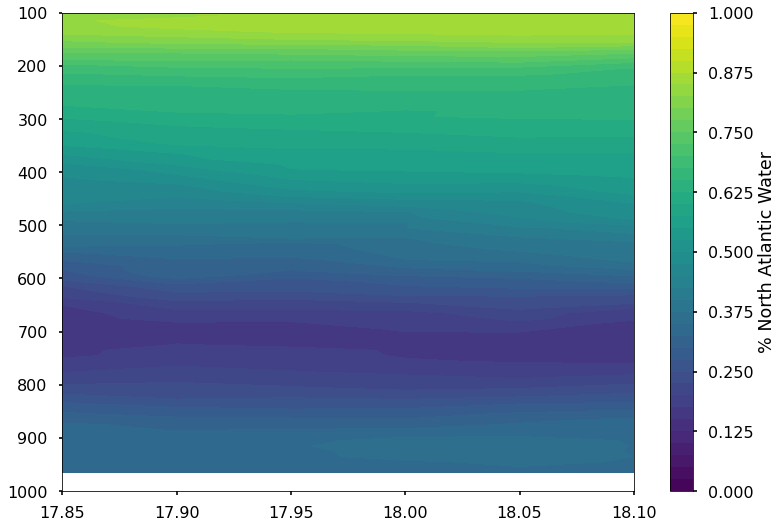

In [63]:
plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

/tmp/ipykernel_52028/3786683008.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))


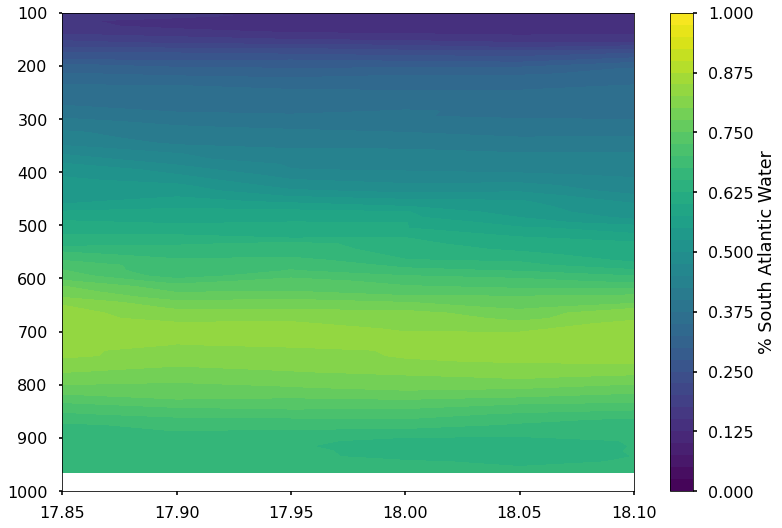

In [64]:
plt.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')


## 2022

In [65]:
np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))

/tmp/ipykernel_52028/1887041703.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))


-1.3349975344475278

In [66]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))

/tmp/ipykernel_52028/234371692.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))


-1.0248140639844778

In [67]:
np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_52028/3663723316.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.transport,axis=2))


-2.359811598432006

In [68]:
np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_52028/3135396668.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.naw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))


0.565722083633531

In [69]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))

/tmp/ipykernel_52028/1106390318.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))/np.nansum(np.nanmean(df_2022_final.transport,axis=2))


0.43427791636646884

### just surface layer

In [70]:
np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))

/tmp/ipykernel_52028/602237023.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))


-0.5631415926322594

In [71]:
0.4999255952042789/2.47

0.20239902639849347

## total SAW

In [72]:
np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))

/tmp/ipykernel_52028/29435408.py:1: RuntimeWarning: Mean of empty slice
  np.nansum(np.nanmean(df_2022_final.saw_transport,axis=2))+np.nansum(np.nanmean(subset_ds_2022_surf_final.transport,axis=2))


-1.5879556566167372

/tmp/ipykernel_52028/3390171382.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))


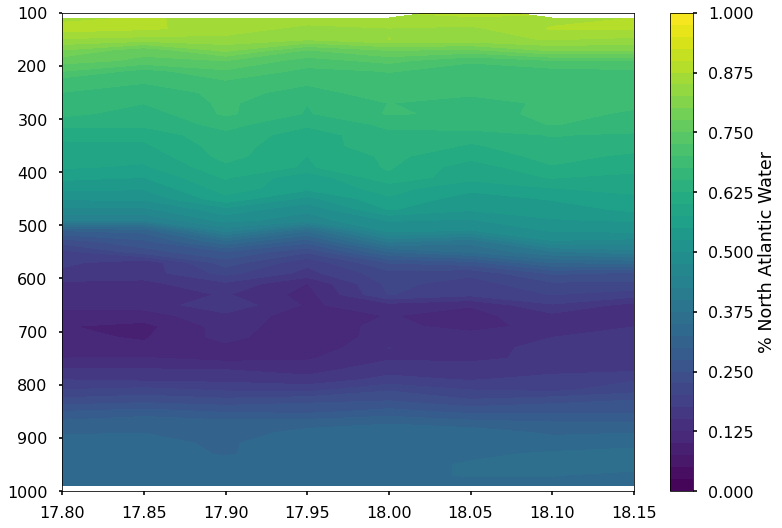

In [73]:
plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% North Atlantic Water')

/tmp/ipykernel_52028/3022784031.py:1: RuntimeWarning: Mean of empty slice
  plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))


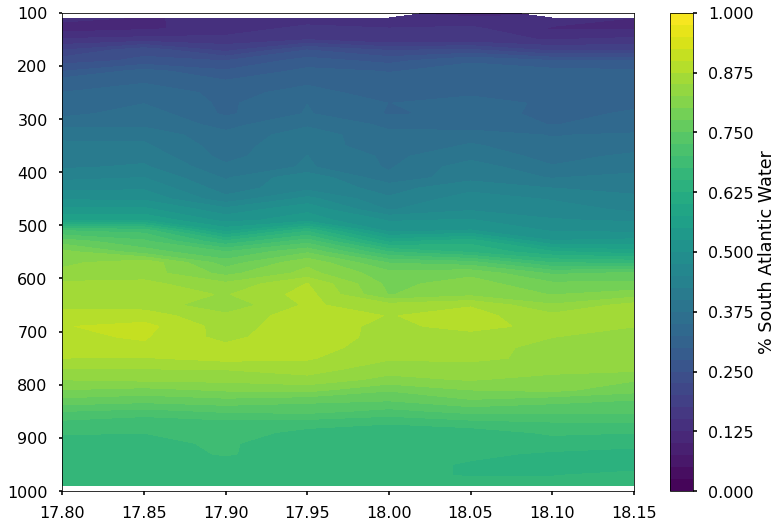

In [74]:
plt.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=np.arange(0,1.01,0.025))
plt.ylim(1000,100)
plt.colorbar(label='% South Atlantic Water')


## WOOHOO WE DID IT

/tmp/ipykernel_52028/2113083299.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
/tmp/ipykernel_52028/2113083299.py:25: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)


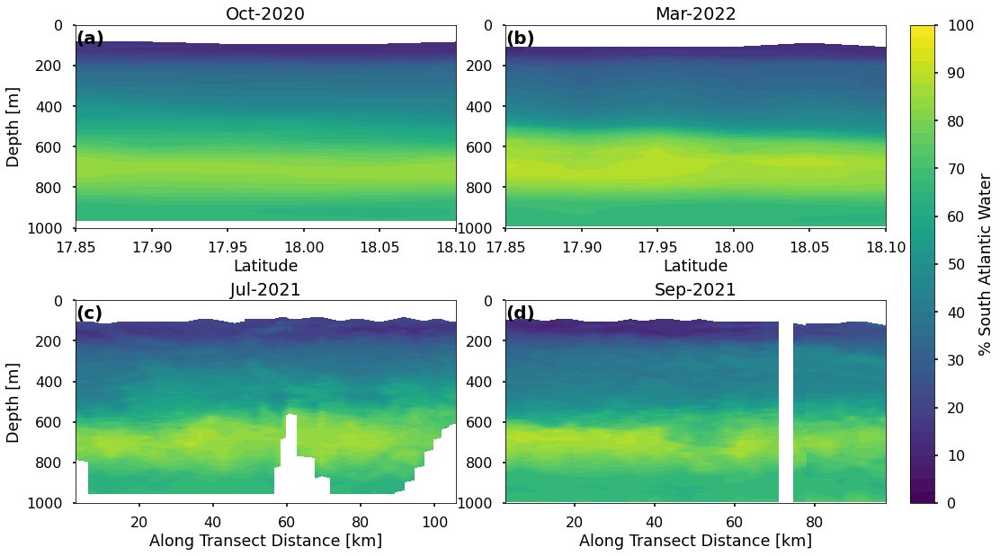

In [75]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
#ax1.set_ylim(960,120)
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.saw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.saw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% South Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

plt.savefig('/home/jg1200/Figures/Percent_SAW_All.png',dpi=300,facecolor='white',bbox_inches='tight')


/tmp/ipykernel_52028/3625309070.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
/tmp/ipykernel_52028/3625309070.py:24: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)


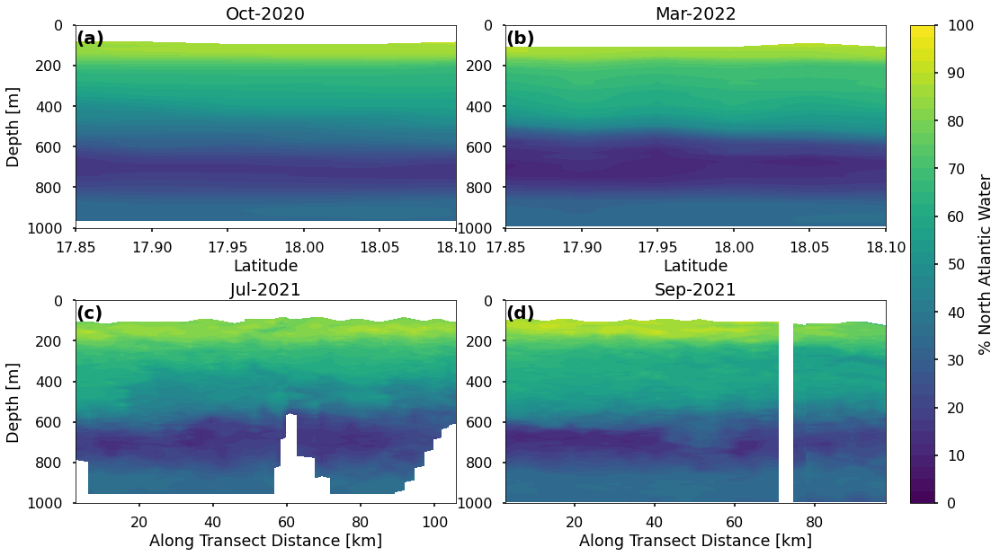

In [76]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.naw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.naw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% North Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

plt.savefig('/home/jg1200/Figures/Percent_NAW_All.png',dpi=300,facecolor='white',bbox_inches='tight')


## more plots

In [77]:
def calc_transport_by_water_mass_multiple(dft,surf_dft):
    
    smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
    smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])

    ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
    ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])

    lcw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])
    lcw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])

    iw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])
    iw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(np.nanmean(surf_dft.transport,axis=2))],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

def calc_transport_by_water_mass_single(dft,surf_dft):
    smw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])
    smw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])

    ucw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])
    ucw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])

    lcw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])
    lcw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])

    iw_naw = np.nansum(dft.naw_transport.values[np.where(dft.density>=1027.1)])
    iw_saw = np.nansum(dft.saw_transport.values[np.where(dft.density>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(surf_dft.transport)],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

df_2020_water_mass_transport = calc_transport_by_water_mass_multiple(df_2020_final,subset_ds_2020_surf_final)
df_2021a_water_mass_transport = calc_transport_by_water_mass_single(df_2021a_final,subset_ds_2021a_surf_final)
df_2021b_water_mass_transport = calc_transport_by_water_mass_single(df_2021b_final,subset_ds_2021b_surf_final)
df_2022_water_mass_transport = calc_transport_by_water_mass_multiple(df_2022_final,subset_ds_2022_surf_final)

/tmp/ipykernel_52028/2131768640.py:3: RuntimeWarning: Mean of empty slice
  smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_52028/2131768640.py:4: RuntimeWarning: Mean of empty slice
  smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_52028/2131768640.py:6: RuntimeWarning: Mean of empty slice
  ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_52028/2131768640.py:7: RuntimeWarning: Mean of empty slice
  ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_52028/2131768640.py:9: RuntimeWarning: Mean o

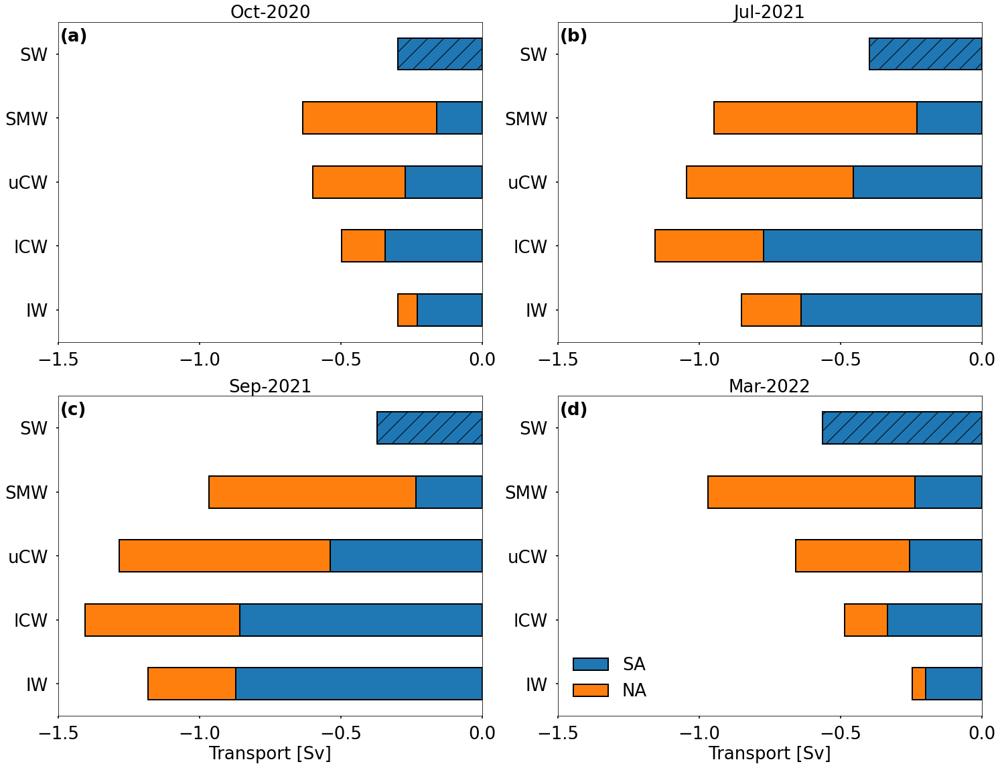

In [78]:
fig, axs = plt.subplots(2, 2, figsize=(20, 15))

plt.tight_layout(pad=0.4, w_pad=6, h_pad=4.5)

font_size = 26

df_2020_water_mass_transport.plot.barh(stacked=True,ax=axs[0,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,0].set_title('Oct-2020',fontsize=font_size)
axs[0,0].set_xlim(-1.5,0)
axs[0,0].set_xticks([-1.5,-1,-0.5,0])
axs[0,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,0].text(0.005,0.94,'(a)', transform=axs[0,0].transAxes, size=font_size, weight='bold')
axs[0,0].get_legend().remove()

df_2021a_water_mass_transport.plot.barh(stacked=True,ax=axs[0,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,1].set_title('Jul-2021',fontsize=font_size)
axs[0,1].set_xlim(-1.5,0)
axs[0,1].set_xticks([-1.5,-1,-0.5,0])
axs[0,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,1].text(0.005,0.94,'(b)', transform=axs[0,1].transAxes, size=font_size, weight='bold')
axs[0,1].get_legend().remove()

df_2021b_water_mass_transport.plot.barh(stacked=True,ax=axs[1,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,0].set_title('Sep-2021',fontsize=font_size)
axs[1,0].set_xlim(-1.5,0)
axs[1,0].set_xticks([-1.5,-1,-0.5,0])
axs[1,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,0].text(0.005,0.94,'(c)', transform=axs[1,0].transAxes, size=font_size, weight='bold')
axs[1,0].get_legend().remove()
axs[1,0].set_xlabel('Transport [Sv]',fontsize=font_size)

df_2022_water_mass_transport.plot.barh(stacked=True,ax=axs[1,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,1].set_title('Mar-2022',fontsize=font_size)
axs[1,1].set_xlim(-1.5,0)
axs[1,1].set_xticks([-1.5,-1,-0.5,0])
axs[1,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,1].text(0.005,0.94,'(d)', transform=axs[1,1].transAxes, size=font_size, weight='bold')
axs[1,1].legend(fontsize=font_size,markerscale=6,frameon=False,loc='lower left')
axs[1,1].set_xlabel('Transport [Sv]',fontsize=font_size)


hatches = ['','','','','/','','','','','']

for x in np.arange(0,len(axs)):    
    for y in np.arange(0,len(axs)):
        bars = axs[x,y].patches
        for bar, hatch in zip(bars, hatches):
            bar.set_hatch(hatch)

plt.savefig('/home/jg1200/Figures/Anegada_SAW_NAW_Transport_Water_Masses_Bar_Plot.png', bbox_inches='tight',dpi=300,facecolor='white')



In [79]:
df_2020_water_mass_transport

,SA,NA
IW,-0.228597,-0.068977
lCW,-0.342482,-0.154453
uCW,-0.272795,-0.325177
SMW,-0.161005,-0.474165
SW,-0.298785,NaN


In [80]:
df_2021a_water_mass_transport

,SA,NA
IW,-0.639857,-0.209890
lCW,-0.771447,-0.384505
uCW,-0.454552,-0.590284
SMW,-0.230373,-0.717256
SW,-0.397130,NaN


In [81]:
df_2021b_water_mass_transport

,SA,NA
IW,-0.872465,-0.309290
lCW,-0.857472,-0.546909
uCW,-0.537790,-0.744997
SMW,-0.235288,-0.732078
SW,-0.372718,NaN


In [82]:
df_2022_water_mass_transport

,SA,NA
IW,-0.198603,-0.048149
lCW,-0.334261,-0.150534
uCW,-0.256184,-0.402641
SMW,-0.235766,-0.733673
SW,-0.563142,NaN


## Percentage of SAW vs NAW in each water mass

In [83]:

tempdf = df_2020_water_mass_transport

tot_transport = -2.27
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 76.8201816911808 %  ( -0.228597403764767 Sv)
IW Percent of ALL SAW: 17.534986550381355 %
IW Percent SAW of total transport: 10.07037020990163 %
IW Percent NAW in layer: 23.179818308819204 %  ( -0.06897726832301161 Sv)
IW Percent of ALL NAW: 6.744148671091151 %
IW Percent of NAW of total transport: 3.0386461816304675 %

lCW Percent SAW in layer: 68.91886660676424 %  ( -0.34248174692707656 Sv)
lCW Percent of ALL SAW: 26.27069567376685 %
lCW Percent SAW of total transport: 15.08730162674346 %
lCW Percent NAW in layer: 31.08113339323576 %  ( -0.15445292972859367 Sv)
lCW Percent of ALL NAW: 15.101402912874157 %
lCW Percent of NAW of total transport: 6.804093820642892 %

uCW Percent SAW in layer: 45.6200700336654 %  ( -0.27279527120758124 Sv)
uCW Percent of ALL SAW: 20.92526569792054 %
uCW Percent SAW of total transport: 12.017412828527807 %
uCW Percent NAW in layer: 54.37992996633459 %  ( -0.3251767858415893 Sv)
uCW Percent of ALL NAW: 31.79367118212802 %
uCW Percen

In [84]:

tempdf = df_2021a_water_mass_transport

tot_transport = -4.43
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 75.29967102873005 %  ( -0.6398569986066172 Sv)
IW Percent of ALL SAW: 25.662453696286875 %
IW Percent SAW of total transport: 14.443724573512803 %
IW Percent NAW in layer: 24.70032897126994 %  ( -0.20989040382557175 Sv)
IW Percent of ALL NAW: 11.035626218449075 %
IW Percent of NAW of total transport: 4.737932366265729 %

lCW Percent SAW in layer: 66.73696802991809 %  ( -0.7714474158262488 Sv)
lCW Percent of ALL SAW: 30.940090724759855 %
lCW Percent SAW of total transport: 17.41416288546837 %
lCW Percent NAW in layer: 33.26303197008191 %  ( -0.3845047327346658 Sv)
lCW Percent of ALL NAW: 20.21650553024216 %
lCW Percent of NAW of total transport: 8.679565073017287 %

uCW Percent SAW in layer: 43.504608804099234 %  ( -0.45455162044565334 Sv)
uCW Percent of ALL SAW: 18.230495153855944 %
uCW Percent SAW of total transport: 10.26075892653845 %
uCW Percent NAW in layer: 56.495391195900766 %  ( -0.5902839336274661 Sv)
uCW Percent of ALL NAW: 31.035972753104367 %
uCW Pe

In [85]:

tempdf = df_2021b_water_mass_transport

tot_transport = -5.24
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 73.82792842289848 %  ( -0.87246511968874 Sv)
IW Percent of ALL SAW: 30.338875476057574 %
IW Percent SAW of total transport: 16.650097703983587 %
IW Percent NAW in layer: 26.17207157710152 %  ( -0.3092897233987116 Sv)
IW Percent of ALL NAW: 13.255611437989673 %
IW Percent of NAW of total transport: 5.902475637379992 %

lCW Percent SAW in layer: 61.05694970826545 %  ( -0.8574720315807747 Sv)
lCW Percent of ALL SAW: 29.817509724184998 %
lCW Percent SAW of total transport: 16.363970068335394 %
lCW Percent NAW in layer: 38.94305029173454 %  ( -0.5469086911343927 Sv)
lCW Percent of ALL NAW: 23.43954083592813 %
lCW Percent of NAW of total transport: 10.43718876210673 %

uCW Percent SAW in layer: 41.92355885086632 %  ( -0.5377902181006344 Sv)
uCW Percent of ALL SAW: 18.700977369751882 %
uCW Percent SAW of total transport: 10.263172101157144 %
uCW Percent NAW in layer: 58.07644114913367 %  ( -0.7449973906844469 Sv)
uCW Percent of ALL NAW: 31.929272737260156 %
uCW Percen

In [86]:

tempdf = df_2022_water_mass_transport

tot_transport = -2.47
tot_SAW = np.nansum(tempdf[:].SA)
tot_NAW = np.nansum(tempdf[:].NA)

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'Percent SAW in layer:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'Percent of ALL SAW:', (tempdf.iloc[ind].SA/tot_SAW)*100,'%')
    print(water_mass_name,'Percent SAW of total transport:', (tempdf.iloc[ind].SA/tot_transport)*100,'%')
    print(water_mass_name,'Percent NAW in layer:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    print(water_mass_name,'Percent of ALL NAW:', (tempdf.iloc[ind].NA/tot_NAW)*100,'%')
    print(water_mass_name,'Percent of NAW of total transport:', (tempdf.iloc[ind].NA/tot_transport)*100,'%')

    print('')
 
print('All SAW w/ surface layer:',np.nansum(tempdf[:].SA))
print('All SAW % of total transport:',np.nansum(tempdf[:].SA)/tot_transport)

IW Percent SAW in layer: 80.48701257326731 %  ( -0.1986029829308361 Sv)
IW Percent of ALL SAW: 12.506834312613943 %
IW Percent SAW of total transport: 8.040606596390125 %
IW Percent NAW in layer: 19.5129874267327 %  ( -0.048148606650213234 Sv)
IW Percent of ALL NAW: 3.606643863214244 %
IW Percent of NAW of total transport: 1.949336301628066 %

lCW Percent SAW in layer: 68.94889972814497 %  ( -0.3342610373788654 Sv)
lCW Percent of ALL SAW: 21.049771508798585 %
lCW Percent SAW of total transport: 13.532835521411554 %
lCW Percent NAW in layer: 31.051100271855038 %  ( -0.15053428016326492 Sv)
lCW Percent of ALL NAW: 11.275996867332166 %
lCW Percent of NAW of total transport: 6.094505269767811 %

uCW Percent SAW in layer: 38.88499892706578 %  ( -0.25618444249593625 Sv)
uCW Percent of ALL SAW: 16.132972065590113 %
uCW Percent SAW of total transport: 10.371839777163409 %
uCW Percent NAW in layer: 61.11500107293422 %  ( -0.40264145326002293 Sv)
uCW Percent of ALL NAW: 30.160464185924585 %
uCW 

In [87]:
## 2020  = 2.27
## 2021a = 4.43
## 2021b = 5.24
## 2022  = 2.47

In [88]:
def calc_water_mass_NAW_stats(wm):

    tot2020  = -2.27
    tot2021a = -4.43
    tot2021b = -5.24
    tot2022  = -2.47

    wm2020 = df_2020_water_mass_transport.NA[wm]
    wm2020all = np.nansum([df_2020_water_mass_transport.NA[wm],df_2020_water_mass_transport.SA[wm]])
    wm2021a = df_2021a_water_mass_transport.NA[wm]
    wm2021aall = np.nansum([df_2021a_water_mass_transport.NA[wm],df_2021a_water_mass_transport.SA[wm]])
    wm2021b = df_2021b_water_mass_transport.NA[wm]
    wm2021ball = np.nansum([df_2021b_water_mass_transport.NA[wm],df_2021b_water_mass_transport.SA[wm]])
    wm2022 = df_2022_water_mass_transport.NA[wm]
    wm2022all = np.nansum([df_2022_water_mass_transport.NA[wm],df_2022_water_mass_transport.SA[wm]])
    all_naw = [wm2020,wm2021a,wm2021b,wm2022]
    
    per_in_layer_2020 = (wm2020/wm2020all)*100
    per_in_layer_2021a = (wm2021a/wm2021aall)*100
    per_in_layer_2021b = (wm2021b/wm2021ball)*100
    per_in_layer_2022 = (wm2022/wm2022all)*100
    
    tot_NAW_2020 = np.nansum(df_2020_water_mass_transport.NA)
    tot_NAW_2021a = np.nansum(df_2021a_water_mass_transport.NA)
    tot_NAW_2021b = np.nansum(df_2021b_water_mass_transport.NA)
    tot_NAW_2022 = np.nansum(df_2022_water_mass_transport.NA)

    per_NAW_2020 = (wm2020/tot_NAW_2020)*100
    per_NAW_2021a = (wm2021a/tot_NAW_2021a)*100
    per_NAW_2021b = (wm2021b/tot_NAW_2021b)*100
    per_NAW_2022 = (wm2022/tot_NAW_2022)*100

    per_tot_2020 = (wm2020/tot2020)*100
    per_tot_2021a = (wm2021a/tot2021b)*100
    per_tot_2021b = (wm2021b/tot2021a)*100
    per_tot_2022 = (wm2022/tot2022)*100

    all_per_in_layer = [per_in_layer_2020,per_in_layer_2021a,per_in_layer_2021b,per_in_layer_2022]
    all_naw_per = [per_NAW_2020,per_NAW_2021a,per_NAW_2021b,per_NAW_2022]
    all_tot_per = [per_tot_2020,per_tot_2021a,per_tot_2021b,per_tot_2022]

    print(wm,'2020: ',wm2020,'Sv')
    print(wm,'2021a:',wm2021a,'Sv')
    print(wm,'2021b:',wm2021b,'Sv')
    print(wm,'2022: ',wm2022,'Sv')
    print('')
    print(wm, 'mean = ',np.nanmean(all_saw))
    print(wm, 'std  = ',np.nanstd(all_saw))
    print(wm, 'min  = ',np.nanmin(all_saw))
    print(wm, 'max  = ',np.nanmax(all_saw))
    print('')
    print(wm,'2020 percent NAW in',wm ,'layer: ',per_in_layer_2020,'%')
    print(wm,'2021a percent NAW in',wm ,'layer: ',per_in_layer_2021a,'%')
    print(wm,'2021b percent NAW in',wm ,'layer: ',per_in_layer_2021b,'%')
    print(wm,'2022 percent NAW in',wm ,'layer: ',per_in_layer_2022,'%')
    print('')
    print(wm,'mean percent NAW in',wm ,'layer: ',np.nanmean(all_per_in_layer),'%')
    print(wm,'std percent NAW in',wm ,'layer: ',np.nanstd(all_per_in_layer),'%')
    print(wm,'min percent NAW in',wm ,'layer: ',np.nanmin(all_per_in_layer),'%')
    print(wm,'max percent NAW in',wm ,'layer: ',np.nanmax(all_per_in_layer),'%')
    print('')
    print(wm,'2020 percent NAW in all NAW: ',per_NAW_2020,'%')
    print(wm,'2021a percent NAW in all NAW: ',per_NAW_2021a,'%')
    print(wm,'2021b percent NAW in all NAW: ',per_NAW_2021b,'%')
    print(wm,'2022 percent NAW in all NAW: ',per_NAW_2022,'%')
    print('')
    print(wm, 'mean percent NAW in all NAW = ',np.nanmean(all_naw_per),'%')
    print(wm, 'std percent NAW in all NAW =  ',np.nanstd(all_naw_per),'%')
    print(wm, 'min percent NAW in all NAW =  ',np.nanmin(all_naw_per),'%')
    print(wm, 'max percent NAW in all NAW =  ',np.nanmax(all_naw_per),'%')
    print('')
    print(wm,'2020 percent NAW in total transport:  ',per_tot_2020,'%')
    print(wm,'2021a percent NAW in total transport: ',per_tot_2021a,'%')
    print(wm,'2021b percent NAW in total transport: ',per_tot_2021b,'%')
    print(wm,'2022 percent NAW in total transport:  ',per_tot_2022,'%')
    print('')
    print(wm, 'mean percent NAW in total transport = ',np.nanmean(all_tot_per),'%')
    print(wm, 'std percent NAW in total transport =  ',np.nanstd(all_tot_per),'%')
    print(wm, 'min percent NAW in total transport =  ',np.nanmin(all_tot_per),'%')
    print(wm, 'max percent NAW in total transport =  ',np.nanmax(all_tot_per),'%')


In [89]:
def calc_water_mass_SAW_stats(wm):

    tot2020  = -2.27
    tot2021a = -4.43
    tot2021b = -5.24
    tot2022  = -2.47

    
    wm2020 = df_2020_water_mass_transport.SA[wm]
    wm2020all = np.nansum([df_2020_water_mass_transport.NA[wm],df_2020_water_mass_transport.SA[wm]])
    wm2021a = df_2021a_water_mass_transport.SA[wm]
    wm2021aall = np.nansum([df_2021a_water_mass_transport.NA[wm],df_2021a_water_mass_transport.SA[wm]])
    wm2021b = df_2021b_water_mass_transport.SA[wm]
    wm2021ball = np.nansum([df_2021b_water_mass_transport.NA[wm],df_2021b_water_mass_transport.SA[wm]])
    wm2022 = df_2022_water_mass_transport.SA[wm]
    wm2022all = np.nansum([df_2022_water_mass_transport.NA[wm],df_2022_water_mass_transport.SA[wm]])
    all_saw = [wm2020,wm2021a,wm2021b,wm2022]

    tot_SAW_2020 = np.nansum(df_2020_water_mass_transport.SA)
    tot_SAW_2021a = np.nansum(df_2021a_water_mass_transport.SA)
    tot_SAW_2021b = np.nansum(df_2021b_water_mass_transport.SA)
    tot_SAW_2022 = np.nansum(df_2022_water_mass_transport.SA)

    per_in_layer_2020 = (wm2020/wm2020all)*100
    per_in_layer_2021a = (wm2021a/wm2021aall)*100
    per_in_layer_2021b = (wm2021b/wm2021ball)*100
    per_in_layer_2022 = (wm2022/wm2022all)*100
    
    per_SAW_2020 = (wm2020/tot_SAW_2020)*100
    per_SAW_2021a = (wm2021a/tot_SAW_2021a)*100
    per_SAW_2021b = (wm2021b/tot_SAW_2021b)*100
    per_SAW_2022 = (wm2022/tot_SAW_2022)*100

    per_tot_2020 = (wm2020/tot2020)*100
    per_tot_2021a = (wm2021a/tot2021b)*100
    per_tot_2021b = (wm2021b/tot2021a)*100
    per_tot_2022 = (wm2022/tot2022)*100

    all_per_in_layer = [per_in_layer_2020,per_in_layer_2021a,per_in_layer_2021b,per_in_layer_2022]
    all_saw_per = [per_SAW_2020,per_SAW_2021a,per_SAW_2021b,per_SAW_2022]
    all_tot_per = [per_tot_2020,per_tot_2021a,per_tot_2021b,per_tot_2022]

    print(wm,'2020: ',wm2020,'Sv')
    print(wm,'2021a:',wm2021a,'Sv')
    print(wm,'2021b:',wm2021b,'Sv')
    print(wm,'2022: ',wm2022,'Sv')
    print('')
    print(wm, 'mean = ',np.mean(all_saw))
    print(wm, 'std  = ',np.std(all_saw))
    print(wm, 'min  = ',np.min(all_saw))
    print(wm, 'max  = ',np.max(all_saw))
    print('')
    print(wm,'2020 percent SAW in',wm ,'layer: ',per_in_layer_2020,'%')
    print(wm,'2021a percent SAW in',wm ,'layer: ',per_in_layer_2021a,'%')
    print(wm,'2021b percent SAW in',wm ,'layer: ',per_in_layer_2021b,'%')
    print(wm,'2022 percent SAW in',wm ,'layer: ',per_in_layer_2022,'%')
    print('')
    print(wm,'mean percent SAW in',wm ,'layer: ',np.nanmean(all_per_in_layer),'%')
    print(wm,'std percent SAW in',wm ,'layer: ',np.nanstd(all_per_in_layer),'%')
    print(wm,'min percent SAW in',wm ,'layer: ',np.nanmin(all_per_in_layer),'%')
    print(wm,'max percent SAW in',wm ,'layer: ',np.nanmax(all_per_in_layer),'%')
    print('')
    print(wm,'2020 percent SAW in all SAW: ',per_SAW_2020,'%')
    print(wm,'2021a percent SAW in all SAW: ',per_SAW_2021a,'%')
    print(wm,'2021b percent SAW in all SAW: ',per_SAW_2021b,'%')
    print(wm,'2022 percent SAW in all SAW: ',per_SAW_2022,'%')
    print('')
    print(wm, 'mean percent SAW in all SAW = ',np.mean(all_saw_per),'%')
    print(wm, 'std percent SAW in all SAW =  ',np.std(all_saw_per),'%')
    print(wm, 'min percent SAW in all SAW =  ',np.min(all_saw_per),'%')
    print(wm, 'max percent SAW in all SAW =  ',np.max(all_saw_per),'%')
    print('')
    print(wm,'2020 percent SAW in total transport:  ',per_tot_2020,'%')
    print(wm,'2021a percent SAW in total transport: ',per_tot_2021a,'%')
    print(wm,'2021b percent SAW in total transport: ',per_tot_2021b,'%')
    print(wm,'2022 percent SAW in total transport:  ',per_tot_2022,'%')
    print('')
    print(wm, 'mean percent SAW in total transport = ',np.mean(all_tot_per),'%')
    print(wm, 'std percent SAW in total transport =  ',np.std(all_tot_per),'%')
    print(wm, 'min percent SAW in total transport =  ',np.min(all_tot_per),'%')
    print(wm, 'max percent SAW in total transport =  ',np.max(all_tot_per),'%')


In [90]:
calc_water_mass_SAW_stats('SW')

SW 2020:  -0.298785189634609 Sv
SW 2021a: -0.39712977082793577 Sv
SW 2021b: -0.37271834259548375 Sv
SW 2022:  -0.5631415926322594 Sv

SW mean =  -0.407943723922572
SW std  =  0.09664333025498646
SW min  =  -0.5631415926322594
SW max  =  -0.298785189634609

SW 2020 percent SAW in SW layer:  100.0 %
SW 2021a percent SAW in SW layer:  100.0 %
SW 2021b percent SAW in SW layer:  100.0 %
SW 2022 percent SAW in SW layer:  100.0 %

SW mean percent SAW in SW layer:  100.0 %
SW std percent SAW in SW layer:  0.0 %
SW min percent SAW in SW layer:  100.0 %
SW max percent SAW in SW layer:  100.0 %

SW 2020 percent SAW in all SAW:  22.918870448271957 %
SW 2021a percent SAW in all SAW:  15.927503141298804 %
SW 2021b percent SAW in all SAW:  12.96081084328177 %
SW 2022 percent SAW in all SAW:  35.4633071953707 %

SW mean percent SAW in all SAW =  21.817622907055807 %
SW std percent SAW in all SAW =   8.668247755910263 %
SW min percent SAW in all SAW =   12.96081084328177 %
SW max percent SAW in all SAW

In [91]:
calc_water_mass_SAW_stats('SMW')

SMW 2020:  -0.16100493994972792 Sv
SMW 2021a: -0.23037280364273097 Sv
SMW 2021b: -0.23528750490082667 Sv
SMW 2022:  -0.23576560117883982 Sv

SMW mean =  -0.21560771241803134
SMW std  =  0.03159551151492104
SMW min  =  -0.23576560117883982
SMW max  =  -0.16100493994972792

SMW 2020 percent SAW in SMW layer:  25.348321829753395 %
SMW 2021a percent SAW in SMW layer:  24.31045722133933 %
SMW 2021b percent SAW in SMW layer:  24.322500443754063 %
SMW 2022 percent SAW in SMW layer:  24.319802576539526 %

SMW mean percent SAW in SMW layer:  24.57527051784658 %
SMW std percent SAW in SMW layer:  0.44634375548457195 %
SMW min percent SAW in SMW layer:  24.31045722133933 %
SMW max percent SAW in SMW layer:  25.348321829753395 %

SMW 2020 percent SAW in all SAW:  12.350181629659305 %
SMW 2021a percent SAW in all SAW:  9.239457283798524 %
SMW 2021b percent SAW in all SAW:  8.181826586723767 %
SMW 2022 percent SAW in all SAW:  14.847114917626653 %

SMW mean percent SAW in all SAW =  11.1546451044520

In [92]:
calc_water_mass_NAW_stats('SMW')

SMW 2020:  -0.47416507655504625 Sv
SMW 2021a: -0.7172556245075772 Sv
SMW 2021b: -0.7320781055754915 Sv
SMW 2022:  -0.7336731943740269 Sv



NameError: name 'all_saw' is not defined

In [ ]:
calc_water_mass_SAW_stats('uCW')

In [ ]:
calc_water_mass_NAW_stats('uCW')

In [ ]:
calc_water_mass_SAW_stats('lCW')

In [ ]:
calc_water_mass_NAW_stats('lCW')

In [ ]:
calc_water_mass_SAW_stats('IW')

In [ ]:
calc_water_mass_NAW_stats('IW')